In [1]:
import csv
import pandas as pd
import numpy as np
import pickle

import pdb

import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
import torchnet
from torch.autograd import Variable
from sklearn.neural_network import MLPClassifier, MLPRegressor
from sklearn.metrics import average_precision_score
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score


In [2]:
#runtype = '_nopr'
#runtype = '_self'
#runtype = '_crossdeb'

In [3]:
def setup(debate, detstr):
    print("SETTING UP DEBATE...")
    #this section: to gather data from csv
    if (detstr == 'HC'):
        candidate = 'clinton'
    else:
        candidate = 'trump'

    
    if (debate == 1):
        altdebate = 3
    else:
        altdebate = 1
    facefile = 'of_results/debate'+str(debate) + '_' + candidate + '_adj3.csv'
    facealt = 'of_results/debate'+str(altdebate) + '_' + candidate + '_adj3.csv'
    #posefile = 'op_results/debate'+str(debate) + '_' + candidate + '_features_op_colnames.csv'
    posefile = 'op_results/debate'+str(debate) + '_' + candidate + '_adj3.csv'
    posefile2 = 'op_results/debate'+str(altdebate) + '_' + candidate + '_adj3.csv'

    #load very large csvs in chunks
    chunksize = 1000000

    face = pd.read_csv(facefile, chunksize=chunksize, iterator=True)
    facedf = pd.concat(face, ignore_index=True)
    facedf.columns = facedf.columns.str.strip()
    print(len(facedf.columns))

    face2 = pd.read_csv(facealt, chunksize=chunksize, iterator=True)
    facedfalt = pd.concat(face2, ignore_index=True)
    facedfalt.columns = facedfalt.columns.str.strip()

    # for some reason a bunch of extra columns would be generated at random intervals, so this just cuts off the
    # data frame so that it only uses the ones labeled by openpose.
    pose = pd.read_csv(posefile, chunksize=chunksize, iterator=True)
    posedf = pd.concat(pose, ignore_index=True)
    posedf.columns = posedf.columns.str.strip()
    posedf = posedf.reset_index(drop=True)

    pose2 = pd.read_csv(posefile2, chunksize=chunksize, iterator=True)
    posedf2 = pd.concat(pose2, ignore_index=True)
    posedf2.columns = posedf2.columns.str.strip()
    posedf2 = posedf2.reset_index(drop=True)

    print("TRAINING " + detstr + str(debate) +", TESTING " + detstr + str(altdebate))
    return facedf, facedfalt, posedf, posedf2, debate

In [4]:

class LSTMTagger(nn.Module):

    def __init__(self, input_dim, hidden_dim, tagset_size, is_max_response=False):
        super(LSTMTagger, self).__init__()
        
        self.is_max_response = is_max_response
        self.hidden_dim = hidden_dim

        self.lstm = nn.LSTM(input_dim, hidden_dim)

        self.hidden2tag = nn.Linear(hidden_dim, tagset_size)
        self.hidden = self.init_hidden()

        #self.maxlayer = nn.MaxPool1d(300)

    def init_hidden(self):
        # Before we've done anything, we dont have any hidden state.
        # Refer to the Pytorch documentation to see exactly
        # why they have this dimensionality.
        # The axes semantics are (num_layers, minibatch_size, hidden_dim)
        
        return ((torch.zeros(1, 1, self.hidden_dim).cuda()),
                (torch.zeros(1, 1, self.hidden_dim).cuda()))

    def forward(self, input):
        #pdb.set_trace()
        #embeds = self.word_embeddings(sentence)

        lstm_out, self.hidden = self.lstm(
            input.view(len(input), 1, -1), self.hidden)
        
        tag_space = self.hidden2tag(lstm_out.view(len(input), -1))
        #print(tag_space.size())
        #print(tag_space)
        
        #pdb.set_trace()
        if self.is_max_response:
            #val, idx = tag_scores.max(0)
            #print(tag_scores.size())
            
            tag_scores = F.log_softmax(tag_space, dim=1)
            
            val, idx = tag_scores.max(0)
            output = val.view(1,2)
            
            #x = tag_scores.transpose(0,1).view(1, 2, len(input))
            #output = self.maxlayer(x)
            #output = output.view(1,2)
            
        else:
            tag_space = tag_space[-1].view(1,2)
            output = F.log_softmax(tag_space, dim=1)
            
        return output
    

In [5]:
def altlabel_get1(detstr):
    candidate = detstr #change to DT if interested in trump
    #candidate = 'HC'

    #determine which id to check for in file
    feat_prefix = 'hc_'
    altpref = 'dt_'
    if (candidate == 'DT'):
        feat_prefix = 'dt_'
        altpref = 'hc_'

    #base_pos[(base_pos > 0.01) & (base_pos < 0.99)].index
    valid_columns = ['dt_nonflu', 'dt_putdown', 'dt_attone', 'dt_hrtone',
           'dt_lookat2', 'dt_brush1', 'dt_atface', 'dt_hrface', 'dt_neuface',
           'dt_inapprop', 'dt_affgest', 'dt_defgest', 'dt_commun', 'dt_nvtic2',
           'dt_nvtic3', 'dt_6ltr', 'dt_i', 'dt_they', 'dt_interruptions',
           'dt_blame2', 'dt_anger']

    dt_valid_columns = ['dt_lookat2', 'dt_brush1', 'dt_nvdis1', 'dt_lookat3',
           'dt_eyebrow', 'dt_atface', 'dt_feface', 'dt_hrface', 'dt_saface',
           'dt_neuface', 'dt_inapprop', 'dt_affgest', 'dt_defgest', 
           'dt_agentic', 'dt_waveoff', 'dt_nvtic1', 'dt_nvtic2',
           'dt_nvtic3', 'dt_nvtic5', 'dt_nvtic6', 
           'dt_interruptions']

    hc_valid_columns = ['hc_' + x[3:] for x in dt_valid_columns]
    hc_valid_columns[3] = 'hc_look'

    #load base data
    df_label = pd.read_csv('debate1populism_revised2-last3remove.csv', index_col=0)

    #load trump data + variables
    trump_labels = [col for col in df_label if col.startswith('dt_') and 'segtype' not in col]
    trump_labels = dt_valid_columns

    dt_label = df_label[trump_labels]
    #dt_label.fillna(0, inplace=True)

    #load clinton data + variables
    clinton_labels = [col for col in df_label if col.startswith('hc_')  and 'segtype' not in col]
    clinton_labels = hc_valid_columns

    hc_label = df_label[clinton_labels]
    #hc_label.fillna(0, inplace=True)

    if (candidate == 'HC'):
        currlabel = hc_label
        altlabel = dt_label

    elif (candidate == 'DT'):
        currlabel = dt_label
        altlabel = hc_label

    currlabel.rename(columns={feat_prefix+'nvtic6': feat_prefix+'nvtic4'}, inplace=True)
    altlabel.rename(columns={altpref+'nvtic6': altpref+'nvtic4'}, inplace=True)
    #print("currlabel columns length: " + str(len(currlabel.columns)))
    #print("currlabel columns:")
    print(currlabel.columns)
    

    #currlabel.rename(columns={feat_prefix+'nvtic6': feat_prefix+'nvtic4'}, inplace=True)
    #print(currlabel.columns)
    return currlabel#, altlabel

In [6]:
def altlabel_get3(detstr):

    candidate = detstr #change to DT if interested in trump
    #candidate = 'HC'

    feat_prefix = 'HC_'
    altpref = 'DT_'
    if (candidate == 'DT'):
        feat_prefix = 'DT_'
        altpref = 'HC_'

    #base_pos[(base_pos > 0.01) & (base_pos < 0.99)].index
    valid_columns = ['DT_NONFLU', 'DT_PUTDOWN', 'DT_ATTONE', 'DT_HRTONE',
           'DT_LOOKAT2', 'DT_BRUSH1', 'DT_ATFACE', 'DT_HRFACE', 'DT_NEUFACE',
           'DT_INAPPROP', 'DT_AFFGEST', 'DT_DEFGEST', 'DT_COMMUN', 'DT_NVTIC2',
           'DT_NVTIC3', 'DT_6LTR', 'DT_I', 'DT_THEY', 'DT_INTERRUPTIONS',
           'DT_BLAME2', 'DT_ANGER']

    dt_valid_columns = ['DT_LOOKAT', 'DT_BRUSH', 'DT_NVDIS', 'DT_LOOK',
           'DT_EYEBROW', 'DT_ATFACE', 'DT_FEFACE', 'DT_HRFACE', 'DT_SAFACE',
           'DT_NEUFACE', 'DT_INAPPROP', 'DT_AFFGEST', 'DT_DEFGEST', 
           'DT_AGENTIC', 'DT_WAVEOFF', 'DT_NVTIC1', 'DT_NVTIC2',
           'DT_NVTIC3', 'DT_NVTIC5', 'DT_NVTIC6', 
           'DT_INTERPT']

    hc_valid_columns = ['HC_' + x[3:] for x in dt_valid_columns]
    #hc_valid_columns[3] = 'HC_LOOK'

    #load base data
    df_label = pd.read_csv('2016_Debate_3_visual_verbal_coding.csv', index_col=1)
    df_label.columns = df_label.columns.str.strip()
    print("DF ROWS: " + str(len(df_label.index)))


    #if is_short_run:
    #    df_label = df_label[df_label.index < 10]

    #load trump data + variables
    trump_labels = [col for col in df_label if col.startswith('DT_') and 'segtype' not in col]
    trump_labels = dt_valid_columns


    #"""
    dt_label = df_label[trump_labels]
    #print("Test: ")
    #print(dt_label.isnull().sum().sum())
    #dt_label.fillna(0, inplace=True)

    #load clinton data + variables
    clinton_labels = [col for col in df_label if col.startswith('HC_')  and 'segtype' not in col]
    clinton_labels = hc_valid_columns

    hc_label = df_label[clinton_labels]
    #hc_label.fillna(0, inplace=True)

    #randomly split features and labels into train/test set
    #currlabel = []
    currlabel= hc_label
    altlabel = dt_label
    if (candidate == 'HC'):
        currlabel = hc_label
        altlabel = dt_label

    elif (candidate == 'DT'):
        currlabel = dt_label
        altlabel = hc_label

    currlabel.rename(columns={feat_prefix+'NVTIC6': feat_prefix+'NVTIC4'}, inplace=True)
    altlabel.rename(columns={altpref+'NVTIC6': altpref+'NVTIC4'}, inplace=True)

    #print("Currlabel: ")
    #print(currlabel)
    return currlabel#, altlabel

In [7]:
# prepare data structures for use in classification
def split_data(currlabel, cutdf, altlabel, compdf, test_size=0.2, shuffle=True):
    indices = list(currlabel.index)
    compindices = list(altlabel.index)
    #print("Indices: " + str(indices))
    train_nums, test_nums0 = train_test_split(indices, test_size = test_size, shuffle=shuffle) #8:2 train:test split
    train_nums0, test_nums = train_test_split(compindices, test_size = test_size, shuffle=shuffle) #8:2 train:test split
    train_nums.sort()
    test_nums.sort()
    #print("ALTLABEL: ")
    #print(altlabel)
    v1_train = []
    v1_test = []
    for tr in train_nums:
        v1_train.append(indices.index(tr))
        #print("indices.index(tr): " + str(indices.index(tr)))
    for te in test_nums:
        v1_test.append(compindices.index(te))
        #print("indices.index(te): " + str(indices.index(tr)))


    train_labels = currlabel.iloc[v1_train]
    test_labels = altlabel.iloc[v1_test]

    train_labels = train_labels.copy()
    train_labels[train_labels != 0] = 1

    test_labels = test_labels.copy()
    test_labels[test_labels != 0] = 1

    df = cutdf[cutdf.face_id == 0]
    testdf = compdf[compdf.face_id == 0]
    #val_featcol = [x for x in df.columns if 'AU' in x or 'gaze' in x or 'pose' in x or 'timestamp' in x]
    #val_featcol = [x for x in df.columns if 'AU' in x or 'gaze' in x or 'timestamp' in x]
    val_featcol = [x for x in df.columns if 'AU' in x or 'gaze' in x or 'p_' in x or 'timestamp' in x]
    val_featcol2 = [x for x in testdf.columns if 'AU' in x or 'gaze' in x or 'p_' in x or 'timestamp' in x]
    #val_featcol = [x for x in df.columns if 'AU' in x or 'y_' in x or 'x_' in x or 'timestamp' in x]

    df = df[val_featcol]
    testdf = testdf[val_featcol2]
    #print(df)
    
    #featdims = len(val_featcol) - 1
    #print(featdims)
    
    return df, testdf, train_labels, test_labels



In [25]:
import matplotlib.pyplot as plt
from sklearn.metrics import roc_curve, auc

def save_roc(col, target_scores, prediction_scores, detstr, altdebate, debate):
    if (debate == 1):
        altdeb = 3
    else:
        altdeb = 1
    fpr, tpr, thresholds = roc_curve(y_true = np.array(target_scores), y_score = np.array(prediction_scores))
    roc_auc = auc(fpr, tpr)

    fig = plt.figure()
    plt.plot(fpr, tpr, color='red', lw=1, label='ROC curve (AUC = %0.2f)' % roc_auc)
    plt.plot([0, 1], [0, 1], color='navy', lw=1, linestyle='--')
    plt.xlim([0.0, 1.0])
    plt.ylim([0.0, 1.05])
    plt.xlabel('False Positive Rate')
    plt.ylabel('True Positive Rate')
    if col[:2] == 'DT' or col[:2] == 'dt':
        col = 'Trump ' + col[3:]
        #
        #if (runtype != '_self'):
        #    col = 'Clinton ' + col[3:]
        #else:
        #    col = 'Trump ' + col[3:]
    else:
        col = 'Clinton ' + col[3:] 
        #
        #if (runtype != '_self'):
        #    col = 'Trump ' + col[3:]
        #else:
            
        
    plt.title(col)
    plt.legend(loc="lower right")
    plt.show()
    try:
        #print("directory to create: " + ('visuals/modelres/' + detstr + '_' + str(debate) + '-' + detstr + '_' + str(altdeb) + '_crossdeb'))
        os.makedirs(('visuals/modelres/' + detstr + '_' + str(debate) + '-' + detstr + '_' + str(altdebate) + '_crossdeb10'))
        print("Would create directory")    
    except:
        print("Directory already exists!")
    fig.savefig('visuals/modelres/' + detstr + '_' + str(debate) + '-' + detstr + '_3_crossdeb10/ROC_'+col + '.png', dpi = 300)
    #fig.savefig('visuals/modelres/ROC_'+col + '.png', dpi = 300)
    return roc_auc


In [36]:
def runLSTM(currlabel, facedf, posedf, altlabel, facedfalt, posedf2, detstr, altstr, debate):
    init_time = 0
    #testdf = facedfalt
    AUC_repeat = pd.DataFrame(columns = altlabel.columns)
    corr_repeat = pd.DataFrame(columns = altlabel.columns)
    n_repeat = 10
    n_epoch = 3
    #featdims = 83 + 50
    #featdims = 137 + 16
    #featdims = 175 + 52
    featdims =  133
    #featdims = 271
    pose_feat_coeff = 1
    face_feat_coeff = 1
    run_name = 'face_pose'

    for r in range(n_repeat):
        #df, train_labels, test_labels = split_data(currlabel, facedf, 0.2, True)
        df, testdf, train_labels, test_labels = split_data(currlabel, facedf, altlabel, facedfalt, 0.2, True)
        #print(train_labels)
        #print(test_labels)
        ndim_out = len(currlabel.columns)
        #eval_metric = pd.DataFrame(columns = train_labels.columns)

        #eval_metric = pd.DataFrame(columns = ['train_AP_pos', 'train_AP_neg', 'train_base_pos', 'AP_pos', 'AP_neg', 'base_pos'])
        eval_metric = pd.DataFrame(index = train_labels.columns, columns = ['train_AP_neg', 'train_AP_pos', 'train_loss', 'train_base_pos', 'AP_neg', 'AP_pos', 'loss', 'base_pos', 'ROC_AUC', 'corr'])

        #print(eval_metric.loc['dt_atface', 'AP_pos'])

        base_pos = train_labels.sum() / train_labels.shape[0]
        eval_metric['train_base_pos'] = base_pos
        base_pos = test_labels.sum() / test_labels.shape[0]
        eval_metric['base_pos'] = base_pos
        #print(eval_metric)

        #train_labels = train_labels[['dt_atface']]
        #train_labels = train_labels[['dt_lookat2']]

        for i, col in enumerate(train_labels.columns):
            model = LSTMTagger(input_dim=featdims, hidden_dim=256, tagset_size=2, is_max_response=False)
            model.cuda()

            loss_function = nn.NLLLoss()
            loss_function.cuda()

            optimizer = optim.Adam(model.parameters(), lr=0.00001, weight_decay=0.0005)

            for epoch in range(n_epoch):  
                datalist = train_labels.index.values.copy()
                datalist = np.random.permutation(datalist)

                #print("Datalist: ")
                #print(datalist)

                ap = torchnet.meter.APMeter()
                model.train()

                lossval = np.array([])


                for tid in datalist:
                    #try:
                    model.zero_grad()
                    model.hidden = model.init_hidden()
                    #if (tid == 546):
                    #    time0 = init_time + (tid-1) * 10
                    #    time1 = time0 + 8
                    #else:
                    time0 = init_time + (tid-1) * 10
                    time1 = time0 + 10
                    #print("[TRAIN; TID" + str(tid) + "] TIME0: " + str(time0) + " | TIME1: " + str(time1))

                    feature = df[(df.loc[:, 'timestamp'] >= time0) & (df.loc[:, 'timestamp'] < time1)]
                    feature = feature.iloc[:, 1:] * face_feat_coeff
                    #print(feature)
                    #print(x)
                    # add OpenPose feature
                    #print("TIME0: " + str(time0))
                    #print(feature)
                    x = posedf[posedf.iloc[:,0] >= time0 * 30]
                    #print(x)
                    #print(x)
                    if (x.size < 1):
                        continue
                    x = posedf.iloc[x.index[0]:x.index[0]+feature.shape[0], 1:] * pose_feat_coeff
                    #print(np.isnan(x).sum().sum())
                    #print("[TRAIN] X NANS ON TID " + str(tid) +": " + str((np.isnan(x).sum().sum())))
                    #print(np.isnan(x).sum().sum())                


                    feature.reset_index(drop=True, inplace=True)
                    x.reset_index(drop=True, inplace=True)
                    feature = pd.concat( [feature, x], axis=1) 

                    #print("[TRAIN] Features size: " + str(feature.size))
                    #print("[TRAIN] FEATURE NANS ON TID " + str(tid) + ": " + str((np.isnan(feature).sum().sum())))
                    feature.dropna(inplace=True)
                    #print("[TRAIN] NANS AFTER DROPNA ON TID " + str(tid) + ": " + str((np.isnan(feature).sum().sum())))
                    feature = torch.tensor(feature.values, dtype=torch.float)
                    #print (feature)
                    feature = feature.cuda()
                    #print("FEATURE ON TID " + str(tid))
                    #print(feature)

                    #subcol = col.split('_').str[1]

                    #print(subcol)
                    targets = train_labels.loc[tid, col]
                    #print("[TRAIN] TARGETS ")
                    #print(targets)
                    #print(tid)
                    targets = torch.tensor([[targets]], dtype=torch.long)
                    target_vec = np.zeros([1, 2])
                    target_vec[0, targets[0][0]] = 1

                    targets = targets.cuda()



                    # Step 3. Run our forward pass.
                    #print("Feature: ")
                    #print(feature)
                    scores = model(feature)
                    #print(scores)
                    #print("Scores (TRAIN): ")
                    #print(scores)

                    scores_ap = scores.data.clone()
                    ap.add(scores_ap, target_vec)

                    loss = loss_function(scores, targets[0])
                    lossval = np.append(lossval, loss.data.cpu())

                    loss.backward()
                    optimizer.step()
                    if tid % 200 == 0:
                        #print("TID % 200:")
                        print(col +" " + str(epoch) + " ap " + str(ap.value()) + " loss : " + str(loss.data.item()) + " " + str(lossval.mean()) + " tid : " + str(tid) + " tg " + str(targets))

                    #except:
                        #print("AT END OF FILE (TRAIN)")
                        #continue
                #print(ap.value())
                eval_metric.iloc[i, 0:3] = ap.value().tolist() + [loss.data.item()]
                #print(eval_metric)

                datalist = test_labels.index.values.copy()
                #datalist = np.random.permutation(datalist)

                ntest = datalist.size
                prediction_scores = []
                target_scores = []

                lossval = np.array([])
                ap = torchnet.meter.APMeter()
                model.eval()

                for tid in datalist:
                    #try:
                    model.zero_grad()
                    model.hidden = model.init_hidden()

                    #if (tid == 546):
                    #    time0 = init_time + (tid-1) * 10
                    #    time1 = time0 + 8
                    #else:
                    time0 = init_time + (tid-1) * 10
                    time1 = time0 + 10


                    feature = testdf[(testdf.loc[:, 'timestamp'] >= time0) & (testdf.loc[:, 'timestamp'] < time1)]
                    feature = feature.iloc[:, 1:] * face_feat_coeff

                    # add OpenPose feature
                    x = posedf2[posedf2.iloc[:,0] >= time0 * 30]

                    x = posedf2.iloc[x.index[0]:x.index[0]+feature.shape[0], 1:] * pose_feat_coeff

                    feature.reset_index(drop=True, inplace=True)
                    x.reset_index(drop=True, inplace=True)
                    feature = pd.concat( [feature, x], axis=1)
                    feature.dropna(inplace=True)
                    #print("[TEST] Features size: " + str(feature.size))
                    #print("[TEST] FEATURE NANS ON TID " + str(tid) + ": " + str((np.isnan(feature).sum().sum())))

                    #feature.values
                    feature = torch.tensor(feature.values, dtype=torch.float)
                    feature = feature.cuda()
                    #feature = Variable(feature)

                    subcol = col.split('_')[1]
                    #rightc = [c for c in altlabel.columns if subcol in c]
                    
                    """
                    if (subcol == 'look' or subcol == 'LOOKAT3'):
                        rightc = 'LOOK'
                    elif (subcol == 'LOOK'):
                        if (altstr == 'DT'):
                            rightc = 'lookat3'
                        else:
                            rightc = 'look'
                    else:
                        rightc = subcol.lower()
                    if (debate == 1):
                        rightc = altstr.lower() + '_' + subcol
                    """
                    rightc = altstr + '_' + subcol.upper()
                    if (subcol == 'lookat2'):
                        rightc = altstr + '_' + 'LOOKAT'
                    elif (subcol == 'brush1'):
                        rightc = altstr + '_' + 'BRUSH'
                    elif (subcol == 'nvdis1'):
                        rightc = altstr + '_' + 'NVDIS'
                    elif (subcol == 'interruptions'):
                        rightc = altstr + '_' + 'INTERPT'
                    elif (subcol == 'lookat3'):
                        rightc = altstr + '_' + 'LOOK'
                    #else:
                        #rightc = altstr + '_' + subcol
                    #print(rightc)
                    #print(subcol)
                    targets = test_labels.loc[tid, rightc]
                    #targets = test_labels.loc[tid, rightc[0]]

                    #print("[TRAIN] TARGETS ")
                    #print(targets)
                    #print(tid)
                    #targets = test_labels.loc[tid, col]
                    #print(str(targets))
                    targets = torch.tensor([[targets]], dtype=torch.long)
                    target_vec = np.zeros([1, 2])
                    target_vec[0, targets[0][0]] = 1
                    targets = targets.cuda()

                    # Step 3. Run our forward pass.
                    scores = model(feature)
                    #print("SCORES: ")
                    #print(scores)


                    scores_ap = scores.data.clone()
                    ap.add(scores_ap, target_vec)



                    prediction_scores.append(scores_ap[0][1].item())
                    target_scores.append(targets.item())

                    loss = loss_function(scores, targets[0])
                    lossval = np.append(lossval, loss.data.cpu())

                    if tid % 30 == 0:
                        print("TEST " + col +" " + str(epoch) + " ap " + str(ap.value()) + " loss : " + str(loss.data.item()) + " " + str(lossval.mean()) + " tid : " + str(tid) + " tg " + str(targets))
                    #except:
                        #print("AT END OF FILE (TEST)")
                        #continue
                eval_metric.iloc[i, 4:7] = ap.value().tolist() + [loss.data.item()]

                #print("col:")
                #print(col)
                #print("target_scores:")
                #print(target_scores)
                #print("prediction scores: ")
                #print(prediction_scores)

                #del prediction_scores[-1]
                #del target_scores[-1]
                #print("TARGET SCORES")
                #print(target_scores)
                #print("PRED SCORES: ")
                #print(prediction_scores)
                #eval_metric.columns = altlabel.columns
                roc_auc = save_roc(rightc, target_scores, prediction_scores, detstr, altstr, debate)
                eval_metric.loc[rightc, 'ROC_AUC'] = roc_auc
                eval_metric.loc[rightc, 'corr'] = np.corrcoef(prediction_scores, target_scores)[0][1]
                #eval_metric.to_csv('visuals/modelres/' + detstr + '_' + str(debate) + '-' + altstr + '_' + str(debate) + runtype +  '/result_' + detstr + '_' + str(r) + '.csv')
                #eval_metric.to_csv('visuals/modelres/result_' + detstr + '_' + str(r) + '.csv')
                eval_metric.to_csv('visuals/modelres/' + detstr + '_' + str(debate) + '-' + detstr + '_3_crossdeb10/result_' + detstr + '_' + str(r) + '.csv')
        AUC_repeat = AUC_repeat.append(eval_metric['ROC_AUC'])
        corr_repeat = corr_repeat.append(eval_metric['corr'])

        #print(AUC_repeat.mean())
        #print(AUC_repeat.std())
        #print(eval_metric)

    AUC_repeat = AUC_repeat.set_index([list(range(n_repeat))])
    corr_repeat = corr_repeat.set_index([list(range(n_repeat))])

    for M, f in [[AUC_repeat, 'auc'], [corr_repeat, 'corr']]:
        x = M.mean()
        x.name = 'mean'
        M = M.append(x)

        x = AUC_repeat.std()
        x.name = 'std'
        M = M.append(x)

        #M.to_csv('visuals/modelres/' + detstr + '_' + str(debate) + '-' + altstr + '_' + str(debate) + runtype + '/' + candidate + '_' + f + '_multi_' + run_name + '.csv')
        M.to_csv('visuals/modelres/' + detstr + '_' + str(debate) + '-' + detstr + '_3_crossdeb10/' + detstr + '_' + f + '_multi_' + run_name + '.csv')

In [37]:
def classify(debate, cand):
    if (debate == 1):
        altdebate = 3
    else:
        altdebate = 1
    facedf, facedf2, posedf, posedf2, altstr = setup(debate, cand)
    if (debate == 1):
        currlabel = altlabel_get1(cand)
        altlabel = altlabel_get3(cand)
    elif (debate == 3):
        currlabel = altlabel_get3(cand)
        altlabel = altlabel_get1(cand)
    
    print("COLUMN LENGTHS:")
    print("CURRLABEL: " + str(currlabel.columns))
    print("ALTLABEL: " + str(altlabel.columns))
    #print("CURRLABEL: " + str(len(altaltlabel.columns)))
    
    #RUNLSTM PARAMETERS:
    # train label, train face, train pose, test label, test face, test pose, train str, test str, debate#, other#
    runLSTM(currlabel, facedf, posedf, altlabel, facedf2, posedf2, cand, cand, debate)

SETTING UP DEBATE...
222
TRAINING HC1, TESTING HC3
Index(['hc_lookat2', 'hc_brush1', 'hc_nvdis1', 'hc_look', 'hc_eyebrow',
       'hc_atface', 'hc_feface', 'hc_hrface', 'hc_saface', 'hc_neuface',
       'hc_inapprop', 'hc_affgest', 'hc_defgest', 'hc_agentic', 'hc_waveoff',
       'hc_nvtic1', 'hc_nvtic2', 'hc_nvtic3', 'hc_nvtic5', 'hc_nvtic4',
       'hc_interruptions'],
      dtype='object')
DF ROWS: 546
COLUMN LENGTHS:
CURRLABEL: Index(['hc_lookat2', 'hc_brush1', 'hc_nvdis1', 'hc_look', 'hc_eyebrow',
       'hc_atface', 'hc_feface', 'hc_hrface', 'hc_saface', 'hc_neuface',
       'hc_inapprop', 'hc_affgest', 'hc_defgest', 'hc_agentic', 'hc_waveoff',
       'hc_nvtic1', 'hc_nvtic2', 'hc_nvtic3', 'hc_nvtic5', 'hc_nvtic4',
       'hc_interruptions'],
      dtype='object')
ALTLABEL: Index(['HC_LOOKAT', 'HC_BRUSH', 'HC_NVDIS', 'HC_LOOK', 'HC_EYEBROW',
       'HC_ATFACE', 'HC_FEFACE', 'HC_HRFACE', 'HC_SAFACE', 'HC_NEUFACE',
       'HC_INAPPROP', 'HC_AFFGEST', 'HC_DEFGEST', 'HC_AGENTIC', 'HC

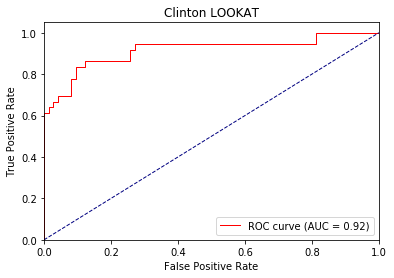

Directory already exists!
hc_lookat2 1 ap tensor([0.9722, 0.9866]) loss : 0.523511528968811 0.4202774402995904 tid : 400 tg tensor([[0]], device='cuda:0')
hc_lookat2 1 ap tensor([0.9504, 0.9604]) loss : 0.493039071559906 0.40107874373063684 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_lookat2 1 ap tensor([0.9077, 0.8852]) loss : 0.8245067596435547 0.4142464971856067 tid : 180 tg tensor([[0]], device='cuda:0')


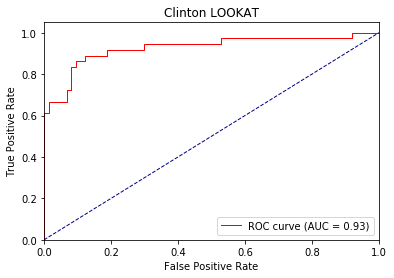

Directory already exists!
hc_lookat2 2 ap tensor([1., 1.]) loss : 0.4634074568748474 0.27307860056559247 tid : 200 tg tensor([[0]], device='cuda:0')
hc_lookat2 2 ap tensor([0.9199, 0.9550]) loss : 0.2998642921447754 0.36170180566119453 tid : 400 tg tensor([[0]], device='cuda:0')
TEST hc_lookat2 2 ap tensor([0.8887, 0.8756]) loss : 0.8721121549606323 0.3586176131900988 tid : 180 tg tensor([[0]], device='cuda:0')


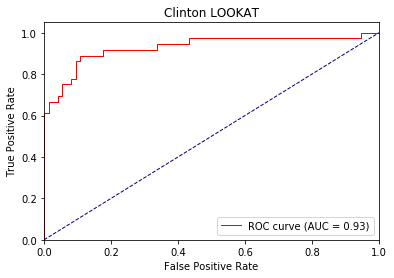

Directory already exists!
hc_brush1 0 ap tensor([0.9707, 0.6000]) loss : 0.5868185758590698 0.6520203232765198 tid : 400 tg tensor([[0]], device='cuda:0')
hc_brush1 0 ap tensor([0.8797, 0.1176]) loss : 0.3647342324256897 0.5734876626416257 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_brush1 0 ap tensor([0.8224, 0.1035]) loss : 0.47811201214790344 0.5297107202442068 tid : 180 tg tensor([[0]], device='cuda:0')


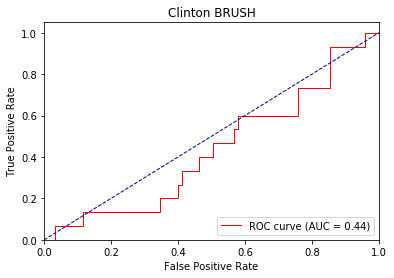

Directory already exists!
hc_brush1 1 ap tensor([1., 0.]) loss : 0.34374547004699707 0.34374547004699707 tid : 200 tg tensor([[0]], device='cuda:0')
hc_brush1 1 ap tensor([0.8865, 0.1649]) loss : 0.1991959810256958 0.45444677195270655 tid : 400 tg tensor([[0]], device='cuda:0')
TEST hc_brush1 1 ap tensor([0.8496, 0.1283]) loss : 0.3848767876625061 0.44818037983618286 tid : 180 tg tensor([[0]], device='cuda:0')


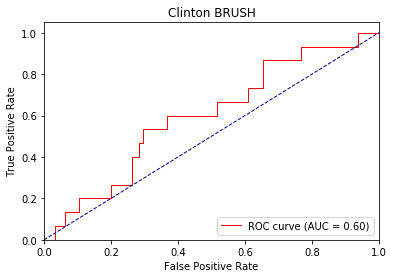

Directory already exists!
hc_brush1 2 ap tensor([0.9180, 0.1947]) loss : 0.17615258693695068 0.4318014780680339 tid : 400 tg tensor([[0]], device='cuda:0')
hc_brush1 2 ap tensor([0.9353, 0.1873]) loss : 0.17370200157165527 0.40497480997538776 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_brush1 2 ap tensor([0.8769, 0.1837]) loss : 0.3321031928062439 0.40977779187654195 tid : 180 tg tensor([[0]], device='cuda:0')


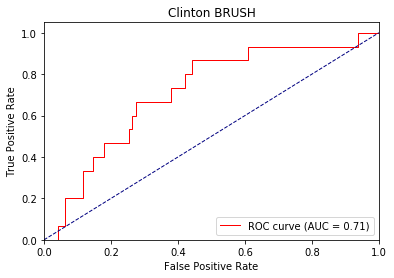

Directory already exists!
hc_nvdis1 0 ap tensor([0.9891, 0.7345]) loss : 0.3974854350090027 0.4772130675980302 tid : 400 tg tensor([[0]], device='cuda:0')
hc_nvdis1 0 ap tensor([0.9671, 0.5374]) loss : 0.36898332834243774 0.4586218562173216 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_nvdis1 0 ap tensor([0.7828, 0.3438]) loss : 0.27196240425109863 0.5494347591149179 tid : 180 tg tensor([[0]], device='cuda:0')


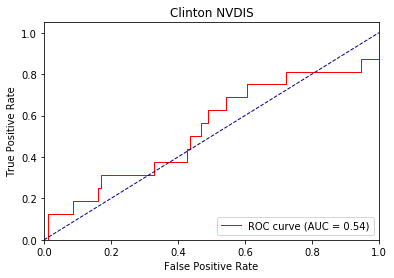

Directory already exists!
hc_nvdis1 1 ap tensor([0.9873, 0.5930]) loss : 0.16158854961395264 0.2829820795469925 tid : 400 tg tensor([[0]], device='cuda:0')
hc_nvdis1 1 ap tensor([0.9583, 0.5053]) loss : 0.14831089973449707 0.295760357991243 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_nvdis1 1 ap tensor([0.7997, 0.3479]) loss : 0.19143426418304443 0.5694796011636132 tid : 180 tg tensor([[0]], device='cuda:0')


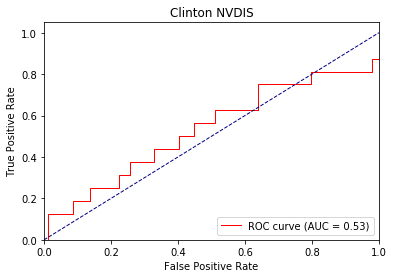

Directory already exists!
hc_nvdis1 2 ap tensor([0.9724, 0.6087]) loss : 0.1070852279663086 0.2889387743039565 tid : 400 tg tensor([[0]], device='cuda:0')
hc_nvdis1 2 ap tensor([0.9800, 0.5816]) loss : 0.10554063320159912 0.2579187162021071 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_nvdis1 2 ap tensor([0.7874, 0.3448]) loss : 0.14928054809570312 0.6077062691512861 tid : 180 tg tensor([[0]], device='cuda:0')


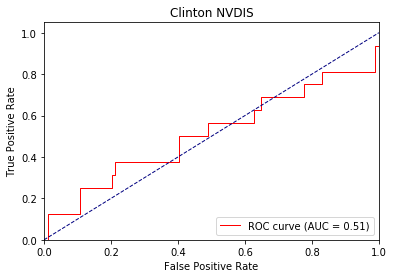

Directory already exists!
hc_look 0 ap tensor([0.2389, 0.7138]) loss : 0.5607702732086182 0.678715999348689 tid : 400 tg tensor([[1]], device='cuda:0')
hc_look 0 ap tensor([0.2679, 0.7775]) loss : 0.5406577587127686 0.6612635759730318 tid : 200 tg tensor([[1]], device='cuda:0')
TEST hc_look 0 ap tensor([0.6075, 0.9810]) loss : 0.5478298664093018 0.4970845635000028 tid : 180 tg tensor([[1]], device='cuda:0')


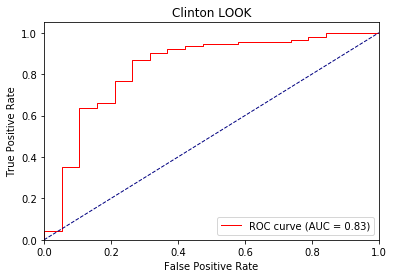

Directory already exists!
hc_look 1 ap tensor([0.7368, 0.9557]) loss : 0.29514092206954956 0.5241931065028866 tid : 400 tg tensor([[1]], device='cuda:0')
hc_look 1 ap tensor([0.7763, 0.9463]) loss : 0.31692469120025635 0.5102602658064469 tid : 200 tg tensor([[1]], device='cuda:0')
TEST hc_look 1 ap tensor([0.5896, 0.9841]) loss : 0.4887438416481018 0.3962916810261576 tid : 180 tg tensor([[1]], device='cuda:0')


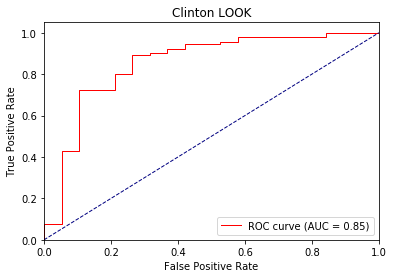

Directory already exists!
hc_look 2 ap tensor([0.7658, 0.9450]) loss : 0.18634098768234253 0.47045686609536697 tid : 400 tg tensor([[1]], device='cuda:0')
hc_look 2 ap tensor([0.7686, 0.9474]) loss : 0.2748204469680786 0.4697667886544992 tid : 200 tg tensor([[1]], device='cuda:0')
TEST hc_look 2 ap tensor([0.6048, 0.9863]) loss : 0.4396551251411438 0.3333232316531633 tid : 180 tg tensor([[1]], device='cuda:0')


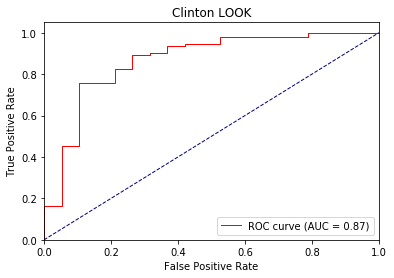

Directory already exists!
hc_eyebrow 0 ap tensor([0.6065, 0.2162]) loss : 0.7424236536026001 0.7206893526372455 tid : 200 tg tensor([[1]], device='cuda:0')
hc_eyebrow 0 ap tensor([0.6972, 0.2514]) loss : 0.6626689434051514 0.6954903458927664 tid : 400 tg tensor([[0]], device='cuda:0')
TEST hc_eyebrow 0 ap tensor([0.9230, 0.8050]) loss : 0.5655663013458252 0.6120918722529161 tid : 180 tg tensor([[0]], device='cuda:0')


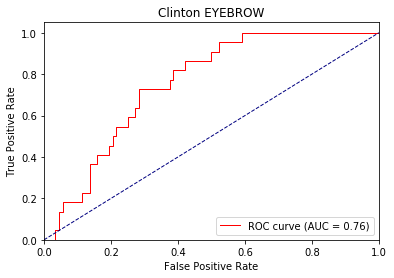

Directory already exists!
hc_eyebrow 1 ap tensor([0.8875, 0.6744]) loss : 0.7952358722686768 0.5792775186507598 tid : 200 tg tensor([[1]], device='cuda:0')
hc_eyebrow 1 ap tensor([0.9416, 0.7381]) loss : 0.741277277469635 0.5180153048493232 tid : 400 tg tensor([[0]], device='cuda:0')
TEST hc_eyebrow 1 ap tensor([0.9449, 0.8572]) loss : 0.4718594551086426 0.5404628750525022 tid : 180 tg tensor([[0]], device='cuda:0')


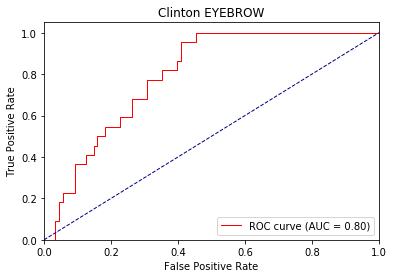

Directory already exists!
hc_eyebrow 2 ap tensor([0.9487, 0.7615]) loss : 0.7890207767486572 0.4501287491027131 tid : 400 tg tensor([[0]], device='cuda:0')
hc_eyebrow 2 ap tensor([0.9449, 0.7559]) loss : 0.8592039346694946 0.45529269897973146 tid : 200 tg tensor([[1]], device='cuda:0')
TEST hc_eyebrow 2 ap tensor([0.9507, 0.8666]) loss : 0.4093971252441406 0.500265184985964 tid : 180 tg tensor([[0]], device='cuda:0')


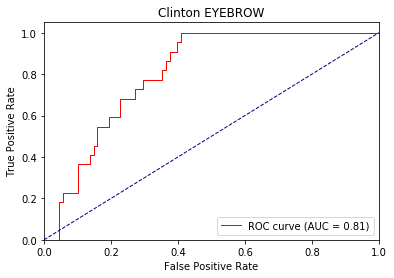

Directory already exists!
hc_atface 0 ap tensor([0.9392, 0.1365]) loss : 1.0785568952560425 0.5179345542854733 tid : 200 tg tensor([[1]], device='cuda:0')
hc_atface 0 ap tensor([0.9323, 0.1385]) loss : 0.4632733166217804 0.5184652938882345 tid : 400 tg tensor([[0]], device='cuda:0')
TEST hc_atface 0 ap tensor([0.9565, 0.2913]) loss : 0.4532369077205658 0.4640080920959774 tid : 180 tg tensor([[0]], device='cuda:0')


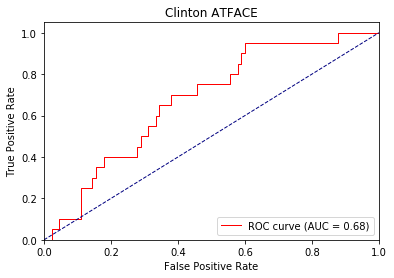

Directory already exists!
hc_atface 1 ap tensor([0.9660, 0.2443]) loss : 1.2978532314300537 0.40214456855386926 tid : 200 tg tensor([[1]], device='cuda:0')
hc_atface 1 ap tensor([0.9704, 0.2225]) loss : 0.3332643508911133 0.37803324426400375 tid : 400 tg tensor([[0]], device='cuda:0')
TEST hc_atface 1 ap tensor([0.9764, 0.4112]) loss : 0.327789306640625 0.39743828616644206 tid : 180 tg tensor([[0]], device='cuda:0')


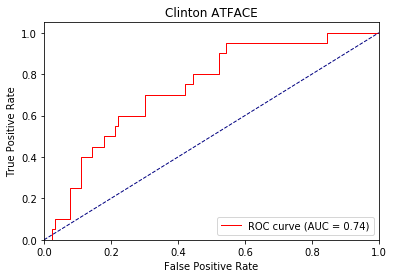

Directory already exists!
hc_atface 2 ap tensor([0.9644, 0.2498]) loss : 0.32116904854774475 0.34900407005085177 tid : 400 tg tensor([[0]], device='cuda:0')
hc_atface 2 ap tensor([0.9677, 0.2550]) loss : 1.5929591655731201 0.34349196522922837 tid : 200 tg tensor([[1]], device='cuda:0')
TEST hc_atface 2 ap tensor([0.9797, 0.5190]) loss : 0.2555760145187378 0.3653530251038702 tid : 180 tg tensor([[0]], device='cuda:0')


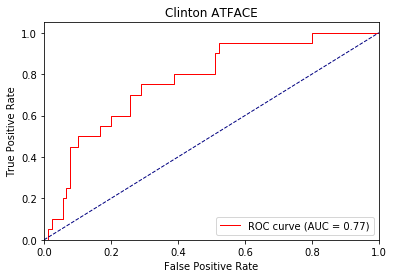

Directory already exists!
hc_feface 0 ap tensor([1., 0.]) loss : 0.7214965224266052 0.8626278742499973 tid : 400 tg tensor([[0]], device='cuda:0')
hc_feface 0 ap tensor([1., 0.]) loss : 0.5707792639732361 0.7281221828318589 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_feface 0 ap tensor([1., 0.]) loss : 0.5439068078994751 0.4757673873713142 tid : 180 tg tensor([[0]], device='cuda:0')


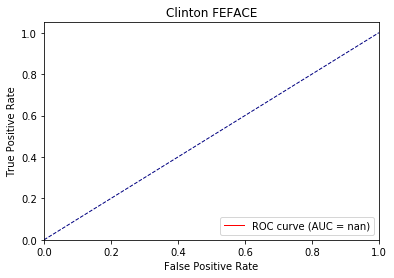

Directory already exists!
hc_feface 1 ap tensor([1., 0.]) loss : 0.32148683071136475 0.38017502296580014 tid : 200 tg tensor([[0]], device='cuda:0')
hc_feface 1 ap tensor([1., 0.]) loss : 0.3041011095046997 0.3658235105020659 tid : 400 tg tensor([[0]], device='cuda:0')
TEST hc_feface 1 ap tensor([1., 0.]) loss : 0.2751438021659851 0.23191491396803604 tid : 180 tg tensor([[0]], device='cuda:0')


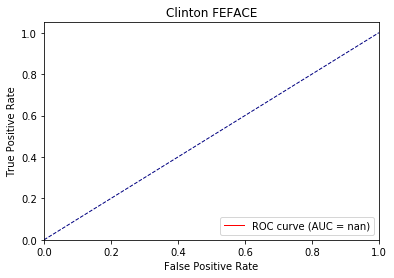

Directory already exists!
hc_feface 2 ap tensor([1., 0.]) loss : 0.16458463668823242 0.1998837187483504 tid : 400 tg tensor([[0]], device='cuda:0')
hc_feface 2 ap tensor([1., 0.]) loss : 0.07489359378814697 0.1537133041208824 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_feface 2 ap tensor([1., 0.]) loss : 0.13299643993377686 0.11596805170962685 tid : 180 tg tensor([[0]], device='cuda:0')


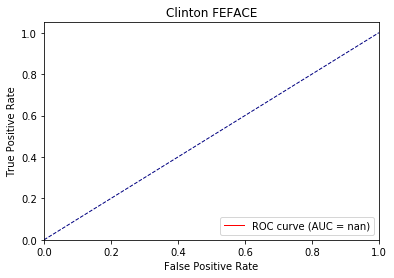

Directory already exists!
hc_hrface 0 ap tensor([0.5272, 0.4379]) loss : 0.6718125343322754 0.700994578788155 tid : 400 tg tensor([[0]], device='cuda:0')
hc_hrface 0 ap tensor([0.5767, 0.6407]) loss : 0.7307817935943604 0.6805847185867029 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_hrface 0 ap tensor([0.7442, 0.2780]) loss : 0.7591784000396729 0.6828019273908514 tid : 180 tg tensor([[0]], device='cuda:0')


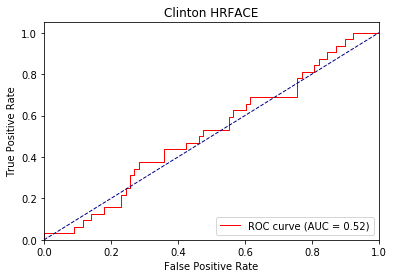

Directory already exists!
hc_hrface 1 ap tensor([0.6787, 0.8051]) loss : 0.7021470069885254 0.6429262380156897 tid : 200 tg tensor([[0]], device='cuda:0')
hc_hrface 1 ap tensor([0.7031, 0.7989]) loss : 0.5446579456329346 0.6375457532093173 tid : 400 tg tensor([[0]], device='cuda:0')
TEST hc_hrface 1 ap tensor([0.7534, 0.4166]) loss : 0.7456610202789307 0.6625759476109555 tid : 180 tg tensor([[0]], device='cuda:0')


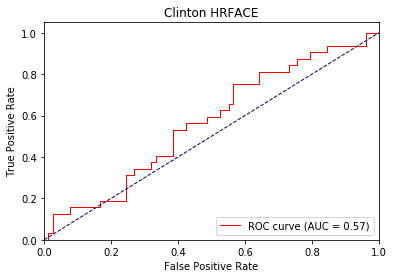

Directory already exists!
hc_hrface 2 ap tensor([0.7907, 0.8183]) loss : 0.4999462962150574 0.6073480960506721 tid : 400 tg tensor([[0]], device='cuda:0')
hc_hrface 2 ap tensor([0.7637, 0.8396]) loss : 0.619796097278595 0.5992541221257682 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_hrface 2 ap tensor([0.7704, 0.4792]) loss : 0.724885880947113 0.6418661600665042 tid : 180 tg tensor([[0]], device='cuda:0')


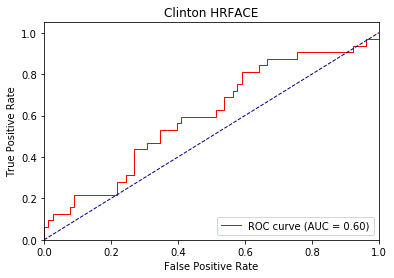

Directory already exists!
hc_saface 0 ap tensor([0.9717, 0.0309]) loss : 0.6592920422554016 0.7835067224829164 tid : 200 tg tensor([[0]], device='cuda:0')
hc_saface 0 ap tensor([0.9800, 0.0189]) loss : 0.4827112853527069 0.6824550617050815 tid : 400 tg tensor([[0]], device='cuda:0')
TEST hc_saface 0 ap tensor([1., 0.]) loss : 0.4414268136024475 0.4105694348874845 tid : 180 tg tensor([[0]], device='cuda:0')


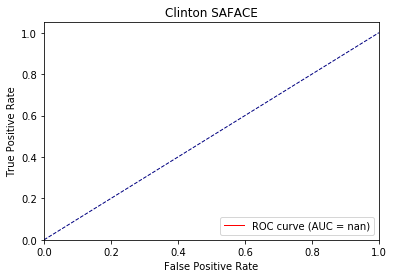

Directory already exists!
hc_saface 1 ap tensor([0.9948, 0.0163]) loss : 0.20970380306243896 0.31187239811883716 tid : 200 tg tensor([[0]], device='cuda:0')
hc_saface 1 ap tensor([0.9956, 0.0160]) loss : 0.2210065722465515 0.3056329686568814 tid : 400 tg tensor([[0]], device='cuda:0')
TEST hc_saface 1 ap tensor([1., 0.]) loss : 0.23663288354873657 0.22063652465217992 tid : 180 tg tensor([[0]], device='cuda:0')


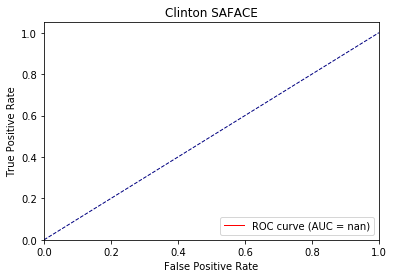

Directory already exists!
hc_saface 2 ap tensor([0.9891, 0.0239]) loss : 0.07433497905731201 0.17771025508352853 tid : 200 tg tensor([[0]], device='cuda:0')
hc_saface 2 ap tensor([0.9922, 0.0224]) loss : 0.07879805564880371 0.16381688865025837 tid : 400 tg tensor([[0]], device='cuda:0')
TEST hc_saface 2 ap tensor([1., 0.]) loss : 0.13322538137435913 0.1285939749918486 tid : 180 tg tensor([[0]], device='cuda:0')


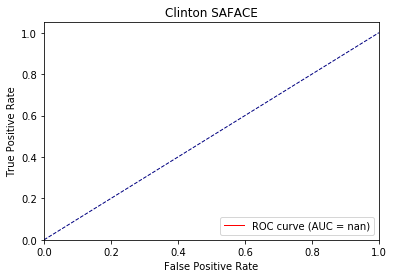

Directory already exists!
hc_neuface 0 ap tensor([0.7689, 0.3894]) loss : 0.7734923362731934 0.6899522396384693 tid : 200 tg tensor([[0]], device='cuda:0')
hc_neuface 0 ap tensor([0.7208, 0.3996]) loss : 0.7520923614501953 0.6747546929227727 tid : 400 tg tensor([[1]], device='cuda:0')
TEST hc_neuface 0 ap tensor([0.4947, 0.6389]) loss : 0.8198531270027161 0.7168927788734436 tid : 180 tg tensor([[1]], device='cuda:0')


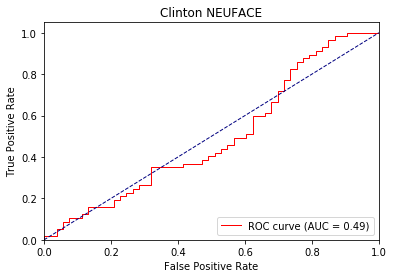

Directory already exists!
hc_neuface 1 ap tensor([0.7356, 0.3688]) loss : 0.7770179510116577 0.6737449873577465 tid : 400 tg tensor([[1]], device='cuda:0')
hc_neuface 1 ap tensor([0.8326, 0.5639]) loss : 0.655570387840271 0.6392670469173533 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_neuface 1 ap tensor([0.5130, 0.6757]) loss : 0.8873567581176758 0.7289794267792451 tid : 180 tg tensor([[1]], device='cuda:0')


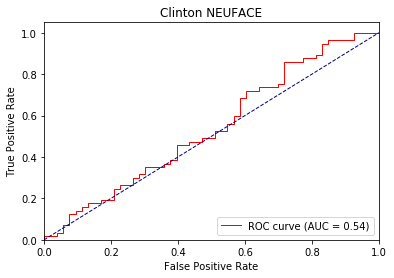

Directory already exists!
hc_neuface 2 ap tensor([0.9008, 0.6838]) loss : 0.8608452677726746 0.5993610547752831 tid : 400 tg tensor([[1]], device='cuda:0')
hc_neuface 2 ap tensor([0.8901, 0.6908]) loss : 0.570682168006897 0.6065435719733335 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_neuface 2 ap tensor([0.5615, 0.6894]) loss : 0.9309192299842834 0.7329548518908652 tid : 180 tg tensor([[1]], device='cuda:0')


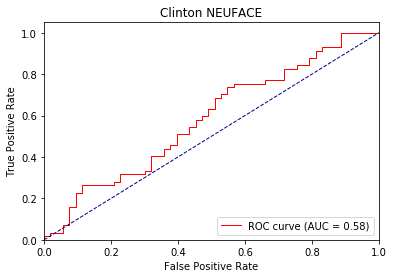

Directory already exists!
hc_inapprop 0 ap tensor([1., 0.]) loss : 0.7838565111160278 0.7326110442479451 tid : 400 tg tensor([[0]], device='cuda:0')
hc_inapprop 0 ap tensor([1., 0.]) loss : 0.4323907494544983 0.5451073133643123 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_inapprop 0 ap tensor([1., 0.]) loss : 0.45948484539985657 0.41098674112244654 tid : 180 tg tensor([[0]], device='cuda:0')


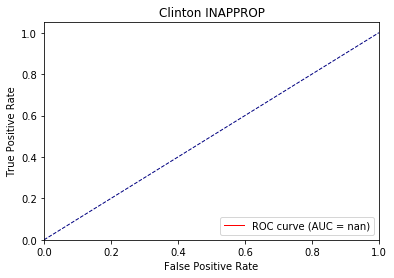

Directory already exists!
hc_inapprop 1 ap tensor([1., 0.]) loss : 0.17262905836105347 0.2507987212772152 tid : 200 tg tensor([[0]], device='cuda:0')
hc_inapprop 1 ap tensor([1., 0.]) loss : 0.18528711795806885 0.23158868412562025 tid : 400 tg tensor([[0]], device='cuda:0')
TEST hc_inapprop 1 ap tensor([1., 0.]) loss : 0.25788694620132446 0.20319730278692746 tid : 180 tg tensor([[0]], device='cuda:0')


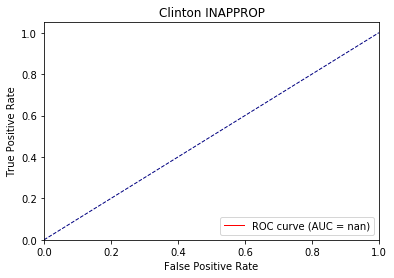

Directory already exists!
hc_inapprop 2 ap tensor([1., 0.]) loss : 0.11410176753997803 0.09172711769739787 tid : 200 tg tensor([[0]], device='cuda:0')
hc_inapprop 2 ap tensor([1., 0.]) loss : 0.061614394187927246 0.10279921096026752 tid : 400 tg tensor([[0]], device='cuda:0')
TEST hc_inapprop 2 ap tensor([1., 0.]) loss : 0.13947951793670654 0.09822770247333928 tid : 180 tg tensor([[0]], device='cuda:0')


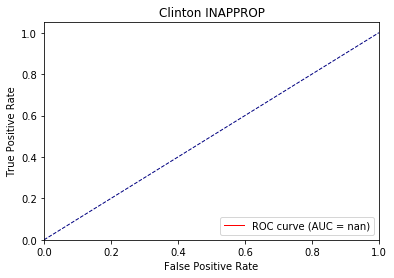

Directory already exists!
hc_affgest 0 ap tensor([0.8785, 0.0444]) loss : 0.5106431245803833 0.6404361175425226 tid : 200 tg tensor([[0]], device='cuda:0')
hc_affgest 0 ap tensor([0.9208, 0.0488]) loss : 0.3862251341342926 0.5861257064555373 tid : 400 tg tensor([[0]], device='cuda:0')
TEST hc_affgest 0 ap tensor([1., 0.]) loss : 0.3367753028869629 0.3412415879337411 tid : 180 tg tensor([[0]], device='cuda:0')


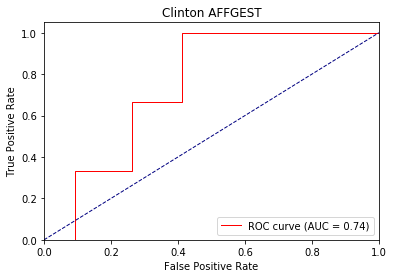

Directory already exists!
hc_affgest 1 ap tensor([0.9823, 0.1552]) loss : 0.20745950937271118 0.31147145729560355 tid : 400 tg tensor([[0]], device='cuda:0')
hc_affgest 1 ap tensor([0.9827, 0.1546]) loss : 0.17310142517089844 0.3099979220292507 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_affgest 1 ap tensor([1., 0.]) loss : 0.19343560934066772 0.21220283523986214 tid : 180 tg tensor([[0]], device='cuda:0')


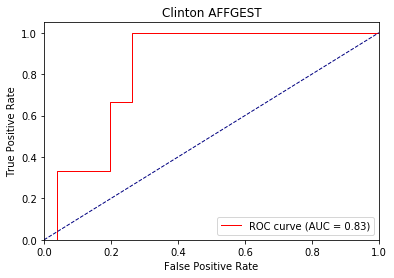

Directory already exists!
hc_affgest 2 ap tensor([0.9910, 0.1810]) loss : 0.14999163150787354 0.23299651665072288 tid : 200 tg tensor([[0]], device='cuda:0')
hc_affgest 2 ap tensor([0.9849, 0.1906]) loss : 0.14075982570648193 0.23041635171630376 tid : 400 tg tensor([[0]], device='cuda:0')
TEST hc_affgest 2 ap tensor([1., 0.]) loss : 0.12188899517059326 0.15387499646136635 tid : 180 tg tensor([[0]], device='cuda:0')


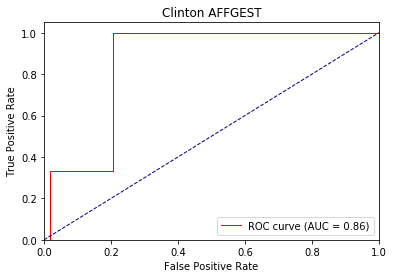

Directory already exists!
hc_defgest 0 ap tensor([0.9131, 0.1390]) loss : 0.8048224449157715 0.6371939477800321 tid : 400 tg tensor([[1]], device='cuda:0')
hc_defgest 0 ap tensor([0.9607, 0.1539]) loss : 0.38814806938171387 0.5808994061238056 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_defgest 0 ap tensor([0.9392, 0.4618]) loss : 0.4659916162490845 0.5094238566724878 tid : 180 tg tensor([[0]], device='cuda:0')


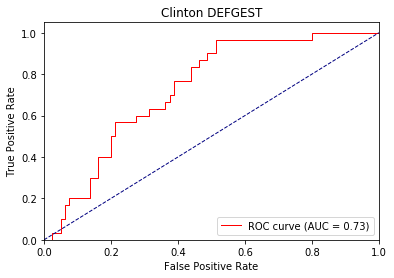

Directory already exists!
hc_defgest 1 ap tensor([0.9717, 0.6245]) loss : 1.103130578994751 0.41460336558520794 tid : 400 tg tensor([[1]], device='cuda:0')
hc_defgest 1 ap tensor([0.9676, 0.2092]) loss : 0.22648781538009644 0.3785192920856204 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_defgest 1 ap tensor([0.9466, 0.5228]) loss : 0.30000004172325134 0.45041859385214356 tid : 180 tg tensor([[0]], device='cuda:0')


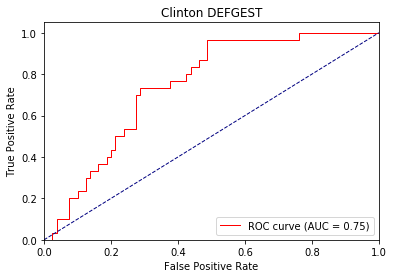

Directory already exists!
hc_defgest 2 ap tensor([0.9708, 0.1819]) loss : 1.5792210102081299 0.3076798879770259 tid : 400 tg tensor([[1]], device='cuda:0')
hc_defgest 2 ap tensor([0.9712, 0.1818]) loss : 0.1600642204284668 0.3063128245450377 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_defgest 2 ap tensor([0.9502, 0.5277]) loss : 0.21736747026443481 0.4333203740810093 tid : 180 tg tensor([[0]], device='cuda:0')


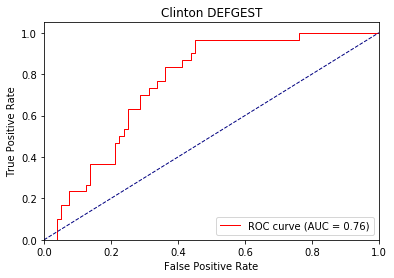

Directory already exists!
hc_agentic 0 ap tensor([0.5460, 0.3696]) loss : 0.7248129844665527 0.7029674758965319 tid : 400 tg tensor([[1]], device='cuda:0')
hc_agentic 0 ap tensor([0.7840, 0.6299]) loss : 0.6440635323524475 0.6511237520150666 tid : 200 tg tensor([[1]], device='cuda:0')
TEST hc_agentic 0 ap tensor([0.8930, 0.8422]) loss : 0.96055006980896 0.5784728456484644 tid : 180 tg tensor([[1]], device='cuda:0')


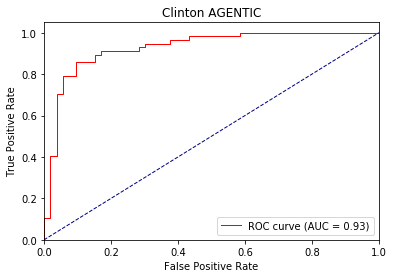

Directory already exists!
hc_agentic 1 ap tensor([0.9664, 0.9389]) loss : 0.5050991177558899 0.4662371508371523 tid : 200 tg tensor([[1]], device='cuda:0')
hc_agentic 1 ap tensor([0.9690, 0.9430]) loss : 0.3653908371925354 0.4604528384706961 tid : 400 tg tensor([[1]], device='cuda:0')
TEST hc_agentic 1 ap tensor([0.9107, 0.9013]) loss : 1.0746700763702393 0.46872373631126 tid : 180 tg tensor([[1]], device='cuda:0')


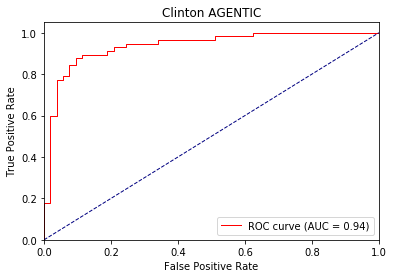

Directory already exists!
hc_agentic 2 ap tensor([0.9684, 0.9729]) loss : 0.2507082223892212 0.3414325622505829 tid : 400 tg tensor([[1]], device='cuda:0')
hc_agentic 2 ap tensor([0.9695, 0.9660]) loss : 0.397645503282547 0.34446405255517293 tid : 200 tg tensor([[1]], device='cuda:0')
TEST hc_agentic 2 ap tensor([0.9268, 0.9113]) loss : 1.1967853307724 0.4059571623802185 tid : 180 tg tensor([[1]], device='cuda:0')


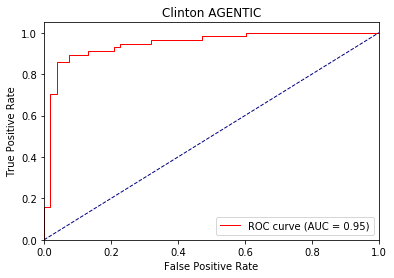

Directory already exists!
hc_waveoff 0 ap tensor([0.9021, 0.6678]) loss : 0.6971331238746643 0.5777525547941001 tid : 200 tg tensor([[1]], device='cuda:0')
hc_waveoff 0 ap tensor([0.9023, 0.6834]) loss : 0.5080590844154358 0.571767257917218 tid : 400 tg tensor([[1]], device='cuda:0')
TEST hc_waveoff 0 ap tensor([0.8823, 0.6497]) loss : 0.7429574728012085 0.6041084496598494 tid : 180 tg tensor([[1]], device='cuda:0')


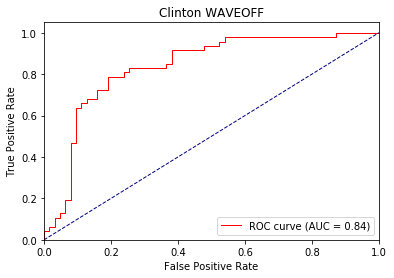

Directory already exists!
hc_waveoff 1 ap tensor([0.9465, 0.8006]) loss : 0.6771073937416077 0.464547011085221 tid : 200 tg tensor([[1]], device='cuda:0')
hc_waveoff 1 ap tensor([0.9448, 0.7888]) loss : 0.4199373126029968 0.4663955233260697 tid : 400 tg tensor([[1]], device='cuda:0')
TEST hc_waveoff 1 ap tensor([0.8930, 0.6460]) loss : 0.8967264890670776 0.5743946056616934 tid : 180 tg tensor([[1]], device='cuda:0')


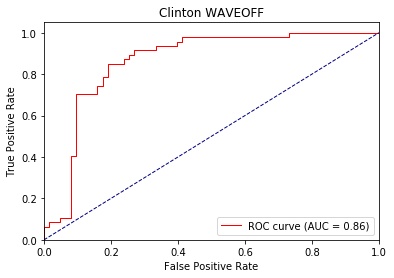

Directory already exists!
hc_waveoff 2 ap tensor([0.9562, 0.8034]) loss : 0.6955397129058838 0.4092667176933486 tid : 200 tg tensor([[1]], device='cuda:0')
hc_waveoff 2 ap tensor([0.9487, 0.7626]) loss : 0.37095147371292114 0.41918125919220023 tid : 400 tg tensor([[1]], device='cuda:0')
TEST hc_waveoff 2 ap tensor([0.8977, 0.6495]) loss : 1.0330142974853516 0.5632424801588058 tid : 180 tg tensor([[1]], device='cuda:0')


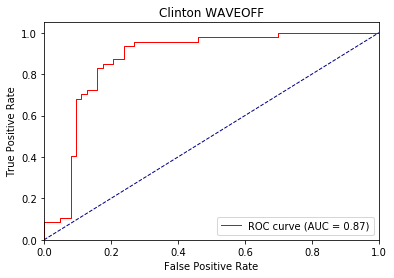

Directory already exists!
hc_nvtic1 0 ap tensor([0.8356, 0.0896]) loss : 0.45934852957725525 0.5680807783551838 tid : 400 tg tensor([[0]], device='cuda:0')
hc_nvtic1 0 ap tensor([0.8870, 0.1585]) loss : 0.335422545671463 0.519148144228705 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic1 0 ap tensor([0.9128, 0.2295]) loss : 0.31922096014022827 0.4598223598379838 tid : 180 tg tensor([[0]], device='cuda:0')


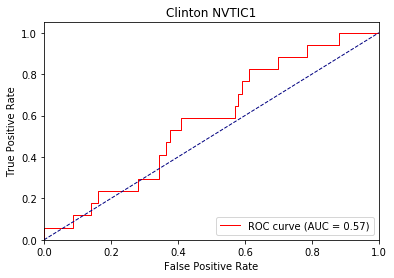

Directory already exists!
hc_nvtic1 1 ap tensor([0.9765, 0.7500]) loss : 0.29900598526000977 0.46756464784795587 tid : 400 tg tensor([[0]], device='cuda:0')
hc_nvtic1 1 ap tensor([0.9264, 0.2753]) loss : 0.28969690203666687 0.453428759793692 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic1 1 ap tensor([0.9271, 0.2747]) loss : 0.2765977382659912 0.42582494020462036 tid : 180 tg tensor([[0]], device='cuda:0')


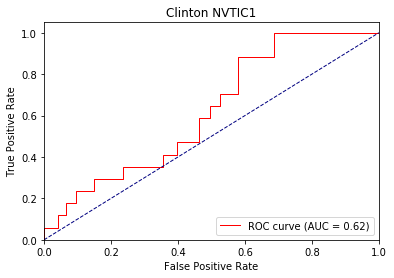

Directory already exists!
hc_nvtic1 2 ap tensor([0.9986, 0.7500]) loss : 0.20226263999938965 0.28173388655369097 tid : 400 tg tensor([[0]], device='cuda:0')
hc_nvtic1 2 ap tensor([0.9286, 0.3020]) loss : 0.21548086404800415 0.4187183431093244 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic1 2 ap tensor([0.9505, 0.4346]) loss : 0.2619786858558655 0.4052496011319913 tid : 180 tg tensor([[0]], device='cuda:0')


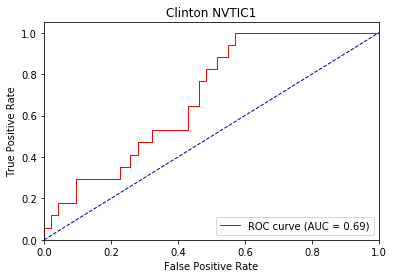

Directory already exists!
hc_nvtic2 0 ap tensor([0.7854, 0.1185]) loss : 0.5769935250282288 0.7129487771736948 tid : 400 tg tensor([[0]], device='cuda:0')
hc_nvtic2 0 ap tensor([0.8258, 0.1394]) loss : 0.4498409628868103 0.6531528710798405 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic2 0 ap tensor([0.9617, 0.2191]) loss : 0.40705662965774536 0.46006213050139577 tid : 180 tg tensor([[0]], device='cuda:0')


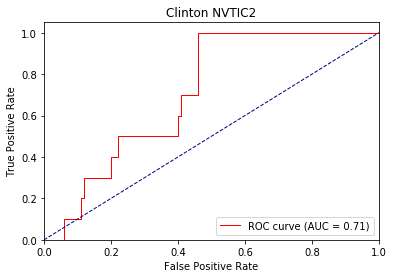

Directory already exists!
hc_nvtic2 1 ap tensor([1., 0.]) loss : 0.3306538462638855 0.40835289657115936 tid : 400 tg tensor([[0]], device='cuda:0')
hc_nvtic2 1 ap tensor([0.9378, 0.2187]) loss : 0.24191537499427795 0.45493833101152076 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic2 1 ap tensor([0.9761, 0.4464]) loss : 0.3394477963447571 0.3666556140309886 tid : 180 tg tensor([[0]], device='cuda:0')


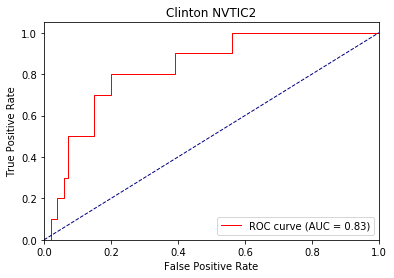

Directory already exists!
hc_nvtic2 2 ap tensor([0.9501, 0.3214]) loss : 0.14329677820205688 0.4099246759793748 tid : 400 tg tensor([[0]], device='cuda:0')
hc_nvtic2 2 ap tensor([0.9628, 0.3106]) loss : 0.18673250079154968 0.39128187706259554 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic2 2 ap tensor([0.9800, 0.6167]) loss : 0.3218502998352051 0.3101077495436919 tid : 180 tg tensor([[0]], device='cuda:0')


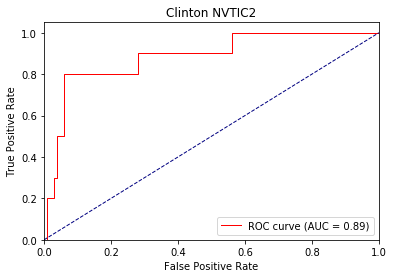

Directory already exists!
hc_nvtic3 0 ap tensor([0.9942, 0.0036]) loss : 0.2290751039981842 0.4208329285709014 tid : 200 tg tensor([[0]], device='cuda:0')
hc_nvtic3 0 ap tensor([0.9878, 0.0041]) loss : 0.29464709758758545 0.3963470772460655 tid : 400 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic3 0 ap tensor([0.9342, 0.0526]) loss : 0.33829525113105774 0.36774858989213643 tid : 180 tg tensor([[0]], device='cuda:0')


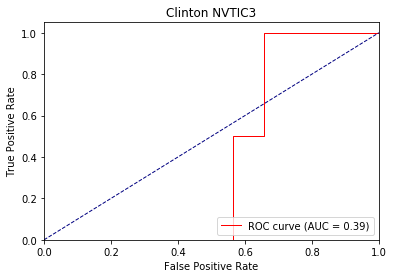

Directory already exists!
hc_nvtic3 1 ap tensor([0.9962, 0.0078]) loss : 0.16924536228179932 0.22185766883194447 tid : 400 tg tensor([[0]], device='cuda:0')
hc_nvtic3 1 ap tensor([0.9983, 0.0066]) loss : 0.07063865661621094 0.19015884197810118 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic3 1 ap tensor([0.9329, 0.0523]) loss : 0.1853269338607788 0.26715886671292155 tid : 180 tg tensor([[0]], device='cuda:0')


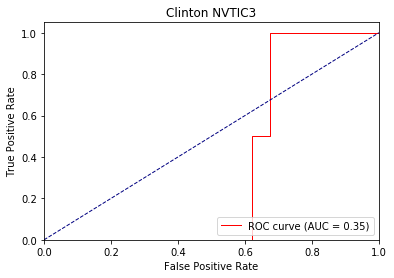

Directory already exists!
hc_nvtic3 2 ap tensor([0.9935, 0.0187]) loss : 0.03774905204772949 0.12463336240100321 tid : 200 tg tensor([[0]], device='cuda:0')
hc_nvtic3 2 ap tensor([0.9975, 0.0116]) loss : 0.04669451713562012 0.10255255663292456 tid : 400 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic3 2 ap tensor([0.9322, 0.0519]) loss : 0.10065281391143799 0.2426796179068716 tid : 180 tg tensor([[0]], device='cuda:0')


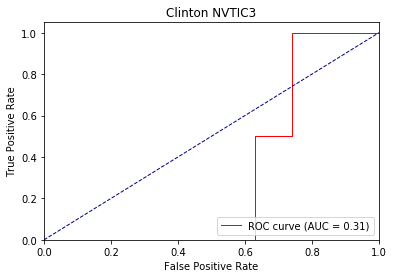

Directory already exists!
hc_nvtic5 0 ap tensor([1., 0.]) loss : 0.6658581495285034 0.846944272518158 tid : 200 tg tensor([[0]], device='cuda:0')
hc_nvtic5 0 ap tensor([1., 0.]) loss : 0.5509600639343262 0.7116879056198429 tid : 400 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic5 0 ap tensor([1., 0.]) loss : 0.5217076539993286 0.41000716545079885 tid : 180 tg tensor([[0]], device='cuda:0')


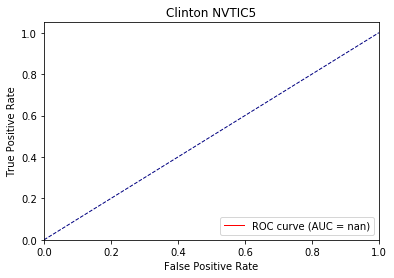

Directory already exists!
hc_nvtic5 1 ap tensor([1., 0.]) loss : 0.27235352993011475 0.3212622240417362 tid : 400 tg tensor([[0]], device='cuda:0')
hc_nvtic5 1 ap tensor([1., 0.]) loss : 0.1319696307182312 0.28250186881493955 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic5 1 ap tensor([1., 0.]) loss : 0.2851182222366333 0.20794011417188143 tid : 180 tg tensor([[0]], device='cuda:0')


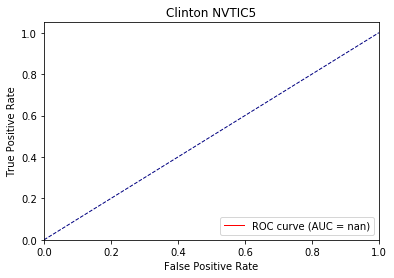

Directory already exists!
hc_nvtic5 2 ap tensor([1., 0.]) loss : 0.08940625190734863 0.15656308389522813 tid : 200 tg tensor([[0]], device='cuda:0')
hc_nvtic5 2 ap tensor([1., 0.]) loss : 0.12306004762649536 0.1514966086840924 tid : 400 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic5 2 ap tensor([1., 0.]) loss : 0.1517956256866455 0.10626102199679927 tid : 180 tg tensor([[0]], device='cuda:0')


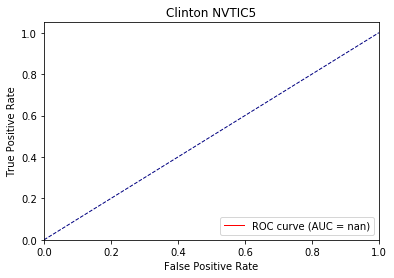

Directory already exists!
hc_nvtic4 0 ap tensor([0.9924, 0.0100]) loss : 0.3628477454185486 0.5080035331249237 tid : 400 tg tensor([[0]], device='cuda:0')
hc_nvtic4 0 ap tensor([0.9918, 0.0099]) loss : 0.30692172050476074 0.4613501414957239 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic4 0 ap tensor([0.9742, 0.0943]) loss : 0.5215457677841187 0.36627716139743205 tid : 180 tg tensor([[0]], device='cuda:0')


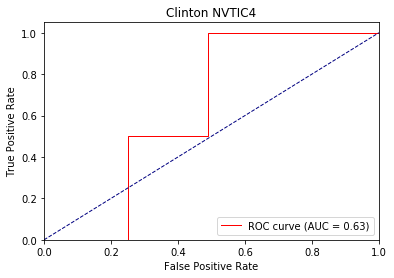

Directory already exists!
hc_nvtic4 1 ap tensor([0.9980, 0.0384]) loss : 0.14442968368530273 0.2220996220444524 tid : 200 tg tensor([[0]], device='cuda:0')
hc_nvtic4 1 ap tensor([0.9990, 0.0317]) loss : 0.11508280038833618 0.20187760837822682 tid : 400 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic4 1 ap tensor([0.9723, 0.0931]) loss : 0.29914167523384094 0.2538330045185591 tid : 180 tg tensor([[0]], device='cuda:0')


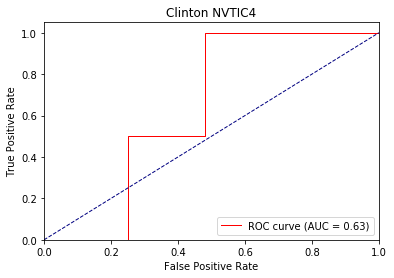

Directory already exists!
hc_nvtic4 2 ap tensor([0.9992, 0.1000]) loss : 0.0747002363204956 0.1267184107690244 tid : 400 tg tensor([[0]], device='cuda:0')
hc_nvtic4 2 ap tensor([0.9993, 0.1270]) loss : 0.04180598258972168 0.10442529938050679 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic4 2 ap tensor([0.9703, 0.0861]) loss : 0.17906993627548218 0.22062579973747856 tid : 180 tg tensor([[0]], device='cuda:0')


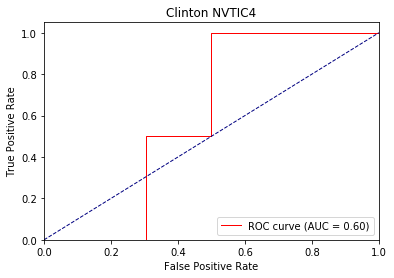

Directory already exists!
hc_interruptions 0 ap tensor([1., 0.]) loss : 0.6370921730995178 0.5742695645491283 tid : 400 tg tensor([[0]], device='cuda:0')
hc_interruptions 0 ap tensor([0.9928, 0.0171]) loss : 0.3502321243286133 0.455598942015642 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_interruptions 0 ap tensor([1., 0.]) loss : 0.29919034242630005 0.3083441751567941 tid : 180 tg tensor([[0]], device='cuda:0')


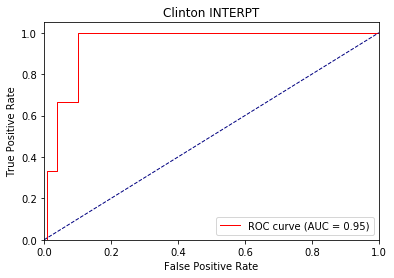

Directory already exists!
hc_interruptions 1 ap tensor([0.9987, 0.2857]) loss : 0.214463472366333 0.24495890696843464 tid : 200 tg tensor([[0]], device='cuda:0')
hc_interruptions 1 ap tensor([0.9980, 0.1957]) loss : 0.21350842714309692 0.22245834553413255 tid : 400 tg tensor([[0]], device='cuda:0')
TEST hc_interruptions 1 ap tensor([1., 0.]) loss : 0.17117202281951904 0.1628650442550057 tid : 180 tg tensor([[0]], device='cuda:0')


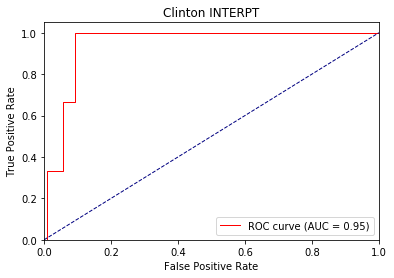

Directory already exists!
hc_interruptions 2 ap tensor([0.9987, 0.0883]) loss : 0.07617413997650146 0.12562059487799088 tid : 200 tg tensor([[0]], device='cuda:0')
hc_interruptions 2 ap tensor([0.9987, 0.1247]) loss : 0.07654821872711182 0.12179732794019138 tid : 400 tg tensor([[0]], device='cuda:0')
TEST hc_interruptions 2 ap tensor([1., 0.]) loss : 0.10323596000671387 0.09220164151568162 tid : 180 tg tensor([[0]], device='cuda:0')


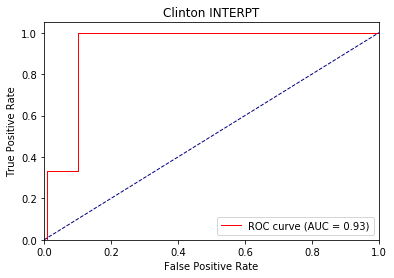

Directory already exists!
hc_lookat2 0 ap tensor([0.7917, 0.8511]) loss : 0.726493239402771 0.6094817059307263 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_lookat2 0 ap tensor([1., 0.]) loss : 0.8514960408210754 0.5996371917426586 tid : 30 tg tensor([[0]], device='cuda:0')
TEST hc_lookat2 0 ap tensor([0.9330, 0.7222]) loss : 0.7270447015762329 0.5856524074077606 tid : 90 tg tensor([[0]], device='cuda:0')
TEST hc_lookat2 0 ap tensor([0.9528, 0.8040]) loss : 1.508907437324524 0.5530260838568211 tid : 150 tg tensor([[0]], device='cuda:0')
TEST hc_lookat2 0 ap tensor([0.9464, 0.8092]) loss : 0.8728073835372925 0.5610852921009064 tid : 180 tg tensor([[0]], device='cuda:0')
TEST hc_lookat2 0 ap tensor([0.9651, 0.8624]) loss : 0.2603189945220947 0.5549318480801273 tid : 390 tg tensor([[1]], device='cuda:0')


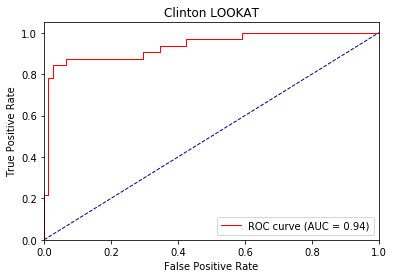

Directory already exists!
hc_lookat2 1 ap tensor([0.9644, 0.9808]) loss : 0.6146987676620483 0.4128343733517747 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_lookat2 1 ap tensor([1., 0.]) loss : 0.8200518488883972 0.517842810600996 tid : 30 tg tensor([[0]], device='cuda:0')
TEST hc_lookat2 1 ap tensor([0.9079, 0.7092]) loss : 0.8258475065231323 0.5111685454845428 tid : 90 tg tensor([[0]], device='cuda:0')
TEST hc_lookat2 1 ap tensor([0.9402, 0.8468]) loss : 1.8594228029251099 0.4627637952566147 tid : 150 tg tensor([[0]], device='cuda:0')
TEST hc_lookat2 1 ap tensor([0.9350, 0.8509]) loss : 0.8834692239761353 0.47029161036014555 tid : 180 tg tensor([[0]], device='cuda:0')
TEST hc_lookat2 1 ap tensor([0.9575, 0.8901]) loss : 0.1626453995704651 0.4507876243684199 tid : 390 tg tensor([[1]], device='cuda:0')


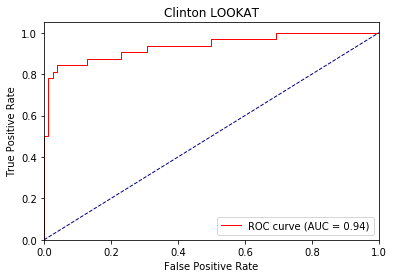

Directory already exists!
hc_lookat2 2 ap tensor([0.9444, 0.9604]) loss : 0.41151800751686096 0.346238395014962 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_lookat2 2 ap tensor([1., 0.]) loss : 0.8048412203788757 0.47471775114536285 tid : 30 tg tensor([[0]], device='cuda:0')
TEST hc_lookat2 2 ap tensor([0.8906, 0.6988]) loss : 0.9177249670028687 0.4866775441169739 tid : 90 tg tensor([[0]], device='cuda:0')
TEST hc_lookat2 2 ap tensor([0.9297, 0.8543]) loss : 2.143338441848755 0.4252292364835739 tid : 150 tg tensor([[0]], device='cuda:0')
TEST hc_lookat2 2 ap tensor([0.9272, 0.8578]) loss : 0.8970593214035034 0.42988933980464933 tid : 180 tg tensor([[0]], device='cuda:0')
TEST hc_lookat2 2 ap tensor([0.9535, 0.8942]) loss : 0.113292396068573 0.397776709748553 tid : 390 tg tensor([[1]], device='cuda:0')


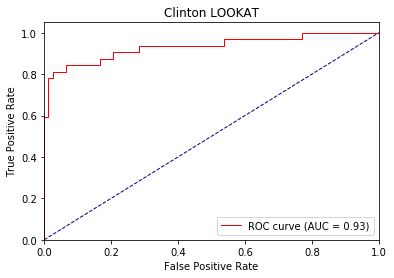

Directory already exists!
hc_brush1 0 ap tensor([0.9005, 0.1701]) loss : 0.3580911159515381 0.5602921076655092 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_brush1 0 ap tensor([1., 0.]) loss : 0.37061774730682373 0.3755151256918907 tid : 30 tg tensor([[0]], device='cuda:0')
TEST hc_brush1 0 ap tensor([0.9278, 0.0455]) loss : 0.6871663928031921 0.4192469644546509 tid : 90 tg tensor([[0]], device='cuda:0')
TEST hc_brush1 0 ap tensor([0.9339, 0.0655]) loss : 0.36812466382980347 0.42806330770254136 tid : 150 tg tensor([[0]], device='cuda:0')
TEST hc_brush1 0 ap tensor([0.9382, 0.2884]) loss : 0.43723177909851074 0.4528131175041199 tid : 180 tg tensor([[0]], device='cuda:0')
TEST hc_brush1 0 ap tensor([0.9262, 0.2719]) loss : 0.4127844274044037 0.47319031032648956 tid : 390 tg tensor([[0]], device='cuda:0')


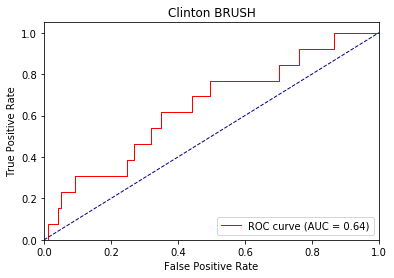

Directory already exists!
hc_brush1 1 ap tensor([0.9417, 0.2138]) loss : 0.28310149908065796 0.4495653814952308 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_brush1 1 ap tensor([1., 0.]) loss : 0.2747175693511963 0.2596435844898224 tid : 30 tg tensor([[0]], device='cuda:0')
TEST hc_brush1 1 ap tensor([0.9278, 0.0455]) loss : 0.6457967758178711 0.3236201548576355 tid : 90 tg tensor([[0]], device='cuda:0')
TEST hc_brush1 1 ap tensor([0.9330, 0.0627]) loss : 0.26544666290283203 0.3328486025333405 tid : 150 tg tensor([[0]], device='cuda:0')
TEST hc_brush1 1 ap tensor([0.9378, 0.3834]) loss : 0.3422498404979706 0.3660841816663742 tid : 180 tg tensor([[0]], device='cuda:0')
TEST hc_brush1 1 ap tensor([0.9263, 0.3210]) loss : 0.2988884449005127 0.4034126671877774 tid : 390 tg tensor([[0]], device='cuda:0')


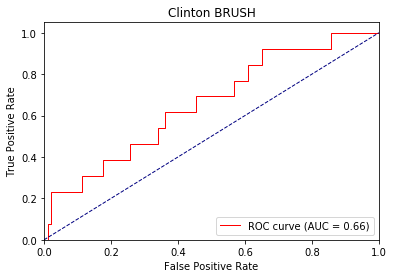

Directory already exists!
hc_brush1 2 ap tensor([0.9358, 0.2448]) loss : 0.21088099479675293 0.4066594822986706 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_brush1 2 ap tensor([1., 0.]) loss : 0.22187834978103638 0.19405679404735565 tid : 30 tg tensor([[0]], device='cuda:0')
TEST hc_brush1 2 ap tensor([0.9278, 0.0455]) loss : 0.6052333116531372 0.277219614982605 tid : 90 tg tensor([[0]], device='cuda:0')
TEST hc_brush1 2 ap tensor([0.9348, 0.0687]) loss : 0.21026861667633057 0.28515702337026594 tid : 150 tg tensor([[0]], device='cuda:0')
TEST hc_brush1 2 ap tensor([0.9391, 0.3883]) loss : 0.2844451069831848 0.32279616117477417 tid : 180 tg tensor([[0]], device='cuda:0')
TEST hc_brush1 2 ap tensor([0.9262, 0.3225]) loss : 0.24159735441207886 0.37425378158495026 tid : 390 tg tensor([[0]], device='cuda:0')


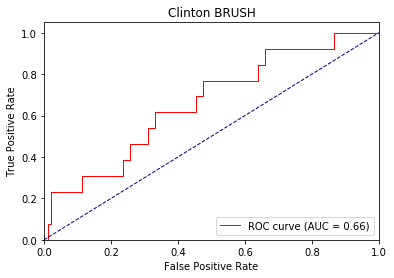

Directory already exists!
hc_nvdis1 0 ap tensor([0.8501, 0.1354]) loss : 0.6606725454330444 0.7027543018845951 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_nvdis1 0 ap tensor([0.4512, 0.5821]) loss : 0.34333381056785583 0.80278005823493 tid : 30 tg tensor([[0]], device='cuda:0')
TEST hc_nvdis1 0 ap tensor([0.5254, 0.5007]) loss : 0.7642267942428589 0.7860338997840881 tid : 90 tg tensor([[0]], device='cuda:0')
TEST hc_nvdis1 0 ap tensor([0.5688, 0.3330]) loss : 0.5542577505111694 0.7095031194388867 tid : 150 tg tensor([[0]], device='cuda:0')
TEST hc_nvdis1 0 ap tensor([0.5690, 0.3539]) loss : 0.33515962958335876 0.7048285132646561 tid : 180 tg tensor([[0]], device='cuda:0')
TEST hc_nvdis1 0 ap tensor([0.7359, 0.2742]) loss : 0.36011803150177 0.6040665933064052 tid : 390 tg tensor([[0]], device='cuda:0')


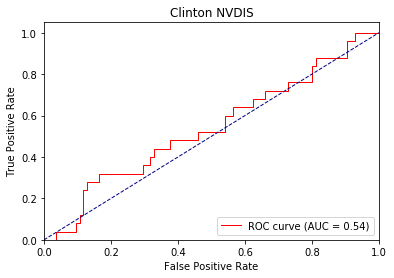

Directory already exists!
hc_nvdis1 1 ap tensor([0.9736, 0.2913]) loss : 0.2819754481315613 0.39955923443069 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_nvdis1 1 ap tensor([0.5595, 0.6500]) loss : 0.18724274635314941 0.9264418035745621 tid : 30 tg tensor([[0]], device='cuda:0')
TEST hc_nvdis1 1 ap tensor([0.5722, 0.5409]) loss : 0.8416867256164551 0.9466341423988343 tid : 90 tg tensor([[0]], device='cuda:0')
TEST hc_nvdis1 1 ap tensor([0.6188, 0.3786]) loss : 0.3014657497406006 0.7982724487781525 tid : 150 tg tensor([[0]], device='cuda:0')
TEST hc_nvdis1 1 ap tensor([0.6251, 0.3774]) loss : 0.1957101821899414 0.7980052661895752 tid : 180 tg tensor([[0]], device='cuda:0')
TEST hc_nvdis1 1 ap tensor([0.7534, 0.2861]) loss : 0.18039929866790771 0.6281226943065594 tid : 390 tg tensor([[0]], device='cuda:0')


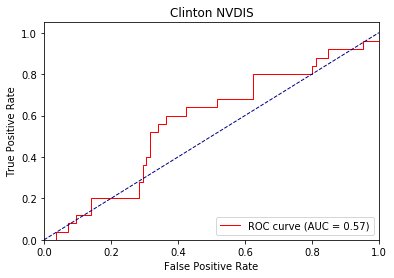

Directory already exists!
hc_nvdis1 2 ap tensor([0.9745, 0.5281]) loss : 0.14835816621780396 0.2823380751839243 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_nvdis1 2 ap tensor([0.6083, 0.7750]) loss : 0.12128239870071411 1.0625072568655014 tid : 30 tg tensor([[0]], device='cuda:0')
TEST hc_nvdis1 2 ap tensor([0.5598, 0.5479]) loss : 0.9377132058143616 1.1170391678810119 tid : 90 tg tensor([[0]], device='cuda:0')
TEST hc_nvdis1 2 ap tensor([0.6152, 0.3862]) loss : 0.19373059272766113 0.9143947899341583 tid : 150 tg tensor([[0]], device='cuda:0')
TEST hc_nvdis1 2 ap tensor([0.6180, 0.3789]) loss : 0.13264012336730957 0.9101435112953186 tid : 180 tg tensor([[0]], device='cuda:0')
TEST hc_nvdis1 2 ap tensor([0.7467, 0.2886]) loss : 0.1125495433807373 0.6895442334088412 tid : 390 tg tensor([[0]], device='cuda:0')


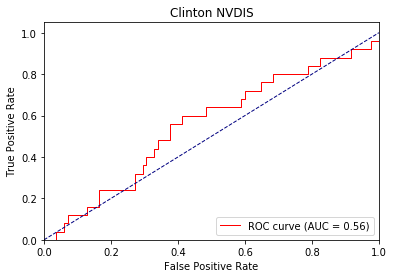

Directory already exists!
hc_look 0 ap tensor([0.5734, 0.8809]) loss : 0.4560701847076416 0.6254860023036599 tid : 200 tg tensor([[1]], device='cuda:0')
TEST hc_look 0 ap tensor([0., 1.]) loss : 0.5208537578582764 0.4300728775560856 tid : 30 tg tensor([[1]], device='cuda:0')
TEST hc_look 0 ap tensor([0.5833, 0.9965]) loss : 0.7222323417663574 0.4462701880931854 tid : 90 tg tensor([[1]], device='cuda:0')
TEST hc_look 0 ap tensor([0.5845, 0.9949]) loss : 0.6345416903495789 0.46697411239147185 tid : 150 tg tensor([[1]], device='cuda:0')
TEST hc_look 0 ap tensor([0.5845, 0.9969]) loss : 0.6068261861801147 0.47628562748432157 tid : 180 tg tensor([[1]], device='cuda:0')
TEST hc_look 0 ap tensor([0.4130, 0.9741]) loss : 0.8476446866989136 0.49844030977843645 tid : 390 tg tensor([[1]], device='cuda:0')


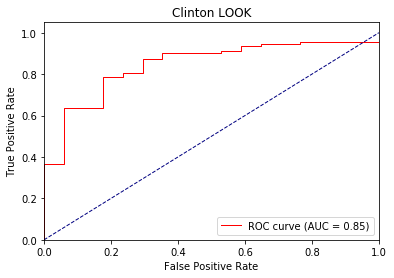

Directory already exists!
hc_look 1 ap tensor([0.7457, 0.9485]) loss : 0.2767602801322937 0.48789874730782473 tid : 200 tg tensor([[1]], device='cuda:0')
TEST hc_look 1 ap tensor([0., 1.]) loss : 0.44828489422798157 0.3281260281801224 tid : 30 tg tensor([[1]], device='cuda:0')
TEST hc_look 1 ap tensor([0.5833, 0.9965]) loss : 0.6581962704658508 0.3451283860206604 tid : 90 tg tensor([[1]], device='cuda:0')
TEST hc_look 1 ap tensor([0.6083, 0.9957]) loss : 0.7033515572547913 0.37872297689318657 tid : 150 tg tensor([[1]], device='cuda:0')
TEST hc_look 1 ap tensor([0.6083, 0.9973]) loss : 0.5445665121078491 0.3914923393726349 tid : 180 tg tensor([[1]], device='cuda:0')
TEST hc_look 1 ap tensor([0.4456, 0.9733]) loss : 0.989550769329071 0.427252058084909 tid : 390 tg tensor([[1]], device='cuda:0')


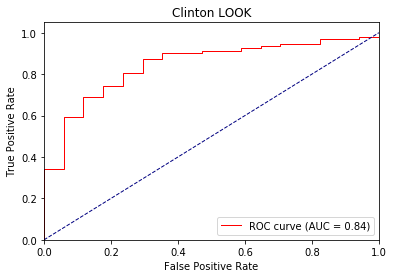

Directory already exists!
hc_look 2 ap tensor([0.7825, 0.9547]) loss : 0.21054238080978394 0.4331568449380852 tid : 200 tg tensor([[1]], device='cuda:0')
TEST hc_look 2 ap tensor([0., 1.]) loss : 0.4026768207550049 0.26524851843714714 tid : 30 tg tensor([[1]], device='cuda:0')
TEST hc_look 2 ap tensor([0.5833, 0.9965]) loss : 0.5937498211860657 0.2858387005329132 tid : 90 tg tensor([[1]], device='cuda:0')
TEST hc_look 2 ap tensor([0.5429, 0.9942]) loss : 0.7473883032798767 0.3292060784995556 tid : 150 tg tensor([[1]], device='cuda:0')
TEST hc_look 2 ap tensor([0.5429, 0.9964]) loss : 0.4845881760120392 0.3417573940753937 tid : 180 tg tensor([[1]], device='cuda:0')
TEST hc_look 2 ap tensor([0.4206, 0.9730]) loss : 1.0918232202529907 0.3894034825362168 tid : 390 tg tensor([[1]], device='cuda:0')


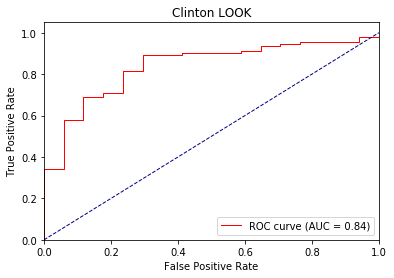

Directory already exists!
hc_eyebrow 0 ap tensor([0.8484, 0.5252]) loss : 0.6847990155220032 0.639688753889453 tid : 200 tg tensor([[1]], device='cuda:0')
TEST hc_eyebrow 0 ap tensor([0.7333, 0.7929]) loss : 0.6029185056686401 0.6617159247398376 tid : 30 tg tensor([[0]], device='cuda:0')
TEST hc_eyebrow 0 ap tensor([0.8223, 0.7668]) loss : 0.5205643773078918 0.615180115699768 tid : 90 tg tensor([[0]], device='cuda:0')
TEST hc_eyebrow 0 ap tensor([0.8592, 0.6572]) loss : 0.35304775834083557 0.5948909550905228 tid : 150 tg tensor([[0]], device='cuda:0')
TEST hc_eyebrow 0 ap tensor([0.8775, 0.6326]) loss : 0.48364371061325073 0.5879370260238648 tid : 180 tg tensor([[0]], device='cuda:0')
TEST hc_eyebrow 0 ap tensor([0.8346, 0.5812]) loss : 0.3258823752403259 0.6103131457582697 tid : 390 tg tensor([[0]], device='cuda:0')


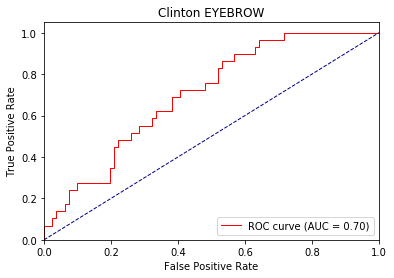

Directory already exists!
hc_eyebrow 1 ap tensor([0., 1.]) loss : 0.7524904608726501 0.7524904608726501 tid : 200 tg tensor([[1]], device='cuda:0')
TEST hc_eyebrow 1 ap tensor([0.7708, 0.8304]) loss : 0.4726898968219757 0.621949341148138 tid : 30 tg tensor([[0]], device='cuda:0')
TEST hc_eyebrow 1 ap tensor([0.8346, 0.7789]) loss : 0.43715834617614746 0.5760845232009888 tid : 90 tg tensor([[0]], device='cuda:0')
TEST hc_eyebrow 1 ap tensor([0.8659, 0.6792]) loss : 0.227972149848938 0.5512116834521293 tid : 150 tg tensor([[0]], device='cuda:0')
TEST hc_eyebrow 1 ap tensor([0.8786, 0.6479]) loss : 0.3944004774093628 0.5496600961685181 tid : 180 tg tensor([[0]], device='cuda:0')
TEST hc_eyebrow 1 ap tensor([0.8386, 0.6054]) loss : 0.179720938205719 0.5889733762710125 tid : 390 tg tensor([[0]], device='cuda:0')


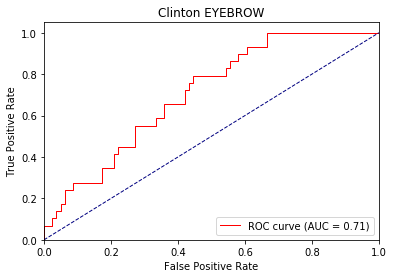

Directory already exists!
hc_eyebrow 2 ap tensor([0.9568, 0.8237]) loss : 0.8441804647445679 0.4215167399637307 tid : 200 tg tensor([[1]], device='cuda:0')
TEST hc_eyebrow 2 ap tensor([0.8042, 0.8929]) loss : 0.3647017478942871 0.6006090715527534 tid : 30 tg tensor([[0]], device='cuda:0')
TEST hc_eyebrow 2 ap tensor([0.8421, 0.7895]) loss : 0.37594085931777954 0.5560621881484985 tid : 90 tg tensor([[0]], device='cuda:0')
TEST hc_eyebrow 2 ap tensor([0.8721, 0.7260]) loss : 0.17009586095809937 0.5298770844936371 tid : 150 tg tensor([[0]], device='cuda:0')
TEST hc_eyebrow 2 ap tensor([0.8845, 0.6924]) loss : 0.3243873715400696 0.5309435749053955 tid : 180 tg tensor([[0]], device='cuda:0')
TEST hc_eyebrow 2 ap tensor([0.8459, 0.6320]) loss : 0.11688315868377686 0.5816534746002842 tid : 390 tg tensor([[0]], device='cuda:0')


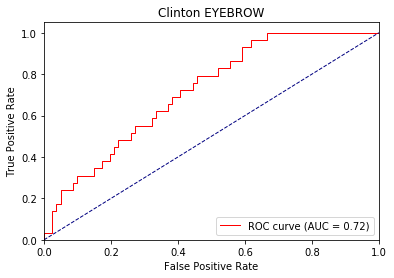

Directory already exists!
hc_atface 0 ap tensor([0.9085, 0.1002]) loss : 0.9582527279853821 0.5853483704473242 tid : 200 tg tensor([[1]], device='cuda:0')
TEST hc_atface 0 ap tensor([0.8556, 0.4167]) loss : 0.4577585458755493 0.5946824811398983 tid : 30 tg tensor([[0]], device='cuda:0')
TEST hc_atface 0 ap tensor([0.8499, 0.4206]) loss : 0.6487265825271606 0.5935281538963317 tid : 90 tg tensor([[0]], device='cuda:0')
TEST hc_atface 0 ap tensor([0.9022, 0.4538]) loss : 0.3703279495239258 0.5607940539717674 tid : 150 tg tensor([[0]], device='cuda:0')
TEST hc_atface 0 ap tensor([0.9177, 0.4479]) loss : 0.44930076599121094 0.554656862616539 tid : 180 tg tensor([[0]], device='cuda:0')
TEST hc_atface 0 ap tensor([0.9029, 0.3672]) loss : 0.2952871322631836 0.5474517120943441 tid : 390 tg tensor([[0]], device='cuda:0')


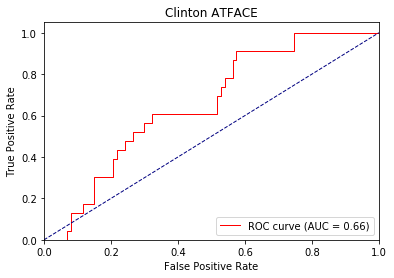

Directory already exists!
hc_atface 1 ap tensor([0.9448, 0.1709]) loss : 1.0583398342132568 0.45212381192155787 tid : 200 tg tensor([[1]], device='cuda:0')
TEST hc_atface 1 ap tensor([0.9762, 0.8333]) loss : 0.29375821352005005 0.533256284892559 tid : 30 tg tensor([[0]], device='cuda:0')
TEST hc_atface 1 ap tensor([0.9310, 0.5888]) loss : 0.5309422016143799 0.5446988618373871 tid : 90 tg tensor([[0]], device='cuda:0')
TEST hc_atface 1 ap tensor([0.9452, 0.5508]) loss : 0.21122479438781738 0.5053886130452157 tid : 150 tg tensor([[0]], device='cuda:0')
TEST hc_atface 1 ap tensor([0.9477, 0.5094]) loss : 0.31461119651794434 0.49883464455604554 tid : 180 tg tensor([[0]], device='cuda:0')
TEST hc_atface 1 ap tensor([0.9264, 0.4176]) loss : 0.1455521583557129 0.4941600390842983 tid : 390 tg tensor([[0]], device='cuda:0')


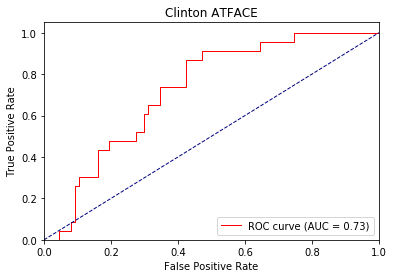

Directory already exists!
hc_atface 2 ap tensor([0.9277, 0.2370]) loss : 1.2994314432144165 0.42173561453819275 tid : 200 tg tensor([[1]], device='cuda:0')
TEST hc_atface 2 ap tensor([0.9762, 0.8333]) loss : 0.20703017711639404 0.5099456161260605 tid : 30 tg tensor([[0]], device='cuda:0')
TEST hc_atface 2 ap tensor([0.9393, 0.6008]) loss : 0.43781521916389465 0.524585268497467 tid : 90 tg tensor([[0]], device='cuda:0')
TEST hc_atface 2 ap tensor([0.9500, 0.5668]) loss : 0.13456177711486816 0.48287988230586054 tid : 150 tg tensor([[0]], device='cuda:0')
TEST hc_atface 2 ap tensor([0.9495, 0.5124]) loss : 0.23631680011749268 0.475848588347435 tid : 180 tg tensor([[0]], device='cuda:0')
TEST hc_atface 2 ap tensor([0.9237, 0.4082]) loss : 0.08277451992034912 0.4756386663232531 tid : 390 tg tensor([[0]], device='cuda:0')


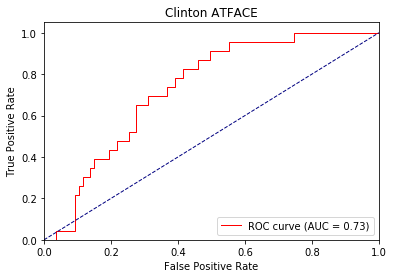

Directory already exists!
hc_feface 0 ap tensor([1., 0.]) loss : 0.415776789188385 0.5518333181575105 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_feface 0 ap tensor([1., 0.]) loss : 0.30785930156707764 0.2730644717812538 tid : 30 tg tensor([[0]], device='cuda:0')
TEST hc_feface 0 ap tensor([1., 0.]) loss : 0.5662297010421753 0.2940513515472412 tid : 90 tg tensor([[0]], device='cuda:0')
TEST hc_feface 0 ap tensor([1., 0.]) loss : 0.2359863519668579 0.29519644305109977 tid : 150 tg tensor([[0]], device='cuda:0')
TEST hc_feface 0 ap tensor([1., 0.]) loss : 0.34009718894958496 0.30135527312755583 tid : 180 tg tensor([[0]], device='cuda:0')
TEST hc_feface 0 ap tensor([0.9674, 0.0139]) loss : 0.3020286560058594 0.32004798348847924 tid : 390 tg tensor([[0]], device='cuda:0')


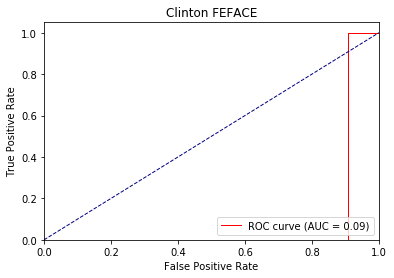

Directory already exists!
hc_feface 1 ap tensor([1., 0.]) loss : 0.18075859546661377 0.22776858046137052 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_feface 1 ap tensor([1., 0.]) loss : 0.10961616039276123 0.12017744779586792 tid : 30 tg tensor([[0]], device='cuda:0')
TEST hc_feface 1 ap tensor([1., 0.]) loss : 0.44487467408180237 0.13432239174842833 tid : 90 tg tensor([[0]], device='cuda:0')
TEST hc_feface 1 ap tensor([1., 0.]) loss : 0.09134948253631592 0.13683680891990663 tid : 150 tg tensor([[0]], device='cuda:0')
TEST hc_feface 1 ap tensor([1., 0.]) loss : 0.15190744400024414 0.14115709841251373 tid : 180 tg tensor([[0]], device='cuda:0')
TEST hc_feface 1 ap tensor([0.9626, 0.0135]) loss : 0.10114622116088867 0.16768968221429106 tid : 390 tg tensor([[0]], device='cuda:0')


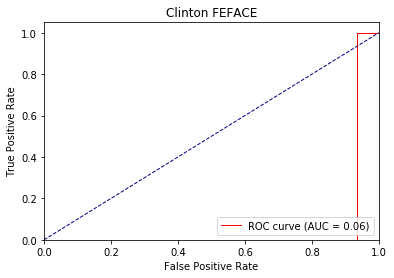

Directory already exists!
hc_feface 2 ap tensor([1., 0.]) loss : 0.05478203296661377 0.09437263670720553 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_feface 2 ap tensor([1., 0.]) loss : 0.03942394256591797 0.0556328147649765 tid : 30 tg tensor([[0]], device='cuda:0')
TEST hc_feface 2 ap tensor([1., 0.]) loss : 0.34220975637435913 0.066921808719635 tid : 90 tg tensor([[0]], device='cuda:0')
TEST hc_feface 2 ap tensor([1., 0.]) loss : 0.039528489112854004 0.06952210441231728 tid : 150 tg tensor([[0]], device='cuda:0')
TEST hc_feface 2 ap tensor([1., 0.]) loss : 0.0682070255279541 0.07251960933208465 tid : 180 tg tensor([[0]], device='cuda:0')
TEST hc_feface 2 ap tensor([0.9709, 0.0143]) loss : 0.039656877517700195 0.1097341323053682 tid : 390 tg tensor([[0]], device='cuda:0')


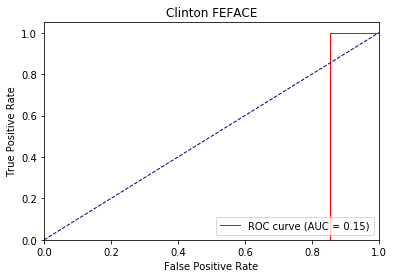

Directory already exists!
hc_hrface 0 ap tensor([0.6383, 0.6683]) loss : 0.6455347537994385 0.6634684642306482 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_hrface 0 ap tensor([1., 0.]) loss : 0.666791558265686 0.6107346713542938 tid : 30 tg tensor([[0]], device='cuda:0')
TEST hc_hrface 0 ap tensor([0.9010, 0.5417]) loss : 0.537090539932251 0.6036705386638641 tid : 90 tg tensor([[1]], device='cuda:0')
TEST hc_hrface 0 ap tensor([0.8984, 0.4428]) loss : 0.6840924620628357 0.6217279642820358 tid : 150 tg tensor([[1]], device='cuda:0')
TEST hc_hrface 0 ap tensor([0.8669, 0.6030]) loss : 0.6450800895690918 0.6157600849866867 tid : 180 tg tensor([[0]], device='cuda:0')
TEST hc_hrface 0 ap tensor([0.8551, 0.5447]) loss : 0.8267773389816284 0.6254390528449765 tid : 390 tg tensor([[0]], device='cuda:0')


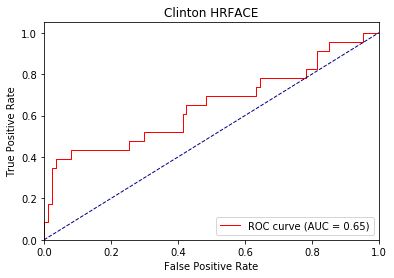

Directory already exists!
hc_hrface 1 ap tensor([0.7893, 0.7193]) loss : 0.6053383946418762 0.6421551485674097 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_hrface 1 ap tensor([1., 0.]) loss : 0.6669973134994507 0.6173495277762413 tid : 30 tg tensor([[0]], device='cuda:0')
TEST hc_hrface 1 ap tensor([0.9010, 0.5417]) loss : 0.44888412952423096 0.5892949414253235 tid : 90 tg tensor([[1]], device='cuda:0')
TEST hc_hrface 1 ap tensor([0.8931, 0.5038]) loss : 0.7087041735649109 0.607472212612629 tid : 150 tg tensor([[1]], device='cuda:0')
TEST hc_hrface 1 ap tensor([0.8676, 0.6411]) loss : 0.6442133188247681 0.598310432434082 tid : 180 tg tensor([[0]], device='cuda:0')
TEST hc_hrface 1 ap tensor([0.8592, 0.5867]) loss : 0.8086882829666138 0.6066565351052717 tid : 390 tg tensor([[0]], device='cuda:0')


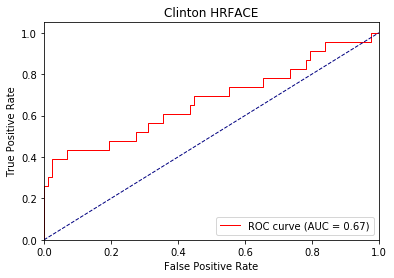

Directory already exists!
hc_hrface 2 ap tensor([0.6730, 0.7847]) loss : 0.6035624742507935 0.6340842232720493 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_hrface 2 ap tensor([1., 0.]) loss : 0.6687463521957397 0.6229147166013718 tid : 30 tg tensor([[0]], device='cuda:0')
TEST hc_hrface 2 ap tensor([0.9010, 0.5417]) loss : 0.37840771675109863 0.5756205344200134 tid : 90 tg tensor([[1]], device='cuda:0')
TEST hc_hrface 2 ap tensor([0.8937, 0.5018]) loss : 0.7371734976768494 0.5929479047656059 tid : 150 tg tensor([[1]], device='cuda:0')
TEST hc_hrface 2 ap tensor([0.8724, 0.6928]) loss : 0.643513560295105 0.5813950598239899 tid : 180 tg tensor([[0]], device='cuda:0')
TEST hc_hrface 2 ap tensor([0.8670, 0.6266]) loss : 0.7775933742523193 0.5888197209153857 tid : 390 tg tensor([[0]], device='cuda:0')


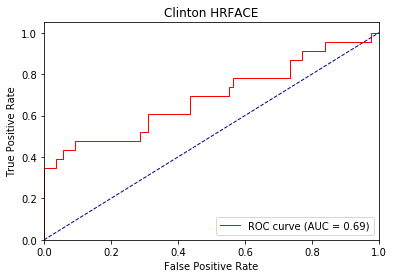

Directory already exists!
hc_saface 0 ap tensor([0.9598, 0.0455]) loss : 0.4540492594242096 0.7495357771714528 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_saface 0 ap tensor([1., 0.]) loss : 0.17600101232528687 0.27405763417482376 tid : 30 tg tensor([[0]], device='cuda:0')
TEST hc_saface 0 ap tensor([1., 0.]) loss : 0.9045668244361877 0.30782814383506774 tid : 90 tg tensor([[0]], device='cuda:0')
TEST hc_saface 0 ap tensor([1., 0.]) loss : 0.4673558473587036 0.33720608353614806 tid : 150 tg tensor([[0]], device='cuda:0')
TEST hc_saface 0 ap tensor([1., 0.]) loss : 0.25606024265289307 0.3438531082868576 tid : 180 tg tensor([[0]], device='cuda:0')
TEST hc_saface 0 ap tensor([1., 0.]) loss : 0.3967103362083435 0.3397964761628733 tid : 390 tg tensor([[0]], device='cuda:0')


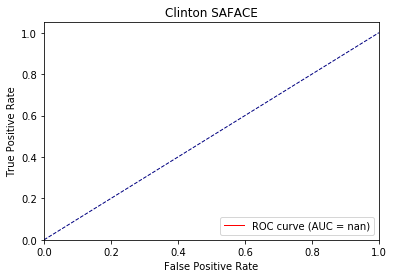

Directory already exists!
hc_saface 1 ap tensor([0.9747, 0.0340]) loss : 0.15543711185455322 0.35290931569819417 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_saface 1 ap tensor([1., 0.]) loss : 0.08165979385375977 0.1694767326116562 tid : 30 tg tensor([[0]], device='cuda:0')
TEST hc_saface 1 ap tensor([1., 0.]) loss : 0.7620798349380493 0.17821043252944946 tid : 90 tg tensor([[0]], device='cuda:0')
TEST hc_saface 1 ap tensor([1., 0.]) loss : 0.19593149423599243 0.19295406490564346 tid : 150 tg tensor([[0]], device='cuda:0')
TEST hc_saface 1 ap tensor([1., 0.]) loss : 0.14205431938171387 0.19749796152114868 tid : 180 tg tensor([[0]], device='cuda:0')
TEST hc_saface 1 ap tensor([1., 0.]) loss : 0.15231990814208984 0.18939413381861403 tid : 390 tg tensor([[0]], device='cuda:0')


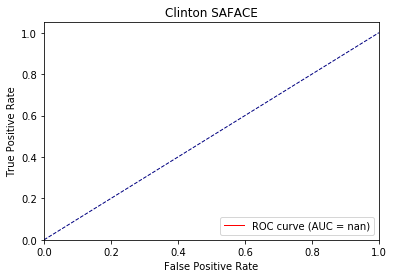

Directory already exists!
hc_saface 2 ap tensor([0.9853, 0.0248]) loss : 0.05113625526428223 0.1841819223754446 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_saface 2 ap tensor([1., 0.]) loss : 0.042514681816101074 0.11766361445188522 tid : 30 tg tensor([[0]], device='cuda:0')
TEST hc_saface 2 ap tensor([1., 0.]) loss : 0.6342105865478516 0.1178809404373169 tid : 90 tg tensor([[0]], device='cuda:0')
TEST hc_saface 2 ap tensor([1., 0.]) loss : 0.08979833126068115 0.12721797376871108 tid : 150 tg tensor([[0]], device='cuda:0')
TEST hc_saface 2 ap tensor([1., 0.]) loss : 0.08633792400360107 0.13005840301513671 tid : 180 tg tensor([[0]], device='cuda:0')
TEST hc_saface 2 ap tensor([1., 0.]) loss : 0.06800317764282227 0.12117995612033002 tid : 390 tg tensor([[0]], device='cuda:0')


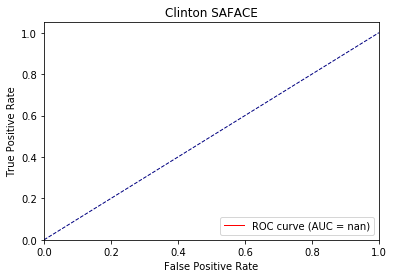

Directory already exists!
hc_neuface 0 ap tensor([0.7099, 0.4224]) loss : 0.4885900020599365 0.655318161353786 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_neuface 0 ap tensor([0.4167, 0.9107]) loss : 0.8444621562957764 0.7639560848474503 tid : 30 tg tensor([[1]], device='cuda:0')
TEST hc_neuface 0 ap tensor([0.5514, 0.6703]) loss : 0.4553334414958954 0.7001952922344208 tid : 90 tg tensor([[0]], device='cuda:0')
TEST hc_neuface 0 ap tensor([0.5353, 0.6155]) loss : 0.558648943901062 0.7089191868901252 tid : 150 tg tensor([[0]], device='cuda:0')
TEST hc_neuface 0 ap tensor([0.5762, 0.6183]) loss : 0.9186845421791077 0.6992031174898148 tid : 180 tg tensor([[1]], device='cuda:0')
TEST hc_neuface 0 ap tensor([0.5752, 0.6051]) loss : 0.8886986970901489 0.6994863698234806 tid : 390 tg tensor([[1]], device='cuda:0')


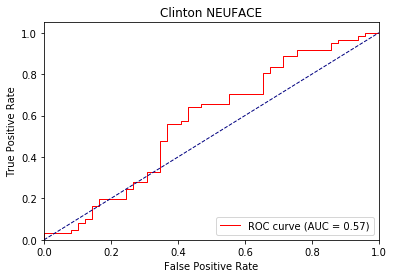

Directory already exists!
hc_neuface 1 ap tensor([0.8027, 0.6175]) loss : 0.4719989001750946 0.6334292569935134 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_neuface 1 ap tensor([0.4167, 0.9107]) loss : 0.8852933049201965 0.7895991504192352 tid : 30 tg tensor([[1]], device='cuda:0')
TEST hc_neuface 1 ap tensor([0.5565, 0.6865]) loss : 0.3959256410598755 0.7002112317085266 tid : 90 tg tensor([[0]], device='cuda:0')
TEST hc_neuface 1 ap tensor([0.5523, 0.6377]) loss : 0.5580511689186096 0.7091560050845146 tid : 150 tg tensor([[0]], device='cuda:0')
TEST hc_neuface 1 ap tensor([0.5951, 0.6547]) loss : 0.9390082955360413 0.6973631930351257 tid : 180 tg tensor([[1]], device='cuda:0')
TEST hc_neuface 1 ap tensor([0.5899, 0.6491]) loss : 0.8190188407897949 0.6964440419302358 tid : 390 tg tensor([[1]], device='cuda:0')


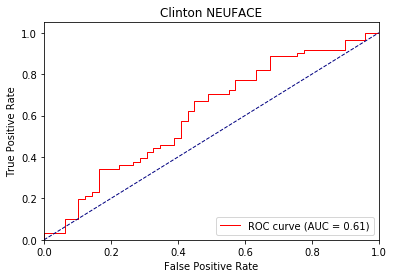

Directory already exists!
hc_neuface 2 ap tensor([0.8560, 0.6659]) loss : 0.40779271721839905 0.6026017224587105 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_neuface 2 ap tensor([0.4167, 0.9107]) loss : 0.9049479961395264 0.8037307076156139 tid : 30 tg tensor([[1]], device='cuda:0')
TEST hc_neuface 2 ap tensor([0.5925, 0.7604]) loss : 0.34500133991241455 0.6941300594806671 tid : 90 tg tensor([[0]], device='cuda:0')
TEST hc_neuface 2 ap tensor([0.5683, 0.7245]) loss : 0.5793567895889282 0.7030402980744839 tid : 150 tg tensor([[0]], device='cuda:0')
TEST hc_neuface 2 ap tensor([0.6094, 0.7101]) loss : 0.9434322118759155 0.6910546946525574 tid : 180 tg tensor([[1]], device='cuda:0')
TEST hc_neuface 2 ap tensor([0.6027, 0.6978]) loss : 0.7234167456626892 0.6894989567143577 tid : 390 tg tensor([[1]], device='cuda:0')


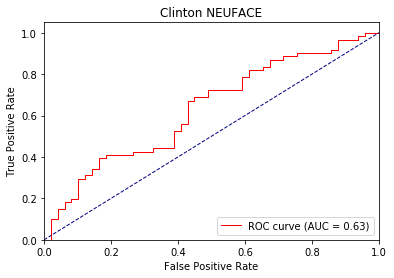

Directory already exists!
hc_inapprop 0 ap tensor([1., 0.]) loss : 0.4420381188392639 0.6069179472979158 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_inapprop 0 ap tensor([1., 0.]) loss : 0.25521063804626465 0.3260118290781975 tid : 30 tg tensor([[0]], device='cuda:0')
TEST hc_inapprop 0 ap tensor([1., 0.]) loss : 0.3750503361225128 0.32047359585762025 tid : 90 tg tensor([[0]], device='cuda:0')
TEST hc_inapprop 0 ap tensor([1., 0.]) loss : 0.2308518886566162 0.317302093654871 tid : 150 tg tensor([[0]], device='cuda:0')
TEST hc_inapprop 0 ap tensor([1., 0.]) loss : 0.4291633069515228 0.3261171627044678 tid : 180 tg tensor([[0]], device='cuda:0')
TEST hc_inapprop 0 ap tensor([1., 0.]) loss : 0.23939263820648193 0.3225614943287589 tid : 390 tg tensor([[0]], device='cuda:0')


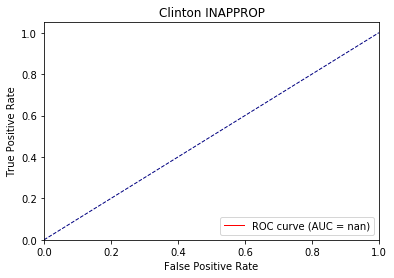

Directory already exists!
hc_inapprop 1 ap tensor([1., 0.]) loss : 0.20847374200820923 0.29408838009012156 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_inapprop 1 ap tensor([1., 0.]) loss : 0.0943993330001831 0.16256943345069885 tid : 30 tg tensor([[0]], device='cuda:0')
TEST hc_inapprop 1 ap tensor([1., 0.]) loss : 0.2910858392715454 0.1506533908843994 tid : 90 tg tensor([[0]], device='cuda:0')
TEST hc_inapprop 1 ap tensor([1., 0.]) loss : 0.09391319751739502 0.15151846706867217 tid : 150 tg tensor([[0]], device='cuda:0')
TEST hc_inapprop 1 ap tensor([1., 0.]) loss : 0.21531325578689575 0.15977953433990477 tid : 180 tg tensor([[0]], device='cuda:0')
TEST hc_inapprop 1 ap tensor([1., 0.]) loss : 0.08562648296356201 0.15474878193496108 tid : 390 tg tensor([[0]], device='cuda:0')


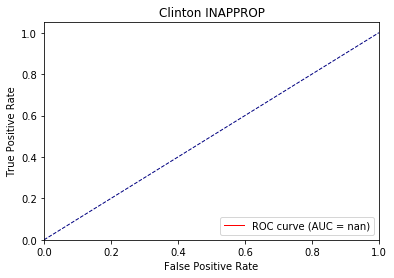

Directory already exists!
hc_inapprop 2 ap tensor([1., 0.]) loss : 0.04415488243103027 0.10555156347928224 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_inapprop 2 ap tensor([1., 0.]) loss : 0.03726959228515625 0.08639711886644363 tid : 30 tg tensor([[0]], device='cuda:0')
TEST hc_inapprop 2 ap tensor([1., 0.]) loss : 0.22463011741638184 0.0762282395362854 tid : 90 tg tensor([[0]], device='cuda:0')
TEST hc_inapprop 2 ap tensor([1., 0.]) loss : 0.0430830717086792 0.07758453488349915 tid : 150 tg tensor([[0]], device='cuda:0')
TEST hc_inapprop 2 ap tensor([1., 0.]) loss : 0.10658586025238037 0.08409016251564026 tid : 180 tg tensor([[0]], device='cuda:0')
TEST hc_inapprop 2 ap tensor([1., 0.]) loss : 0.03562891483306885 0.07905431072433274 tid : 390 tg tensor([[0]], device='cuda:0')


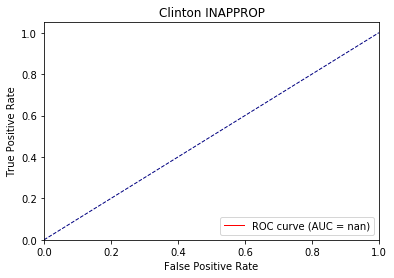

Directory already exists!
hc_affgest 0 ap tensor([0.9656, 0.1753]) loss : 0.3474748134613037 0.5301250961976254 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_affgest 0 ap tensor([1., 0.]) loss : 0.25990957021713257 0.37551750615239143 tid : 30 tg tensor([[0]], device='cuda:0')
TEST hc_affgest 0 ap tensor([1., 0.]) loss : 0.8982887268066406 0.37250683665275575 tid : 90 tg tensor([[0]], device='cuda:0')
TEST hc_affgest 0 ap tensor([1., 0.]) loss : 0.2372320294380188 0.3712520532310009 tid : 150 tg tensor([[0]], device='cuda:0')
TEST hc_affgest 0 ap tensor([1., 0.]) loss : 0.3099387288093567 0.3765122503042221 tid : 180 tg tensor([[0]], device='cuda:0')
TEST hc_affgest 0 ap tensor([1., 0.]) loss : 0.20766419172286987 0.36327806850532435 tid : 390 tg tensor([[0]], device='cuda:0')


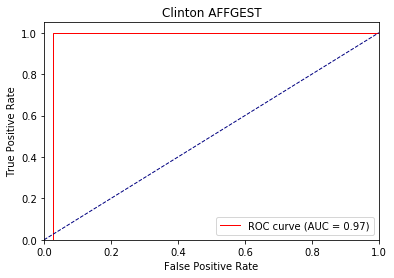

Directory already exists!
hc_affgest 1 ap tensor([0.9784, 0.2175]) loss : 0.19029486179351807 0.3352693206360263 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_affgest 1 ap tensor([1., 0.]) loss : 0.13113021850585938 0.25615207850933075 tid : 30 tg tensor([[0]], device='cuda:0')
TEST hc_affgest 1 ap tensor([1., 0.]) loss : 0.7334296703338623 0.24021833300590514 tid : 90 tg tensor([[0]], device='cuda:0')
TEST hc_affgest 1 ap tensor([1., 0.]) loss : 0.10772299766540527 0.2391287699341774 tid : 150 tg tensor([[0]], device='cuda:0')
TEST hc_affgest 1 ap tensor([1., 0.]) loss : 0.18317115306854248 0.24300027668476104 tid : 180 tg tensor([[0]], device='cuda:0')
TEST hc_affgest 1 ap tensor([1., 0.]) loss : 0.08840572834014893 0.2302583556670647 tid : 390 tg tensor([[0]], device='cuda:0')


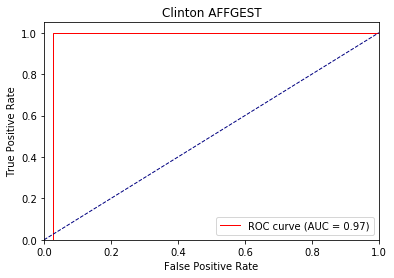

Directory already exists!
hc_affgest 2 ap tensor([0.9824, 0.1615]) loss : 0.09513092041015625 0.24849557505988087 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_affgest 2 ap tensor([1., 0.]) loss : 0.0778278112411499 0.20540614426136017 tid : 30 tg tensor([[0]], device='cuda:0')
TEST hc_affgest 2 ap tensor([1., 0.]) loss : 0.59654700756073 0.18202775716781616 tid : 90 tg tensor([[0]], device='cuda:0')
TEST hc_affgest 2 ap tensor([1., 0.]) loss : 0.06004023551940918 0.18195450827479362 tid : 150 tg tensor([[0]], device='cuda:0')
TEST hc_affgest 2 ap tensor([1., 0.]) loss : 0.1217339038848877 0.1847046893835068 tid : 180 tg tensor([[0]], device='cuda:0')
TEST hc_affgest 2 ap tensor([1., 0.]) loss : 0.04711306095123291 0.1734258443504185 tid : 390 tg tensor([[0]], device='cuda:0')


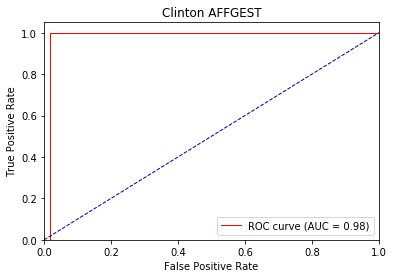

Directory already exists!
hc_defgest 0 ap tensor([0.8297, 0.0643]) loss : 0.4311402142047882 0.6117341197216449 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_defgest 0 ap tensor([1., 0.]) loss : 0.295448899269104 0.41002190858125687 tid : 30 tg tensor([[0]], device='cuda:0')
TEST hc_defgest 0 ap tensor([0.8932, 0.3070]) loss : 0.48566630482673645 0.5703618717193604 tid : 90 tg tensor([[0]], device='cuda:0')
TEST hc_defgest 0 ap tensor([0.8488, 0.3829]) loss : 0.3067183494567871 0.6178416892886162 tid : 150 tg tensor([[0]], device='cuda:0')
TEST hc_defgest 0 ap tensor([0.8476, 0.4025]) loss : 0.4143688678741455 0.629645808339119 tid : 180 tg tensor([[0]], device='cuda:0')
TEST hc_defgest 0 ap tensor([0.8365, 0.3998]) loss : 0.3026835322380066 0.6278897612899929 tid : 390 tg tensor([[0]], device='cuda:0')


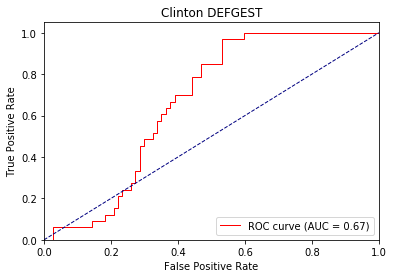

Directory already exists!
hc_defgest 1 ap tensor([0.9324, 0.1452]) loss : 0.2719697952270508 0.40218750110199286 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_defgest 1 ap tensor([1., 0.]) loss : 0.1784437894821167 0.305412944406271 tid : 30 tg tensor([[0]], device='cuda:0')
TEST hc_defgest 1 ap tensor([0.8912, 0.3040]) loss : 0.3835158348083496 0.5508592426776886 tid : 90 tg tensor([[0]], device='cuda:0')
TEST hc_defgest 1 ap tensor([0.8650, 0.3870]) loss : 0.1478738784790039 0.615333492308855 tid : 150 tg tensor([[0]], device='cuda:0')
TEST hc_defgest 1 ap tensor([0.8667, 0.4099]) loss : 0.28810155391693115 0.6327323538064956 tid : 180 tg tensor([[0]], device='cuda:0')
TEST hc_defgest 1 ap tensor([0.8388, 0.3983]) loss : 0.13549721240997314 0.638785330119071 tid : 390 tg tensor([[0]], device='cuda:0')


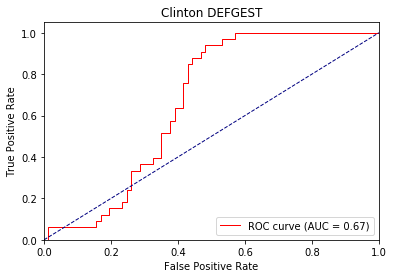

Directory already exists!
hc_defgest 2 ap tensor([0.9696, 0.1106]) loss : 0.18770670890808105 0.30558683626029803 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_defgest 2 ap tensor([1., 0.]) loss : 0.12791132926940918 0.25530800223350525 tid : 30 tg tensor([[0]], device='cuda:0')
TEST hc_defgest 2 ap tensor([0.8882, 0.2990]) loss : 0.3088122606277466 0.5517811143398285 tid : 90 tg tensor([[0]], device='cuda:0')
TEST hc_defgest 2 ap tensor([0.8664, 0.3960]) loss : 0.08917701244354248 0.6262163802981376 tid : 150 tg tensor([[0]], device='cuda:0')
TEST hc_defgest 2 ap tensor([0.8694, 0.4188]) loss : 0.22491300106048584 0.6462763559818268 tid : 180 tg tensor([[0]], device='cuda:0')
TEST hc_defgest 2 ap tensor([0.8369, 0.4044]) loss : 0.07729899883270264 0.6604688155960727 tid : 390 tg tensor([[0]], device='cuda:0')


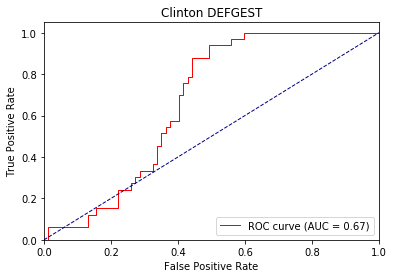

Directory already exists!
hc_agentic 0 ap tensor([0.9601, 0.9225]) loss : 0.5598673224449158 0.5583836955052836 tid : 200 tg tensor([[1]], device='cuda:0')
TEST hc_agentic 0 ap tensor([0.6458, 0.8125]) loss : 0.6126211285591125 0.5970875471830368 tid : 30 tg tensor([[0]], device='cuda:0')
TEST hc_agentic 0 ap tensor([0.9036, 0.9615]) loss : 0.45592597126960754 0.44369595289230346 tid : 90 tg tensor([[0]], device='cuda:0')
TEST hc_agentic 0 ap tensor([0.9568, 0.9779]) loss : 0.4149547815322876 0.3976827271282673 tid : 150 tg tensor([[0]], device='cuda:0')
TEST hc_agentic 0 ap tensor([0.9465, 0.9729]) loss : 0.8490287065505981 0.4156008094549179 tid : 180 tg tensor([[1]], device='cuda:0')
TEST hc_agentic 0 ap tensor([0.8906, 0.9552]) loss : 0.32129189372062683 0.44816542523247854 tid : 390 tg tensor([[0]], device='cuda:0')


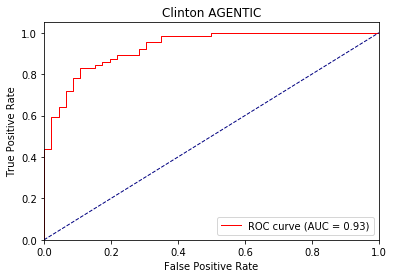

Directory already exists!
hc_agentic 1 ap tensor([0.9909, 0.9762]) loss : 0.48790162801742554 0.43741149082779884 tid : 200 tg tensor([[1]], device='cuda:0')
TEST hc_agentic 1 ap tensor([0.8042, 0.8929]) loss : 0.508224368095398 0.5665043629705906 tid : 30 tg tensor([[0]], device='cuda:0')
TEST hc_agentic 1 ap tensor([0.9460, 0.9821]) loss : 0.37116312980651855 0.3561878848075867 tid : 90 tg tensor([[0]], device='cuda:0')
TEST hc_agentic 1 ap tensor([0.9768, 0.9907]) loss : 0.2928944230079651 0.2983994111418724 tid : 150 tg tensor([[0]], device='cuda:0')
TEST hc_agentic 1 ap tensor([0.9616, 0.9839]) loss : 0.9855046272277832 0.3209446340799332 tid : 180 tg tensor([[1]], device='cuda:0')
TEST hc_agentic 1 ap tensor([0.9045, 0.9634]) loss : 0.16981345415115356 0.3725534267239756 tid : 390 tg tensor([[0]], device='cuda:0')


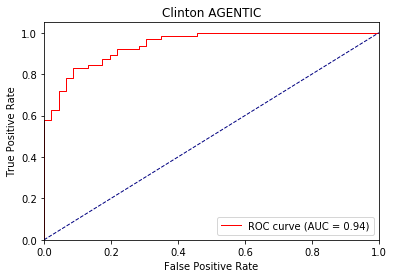

Directory already exists!
hc_agentic 2 ap tensor([0.9666, 0.9523]) loss : 0.374223917722702 0.29829974887801 tid : 200 tg tensor([[1]], device='cuda:0')
TEST hc_agentic 2 ap tensor([0.8875, 0.9167]) loss : 0.41818153858184814 0.5405903644859791 tid : 30 tg tensor([[0]], device='cuda:0')
TEST hc_agentic 2 ap tensor([0.9599, 0.9850]) loss : 0.30429893732070923 0.30461729764938356 tid : 90 tg tensor([[0]], device='cuda:0')
TEST hc_agentic 2 ap tensor([0.9844, 0.9938]) loss : 0.24597573280334473 0.24432565346360208 tid : 150 tg tensor([[0]], device='cuda:0')
TEST hc_agentic 2 ap tensor([0.9692, 0.9868]) loss : 1.1139496564865112 0.26880855560302735 tid : 180 tg tensor([[1]], device='cuda:0')
TEST hc_agentic 2 ap tensor([0.9097, 0.9674]) loss : 0.10706758499145508 0.3332056693442456 tid : 390 tg tensor([[0]], device='cuda:0')


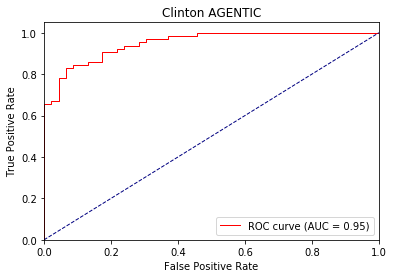

Directory already exists!
hc_waveoff 0 ap tensor([0.7038, 0.3922]) loss : 1.0706803798675537 0.6509229662241759 tid : 200 tg tensor([[1]], device='cuda:0')
TEST hc_waveoff 0 ap tensor([0.9151, 0.7000]) loss : 0.3140765428543091 0.5958824194967747 tid : 30 tg tensor([[0]], device='cuda:0')
TEST hc_waveoff 0 ap tensor([0.8496, 0.6885]) loss : 0.6395854949951172 0.6088294339179993 tid : 90 tg tensor([[0]], device='cuda:0')
TEST hc_waveoff 0 ap tensor([0.8798, 0.7540]) loss : 0.32948118448257446 0.570217278599739 tid : 150 tg tensor([[0]], device='cuda:0')
TEST hc_waveoff 0 ap tensor([0.8803, 0.7671]) loss : 0.8601546287536621 0.5687540519237518 tid : 180 tg tensor([[1]], device='cuda:0')
TEST hc_waveoff 0 ap tensor([0.8051, 0.7845]) loss : 0.27345216274261475 0.5961369759850688 tid : 390 tg tensor([[0]], device='cuda:0')


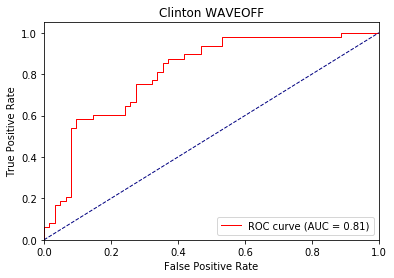

Directory already exists!
hc_waveoff 1 ap tensor([0.9572, 0.8494]) loss : 0.9586119055747986 0.4520873138639662 tid : 200 tg tensor([[1]], device='cuda:0')
TEST hc_waveoff 1 ap tensor([0.9151, 0.7000]) loss : 0.27717283368110657 0.6288390420377254 tid : 30 tg tensor([[0]], device='cuda:0')
TEST hc_waveoff 1 ap tensor([0.8558, 0.6838]) loss : 0.5281873941421509 0.5977470099925994 tid : 90 tg tensor([[0]], device='cuda:0')
TEST hc_waveoff 1 ap tensor([0.8850, 0.7511]) loss : 0.21321988105773926 0.5255839854478837 tid : 150 tg tensor([[0]], device='cuda:0')
TEST hc_waveoff 1 ap tensor([0.8860, 0.7719]) loss : 0.9778691530227661 0.5243171125650405 tid : 180 tg tensor([[1]], device='cuda:0')
TEST hc_waveoff 1 ap tensor([0.8334, 0.7666]) loss : 0.15685296058654785 0.5607297076033307 tid : 390 tg tensor([[0]], device='cuda:0')


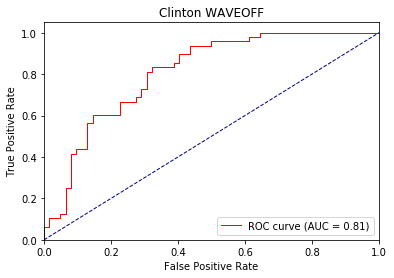

Directory already exists!
hc_waveoff 2 ap tensor([0.9548, 0.7806]) loss : 0.8420408964157104 0.4076512428739714 tid : 200 tg tensor([[1]], device='cuda:0')
TEST hc_waveoff 2 ap tensor([0.9151, 0.7000]) loss : 0.23961913585662842 0.6475876308977604 tid : 30 tg tensor([[0]], device='cuda:0')
TEST hc_waveoff 2 ap tensor([0.8530, 0.6502]) loss : 0.43734079599380493 0.6008190977573394 tid : 90 tg tensor([[0]], device='cuda:0')
TEST hc_waveoff 2 ap tensor([0.8836, 0.7304]) loss : 0.15410637855529785 0.5077734053134918 tid : 150 tg tensor([[0]], device='cuda:0')
TEST hc_waveoff 2 ap tensor([0.8870, 0.7620]) loss : 1.1006839275360107 0.5060112464427948 tid : 180 tg tensor([[1]], device='cuda:0')
TEST hc_waveoff 2 ap tensor([0.8336, 0.7642]) loss : 0.09921526908874512 0.5492781543886507 tid : 390 tg tensor([[0]], device='cuda:0')


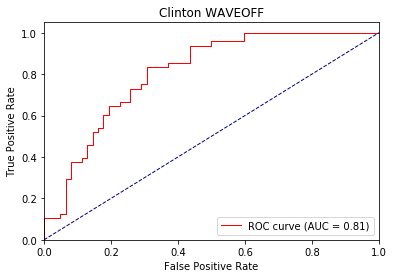

Directory already exists!
hc_nvtic1 0 ap tensor([0.8728, 0.1905]) loss : 0.3563235402107239 0.5238241226803321 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic1 0 ap tensor([1., 0.]) loss : 0.3511448800563812 0.33254560828208923 tid : 30 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic1 0 ap tensor([0.9854, 0.6111]) loss : 0.9270541667938232 0.3711659359931946 tid : 90 tg tensor([[1]], device='cuda:0')
TEST hc_nvtic1 0 ap tensor([0.9252, 0.3367]) loss : 1.2818565368652344 0.4274788536131382 tid : 150 tg tensor([[1]], device='cuda:0')
TEST hc_nvtic1 0 ap tensor([0.9224, 0.3139]) loss : 0.33753302693367004 0.4438867634534836 tid : 180 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic1 0 ap tensor([0.9098, 0.3369]) loss : 0.26443809270858765 0.45785308271259456 tid : 390 tg tensor([[0]], device='cuda:0')


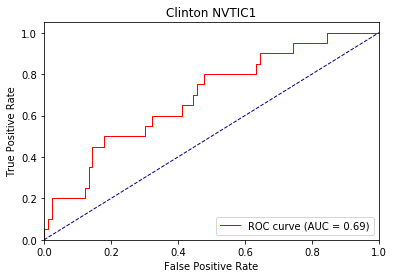

Directory already exists!
hc_nvtic1 1 ap tensor([0.9274, 0.3997]) loss : 0.3111654222011566 0.4739053047309488 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic1 1 ap tensor([1., 0.]) loss : 0.31124210357666016 0.2774171829223633 tid : 30 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic1 1 ap tensor([0.9878, 0.6250]) loss : 0.9794887900352478 0.31797733545303347 tid : 90 tg tensor([[1]], device='cuda:0')
TEST hc_nvtic1 1 ap tensor([0.9430, 0.3533]) loss : 1.4674146175384521 0.3865244582295418 tid : 150 tg tensor([[1]], device='cuda:0')
TEST hc_nvtic1 1 ap tensor([0.9403, 0.3312]) loss : 0.30900150537490845 0.40718515396118166 tid : 180 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic1 1 ap tensor([0.9283, 0.3938]) loss : 0.21689552068710327 0.4235765585651645 tid : 390 tg tensor([[0]], device='cuda:0')


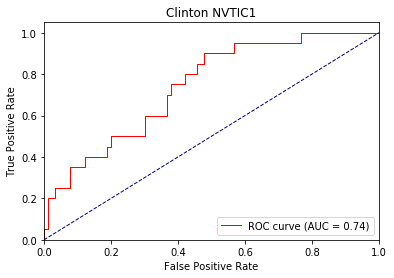

Directory already exists!
hc_nvtic1 2 ap tensor([0.9235, 0.3901]) loss : 0.24461060762405396 0.43276712449144294 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic1 2 ap tensor([1., 0.]) loss : 0.3041701316833496 0.24998726695775986 tid : 30 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic1 2 ap tensor([0.9901, 0.6429]) loss : 1.0137560367584229 0.288749725818634 tid : 90 tg tensor([[1]], device='cuda:0')
TEST hc_nvtic1 2 ap tensor([0.9591, 0.3916]) loss : 1.5742485523223877 0.3623035132884979 tid : 150 tg tensor([[1]], device='cuda:0')
TEST hc_nvtic1 2 ap tensor([0.9523, 0.3564]) loss : 0.2992219924926758 0.3845809090137482 tid : 180 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic1 2 ap tensor([0.9414, 0.4124]) loss : 0.1966862678527832 0.4032931358783276 tid : 390 tg tensor([[0]], device='cuda:0')


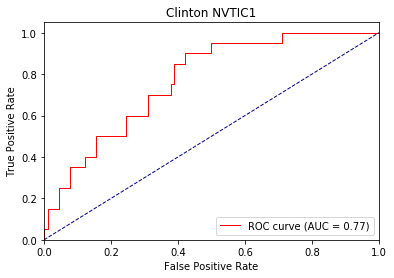

Directory already exists!
hc_nvtic2 0 ap tensor([0.9128, 0.1933]) loss : 0.4156005084514618 0.62271574249974 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic2 0 ap tensor([1., 1.]) loss : 0.4560410976409912 0.5192113742232323 tid : 30 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic2 0 ap tensor([0.9830, 0.2429]) loss : 0.7273901700973511 0.434859699010849 tid : 90 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic2 0 ap tensor([0.9804, 0.1810]) loss : 0.4072633981704712 0.43720538541674614 tid : 150 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic2 0 ap tensor([0.9874, 0.1746]) loss : 0.5172151923179626 0.4315117019414902 tid : 180 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic2 0 ap tensor([0.9746, 0.1634]) loss : 0.486572265625 0.4428637290929819 tid : 390 tg tensor([[0]], device='cuda:0')


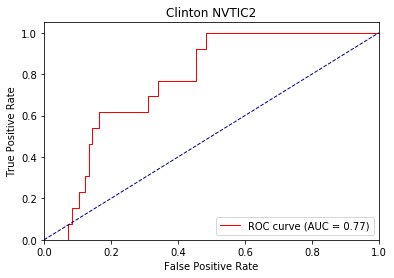

Directory already exists!
hc_nvtic2 1 ap tensor([0.9396, 0.3378]) loss : 0.29106804728507996 0.4678263948783616 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic2 1 ap tensor([1., 1.]) loss : 0.3705528974533081 0.462119922041893 tid : 30 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic2 1 ap tensor([0.9929, 0.4167]) loss : 0.6802611351013184 0.3319206428527832 tid : 90 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic2 1 ap tensor([0.9869, 0.2881]) loss : 0.2755170464515686 0.3338973566889763 tid : 150 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic2 1 ap tensor([0.9896, 0.2722]) loss : 0.4440494775772095 0.3262391448020935 tid : 180 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic2 1 ap tensor([0.9788, 0.2325]) loss : 0.3274727463722229 0.3426748707696989 tid : 390 tg tensor([[0]], device='cuda:0')


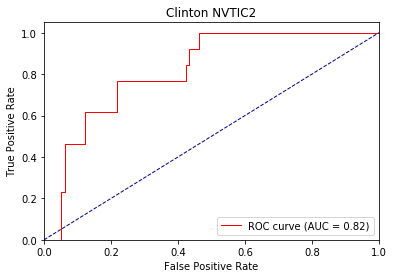

Directory already exists!
hc_nvtic2 2 ap tensor([0.9444, 0.4679]) loss : 0.20981204509735107 0.41014507865603966 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic2 2 ap tensor([1., 1.]) loss : 0.3619549572467804 0.4211368225514889 tid : 30 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic2 2 ap tensor([0.9929, 0.4167]) loss : 0.6550741791725159 0.2819216096401215 tid : 90 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic2 2 ap tensor([0.9859, 0.2833]) loss : 0.22116786241531372 0.2849132277071476 tid : 150 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic2 2 ap tensor([0.9889, 0.2693]) loss : 0.4242558777332306 0.2767302542924881 tid : 180 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic2 2 ap tensor([0.9777, 0.2282]) loss : 0.2613834738731384 0.29834883514936866 tid : 390 tg tensor([[0]], device='cuda:0')


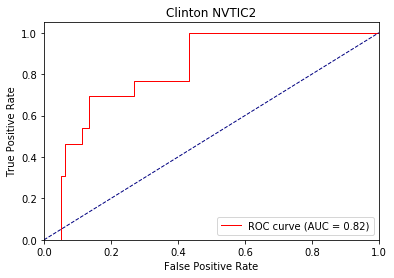

Directory already exists!
hc_nvtic3 0 ap tensor([0.9968, 0.0032]) loss : 0.261745810508728 0.500601066412937 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic3 0 ap tensor([0.9617, 0.3333]) loss : 0.24297714233398438 0.42535245791077614 tid : 30 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic3 0 ap tensor([0.9091, 0.1679]) loss : 0.70747309923172 0.4443517053127289 tid : 90 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic3 0 ap tensor([0.9418, 0.1168]) loss : 0.3381879925727844 0.40501500964164733 tid : 150 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic3 0 ap tensor([0.9487, 0.0941]) loss : 0.3412345349788666 0.39531195402145386 tid : 180 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic3 0 ap tensor([0.9643, 0.0712]) loss : 0.25065261125564575 0.36633981203103994 tid : 390 tg tensor([[0]], device='cuda:0')


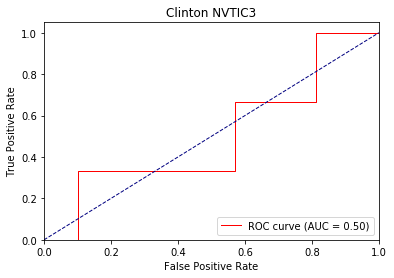

Directory already exists!
hc_nvtic3 1 ap tensor([1., 0.]) loss : 0.2445940375328064 0.29447825058646826 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic3 1 ap tensor([0.9617, 0.3333]) loss : 0.08913314342498779 0.3524354547262192 tid : 30 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic3 1 ap tensor([0.9059, 0.1643]) loss : 0.5936689376831055 0.38467094421386716 tid : 90 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic3 1 ap tensor([0.9406, 0.0981]) loss : 0.13483643531799316 0.3036109782755375 tid : 150 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic3 1 ap tensor([0.9475, 0.0768]) loss : 0.16151142120361328 0.28111625015735625 tid : 180 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic3 1 ap tensor([0.9653, 0.0554]) loss : 0.0920264720916748 0.23049243278317638 tid : 390 tg tensor([[0]], device='cuda:0')


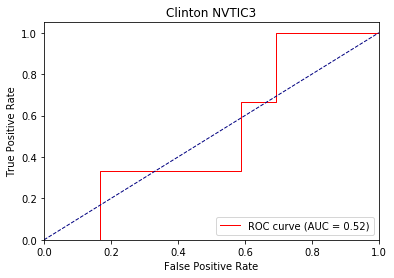

Directory already exists!
hc_nvtic3 2 ap tensor([1., 0.]) loss : 0.09245085716247559 0.14482141137123108 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic3 2 ap tensor([0.9617, 0.3333]) loss : 0.0338824987411499 0.35914164781570435 tid : 30 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic3 2 ap tensor([0.9012, 0.1585]) loss : 0.4814808964729309 0.4104897499084473 tid : 90 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic3 2 ap tensor([0.9382, 0.0962]) loss : 0.05990910530090332 0.2908407136797905 tid : 150 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic3 2 ap tensor([0.9446, 0.0751]) loss : 0.07717108726501465 0.2551019036769867 tid : 180 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic3 2 ap tensor([0.9653, 0.0553]) loss : 0.03954732418060303 0.18746980986037812 tid : 390 tg tensor([[0]], device='cuda:0')


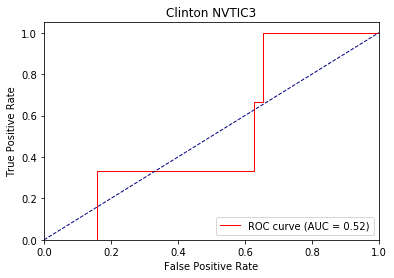

Directory already exists!
hc_nvtic5 0 ap tensor([1., 0.]) loss : 0.3439232110977173 0.491270466975355 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic5 0 ap tensor([1., 0.]) loss : 0.24265313148498535 0.3006400018930435 tid : 30 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic5 0 ap tensor([1., 0.]) loss : 0.6575565338134766 0.29725621938705443 tid : 90 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic5 0 ap tensor([1., 0.]) loss : 0.2867216467857361 0.2962118312716484 tid : 150 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic5 0 ap tensor([1., 0.]) loss : 0.27025705575942993 0.29880613565444947 tid : 180 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic5 0 ap tensor([1., 0.]) loss : 0.23507773876190186 0.2924486120025833 tid : 390 tg tensor([[0]], device='cuda:0')


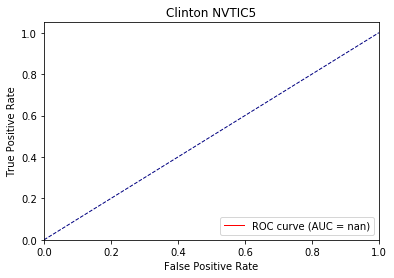

Directory already exists!
hc_nvtic5 1 ap tensor([1., 0.]) loss : 0.11841630935668945 0.2015272382589487 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic5 1 ap tensor([1., 0.]) loss : 0.0977015495300293 0.14801450818777084 tid : 30 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic5 1 ap tensor([1., 0.]) loss : 0.5512200593948364 0.147509868144989 tid : 90 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic5 1 ap tensor([1., 0.]) loss : 0.12521803379058838 0.1479777827858925 tid : 150 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic5 1 ap tensor([1., 0.]) loss : 0.14461922645568848 0.15272124648094176 tid : 180 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic5 1 ap tensor([1., 0.]) loss : 0.08533132076263428 0.1451117659544016 tid : 390 tg tensor([[0]], device='cuda:0')


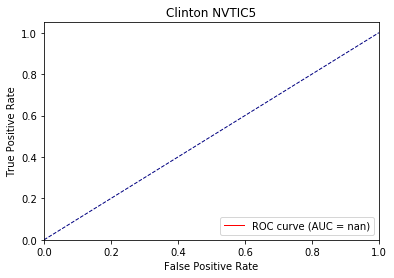

Directory already exists!
hc_nvtic5 2 ap tensor([1., 0.]) loss : 0.06364941596984863 0.11091526574695233 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic5 2 ap tensor([1., 0.]) loss : 0.04085874557495117 0.07707826793193817 tid : 30 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic5 2 ap tensor([1., 0.]) loss : 0.45068949460983276 0.0789196753501892 tid : 90 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic5 2 ap tensor([1., 0.]) loss : 0.05602407455444336 0.07997987866401672 tid : 150 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic5 2 ap tensor([1., 0.]) loss : 0.07908785343170166 0.0846527636051178 tid : 180 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic5 2 ap tensor([1., 0.]) loss : 0.035192251205444336 0.0773635305367507 tid : 390 tg tensor([[0]], device='cuda:0')


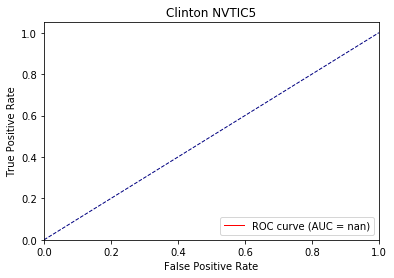

Directory already exists!
hc_nvtic4 0 ap tensor([1., 0.]) loss : 0.6034234166145325 0.6423429817864389 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic4 0 ap tensor([0.8556, 0.4167]) loss : 1.21101975440979 0.5949658341705799 tid : 30 tg tensor([[1]], device='cuda:0')
TEST hc_nvtic4 0 ap tensor([0.9279, 0.2181]) loss : 0.6340528726577759 0.47915554404258726 tid : 90 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic4 0 ap tensor([0.9533, 0.1344]) loss : 0.17055630683898926 0.43970426768064497 tid : 150 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic4 0 ap tensor([0.9661, 0.1136]) loss : 0.3449477553367615 0.4215094065666199 tid : 180 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic4 0 ap tensor([0.9793, 0.0870]) loss : 0.17805790901184082 0.39613831507695185 tid : 390 tg tensor([[0]], device='cuda:0')


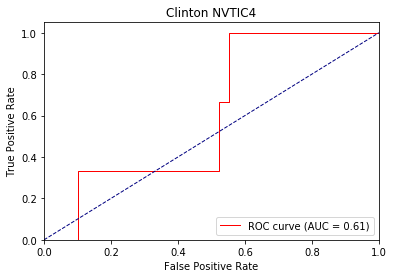

Directory already exists!
hc_nvtic4 1 ap tensor([0.9872, 0.2659]) loss : 0.21748489141464233 0.2953817895650864 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic4 1 ap tensor([0.8556, 0.4167]) loss : 1.9362213611602783 0.5848048962652683 tid : 30 tg tensor([[1]], device='cuda:0')
TEST hc_nvtic4 1 ap tensor([0.9279, 0.2181]) loss : 0.5296148061752319 0.38905650734901426 tid : 90 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic4 1 ap tensor([0.9526, 0.1233]) loss : 0.06753778457641602 0.32029384672641753 tid : 150 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic4 1 ap tensor([0.9639, 0.1039]) loss : 0.18547290563583374 0.29595407128334045 tid : 180 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic4 1 ap tensor([0.9782, 0.0859]) loss : 0.07163310050964355 0.25368219807550507 tid : 390 tg tensor([[0]], device='cuda:0')


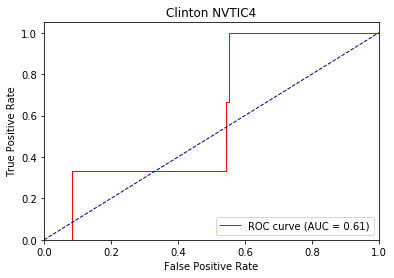

Directory already exists!
hc_nvtic4 2 ap tensor([1., 0.]) loss : 0.11972033977508545 0.1416624063086287 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic4 2 ap tensor([0.6968, 0.2917]) loss : 2.6727294921875 0.6558922976255417 tid : 30 tg tensor([[1]], device='cuda:0')
TEST hc_nvtic4 2 ap tensor([0.9110, 0.1846]) loss : 0.4524014890193939 0.3810131013393402 tid : 90 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic4 2 ap tensor([0.9479, 0.1203]) loss : 0.03481125831604004 0.2822527982294559 tid : 150 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic4 2 ap tensor([0.9612, 0.1017]) loss : 0.10674786567687988 0.2503857147693634 tid : 180 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic4 2 ap tensor([0.9767, 0.0843]) loss : 0.03625893592834473 0.19460311106273107 tid : 390 tg tensor([[0]], device='cuda:0')


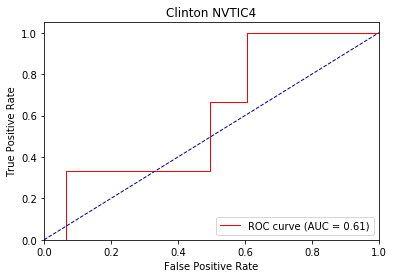

Directory already exists!
hc_interruptions 0 ap tensor([0.9898, 0.0196]) loss : 0.23294764757156372 0.42989829182624817 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_interruptions 0 ap tensor([1., 0.]) loss : 0.18516498804092407 0.18107124418020248 tid : 30 tg tensor([[0]], device='cuda:0')
TEST hc_interruptions 0 ap tensor([0.9589, 0.0588]) loss : 0.5791465640068054 0.2693097603321075 tid : 90 tg tensor([[0]], device='cuda:0')
TEST hc_interruptions 0 ap tensor([0.9654, 0.0323]) loss : 0.23680183291435242 0.25259457603096963 tid : 150 tg tensor([[0]], device='cuda:0')
TEST hc_interruptions 0 ap tensor([0.9683, 0.1500]) loss : 0.3128412961959839 0.27293650090694427 tid : 180 tg tensor([[0]], device='cuda:0')
TEST hc_interruptions 0 ap tensor([0.9813, 0.1419]) loss : 0.23306453227996826 0.25152230340164977 tid : 390 tg tensor([[0]], device='cuda:0')


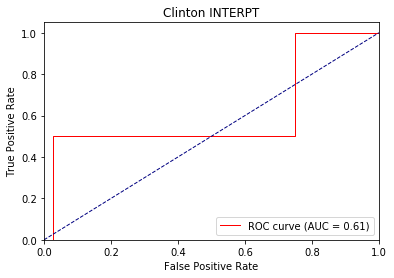

Directory already exists!
hc_interruptions 1 ap tensor([0.9967, 0.1729]) loss : 0.08670675754547119 0.19069700717563687 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_interruptions 1 ap tensor([1., 0.]) loss : 0.07621145248413086 0.09258487075567245 tid : 30 tg tensor([[0]], device='cuda:0')
TEST hc_interruptions 1 ap tensor([0.9668, 0.0667]) loss : 0.43717342615127563 0.20263169288635255 tid : 90 tg tensor([[0]], device='cuda:0')
TEST hc_interruptions 1 ap tensor([0.9718, 0.0357]) loss : 0.0994461178779602 0.1712241694331169 tid : 150 tg tensor([[0]], device='cuda:0')
TEST hc_interruptions 1 ap tensor([0.9717, 0.1513]) loss : 0.17287671566009521 0.19844207406044007 tid : 180 tg tensor([[0]], device='cuda:0')
TEST hc_interruptions 1 ap tensor([0.9819, 0.1422]) loss : 0.09298992156982422 0.16495517399403956 tid : 390 tg tensor([[0]], device='cuda:0')


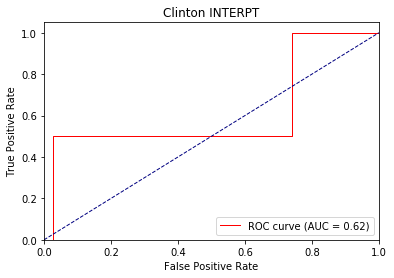

Directory already exists!
hc_interruptions 2 ap tensor([0.9952, 0.0883]) loss : 0.056365251541137695 0.14168040790456407 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_interruptions 2 ap tensor([1., 0.]) loss : 0.03958773612976074 0.056373268365859985 tid : 30 tg tensor([[0]], device='cuda:0')
TEST hc_interruptions 2 ap tensor([0.9703, 0.0714]) loss : 0.33356720209121704 0.18456966638565064 tid : 90 tg tensor([[0]], device='cuda:0')
TEST hc_interruptions 2 ap tensor([0.9770, 0.0400]) loss : 0.0502392053604126 0.14372954070568084 tid : 150 tg tensor([[0]], device='cuda:0')
TEST hc_interruptions 2 ap tensor([0.9759, 0.1536]) loss : 0.10849612951278687 0.17771982550621032 tid : 180 tg tensor([[0]], device='cuda:0')
TEST hc_interruptions 2 ap tensor([0.9847, 0.1189]) loss : 0.04308629035949707 0.1362525983290239 tid : 390 tg tensor([[0]], device='cuda:0')


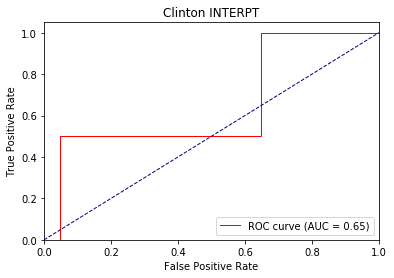

Directory already exists!
hc_lookat2 0 ap tensor([0.8553, 0.8911]) loss : 0.7610877156257629 0.595481064902643 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_lookat2 0 ap tensor([1., 1.]) loss : 0.9566166400909424 0.5936003446578979 tid : 30 tg tensor([[0]], device='cuda:0')
TEST hc_lookat2 0 ap tensor([0.9805, 0.4167]) loss : 0.9539456367492676 0.5588473346498277 tid : 90 tg tensor([[0]], device='cuda:0')
TEST hc_lookat2 0 ap tensor([0.8795, 0.6912]) loss : 1.231209635734558 0.5654202655509666 tid : 150 tg tensor([[0]], device='cuda:0')
TEST hc_lookat2 0 ap tensor([0.8930, 0.8100]) loss : 0.3657599091529846 0.5253950909870427 tid : 210 tg tensor([[1]], device='cuda:0')
TEST hc_lookat2 0 ap tensor([0.8912, 0.8393]) loss : 0.5131561756134033 0.5186397742342066 tid : 270 tg tensor([[0]], device='cuda:0')
TEST hc_lookat2 0 ap tensor([0.8904, 0.8624]) loss : 0.728371798992157 0.5234205732742946 tid : 300 tg tensor([[0]], device='cuda:0')
TEST hc_lookat2 0 ap tensor([0.8931, 0.8700]) l

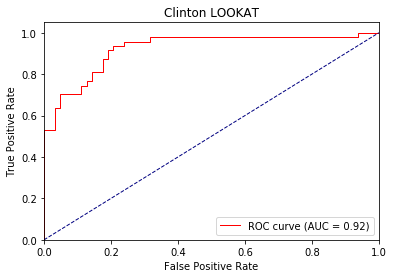

Directory already exists!
hc_lookat2 1 ap tensor([0.9328, 0.9503]) loss : 0.6047013401985168 0.4293217671454144 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_lookat2 1 ap tensor([1., 1.]) loss : 0.9287562966346741 0.5257580935955047 tid : 30 tg tensor([[0]], device='cuda:0')
TEST hc_lookat2 1 ap tensor([0.9771, 0.3333]) loss : 1.0567219257354736 0.4755050556527244 tid : 90 tg tensor([[0]], device='cuda:0')
TEST hc_lookat2 1 ap tensor([0.8775, 0.6754]) loss : 1.5615453720092773 0.5082359689253347 tid : 150 tg tensor([[0]], device='cuda:0')
TEST hc_lookat2 1 ap tensor([0.8964, 0.8286]) loss : 0.22653204202651978 0.4463445958567829 tid : 210 tg tensor([[1]], device='cuda:0')
TEST hc_lookat2 1 ap tensor([0.9047, 0.8577]) loss : 0.32885295152664185 0.4419902132617103 tid : 270 tg tensor([[0]], device='cuda:0')
TEST hc_lookat2 1 ap tensor([0.9042, 0.8768]) loss : 0.6448261141777039 0.44716990888118746 tid : 300 tg tensor([[0]], device='cuda:0')
TEST hc_lookat2 1 ap tensor([0.9119, 0.88

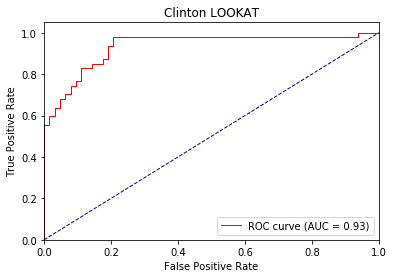

Directory already exists!
hc_lookat2 2 ap tensor([0.9422, 0.9573]) loss : 0.47882580757141113 0.35605106951958004 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_lookat2 2 ap tensor([1., 1.]) loss : 0.9356293678283691 0.49642995595932005 tid : 30 tg tensor([[0]], device='cuda:0')
TEST hc_lookat2 2 ap tensor([0.9771, 0.3333]) loss : 1.1583534479141235 0.44335294100973344 tid : 90 tg tensor([[0]], device='cuda:0')
TEST hc_lookat2 2 ap tensor([0.8934, 0.6769]) loss : 1.8562358617782593 0.4941513494209007 tid : 150 tg tensor([[0]], device='cuda:0')
TEST hc_lookat2 2 ap tensor([0.9079, 0.8293]) loss : 0.1441354751586914 0.4116826348188447 tid : 210 tg tensor([[1]], device='cuda:0')
TEST hc_lookat2 2 ap tensor([0.9054, 0.8598]) loss : 0.2135825753211975 0.40814865849636217 tid : 270 tg tensor([[0]], device='cuda:0')
TEST hc_lookat2 2 ap tensor([0.9047, 0.8783]) loss : 0.5512317419052124 0.41245921353499093 tid : 300 tg tensor([[0]], device='cuda:0')
TEST hc_lookat2 2 ap tensor([0.9123, 0

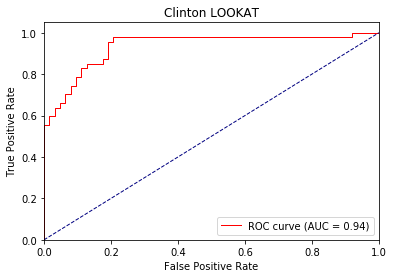

Directory already exists!
hc_brush1 0 ap tensor([0.8439, 0.0906]) loss : 0.5994166135787964 0.6986586089994087 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_brush1 0 ap tensor([1., 0.]) loss : 0.4025743007659912 0.39661072492599486 tid : 30 tg tensor([[0]], device='cuda:0')
TEST hc_brush1 0 ap tensor([1., 0.]) loss : 0.7117941379547119 0.42365001638730365 tid : 90 tg tensor([[0]], device='cuda:0')
TEST hc_brush1 0 ap tensor([1., 0.]) loss : 0.4838450253009796 0.4220138081797847 tid : 150 tg tensor([[0]], device='cuda:0')
TEST hc_brush1 0 ap tensor([0.9481, 0.2351]) loss : 0.9619066119194031 0.4810706631439488 tid : 210 tg tensor([[1]], device='cuda:0')
TEST hc_brush1 0 ap tensor([0.8917, 0.1827]) loss : 0.462302029132843 0.5237383991479874 tid : 270 tg tensor([[0]], device='cuda:0')
TEST hc_brush1 0 ap tensor([0.8907, 0.1475]) loss : 0.5164967775344849 0.5187253554662069 tid : 300 tg tensor([[0]], device='cuda:0')
TEST hc_brush1 0 ap tensor([0.8806, 0.1659]) loss : 0.507915914058

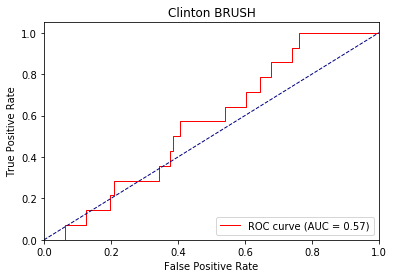

Directory already exists!
hc_brush1 1 ap tensor([0.9055, 0.1899]) loss : 0.3981987237930298 0.5029578280281013 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_brush1 1 ap tensor([1., 0.]) loss : 0.27288031578063965 0.25941643714904783 tid : 30 tg tensor([[0]], device='cuda:0')
TEST hc_brush1 1 ap tensor([1., 0.]) loss : 0.6573454737663269 0.27438315086894566 tid : 90 tg tensor([[0]], device='cuda:0')
TEST hc_brush1 1 ap tensor([1., 0.]) loss : 0.333303302526474 0.27149518110133986 tid : 150 tg tensor([[0]], device='cuda:0')
TEST hc_brush1 1 ap tensor([0.9750, 0.3131]) loss : 1.230955958366394 0.3760652920094932 tid : 210 tg tensor([[1]], device='cuda:0')
TEST hc_brush1 1 ap tensor([0.9388, 0.2599]) loss : 0.27108097076416016 0.44368555258821557 tid : 270 tg tensor([[0]], device='cuda:0')
TEST hc_brush1 1 ap tensor([0.9356, 0.2158]) loss : 0.3378715217113495 0.4309436932206154 tid : 300 tg tensor([[0]], device='cuda:0')
TEST hc_brush1 1 ap tensor([0.9214, 0.2338]) loss : 0.386949211

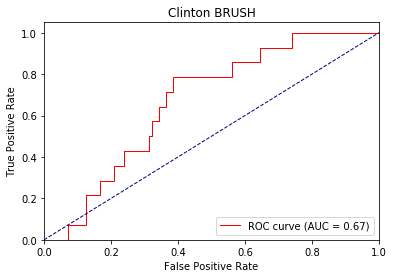

Directory already exists!
hc_brush1 2 ap tensor([0.9318, 0.2287]) loss : 0.1684975028038025 0.39788610129705015 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_brush1 2 ap tensor([1., 0.]) loss : 0.21339446306228638 0.1946756958961487 tid : 30 tg tensor([[0]], device='cuda:0')
TEST hc_brush1 2 ap tensor([1., 0.]) loss : 0.6193936467170715 0.19946066041787466 tid : 90 tg tensor([[0]], device='cuda:0')
TEST hc_brush1 2 ap tensor([1., 0.]) loss : 0.26322340965270996 0.19756202896436056 tid : 150 tg tensor([[0]], device='cuda:0')
TEST hc_brush1 2 ap tensor([0.9766, 0.2750]) loss : 1.4088764190673828 0.32930542564973597 tid : 210 tg tensor([[1]], device='cuda:0')
TEST hc_brush1 2 ap tensor([0.9588, 0.2851]) loss : 0.16928386688232422 0.4084308307479929 tid : 270 tg tensor([[0]], device='cuda:0')
TEST hc_brush1 2 ap tensor([0.9548, 0.2417]) loss : 0.23789560794830322 0.39205074558655423 tid : 300 tg tensor([[0]], device='cuda:0')
TEST hc_brush1 2 ap tensor([0.9384, 0.2610]) loss : 0.3241

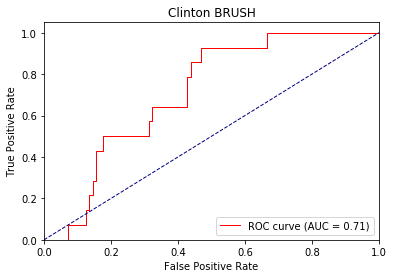

Directory already exists!
hc_nvdis1 0 ap tensor([0.9187, 0.1715]) loss : 0.3770715892314911 0.5988671161584406 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_nvdis1 0 ap tensor([0.6389, 0.7000]) loss : 0.32607799768447876 0.6866612195968628 tid : 30 tg tensor([[0]], device='cuda:0')
TEST hc_nvdis1 0 ap tensor([0.8181, 0.4208]) loss : 0.7194364666938782 0.595952593617969 tid : 90 tg tensor([[0]], device='cuda:0')
TEST hc_nvdis1 0 ap tensor([0.8616, 0.5183]) loss : 0.29761630296707153 0.5572002684628522 tid : 150 tg tensor([[0]], device='cuda:0')
TEST hc_nvdis1 0 ap tensor([0.8044, 0.4056]) loss : 0.4155566692352295 0.5792861958829368 tid : 210 tg tensor([[0]], device='cuda:0')
TEST hc_nvdis1 0 ap tensor([0.8451, 0.3082]) loss : 0.3006044030189514 0.5268916840906497 tid : 270 tg tensor([[0]], device='cuda:0')
TEST hc_nvdis1 0 ap tensor([0.8561, 0.2819]) loss : 0.2852248549461365 0.510222664475441 tid : 300 tg tensor([[0]], device='cuda:0')
TEST hc_nvdis1 0 ap tensor([0.8340, 0.2967]

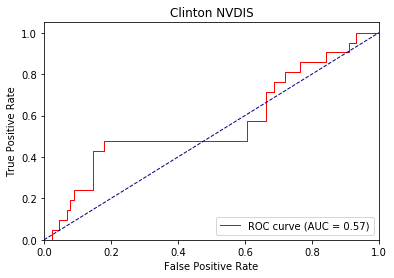

Directory already exists!
hc_nvdis1 1 ap tensor([0.9073, 0.6000]) loss : 0.23117095232009888 0.45395561364980846 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_nvdis1 1 ap tensor([0.6389, 0.7000]) loss : 0.1868320107460022 0.769020426273346 tid : 30 tg tensor([[0]], device='cuda:0')
TEST hc_nvdis1 1 ap tensor([0.8112, 0.4163]) loss : 0.7802760601043701 0.6368404163254632 tid : 90 tg tensor([[0]], device='cuda:0')
TEST hc_nvdis1 1 ap tensor([0.8411, 0.5101]) loss : 0.17954182624816895 0.5735171282732928 tid : 150 tg tensor([[0]], device='cuda:0')
TEST hc_nvdis1 1 ap tensor([0.8187, 0.4141]) loss : 0.2588261365890503 0.6021539656127372 tid : 210 tg tensor([[0]], device='cuda:0')
TEST hc_nvdis1 1 ap tensor([0.8606, 0.3088]) loss : 0.16481351852416992 0.5161763219921677 tid : 270 tg tensor([[0]], device='cuda:0')
TEST hc_nvdis1 1 ap tensor([0.8757, 0.2867]) loss : 0.16036975383758545 0.4850598782300949 tid : 300 tg tensor([[0]], device='cuda:0')
TEST hc_nvdis1 1 ap tensor([0.8694, 0.3

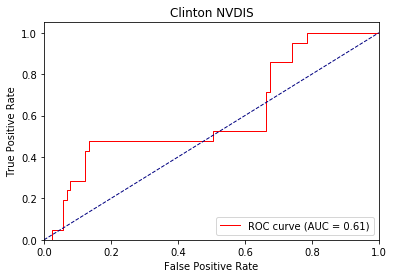

Directory already exists!
hc_nvdis1 2 ap tensor([0.9652, 0.5132]) loss : 0.10186243057250977 0.30768905775621536 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_nvdis1 2 ap tensor([0.6389, 0.7000]) loss : 0.1235036849975586 0.8764437079429627 tid : 30 tg tensor([[0]], device='cuda:0')
TEST hc_nvdis1 2 ap tensor([0.7396, 0.3420]) loss : 0.8678863048553467 0.71359783411026 tid : 90 tg tensor([[0]], device='cuda:0')
TEST hc_nvdis1 2 ap tensor([0.8019, 0.4684]) loss : 0.1293349266052246 0.633011054109644 tid : 150 tg tensor([[0]], device='cuda:0')
TEST hc_nvdis1 2 ap tensor([0.8071, 0.3996]) loss : 0.1905704140663147 0.6580764375081877 tid : 210 tg tensor([[0]], device='cuda:0')
TEST hc_nvdis1 2 ap tensor([0.8550, 0.3099]) loss : 0.09772789478302002 0.546377549568812 tid : 270 tg tensor([[0]], device='cuda:0')
TEST hc_nvdis1 2 ap tensor([0.8695, 0.2865]) loss : 0.10632765293121338 0.5053110718727112 tid : 300 tg tensor([[0]], device='cuda:0')
TEST hc_nvdis1 2 ap tensor([0.8699, 0.3173]

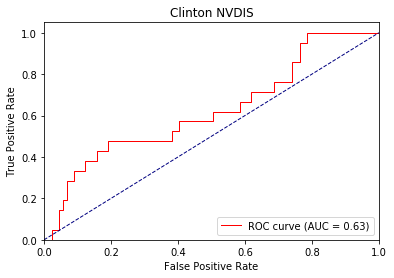

Directory already exists!
hc_look 0 ap tensor([0.3557, 0.8142]) loss : 0.4932391941547394 0.6475923966616393 tid : 200 tg tensor([[1]], device='cuda:0')
TEST hc_look 0 ap tensor([0., 1.]) loss : 0.5101137161254883 0.42816401124000547 tid : 30 tg tensor([[1]], device='cuda:0')
TEST hc_look 0 ap tensor([0., 1.]) loss : 0.5525213479995728 0.37923042972882587 tid : 90 tg tensor([[1]], device='cuda:0')
TEST hc_look 0 ap tensor([0.7000, 0.9952]) loss : 0.6145586967468262 0.41631843867125334 tid : 150 tg tensor([[1]], device='cuda:0')
TEST hc_look 0 ap tensor([0.4750, 0.9914]) loss : 0.6759291291236877 0.44237561051438495 tid : 210 tg tensor([[0]], device='cuda:0')
TEST hc_look 0 ap tensor([0.5702, 0.9910]) loss : 0.2747238874435425 0.44665843965830626 tid : 270 tg tensor([[1]], device='cuda:0')
TEST hc_look 0 ap tensor([0.6044, 0.9892]) loss : 0.4596017599105835 0.4566220879554749 tid : 300 tg tensor([[1]], device='cuda:0')
TEST hc_look 0 ap tensor([0.5857, 0.9688]) loss : 0.5342336893081665

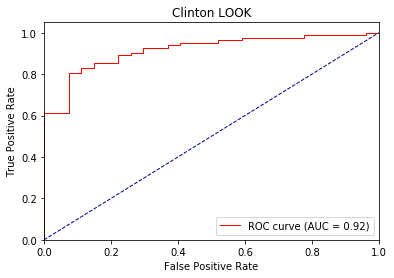

Directory already exists!
hc_look 1 ap tensor([0.7401, 0.9563]) loss : 0.24364054203033447 0.4678973340036863 tid : 200 tg tensor([[1]], device='cuda:0')
TEST hc_look 1 ap tensor([0., 1.]) loss : 0.4348665475845337 0.305646276473999 tid : 30 tg tensor([[1]], device='cuda:0')
TEST hc_look 1 ap tensor([0., 1.]) loss : 0.5043012499809265 0.2513895299699571 tid : 90 tg tensor([[1]], device='cuda:0')
TEST hc_look 1 ap tensor([0.5000, 0.9954]) loss : 0.6927170753479004 0.31334408345045867 tid : 150 tg tensor([[1]], device='cuda:0')
TEST hc_look 1 ap tensor([0.4694, 0.9923]) loss : 0.5479738712310791 0.3437455870756289 tid : 210 tg tensor([[0]], device='cuda:0')
TEST hc_look 1 ap tensor([0.6044, 0.9924]) loss : 0.16580021381378174 0.349569175530363 tid : 270 tg tensor([[1]], device='cuda:0')
TEST hc_look 1 ap tensor([0.6412, 0.9911]) loss : 0.36273419857025146 0.3636004199584325 tid : 300 tg tensor([[1]], device='cuda:0')
TEST hc_look 1 ap tensor([0.6089, 0.9687]) loss : 0.5429897308349609 0.

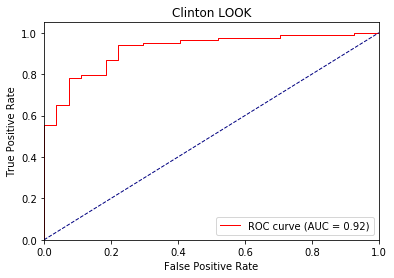

Directory already exists!
hc_look 2 ap tensor([0.8407, 0.9671]) loss : 0.2005612850189209 0.40376903676682974 tid : 200 tg tensor([[1]], device='cuda:0')
TEST hc_look 2 ap tensor([0., 1.]) loss : 0.3800610303878784 0.24141008853912355 tid : 30 tg tensor([[1]], device='cuda:0')
TEST hc_look 2 ap tensor([0., 1.]) loss : 0.4540926218032837 0.18445518612861633 tid : 90 tg tensor([[1]], device='cuda:0')
TEST hc_look 2 ap tensor([0.5000, 0.9954]) loss : 0.7181531190872192 0.25994729223074736 tid : 150 tg tensor([[1]], device='cuda:0')
TEST hc_look 2 ap tensor([0.4694, 0.9923]) loss : 0.48665300011634827 0.2891107325146838 tid : 210 tg tensor([[0]], device='cuda:0')
TEST hc_look 2 ap tensor([0.5806, 0.9920]) loss : 0.10094034671783447 0.29485674533579087 tid : 270 tg tensor([[1]], device='cuda:0')
TEST hc_look 2 ap tensor([0.6683, 0.9907]) loss : 0.27126067876815796 0.3104411855340004 tid : 300 tg tensor([[1]], device='cuda:0')
TEST hc_look 2 ap tensor([0.6258, 0.9679]) loss : 0.5164434909820

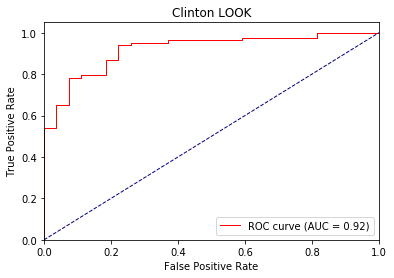

Directory already exists!
hc_eyebrow 0 ap tensor([0.8817, 0.2361]) loss : 0.6110013723373413 0.7299817552169164 tid : 200 tg tensor([[1]], device='cuda:0')
TEST hc_eyebrow 0 ap tensor([1., 1.]) loss : 0.5461454391479492 0.5551579713821411 tid : 30 tg tensor([[0]], device='cuda:0')
TEST hc_eyebrow 0 ap tensor([0.9217, 0.8028]) loss : 0.706200361251831 0.6442455119556851 tid : 90 tg tensor([[0]], device='cuda:0')
TEST hc_eyebrow 0 ap tensor([0.9336, 0.7681]) loss : 0.3996983468532562 0.6207356044539699 tid : 150 tg tensor([[0]], device='cuda:0')
TEST hc_eyebrow 0 ap tensor([0.9178, 0.6995]) loss : 0.36279675364494324 0.621972778221456 tid : 210 tg tensor([[0]], device='cuda:0')
TEST hc_eyebrow 0 ap tensor([0.8546, 0.5738]) loss : 0.7538561820983887 0.6387150894712519 tid : 270 tg tensor([[0]], device='cuda:0')
TEST hc_eyebrow 0 ap tensor([0.8736, 0.5641]) loss : 0.6983439326286316 0.6237061033646266 tid : 300 tg tensor([[1]], device='cuda:0')
TEST hc_eyebrow 0 ap tensor([0.8891, 0.5094])

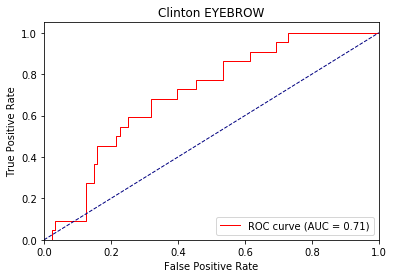

Directory already exists!
hc_eyebrow 1 ap tensor([0.9426, 0.7867]) loss : 0.7181146144866943 0.4944192064114106 tid : 200 tg tensor([[1]], device='cuda:0')
TEST hc_eyebrow 1 ap tensor([1., 1.]) loss : 0.4354435205459595 0.4719543278217316 tid : 30 tg tensor([[0]], device='cuda:0')
TEST hc_eyebrow 1 ap tensor([0.9148, 0.7571]) loss : 0.5515958070755005 0.5993736253844367 tid : 90 tg tensor([[0]], device='cuda:0')
TEST hc_eyebrow 1 ap tensor([0.9268, 0.7281]) loss : 0.27354782819747925 0.574917232548749 tid : 150 tg tensor([[0]], device='cuda:0')
TEST hc_eyebrow 1 ap tensor([0.9153, 0.6787]) loss : 0.22948366403579712 0.5822013580217594 tid : 210 tg tensor([[0]], device='cuda:0')
TEST hc_eyebrow 1 ap tensor([0.8564, 0.5500]) loss : 0.8213450908660889 0.6151411196699849 tid : 270 tg tensor([[0]], device='cuda:0')
TEST hc_eyebrow 1 ap tensor([0.8755, 0.5425]) loss : 0.7343368530273438 0.593661530315876 tid : 300 tg tensor([[1]], device='cuda:0')
TEST hc_eyebrow 1 ap tensor([0.8916, 0.5288]

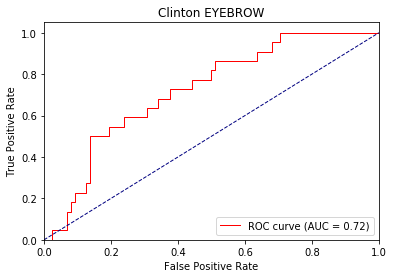

Directory already exists!
hc_eyebrow 2 ap tensor([0.9253, 0.7434]) loss : 0.7131518125534058 0.47663131120957825 tid : 200 tg tensor([[1]], device='cuda:0')
TEST hc_eyebrow 2 ap tensor([1., 1.]) loss : 0.3603711724281311 0.41642130017280576 tid : 30 tg tensor([[0]], device='cuda:0')
TEST hc_eyebrow 2 ap tensor([0.9362, 0.7738]) loss : 0.4407040476799011 0.5666573213206397 tid : 90 tg tensor([[0]], device='cuda:0')
TEST hc_eyebrow 2 ap tensor([0.9304, 0.7324]) loss : 0.20595043897628784 0.5449285694846401 tid : 150 tg tensor([[0]], device='cuda:0')
TEST hc_eyebrow 2 ap tensor([0.9156, 0.6782]) loss : 0.15635955333709717 0.5604498270081311 tid : 210 tg tensor([[0]], device='cuda:0')
TEST hc_eyebrow 2 ap tensor([0.8627, 0.5587]) loss : 0.8871590495109558 0.6073630385928683 tid : 270 tg tensor([[0]], device='cuda:0')
TEST hc_eyebrow 2 ap tensor([0.8800, 0.5506]) loss : 0.7389957904815674 0.5815417279799779 tid : 300 tg tensor([[1]], device='cuda:0')
TEST hc_eyebrow 2 ap tensor([0.8950, 0.5

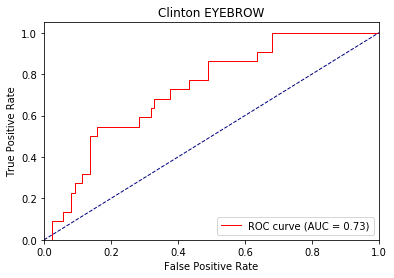

Directory already exists!
hc_atface 0 ap tensor([0.9510, 0.3806]) loss : 0.6403110027313232 0.6515543122549314 tid : 200 tg tensor([[1]], device='cuda:0')
TEST hc_atface 0 ap tensor([1., 1.]) loss : 0.40637391805648804 0.5037274122238159 tid : 30 tg tensor([[0]], device='cuda:0')
TEST hc_atface 0 ap tensor([0.9167, 0.4242]) loss : 0.5505760312080383 0.5620069139533572 tid : 90 tg tensor([[0]], device='cuda:0')
TEST hc_atface 0 ap tensor([0.8994, 0.3082]) loss : 0.26910585165023804 0.552313154494321 tid : 150 tg tensor([[0]], device='cuda:0')
TEST hc_atface 0 ap tensor([0.8753, 0.2655]) loss : 0.28084588050842285 0.5562056949952754 tid : 210 tg tensor([[0]], device='cuda:0')
TEST hc_atface 0 ap tensor([0.8551, 0.3198]) loss : 0.5025513768196106 0.5712109009424845 tid : 270 tg tensor([[0]], device='cuda:0')
TEST hc_atface 0 ap tensor([0.8819, 0.3430]) loss : 0.8190146684646606 0.5509564131498337 tid : 300 tg tensor([[1]], device='cuda:0')
TEST hc_atface 0 ap tensor([0.8958, 0.3263]) loss

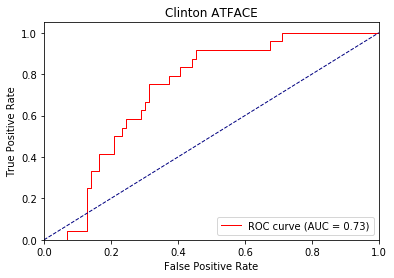

Directory already exists!
hc_atface 1 ap tensor([0.9602, 0.2889]) loss : 1.0742378234863281 0.41828991585832226 tid : 200 tg tensor([[1]], device='cuda:0')
TEST hc_atface 1 ap tensor([1., 1.]) loss : 0.2755292057991028 0.4477348327636719 tid : 30 tg tensor([[0]], device='cuda:0')
TEST hc_atface 1 ap tensor([0.9219, 0.3784]) loss : 0.4554179310798645 0.5164303100771375 tid : 90 tg tensor([[0]], device='cuda:0')
TEST hc_atface 1 ap tensor([0.9100, 0.3212]) loss : 0.15135812759399414 0.5050952555956664 tid : 150 tg tensor([[0]], device='cuda:0')
TEST hc_atface 1 ap tensor([0.8768, 0.2713]) loss : 0.14518117904663086 0.5166160675083719 tid : 210 tg tensor([[0]], device='cuda:0')
TEST hc_atface 1 ap tensor([0.8649, 0.3388]) loss : 0.4031319320201874 0.5457383896465655 tid : 270 tg tensor([[0]], device='cuda:0')
TEST hc_atface 1 ap tensor([0.8894, 0.3611]) loss : 1.019716501235962 0.5225300704439481 tid : 300 tg tensor([[1]], device='cuda:0')
TEST hc_atface 1 ap tensor([0.9041, 0.3460]) loss

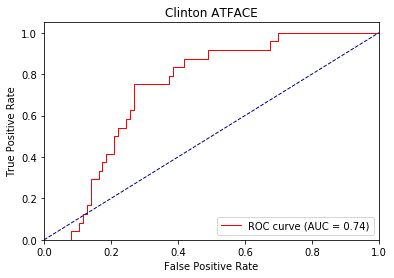

Directory already exists!
hc_atface 2 ap tensor([0.9552, 0.3059]) loss : 1.2385536432266235 0.37773254418525454 tid : 200 tg tensor([[1]], device='cuda:0')
TEST hc_atface 2 ap tensor([1., 1.]) loss : 0.21250122785568237 0.4279454708099365 tid : 30 tg tensor([[0]], device='cuda:0')
TEST hc_atface 2 ap tensor([0.9322, 0.5659]) loss : 0.3774813711643219 0.4974041250016954 tid : 90 tg tensor([[0]], device='cuda:0')
TEST hc_atface 2 ap tensor([0.9200, 0.3972]) loss : 0.10346031188964844 0.48717619644271004 tid : 150 tg tensor([[0]], device='cuda:0')
TEST hc_atface 2 ap tensor([0.8826, 0.2893]) loss : 0.0875784158706665 0.5036400643790641 tid : 210 tg tensor([[0]], device='cuda:0')
TEST hc_atface 2 ap tensor([0.8720, 0.3564]) loss : 0.36305293440818787 0.5400264588771043 tid : 270 tg tensor([[0]], device='cuda:0')
TEST hc_atface 2 ap tensor([0.8948, 0.3783]) loss : 1.1262524127960205 0.5153787876168887 tid : 300 tg tensor([[1]], device='cuda:0')
TEST hc_atface 2 ap tensor([0.9077, 0.3586]) l

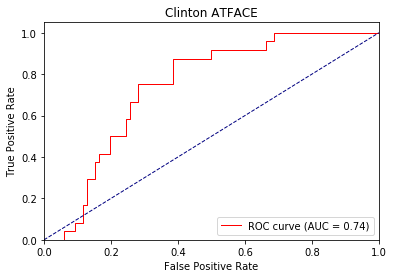

Directory already exists!
hc_feface 0 ap tensor([1., 0.]) loss : 0.4403555989265442 0.6289442832453992 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_feface 0 ap tensor([1., 0.]) loss : 0.3873228430747986 0.3815354764461517 tid : 30 tg tensor([[0]], device='cuda:0')
TEST hc_feface 0 ap tensor([1., 0.]) loss : 0.6047607660293579 0.37414345641930896 tid : 90 tg tensor([[0]], device='cuda:0')
TEST hc_feface 0 ap tensor([1., 0.]) loss : 0.36385688185691833 0.367199569940567 tid : 150 tg tensor([[0]], device='cuda:0')
TEST hc_feface 0 ap tensor([1., 0.]) loss : 0.410302996635437 0.3690163631264756 tid : 210 tg tensor([[0]], device='cuda:0')
TEST hc_feface 0 ap tensor([1., 0.]) loss : 0.34983029961586 0.3725117682306855 tid : 270 tg tensor([[0]], device='cuda:0')
TEST hc_feface 0 ap tensor([1., 0.]) loss : 0.3364294767379761 0.37416258702675503 tid : 300 tg tensor([[0]], device='cuda:0')
TEST hc_feface 0 ap tensor([1., 0.]) loss : 0.49911659955978394 0.3745745810824381 tid : 360 tg tens

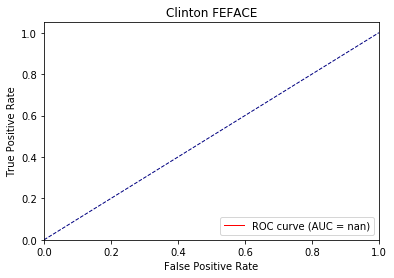

Directory already exists!
hc_feface 1 ap tensor([1., 0.]) loss : 0.1589353084564209 0.2709474196663132 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_feface 1 ap tensor([1., 0.]) loss : 0.151478111743927 0.17654949426651 tid : 30 tg tensor([[0]], device='cuda:0')
TEST hc_feface 1 ap tensor([1., 0.]) loss : 0.48051759600639343 0.18669121960798898 tid : 90 tg tensor([[0]], device='cuda:0')
TEST hc_feface 1 ap tensor([1., 0.]) loss : 0.1448034644126892 0.17776154699148955 tid : 150 tg tensor([[0]], device='cuda:0')
TEST hc_feface 1 ap tensor([1., 0.]) loss : 0.19749796390533447 0.18074914740353096 tid : 210 tg tensor([[0]], device='cuda:0')
TEST hc_feface 1 ap tensor([1., 0.]) loss : 0.15739142894744873 0.18164149478629785 tid : 270 tg tensor([[0]], device='cuda:0')
TEST hc_feface 1 ap tensor([1., 0.]) loss : 0.1343141794204712 0.1796034763256709 tid : 300 tg tensor([[0]], device='cuda:0')
TEST hc_feface 1 ap tensor([1., 0.]) loss : 0.2640455365180969 0.1776399360576146 tid : 360 tg 

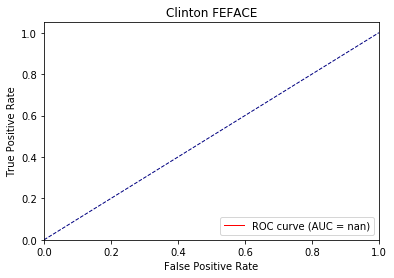

Directory already exists!
hc_feface 2 ap tensor([1., 0.]) loss : 0.09653079509735107 0.14484891880835807 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_feface 2 ap tensor([1., 0.]) loss : 0.06119215488433838 0.08087122440338135 tid : 30 tg tensor([[0]], device='cuda:0')
TEST hc_feface 2 ap tensor([1., 0.]) loss : 0.37419354915618896 0.09539089600245158 tid : 90 tg tensor([[0]], device='cuda:0')
TEST hc_feface 2 ap tensor([1., 0.]) loss : 0.06523692607879639 0.0889285891144364 tid : 150 tg tensor([[0]], device='cuda:0')
TEST hc_feface 2 ap tensor([1., 0.]) loss : 0.10726261138916016 0.09266388852421831 tid : 210 tg tensor([[0]], device='cuda:0')
TEST hc_feface 2 ap tensor([1., 0.]) loss : 0.06957340240478516 0.09297126421221981 tid : 270 tg tensor([[0]], device='cuda:0')
TEST hc_feface 2 ap tensor([1., 0.]) loss : 0.05612039566040039 0.09069691598415375 tid : 300 tg tensor([[0]], device='cuda:0')
TEST hc_feface 2 ap tensor([1., 0.]) loss : 0.14007365703582764 0.08855848832869194 ti

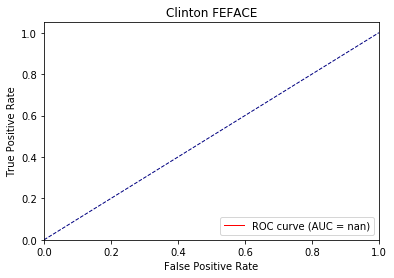

Directory already exists!
hc_hrface 0 ap tensor([0.6169, 0.7118]) loss : 0.7382689118385315 0.6664229557369694 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_hrface 0 ap tensor([1., 0.]) loss : 0.6005987524986267 0.7154605388641357 tid : 30 tg tensor([[0]], device='cuda:0')
TEST hc_hrface 0 ap tensor([0.9104, 0.2316]) loss : 0.6453508138656616 0.6773620413409339 tid : 90 tg tensor([[1]], device='cuda:0')
TEST hc_hrface 0 ap tensor([0.8939, 0.2329]) loss : 0.7024871706962585 0.6805292180290928 tid : 150 tg tensor([[1]], device='cuda:0')
TEST hc_hrface 0 ap tensor([0.8641, 0.4847]) loss : 0.8671568632125854 0.6667849704986666 tid : 210 tg tensor([[0]], device='cuda:0')
TEST hc_hrface 0 ap tensor([0.8964, 0.4605]) loss : 0.4838521182537079 0.6571766226379959 tid : 270 tg tensor([[0]], device='cuda:0')
TEST hc_hrface 0 ap tensor([0.8976, 0.4463]) loss : 0.4877556562423706 0.6582888086636861 tid : 300 tg tensor([[0]], device='cuda:0')
TEST hc_hrface 0 ap tensor([0.8675, 0.4548]) loss :

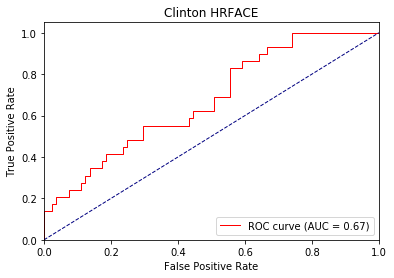

Directory already exists!
hc_hrface 1 ap tensor([0.7932, 0.7613]) loss : 0.5944904088973999 0.6282076772890592 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_hrface 1 ap tensor([1., 0.]) loss : 0.5646305680274963 0.6680217862129212 tid : 30 tg tensor([[0]], device='cuda:0')
TEST hc_hrface 1 ap tensor([0.8698, 0.4606]) loss : 0.5416332483291626 0.6296926637490591 tid : 90 tg tensor([[1]], device='cuda:0')
TEST hc_hrface 1 ap tensor([0.8625, 0.3635]) loss : 0.7430288791656494 0.6423358343265675 tid : 150 tg tensor([[1]], device='cuda:0')
TEST hc_hrface 1 ap tensor([0.8437, 0.5946]) loss : 0.8361849784851074 0.6320605234401983 tid : 210 tg tensor([[0]], device='cuda:0')
TEST hc_hrface 1 ap tensor([0.8883, 0.6045]) loss : 0.39299291372299194 0.6201250536574258 tid : 270 tg tensor([[0]], device='cuda:0')
TEST hc_hrface 1 ap tensor([0.8923, 0.5896]) loss : 0.42149609327316284 0.6198029076059659 tid : 300 tg tensor([[0]], device='cuda:0')
TEST hc_hrface 1 ap tensor([0.8715, 0.5836]) loss

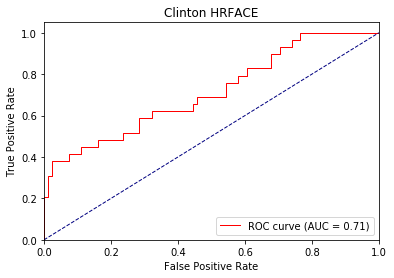

Directory already exists!
hc_hrface 2 ap tensor([0.7038, 0.8506]) loss : 0.5710704326629639 0.6016132910461987 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_hrface 2 ap tensor([1., 0.]) loss : 0.5324709415435791 0.6390390634536743 tid : 30 tg tensor([[0]], device='cuda:0')
TEST hc_hrface 2 ap tensor([0.8627, 0.4556]) loss : 0.4516851007938385 0.5988617787758509 tid : 90 tg tensor([[1]], device='cuda:0')
TEST hc_hrface 2 ap tensor([0.8593, 0.3651]) loss : 0.7816041707992554 0.6184115067676261 tid : 150 tg tensor([[1]], device='cuda:0')
TEST hc_hrface 2 ap tensor([0.8342, 0.5865]) loss : 0.8273436427116394 0.6093029154510032 tid : 210 tg tensor([[0]], device='cuda:0')
TEST hc_hrface 2 ap tensor([0.8824, 0.6255]) loss : 0.32511764764785767 0.5952933977047602 tid : 270 tg tensor([[0]], device='cuda:0')
TEST hc_hrface 2 ap tensor([0.8884, 0.6122]) loss : 0.36818408966064453 0.5925144657492638 tid : 300 tg tensor([[0]], device='cuda:0')
TEST hc_hrface 2 ap tensor([0.8692, 0.6030]) loss

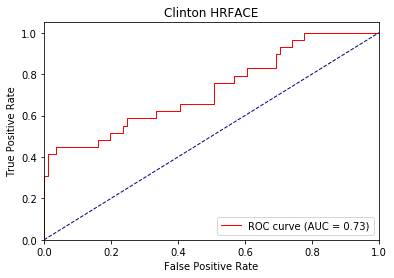

Directory already exists!
hc_saface 0 ap tensor([0.9963, 0.0811]) loss : 0.39065021276474 0.4695789824000937 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_saface 0 ap tensor([1., 0.]) loss : 0.37797629833221436 0.3666525363922119 tid : 30 tg tensor([[0]], device='cuda:0')
TEST hc_saface 0 ap tensor([1., 0.]) loss : 0.40559399127960205 0.37917885680993396 tid : 90 tg tensor([[0]], device='cuda:0')
TEST hc_saface 0 ap tensor([1., 0.]) loss : 0.22305363416671753 0.3620605965455373 tid : 150 tg tensor([[0]], device='cuda:0')
TEST hc_saface 0 ap tensor([1., 0.]) loss : 0.19767534732818604 0.3593880824926423 tid : 210 tg tensor([[0]], device='cuda:0')
TEST hc_saface 0 ap tensor([1., 0.]) loss : 0.3786502778530121 0.35537338312025424 tid : 270 tg tensor([[0]], device='cuda:0')
TEST hc_saface 0 ap tensor([1., 0.]) loss : 0.29436254501342773 0.3462248166402181 tid : 300 tg tensor([[0]], device='cuda:0')
TEST hc_saface 0 ap tensor([1., 0.]) loss : 0.31393229961395264 0.34375744470408265 ti

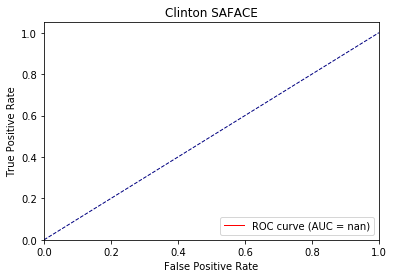

Directory already exists!
hc_saface 1 ap tensor([0.9827, 0.4167]) loss : 0.3695441782474518 0.42132171674778585 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_saface 1 ap tensor([1., 0.]) loss : 0.16489362716674805 0.18358707427978516 tid : 30 tg tensor([[0]], device='cuda:0')
TEST hc_saface 1 ap tensor([1., 0.]) loss : 0.3242644667625427 0.20311229096518624 tid : 90 tg tensor([[0]], device='cuda:0')
TEST hc_saface 1 ap tensor([1., 0.]) loss : 0.09057843685150146 0.1929896871248881 tid : 150 tg tensor([[0]], device='cuda:0')
TEST hc_saface 1 ap tensor([1., 0.]) loss : 0.10042667388916016 0.19198055092881366 tid : 210 tg tensor([[0]], device='cuda:0')
TEST hc_saface 1 ap tensor([1., 0.]) loss : 0.18091869354248047 0.18953610294395024 tid : 270 tg tensor([[0]], device='cuda:0')
TEST hc_saface 1 ap tensor([1., 0.]) loss : 0.12422657012939453 0.18199661523103713 tid : 300 tg tensor([[0]], device='cuda:0')
TEST hc_saface 1 ap tensor([1., 0.]) loss : 0.1730726957321167 0.179212051797920

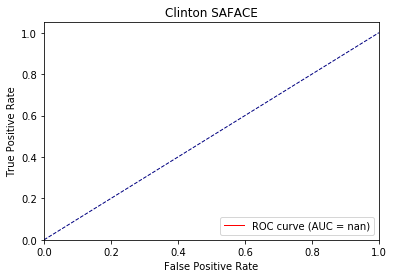

Directory already exists!
hc_saface 2 ap tensor([0.9950, 0.0413]) loss : 0.08888757228851318 0.15277905961901872 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_saface 2 ap tensor([1., 0.]) loss : 0.07793831825256348 0.10378869771957397 tid : 30 tg tensor([[0]], device='cuda:0')
TEST hc_saface 2 ap tensor([1., 0.]) loss : 0.2532966732978821 0.12019955118497212 tid : 90 tg tensor([[0]], device='cuda:0')
TEST hc_saface 2 ap tensor([1., 0.]) loss : 0.04164385795593262 0.11414237596370556 tid : 150 tg tensor([[0]], device='cuda:0')
TEST hc_saface 2 ap tensor([1., 0.]) loss : 0.056343674659729004 0.11384081404383589 tid : 210 tg tensor([[0]], device='cuda:0')
TEST hc_saface 2 ap tensor([1., 0.]) loss : 0.09353315830230713 0.11184231550605209 tid : 270 tg tensor([[0]], device='cuda:0')
TEST hc_saface 2 ap tensor([1., 0.]) loss : 0.05688679218292236 0.10599380830923716 tid : 300 tg tensor([[0]], device='cuda:0')
TEST hc_saface 2 ap tensor([1., 0.]) loss : 0.10063505172729492 0.10369924088

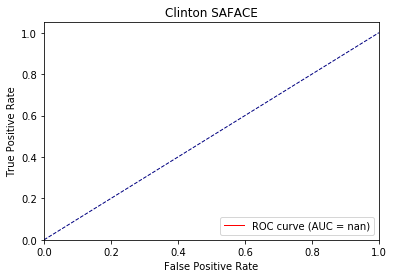

Directory already exists!
hc_neuface 0 ap tensor([1., 0.]) loss : 0.660513699054718 0.6654913262887434 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_neuface 0 ap tensor([0.2000, 0.6792]) loss : 0.8597935438156128 0.8123284578323364 tid : 30 tg tensor([[1]], device='cuda:0')
TEST hc_neuface 0 ap tensor([0.5385, 0.5752]) loss : 0.6797749400138855 0.7182504766517215 tid : 90 tg tensor([[0]], device='cuda:0')
TEST hc_neuface 0 ap tensor([0.4076, 0.5201]) loss : 0.5960938930511475 0.7365712059868706 tid : 150 tg tensor([[0]], device='cuda:0')
TEST hc_neuface 0 ap tensor([0.5358, 0.4647]) loss : 0.7177011966705322 0.7022578323759684 tid : 210 tg tensor([[1]], device='cuda:0')
TEST hc_neuface 0 ap tensor([0.5153, 0.4119]) loss : 0.7913702726364136 0.7087477467678212 tid : 270 tg tensor([[1]], device='cuda:0')
TEST hc_neuface 0 ap tensor([0.5134, 0.4577]) loss : 0.5604535341262817 0.7102052102486293 tid : 300 tg tensor([[0]], device='cuda:0')
TEST hc_neuface 0 ap tensor([0.5326, 0.4687])

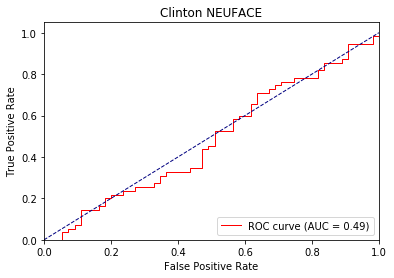

Directory already exists!
hc_neuface 1 ap tensor([0.7745, 0.4190]) loss : 0.527534008026123 0.639953795223605 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_neuface 1 ap tensor([0.2500, 0.8042]) loss : 0.9225659370422363 0.8568037748336792 tid : 30 tg tensor([[1]], device='cuda:0')
TEST hc_neuface 1 ap tensor([0.5598, 0.6798]) loss : 0.5488120317459106 0.7306775814957089 tid : 90 tg tensor([[0]], device='cuda:0')
TEST hc_neuface 1 ap tensor([0.4653, 0.5453]) loss : 0.5574932098388672 0.7488003064084936 tid : 150 tg tensor([[0]], device='cuda:0')
TEST hc_neuface 1 ap tensor([0.5764, 0.5023]) loss : 0.7329010963439941 0.7011851900961341 tid : 210 tg tensor([[1]], device='cuda:0')
TEST hc_neuface 1 ap tensor([0.5554, 0.4453]) loss : 0.8239079117774963 0.7064487641608274 tid : 270 tg tensor([[1]], device='cuda:0')
TEST hc_neuface 1 ap tensor([0.5689, 0.5429]) loss : 0.5130898952484131 0.7051105752587319 tid : 300 tg tensor([[0]], device='cuda:0')
TEST hc_neuface 1 ap tensor([0.5831, 0

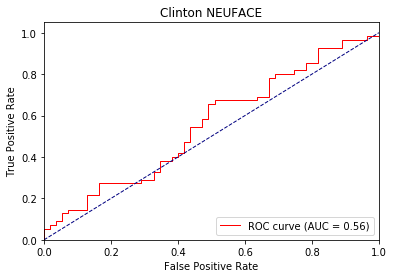

Directory already exists!
hc_neuface 2 ap tensor([0.8669, 0.5518]) loss : 0.4688999652862549 0.6060484842670084 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_neuface 2 ap tensor([0.3333, 0.8875]) loss : 0.9723585844039917 0.8916540503501892 tid : 30 tg tensor([[1]], device='cuda:0')
TEST hc_neuface 2 ap tensor([0.5726, 0.7426]) loss : 0.4434581696987152 0.7416475382116106 tid : 90 tg tensor([[0]], device='cuda:0')
TEST hc_neuface 2 ap tensor([0.5032, 0.5917]) loss : 0.5387201905250549 0.7564535560431304 tid : 150 tg tensor([[0]], device='cuda:0')
TEST hc_neuface 2 ap tensor([0.6069, 0.5905]) loss : 0.7266098856925964 0.6983204782009125 tid : 210 tg tensor([[1]], device='cuda:0')
TEST hc_neuface 2 ap tensor([0.5947, 0.5044]) loss : 0.8313738703727722 0.7028662308498665 tid : 270 tg tensor([[1]], device='cuda:0')
TEST hc_neuface 2 ap tensor([0.6186, 0.6055]) loss : 0.4806368947029114 0.6973249713579813 tid : 300 tg tensor([[0]], device='cuda:0')
TEST hc_neuface 2 ap tensor([0.6197,

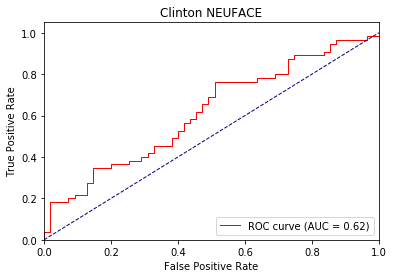

Directory already exists!
hc_inapprop 0 ap tensor([1., 0.]) loss : 0.3433355987071991 0.505286421094622 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_inapprop 0 ap tensor([1., 0.]) loss : 0.28801867365837097 0.38075358867645265 tid : 30 tg tensor([[0]], device='cuda:0')
TEST hc_inapprop 0 ap tensor([1., 0.]) loss : 0.5646796226501465 0.3852355182170868 tid : 90 tg tensor([[0]], device='cuda:0')
TEST hc_inapprop 0 ap tensor([1., 0.]) loss : 0.20687544345855713 0.36670249369409347 tid : 150 tg tensor([[0]], device='cuda:0')
TEST hc_inapprop 0 ap tensor([1., 0.]) loss : 0.2928323447704315 0.3617205001958987 tid : 210 tg tensor([[0]], device='cuda:0')
TEST hc_inapprop 0 ap tensor([1., 0.]) loss : 0.2853146195411682 0.35405515962176853 tid : 270 tg tensor([[0]], device='cuda:0')
TEST hc_inapprop 0 ap tensor([1., 0.]) loss : 0.28374481201171875 0.3455408538381259 tid : 300 tg tensor([[0]], device='cuda:0')
TEST hc_inapprop 0 ap tensor([1., 0.]) loss : 0.29925477504730225 0.342431785774

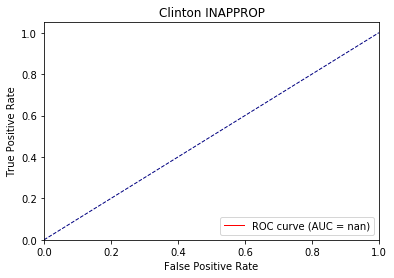

Directory already exists!
hc_inapprop 1 ap tensor([1., 0.]) loss : 0.29470115900039673 0.2565929114818573 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_inapprop 1 ap tensor([1., 0.]) loss : 0.11435317993164062 0.1809624195098877 tid : 30 tg tensor([[0]], device='cuda:0')
TEST hc_inapprop 1 ap tensor([1., 0.]) loss : 0.4287537932395935 0.187072507209248 tid : 90 tg tensor([[0]], device='cuda:0')
TEST hc_inapprop 1 ap tensor([1., 0.]) loss : 0.08000528812408447 0.17316370319437097 tid : 150 tg tensor([[0]], device='cuda:0')
TEST hc_inapprop 1 ap tensor([1., 0.]) loss : 0.13014143705368042 0.17427966652846918 tid : 210 tg tensor([[0]], device='cuda:0')
TEST hc_inapprop 1 ap tensor([1., 0.]) loss : 0.11779892444610596 0.17059781816270617 tid : 270 tg tensor([[0]], device='cuda:0')
TEST hc_inapprop 1 ap tensor([1., 0.]) loss : 0.12294352054595947 0.16420186956723531 tid : 300 tg tensor([[0]], device='cuda:0')
TEST hc_inapprop 1 ap tensor([1., 0.]) loss : 0.16536659002304077 0.16110066

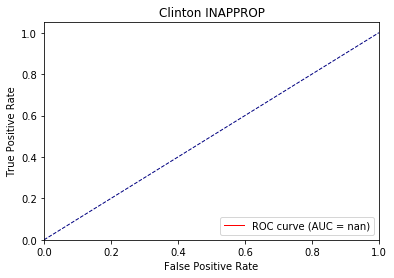

Directory already exists!
hc_inapprop 2 ap tensor([1., 0.]) loss : 0.047408103942871094 0.10528929996139863 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_inapprop 2 ap tensor([1., 0.]) loss : 0.045453786849975586 0.0896907925605774 tid : 30 tg tensor([[0]], device='cuda:0')
TEST hc_inapprop 2 ap tensor([1., 0.]) loss : 0.3114449977874756 0.09343845314449734 tid : 90 tg tensor([[0]], device='cuda:0')
TEST hc_inapprop 2 ap tensor([1., 0.]) loss : 0.03530311584472656 0.08449063919208667 tid : 150 tg tensor([[0]], device='cuda:0')
TEST hc_inapprop 2 ap tensor([1., 0.]) loss : 0.07071495056152344 0.08812077597873967 tid : 210 tg tensor([[0]], device='cuda:0')
TEST hc_inapprop 2 ap tensor([1., 0.]) loss : 0.04839062690734863 0.08644183311197493 tid : 270 tg tensor([[0]], device='cuda:0')
TEST hc_inapprop 2 ap tensor([1., 0.]) loss : 0.04662466049194336 0.0822136327624321 tid : 300 tg tensor([[0]], device='cuda:0')
TEST hc_inapprop 2 ap tensor([1., 0.]) loss : 0.09262228012084961 0.0795

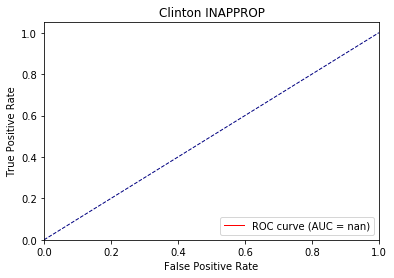

Directory already exists!
hc_affgest 0 ap tensor([0.9492, 0.1294]) loss : 0.5206403136253357 0.5376470870869134 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_affgest 0 ap tensor([1., 0.]) loss : 0.2433086633682251 0.3120099365711212 tid : 30 tg tensor([[0]], device='cuda:0')
TEST hc_affgest 0 ap tensor([1., 0.]) loss : 0.5364762544631958 0.36089125606748795 tid : 90 tg tensor([[0]], device='cuda:0')
TEST hc_affgest 0 ap tensor([1., 0.]) loss : 0.21029895544052124 0.33310393382001807 tid : 150 tg tensor([[0]], device='cuda:0')
TEST hc_affgest 0 ap tensor([1., 0.]) loss : 0.1922716498374939 0.33154680888827254 tid : 210 tg tensor([[0]], device='cuda:0')
TEST hc_affgest 0 ap tensor([1., 0.]) loss : 0.3336634635925293 0.3215252994387238 tid : 270 tg tensor([[0]], device='cuda:0')
TEST hc_affgest 0 ap tensor([1., 0.]) loss : 0.3134337067604065 0.3091175600886345 tid : 300 tg tensor([[0]], device='cuda:0')
TEST hc_affgest 0 ap tensor([1., 0.]) loss : 0.3472698926925659 0.30612853337341

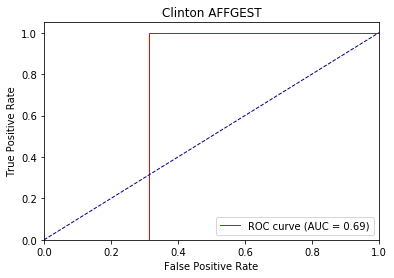

Directory already exists!
hc_affgest 1 ap tensor([0.9755, 0.1470]) loss : 0.1912785768508911 0.3145884658249331 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_affgest 1 ap tensor([1., 0.]) loss : 0.13290393352508545 0.22105125784873964 tid : 30 tg tensor([[0]], device='cuda:0')
TEST hc_affgest 1 ap tensor([1., 0.]) loss : 0.4234378933906555 0.2620546867450078 tid : 90 tg tensor([[0]], device='cuda:0')
TEST hc_affgest 1 ap tensor([1., 0.]) loss : 0.10194873809814453 0.23874627660821984 tid : 150 tg tensor([[0]], device='cuda:0')
TEST hc_affgest 1 ap tensor([1., 0.]) loss : 0.09753358364105225 0.23576413785539022 tid : 210 tg tensor([[0]], device='cuda:0')
TEST hc_affgest 1 ap tensor([1., 0.]) loss : 0.21285629272460938 0.2252287914355596 tid : 270 tg tensor([[0]], device='cuda:0')
TEST hc_affgest 1 ap tensor([1., 0.]) loss : 0.17547595500946045 0.21298595319191616 tid : 300 tg tensor([[0]], device='cuda:0')
TEST hc_affgest 1 ap tensor([1., 0.]) loss : 0.23105370998382568 0.20930550

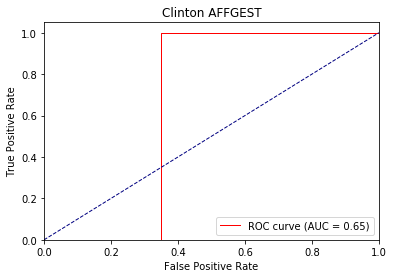

Directory already exists!
hc_affgest 2 ap tensor([0.9835, 0.1510]) loss : 0.1358962059020996 0.25181271767486696 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_affgest 2 ap tensor([1., 0.]) loss : 0.07917678356170654 0.17613787651062013 tid : 30 tg tensor([[0]], device='cuda:0')
TEST hc_affgest 2 ap tensor([1., 0.]) loss : 0.33304357528686523 0.20905396342277527 tid : 90 tg tensor([[0]], device='cuda:0')
TEST hc_affgest 2 ap tensor([1., 0.]) loss : 0.058379173278808594 0.19000791841083103 tid : 150 tg tensor([[0]], device='cuda:0')
TEST hc_affgest 2 ap tensor([1., 0.]) loss : 0.06214642524719238 0.1860428859547871 tid : 210 tg tensor([[0]], device='cuda:0')
TEST hc_affgest 2 ap tensor([1., 0.]) loss : 0.15049242973327637 0.1751756712242409 tid : 270 tg tensor([[0]], device='cuda:0')
TEST hc_affgest 2 ap tensor([1., 0.]) loss : 0.10897457599639893 0.1638635774453481 tid : 300 tg tensor([[0]], device='cuda:0')
TEST hc_affgest 2 ap tensor([1., 0.]) loss : 0.16838037967681885 0.160267

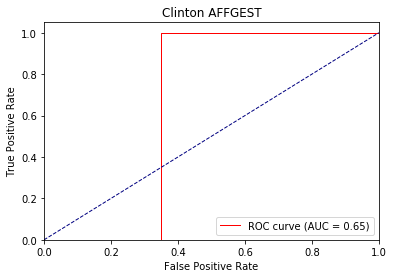

Directory already exists!
hc_defgest 0 ap tensor([0.9851, 0.3603]) loss : 0.5230337977409363 0.4892404010199537 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_defgest 0 ap tensor([1., 0.]) loss : 0.298503577709198 0.44510951042175295 tid : 30 tg tensor([[0]], device='cuda:0')
TEST hc_defgest 0 ap tensor([0.8332, 0.2332]) loss : 0.5251779556274414 0.5882136358155144 tid : 90 tg tensor([[0]], device='cuda:0')
TEST hc_defgest 0 ap tensor([0.8656, 0.3766]) loss : 0.1647912859916687 0.5621520788581283 tid : 150 tg tensor([[0]], device='cuda:0')
TEST hc_defgest 0 ap tensor([0.8607, 0.3975]) loss : 0.17684853076934814 0.5647973716259003 tid : 210 tg tensor([[0]], device='cuda:0')
TEST hc_defgest 0 ap tensor([0.8743, 0.4928]) loss : 1.1241281032562256 0.5584353589349322 tid : 270 tg tensor([[1]], device='cuda:0')
TEST hc_defgest 0 ap tensor([0.9069, 0.4928]) loss : 0.3342074751853943 0.5270952438314755 tid : 300 tg tensor([[0]], device='cuda:0')
TEST hc_defgest 0 ap tensor([0.8989, 0.4185

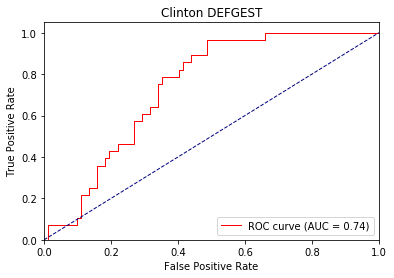

Directory already exists!
hc_defgest 1 ap tensor([0.9708, 0.1943]) loss : 0.23888075351715088 0.33877468542458394 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_defgest 1 ap tensor([1., 0.]) loss : 0.19003868103027344 0.30011423826217654 tid : 30 tg tensor([[0]], device='cuda:0')
TEST hc_defgest 1 ap tensor([0.8348, 0.2307]) loss : 0.4505652189254761 0.5424844506714079 tid : 90 tg tensor([[0]], device='cuda:0')
TEST hc_defgest 1 ap tensor([0.8711, 0.5192]) loss : 0.10287976264953613 0.5319557366547761 tid : 150 tg tensor([[0]], device='cuda:0')
TEST hc_defgest 1 ap tensor([0.8646, 0.4669]) loss : 0.10647022724151611 0.5553047184537097 tid : 210 tg tensor([[0]], device='cuda:0')
TEST hc_defgest 1 ap tensor([0.8744, 0.5191]) loss : 1.3759067058563232 0.5589831372102102 tid : 270 tg tensor([[1]], device='cuda:0')
TEST hc_defgest 1 ap tensor([0.9057, 0.5184]) loss : 0.24185004830360413 0.518858115375042 tid : 300 tg tensor([[0]], device='cuda:0')
TEST hc_defgest 1 ap tensor([0.9036, 0

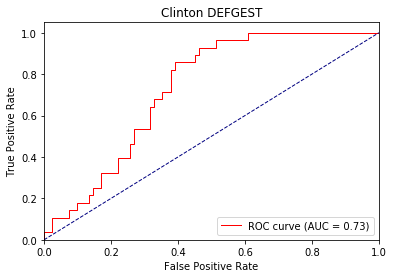

Directory already exists!
hc_defgest 2 ap tensor([0.9580, 0.1618]) loss : 0.200830340385437 0.3242083214289319 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_defgest 2 ap tensor([1., 0.]) loss : 0.13923633098602295 0.2336965799331665 tid : 30 tg tensor([[0]], device='cuda:0')
TEST hc_defgest 2 ap tensor([0.8410, 0.2368]) loss : 0.38830843567848206 0.5277514689498477 tid : 90 tg tensor([[0]], device='cuda:0')
TEST hc_defgest 2 ap tensor([0.8739, 0.5230]) loss : 0.07467973232269287 0.524475199204904 tid : 150 tg tensor([[0]], device='cuda:0')
TEST hc_defgest 2 ap tensor([0.8679, 0.4945]) loss : 0.07364940643310547 0.5603632592573399 tid : 210 tg tensor([[0]], device='cuda:0')
TEST hc_defgest 2 ap tensor([0.8773, 0.5429]) loss : 1.500598430633545 0.5675190069057323 tid : 270 tg tensor([[1]], device='cuda:0')
TEST hc_defgest 2 ap tensor([0.9068, 0.5417]) loss : 0.20423370599746704 0.52262541949749 tid : 300 tg tensor([[0]], device='cuda:0')
TEST hc_defgest 2 ap tensor([0.9072, 0.4959]

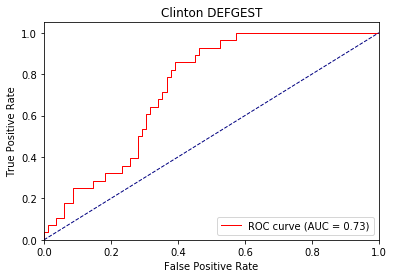

Directory already exists!
hc_agentic 0 ap tensor([0.9557, 0.9166]) loss : 0.5980013608932495 0.5687737492414621 tid : 200 tg tensor([[1]], device='cuda:0')
TEST hc_agentic 0 ap tensor([1., 1.]) loss : 0.527595043182373 0.47425596714019774 tid : 30 tg tensor([[0]], device='cuda:0')
TEST hc_agentic 0 ap tensor([0.9683, 0.9842]) loss : 0.4298105239868164 0.4574233376317554 tid : 90 tg tensor([[0]], device='cuda:0')
TEST hc_agentic 0 ap tensor([0.9860, 0.9924]) loss : 0.3945353031158447 0.41606946455107796 tid : 150 tg tensor([[0]], device='cuda:0')
TEST hc_agentic 0 ap tensor([0.9345, 0.9756]) loss : 0.32839342951774597 0.4306181887301003 tid : 210 tg tensor([[0]], device='cuda:0')
TEST hc_agentic 0 ap tensor([0.8913, 0.9603]) loss : 0.32403188943862915 0.45388132168187034 tid : 270 tg tensor([[1]], device='cuda:0')
TEST hc_agentic 0 ap tensor([0.9126, 0.9557]) loss : 0.6601776480674744 0.45203798611958823 tid : 300 tg tensor([[1]], device='cuda:0')
TEST hc_agentic 0 ap tensor([0.9099, 0.

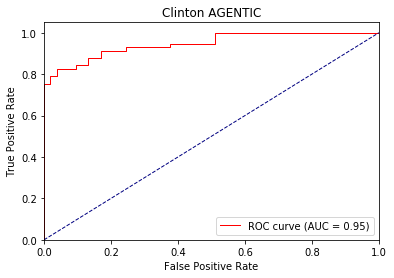

Directory already exists!
hc_agentic 1 ap tensor([0.9725, 0.8763]) loss : 0.506165087223053 0.4179297399520874 tid : 200 tg tensor([[1]], device='cuda:0')
TEST hc_agentic 1 ap tensor([1., 1.]) loss : 0.47412726283073425 0.4021469295024872 tid : 30 tg tensor([[0]], device='cuda:0')
TEST hc_agentic 1 ap tensor([1., 1.]) loss : 0.3693578541278839 0.39431369801362354 tid : 90 tg tensor([[0]], device='cuda:0')
TEST hc_agentic 1 ap tensor([1., 1.]) loss : 0.28707289695739746 0.334767343821349 tid : 150 tg tensor([[0]], device='cuda:0')
TEST hc_agentic 1 ap tensor([0.9470, 0.9851]) loss : 0.19338780641555786 0.35981473472060227 tid : 210 tg tensor([[0]], device='cuda:0')
TEST hc_agentic 1 ap tensor([0.8976, 0.9661]) loss : 0.1924295425415039 0.3931433034163934 tid : 270 tg tensor([[1]], device='cuda:0')
TEST hc_agentic 1 ap tensor([0.9180, 0.9621]) loss : 0.4786204695701599 0.3869460980097453 tid : 300 tg tensor([[1]], device='cuda:0')
TEST hc_agentic 1 ap tensor([0.9160, 0.9568]) loss : 0.96

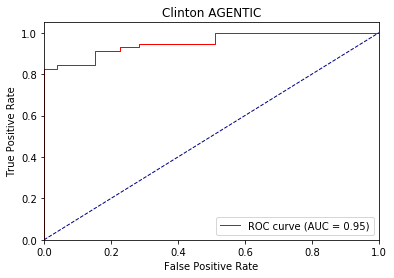

Directory already exists!
hc_agentic 2 ap tensor([0.9821, 0.9623]) loss : 0.28945791721343994 0.2573260873397614 tid : 200 tg tensor([[1]], device='cuda:0')
TEST hc_agentic 2 ap tensor([1., 1.]) loss : 0.4087064862251282 0.33784844875335696 tid : 30 tg tensor([[0]], device='cuda:0')
TEST hc_agentic 2 ap tensor([1., 1.]) loss : 0.3220102787017822 0.35565390520625645 tid : 90 tg tensor([[0]], device='cuda:0')
TEST hc_agentic 2 ap tensor([1., 1.]) loss : 0.23654800653457642 0.2864914867613051 tid : 150 tg tensor([[0]], device='cuda:0')
TEST hc_agentic 2 ap tensor([0.9470, 0.9851]) loss : 0.13058197498321533 0.3230803928724149 tid : 210 tg tensor([[0]], device='cuda:0')
TEST hc_agentic 2 ap tensor([0.8976, 0.9661]) loss : 0.11455827951431274 0.36644694595425215 tid : 270 tg tensor([[1]], device='cuda:0')
TEST hc_agentic 2 ap tensor([0.9190, 0.9631]) loss : 0.3116278350353241 0.3558468123277028 tid : 300 tg tensor([[1]], device='cuda:0')
TEST hc_agentic 2 ap tensor([0.9192, 0.9590]) loss : 

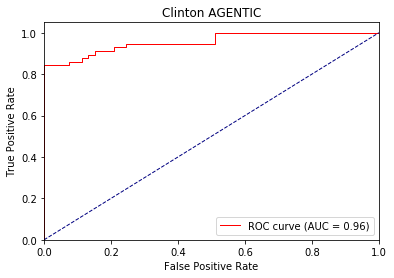

Directory already exists!
hc_waveoff 0 ap tensor([0.7875, 0.4141]) loss : 0.5890661478042603 0.7108196461273182 tid : 200 tg tensor([[1]], device='cuda:0')
TEST hc_waveoff 0 ap tensor([0.9500, 0.5000]) loss : 0.6438924670219421 0.7196776270866394 tid : 30 tg tensor([[0]], device='cuda:0')
TEST hc_waveoff 0 ap tensor([0.8502, 0.4215]) loss : 0.770055890083313 0.7304201953940921 tid : 90 tg tensor([[0]], device='cuda:0')
TEST hc_waveoff 0 ap tensor([0.8686, 0.5052]) loss : 0.5291814208030701 0.6674976150194804 tid : 150 tg tensor([[0]], device='cuda:0')
TEST hc_waveoff 0 ap tensor([0.8756, 0.5982]) loss : 0.5342742204666138 0.6429931346963091 tid : 210 tg tensor([[0]], device='cuda:0')
TEST hc_waveoff 0 ap tensor([0.8751, 0.6466]) loss : 0.5022124648094177 0.626004840488787 tid : 270 tg tensor([[1]], device='cuda:0')
TEST hc_waveoff 0 ap tensor([0.9037, 0.6436]) loss : 0.6226322650909424 0.6177262862523397 tid : 300 tg tensor([[0]], device='cuda:0')
TEST hc_waveoff 0 ap tensor([0.8939, 0

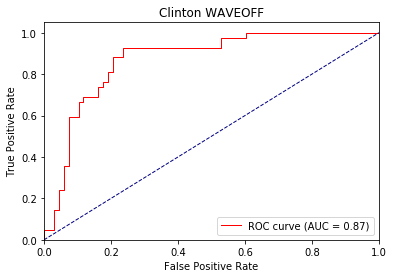

Directory already exists!
hc_waveoff 1 ap tensor([0.9373, 0.7565]) loss : 0.6129207611083984 0.5296239511215644 tid : 200 tg tensor([[1]], device='cuda:0')
TEST hc_waveoff 1 ap tensor([0.9500, 0.5000]) loss : 0.49916085600852966 0.6442164838314056 tid : 30 tg tensor([[0]], device='cuda:0')
TEST hc_waveoff 1 ap tensor([0.8836, 0.4744]) loss : 0.6330939531326294 0.7053239925040139 tid : 90 tg tensor([[0]], device='cuda:0')
TEST hc_waveoff 1 ap tensor([0.8819, 0.5354]) loss : 0.28413426876068115 0.6136877967251672 tid : 150 tg tensor([[0]], device='cuda:0')
TEST hc_waveoff 1 ap tensor([0.8859, 0.6286]) loss : 0.25116443634033203 0.5796052122988352 tid : 210 tg tensor([[0]], device='cuda:0')
TEST hc_waveoff 1 ap tensor([0.8928, 0.6851]) loss : 0.4391719102859497 0.5565670546558168 tid : 270 tg tensor([[1]], device='cuda:0')
TEST hc_waveoff 1 ap tensor([0.9161, 0.6820]) loss : 0.5942140817642212 0.538996459543705 tid : 300 tg tensor([[0]], device='cuda:0')
TEST hc_waveoff 1 ap tensor([0.904

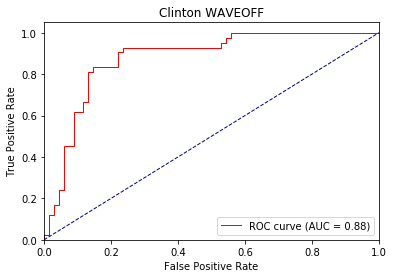

Directory already exists!
hc_waveoff 2 ap tensor([0.9594, 0.8257]) loss : 0.576249361038208 0.413061978854239 tid : 200 tg tensor([[1]], device='cuda:0')
TEST hc_waveoff 2 ap tensor([0.9500, 0.5000]) loss : 0.4045548737049103 0.5932917296886444 tid : 30 tg tensor([[0]], device='cuda:0')
TEST hc_waveoff 2 ap tensor([0.8815, 0.4585]) loss : 0.5346399545669556 0.6901555359363556 tid : 90 tg tensor([[0]], device='cuda:0')
TEST hc_waveoff 2 ap tensor([0.8850, 0.5325]) loss : 0.18044239282608032 0.5861645616866924 tid : 150 tg tensor([[0]], device='cuda:0')
TEST hc_waveoff 2 ap tensor([0.8940, 0.6449]) loss : 0.15198922157287598 0.5506710431924681 tid : 210 tg tensor([[0]], device='cuda:0')
TEST hc_waveoff 2 ap tensor([0.8982, 0.7009]) loss : 0.37435922026634216 0.5254646677661825 tid : 270 tg tensor([[1]], device='cuda:0')
TEST hc_waveoff 2 ap tensor([0.9200, 0.6977]) loss : 0.6528156995773315 0.5049245869119962 tid : 300 tg tensor([[0]], device='cuda:0')
TEST hc_waveoff 2 ap tensor([0.9098

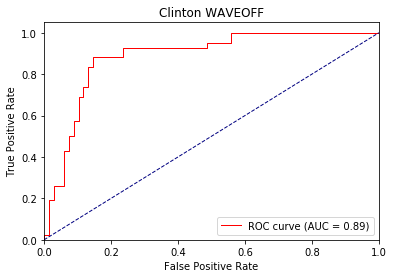

Directory already exists!
hc_nvtic1 0 ap tensor([0.8466, 0.2178]) loss : 0.5991381406784058 0.6416432081667844 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic1 0 ap tensor([1., 0.]) loss : 0.3999587595462799 0.36731849908828734 tid : 30 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic1 0 ap tensor([0.9212, 0.6659]) loss : 0.49702906608581543 0.5036700781848695 tid : 90 tg tensor([[1]], device='cuda:0')
TEST hc_nvtic1 0 ap tensor([0.8940, 0.5972]) loss : 1.0924108028411865 0.5442529298641063 tid : 150 tg tensor([[1]], device='cuda:0')
TEST hc_nvtic1 0 ap tensor([0.8601, 0.5626]) loss : 0.9934607744216919 0.5673440643926946 tid : 210 tg tensor([[1]], device='cuda:0')
TEST hc_nvtic1 0 ap tensor([0.8340, 0.6270]) loss : 0.3372254967689514 0.6023806631565094 tid : 270 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic1 0 ap tensor([0.8375, 0.6137]) loss : 0.44171077013015747 0.6048092007637024 tid : 300 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic1 0 ap tensor([0.8569, 0.6445]) los

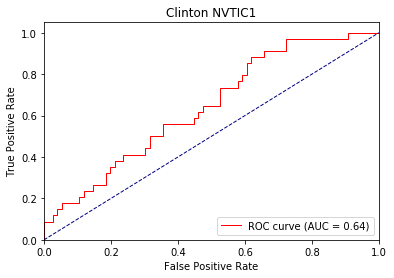

Directory already exists!
hc_nvtic1 1 ap tensor([0.9067, 0.1806]) loss : 0.3553566336631775 0.4774547743660803 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic1 1 ap tensor([1., 0.]) loss : 0.3300687074661255 0.28600162267684937 tid : 30 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic1 1 ap tensor([0.9297, 0.5437]) loss : 0.5730423331260681 0.47124432524045307 tid : 90 tg tensor([[1]], device='cuda:0')
TEST hc_nvtic1 1 ap tensor([0.8953, 0.5006]) loss : 1.3771698474884033 0.5280957464818601 tid : 150 tg tensor([[1]], device='cuda:0')
TEST hc_nvtic1 1 ap tensor([0.8870, 0.6059]) loss : 1.2193000316619873 0.5540852045140615 tid : 210 tg tensor([[1]], device='cuda:0')
TEST hc_nvtic1 1 ap tensor([0.8711, 0.6964]) loss : 0.22510677576065063 0.6059990420385644 tid : 270 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic1 1 ap tensor([0.8704, 0.6963]) loss : 0.3157625198364258 0.6077369426687559 tid : 300 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic1 1 ap tensor([0.8826, 0.7178]) los

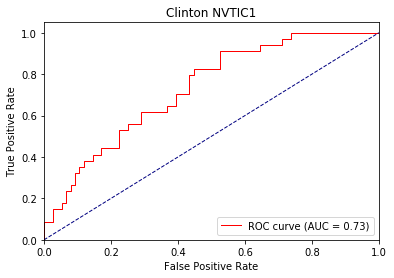

Directory already exists!
hc_nvtic1 2 ap tensor([0.9416, 0.2066]) loss : 0.2513654828071594 0.3788431918491488 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic1 2 ap tensor([1., 0.]) loss : 0.309645414352417 0.25391162633895875 tid : 30 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic1 2 ap tensor([0.9379, 0.5516]) loss : 0.6439144015312195 0.46701522668202716 tid : 90 tg tensor([[1]], device='cuda:0')
TEST hc_nvtic1 2 ap tensor([0.8949, 0.5034]) loss : 1.567948341369629 0.5310251756950661 tid : 150 tg tensor([[1]], device='cuda:0')
TEST hc_nvtic1 2 ap tensor([0.8972, 0.5896]) loss : 1.3752645254135132 0.5579307660823916 tid : 210 tg tensor([[1]], device='cuda:0')
TEST hc_nvtic1 2 ap tensor([0.8931, 0.6922]) loss : 0.16460520029067993 0.6183440442438479 tid : 270 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic1 2 ap tensor([0.8913, 0.6984]) loss : 0.24949103593826294 0.6188784331083298 tid : 300 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic1 2 ap tensor([0.8997, 0.7111]) loss

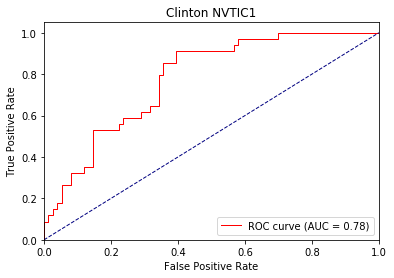

Directory already exists!
hc_nvtic2 0 ap tensor([0.8986, 0.2529]) loss : 0.5109700560569763 0.5637998911854508 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic2 0 ap tensor([1., 1.]) loss : 0.47816887497901917 0.5402312994003295 tid : 30 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic2 0 ap tensor([0.8305, 0.3889]) loss : 0.7423772811889648 0.5252799126836989 tid : 90 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic2 0 ap tensor([0.8657, 0.3808]) loss : 0.32601726055145264 0.4906072969789858 tid : 150 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic2 0 ap tensor([0.9163, 0.2708]) loss : 0.2745794653892517 0.4758499126608779 tid : 210 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic2 0 ap tensor([0.8698, 0.2376]) loss : 0.3314112424850464 0.509116996217657 tid : 270 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic2 0 ap tensor([0.8584, 0.2339]) loss : 0.44607651233673096 0.5190448393424352 tid : 300 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic2 0 ap tensor([0.8586, 0.2657]) loss

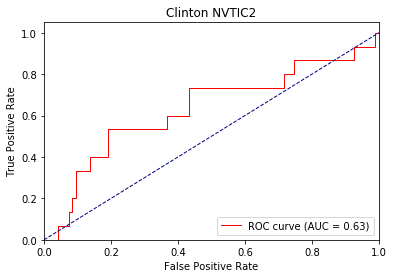

Directory already exists!
hc_nvtic2 1 ap tensor([0.8494, 0.1467]) loss : 0.4254870116710663 0.5007217606393303 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic2 1 ap tensor([1., 1.]) loss : 0.3648567795753479 0.5363425135612487 tid : 30 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic2 1 ap tensor([0.8305, 0.3889]) loss : 0.6960299015045166 0.46019194026788074 tid : 90 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic2 1 ap tensor([0.8713, 0.4370]) loss : 0.2325648069381714 0.41928711864683366 tid : 150 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic2 1 ap tensor([0.9075, 0.3327]) loss : 0.19664502143859863 0.38626921540353354 tid : 210 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic2 1 ap tensor([0.8889, 0.2759]) loss : 0.20563775300979614 0.43083040857756577 tid : 270 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic2 1 ap tensor([0.8840, 0.2861]) loss : 0.309326708316803 0.44973111401001614 tid : 300 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic2 1 ap tensor([0.8846, 0.3151]) 

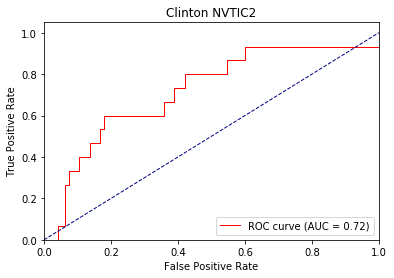

Directory already exists!
hc_nvtic2 2 ap tensor([0.9573, 0.6667]) loss : 0.2890307903289795 0.4185933868090312 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic2 2 ap tensor([1., 1.]) loss : 0.32983577251434326 0.533971083164215 tid : 30 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic2 2 ap tensor([0.8270, 0.3333]) loss : 0.6618422269821167 0.43730733460850185 tid : 90 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic2 2 ap tensor([0.8699, 0.3954]) loss : 0.20294469594955444 0.388974130153656 tid : 150 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic2 2 ap tensor([0.9068, 0.3119]) loss : 0.1722320318222046 0.34459430851587436 tid : 210 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic2 2 ap tensor([0.9072, 0.3110]) loss : 0.14198333024978638 0.39097725241272535 tid : 270 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic2 2 ap tensor([0.9069, 0.3391]) loss : 0.24210423231124878 0.41535766919453937 tid : 300 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic2 2 ap tensor([0.9020, 0.3450]) 

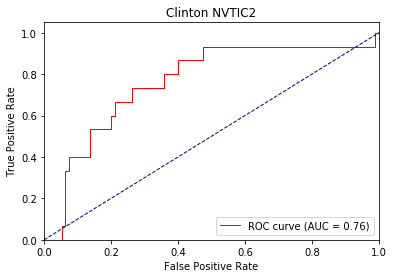

Directory already exists!
hc_nvtic3 0 ap tensor([1., 0.]) loss : 0.33463823795318604 0.5419302862947402 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic3 0 ap tensor([1., 0.]) loss : 0.25610101222991943 0.31620140075683595 tid : 30 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic3 0 ap tensor([1., 0.]) loss : 0.37580955028533936 0.3325198044379552 tid : 90 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic3 0 ap tensor([1., 0.]) loss : 0.22874701023101807 0.32744497612670614 tid : 150 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic3 0 ap tensor([1., 0.]) loss : 0.24358904361724854 0.3321414473580151 tid : 210 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic3 0 ap tensor([1., 0.]) loss : 0.3506935238838196 0.32731306552886963 tid : 270 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic3 0 ap tensor([1., 0.]) loss : 0.2643633484840393 0.3206990510225296 tid : 300 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic3 0 ap tensor([1., 0.]) loss : 0.37924104928970337 0.31715847153059196 tid : 3

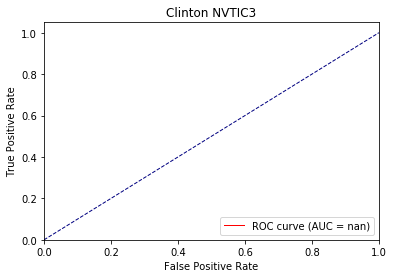

Directory already exists!
hc_nvtic3 1 ap tensor([1., 0.]) loss : 0.17166972160339355 0.2572441339492798 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic3 1 ap tensor([1., 0.]) loss : 0.10332727432250977 0.1430872678756714 tid : 30 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic3 1 ap tensor([1., 0.]) loss : 0.28645771741867065 0.15494034687678018 tid : 90 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic3 1 ap tensor([1., 0.]) loss : 0.08674073219299316 0.15216798252529568 tid : 150 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic3 1 ap tensor([1., 0.]) loss : 0.12086927890777588 0.1611822749056467 tid : 210 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic3 1 ap tensor([1., 0.]) loss : 0.15762287378311157 0.15966851347022587 tid : 270 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic3 1 ap tensor([1., 0.]) loss : 0.10804939270019531 0.15470074862241745 tid : 300 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic3 1 ap tensor([1., 0.]) loss : 0.23211753368377686 0.1519197448038719 tid :

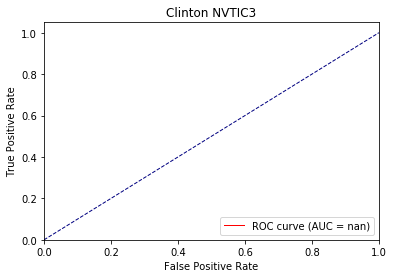

Directory already exists!
hc_nvtic3 2 ap tensor([1., 0.]) loss : 0.039029479026794434 0.10752663068375733 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic3 2 ap tensor([1., 0.]) loss : 0.043926358222961426 0.06760694980621337 tid : 30 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic3 2 ap tensor([1., 0.]) loss : 0.2206195592880249 0.07661045259899563 tid : 90 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic3 2 ap tensor([1., 0.]) loss : 0.039690256118774414 0.0751476729357684 tid : 150 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic3 2 ap tensor([1., 0.]) loss : 0.07314646244049072 0.08348772438561045 tid : 210 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic3 2 ap tensor([1., 0.]) loss : 0.07342660427093506 0.08358122794716447 tid : 270 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic3 2 ap tensor([1., 0.]) loss : 0.047606587409973145 0.08037934601306915 tid : 300 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic3 2 ap tensor([1., 0.]) loss : 0.15169692039489746 0.0785230104352387 

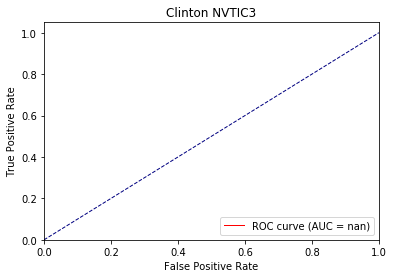

Directory already exists!
hc_nvtic5 0 ap tensor([1., 0.]) loss : 0.6943228840827942 0.7451535046100617 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic5 0 ap tensor([1., 0.]) loss : 0.31097912788391113 0.37701619863510133 tid : 30 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic5 0 ap tensor([1., 0.]) loss : 0.4806789755821228 0.3730898466375139 tid : 90 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic5 0 ap tensor([1., 0.]) loss : 0.28138092160224915 0.35925355001732157 tid : 150 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic5 0 ap tensor([1., 0.]) loss : 0.39728623628616333 0.35563178978315213 tid : 210 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic5 0 ap tensor([1., 0.]) loss : 0.31654101610183716 0.348141270103278 tid : 270 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic5 0 ap tensor([1., 0.]) loss : 0.2635611891746521 0.3391822372873624 tid : 300 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic5 0 ap tensor([1., 0.]) loss : 0.47156888246536255 0.3409303863283614 tid : 360 

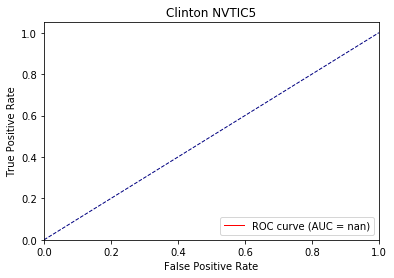

Directory already exists!
hc_nvtic5 1 ap tensor([1., 0.]) loss : 0.18188315629959106 0.2556409869214584 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic5 1 ap tensor([1., 0.]) loss : 0.11888736486434937 0.19000554084777832 tid : 30 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic5 1 ap tensor([1., 0.]) loss : 0.34921687841415405 0.18950791160265604 tid : 90 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic5 1 ap tensor([1., 0.]) loss : 0.10493004322052002 0.17899849127840112 tid : 150 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic5 1 ap tensor([1., 0.]) loss : 0.16537588834762573 0.17693612488304697 tid : 210 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic5 1 ap tensor([1., 0.]) loss : 0.14301449060440063 0.17206668191485935 tid : 270 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic5 1 ap tensor([1., 0.]) loss : 0.09992384910583496 0.16439738074938456 tid : 300 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic5 1 ap tensor([1., 0.]) loss : 0.2570411264896393 0.16343104125748217 tid

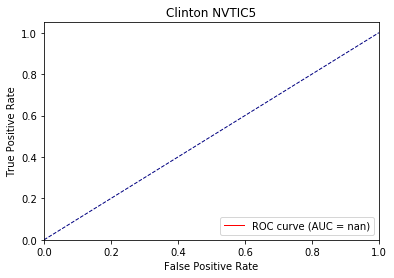

Directory already exists!
hc_nvtic5 2 ap tensor([1., 0.]) loss : 0.04700517654418945 0.10302098227545546 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic5 2 ap tensor([1., 0.]) loss : 0.04615044593811035 0.0975537657737732 tid : 30 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic5 2 ap tensor([1., 0.]) loss : 0.26313573122024536 0.09782130188412136 tid : 90 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic5 2 ap tensor([1., 0.]) loss : 0.044655442237854004 0.09139898750517103 tid : 150 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic5 2 ap tensor([1., 0.]) loss : 0.08287352323532104 0.09107831629311167 tid : 210 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic5 2 ap tensor([1., 0.]) loss : 0.0629507303237915 0.08894267126365944 tid : 270 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic5 2 ap tensor([1., 0.]) loss : 0.04099619388580322 0.08402745326360067 tid : 300 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic5 2 ap tensor([1., 0.]) loss : 0.14098727703094482 0.08236817239036023 ti

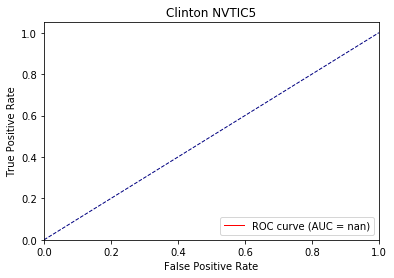

Directory already exists!
hc_nvtic4 0 ap tensor([0.9788, 0.0694]) loss : 0.5444118976593018 0.6674306966009594 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic4 0 ap tensor([0.8042, 0.2500]) loss : 1.4276902675628662 0.5838390469551087 tid : 30 tg tensor([[1]], device='cuda:0')
TEST hc_nvtic4 0 ap tensor([0.7589, 0.1422]) loss : 0.6073540449142456 0.5396526737345589 tid : 90 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic4 0 ap tensor([0.8416, 0.0993]) loss : 0.2716745138168335 0.4796764662972203 tid : 150 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic4 0 ap tensor([0.8764, 0.0633]) loss : 0.4731224477291107 0.45569392966061106 tid : 210 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic4 0 ap tensor([0.9049, 0.0491]) loss : 0.33811959624290466 0.4360231061776479 tid : 270 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic4 0 ap tensor([0.9142, 0.0458]) loss : 0.2782975435256958 0.426099893450737 tid : 300 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic4 0 ap tensor([0.9319, 0.0402

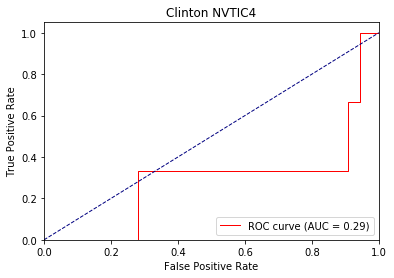

Directory already exists!
hc_nvtic4 1 ap tensor([1.0000, 0.5000]) loss : 0.16746008396148682 0.27622997748197886 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic4 1 ap tensor([0.6792, 0.2000]) loss : 2.207274913787842 0.59420747756958 tid : 30 tg tensor([[1]], device='cuda:0')
TEST hc_nvtic4 1 ap tensor([0.7301, 0.1448]) loss : 0.482060968875885 0.5041890078120761 tid : 90 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic4 1 ap tensor([0.8298, 0.1008]) loss : 0.11927437782287598 0.39647565064606843 tid : 150 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic4 1 ap tensor([0.8730, 0.0657]) loss : 0.21931332349777222 0.34019578157401664 tid : 210 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic4 1 ap tensor([0.9074, 0.0513]) loss : 0.15029215812683105 0.306253206398752 tid : 270 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic4 1 ap tensor([0.9157, 0.0479]) loss : 0.12754011154174805 0.29082231372594836 tid : 300 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic4 1 ap tensor([0.9317, 0.0

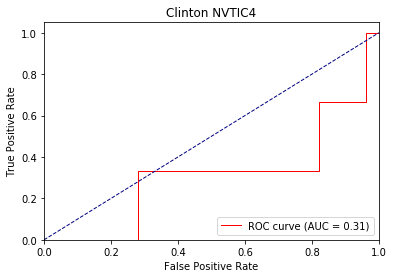

Directory already exists!
hc_nvtic4 2 ap tensor([1., 0.]) loss : 0.10143780708312988 0.17215426801106867 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic4 2 ap tensor([0.6792, 0.2000]) loss : 2.923220157623291 0.6669921159744263 tid : 30 tg tensor([[1]], device='cuda:0')
TEST hc_nvtic4 2 ap tensor([0.7495, 0.1667]) loss : 0.3807148039340973 0.5318617208136452 tid : 90 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic4 2 ap tensor([0.8526, 0.1152]) loss : 0.0624159574508667 0.38736685889738576 tid : 150 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic4 2 ap tensor([0.8897, 0.0729]) loss : 0.12558233737945557 0.3039206738879041 tid : 210 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic4 2 ap tensor([0.9204, 0.0569]) loss : 0.0689399242401123 0.2587330860120279 tid : 270 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic4 2 ap tensor([0.9274, 0.0531]) loss : 0.0608217716217041 0.24050521353880563 tid : 300 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic4 2 ap tensor([0.9411, 0.0464]) lo

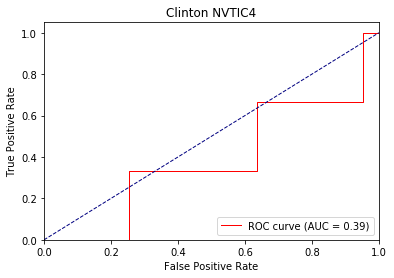

Directory already exists!
hc_interruptions 0 ap tensor([0.9986, 0.3026]) loss : 0.5181330442428589 0.6079925178479748 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_interruptions 0 ap tensor([1., 0.]) loss : 0.29879623651504517 0.3693775475025177 tid : 30 tg tensor([[0]], device='cuda:0')
TEST hc_interruptions 0 ap tensor([1., 0.]) loss : 0.685219407081604 0.4140255848566691 tid : 90 tg tensor([[0]], device='cuda:0')
TEST hc_interruptions 0 ap tensor([1., 0.]) loss : 0.18571805953979492 0.3892402682039473 tid : 150 tg tensor([[0]], device='cuda:0')
TEST hc_interruptions 0 ap tensor([1., 0.]) loss : 0.1940157413482666 0.3806710076041338 tid : 210 tg tensor([[0]], device='cuda:0')
TEST hc_interruptions 0 ap tensor([0.9737, 0.0238]) loss : 0.31960010528564453 0.3956362483678041 tid : 270 tg tensor([[0]], device='cuda:0')
TEST hc_interruptions 0 ap tensor([0.9790, 0.0227]) loss : 0.272943377494812 0.3855074976881345 tid : 300 tg tensor([[0]], device='cuda:0')
TEST hc_interruptions 0 a

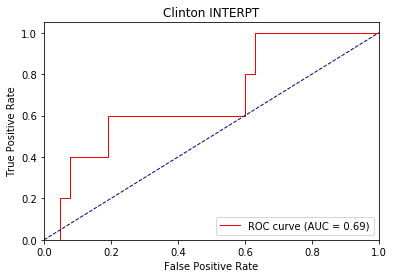

Directory already exists!
hc_interruptions 1 ap tensor([0.9931, 0.0833]) loss : 0.26171785593032837 0.30704764779223953 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_interruptions 1 ap tensor([1., 0.]) loss : 0.12878656387329102 0.18792061805725097 tid : 30 tg tensor([[0]], device='cuda:0')
TEST hc_interruptions 1 ap tensor([1., 0.]) loss : 0.5870565176010132 0.22795386777983773 tid : 90 tg tensor([[0]], device='cuda:0')
TEST hc_interruptions 1 ap tensor([1., 0.]) loss : 0.07425928115844727 0.2089766451606044 tid : 150 tg tensor([[0]], device='cuda:0')
TEST hc_interruptions 1 ap tensor([1., 0.]) loss : 0.08621543645858765 0.20649748241029134 tid : 210 tg tensor([[0]], device='cuda:0')
TEST hc_interruptions 1 ap tensor([0.9706, 0.0227]) loss : 0.16956692934036255 0.24399682327553077 tid : 270 tg tensor([[0]], device='cuda:0')
TEST hc_interruptions 1 ap tensor([0.9758, 0.0213]) loss : 0.1378324031829834 0.23309263984362286 tid : 300 tg tensor([[0]], device='cuda:0')
TEST hc_interru

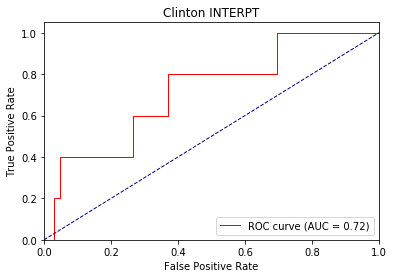

Directory already exists!
hc_interruptions 2 ap tensor([0.9983, 0.1908]) loss : 0.05758309364318848 0.1377240210513159 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_interruptions 2 ap tensor([1., 0.]) loss : 0.06225109100341797 0.10398033857345582 tid : 30 tg tensor([[0]], device='cuda:0')
TEST hc_interruptions 2 ap tensor([1., 0.]) loss : 0.5093218088150024 0.13575251566039193 tid : 90 tg tensor([[0]], device='cuda:0')
TEST hc_interruptions 2 ap tensor([1., 0.]) loss : 0.035726070404052734 0.12229512355945728 tid : 150 tg tensor([[0]], device='cuda:0')
TEST hc_interruptions 2 ap tensor([1., 0.]) loss : 0.04897928237915039 0.12231706337230962 tid : 210 tg tensor([[0]], device='cuda:0')
TEST hc_interruptions 2 ap tensor([0.9706, 0.0227]) loss : 0.09480166435241699 0.1762988230696431 tid : 270 tg tensor([[0]], device='cuda:0')
TEST hc_interruptions 2 ap tensor([0.9758, 0.0213]) loss : 0.07306325435638428 0.16558518161376318 tid : 300 tg tensor([[0]], device='cuda:0')
TEST hc_interr

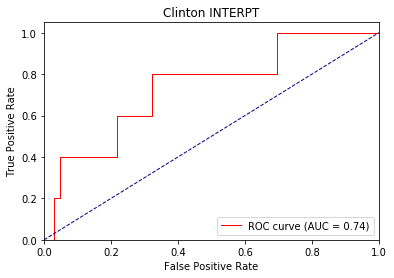

Directory already exists!
hc_lookat2 0 ap tensor([0.4972, 0.4443]) loss : 0.8217928409576416 0.7456143021583557 tid : 200 tg tensor([[0]], device='cuda:0')
hc_lookat2 0 ap tensor([0.7883, 0.5795]) loss : 0.695740818977356 0.6447531906887889 tid : 400 tg tensor([[0]], device='cuda:0')
TEST hc_lookat2 0 ap tensor([0.9505, 0.8677]) loss : 1.2706360816955566 0.4390119682801397 tid : 150 tg tensor([[0]], device='cuda:0')
TEST hc_lookat2 0 ap tensor([0.9580, 0.8998]) loss : 0.29041624069213867 0.4499115995489634 tid : 210 tg tensor([[1]], device='cuda:0')
TEST hc_lookat2 0 ap tensor([0.9585, 0.9113]) loss : 0.7854938507080078 0.4654516301890637 tid : 480 tg tensor([[0]], device='cuda:0')
TEST hc_lookat2 0 ap tensor([0.9577, 0.9136]) loss : 0.6367908120155334 0.468803528123177 tid : 510 tg tensor([[0]], device='cuda:0')
TEST hc_lookat2 0 ap tensor([0.9565, 0.9114]) loss : 0.6943862438201904 0.473978033032986 tid : 540 tg tensor([[0]], device='cuda:0')


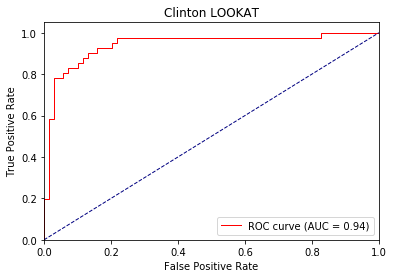

Directory already exists!
hc_lookat2 1 ap tensor([0.9487, 0.9652]) loss : 0.6075267791748047 0.42718588720972295 tid : 200 tg tensor([[0]], device='cuda:0')
hc_lookat2 1 ap tensor([0.9337, 0.9555]) loss : 0.3446109890937805 0.4081003282751356 tid : 400 tg tensor([[0]], device='cuda:0')
TEST hc_lookat2 1 ap tensor([0.9208, 0.8942]) loss : 1.546210765838623 0.34480138593598414 tid : 150 tg tensor([[0]], device='cuda:0')
TEST hc_lookat2 1 ap tensor([0.9398, 0.9215]) loss : 0.16240167617797852 0.346552526148466 tid : 210 tg tensor([[1]], device='cuda:0')
TEST hc_lookat2 1 ap tensor([0.9514, 0.9402]) loss : 0.7634122371673584 0.37097219203380827 tid : 480 tg tensor([[0]], device='cuda:0')
TEST hc_lookat2 1 ap tensor([0.9517, 0.9414]) loss : 0.49749812483787537 0.37422693320191824 tid : 510 tg tensor([[0]], device='cuda:0')
TEST hc_lookat2 1 ap tensor([0.9512, 0.9385]) loss : 0.7668138742446899 0.38021648613684766 tid : 540 tg tensor([[0]], device='cuda:0')


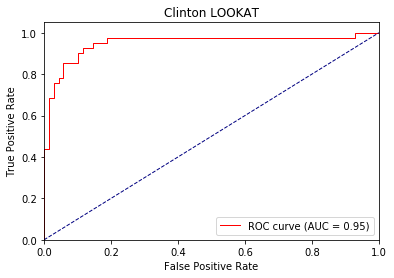

Directory already exists!
hc_lookat2 2 ap tensor([0.9554, 0.9310]) loss : 0.414705753326416 0.3765710961969593 tid : 200 tg tensor([[0]], device='cuda:0')
hc_lookat2 2 ap tensor([0.9521, 0.9553]) loss : 0.24122369289398193 0.3551713124565456 tid : 400 tg tensor([[0]], device='cuda:0')
TEST hc_lookat2 2 ap tensor([0.9099, 0.9059]) loss : 1.7854642868041992 0.2947817154620823 tid : 150 tg tensor([[0]], device='cuda:0')
TEST hc_lookat2 2 ap tensor([0.9338, 0.9276]) loss : 0.10689747333526611 0.28982603779205907 tid : 210 tg tensor([[1]], device='cuda:0')
TEST hc_lookat2 2 ap tensor([0.9451, 0.9393]) loss : 0.7823654413223267 0.32008311247571986 tid : 480 tg tensor([[0]], device='cuda:0')
TEST hc_lookat2 2 ap tensor([0.9461, 0.9420]) loss : 0.4118640422821045 0.3229538414340753 tid : 510 tg tensor([[0]], device='cuda:0')
TEST hc_lookat2 2 ap tensor([0.9456, 0.9389]) loss : 0.8558908104896545 0.32924366298071833 tid : 540 tg tensor([[0]], device='cuda:0')


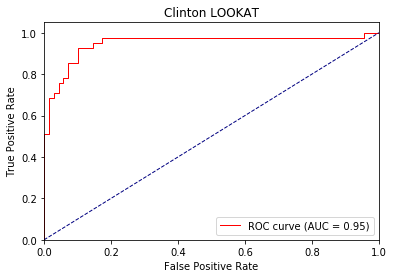

Directory already exists!
hc_brush1 0 ap tensor([0.9164, 0.1543]) loss : 0.3972851037979126 0.5633412183617517 tid : 400 tg tensor([[0]], device='cuda:0')
hc_brush1 0 ap tensor([0.9104, 0.1543]) loss : 0.33782443404197693 0.5557942469112621 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_brush1 0 ap tensor([0.9294, 0.1092]) loss : 0.4080210328102112 0.4312219431525783 tid : 150 tg tensor([[0]], device='cuda:0')
TEST hc_brush1 0 ap tensor([0.9400, 0.0938]) loss : 1.2511887550354004 0.42684235996924913 tid : 210 tg tensor([[1]], device='cuda:0')
TEST hc_brush1 0 ap tensor([0.9284, 0.3221]) loss : 0.36582040786743164 0.477776382197725 tid : 480 tg tensor([[0]], device='cuda:0')
TEST hc_brush1 0 ap tensor([0.9191, 0.3016]) loss : 0.3483177125453949 0.4835235419181677 tid : 510 tg tensor([[0]], device='cuda:0')
TEST hc_brush1 0 ap tensor([0.9195, 0.3162]) loss : 0.4582071006298065 0.48432211482196774 tid : 540 tg tensor([[0]], device='cuda:0')


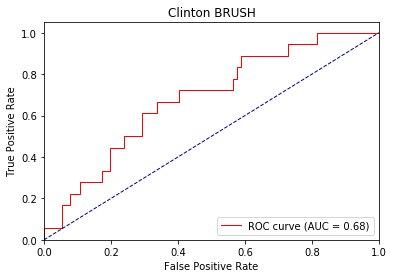

Directory already exists!
hc_brush1 1 ap tensor([0.9454, 0.1504]) loss : 0.2612493634223938 0.4399668164551258 tid : 200 tg tensor([[0]], device='cuda:0')
hc_brush1 1 ap tensor([0.9381, 0.1921]) loss : 0.1909552812576294 0.4165849822139976 tid : 400 tg tensor([[0]], device='cuda:0')
TEST hc_brush1 1 ap tensor([0.9386, 0.1890]) loss : 0.27715003490448 0.34496181419021205 tid : 150 tg tensor([[0]], device='cuda:0')
TEST hc_brush1 1 ap tensor([0.9441, 0.1438]) loss : 1.555372714996338 0.34097468852996826 tid : 210 tg tensor([[1]], device='cuda:0')
TEST hc_brush1 1 ap tensor([0.9290, 0.3679]) loss : 0.28643032908439636 0.42377957669978444 tid : 480 tg tensor([[0]], device='cuda:0')
TEST hc_brush1 1 ap tensor([0.9242, 0.3490]) loss : 0.24040627479553223 0.4314439150576408 tid : 510 tg tensor([[0]], device='cuda:0')
TEST hc_brush1 1 ap tensor([0.9241, 0.3516]) loss : 0.3831908404827118 0.43218293102509386 tid : 540 tg tensor([[0]], device='cuda:0')


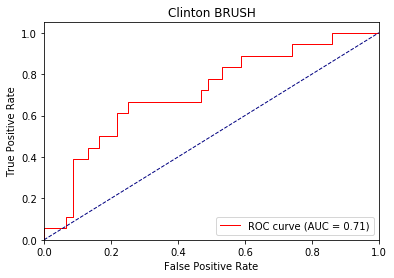

Directory already exists!
hc_brush1 2 ap tensor([0.9604, 0.2755]) loss : 0.1410236358642578 0.3833775288775065 tid : 400 tg tensor([[0]], device='cuda:0')
hc_brush1 2 ap tensor([0.9467, 0.2755]) loss : 0.15408259630203247 0.38806287000934 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_brush1 2 ap tensor([0.9407, 0.1970]) loss : 0.21484309434890747 0.3071960948015514 tid : 150 tg tensor([[0]], device='cuda:0')
TEST hc_brush1 2 ap tensor([0.9459, 0.1485]) loss : 1.760499119758606 0.3028554916381836 tid : 210 tg tensor([[1]], device='cuda:0')
TEST hc_brush1 2 ap tensor([0.9286, 0.3960]) loss : 0.25524985790252686 0.4052208703249059 tid : 480 tg tensor([[0]], device='cuda:0')
TEST hc_brush1 2 ap tensor([0.9256, 0.3722]) loss : 0.18384003639221191 0.4133661733223842 tid : 510 tg tensor([[0]], device='cuda:0')
TEST hc_brush1 2 ap tensor([0.9263, 0.3736]) loss : 0.34780487418174744 0.41403783379344766 tid : 540 tg tensor([[0]], device='cuda:0')


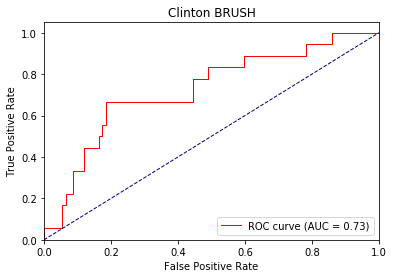

Directory already exists!
hc_nvdis1 0 ap tensor([0.8673, 0.1923]) loss : 0.5972859263420105 0.6030204687472228 tid : 400 tg tensor([[0]], device='cuda:0')
hc_nvdis1 0 ap tensor([0.9457, 0.2479]) loss : 0.354618638753891 0.5239918357957669 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_nvdis1 0 ap tensor([0.8615, 0.3382]) loss : 0.3000863194465637 0.5738072403167424 tid : 150 tg tensor([[0]], device='cuda:0')
TEST hc_nvdis1 0 ap tensor([0.8632, 0.2604]) loss : 0.2800649404525757 0.5363946201709601 tid : 210 tg tensor([[0]], device='cuda:0')
TEST hc_nvdis1 0 ap tensor([0.8634, 0.2820]) loss : 0.31964385509490967 0.4984357753332625 tid : 480 tg tensor([[0]], device='cuda:0')
TEST hc_nvdis1 0 ap tensor([0.8772, 0.2779]) loss : 0.39091187715530396 0.489296078395385 tid : 510 tg tensor([[0]], device='cuda:0')
TEST hc_nvdis1 0 ap tensor([0.8809, 0.2697]) loss : 0.38905879855155945 0.48260835195900104 tid : 540 tg tensor([[0]], device='cuda:0')


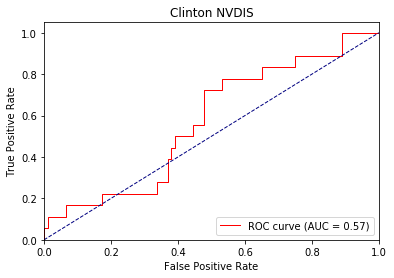

Directory already exists!
hc_nvdis1 1 ap tensor([0.9257, 0.4327]) loss : 0.33160388469696045 0.3898034444818758 tid : 400 tg tensor([[0]], device='cuda:0')
hc_nvdis1 1 ap tensor([0.9458, 0.4134]) loss : 0.21893030405044556 0.3605252135012831 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_nvdis1 1 ap tensor([0.8663, 0.3713]) loss : 0.17211008071899414 0.5840923794006047 tid : 150 tg tensor([[0]], device='cuda:0')
TEST hc_nvdis1 1 ap tensor([0.8763, 0.2808]) loss : 0.16429638862609863 0.5152666219151937 tid : 210 tg tensor([[0]], device='cuda:0')
TEST hc_nvdis1 1 ap tensor([0.8822, 0.2907]) loss : 0.19555813074111938 0.46138836062969046 tid : 480 tg tensor([[0]], device='cuda:0')
TEST hc_nvdis1 1 ap tensor([0.8959, 0.2888]) loss : 0.24190562963485718 0.44790849576775843 tid : 510 tg tensor([[0]], device='cuda:0')
TEST hc_nvdis1 1 ap tensor([0.8984, 0.2782]) loss : 0.282009094953537 0.43741096105050603 tid : 540 tg tensor([[0]], device='cuda:0')


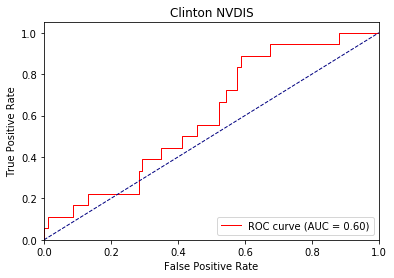

Directory already exists!
hc_nvdis1 2 ap tensor([0.9688, 0.5757]) loss : 0.22188198566436768 0.32776126020575225 tid : 400 tg tensor([[0]], device='cuda:0')
hc_nvdis1 2 ap tensor([0.9704, 0.5083]) loss : 0.12391549348831177 0.27510558036122007 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_nvdis1 2 ap tensor([0.8327, 0.3553]) loss : 0.12011218070983887 0.6354170065177115 tid : 150 tg tensor([[0]], device='cuda:0')
TEST hc_nvdis1 2 ap tensor([0.8642, 0.2929]) loss : 0.11743581295013428 0.540443303493353 tid : 210 tg tensor([[0]], device='cuda:0')
TEST hc_nvdis1 2 ap tensor([0.8791, 0.3026]) loss : 0.1379680633544922 0.4688227696621672 tid : 480 tg tensor([[0]], device='cuda:0')
TEST hc_nvdis1 2 ap tensor([0.8961, 0.3019]) loss : 0.170224130153656 0.4521812005684926 tid : 510 tg tensor([[0]], device='cuda:0')
TEST hc_nvdis1 2 ap tensor([0.8989, 0.2872]) loss : 0.22541511058807373 0.43860297520226293 tid : 540 tg tensor([[0]], device='cuda:0')


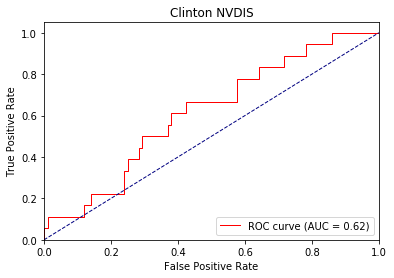

Directory already exists!
hc_look 0 ap tensor([0.6548, 0.8456]) loss : 0.3787204623222351 0.6138567575253546 tid : 400 tg tensor([[1]], device='cuda:0')
hc_look 0 ap tensor([0.6819, 0.9037]) loss : 0.31216010451316833 0.5745031565919028 tid : 200 tg tensor([[1]], device='cuda:0')
TEST hc_look 0 ap tensor([0.5311, 0.9837]) loss : 0.6437678337097168 0.42833660229256276 tid : 150 tg tensor([[1]], device='cuda:0')
TEST hc_look 0 ap tensor([0.6258, 0.9864]) loss : 0.6809380650520325 0.4223135153834636 tid : 210 tg tensor([[0]], device='cuda:0')
TEST hc_look 0 ap tensor([0.5576, 0.9753]) loss : 1.0772426128387451 0.4607051782151486 tid : 480 tg tensor([[0]], device='cuda:0')
TEST hc_look 0 ap tensor([0.5792, 0.9756]) loss : 0.2800615131855011 0.4626369974934138 tid : 510 tg tensor([[1]], device='cuda:0')
TEST hc_look 0 ap tensor([0.5909, 0.9764]) loss : 0.5328937768936157 0.4626589936947604 tid : 540 tg tensor([[1]], device='cuda:0')


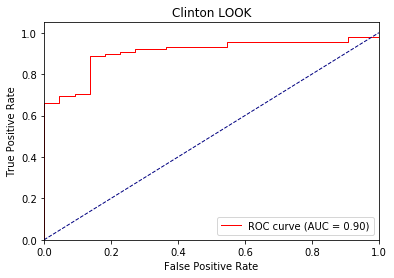

Directory already exists!
hc_look 1 ap tensor([0.7655, 0.9461]) loss : 0.27295660972595215 0.4871399842127405 tid : 200 tg tensor([[1]], device='cuda:0')
hc_look 1 ap tensor([0.7562, 0.9526]) loss : 0.21224761009216309 0.4795602703188348 tid : 400 tg tensor([[1]], device='cuda:0')
TEST hc_look 1 ap tensor([0.5877, 0.9876]) loss : 0.7365490794181824 0.3363615776363172 tid : 150 tg tensor([[1]], device='cuda:0')
TEST hc_look 1 ap tensor([0.6709, 0.9897]) loss : 0.5094910860061646 0.32066357594269973 tid : 210 tg tensor([[0]], device='cuda:0')
TEST hc_look 1 ap tensor([0.6054, 0.9789]) loss : 1.2062312364578247 0.37458785892801083 tid : 480 tg tensor([[0]], device='cuda:0')
TEST hc_look 1 ap tensor([0.6235, 0.9791]) loss : 0.18860787153244019 0.3763160378887103 tid : 510 tg tensor([[1]], device='cuda:0')
TEST hc_look 1 ap tensor([0.6346, 0.9796]) loss : 0.4975736141204834 0.37616821549354346 tid : 540 tg tensor([[1]], device='cuda:0')


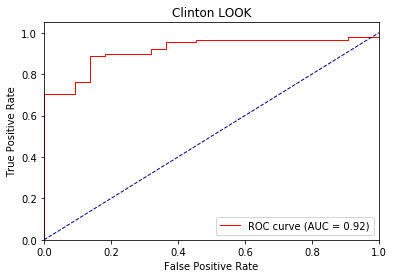

Directory already exists!
hc_look 2 ap tensor([0.7816, 0.9537]) loss : 0.16530847549438477 0.4081654998171688 tid : 200 tg tensor([[1]], device='cuda:0')
hc_look 2 ap tensor([0.8043, 0.9636]) loss : 0.0842587947845459 0.38408722355004143 tid : 400 tg tensor([[1]], device='cuda:0')
TEST hc_look 2 ap tensor([0.5877, 0.9876]) loss : 0.7805947661399841 0.2891331589535663 tid : 150 tg tensor([[1]], device='cuda:0')
TEST hc_look 2 ap tensor([0.7264, 0.9901]) loss : 0.41102758049964905 0.2674738346384122 tid : 210 tg tensor([[0]], device='cuda:0')
TEST hc_look 2 ap tensor([0.6501, 0.9808]) loss : 1.3021856546401978 0.327610747928315 tid : 480 tg tensor([[0]], device='cuda:0')
TEST hc_look 2 ap tensor([0.6615, 0.9806]) loss : 0.1349940299987793 0.329280757273619 tid : 510 tg tensor([[1]], device='cuda:0')
TEST hc_look 2 ap tensor([0.6705, 0.9811]) loss : 0.4603443145751953 0.3287113549512461 tid : 540 tg tensor([[1]], device='cuda:0')


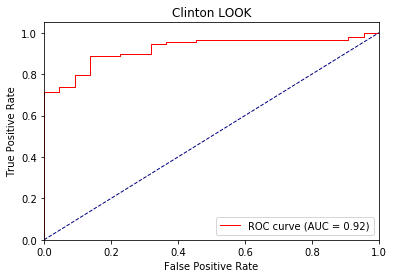

Directory already exists!
hc_eyebrow 0 ap tensor([0.9149, 0.6835]) loss : 0.8232175707817078 0.5833626193477508 tid : 400 tg tensor([[0]], device='cuda:0')
hc_eyebrow 0 ap tensor([0.9195, 0.6945]) loss : 0.762952446937561 0.5780143044680432 tid : 200 tg tensor([[1]], device='cuda:0')
TEST hc_eyebrow 0 ap tensor([0.8965, 0.4656]) loss : 0.34556135535240173 0.5936637183553294 tid : 150 tg tensor([[0]], device='cuda:0')
TEST hc_eyebrow 0 ap tensor([0.8800, 0.4327]) loss : 0.31092172861099243 0.5967214818184192 tid : 210 tg tensor([[0]], device='cuda:0')
TEST hc_eyebrow 0 ap tensor([0.9285, 0.4961]) loss : 0.4338349401950836 0.5554524891554041 tid : 480 tg tensor([[0]], device='cuda:0')
TEST hc_eyebrow 0 ap tensor([0.9348, 0.4690]) loss : 0.693854033946991 0.5554944795484726 tid : 510 tg tensor([[0]], device='cuda:0')
TEST hc_eyebrow 0 ap tensor([0.9373, 0.4528]) loss : 0.35963115096092224 0.554909889030894 tid : 540 tg tensor([[0]], device='cuda:0')


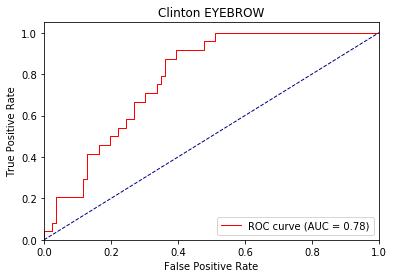

Directory already exists!
hc_eyebrow 1 ap tensor([0.9491, 0.7602]) loss : 0.8623390197753906 0.4764358670527232 tid : 400 tg tensor([[0]], device='cuda:0')
hc_eyebrow 1 ap tensor([0.9531, 0.7488]) loss : 0.8132586479187012 0.4668395546868967 tid : 200 tg tensor([[1]], device='cuda:0')
TEST hc_eyebrow 1 ap tensor([0.9077, 0.5221]) loss : 0.22438102960586548 0.5739269680098483 tid : 150 tg tensor([[0]], device='cuda:0')
TEST hc_eyebrow 1 ap tensor([0.8916, 0.4642]) loss : 0.17073625326156616 0.5750303589380704 tid : 210 tg tensor([[0]], device='cuda:0')
TEST hc_eyebrow 1 ap tensor([0.9343, 0.4763]) loss : 0.3522219657897949 0.5205264655833549 tid : 480 tg tensor([[0]], device='cuda:0')
TEST hc_eyebrow 1 ap tensor([0.9411, 0.4477]) loss : 0.6400957703590393 0.5202072113752365 tid : 510 tg tensor([[0]], device='cuda:0')
TEST hc_eyebrow 1 ap tensor([0.9427, 0.4219]) loss : 0.2826306223869324 0.5201124259091299 tid : 540 tg tensor([[0]], device='cuda:0')


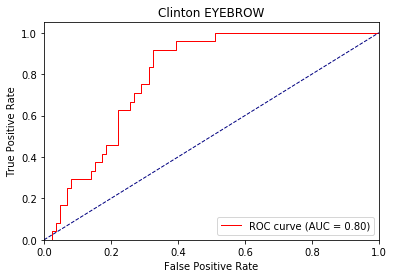

Directory already exists!
hc_eyebrow 2 ap tensor([0.9434, 0.8056]) loss : 0.9268267154693604 0.43383721232998607 tid : 400 tg tensor([[0]], device='cuda:0')
hc_eyebrow 2 ap tensor([0.9459, 0.7954]) loss : 0.8058485984802246 0.43201928490942176 tid : 200 tg tensor([[1]], device='cuda:0')
TEST hc_eyebrow 2 ap tensor([0.9077, 0.5125]) loss : 0.16292095184326172 0.569910508237387 tid : 150 tg tensor([[0]], device='cuda:0')
TEST hc_eyebrow 2 ap tensor([0.8933, 0.4591]) loss : 0.11093640327453613 0.57189486347712 tid : 210 tg tensor([[0]], device='cuda:0')
TEST hc_eyebrow 2 ap tensor([0.9352, 0.4749]) loss : 0.29842597246170044 0.5078068366076084 tid : 480 tg tensor([[0]], device='cuda:0')
TEST hc_eyebrow 2 ap tensor([0.9422, 0.4450]) loss : 0.6027334332466125 0.5077358303734889 tid : 510 tg tensor([[0]], device='cuda:0')
TEST hc_eyebrow 2 ap tensor([0.9435, 0.4193]) loss : 0.23270952701568604 0.5083447574475489 tid : 540 tg tensor([[0]], device='cuda:0')


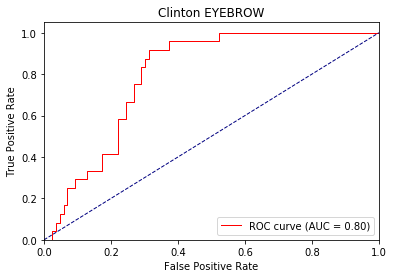

Directory already exists!
hc_atface 0 ap tensor([0.9339, 0.1293]) loss : 0.7982873916625977 0.6406627102774016 tid : 200 tg tensor([[1]], device='cuda:0')
hc_atface 0 ap tensor([0.9234, 0.1333]) loss : 0.5259812474250793 0.6043707366739766 tid : 400 tg tensor([[0]], device='cuda:0')
TEST hc_atface 0 ap tensor([0.9018, 0.3390]) loss : 0.3527454733848572 0.5380579060629794 tid : 150 tg tensor([[0]], device='cuda:0')
TEST hc_atface 0 ap tensor([0.9150, 0.3746]) loss : 0.3251136541366577 0.5349440368322226 tid : 210 tg tensor([[0]], device='cuda:0')
TEST hc_atface 0 ap tensor([0.9463, 0.4194]) loss : 0.3848866820335388 0.5005565158864285 tid : 480 tg tensor([[0]], device='cuda:0')
TEST hc_atface 0 ap tensor([0.9325, 0.3925]) loss : 0.4495835304260254 0.5087423043755385 tid : 510 tg tensor([[0]], device='cuda:0')
TEST hc_atface 0 ap tensor([0.9360, 0.4009]) loss : 0.30827730894088745 0.5074678468048026 tid : 540 tg tensor([[0]], device='cuda:0')


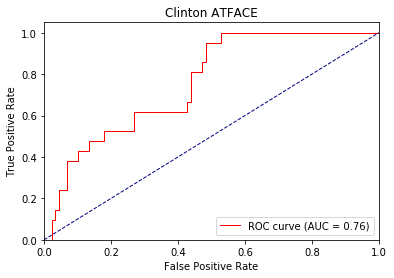

Directory already exists!
hc_atface 1 ap tensor([0.9391, 0.2409]) loss : 0.9701106548309326 0.4708411577271252 tid : 200 tg tensor([[1]], device='cuda:0')
hc_atface 1 ap tensor([0.9625, 0.3087]) loss : 0.4296098053455353 0.4351235741780976 tid : 400 tg tensor([[0]], device='cuda:0')
TEST hc_atface 1 ap tensor([0.9123, 0.3577]) loss : 0.18211692571640015 0.4811158603743503 tid : 150 tg tensor([[0]], device='cuda:0')
TEST hc_atface 1 ap tensor([0.9247, 0.3914]) loss : 0.15741515159606934 0.47483290101473147 tid : 210 tg tensor([[0]], device='cuda:0')
TEST hc_atface 1 ap tensor([0.9503, 0.4379]) loss : 0.24152588844299316 0.4297809302806854 tid : 480 tg tensor([[0]], device='cuda:0')
TEST hc_atface 1 ap tensor([0.9362, 0.4100]) loss : 0.3094860315322876 0.4437591169889157 tid : 510 tg tensor([[0]], device='cuda:0')
TEST hc_atface 1 ap tensor([0.9385, 0.4149]) loss : 0.21126621961593628 0.44326873328707633 tid : 540 tg tensor([[0]], device='cuda:0')


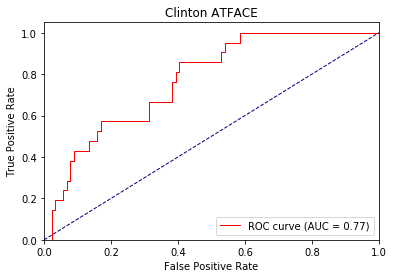

Directory already exists!
hc_atface 2 ap tensor([0.9636, 0.3293]) loss : 1.2854526042938232 0.38042611006188065 tid : 200 tg tensor([[1]], device='cuda:0')
hc_atface 2 ap tensor([0.9673, 0.3275]) loss : 0.3303207755088806 0.36233726271431016 tid : 400 tg tensor([[0]], device='cuda:0')
TEST hc_atface 2 ap tensor([0.9220, 0.4591]) loss : 0.11269068717956543 0.4611020676399532 tid : 150 tg tensor([[0]], device='cuda:0')
TEST hc_atface 2 ap tensor([0.9349, 0.4653]) loss : 0.09790301322937012 0.4534821172173207 tid : 210 tg tensor([[0]], device='cuda:0')
TEST hc_atface 2 ap tensor([0.9548, 0.4728]) loss : 0.17268431186676025 0.40273672944687783 tid : 480 tg tensor([[0]], device='cuda:0')
TEST hc_atface 2 ap tensor([0.9434, 0.4460]) loss : 0.2421073317527771 0.4205875127361371 tid : 510 tg tensor([[0]], device='cuda:0')
TEST hc_atface 2 ap tensor([0.9452, 0.4499]) loss : 0.16031962633132935 0.4203451223876498 tid : 540 tg tensor([[0]], device='cuda:0')


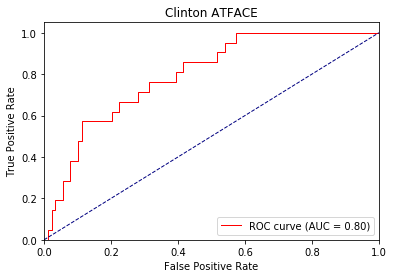

Directory already exists!
hc_feface 0 ap tensor([1., 0.]) loss : 0.41135692596435547 0.5687777762827666 tid : 200 tg tensor([[0]], device='cuda:0')
hc_feface 0 ap tensor([1., 0.]) loss : 0.2527664303779602 0.45249706310661214 tid : 400 tg tensor([[0]], device='cuda:0')
TEST hc_feface 0 ap tensor([1., 0.]) loss : 0.1925654411315918 0.21921047097758242 tid : 150 tg tensor([[0]], device='cuda:0')
TEST hc_feface 0 ap tensor([1., 0.]) loss : 0.3258402347564697 0.21883970040541428 tid : 210 tg tensor([[0]], device='cuda:0')
TEST hc_feface 0 ap tensor([1., 0.]) loss : 0.19825470447540283 0.21951341724142115 tid : 480 tg tensor([[0]], device='cuda:0')
TEST hc_feface 0 ap tensor([1., 0.]) loss : 0.1897110939025879 0.21978647233201906 tid : 510 tg tensor([[0]], device='cuda:0')
TEST hc_feface 0 ap tensor([1., 0.]) loss : 0.4449302852153778 0.22279889649207438 tid : 540 tg tensor([[0]], device='cuda:0')


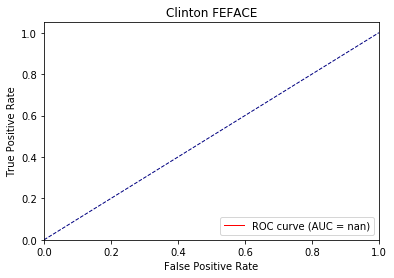

Directory already exists!
hc_feface 1 ap tensor([1., 0.]) loss : 0.13628286123275757 0.20201854248132026 tid : 400 tg tensor([[0]], device='cuda:0')
hc_feface 1 ap tensor([1., 0.]) loss : 0.11989760398864746 0.19643597578515812 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_feface 1 ap tensor([1., 0.]) loss : 0.07661128044128418 0.1047078002440302 tid : 150 tg tensor([[0]], device='cuda:0')
TEST hc_feface 1 ap tensor([1., 0.]) loss : 0.15481090545654297 0.10267589012017617 tid : 210 tg tensor([[0]], device='cuda:0')
TEST hc_feface 1 ap tensor([1., 0.]) loss : 0.07069647312164307 0.09990546899907132 tid : 480 tg tensor([[0]], device='cuda:0')
TEST hc_feface 1 ap tensor([1., 0.]) loss : 0.068603515625 0.09954873501108243 tid : 510 tg tensor([[0]], device='cuda:0')
TEST hc_feface 1 ap tensor([1., 0.]) loss : 0.23189514875411987 0.1014316336277428 tid : 540 tg tensor([[0]], device='cuda:0')


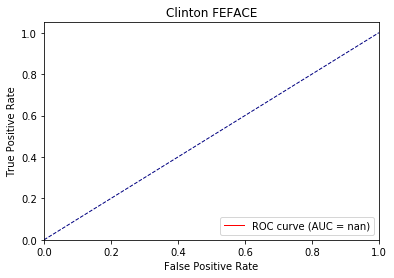

Directory already exists!
hc_feface 2 ap tensor([1., 0.]) loss : 0.044767022132873535 0.08878524618587275 tid : 200 tg tensor([[0]], device='cuda:0')
hc_feface 2 ap tensor([1., 0.]) loss : 0.036949872970581055 0.07870566248893737 tid : 400 tg tensor([[0]], device='cuda:0')
TEST hc_feface 2 ap tensor([1., 0.]) loss : 0.03270316123962402 0.05516051932385093 tid : 150 tg tensor([[0]], device='cuda:0')
TEST hc_feface 2 ap tensor([1., 0.]) loss : 0.07328367233276367 0.05279274399463947 tid : 210 tg tensor([[0]], device='cuda:0')
TEST hc_feface 2 ap tensor([1., 0.]) loss : 0.029567837715148926 0.05039163758146002 tid : 480 tg tensor([[0]], device='cuda:0')
TEST hc_feface 2 ap tensor([1., 0.]) loss : 0.026142477989196777 0.04988453795130436 tid : 510 tg tensor([[0]], device='cuda:0')
TEST hc_feface 2 ap tensor([1., 0.]) loss : 0.1147996187210083 0.0508422225440314 tid : 540 tg tensor([[0]], device='cuda:0')


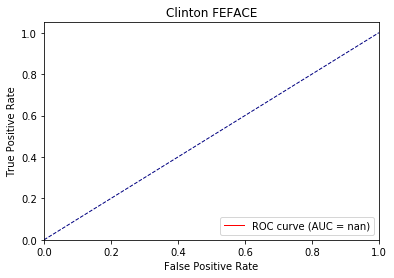

Directory already exists!
hc_hrface 0 ap tensor([0.6198, 0.5815]) loss : 0.69344162940979 0.6824796095024794 tid : 200 tg tensor([[0]], device='cuda:0')
hc_hrface 0 ap tensor([0.6503, 0.6948]) loss : 0.6599990129470825 0.6690765677521071 tid : 400 tg tensor([[0]], device='cuda:0')
TEST hc_hrface 0 ap tensor([0.8737, 0.3596]) loss : 0.7564561367034912 0.6335870568689547 tid : 150 tg tensor([[1]], device='cuda:0')
TEST hc_hrface 0 ap tensor([0.8804, 0.2714]) loss : 0.6194933652877808 0.6329694860256635 tid : 210 tg tensor([[0]], device='cuda:0')
TEST hc_hrface 0 ap tensor([0.8094, 0.2782]) loss : 0.8407381772994995 0.6568270103728517 tid : 480 tg tensor([[0]], device='cuda:0')
TEST hc_hrface 0 ap tensor([0.8094, 0.2650]) loss : 0.7028129696846008 0.6598180575439563 tid : 510 tg tensor([[0]], device='cuda:0')
TEST hc_hrface 0 ap tensor([0.8152, 0.2563]) loss : 0.7058104276657104 0.6578686425992109 tid : 540 tg tensor([[0]], device='cuda:0')


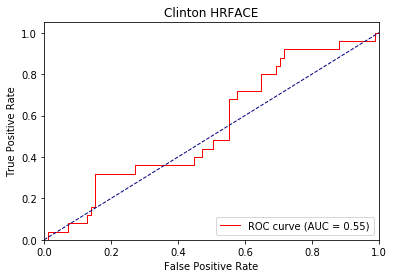

Directory already exists!
hc_hrface 1 ap tensor([0.8519, 0.7480]) loss : 0.6002472639083862 0.6208570009591629 tid : 400 tg tensor([[0]], device='cuda:0')
hc_hrface 1 ap tensor([0.7600, 0.8167]) loss : 0.6128515005111694 0.6219943596981465 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_hrface 1 ap tensor([0.8756, 0.3700]) loss : 0.7243313193321228 0.622110095463301 tid : 150 tg tensor([[1]], device='cuda:0')
TEST hc_hrface 1 ap tensor([0.8848, 0.2861]) loss : 0.6627258658409119 0.6216012084713349 tid : 210 tg tensor([[0]], device='cuda:0')
TEST hc_hrface 1 ap tensor([0.8198, 0.3188]) loss : 0.9116415977478027 0.650906966087666 tid : 480 tg tensor([[0]], device='cuda:0')
TEST hc_hrface 1 ap tensor([0.8206, 0.3068]) loss : 0.7071950435638428 0.652672944447169 tid : 510 tg tensor([[0]], device='cuda:0')
TEST hc_hrface 1 ap tensor([0.8264, 0.2982]) loss : 0.7643287181854248 0.6508833410543039 tid : 540 tg tensor([[0]], device='cuda:0')


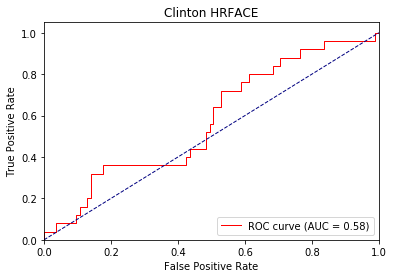

Directory already exists!
hc_hrface 2 ap tensor([0.7733, 0.8430]) loss : 0.6187481880187988 0.5947662996549676 tid : 200 tg tensor([[0]], device='cuda:0')
hc_hrface 2 ap tensor([0.7758, 0.8418]) loss : 0.5187057256698608 0.5943063114730405 tid : 400 tg tensor([[0]], device='cuda:0')
TEST hc_hrface 2 ap tensor([0.8681, 0.4128]) loss : 0.7189242243766785 0.6063428889763983 tid : 150 tg tensor([[1]], device='cuda:0')
TEST hc_hrface 2 ap tensor([0.8840, 0.3106]) loss : 0.663581371307373 0.6056783503064742 tid : 210 tg tensor([[0]], device='cuda:0')
TEST hc_hrface 2 ap tensor([0.8240, 0.3651]) loss : 0.9875555634498596 0.6384652738875531 tid : 480 tg tensor([[0]], device='cuda:0')
TEST hc_hrface 2 ap tensor([0.8264, 0.3518]) loss : 0.7074400186538696 0.638106855062338 tid : 510 tg tensor([[0]], device='cuda:0')
TEST hc_hrface 2 ap tensor([0.8327, 0.3429]) loss : 0.8185561895370483 0.6364073094424851 tid : 540 tg tensor([[0]], device='cuda:0')


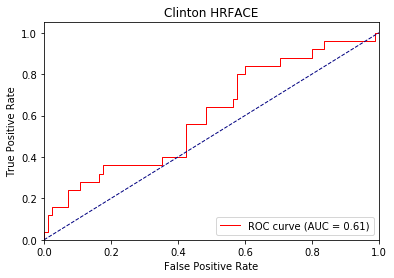

Directory already exists!
hc_saface 0 ap tensor([0.9841, 0.0141]) loss : 0.346052348613739 0.6413114824981401 tid : 400 tg tensor([[0]], device='cuda:0')
hc_saface 0 ap tensor([0.9916, 0.0138]) loss : 0.3164769411087036 0.5944407520925298 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_saface 0 ap tensor([1., 0.]) loss : 0.2943307161331177 0.39425689138864217 tid : 150 tg tensor([[0]], device='cuda:0')
TEST hc_saface 0 ap tensor([1., 0.]) loss : 0.39930546283721924 0.38911521434783936 tid : 210 tg tensor([[0]], device='cuda:0')
TEST hc_saface 0 ap tensor([1., 0.]) loss : 0.4383050203323364 0.3894309084466163 tid : 480 tg tensor([[0]], device='cuda:0')
TEST hc_saface 0 ap tensor([1., 0.]) loss : 0.27509605884552 0.3878800281538413 tid : 510 tg tensor([[0]], device='cuda:0')
TEST hc_saface 0 ap tensor([1., 0.]) loss : 0.48534148931503296 0.3892568385382311 tid : 540 tg tensor([[0]], device='cuda:0')


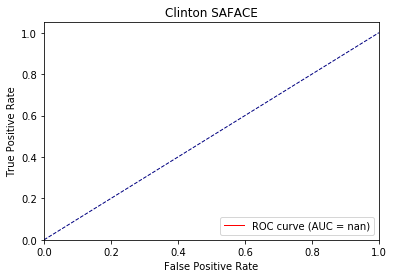

Directory already exists!
hc_saface 1 ap tensor([1., 0.]) loss : 0.2594756484031677 0.36955200880765915 tid : 200 tg tensor([[0]], device='cuda:0')
hc_saface 1 ap tensor([0.9912, 0.0160]) loss : 0.18429094552993774 0.30550031648593 tid : 400 tg tensor([[0]], device='cuda:0')
TEST hc_saface 1 ap tensor([1., 0.]) loss : 0.11834460496902466 0.21191972886261187 tid : 150 tg tensor([[0]], device='cuda:0')
TEST hc_saface 1 ap tensor([1., 0.]) loss : 0.19507518410682678 0.20618453736488634 tid : 210 tg tensor([[0]], device='cuda:0')
TEST hc_saface 1 ap tensor([1., 0.]) loss : 0.21793603897094727 0.20278763232078958 tid : 480 tg tensor([[0]], device='cuda:0')
TEST hc_saface 1 ap tensor([1., 0.]) loss : 0.12181973457336426 0.20195007410186988 tid : 510 tg tensor([[0]], device='cuda:0')
TEST hc_saface 1 ap tensor([1., 0.]) loss : 0.2779410183429718 0.20309923657583534 tid : 540 tg tensor([[0]], device='cuda:0')


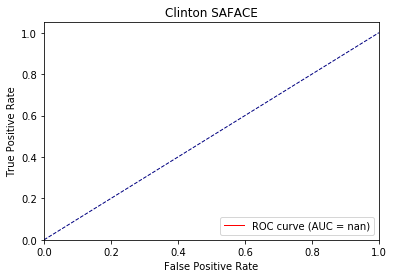

Directory already exists!
hc_saface 2 ap tensor([1., 0.]) loss : 0.1195518970489502 0.13536399602890015 tid : 400 tg tensor([[0]], device='cuda:0')
hc_saface 2 ap tensor([0.9936, 0.0229]) loss : 0.07239282131195068 0.17083831495559054 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_saface 2 ap tensor([1., 0.]) loss : 0.055058836936950684 0.12586755344742223 tid : 150 tg tensor([[0]], device='cuda:0')
TEST hc_saface 2 ap tensor([1., 0.]) loss : 0.10810732841491699 0.12058111796012291 tid : 210 tg tensor([[0]], device='cuda:0')
TEST hc_saface 2 ap tensor([1., 0.]) loss : 0.10841763019561768 0.11622034647363297 tid : 480 tg tensor([[0]], device='cuda:0')
TEST hc_saface 2 ap tensor([1., 0.]) loss : 0.0573427677154541 0.11583429775558986 tid : 510 tg tensor([[0]], device='cuda:0')
TEST hc_saface 2 ap tensor([1., 0.]) loss : 0.16087836027145386 0.11658085513552395 tid : 540 tg tensor([[0]], device='cuda:0')


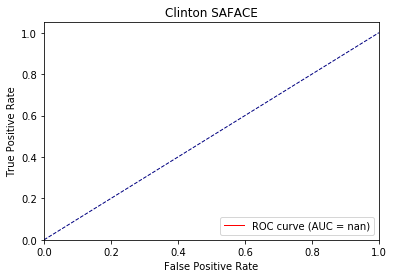

Directory already exists!
hc_neuface 0 ap tensor([0.6790, 0.2279]) loss : 0.7195924520492554 0.7356649577617645 tid : 200 tg tensor([[0]], device='cuda:0')
hc_neuface 0 ap tensor([0.7201, 0.4110]) loss : 0.6443274021148682 0.6817485649877459 tid : 400 tg tensor([[1]], device='cuda:0')
TEST hc_neuface 0 ap tensor([0.4589, 0.4780]) loss : 0.5850807428359985 0.7361368238925934 tid : 150 tg tensor([[0]], device='cuda:0')
TEST hc_neuface 0 ap tensor([0.3837, 0.5251]) loss : 0.8825511932373047 0.7359850567120773 tid : 210 tg tensor([[1]], device='cuda:0')
TEST hc_neuface 0 ap tensor([0.4264, 0.5072]) loss : 0.8722797632217407 0.7383637526567947 tid : 480 tg tensor([[1]], device='cuda:0')
TEST hc_neuface 0 ap tensor([0.4248, 0.4827]) loss : 0.9081596732139587 0.7392086641719708 tid : 510 tg tensor([[1]], device='cuda:0')
TEST hc_neuface 0 ap tensor([0.4139, 0.4936]) loss : 0.8055431842803955 0.7386322729631302 tid : 540 tg tensor([[1]], device='cuda:0')


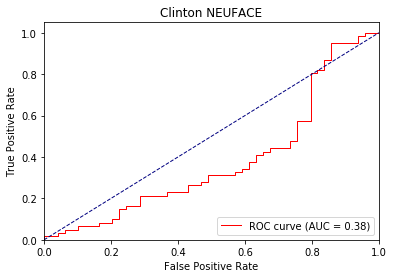

Directory already exists!
hc_neuface 1 ap tensor([0.7734, 0.5059]) loss : 0.6047725677490234 0.6567864652397564 tid : 200 tg tensor([[0]], device='cuda:0')
hc_neuface 1 ap tensor([0.8036, 0.4638]) loss : 0.7415950894355774 0.6457734918948886 tid : 400 tg tensor([[1]], device='cuda:0')
TEST hc_neuface 1 ap tensor([0.5423, 0.4900]) loss : 0.571099042892456 0.7193452911941629 tid : 150 tg tensor([[0]], device='cuda:0')
TEST hc_neuface 1 ap tensor([0.4351, 0.5600]) loss : 0.8657931685447693 0.7271800035467515 tid : 210 tg tensor([[1]], device='cuda:0')
TEST hc_neuface 1 ap tensor([0.4995, 0.5337]) loss : 0.9946521520614624 0.7309185218937854 tid : 480 tg tensor([[1]], device='cuda:0')
TEST hc_neuface 1 ap tensor([0.4819, 0.5096]) loss : 1.0582971572875977 0.7306640128103586 tid : 510 tg tensor([[1]], device='cuda:0')
TEST hc_neuface 1 ap tensor([0.4718, 0.5214]) loss : 0.8679847121238708 0.7314473655792552 tid : 540 tg tensor([[1]], device='cuda:0')


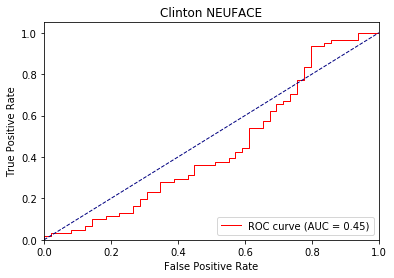

Directory already exists!
hc_neuface 2 ap tensor([0.8601, 0.5123]) loss : 0.4824855923652649 0.6120390812459501 tid : 200 tg tensor([[0]], device='cuda:0')
hc_neuface 2 ap tensor([0.8720, 0.5229]) loss : 0.8118599653244019 0.6053506008386612 tid : 400 tg tensor([[1]], device='cuda:0')
TEST hc_neuface 2 ap tensor([0.5779, 0.5272]) loss : 0.5838887095451355 0.7006645006568808 tid : 150 tg tensor([[0]], device='cuda:0')
TEST hc_neuface 2 ap tensor([0.4710, 0.5923]) loss : 0.8219524025917053 0.7140337836283904 tid : 210 tg tensor([[1]], device='cuda:0')
TEST hc_neuface 2 ap tensor([0.5488, 0.5851]) loss : 1.0770094394683838 0.7171991717942218 tid : 480 tg tensor([[1]], device='cuda:0')
TEST hc_neuface 2 ap tensor([0.5368, 0.5607]) loss : 1.1693629026412964 0.7167538510492215 tid : 510 tg tensor([[1]], device='cuda:0')
TEST hc_neuface 2 ap tensor([0.5272, 0.5708]) loss : 0.9032491445541382 0.7183528020294434 tid : 540 tg tensor([[1]], device='cuda:0')


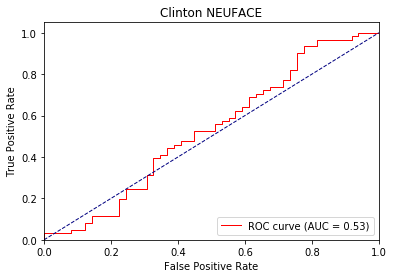

Directory already exists!
hc_inapprop 0 ap tensor([1., 0.]) loss : 0.42416346073150635 0.5928856238376262 tid : 200 tg tensor([[0]], device='cuda:0')
hc_inapprop 0 ap tensor([1., 0.]) loss : 0.5013390779495239 0.5941537136540693 tid : 400 tg tensor([[0]], device='cuda:0')
TEST hc_inapprop 0 ap tensor([1., 0.]) loss : 0.281413197517395 0.3439519530848453 tid : 150 tg tensor([[0]], device='cuda:0')
TEST hc_inapprop 0 ap tensor([1., 0.]) loss : 0.37928247451782227 0.33145953428286773 tid : 210 tg tensor([[0]], device='cuda:0')
TEST hc_inapprop 0 ap tensor([1., 0.]) loss : 0.2486194372177124 0.3187252622335515 tid : 480 tg tensor([[0]], device='cuda:0')
TEST hc_inapprop 0 ap tensor([1., 0.]) loss : 0.22037827968597412 0.31737293446293247 tid : 510 tg tensor([[0]], device='cuda:0')
TEST hc_inapprop 0 ap tensor([1., 0.]) loss : 0.32943981885910034 0.31676754874920626 tid : 540 tg tensor([[0]], device='cuda:0')


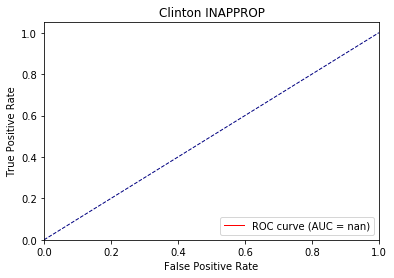

Directory already exists!
hc_inapprop 1 ap tensor([1., 0.]) loss : 0.16499775648117065 0.24530305121546594 tid : 400 tg tensor([[0]], device='cuda:0')
hc_inapprop 1 ap tensor([1., 0.]) loss : 0.09290874004364014 0.22133707714288733 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_inapprop 1 ap tensor([1., 0.]) loss : 0.11643600463867188 0.1809297478512714 tid : 150 tg tensor([[0]], device='cuda:0')
TEST hc_inapprop 1 ap tensor([1., 0.]) loss : 0.19025909900665283 0.17132572256601775 tid : 210 tg tensor([[0]], device='cuda:0')
TEST hc_inapprop 1 ap tensor([1., 0.]) loss : 0.09566712379455566 0.16125982651051055 tid : 480 tg tensor([[0]], device='cuda:0')
TEST hc_inapprop 1 ap tensor([1., 0.]) loss : 0.08872926235198975 0.1601908249923816 tid : 510 tg tensor([[0]], device='cuda:0')
TEST hc_inapprop 1 ap tensor([1., 0.]) loss : 0.1747441291809082 0.15999074786081227 tid : 540 tg tensor([[0]], device='cuda:0')


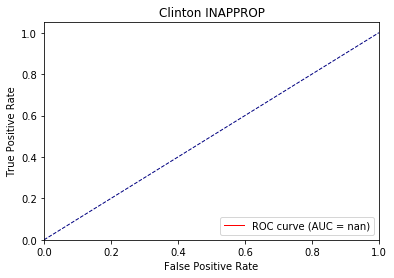

Directory already exists!
hc_inapprop 2 ap tensor([1., 0.]) loss : 0.04059445858001709 0.10981696331710146 tid : 200 tg tensor([[0]], device='cuda:0')
hc_inapprop 2 ap tensor([1., 0.]) loss : 0.053527116775512695 0.10910778074968057 tid : 400 tg tensor([[0]], device='cuda:0')
TEST hc_inapprop 2 ap tensor([1., 0.]) loss : 0.049021005630493164 0.1003386864536687 tid : 150 tg tensor([[0]], device='cuda:0')
TEST hc_inapprop 2 ap tensor([1., 0.]) loss : 0.09918642044067383 0.09311456061326541 tid : 210 tg tensor([[0]], device='cuda:0')
TEST hc_inapprop 2 ap tensor([1., 0.]) loss : 0.040707945823669434 0.0863052968015062 tid : 480 tg tensor([[0]], device='cuda:0')
TEST hc_inapprop 2 ap tensor([1., 0.]) loss : 0.0347132682800293 0.08542971370311883 tid : 510 tg tensor([[0]], device='cuda:0')
TEST hc_inapprop 2 ap tensor([1., 0.]) loss : 0.08758783340454102 0.08510760265752809 tid : 540 tg tensor([[0]], device='cuda:0')


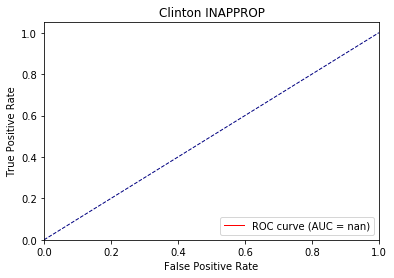

Directory already exists!
hc_affgest 0 ap tensor([0.9774, 0.0915]) loss : 0.48724085092544556 0.5532676392388576 tid : 200 tg tensor([[0]], device='cuda:0')
hc_affgest 0 ap tensor([0.9648, 0.0841]) loss : 0.4562333822250366 0.5099839265626597 tid : 400 tg tensor([[0]], device='cuda:0')
TEST hc_affgest 0 ap tensor([1., 0.]) loss : 0.2461632490158081 0.38234007358551025 tid : 150 tg tensor([[0]], device='cuda:0')
TEST hc_affgest 0 ap tensor([1., 0.]) loss : 0.25627660751342773 0.3781310331362944 tid : 210 tg tensor([[0]], device='cuda:0')
TEST hc_affgest 0 ap tensor([0.9930, 0.0217]) loss : 0.3793686032295227 0.38046280817782624 tid : 480 tg tensor([[0]], device='cuda:0')
TEST hc_affgest 0 ap tensor([0.9942, 0.0208]) loss : 0.33374905586242676 0.37704277926912677 tid : 510 tg tensor([[0]], device='cuda:0')
TEST hc_affgest 0 ap tensor([0.9942, 0.0192]) loss : 0.47419819235801697 0.3790549761658415 tid : 540 tg tensor([[0]], device='cuda:0')


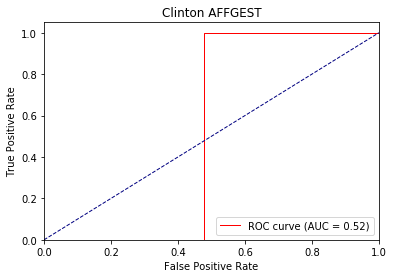

Directory already exists!
hc_affgest 1 ap tensor([0.9786, 0.1517]) loss : 0.24054723978042603 0.3364970717699297 tid : 200 tg tensor([[0]], device='cuda:0')
hc_affgest 1 ap tensor([0.9824, 0.1295]) loss : 0.2500653564929962 0.3116749785937272 tid : 400 tg tensor([[0]], device='cuda:0')
TEST hc_affgest 1 ap tensor([1., 0.]) loss : 0.11940491199493408 0.2534912056044528 tid : 150 tg tensor([[0]], device='cuda:0')
TEST hc_affgest 1 ap tensor([1., 0.]) loss : 0.1360921859741211 0.24822244678552335 tid : 210 tg tensor([[0]], device='cuda:0')
TEST hc_affgest 1 ap tensor([0.9935, 0.0227]) loss : 0.20648401975631714 0.2508594793208102 tid : 480 tg tensor([[0]], device='cuda:0')
TEST hc_affgest 1 ap tensor([0.9945, 0.0217]) loss : 0.1893407702445984 0.24645694574484459 tid : 510 tg tensor([[0]], device='cuda:0')
TEST hc_affgest 1 ap tensor([0.9945, 0.0200]) loss : 0.3076608180999756 0.247583966462984 tid : 540 tg tensor([[0]], device='cuda:0')


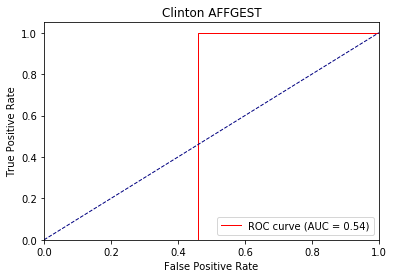

Directory already exists!
hc_affgest 2 ap tensor([0.9882, 0.1771]) loss : 0.12486881017684937 0.24275732880530088 tid : 200 tg tensor([[0]], device='cuda:0')
hc_affgest 2 ap tensor([0.9867, 0.1692]) loss : 0.15918183326721191 0.24011913172846555 tid : 400 tg tensor([[0]], device='cuda:0')
TEST hc_affgest 2 ap tensor([1., 0.]) loss : 0.06758034229278564 0.1900951878020638 tid : 150 tg tensor([[0]], device='cuda:0')
TEST hc_affgest 2 ap tensor([1., 0.]) loss : 0.08220946788787842 0.18449309582893664 tid : 210 tg tensor([[0]], device='cuda:0')
TEST hc_affgest 2 ap tensor([0.9947, 0.0263]) loss : 0.11814790964126587 0.1878774105868441 tid : 480 tg tensor([[0]], device='cuda:0')
TEST hc_affgest 2 ap tensor([0.9955, 0.0250]) loss : 0.11626631021499634 0.1833389475941658 tid : 510 tg tensor([[0]], device='cuda:0')
TEST hc_affgest 2 ap tensor([0.9955, 0.0233]) loss : 0.20797711610794067 0.18360162874974242 tid : 540 tg tensor([[0]], device='cuda:0')


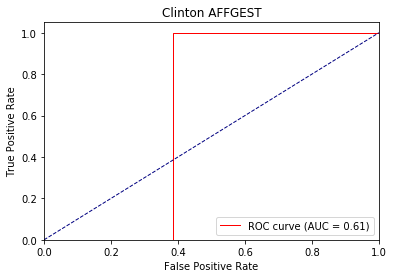

Directory already exists!
hc_defgest 0 ap tensor([1., 0.]) loss : 0.6209092736244202 0.7328327655792236 tid : 200 tg tensor([[0]], device='cuda:0')
hc_defgest 0 ap tensor([0.9351, 0.1248]) loss : 1.0281864404678345 0.5584491045349822 tid : 400 tg tensor([[1]], device='cuda:0')
TEST hc_defgest 0 ap tensor([0.8968, 0.3727]) loss : 0.29495978355407715 0.5609999173565915 tid : 150 tg tensor([[0]], device='cuda:0')
TEST hc_defgest 0 ap tensor([0.8628, 0.4099]) loss : 0.3012887239456177 0.5796945232611436 tid : 210 tg tensor([[0]], device='cuda:0')
TEST hc_defgest 0 ap tensor([0.9223, 0.4570]) loss : 0.35521209239959717 0.5428929747419154 tid : 480 tg tensor([[0]], device='cuda:0')
TEST hc_defgest 0 ap tensor([0.9292, 0.4408]) loss : 0.38962048292160034 0.5357688278532945 tid : 510 tg tensor([[0]], device='cuda:0')
TEST hc_defgest 0 ap tensor([0.9272, 0.4350]) loss : 0.4135674238204956 0.5367546141694445 tid : 540 tg tensor([[0]], device='cuda:0')


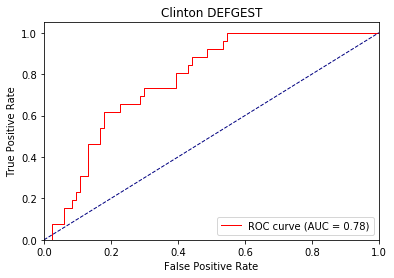

Directory already exists!
hc_defgest 1 ap tensor([0.9480, 0.6862]) loss : 1.021988868713379 0.5478820566620145 tid : 400 tg tensor([[1]], device='cuda:0')
hc_defgest 1 ap tensor([0.9504, 0.3250]) loss : 0.3267386555671692 0.46289797667144 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_defgest 1 ap tensor([0.8997, 0.3636]) loss : 0.15124547481536865 0.5075309441277855 tid : 150 tg tensor([[0]], device='cuda:0')
TEST hc_defgest 1 ap tensor([0.8708, 0.4248]) loss : 0.15955007076263428 0.5496060361082737 tid : 210 tg tensor([[0]], device='cuda:0')
TEST hc_defgest 1 ap tensor([0.9265, 0.4743]) loss : 0.21555602550506592 0.4998059605664395 tid : 480 tg tensor([[0]], device='cuda:0')
TEST hc_defgest 1 ap tensor([0.9325, 0.4561]) loss : 0.25247037410736084 0.48594838122908884 tid : 510 tg tensor([[0]], device='cuda:0')
TEST hc_defgest 1 ap tensor([0.9307, 0.4497]) loss : 0.28115910291671753 0.4865113871360044 tid : 540 tg tensor([[0]], device='cuda:0')


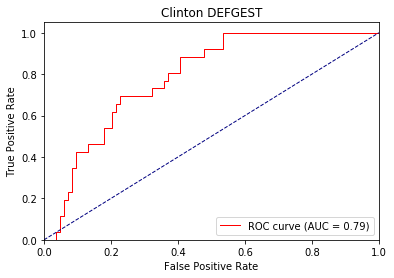

Directory already exists!
hc_defgest 2 ap tensor([0.9838, 0.2448]) loss : 0.1976604461669922 0.3237917554729125 tid : 200 tg tensor([[0]], device='cuda:0')
hc_defgest 2 ap tensor([0.9631, 0.1570]) loss : 1.5776541233062744 0.32907426648215443 tid : 400 tg tensor([[1]], device='cuda:0')
TEST hc_defgest 2 ap tensor([0.9053, 0.3910]) loss : 0.09471988677978516 0.49390853078741775 tid : 150 tg tensor([[0]], device='cuda:0')
TEST hc_defgest 2 ap tensor([0.8781, 0.4493]) loss : 0.09896540641784668 0.5506282425843753 tid : 210 tg tensor([[0]], device='cuda:0')
TEST hc_defgest 2 ap tensor([0.9278, 0.4799]) loss : 0.15205812454223633 0.4952579007503834 tid : 480 tg tensor([[0]], device='cuda:0')
TEST hc_defgest 2 ap tensor([0.9343, 0.4633]) loss : 0.18769967555999756 0.47726308611723095 tid : 510 tg tensor([[0]], device='cuda:0')
TEST hc_defgest 2 ap tensor([0.9331, 0.4569]) loss : 0.21290600299835205 0.47736776312556833 tid : 540 tg tensor([[0]], device='cuda:0')


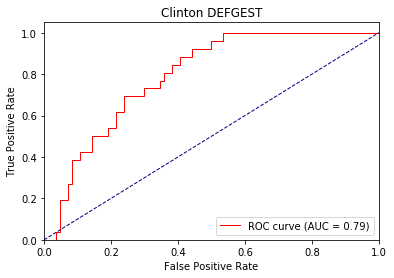

Directory already exists!
hc_agentic 0 ap tensor([0.5000, 0.5000]) loss : 0.6907352805137634 0.6966879367828369 tid : 400 tg tensor([[1]], device='cuda:0')
hc_agentic 0 ap tensor([0.7466, 0.7479]) loss : 0.7026726603507996 0.6474132610333933 tid : 200 tg tensor([[1]], device='cuda:0')
TEST hc_agentic 0 ap tensor([0.9451, 0.9757]) loss : 0.6112687587738037 0.47814874115743133 tid : 150 tg tensor([[0]], device='cuda:0')
TEST hc_agentic 0 ap tensor([0.9494, 0.9724]) loss : 0.4804457426071167 0.4723200196257004 tid : 210 tg tensor([[0]], device='cuda:0')
TEST hc_agentic 0 ap tensor([0.9784, 0.9743]) loss : 0.5254002809524536 0.47937318270510815 tid : 480 tg tensor([[0]], device='cuda:0')
TEST hc_agentic 0 ap tensor([0.9776, 0.9723]) loss : 0.7370889782905579 0.48219206585333896 tid : 510 tg tensor([[0]], device='cuda:0')
TEST hc_agentic 0 ap tensor([0.9792, 0.9723]) loss : 0.4830000400543213 0.4821008558667034 tid : 540 tg tensor([[0]], device='cuda:0')


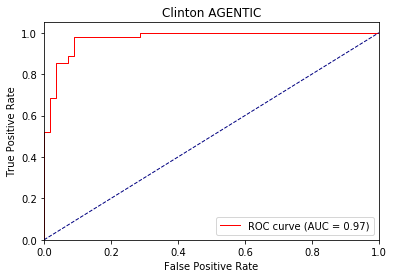

Directory already exists!
hc_agentic 1 ap tensor([0.9706, 0.9746]) loss : 0.312330961227417 0.438318844884634 tid : 400 tg tensor([[1]], device='cuda:0')
hc_agentic 1 ap tensor([0.9661, 0.9671]) loss : 0.43649205565452576 0.39735402855670676 tid : 200 tg tensor([[1]], device='cuda:0')
TEST hc_agentic 1 ap tensor([0.9479, 0.9713]) loss : 0.43568623065948486 0.365743078683552 tid : 150 tg tensor([[0]], device='cuda:0')
TEST hc_agentic 1 ap tensor([0.9506, 0.9680]) loss : 0.28167396783828735 0.36067603757748234 tid : 210 tg tensor([[0]], device='cuda:0')
TEST hc_agentic 1 ap tensor([0.9794, 0.9739]) loss : 0.5042035579681396 0.37707626851315196 tid : 480 tg tensor([[0]], device='cuda:0')
TEST hc_agentic 1 ap tensor([0.9790, 0.9721]) loss : 0.8836613893508911 0.3794256371374314 tid : 510 tg tensor([[0]], device='cuda:0')
TEST hc_agentic 1 ap tensor([0.9806, 0.9725]) loss : 0.4111112952232361 0.37864176477860967 tid : 540 tg tensor([[0]], device='cuda:0')


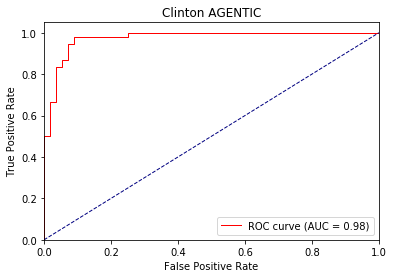

Directory already exists!
hc_agentic 2 ap tensor([0.9825, 0.9890]) loss : 0.2076776623725891 0.3027940154745338 tid : 400 tg tensor([[1]], device='cuda:0')
hc_agentic 2 ap tensor([0.9720, 0.9742]) loss : 0.31547945737838745 0.3018939527132178 tid : 200 tg tensor([[1]], device='cuda:0')
TEST hc_agentic 2 ap tensor([0.9525, 0.9601]) loss : 0.3428286015987396 0.31445725026883575 tid : 150 tg tensor([[0]], device='cuda:0')
TEST hc_agentic 2 ap tensor([0.9523, 0.9597]) loss : 0.17962145805358887 0.3101708854620273 tid : 210 tg tensor([[0]], device='cuda:0')
TEST hc_agentic 2 ap tensor([0.9796, 0.9694]) loss : 0.47559991478919983 0.33152108433398797 tid : 480 tg tensor([[0]], device='cuda:0')
TEST hc_agentic 2 ap tensor([0.9787, 0.9678]) loss : 1.0468940734863281 0.3325042458107838 tid : 510 tg tensor([[0]], device='cuda:0')
TEST hc_agentic 2 ap tensor([0.9804, 0.9684]) loss : 0.34957370162010193 0.3304828219457504 tid : 540 tg tensor([[0]], device='cuda:0')


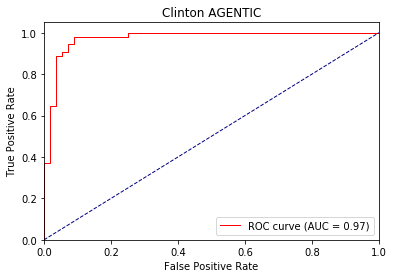

Directory already exists!
hc_waveoff 0 ap tensor([0.5645, 0.4616]) loss : 0.5650995969772339 0.70473209748397 tid : 200 tg tensor([[1]], device='cuda:0')
hc_waveoff 0 ap tensor([0.7846, 0.5070]) loss : 0.5744307637214661 0.6638553963517243 tid : 400 tg tensor([[1]], device='cuda:0')
TEST hc_waveoff 0 ap tensor([0.7933, 0.4890]) loss : 0.3597114384174347 0.612444406277255 tid : 150 tg tensor([[0]], device='cuda:0')
TEST hc_waveoff 0 ap tensor([0.8117, 0.5911]) loss : 0.3103405833244324 0.5902637226077226 tid : 210 tg tensor([[0]], device='cuda:0')
TEST hc_waveoff 0 ap tensor([0.8824, 0.6071]) loss : 0.7553896307945251 0.5873590609494675 tid : 480 tg tensor([[0]], device='cuda:0')
TEST hc_waveoff 0 ap tensor([0.8904, 0.6297]) loss : 0.8271723389625549 0.5828532762825489 tid : 510 tg tensor([[0]], device='cuda:0')
TEST hc_waveoff 0 ap tensor([0.8924, 0.6310]) loss : 0.6454036235809326 0.5829033654764157 tid : 540 tg tensor([[0]], device='cuda:0')


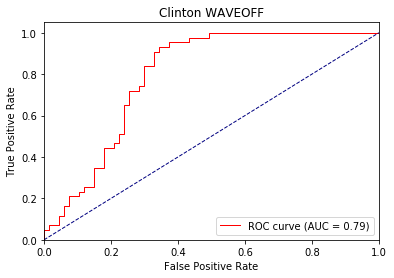

Directory already exists!
hc_waveoff 1 ap tensor([0.9303, 0.7540]) loss : 0.4841051995754242 0.49906944321872587 tid : 400 tg tensor([[1]], device='cuda:0')
hc_waveoff 1 ap tensor([0.9313, 0.7594]) loss : 0.6007846593856812 0.49800629517882344 tid : 200 tg tensor([[1]], device='cuda:0')
TEST hc_waveoff 1 ap tensor([0.8267, 0.5278]) loss : 0.2204640507698059 0.5700556008439315 tid : 150 tg tensor([[0]], device='cuda:0')
TEST hc_waveoff 1 ap tensor([0.8376, 0.6336]) loss : 0.18064510822296143 0.5374860924023849 tid : 210 tg tensor([[0]], device='cuda:0')
TEST hc_waveoff 1 ap tensor([0.9007, 0.6645]) loss : 0.6316865682601929 0.5275380519476343 tid : 480 tg tensor([[0]], device='cuda:0')
TEST hc_waveoff 1 ap tensor([0.9075, 0.6840]) loss : 0.8031477928161621 0.5213874667309798 tid : 510 tg tensor([[0]], device='cuda:0')
TEST hc_waveoff 1 ap tensor([0.9100, 0.6855]) loss : 0.5376600027084351 0.5201478280605526 tid : 540 tg tensor([[0]], device='cuda:0')


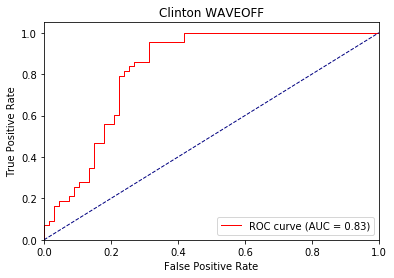

Directory already exists!
hc_waveoff 2 ap tensor([0.9676, 0.6188]) loss : 0.4916171431541443 0.43589783683419225 tid : 400 tg tensor([[1]], device='cuda:0')
hc_waveoff 2 ap tensor([0.9456, 0.7274]) loss : 0.6208584308624268 0.4560508892952817 tid : 200 tg tensor([[1]], device='cuda:0')
TEST hc_waveoff 2 ap tensor([0.8426, 0.5525]) loss : 0.15740638971328735 0.5491543247511512 tid : 150 tg tensor([[0]], device='cuda:0')
TEST hc_waveoff 2 ap tensor([0.8579, 0.6608]) loss : 0.11585485935211182 0.507026381790638 tid : 210 tg tensor([[0]], device='cuda:0')
TEST hc_waveoff 2 ap tensor([0.9110, 0.6885]) loss : 0.534932553768158 0.4955259789811804 tid : 480 tg tensor([[0]], device='cuda:0')
TEST hc_waveoff 2 ap tensor([0.9168, 0.7104]) loss : 0.7995076179504395 0.48865468656787503 tid : 510 tg tensor([[0]], device='cuda:0')
TEST hc_waveoff 2 ap tensor([0.9196, 0.7121]) loss : 0.4504692554473877 0.48593040671917276 tid : 540 tg tensor([[0]], device='cuda:0')


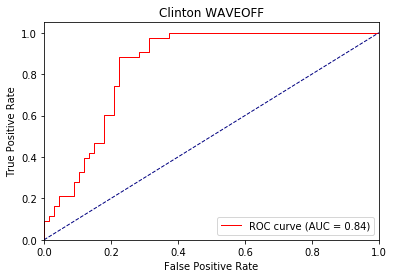

Directory already exists!
hc_nvtic1 0 ap tensor([0.7829, 0.1996]) loss : 0.6358177661895752 0.7219470597448803 tid : 400 tg tensor([[0]], device='cuda:0')
hc_nvtic1 0 ap tensor([0.8752, 0.1556]) loss : 0.4243242144584656 0.6398254835148477 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic1 0 ap tensor([0.8133, 0.0980]) loss : 1.1497336626052856 0.5436673148682243 tid : 150 tg tensor([[1]], device='cuda:0')
TEST hc_nvtic1 0 ap tensor([0.7893, 0.1502]) loss : 1.053465723991394 0.5744834656898792 tid : 210 tg tensor([[1]], device='cuda:0')
TEST hc_nvtic1 0 ap tensor([0.7993, 0.1674]) loss : 0.4677797555923462 0.5738433288766983 tid : 480 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic1 0 ap tensor([0.7923, 0.1646]) loss : 1.0683157444000244 0.574447919256412 tid : 510 tg tensor([[1]], device='cuda:0')
TEST hc_nvtic1 0 ap tensor([0.7970, 0.1549]) loss : 0.5652825832366943 0.5698890650491102 tid : 540 tg tensor([[0]], device='cuda:0')


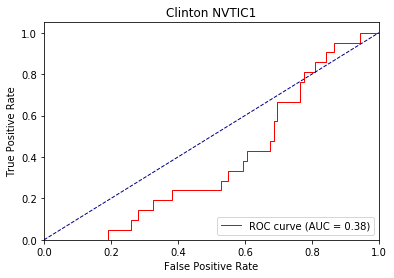

Directory already exists!
hc_nvtic1 1 ap tensor([0.8686, 0.1999]) loss : 0.3821723461151123 0.5354314006291903 tid : 400 tg tensor([[0]], device='cuda:0')
hc_nvtic1 1 ap tensor([0.8801, 0.1854]) loss : 0.3013896942138672 0.5046940998150884 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic1 1 ap tensor([0.8229, 0.1144]) loss : 1.5317460298538208 0.4564721749017113 tid : 150 tg tensor([[1]], device='cuda:0')
TEST hc_nvtic1 1 ap tensor([0.8161, 0.2056]) loss : 1.3615473508834839 0.5118370881447425 tid : 210 tg tensor([[1]], device='cuda:0')
TEST hc_nvtic1 1 ap tensor([0.8219, 0.2043]) loss : 0.3749488890171051 0.522304117679596 tid : 480 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic1 1 ap tensor([0.8248, 0.1989]) loss : 1.3389244079589844 0.5227294180255669 tid : 510 tg tensor([[1]], device='cuda:0')
TEST hc_nvtic1 1 ap tensor([0.8275, 0.1843]) loss : 0.4922648072242737 0.5149536165622396 tid : 540 tg tensor([[0]], device='cuda:0')


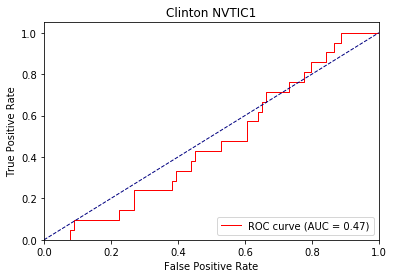

Directory already exists!
hc_nvtic1 2 ap tensor([0.9579, 0.2066]) loss : 0.21186333894729614 0.37885070761288603 tid : 400 tg tensor([[0]], device='cuda:0')
hc_nvtic1 2 ap tensor([0.9138, 0.2105]) loss : 0.21172529458999634 0.4101792327735735 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic1 2 ap tensor([0.9182, 0.1950]) loss : 1.7179105281829834 0.4106397064108598 tid : 150 tg tensor([[1]], device='cuda:0')
TEST hc_nvtic1 2 ap tensor([0.9144, 0.3193]) loss : 1.5101525783538818 0.4753517760680272 tid : 210 tg tensor([[1]], device='cuda:0')
TEST hc_nvtic1 2 ap tensor([0.8854, 0.2638]) loss : 0.36049944162368774 0.49638482547820884 tid : 480 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic1 2 ap tensor([0.8874, 0.2569]) loss : 1.4821782112121582 0.4970852821492232 tid : 510 tg tensor([[1]], device='cuda:0')
TEST hc_nvtic1 2 ap tensor([0.8868, 0.2351]) loss : 0.4800747334957123 0.4881197987893306 tid : 540 tg tensor([[0]], device='cuda:0')


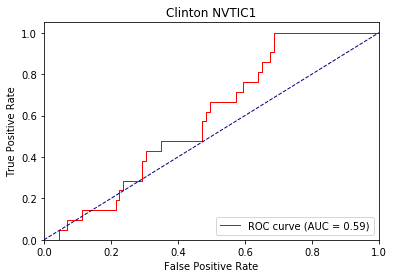

Directory already exists!
hc_nvtic2 0 ap tensor([0.8211, 0.1738]) loss : 0.7813745737075806 0.7361731675633213 tid : 400 tg tensor([[0]], device='cuda:0')
hc_nvtic2 0 ap tensor([0.8877, 0.1264]) loss : 0.604607343673706 0.6599738026757639 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic2 0 ap tensor([0.9830, 0.0526]) loss : 0.305564820766449 0.4724326431751251 tid : 150 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic2 0 ap tensor([0.9843, 0.5333]) loss : 0.4060574471950531 0.47558104877288526 tid : 210 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic2 0 ap tensor([0.9834, 0.3994]) loss : 0.6795478463172913 0.48700923900654974 tid : 480 tg tensor([[1]], device='cuda:0')
TEST hc_nvtic2 0 ap tensor([0.9814, 0.3715]) loss : 0.947271466255188 0.4884784562656513 tid : 510 tg tensor([[1]], device='cuda:0')
TEST hc_nvtic2 0 ap tensor([0.9822, 0.4788]) loss : 0.6874243021011353 0.4906715469075999 tid : 540 tg tensor([[1]], device='cuda:0')


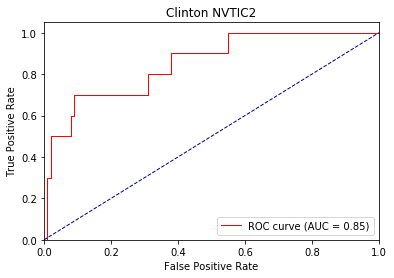

Directory already exists!
hc_nvtic2 1 ap tensor([0.5000, 0.5000]) loss : 0.49581122398376465 0.8094781637191772 tid : 200 tg tensor([[0]], device='cuda:0')
hc_nvtic2 1 ap tensor([0.9097, 0.2886]) loss : 0.2518548369407654 0.4591784564937864 tid : 400 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic2 1 ap tensor([0.9263, 0.0270]) loss : 0.2116529941558838 0.3248470896168759 tid : 150 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic2 1 ap tensor([0.9396, 0.5196]) loss : 0.2887824475765228 0.32509938226296353 tid : 210 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic2 1 ap tensor([0.9548, 0.3618]) loss : 0.8585442304611206 0.3580970241034285 tid : 480 tg tensor([[1]], device='cuda:0')
TEST hc_nvtic2 1 ap tensor([0.9559, 0.3456]) loss : 1.2495787143707275 0.3618567454127165 tid : 510 tg tensor([[1]], device='cuda:0')
TEST hc_nvtic2 1 ap tensor([0.9568, 0.4543]) loss : 0.810721755027771 0.3677530119178492 tid : 540 tg tensor([[1]], device='cuda:0')


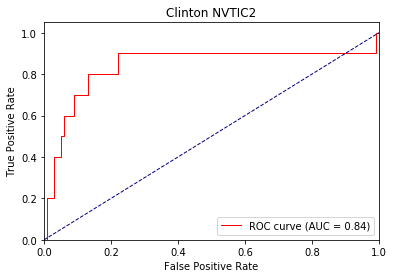

Directory already exists!
hc_nvtic2 2 ap tensor([0.9559, 0.3828]) loss : 0.23437970876693726 0.38220141511974914 tid : 200 tg tensor([[0]], device='cuda:0')
hc_nvtic2 2 ap tensor([0.9503, 0.3863]) loss : 0.142381489276886 0.38660038131857316 tid : 400 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic2 2 ap tensor([0.9128, 0.0263]) loss : 0.1740517020225525 0.2572146677657178 tid : 150 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic2 2 ap tensor([0.9296, 0.5192]) loss : 0.23414695262908936 0.2537987811061052 tid : 210 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic2 2 ap tensor([0.9483, 0.3531]) loss : 0.9659993648529053 0.2986192455951204 tid : 480 tg tensor([[1]], device='cuda:0')
TEST hc_nvtic2 2 ap tensor([0.9501, 0.3390]) loss : 1.480834722518921 0.30365549601041353 tid : 510 tg tensor([[1]], device='cuda:0')
TEST hc_nvtic2 2 ap tensor([0.9511, 0.4415]) loss : 0.8725711107254028 0.31108600584738844 tid : 540 tg tensor([[1]], device='cuda:0')


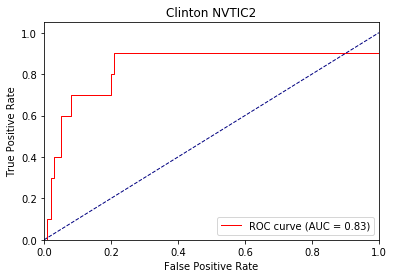

Directory already exists!
hc_nvtic3 0 ap tensor([1., 0.]) loss : 0.8212586045265198 0.7922922330243247 tid : 200 tg tensor([[0]], device='cuda:0')
hc_nvtic3 0 ap tensor([0.9967, 0.0071]) loss : 0.4195045530796051 0.5912014978538028 tid : 400 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic3 0 ap tensor([0.8810, 0.1071]) loss : 0.31095224618911743 0.5309962849867972 tid : 150 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic3 0 ap tensor([0.9138, 0.0803]) loss : 0.33303916454315186 0.5098209690589172 tid : 210 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic3 0 ap tensor([0.9547, 0.0516]) loss : 0.3675975203514099 0.47002638052118584 tid : 480 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic3 0 ap tensor([0.9602, 0.0483]) loss : 0.39153772592544556 0.4647364914417267 tid : 510 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic3 0 ap tensor([0.9618, 0.0468]) loss : 0.49862802028656006 0.46302218393448297 tid : 540 tg tensor([[0]], device='cuda:0')


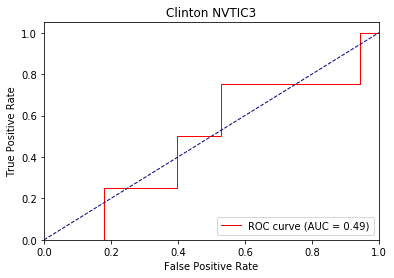

Directory already exists!
hc_nvtic3 1 ap tensor([0.9943, 0.0077]) loss : 0.18715524673461914 0.3087635445744266 tid : 200 tg tensor([[0]], device='cuda:0')
hc_nvtic3 1 ap tensor([0.9946, 0.0077]) loss : 0.20773077011108398 0.306334896870186 tid : 400 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic3 1 ap tensor([0.8759, 0.1061]) loss : 0.12958920001983643 0.3936813340375298 tid : 150 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic3 1 ap tensor([0.9102, 0.0794]) loss : 0.17890119552612305 0.3476728619291232 tid : 210 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic3 1 ap tensor([0.9529, 0.0506]) loss : 0.16635394096374512 0.2857105627338937 tid : 480 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic3 1 ap tensor([0.9585, 0.0469]) loss : 0.18164294958114624 0.2778088997762937 tid : 510 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic3 1 ap tensor([0.9595, 0.0449]) loss : 0.29692327976226807 0.2755038199621603 tid : 540 tg tensor([[0]], device='cuda:0')


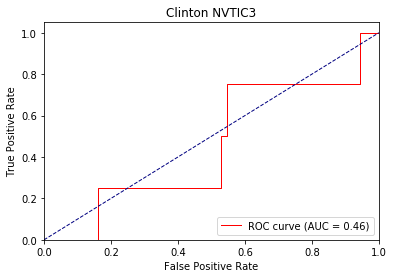

Directory already exists!
hc_nvtic3 2 ap tensor([1., 0.]) loss : 0.14630568027496338 0.1854438477632951 tid : 400 tg tensor([[0]], device='cuda:0')
hc_nvtic3 2 ap tensor([0.9970, 0.0093]) loss : 0.08821380138397217 0.16515117494372633 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic3 2 ap tensor([0.8751, 0.1087]) loss : 0.06227147579193115 0.36876022031432704 tid : 150 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic3 2 ap tensor([0.9083, 0.0820]) loss : 0.10644268989562988 0.299184150993824 tid : 210 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic3 2 ap tensor([0.9530, 0.0510]) loss : 0.07539701461791992 0.21340539766118882 tid : 480 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic3 2 ap tensor([0.9583, 0.0472]) loss : 0.07687294483184814 0.20274641594061485 tid : 510 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic3 2 ap tensor([0.9593, 0.0444]) loss : 0.1665225625038147 0.19900552723385873 tid : 540 tg tensor([[0]], device='cuda:0')


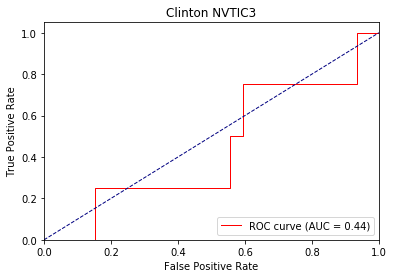

Directory already exists!
hc_nvtic5 0 ap tensor([1., 0.]) loss : 0.3949902355670929 0.45970944602997293 tid : 400 tg tensor([[0]], device='cuda:0')
hc_nvtic5 0 ap tensor([1., 0.]) loss : 0.2643136978149414 0.4283693178316181 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic5 0 ap tensor([1., 0.]) loss : 0.19367289543151855 0.31520826095028925 tid : 150 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic5 0 ap tensor([1., 0.]) loss : 0.2216166853904724 0.30906793360526746 tid : 210 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic5 0 ap tensor([1., 0.]) loss : 0.21170789003372192 0.29466658355073727 tid : 480 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic5 0 ap tensor([1., 0.]) loss : 0.25599879026412964 0.2924665673994101 tid : 510 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic5 0 ap tensor([1., 0.]) loss : 0.2945725917816162 0.29149157847833196 tid : 540 tg tensor([[0]], device='cuda:0')


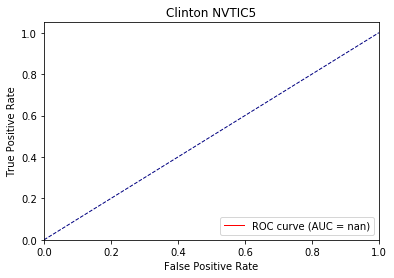

Directory already exists!
hc_nvtic5 1 ap tensor([1., 0.]) loss : 0.29576465487480164 0.28852217305790295 tid : 400 tg tensor([[0]], device='cuda:0')
hc_nvtic5 1 ap tensor([1., 0.]) loss : 0.16867977380752563 0.2285285807670431 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic5 1 ap tensor([1., 0.]) loss : 0.07472717761993408 0.15946119396310104 tid : 150 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic5 1 ap tensor([1., 0.]) loss : 0.10486078262329102 0.15553275839640543 tid : 210 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic5 1 ap tensor([1., 0.]) loss : 0.08961296081542969 0.1453865465331585 tid : 480 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic5 1 ap tensor([1., 0.]) loss : 0.1078786849975586 0.14411391432468706 tid : 510 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic5 1 ap tensor([1., 0.]) loss : 0.14344674348831177 0.14349985177363825 tid : 540 tg tensor([[0]], device='cuda:0')


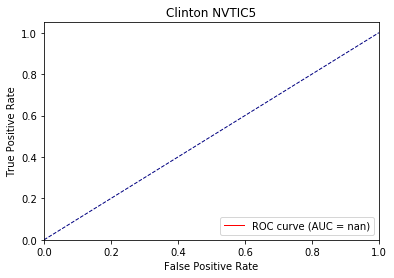

Directory already exists!
hc_nvtic5 2 ap tensor([1., 0.]) loss : 0.10255372524261475 0.11769911895195644 tid : 400 tg tensor([[0]], device='cuda:0')
hc_nvtic5 2 ap tensor([1., 0.]) loss : 0.04482841491699219 0.09157232748399867 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic5 2 ap tensor([1., 0.]) loss : 0.03107631206512451 0.08357486285661396 tid : 150 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic5 2 ap tensor([1., 0.]) loss : 0.054761409759521484 0.08101475353424366 tid : 210 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic5 2 ap tensor([1., 0.]) loss : 0.03726649284362793 0.07427203845470509 tid : 480 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic5 2 ap tensor([1., 0.]) loss : 0.04140877723693848 0.07348491423405133 tid : 510 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic5 2 ap tensor([1., 0.]) loss : 0.06611335277557373 0.07293677931531854 tid : 540 tg tensor([[0]], device='cuda:0')


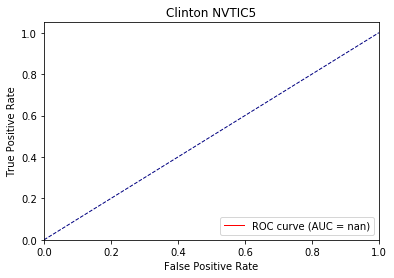

Directory already exists!
hc_nvtic4 0 ap tensor([0.9916, 0.0055]) loss : 0.4638237953186035 0.7021569977707577 tid : 200 tg tensor([[0]], device='cuda:0')
hc_nvtic4 0 ap tensor([0.9919, 0.0130]) loss : 0.4046643078327179 0.6223553446738908 tid : 400 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic4 0 ap tensor([0.9600, 0.1209]) loss : 0.32420724630355835 0.5010920198340165 tid : 150 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic4 0 ap tensor([0.9745, 0.1009]) loss : 0.32086098194122314 0.47726312910134977 tid : 210 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic4 0 ap tensor([0.9883, 0.0674]) loss : 0.4037993252277374 0.46052638837631715 tid : 480 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic4 0 ap tensor([0.9899, 0.0628]) loss : 0.35365211963653564 0.457916714824163 tid : 510 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic4 0 ap tensor([0.9898, 0.0570]) loss : 0.5333549976348877 0.45972948008721026 tid : 540 tg tensor([[0]], device='cuda:0')


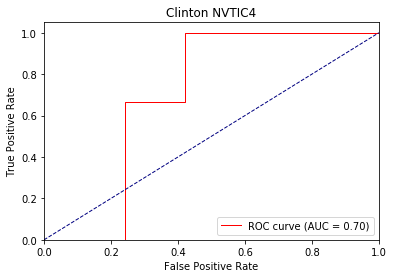

Directory already exists!
hc_nvtic4 1 ap tensor([0.9869, 0.5222]) loss : 0.26509854197502136 0.3656199855936898 tid : 200 tg tensor([[0]], device='cuda:0')
hc_nvtic4 1 ap tensor([0.9941, 0.2645]) loss : 0.270378440618515 0.3538968290469443 tid : 400 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic4 1 ap tensor([0.9672, 0.1447]) loss : 0.1464751958847046 0.3364581026529011 tid : 150 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic4 1 ap tensor([0.9801, 0.1244]) loss : 0.16084718704223633 0.3022590336891321 tid : 210 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic4 1 ap tensor([0.9899, 0.0830]) loss : 0.18391680717468262 0.26840099248480287 tid : 480 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic4 1 ap tensor([0.9912, 0.0746]) loss : 0.16231828927993774 0.26432512815182024 tid : 510 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic4 1 ap tensor([0.9909, 0.0648]) loss : 0.3452697694301605 0.26566553963433714 tid : 540 tg tensor([[0]], device='cuda:0')


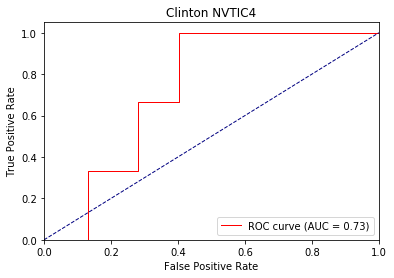

Directory already exists!
hc_nvtic4 2 ap tensor([1., 0.]) loss : 0.15067839622497559 0.15175616244475046 tid : 400 tg tensor([[0]], device='cuda:0')
hc_nvtic4 2 ap tensor([0.9901, 0.1785]) loss : 0.06219184398651123 0.15838315854382023 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic4 2 ap tensor([0.9707, 0.1836]) loss : 0.07260501384735107 0.2770118203602339 tid : 150 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic4 2 ap tensor([0.9813, 0.1494]) loss : 0.09242916107177734 0.2320578654225056 tid : 210 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic4 2 ap tensor([0.9903, 0.1044]) loss : 0.08126342296600342 0.18306331590135047 tid : 480 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic4 2 ap tensor([0.9915, 0.0877]) loss : 0.0708160400390625 0.1771748080276526 tid : 510 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic4 2 ap tensor([0.9912, 0.0753]) loss : 0.23052138090133667 0.17722960650374037 tid : 540 tg tensor([[0]], device='cuda:0')


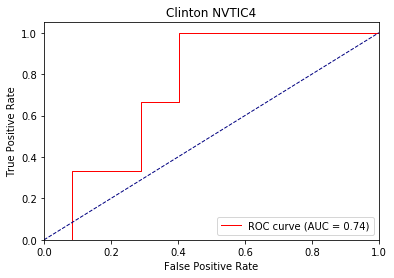

Directory already exists!
hc_interruptions 0 ap tensor([0.9889, 0.0533]) loss : 0.38555049896240234 0.4498054112404422 tid : 200 tg tensor([[0]], device='cuda:0')
hc_interruptions 0 ap tensor([0.9892, 0.0510]) loss : 0.4318034052848816 0.435926510977339 tid : 400 tg tensor([[0]], device='cuda:0')
TEST hc_interruptions 0 ap tensor([1., 0.]) loss : 0.16758126020431519 0.340725786591831 tid : 150 tg tensor([[0]], device='cuda:0')
TEST hc_interruptions 0 ap tensor([1., 0.]) loss : 0.14739513397216797 0.33544717270594376 tid : 210 tg tensor([[0]], device='cuda:0')
TEST hc_interruptions 0 ap tensor([0.9845, 0.0888]) loss : 0.2849865257740021 0.33939506715916573 tid : 480 tg tensor([[0]], device='cuda:0')
TEST hc_interruptions 0 ap tensor([0.9859, 0.0741]) loss : 0.49621057510375977 0.3379299153502171 tid : 510 tg tensor([[0]], device='cuda:0')
TEST hc_interruptions 0 ap tensor([0.9864, 0.0723]) loss : 0.3995731770992279 0.33827779599286 tid : 540 tg tensor([[0]], device='cuda:0')


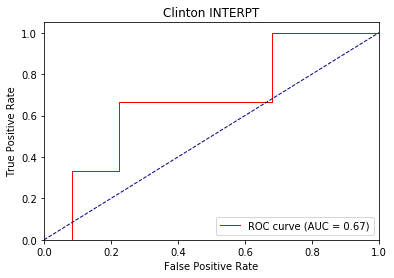

Directory already exists!
hc_interruptions 1 ap tensor([0.9934, 0.0634]) loss : 0.30137139558792114 0.25067257770099993 tid : 400 tg tensor([[0]], device='cuda:0')
hc_interruptions 1 ap tensor([0.9927, 0.1119]) loss : 0.15400421619415283 0.222277208078261 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_interruptions 1 ap tensor([1., 0.]) loss : 0.07137525081634521 0.1803008568914313 tid : 150 tg tensor([[0]], device='cuda:0')
TEST hc_interruptions 1 ap tensor([1., 0.]) loss : 0.06881403923034668 0.17566626920149878 tid : 210 tg tensor([[0]], device='cuda:0')
TEST hc_interruptions 1 ap tensor([0.9844, 0.1316]) loss : 0.12386560440063477 0.2111225705197517 tid : 480 tg tensor([[0]], device='cuda:0')
TEST hc_interruptions 1 ap tensor([0.9861, 0.1107]) loss : 0.24410438537597656 0.206780402133098 tid : 510 tg tensor([[0]], device='cuda:0')
TEST hc_interruptions 1 ap tensor([0.9865, 0.1074]) loss : 0.25391244888305664 0.2062060690801078 tid : 540 tg tensor([[0]], device='cuda:0')


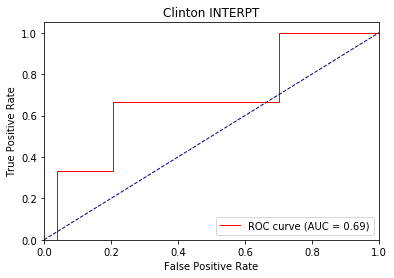

Directory already exists!
hc_interruptions 2 ap tensor([0.9987, 0.2976]) loss : 0.13091212511062622 0.14049887762103283 tid : 400 tg tensor([[0]], device='cuda:0')
hc_interruptions 2 ap tensor([0.9968, 0.1756]) loss : 0.07062661647796631 0.13321833328448515 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_interruptions 2 ap tensor([1., 0.]) loss : 0.03583192825317383 0.10873686796740482 tid : 150 tg tensor([[0]], device='cuda:0')
TEST hc_interruptions 2 ap tensor([1., 0.]) loss : 0.04082369804382324 0.10469391712775597 tid : 210 tg tensor([[0]], device='cuda:0')
TEST hc_interruptions 2 ap tensor([0.9839, 0.1204]) loss : 0.060292601585388184 0.16388522500687458 tid : 480 tg tensor([[0]], device='cuda:0')
TEST hc_interruptions 2 ap tensor([0.9859, 0.1059]) loss : 0.12570405006408691 0.15737942950083658 tid : 510 tg tensor([[0]], device='cuda:0')
TEST hc_interruptions 2 ap tensor([0.9863, 0.1015]) loss : 0.1691068410873413 0.1556659745513846 tid : 540 tg tensor([[0]], device='cuda:0')


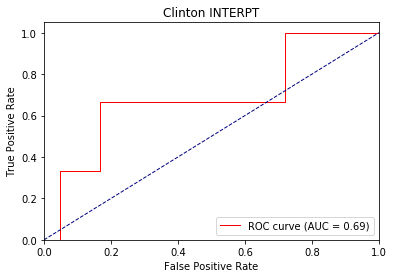

Directory already exists!
hc_lookat2 0 ap tensor([0.8990, 0.9317]) loss : 0.6331526041030884 0.5387458127001765 tid : 200 tg tensor([[0]], device='cuda:0')
hc_lookat2 0 ap tensor([0.8997, 0.9316]) loss : 0.48654821515083313 0.5386091697746547 tid : 400 tg tensor([[0]], device='cuda:0')
TEST hc_lookat2 0 ap tensor([0.8957, 0.7986]) loss : 0.4101610779762268 0.5323030004898707 tid : 60 tg tensor([[1]], device='cuda:0')
TEST hc_lookat2 0 ap tensor([0.9319, 0.8888]) loss : 0.3025156855583191 0.47485088888141846 tid : 210 tg tensor([[1]], device='cuda:0')
TEST hc_lookat2 0 ap tensor([0.9465, 0.9149]) loss : 0.3112160563468933 0.4539917164378696 tid : 240 tg tensor([[0]], device='cuda:0')
TEST hc_lookat2 0 ap tensor([0.9026, 0.8588]) loss : 0.3341481685638428 0.5096164625811289 tid : 390 tg tensor([[1]], device='cuda:0')
TEST hc_lookat2 0 ap tensor([0.9000, 0.8695]) loss : 0.2929795980453491 0.5086112420809896 tid : 450 tg tensor([[1]], device='cuda:0')
TEST hc_lookat2 0 ap tensor([0.9036, 0

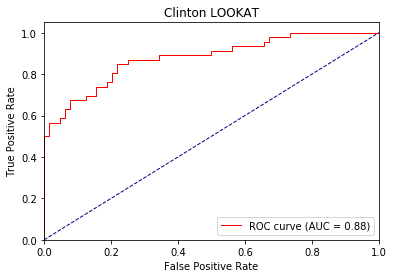

Directory already exists!
hc_lookat2 1 ap tensor([0.9685, 0.9784]) loss : 0.5572837591171265 0.3972244176036077 tid : 200 tg tensor([[0]], device='cuda:0')
hc_lookat2 1 ap tensor([0.9782, 0.9790]) loss : 0.3516579270362854 0.37998051604433875 tid : 400 tg tensor([[0]], device='cuda:0')
TEST hc_lookat2 1 ap tensor([0.8228, 0.7784]) loss : 0.26007717847824097 0.5001561765869459 tid : 60 tg tensor([[1]], device='cuda:0')
TEST hc_lookat2 1 ap tensor([0.9144, 0.9021]) loss : 0.18185651302337646 0.4105444120036231 tid : 210 tg tensor([[1]], device='cuda:0')
TEST hc_lookat2 1 ap tensor([0.9335, 0.9226]) loss : 0.17750507593154907 0.37755752669440373 tid : 240 tg tensor([[0]], device='cuda:0')
TEST hc_lookat2 1 ap tensor([0.9066, 0.8656]) loss : 0.18512487411499023 0.4463593776685646 tid : 390 tg tensor([[1]], device='cuda:0')
TEST hc_lookat2 1 ap tensor([0.9059, 0.8771]) loss : 0.15288829803466797 0.44480078188996564 tid : 450 tg tensor([[1]], device='cuda:0')
TEST hc_lookat2 1 ap tensor([0.9

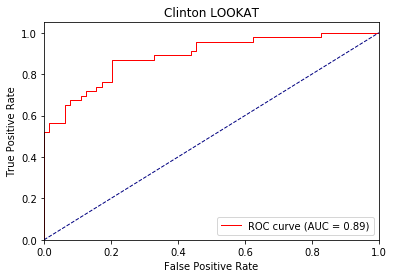

Directory already exists!
hc_lookat2 2 ap tensor([1., 1.]) loss : 0.3038065433502197 0.34536826610565186 tid : 400 tg tensor([[0]], device='cuda:0')
hc_lookat2 2 ap tensor([0.9567, 0.9641]) loss : 0.3859156370162964 0.3228025206739141 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_lookat2 2 ap tensor([0.7603, 0.7708]) loss : 0.18757855892181396 0.49645256996154785 tid : 60 tg tensor([[1]], device='cuda:0')
TEST hc_lookat2 2 ap tensor([0.8956, 0.8984]) loss : 0.12226724624633789 0.3851257132159339 tid : 210 tg tensor([[1]], device='cuda:0')
TEST hc_lookat2 2 ap tensor([0.9097, 0.9190]) loss : 0.11285293102264404 0.34358106785350373 tid : 240 tg tensor([[0]], device='cuda:0')
TEST hc_lookat2 2 ap tensor([0.8938, 0.8662]) loss : 0.12253856658935547 0.42148242657443125 tid : 390 tg tensor([[1]], device='cuda:0')
TEST hc_lookat2 2 ap tensor([0.8951, 0.8775]) loss : 0.09472465515136719 0.41852132803515385 tid : 450 tg tensor([[1]], device='cuda:0')
TEST hc_lookat2 2 ap tensor([0.9016, 0

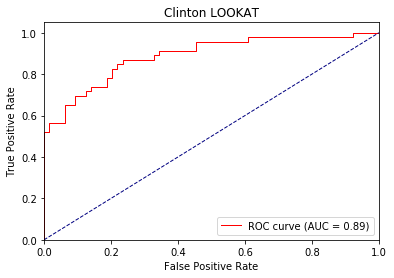

Directory already exists!
hc_brush1 0 ap tensor([0.9579, 0.1531]) loss : 0.5174620747566223 0.7417562560419019 tid : 400 tg tensor([[0]], device='cuda:0')
hc_brush1 0 ap tensor([0.9222, 0.1850]) loss : 0.4694015383720398 0.6648909351391386 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_brush1 0 ap tensor([0.9650, 0.2000]) loss : 0.48489516973495483 0.43628506859143573 tid : 60 tg tensor([[0]], device='cuda:0')
TEST hc_brush1 0 ap tensor([0.9716, 0.4375]) loss : 0.6814818978309631 0.45533786217371625 tid : 210 tg tensor([[1]], device='cuda:0')
TEST hc_brush1 0 ap tensor([0.9766, 0.2776]) loss : 0.2573833465576172 0.4478931188583374 tid : 240 tg tensor([[0]], device='cuda:0')
TEST hc_brush1 0 ap tensor([0.9357, 0.2565]) loss : 0.4910978674888611 0.49200043082237244 tid : 390 tg tensor([[0]], device='cuda:0')
TEST hc_brush1 0 ap tensor([0.9380, 0.2462]) loss : 0.48123401403427124 0.488484493682259 tid : 450 tg tensor([[0]], device='cuda:0')
TEST hc_brush1 0 ap tensor([0.9400, 0.3323]

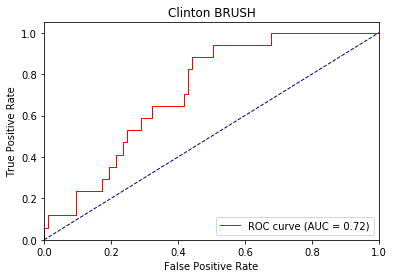

Directory already exists!
hc_brush1 1 ap tensor([0.9423, 0.1908]) loss : 0.24769335985183716 0.4638575602679363 tid : 200 tg tensor([[0]], device='cuda:0')
hc_brush1 1 ap tensor([0.9432, 0.1908]) loss : 0.2041887640953064 0.46217156922230956 tid : 400 tg tensor([[0]], device='cuda:0')
TEST hc_brush1 1 ap tensor([0.9842, 0.3333]) loss : 0.29752421379089355 0.3350748121738434 tid : 60 tg tensor([[0]], device='cuda:0')
TEST hc_brush1 1 ap tensor([0.9681, 0.2696]) loss : 0.9882814884185791 0.36823103328545886 tid : 210 tg tensor([[1]], device='cuda:0')
TEST hc_brush1 1 ap tensor([0.9752, 0.2178]) loss : 0.14822626113891602 0.3467141025596195 tid : 240 tg tensor([[0]], device='cuda:0')
TEST hc_brush1 1 ap tensor([0.9376, 0.2544]) loss : 0.2804921865463257 0.4268512348812747 tid : 390 tg tensor([[0]], device='cuda:0')
TEST hc_brush1 1 ap tensor([0.9409, 0.2534]) loss : 0.2698374390602112 0.4167164686479067 tid : 450 tg tensor([[0]], device='cuda:0')
TEST hc_brush1 1 ap tensor([0.9422, 0.2933

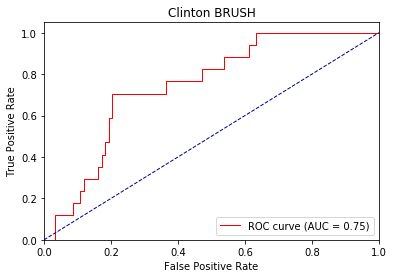

Directory already exists!
hc_brush1 2 ap tensor([0.9495, 0.2421]) loss : 0.13132703304290771 0.38737365100290866 tid : 400 tg tensor([[0]], device='cuda:0')
hc_brush1 2 ap tensor([0.9500, 0.2550]) loss : 0.15458273887634277 0.38929097866823553 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_brush1 2 ap tensor([0.9842, 0.3333]) loss : 0.22306114435195923 0.2935073524713516 tid : 60 tg tensor([[0]], device='cuda:0')
TEST hc_brush1 2 ap tensor([0.9674, 0.2452]) loss : 1.203441858291626 0.33317439754803974 tid : 210 tg tensor([[1]], device='cuda:0')
TEST hc_brush1 2 ap tensor([0.9753, 0.2095]) loss : 0.0945051908493042 0.3045611580212911 tid : 240 tg tensor([[0]], device='cuda:0')
TEST hc_brush1 2 ap tensor([0.9374, 0.2526]) loss : 0.21045160293579102 0.4086413110595152 tid : 390 tg tensor([[0]], device='cuda:0')
TEST hc_brush1 2 ap tensor([0.9404, 0.2504]) loss : 0.19860810041427612 0.3949483971846731 tid : 450 tg tensor([[0]], device='cuda:0')
TEST hc_brush1 2 ap tensor([0.9416, 0.29

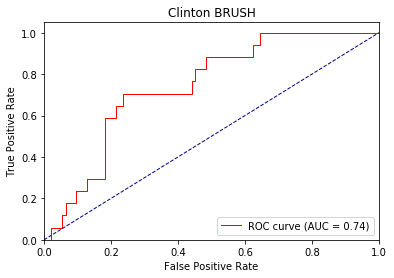

Directory already exists!
hc_nvdis1 0 ap tensor([0.9643, 0.2018]) loss : 0.46912881731987 0.546665006401864 tid : 400 tg tensor([[0]], device='cuda:0')
hc_nvdis1 0 ap tensor([0.9626, 0.2432]) loss : 0.3043309152126312 0.48026456760393604 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_nvdis1 0 ap tensor([0.6971, 0.4639]) loss : 1.501786470413208 0.7508094509442648 tid : 60 tg tensor([[1]], device='cuda:0')
TEST hc_nvdis1 0 ap tensor([0.7582, 0.4325]) loss : 0.22962474822998047 0.6432151951723628 tid : 210 tg tensor([[0]], device='cuda:0')
TEST hc_nvdis1 0 ap tensor([0.8185, 0.3920]) loss : 0.39139533042907715 0.5759915769100189 tid : 240 tg tensor([[0]], device='cuda:0')
TEST hc_nvdis1 0 ap tensor([0.8595, 0.3518]) loss : 0.23207837343215942 0.5319814455796437 tid : 390 tg tensor([[0]], device='cuda:0')
TEST hc_nvdis1 0 ap tensor([0.8792, 0.3573]) loss : 0.225946307182312 0.5090156351265155 tid : 450 tg tensor([[0]], device='cuda:0')
TEST hc_nvdis1 0 ap tensor([0.8872, 0.3422]) los

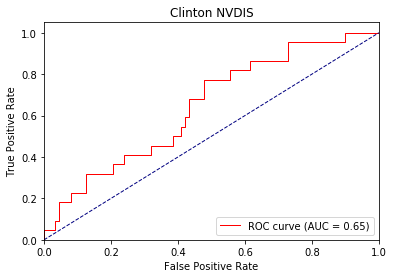

Directory already exists!
hc_nvdis1 1 ap tensor([0.9498, 0.3455]) loss : 0.2214394211769104 0.36026090214547424 tid : 200 tg tensor([[0]], device='cuda:0')
hc_nvdis1 1 ap tensor([0.9513, 0.4414]) loss : 0.16614937782287598 0.3466157173703176 tid : 400 tg tensor([[0]], device='cuda:0')
TEST hc_nvdis1 1 ap tensor([0.6294, 0.4215]) loss : 1.9088395833969116 0.857886920372645 tid : 60 tg tensor([[1]], device='cuda:0')
TEST hc_nvdis1 1 ap tensor([0.7565, 0.4163]) loss : 0.1512143611907959 0.6972884916596942 tid : 210 tg tensor([[0]], device='cuda:0')
TEST hc_nvdis1 1 ap tensor([0.8217, 0.3732]) loss : 0.22432130575180054 0.5939960214826796 tid : 240 tg tensor([[0]], device='cuda:0')
TEST hc_nvdis1 1 ap tensor([0.8762, 0.3459]) loss : 0.1320199966430664 0.5287651775113071 tid : 390 tg tensor([[0]], device='cuda:0')
TEST hc_nvdis1 1 ap tensor([0.8944, 0.3506]) loss : 0.13222408294677734 0.4935562343973863 tid : 450 tg tensor([[0]], device='cuda:0')
TEST hc_nvdis1 1 ap tensor([0.9006, 0.3350])

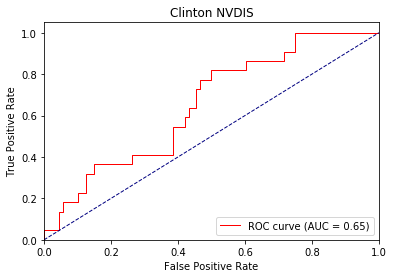

Directory already exists!
hc_nvdis1 2 ap tensor([0.9614, 0.5271]) loss : 0.12554609775543213 0.3175591907106844 tid : 400 tg tensor([[0]], device='cuda:0')
hc_nvdis1 2 ap tensor([0.9665, 0.4446]) loss : 0.11791956424713135 0.29074067046057506 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_nvdis1 2 ap tensor([0.6192, 0.4119]) loss : 2.1880459785461426 0.9759328116973242 tid : 60 tg tensor([[1]], device='cuda:0')
TEST hc_nvdis1 2 ap tensor([0.7786, 0.3997]) loss : 0.11946743726730347 0.7738136516677009 tid : 210 tg tensor([[0]], device='cuda:0')
TEST hc_nvdis1 2 ap tensor([0.8333, 0.3552]) loss : 0.1369580626487732 0.6435574955410428 tid : 240 tg tensor([[0]], device='cuda:0')
TEST hc_nvdis1 2 ap tensor([0.8787, 0.3376]) loss : 0.0917673110961914 0.5574459469462015 tid : 390 tg tensor([[0]], device='cuda:0')
TEST hc_nvdis1 2 ap tensor([0.8973, 0.3477]) loss : 0.09500336647033691 0.5134709157441791 tid : 450 tg tensor([[0]], device='cuda:0')
TEST hc_nvdis1 2 ap tensor([0.9026, 0.3325

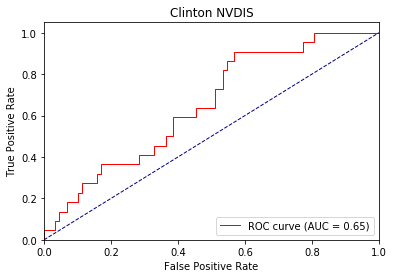

Directory already exists!
hc_look 0 ap tensor([0.5060, 0.5549]) loss : 0.8038929104804993 0.7005813386705186 tid : 200 tg tensor([[1]], device='cuda:0')
hc_look 0 ap tensor([0.6353, 0.8983]) loss : 0.5833656787872314 0.6400205583164567 tid : 400 tg tensor([[1]], device='cuda:0')
TEST hc_look 0 ap tensor([0.0909, 0.8543]) loss : 1.0082281827926636 0.6133689731359482 tid : 60 tg tensor([[1]], device='cuda:0')
TEST hc_look 0 ap tensor([0.6301, 0.9619]) loss : 0.4996337592601776 0.5484549891617563 tid : 210 tg tensor([[0]], device='cuda:0')
TEST hc_look 0 ap tensor([0.6268, 0.9654]) loss : 0.45461246371269226 0.5437626851929559 tid : 240 tg tensor([[1]], device='cuda:0')
TEST hc_look 0 ap tensor([0.4953, 0.9474]) loss : 0.8569868803024292 0.569131254072649 tid : 390 tg tensor([[1]], device='cuda:0')
TEST hc_look 0 ap tensor([0.5269, 0.9485]) loss : 0.487393319606781 0.5698109987534975 tid : 450 tg tensor([[0]], device='cuda:0')
TEST hc_look 0 ap tensor([0.5380, 0.9427]) loss : 0.9401633143

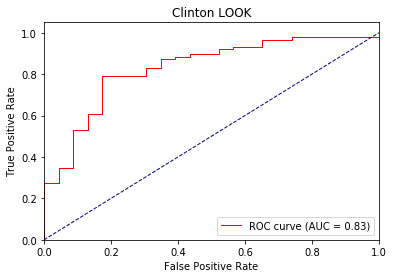

Directory already exists!
hc_look 1 ap tensor([0.6250, 0.9405]) loss : 0.47860682010650635 0.5417465444873361 tid : 400 tg tensor([[1]], device='cuda:0')
hc_look 1 ap tensor([0.7947, 0.9497]) loss : 0.41427329182624817 0.521256791220771 tid : 200 tg tensor([[1]], device='cuda:0')
TEST hc_look 1 ap tensor([0.1667, 0.9536]) loss : 1.0571379661560059 0.5172280843059222 tid : 60 tg tensor([[1]], device='cuda:0')
TEST hc_look 1 ap tensor([0.8681, 0.9863]) loss : 0.42657941579818726 0.4354156462682618 tid : 210 tg tensor([[0]], device='cuda:0')
TEST hc_look 1 ap tensor([0.8820, 0.9889]) loss : 0.21817553043365479 0.4264028363757663 tid : 240 tg tensor([[1]], device='cuda:0')
TEST hc_look 1 ap tensor([0.5691, 0.9565]) loss : 0.9124001860618591 0.476585718881653 tid : 390 tg tensor([[1]], device='cuda:0')
TEST hc_look 1 ap tensor([0.5890, 0.9549]) loss : 0.40105634927749634 0.4822134322241733 tid : 450 tg tensor([[0]], device='cuda:0')
TEST hc_look 1 ap tensor([0.6035, 0.9520]) loss : 1.107382

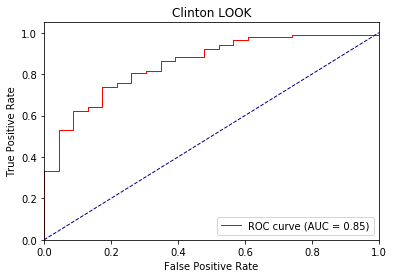

Directory already exists!
hc_look 2 ap tensor([0., 1.]) loss : 0.32094860076904297 0.3397315591573715 tid : 200 tg tensor([[1]], device='cuda:0')
hc_look 2 ap tensor([0.8037, 0.9667]) loss : 0.23332524299621582 0.42185748457290967 tid : 400 tg tensor([[1]], device='cuda:0')
TEST hc_look 2 ap tensor([0.2500, 0.9751]) loss : 1.0903452634811401 0.4678683827320735 tid : 60 tg tensor([[1]], device='cuda:0')
TEST hc_look 2 ap tensor([0.9048, 0.9902]) loss : 0.3734225332736969 0.36987243841091794 tid : 210 tg tensor([[0]], device='cuda:0')
TEST hc_look 2 ap tensor([0.9338, 0.9928]) loss : 0.13305258750915527 0.35900954471694096 tid : 240 tg tensor([[1]], device='cuda:0')
TEST hc_look 2 ap tensor([0.5968, 0.9586]) loss : 0.9529803991317749 0.42724080724888536 tid : 390 tg tensor([[1]], device='cuda:0')
TEST hc_look 2 ap tensor([0.6093, 0.9565]) loss : 0.3423282504081726 0.4352167942022022 tid : 450 tg tensor([[0]], device='cuda:0')
TEST hc_look 2 ap tensor([0.6221, 0.9544]) loss : 1.2116781473

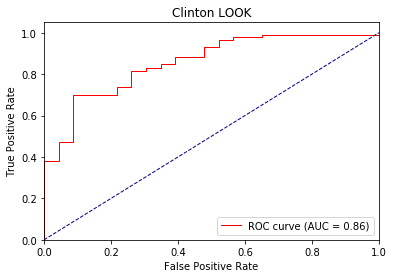

Directory already exists!
hc_eyebrow 0 ap tensor([0.6466, 0.3037]) loss : 0.558529257774353 0.6780575705056935 tid : 400 tg tensor([[0]], device='cuda:0')
hc_eyebrow 0 ap tensor([0.7578, 0.3878]) loss : 0.8310711979866028 0.6501565792041117 tid : 200 tg tensor([[1]], device='cuda:0')
TEST hc_eyebrow 0 ap tensor([0.8433, 0.7407]) loss : 0.434439480304718 0.6430585061510404 tid : 60 tg tensor([[0]], device='cuda:0')
TEST hc_eyebrow 0 ap tensor([0.8520, 0.6359]) loss : 0.3945329189300537 0.6019677329394553 tid : 210 tg tensor([[0]], device='cuda:0')
TEST hc_eyebrow 0 ap tensor([0.8627, 0.5853]) loss : 0.7716789245605469 0.597261518239975 tid : 240 tg tensor([[1]], device='cuda:0')
TEST hc_eyebrow 0 ap tensor([0.8808, 0.4871]) loss : 0.266468346118927 0.5920262124883123 tid : 390 tg tensor([[0]], device='cuda:0')
TEST hc_eyebrow 0 ap tensor([0.8933, 0.4570]) loss : 0.2799798846244812 0.5841788310753672 tid : 450 tg tensor([[0]], device='cuda:0')
TEST hc_eyebrow 0 ap tensor([0.8978, 0.3971]

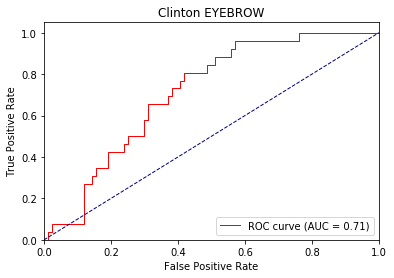

Directory already exists!
hc_eyebrow 1 ap tensor([1., 0.]) loss : 0.6320768594741821 0.5886080165704092 tid : 400 tg tensor([[0]], device='cuda:0')
hc_eyebrow 1 ap tensor([0.9438, 0.3281]) loss : 0.8705781102180481 0.5128171727424715 tid : 200 tg tensor([[1]], device='cuda:0')
TEST hc_eyebrow 1 ap tensor([0.7933, 0.7296]) loss : 0.27632462978363037 0.5886481727162997 tid : 60 tg tensor([[0]], device='cuda:0')
TEST hc_eyebrow 1 ap tensor([0.8875, 0.7985]) loss : 0.2509138584136963 0.5360070086187787 tid : 210 tg tensor([[0]], device='cuda:0')
TEST hc_eyebrow 1 ap tensor([0.8865, 0.7304]) loss : 0.5730991363525391 0.5425322572390239 tid : 240 tg tensor([[1]], device='cuda:0')
TEST hc_eyebrow 1 ap tensor([0.9035, 0.6584]) loss : 0.1506643295288086 0.5515161429543093 tid : 390 tg tensor([[0]], device='cuda:0')
TEST hc_eyebrow 1 ap tensor([0.9150, 0.6392]) loss : 0.14039194583892822 0.5423306590632389 tid : 450 tg tensor([[0]], device='cuda:0')
TEST hc_eyebrow 1 ap tensor([0.9177, 0.5963]) 

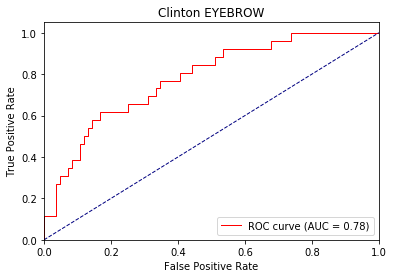

Directory already exists!
hc_eyebrow 2 ap tensor([0.8333, 0.5000]) loss : 0.7570368051528931 0.5746631622314453 tid : 400 tg tensor([[0]], device='cuda:0')
hc_eyebrow 2 ap tensor([0.9489, 0.7740]) loss : 0.7973229885101318 0.4374724460021634 tid : 200 tg tensor([[1]], device='cuda:0')
TEST hc_eyebrow 2 ap tensor([0.8009, 0.8010]) loss : 0.19237607717514038 0.5609080195426941 tid : 60 tg tensor([[0]], device='cuda:0')
TEST hc_eyebrow 2 ap tensor([0.8921, 0.8272]) loss : 0.15458929538726807 0.49905353205071556 tid : 210 tg tensor([[0]], device='cuda:0')
TEST hc_eyebrow 2 ap tensor([0.8898, 0.7642]) loss : 0.43918395042419434 0.5153542564974891 tid : 240 tg tensor([[1]], device='cuda:0')
TEST hc_eyebrow 2 ap tensor([0.9053, 0.6870]) loss : 0.09643042087554932 0.536306889301323 tid : 390 tg tensor([[0]], device='cuda:0')
TEST hc_eyebrow 2 ap tensor([0.9166, 0.6664]) loss : 0.08457911014556885 0.5259313617881975 tid : 450 tg tensor([[0]], device='cuda:0')
TEST hc_eyebrow 2 ap tensor([0.9203

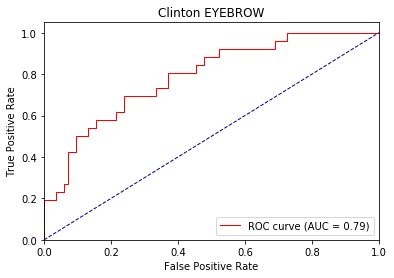

Directory already exists!
hc_atface 0 ap tensor([0.9215, 0.1175]) loss : 0.9031060934066772 0.5796369760535484 tid : 200 tg tensor([[1]], device='cuda:0')
hc_atface 0 ap tensor([0.9337, 0.1670]) loss : 0.5716129541397095 0.5507815197992176 tid : 400 tg tensor([[0]], device='cuda:0')
TEST hc_atface 0 ap tensor([0.9536, 0.1667]) loss : 0.22565847635269165 0.47254833082358044 tid : 60 tg tensor([[0]], device='cuda:0')
TEST hc_atface 0 ap tensor([0.9314, 0.2699]) loss : 0.24523091316223145 0.5032911739415593 tid : 210 tg tensor([[0]], device='cuda:0')
TEST hc_atface 0 ap tensor([0.9338, 0.3464]) loss : 0.822437584400177 0.5051949779192607 tid : 240 tg tensor([[1]], device='cuda:0')
TEST hc_atface 0 ap tensor([0.9295, 0.3629]) loss : 0.18488448858261108 0.5005277093634548 tid : 390 tg tensor([[0]], device='cuda:0')
TEST hc_atface 0 ap tensor([0.9425, 0.3490]) loss : 0.20155471563339233 0.482534132505718 tid : 450 tg tensor([[0]], device='cuda:0')
TEST hc_atface 0 ap tensor([0.9468, 0.3404])

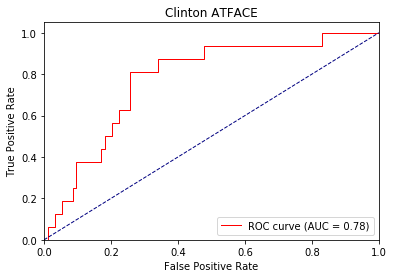

Directory already exists!
hc_atface 1 ap tensor([0.9533, 0.2531]) loss : 0.4273335933685303 0.40956495919273894 tid : 400 tg tensor([[0]], device='cuda:0')
hc_atface 1 ap tensor([0.9547, 0.2506]) loss : 1.3265571594238281 0.40328187299402135 tid : 200 tg tensor([[1]], device='cuda:0')
TEST hc_atface 1 ap tensor([0.9536, 0.1667]) loss : 0.13107550144195557 0.3904520223538081 tid : 60 tg tensor([[0]], device='cuda:0')
TEST hc_atface 1 ap tensor([0.9431, 0.3205]) loss : 0.13507866859436035 0.4358710257543458 tid : 210 tg tensor([[0]], device='cuda:0')
TEST hc_atface 1 ap tensor([0.9451, 0.3998]) loss : 1.0175856351852417 0.4452513926559024 tid : 240 tg tensor([[1]], device='cuda:0')
TEST hc_atface 1 ap tensor([0.9369, 0.4070]) loss : 0.09328317642211914 0.44548155923923816 tid : 390 tg tensor([[0]], device='cuda:0')
TEST hc_atface 1 ap tensor([0.9477, 0.3888]) loss : 0.0945819616317749 0.420810245840173 tid : 450 tg tensor([[0]], device='cuda:0')
TEST hc_atface 1 ap tensor([0.9506, 0.3753

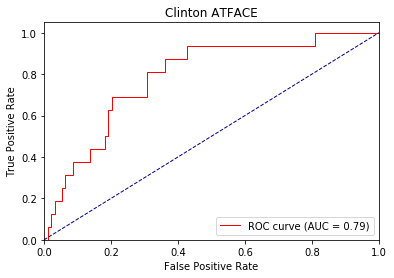

Directory already exists!
hc_atface 2 ap tensor([0.9563, 0.2902]) loss : 1.409447193145752 0.37142226914707704 tid : 200 tg tensor([[1]], device='cuda:0')
hc_atface 2 ap tensor([0.9620, 0.3105]) loss : 0.3563748300075531 0.35935394568418066 tid : 400 tg tensor([[0]], device='cuda:0')
TEST hc_atface 2 ap tensor([0.9406, 0.1429]) loss : 0.0913703441619873 0.3605131233731906 tid : 60 tg tensor([[0]], device='cuda:0')
TEST hc_atface 2 ap tensor([0.9455, 0.3272]) loss : 0.08701419830322266 0.4077320314115948 tid : 210 tg tensor([[0]], device='cuda:0')
TEST hc_atface 2 ap tensor([0.9533, 0.4562]) loss : 1.1532206535339355 0.4198142064942254 tid : 240 tg tensor([[1]], device='cuda:0')
TEST hc_atface 2 ap tensor([0.9423, 0.4658]) loss : 0.059671640396118164 0.42397954988192366 tid : 390 tg tensor([[0]], device='cuda:0')
TEST hc_atface 2 ap tensor([0.9526, 0.4407]) loss : 0.05589485168457031 0.39645409552674543 tid : 450 tg tensor([[0]], device='cuda:0')
TEST hc_atface 2 ap tensor([0.9553, 0.42

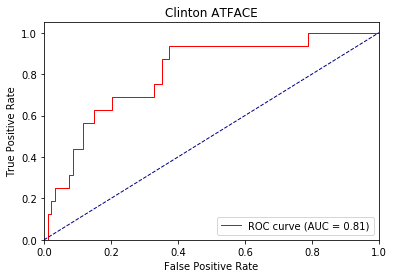

Directory already exists!
hc_feface 0 ap tensor([1., 0.]) loss : 0.6539365649223328 0.7937240388658312 tid : 200 tg tensor([[0]], device='cuda:0')
hc_feface 0 ap tensor([1., 0.]) loss : 0.5470987558364868 0.724035974195663 tid : 400 tg tensor([[0]], device='cuda:0')
TEST hc_feface 0 ap tensor([1., 0.]) loss : 0.3693696856498718 0.4477279757459958 tid : 60 tg tensor([[0]], device='cuda:0')
TEST hc_feface 0 ap tensor([1., 0.]) loss : 0.3947422206401825 0.43592289172940785 tid : 210 tg tensor([[0]], device='cuda:0')
TEST hc_feface 0 ap tensor([1., 0.]) loss : 0.5092308521270752 0.435772000418769 tid : 240 tg tensor([[0]], device='cuda:0')
TEST hc_feface 0 ap tensor([1., 0.]) loss : 0.30038517713546753 0.425048541232764 tid : 390 tg tensor([[0]], device='cuda:0')
TEST hc_feface 0 ap tensor([1., 0.]) loss : 0.2748315930366516 0.42141866087913515 tid : 450 tg tensor([[0]], device='cuda:0')
TEST hc_feface 0 ap tensor([1., 0.]) loss : 0.3774271607398987 0.42111176018621405 tid : 480 tg tensor(

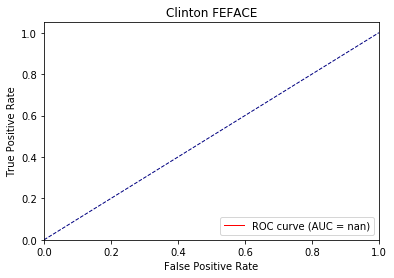

Directory already exists!
hc_feface 1 ap tensor([1., 0.]) loss : 0.3201342821121216 0.3690696187755641 tid : 400 tg tensor([[0]], device='cuda:0')
hc_feface 1 ap tensor([1., 0.]) loss : 0.17497587203979492 0.2950738413859222 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_feface 1 ap tensor([1., 0.]) loss : 0.17080223560333252 0.2196160356203715 tid : 60 tg tensor([[0]], device='cuda:0')
TEST hc_feface 1 ap tensor([1., 0.]) loss : 0.18525326251983643 0.22428201221757466 tid : 210 tg tensor([[0]], device='cuda:0')
TEST hc_feface 1 ap tensor([1., 0.]) loss : 0.27717500925064087 0.22186453011300827 tid : 240 tg tensor([[0]], device='cuda:0')
TEST hc_feface 1 ap tensor([1., 0.]) loss : 0.10896563529968262 0.21087686448212128 tid : 390 tg tensor([[0]], device='cuda:0')
TEST hc_feface 1 ap tensor([1., 0.]) loss : 0.09655547142028809 0.20734847313479374 tid : 450 tg tensor([[0]], device='cuda:0')
TEST hc_feface 1 ap tensor([1., 0.]) loss : 0.15825355052947998 0.20683559337083032 tid : 480

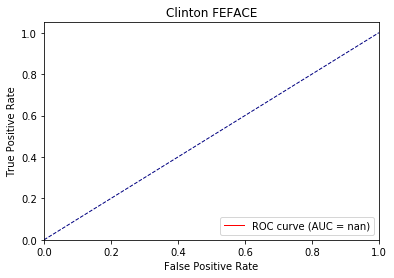

Directory already exists!
hc_feface 2 ap tensor([1., 0.]) loss : 0.06926596164703369 0.14236568320881238 tid : 200 tg tensor([[0]], device='cuda:0')
hc_feface 2 ap tensor([1., 0.]) loss : 0.07491457462310791 0.13187186303346055 tid : 400 tg tensor([[0]], device='cuda:0')
TEST hc_feface 2 ap tensor([1., 0.]) loss : 0.08350050449371338 0.10839881002902985 tid : 60 tg tensor([[0]], device='cuda:0')
TEST hc_feface 2 ap tensor([1., 0.]) loss : 0.09658944606781006 0.12011611958344777 tid : 210 tg tensor([[0]], device='cuda:0')
TEST hc_feface 2 ap tensor([1., 0.]) loss : 0.15115761756896973 0.11693563328848945 tid : 240 tg tensor([[0]], device='cuda:0')
TEST hc_feface 2 ap tensor([1., 0.]) loss : 0.048060059547424316 0.10724755008536649 tid : 390 tg tensor([[0]], device='cuda:0')
TEST hc_feface 2 ap tensor([1., 0.]) loss : 0.04155087471008301 0.1045561621063634 tid : 450 tg tensor([[0]], device='cuda:0')
TEST hc_feface 2 ap tensor([1., 0.]) loss : 0.06435024738311768 0.10391274211453456 tid :

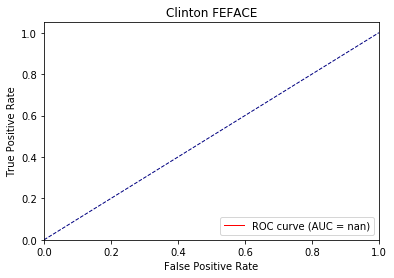

Directory already exists!
hc_hrface 0 ap tensor([0.5038, 0.5227]) loss : 0.872779905796051 0.6970178682372403 tid : 400 tg tensor([[0]], device='cuda:0')
hc_hrface 0 ap tensor([0.4931, 0.5220]) loss : 0.772710382938385 0.6980682800213496 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_hrface 0 ap tensor([0.7127, 0.1389]) loss : 0.7002902030944824 0.7189617951711019 tid : 60 tg tensor([[0]], device='cuda:0')
TEST hc_hrface 0 ap tensor([0.7670, 0.3518]) loss : 0.8708558082580566 0.6921689949101872 tid : 210 tg tensor([[0]], device='cuda:0')
TEST hc_hrface 0 ap tensor([0.7451, 0.4069]) loss : 0.7500753998756409 0.6930337991979387 tid : 240 tg tensor([[0]], device='cuda:0')
TEST hc_hrface 0 ap tensor([0.7445, 0.4915]) loss : 0.647180438041687 0.6807328609816999 tid : 390 tg tensor([[0]], device='cuda:0')
TEST hc_hrface 0 ap tensor([0.7739, 0.5020]) loss : 0.7311158776283264 0.677793495592318 tid : 450 tg tensor([[0]], device='cuda:0')
TEST hc_hrface 0 ap tensor([0.7800, 0.4894]) loss :

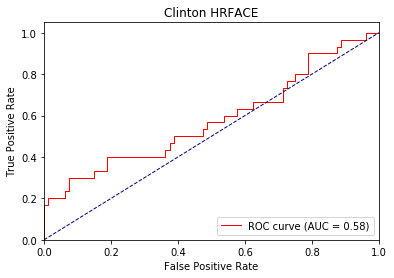

Directory already exists!
hc_hrface 1 ap tensor([0.6861, 0.7520]) loss : 0.7552130222320557 0.6613802643532448 tid : 400 tg tensor([[0]], device='cuda:0')
hc_hrface 1 ap tensor([0.6241, 0.7639]) loss : 0.6878154277801514 0.6559447565078735 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_hrface 1 ap tensor([0.6794, 0.1288]) loss : 0.7018004059791565 0.7099586178859075 tid : 60 tg tensor([[0]], device='cuda:0')
TEST hc_hrface 1 ap tensor([0.7957, 0.4597]) loss : 0.907103955745697 0.6560904027687179 tid : 210 tg tensor([[0]], device='cuda:0')
TEST hc_hrface 1 ap tensor([0.7758, 0.4786]) loss : 0.6086016297340393 0.6574976543585459 tid : 240 tg tensor([[0]], device='cuda:0')
TEST hc_hrface 1 ap tensor([0.7771, 0.5613]) loss : 0.6409202814102173 0.6401506400251963 tid : 390 tg tensor([[0]], device='cuda:0')
TEST hc_hrface 1 ap tensor([0.7961, 0.5460]) loss : 0.7870480418205261 0.6390312016010284 tid : 450 tg tensor([[0]], device='cuda:0')
TEST hc_hrface 1 ap tensor([0.8044, 0.5265]) los

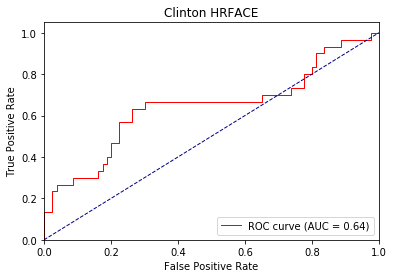

Directory already exists!
hc_hrface 2 ap tensor([0.6784, 0.8420]) loss : 0.6554510593414307 0.6206573310651278 tid : 200 tg tensor([[0]], device='cuda:0')
hc_hrface 2 ap tensor([0.7429, 0.8457]) loss : 0.6034486293792725 0.6067123795562609 tid : 400 tg tensor([[0]], device='cuda:0')
TEST hc_hrface 2 ap tensor([0.7127, 0.1389]) loss : 0.6842949986457825 0.7152049466967583 tid : 60 tg tensor([[0]], device='cuda:0')
TEST hc_hrface 2 ap tensor([0.7806, 0.4822]) loss : 0.9184097051620483 0.6343051791191101 tid : 210 tg tensor([[0]], device='cuda:0')
TEST hc_hrface 2 ap tensor([0.7660, 0.5038]) loss : 0.5230100154876709 0.6349541339609358 tid : 240 tg tensor([[0]], device='cuda:0')
TEST hc_hrface 2 ap tensor([0.7747, 0.5940]) loss : 0.6149697303771973 0.6140016891870154 tid : 390 tg tensor([[0]], device='cuda:0')
TEST hc_hrface 2 ap tensor([0.7946, 0.5870]) loss : 0.826346755027771 0.6150988663497724 tid : 450 tg tensor([[0]], device='cuda:0')
TEST hc_hrface 2 ap tensor([0.8045, 0.5713]) los

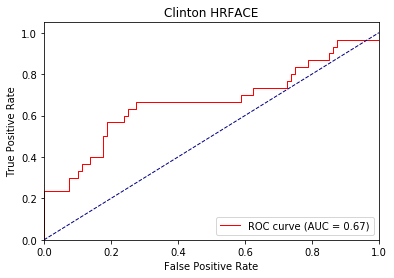

Directory already exists!
hc_saface 0 ap tensor([0.9785, 0.0248]) loss : 0.5355609655380249 0.7032667882339929 tid : 400 tg tensor([[0]], device='cuda:0')
hc_saface 0 ap tensor([0.9887, 0.0182]) loss : 0.4749533534049988 0.6650234936840005 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_saface 0 ap tensor([1., 0.]) loss : 0.33214280009269714 0.30200724055369693 tid : 60 tg tensor([[0]], device='cuda:0')
TEST hc_saface 0 ap tensor([1., 0.]) loss : 0.5488715171813965 0.33552299108770156 tid : 210 tg tensor([[0]], device='cuda:0')
TEST hc_saface 0 ap tensor([1., 0.]) loss : 0.34836146235466003 0.3373577727211846 tid : 240 tg tensor([[0]], device='cuda:0')
TEST hc_saface 0 ap tensor([1., 0.]) loss : 0.2679465413093567 0.316380486430892 tid : 390 tg tensor([[0]], device='cuda:0')
TEST hc_saface 0 ap tensor([1., 0.]) loss : 0.22833949327468872 0.31050592911870856 tid : 450 tg tensor([[0]], device='cuda:0')
TEST hc_saface 0 ap tensor([1., 0.]) loss : 0.21146464347839355 0.3110803988050012

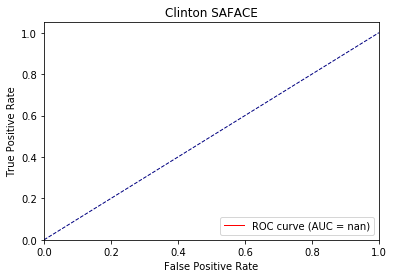

Directory already exists!
hc_saface 1 ap tensor([0.9884, 0.0217]) loss : 0.2352583408355713 0.29152945259521745 tid : 400 tg tensor([[0]], device='cuda:0')
hc_saface 1 ap tensor([0.9900, 0.0275]) loss : 0.15585291385650635 0.2765265812804876 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_saface 1 ap tensor([1., 0.]) loss : 0.1278393268585205 0.169098399579525 tid : 60 tg tensor([[0]], device='cuda:0')
TEST hc_saface 1 ap tensor([1., 0.]) loss : 0.25074005126953125 0.189832903444767 tid : 210 tg tensor([[0]], device='cuda:0')
TEST hc_saface 1 ap tensor([1., 0.]) loss : 0.19532454013824463 0.18632770710521274 tid : 240 tg tensor([[0]], device='cuda:0')
TEST hc_saface 1 ap tensor([1., 0.]) loss : 0.09341847896575928 0.1686002917318459 tid : 390 tg tensor([[0]], device='cuda:0')
TEST hc_saface 1 ap tensor([1., 0.]) loss : 0.07511246204376221 0.16309048909890025 tid : 450 tg tensor([[0]], device='cuda:0')
TEST hc_saface 1 ap tensor([1., 0.]) loss : 0.10121715068817139 0.163390584728297

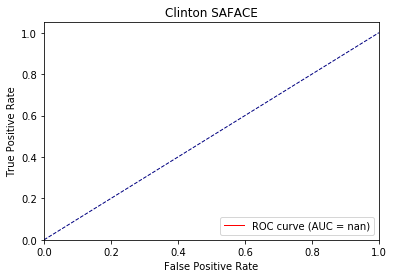

Directory already exists!
hc_saface 2 ap tensor([0.9951, 0.0366]) loss : 0.11237895488739014 0.16412692929423134 tid : 400 tg tensor([[0]], device='cuda:0')
hc_saface 2 ap tensor([0.9792, 0.0350]) loss : 0.06601083278656006 0.17110308594283322 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_saface 2 ap tensor([1., 0.]) loss : 0.05800938606262207 0.10963637133439381 tid : 60 tg tensor([[0]], device='cuda:0')
TEST hc_saface 2 ap tensor([1., 0.]) loss : 0.1303853988647461 0.12383796274662018 tid : 210 tg tensor([[0]], device='cuda:0')
TEST hc_saface 2 ap tensor([1., 0.]) loss : 0.12951314449310303 0.11902802652782864 tid : 240 tg tensor([[0]], device='cuda:0')
TEST hc_saface 2 ap tensor([1., 0.]) loss : 0.041547417640686035 0.10380454882081733 tid : 390 tg tensor([[0]], device='cuda:0')
TEST hc_saface 2 ap tensor([1., 0.]) loss : 0.0339282751083374 0.09926751663810328 tid : 450 tg tensor([[0]], device='cuda:0')
TEST hc_saface 2 ap tensor([1., 0.]) loss : 0.0549389123916626 0.099271627

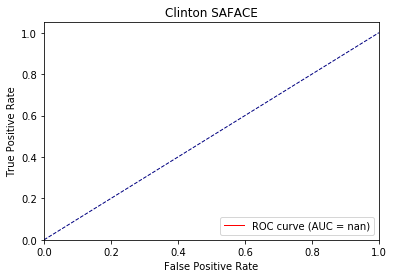

Directory already exists!
hc_neuface 0 ap tensor([0.6627, 0.4179]) loss : 0.5808205604553223 0.6992734054455886 tid : 400 tg tensor([[1]], device='cuda:0')
hc_neuface 0 ap tensor([0.7929, 0.4385]) loss : 0.7050122618675232 0.6681169867515564 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_neuface 0 ap tensor([0.4833, 0.6808]) loss : 0.8692539930343628 0.753852958480517 tid : 60 tg tensor([[1]], device='cuda:0')
TEST hc_neuface 0 ap tensor([0.6601, 0.6354]) loss : 0.7758333086967468 0.6984832849767473 tid : 210 tg tensor([[1]], device='cuda:0')
TEST hc_neuface 0 ap tensor([0.6381, 0.5438]) loss : 0.8974130749702454 0.702303061220381 tid : 240 tg tensor([[0]], device='cuda:0')
TEST hc_neuface 0 ap tensor([0.7043, 0.5485]) loss : 0.7251391410827637 0.6765111340097634 tid : 390 tg tensor([[1]], device='cuda:0')
TEST hc_neuface 0 ap tensor([0.6412, 0.6020]) loss : 0.892905592918396 0.6913482694249404 tid : 450 tg tensor([[1]], device='cuda:0')
TEST hc_neuface 0 ap tensor([0.6377, 0.6186

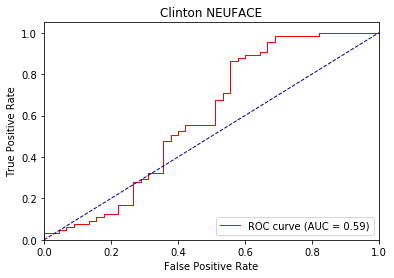

Directory already exists!
hc_neuface 1 ap tensor([0.7330, 0.5659]) loss : 0.6780334115028381 0.6543678579659298 tid : 400 tg tensor([[1]], device='cuda:0')
hc_neuface 1 ap tensor([0.8305, 0.4987]) loss : 0.5960248708724976 0.6357381119817292 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_neuface 1 ap tensor([0.4833, 0.6808]) loss : 0.905042290687561 0.8003184646368027 tid : 60 tg tensor([[1]], device='cuda:0')
TEST hc_neuface 1 ap tensor([0.6591, 0.6559]) loss : 0.8144254684448242 0.7157041140728526 tid : 210 tg tensor([[1]], device='cuda:0')
TEST hc_neuface 1 ap tensor([0.6529, 0.5704]) loss : 0.8163695335388184 0.7098108861181471 tid : 240 tg tensor([[0]], device='cuda:0')
TEST hc_neuface 1 ap tensor([0.7157, 0.5668]) loss : 0.7304205298423767 0.6773367384112025 tid : 390 tg tensor([[1]], device='cuda:0')
TEST hc_neuface 1 ap tensor([0.6477, 0.6194]) loss : 0.9103430509567261 0.7002513308274119 tid : 450 tg tensor([[1]], device='cuda:0')
TEST hc_neuface 1 ap tensor([0.6429, 0.63

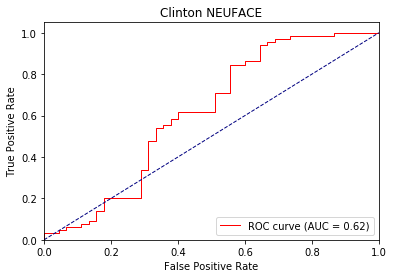

Directory already exists!
hc_neuface 2 ap tensor([0.8445, 0.4009]) loss : 0.773625373840332 0.6207910795365611 tid : 400 tg tensor([[1]], device='cuda:0')
hc_neuface 2 ap tensor([0.8861, 0.5432]) loss : 0.5227652788162231 0.5925613183173395 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_neuface 2 ap tensor([0.4907, 0.6993]) loss : 0.9027646780014038 0.8234859158595403 tid : 60 tg tensor([[1]], device='cuda:0')
TEST hc_neuface 2 ap tensor([0.6662, 0.6869]) loss : 0.8118100166320801 0.7189727872610092 tid : 210 tg tensor([[1]], device='cuda:0')
TEST hc_neuface 2 ap tensor([0.6690, 0.5928]) loss : 0.7719731330871582 0.7077990743849013 tid : 240 tg tensor([[0]], device='cuda:0')
TEST hc_neuface 2 ap tensor([0.7332, 0.5976]) loss : 0.6903270483016968 0.6726586513490562 tid : 390 tg tensor([[1]], device='cuda:0')
TEST hc_neuface 2 ap tensor([0.6634, 0.6467]) loss : 0.875450611114502 0.6993956449784731 tid : 450 tg tensor([[1]], device='cuda:0')
TEST hc_neuface 2 ap tensor([0.6586, 0.661

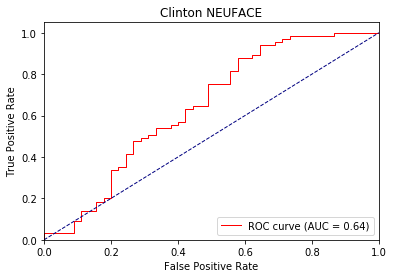

Directory already exists!
hc_inapprop 0 ap tensor([1., 0.]) loss : 0.5923081040382385 0.6288284025495015 tid : 200 tg tensor([[0]], device='cuda:0')
hc_inapprop 0 ap tensor([1., 0.]) loss : 0.4765663743019104 0.5697133293568762 tid : 400 tg tensor([[0]], device='cuda:0')
TEST hc_inapprop 0 ap tensor([1., 0.]) loss : 0.23309731483459473 0.31110185384750366 tid : 60 tg tensor([[0]], device='cuda:0')
TEST hc_inapprop 0 ap tensor([1., 0.]) loss : 0.34994176030158997 0.3086708750989702 tid : 210 tg tensor([[0]], device='cuda:0')
TEST hc_inapprop 0 ap tensor([1., 0.]) loss : 0.2876906096935272 0.30887288318739997 tid : 240 tg tensor([[0]], device='cuda:0')
TEST hc_inapprop 0 ap tensor([1., 0.]) loss : 0.21189332008361816 0.30409547435231954 tid : 390 tg tensor([[0]], device='cuda:0')
TEST hc_inapprop 0 ap tensor([1., 0.]) loss : 0.21649783849716187 0.30195186891053855 tid : 450 tg tensor([[0]], device='cuda:0')
TEST hc_inapprop 0 ap tensor([1., 0.]) loss : 0.358281672000885 0.302646190512414

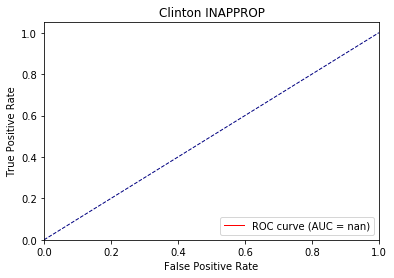

Directory already exists!
hc_inapprop 1 ap tensor([1., 0.]) loss : 0.17092597484588623 0.22308185566153993 tid : 400 tg tensor([[0]], device='cuda:0')
hc_inapprop 1 ap tensor([1., 0.]) loss : 0.11381667852401733 0.207521407466548 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_inapprop 1 ap tensor([1., 0.]) loss : 0.09067690372467041 0.1471799910068512 tid : 60 tg tensor([[0]], device='cuda:0')
TEST hc_inapprop 1 ap tensor([1., 0.]) loss : 0.17967185378074646 0.15489305638604695 tid : 210 tg tensor([[0]], device='cuda:0')
TEST hc_inapprop 1 ap tensor([1., 0.]) loss : 0.14484286308288574 0.15354217953152127 tid : 240 tg tensor([[0]], device='cuda:0')
TEST hc_inapprop 1 ap tensor([1., 0.]) loss : 0.07389330863952637 0.1453300613954843 tid : 390 tg tensor([[0]], device='cuda:0')
TEST hc_inapprop 1 ap tensor([1., 0.]) loss : 0.07120227813720703 0.14244740072049591 tid : 450 tg tensor([[0]], device='cuda:0')
TEST hc_inapprop 1 ap tensor([1., 0.]) loss : 0.14637285470962524 0.14279054017

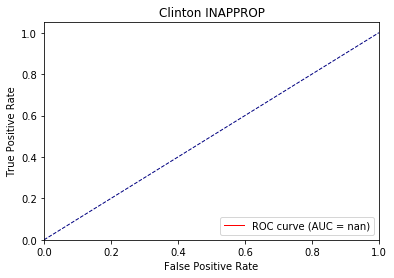

Directory already exists!
hc_inapprop 2 ap tensor([1., 0.]) loss : 0.10478943586349487 0.1168866092744081 tid : 400 tg tensor([[0]], device='cuda:0')
hc_inapprop 2 ap tensor([1., 0.]) loss : 0.05504631996154785 0.10474697069117897 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_inapprop 2 ap tensor([1., 0.]) loss : 0.03797924518585205 0.07106827696164449 tid : 60 tg tensor([[0]], device='cuda:0')
TEST hc_inapprop 2 ap tensor([1., 0.]) loss : 0.0919613242149353 0.08182447817590502 tid : 210 tg tensor([[0]], device='cuda:0')
TEST hc_inapprop 2 ap tensor([1., 0.]) loss : 0.0763501524925232 0.08002510203255547 tid : 240 tg tensor([[0]], device='cuda:0')
TEST hc_inapprop 2 ap tensor([1., 0.]) loss : 0.03059554100036621 0.07267615019556987 tid : 390 tg tensor([[0]], device='cuda:0')
TEST hc_inapprop 2 ap tensor([1., 0.]) loss : 0.028555750846862793 0.07027522513740941 tid : 450 tg tensor([[0]], device='cuda:0')
TEST hc_inapprop 2 ap tensor([1., 0.]) loss : 0.05589163303375244 0.070371172

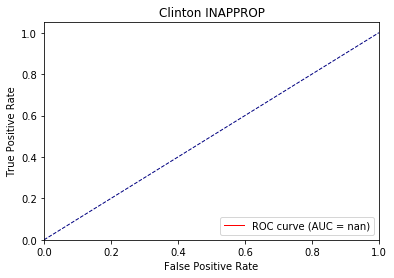

Directory already exists!
hc_affgest 0 ap tensor([1., 1.]) loss : 0.7466453313827515 0.7314832448959351 tid : 400 tg tensor([[0]], device='cuda:0')
hc_affgest 0 ap tensor([0.9732, 0.1158]) loss : 0.5125325918197632 0.6090079968845522 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_affgest 0 ap tensor([1., 0.]) loss : 0.31948286294937134 0.4180767486492793 tid : 60 tg tensor([[0]], device='cuda:0')
TEST hc_affgest 0 ap tensor([1., 0.]) loss : 0.3173294961452484 0.41816817555162644 tid : 210 tg tensor([[0]], device='cuda:0')
TEST hc_affgest 0 ap tensor([1., 0.]) loss : 0.5233868360519409 0.4129006134139167 tid : 240 tg tensor([[0]], device='cuda:0')
TEST hc_affgest 0 ap tensor([0.9957, 0.0385]) loss : 0.2846178412437439 0.4057736784578806 tid : 390 tg tensor([[0]], device='cuda:0')
TEST hc_affgest 0 ap tensor([0.9963, 0.0345]) loss : 0.25096261501312256 0.40030780528721055 tid : 450 tg tensor([[0]], device='cuda:0')
TEST hc_affgest 0 ap tensor([0.9935, 0.0495]) loss : 0.3499930799007

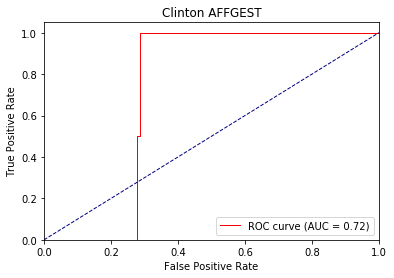

Directory already exists!
hc_affgest 1 ap tensor([0.9755, 0.1884]) loss : 0.3164365887641907 0.39838313444384504 tid : 200 tg tensor([[0]], device='cuda:0')
hc_affgest 1 ap tensor([0.9836, 0.1664]) loss : 0.25554388761520386 0.3369585142436205 tid : 400 tg tensor([[0]], device='cuda:0')
TEST hc_affgest 1 ap tensor([1., 0.]) loss : 0.1589047908782959 0.255705622335275 tid : 60 tg tensor([[0]], device='cuda:0')
TEST hc_affgest 1 ap tensor([1., 0.]) loss : 0.16021466255187988 0.26474564688073265 tid : 210 tg tensor([[0]], device='cuda:0')
TEST hc_affgest 1 ap tensor([1., 0.]) loss : 0.3556065559387207 0.25834921134842764 tid : 240 tg tensor([[0]], device='cuda:0')
TEST hc_affgest 1 ap tensor([0.9967, 0.0476]) loss : 0.12075400352478027 0.2553805439587099 tid : 390 tg tensor([[0]], device='cuda:0')
TEST hc_affgest 1 ap tensor([0.9972, 0.0435]) loss : 0.097328782081604 0.24828424140026695 tid : 450 tg tensor([[0]], device='cuda:0')
TEST hc_affgest 1 ap tensor([0.9949, 0.0608]) loss : 0.1659

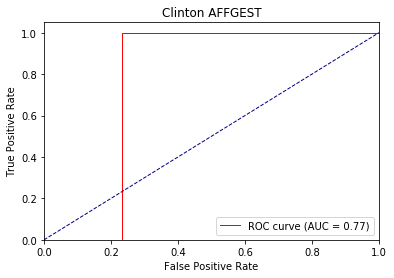

Directory already exists!
hc_affgest 2 ap tensor([0.9824, 0.1962]) loss : 0.1699162721633911 0.248120863273226 tid : 400 tg tensor([[0]], device='cuda:0')
hc_affgest 2 ap tensor([0.9840, 0.1607]) loss : 0.12310278415679932 0.24446522436805607 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_affgest 2 ap tensor([1., 0.]) loss : 0.08812105655670166 0.1802310993274053 tid : 60 tg tensor([[0]], device='cuda:0')
TEST hc_affgest 2 ap tensor([1., 0.]) loss : 0.09469294548034668 0.19112207657761043 tid : 210 tg tensor([[0]], device='cuda:0')
TEST hc_affgest 2 ap tensor([1., 0.]) loss : 0.2748070955276489 0.18486666017108494 tid : 240 tg tensor([[0]], device='cuda:0')
TEST hc_affgest 2 ap tensor([0.9974, 0.0588]) loss : 0.06164348125457764 0.18603443309485193 tid : 390 tg tensor([[0]], device='cuda:0')
TEST hc_affgest 2 ap tensor([0.9979, 0.0556]) loss : 0.051267027854919434 0.178398649316085 tid : 450 tg tensor([[0]], device='cuda:0')
TEST hc_affgest 2 ap tensor([0.9960, 0.0739]) loss : 0.0

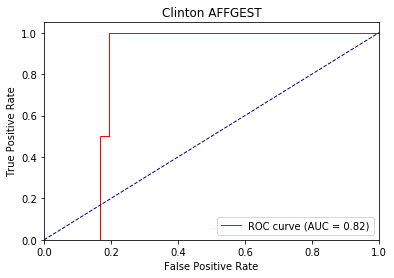

Directory already exists!
hc_defgest 0 ap tensor([0.8645, 0.0675]) loss : 1.0564908981323242 0.6297061431455422 tid : 400 tg tensor([[1]], device='cuda:0')
hc_defgest 0 ap tensor([0.8900, 0.0736]) loss : 0.34692782163619995 0.5872698904393794 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_defgest 0 ap tensor([0.8656, 0.2667]) loss : 0.3914142847061157 0.5188619072238604 tid : 60 tg tensor([[0]], device='cuda:0')
TEST hc_defgest 0 ap tensor([0.8565, 0.2314]) loss : 0.4338124990463257 0.5311502185132768 tid : 210 tg tensor([[0]], device='cuda:0')
TEST hc_defgest 0 ap tensor([0.8270, 0.2311]) loss : 0.40910422801971436 0.55336471663581 tid : 240 tg tensor([[0]], device='cuda:0')
TEST hc_defgest 0 ap tensor([0.8411, 0.2040]) loss : 0.3185161352157593 0.5407658255243876 tid : 390 tg tensor([[0]], device='cuda:0')
TEST hc_defgest 0 ap tensor([0.8579, 0.1868]) loss : 0.31936419010162354 0.528445818863417 tid : 450 tg tensor([[0]], device='cuda:0')
TEST hc_defgest 0 ap tensor([0.8687, 0.1

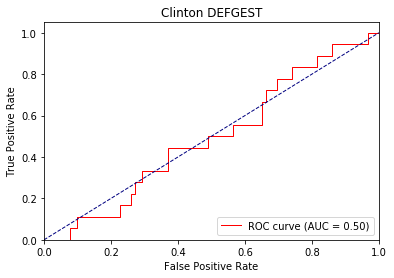

Directory already exists!
hc_defgest 1 ap tensor([0.9144, 0.3036]) loss : 1.2055723667144775 0.5152806103229522 tid : 400 tg tensor([[1]], device='cuda:0')
hc_defgest 1 ap tensor([0.9342, 0.1514]) loss : 0.23187172412872314 0.40783885330484626 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_defgest 1 ap tensor([0.8906, 0.2778]) loss : 0.20328539609909058 0.45520898699760437 tid : 60 tg tensor([[0]], device='cuda:0')
TEST hc_defgest 1 ap tensor([0.9080, 0.2634]) loss : 0.23139309883117676 0.45913471943802303 tid : 210 tg tensor([[0]], device='cuda:0')
TEST hc_defgest 1 ap tensor([0.8958, 0.2874]) loss : 0.2774202525615692 0.4919389691617754 tid : 240 tg tensor([[0]], device='cuda:0')
TEST hc_defgest 1 ap tensor([0.8849, 0.2537]) loss : 0.13649260997772217 0.4840806381530072 tid : 390 tg tensor([[0]], device='cuda:0')
TEST hc_defgest 1 ap tensor([0.8945, 0.2350]) loss : 0.1393359899520874 0.466713452652881 tid : 450 tg tensor([[0]], device='cuda:0')
TEST hc_defgest 1 ap tensor([0.901

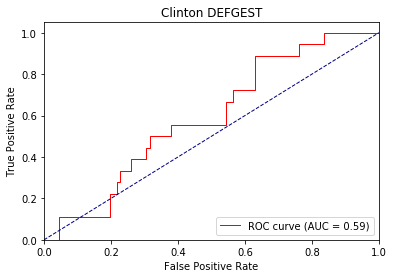

Directory already exists!
hc_defgest 2 ap tensor([0.9696, 0.1879]) loss : 1.5549565553665161 0.33938472217588284 tid : 400 tg tensor([[1]], device='cuda:0')
hc_defgest 2 ap tensor([0.9502, 0.2019]) loss : 0.18198752403259277 0.34214003507683916 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_defgest 2 ap tensor([0.9273, 0.3095]) loss : 0.12249350547790527 0.4347936113675435 tid : 60 tg tensor([[0]], device='cuda:0')
TEST hc_defgest 2 ap tensor([0.9267, 0.2855]) loss : 0.13564836978912354 0.4327283286386066 tid : 210 tg tensor([[0]], device='cuda:0')
TEST hc_defgest 2 ap tensor([0.9096, 0.3009]) loss : 0.23023152351379395 0.47246088054445057 tid : 240 tg tensor([[0]], device='cuda:0')
TEST hc_defgest 2 ap tensor([0.8995, 0.2709]) loss : 0.07160007953643799 0.4684864993555 tid : 390 tg tensor([[0]], device='cuda:0')
TEST hc_defgest 2 ap tensor([0.9070, 0.2521]) loss : 0.07614004611968994 0.44888640516682676 tid : 450 tg tensor([[0]], device='cuda:0')
TEST hc_defgest 2 ap tensor([0.91

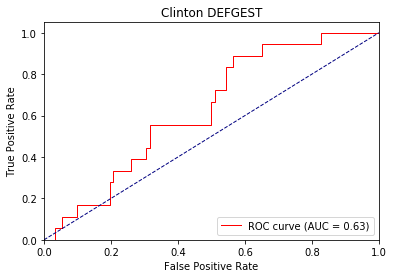

Directory already exists!
hc_agentic 0 ap tensor([0.7901, 0.7614]) loss : 0.6064184308052063 0.6389436485003849 tid : 200 tg tensor([[1]], device='cuda:0')
hc_agentic 0 ap tensor([0.8201, 0.8085]) loss : 0.4965372085571289 0.6253119427411952 tid : 400 tg tensor([[1]], device='cuda:0')
TEST hc_agentic 0 ap tensor([0.8875, 0.9750]) loss : 0.5803109407424927 0.5507033492128054 tid : 60 tg tensor([[0]], device='cuda:0')
TEST hc_agentic 0 ap tensor([0.9691, 0.9831]) loss : 0.3233208656311035 0.5173831176426675 tid : 210 tg tensor([[0]], device='cuda:0')
TEST hc_agentic 0 ap tensor([0.9762, 0.9859]) loss : 0.49406400322914124 0.5138673994276258 tid : 240 tg tensor([[1]], device='cuda:0')
TEST hc_agentic 0 ap tensor([0.9287, 0.9493]) loss : 0.4059034585952759 0.5543558489845459 tid : 390 tg tensor([[0]], device='cuda:0')
TEST hc_agentic 0 ap tensor([0.9298, 0.9391]) loss : 0.40772396326065063 0.5571338534355164 tid : 450 tg tensor([[0]], device='cuda:0')
TEST hc_agentic 0 ap tensor([0.9337, 0

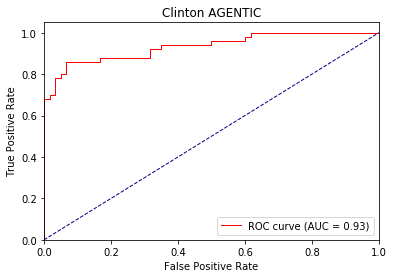

Directory already exists!
hc_agentic 1 ap tensor([0.9542, 0.9182]) loss : 0.5659310817718506 0.4889078085239117 tid : 200 tg tensor([[1]], device='cuda:0')
hc_agentic 1 ap tensor([0.9721, 0.9763]) loss : 0.28882384300231934 0.4279650837976765 tid : 400 tg tensor([[1]], device='cuda:0')
TEST hc_agentic 1 ap tensor([0.8875, 0.9750]) loss : 0.41599589586257935 0.42487988869349164 tid : 60 tg tensor([[0]], device='cuda:0')
TEST hc_agentic 1 ap tensor([0.9720, 0.9858]) loss : 0.18519967794418335 0.38612783120738137 tid : 210 tg tensor([[0]], device='cuda:0')
TEST hc_agentic 1 ap tensor([0.9781, 0.9878]) loss : 0.2922607660293579 0.3887132737371657 tid : 240 tg tensor([[1]], device='cuda:0')
TEST hc_agentic 1 ap tensor([0.9367, 0.9596]) loss : 0.2294827699661255 0.45512751929731254 tid : 390 tg tensor([[0]], device='cuda:0')
TEST hc_agentic 1 ap tensor([0.9422, 0.9523]) loss : 0.1896006464958191 0.4566619330330899 tid : 450 tg tensor([[0]], device='cuda:0')
TEST hc_agentic 1 ap tensor([0.946

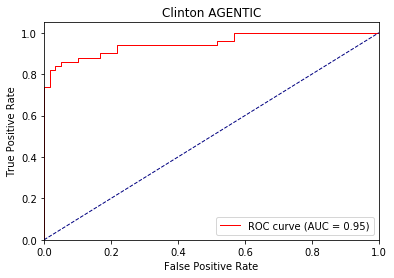

Directory already exists!
hc_agentic 2 ap tensor([0.9756, 0.9717]) loss : 0.3898134231567383 0.33112371387985834 tid : 200 tg tensor([[1]], device='cuda:0')
hc_agentic 2 ap tensor([0.9707, 0.9760]) loss : 0.1909710168838501 0.3237959236255166 tid : 400 tg tensor([[1]], device='cuda:0')
TEST hc_agentic 2 ap tensor([0.8042, 0.9659]) loss : 0.3295632004737854 0.3549438714981079 tid : 60 tg tensor([[0]], device='cuda:0')
TEST hc_agentic 2 ap tensor([0.9608, 0.9831]) loss : 0.113852858543396 0.31248199608590865 tid : 210 tg tensor([[0]], device='cuda:0')
TEST hc_agentic 2 ap tensor([0.9713, 0.9859]) loss : 0.17182815074920654 0.3210886279741923 tid : 240 tg tensor([[1]], device='cuda:0')
TEST hc_agentic 2 ap tensor([0.9377, 0.9625]) loss : 0.14302504062652588 0.4058888396584844 tid : 390 tg tensor([[0]], device='cuda:0')
TEST hc_agentic 2 ap tensor([0.9452, 0.9571]) loss : 0.10163486003875732 0.40431233644485476 tid : 450 tg tensor([[0]], device='cuda:0')
TEST hc_agentic 2 ap tensor([0.9492

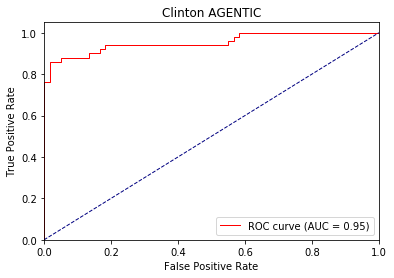

Directory already exists!
hc_waveoff 0 ap tensor([0.8669, 0.7244]) loss : 0.6051723957061768 0.6353454666327586 tid : 400 tg tensor([[1]], device='cuda:0')
hc_waveoff 0 ap tensor([0.9042, 0.6935]) loss : 0.6938727498054504 0.5920325537974184 tid : 200 tg tensor([[1]], device='cuda:0')
TEST hc_waveoff 0 ap tensor([0.8711, 0.8955]) loss : 0.3755529224872589 0.5641156633694967 tid : 60 tg tensor([[0]], device='cuda:0')
TEST hc_waveoff 0 ap tensor([0.8931, 0.6607]) loss : 0.3431103527545929 0.5537945595052507 tid : 210 tg tensor([[0]], device='cuda:0')
TEST hc_waveoff 0 ap tensor([0.8941, 0.6408]) loss : 0.48974278569221497 0.5620926611953312 tid : 240 tg tensor([[1]], device='cuda:0')
TEST hc_waveoff 0 ap tensor([0.8945, 0.6202]) loss : 0.2681613862514496 0.5680568519845066 tid : 390 tg tensor([[0]], device='cuda:0')
TEST hc_waveoff 0 ap tensor([0.9014, 0.6126]) loss : 0.2599000036716461 0.5637645774766018 tid : 450 tg tensor([[0]], device='cuda:0')
TEST hc_waveoff 0 ap tensor([0.9038, 0.

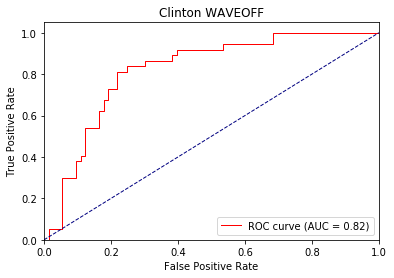

Directory already exists!
hc_waveoff 1 ap tensor([0.9424, 0.7104]) loss : 0.5077645778656006 0.4899020015919974 tid : 400 tg tensor([[1]], device='cuda:0')
hc_waveoff 1 ap tensor([0.9462, 0.7222]) loss : 0.7172548174858093 0.48181313083603466 tid : 200 tg tensor([[1]], device='cuda:0')
TEST hc_waveoff 1 ap tensor([0.8211, 0.8844]) loss : 0.23305541276931763 0.5300742536783218 tid : 60 tg tensor([[0]], device='cuda:0')
TEST hc_waveoff 1 ap tensor([0.8996, 0.6907]) loss : 0.2072576880455017 0.5007732204265065 tid : 210 tg tensor([[0]], device='cuda:0')
TEST hc_waveoff 1 ap tensor([0.9029, 0.6700]) loss : 0.39377444982528687 0.5077029168605804 tid : 240 tg tensor([[1]], device='cuda:0')
TEST hc_waveoff 1 ap tensor([0.8996, 0.6367]) loss : 0.14742648601531982 0.5269148877586227 tid : 390 tg tensor([[0]], device='cuda:0')
TEST hc_waveoff 1 ap tensor([0.9087, 0.6321]) loss : 0.1328132152557373 0.5199034624978116 tid : 450 tg tensor([[0]], device='cuda:0')
TEST hc_waveoff 1 ap tensor([0.9112,

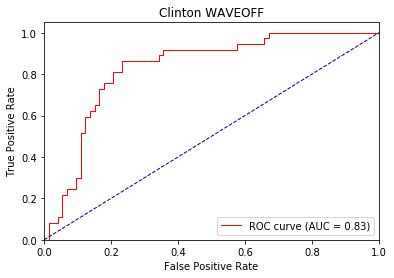

Directory already exists!
hc_waveoff 2 ap tensor([1., 1.]) loss : 0.6756129264831543 0.41223540902137756 tid : 200 tg tensor([[1]], device='cuda:0')
hc_waveoff 2 ap tensor([0.9453, 0.7799]) loss : 0.3849160075187683 0.4197888817874883 tid : 400 tg tensor([[1]], device='cuda:0')
TEST hc_waveoff 2 ap tensor([0.8009, 0.8010]) loss : 0.1573391556739807 0.5178884317477545 tid : 60 tg tensor([[0]], device='cuda:0')
TEST hc_waveoff 2 ap tensor([0.8930, 0.6524]) loss : 0.13900935649871826 0.47259779936737484 tid : 210 tg tensor([[0]], device='cuda:0')
TEST hc_waveoff 2 ap tensor([0.9011, 0.6352]) loss : 0.3341294527053833 0.47878615193896823 tid : 240 tg tensor([[1]], device='cuda:0')
TEST hc_waveoff 2 ap tensor([0.9002, 0.6138]) loss : 0.0890740156173706 0.5084828062947974 tid : 390 tg tensor([[0]], device='cuda:0')
TEST hc_waveoff 2 ap tensor([0.9104, 0.6132]) loss : 0.07674038410186768 0.4987737025085248 tid : 450 tg tensor([[0]], device='cuda:0')
TEST hc_waveoff 2 ap tensor([0.9133, 0.5863

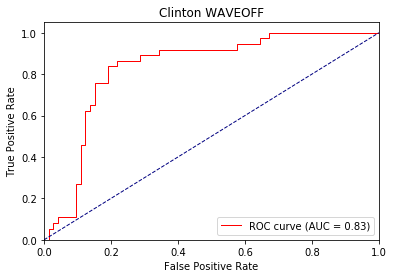

Directory already exists!
hc_nvtic1 0 ap tensor([0.8829, 0.2279]) loss : 0.5473212003707886 0.6643386140465737 tid : 400 tg tensor([[0]], device='cuda:0')
hc_nvtic1 0 ap tensor([0.8917, 0.2213]) loss : 0.6416044235229492 0.6584519122328077 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic1 0 ap tensor([0.9500, 0.5333]) loss : 1.0212576389312744 0.5273244380950928 tid : 60 tg tensor([[1]], device='cuda:0')
TEST hc_nvtic1 0 ap tensor([0.9563, 0.5172]) loss : 1.053483486175537 0.5231767520308495 tid : 210 tg tensor([[1]], device='cuda:0')
TEST hc_nvtic1 0 ap tensor([0.8917, 0.4231]) loss : 0.29643934965133667 0.5370393713315328 tid : 240 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic1 0 ap tensor([0.8741, 0.6168]) loss : 0.4447948634624481 0.5816410621964788 tid : 390 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic1 0 ap tensor([0.8424, 0.5896]) loss : 0.4492523670196533 0.5963408526621367 tid : 450 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic1 0 ap tensor([0.8297, 0.5686]) lo

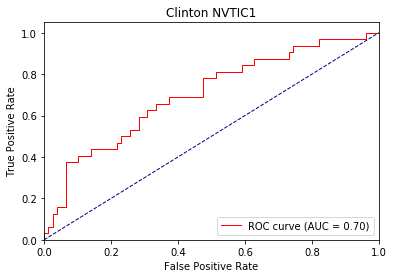

Directory already exists!
hc_nvtic1 1 ap tensor([0.9189, 0.4156]) loss : 0.4345976710319519 0.5047877038067038 tid : 200 tg tensor([[0]], device='cuda:0')
hc_nvtic1 1 ap tensor([0.9273, 0.3147]) loss : 0.2562706470489502 0.47030249374433303 tid : 400 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic1 1 ap tensor([0.9722, 0.6389]) loss : 1.2951326370239258 0.49269190182288486 tid : 60 tg tensor([[1]], device='cuda:0')
TEST hc_nvtic1 1 ap tensor([0.9575, 0.5220]) loss : 1.3060063123703003 0.4768512513902452 tid : 210 tg tensor([[1]], device='cuda:0')
TEST hc_nvtic1 1 ap tensor([0.9035, 0.4503]) loss : 0.17624342441558838 0.49245353738466896 tid : 240 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic1 1 ap tensor([0.8955, 0.5895]) loss : 0.3164064884185791 0.5652129581893783 tid : 390 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic1 1 ap tensor([0.8745, 0.5671]) loss : 0.31596970558166504 0.5863012244826868 tid : 450 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic1 1 ap tensor([0.8690, 0.5463

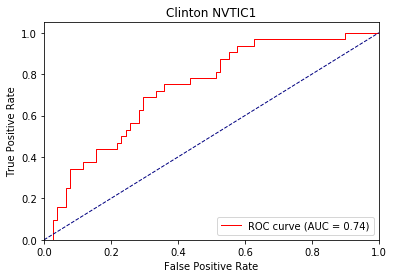

Directory already exists!
hc_nvtic1 2 ap tensor([0.9100, 0.2021]) loss : 0.19634342193603516 0.45642798599498025 tid : 400 tg tensor([[0]], device='cuda:0')
hc_nvtic1 2 ap tensor([0.9109, 0.1909]) loss : 0.26430439949035645 0.44433124674195273 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic1 2 ap tensor([0.9599, 0.5889]) loss : 1.467002511024475 0.48217499256134033 tid : 60 tg tensor([[1]], device='cuda:0')
TEST hc_nvtic1 2 ap tensor([0.9570, 0.5665]) loss : 1.450814962387085 0.45689408315552604 tid : 210 tg tensor([[1]], device='cuda:0')
TEST hc_nvtic1 2 ap tensor([0.9200, 0.4938]) loss : 0.12072634696960449 0.4760808361901177 tid : 240 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic1 2 ap tensor([0.9062, 0.5887]) loss : 0.2653353214263916 0.5649538772651949 tid : 390 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic1 2 ap tensor([0.8886, 0.5753]) loss : 0.2626762390136719 0.5890656684574328 tid : 450 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic1 2 ap tensor([0.8832, 0.5598

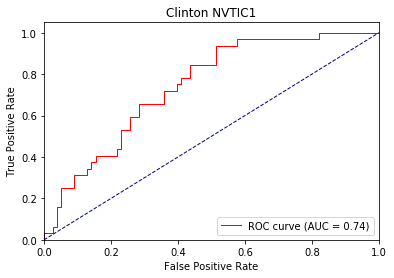

Directory already exists!
hc_nvtic2 0 ap tensor([0.8631, 0.0993]) loss : 0.6824549436569214 0.6655915951622384 tid : 400 tg tensor([[0]], device='cuda:0')
hc_nvtic2 0 ap tensor([0.8625, 0.1395]) loss : 0.6289383172988892 0.6351674646139145 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic2 0 ap tensor([0.9622, 0.4500]) loss : 0.3592360019683838 0.5167335122823715 tid : 60 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic2 0 ap tensor([0.9701, 0.1698]) loss : 0.32401931285858154 0.4754520017239783 tid : 210 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic2 0 ap tensor([0.9766, 0.1427]) loss : 0.5390161871910095 0.4617264217800564 tid : 240 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic2 0 ap tensor([0.9273, 0.1701]) loss : 0.30597740411758423 0.5057532769369791 tid : 390 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic2 0 ap tensor([0.9342, 0.1717]) loss : 0.27984997630119324 0.5011967586843591 tid : 450 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic2 0 ap tensor([0.9065, 0.1781])

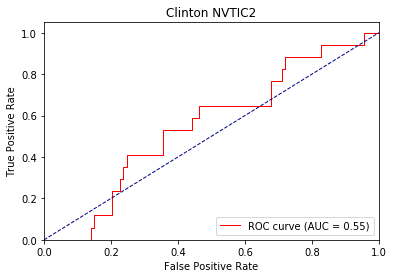

Directory already exists!
hc_nvtic2 1 ap tensor([0.8549, 0.2813]) loss : 0.39350825548171997 0.49377029275490064 tid : 200 tg tensor([[0]], device='cuda:0')
hc_nvtic2 1 ap tensor([0.8640, 0.2778]) loss : 0.3053779602050781 0.4866910085846216 tid : 400 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic2 1 ap tensor([0.9833, 0.5833]) loss : 0.2609330415725708 0.4117806280652682 tid : 60 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic2 1 ap tensor([0.9922, 0.3833]) loss : 0.24804341793060303 0.35569284442398286 tid : 210 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic2 1 ap tensor([0.9951, 0.3833]) loss : 0.3070032000541687 0.33723194466696843 tid : 240 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic2 1 ap tensor([0.9631, 0.3063]) loss : 0.22581154108047485 0.4109743248267346 tid : 390 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic2 1 ap tensor([0.9645, 0.2982]) loss : 0.21165680885314941 0.4058560456100263 tid : 450 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic2 1 ap tensor([0.9511, 0.30

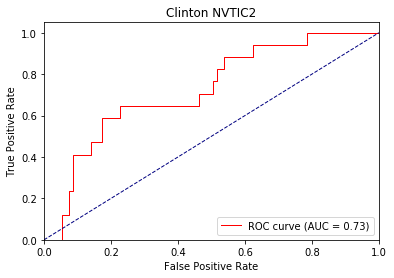

Directory already exists!
hc_nvtic2 2 ap tensor([0.9326, 0.4026]) loss : 0.1773325800895691 0.4087381076644844 tid : 400 tg tensor([[0]], device='cuda:0')
hc_nvtic2 2 ap tensor([0.9333, 0.4014]) loss : 0.2656651735305786 0.40744719800003415 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic2 2 ap tensor([0.9833, 0.5833]) loss : 0.21296197175979614 0.3559262330333392 tid : 60 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic2 2 ap tensor([0.9922, 0.3833]) loss : 0.2068966031074524 0.2904744827085071 tid : 210 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic2 2 ap tensor([0.9951, 0.3833]) loss : 0.17983967065811157 0.2697337097591824 tid : 240 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic2 2 ap tensor([0.9702, 0.3452]) loss : 0.1908758282661438 0.362133818218507 tid : 390 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic2 2 ap tensor([0.9707, 0.3420]) loss : 0.18270915746688843 0.35615003171720006 tid : 450 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic2 2 ap tensor([0.9649, 0.3590]

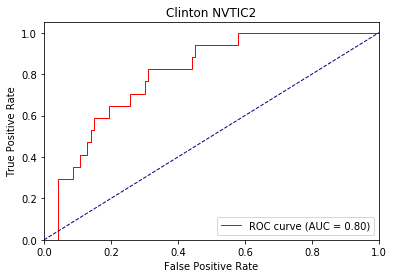

Directory already exists!
hc_nvtic3 0 ap tensor([1., 0.]) loss : 0.49561020731925964 0.523356492175218 tid : 400 tg tensor([[0]], device='cuda:0')
hc_nvtic3 0 ap tensor([1., 0.]) loss : 0.36007484793663025 0.4798302658730083 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic3 0 ap tensor([0.9650, 0.2000]) loss : 0.16055971384048462 0.36461248497168225 tid : 60 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic3 0 ap tensor([0.9874, 0.0714]) loss : 0.1908581256866455 0.3156789466738701 tid : 210 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic3 0 ap tensor([0.9902, 0.0588]) loss : 0.3716775178909302 0.3058755411042107 tid : 240 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic3 0 ap tensor([0.9965, 0.0455]) loss : 0.156113862991333 0.27979217164487724 tid : 390 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic3 0 ap tensor([0.9974, 0.0455]) loss : 0.15308129787445068 0.27473147856561764 tid : 450 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic3 0 ap tensor([0.9977, 0.0455]) loss : 0.2378

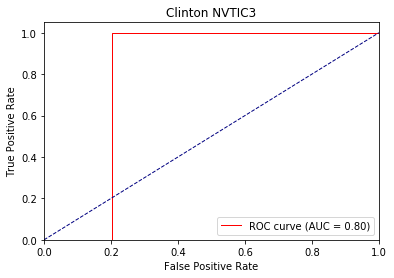

Directory already exists!
hc_nvtic3 1 ap tensor([1., 0.]) loss : 0.15407907962799072 0.2063404915294027 tid : 200 tg tensor([[0]], device='cuda:0')
hc_nvtic3 1 ap tensor([1., 0.]) loss : 0.16369515657424927 0.20141281198254593 tid : 400 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic3 1 ap tensor([0.9536, 0.1667]) loss : 0.06511640548706055 0.2965736389160156 tid : 60 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic3 1 ap tensor([0.9806, 0.0526]) loss : 0.09008920192718506 0.1960419300529692 tid : 210 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic3 1 ap tensor([0.9840, 0.0417]) loss : 0.18334633111953735 0.18030937380260892 tid : 240 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic3 1 ap tensor([0.9936, 0.0286]) loss : 0.05690348148345947 0.14727697602237563 tid : 390 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic3 1 ap tensor([0.9948, 0.0263]) loss : 0.054944515228271484 0.14162796673021819 tid : 450 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic3 1 ap tensor([0.9953, 0.0250]) loss :

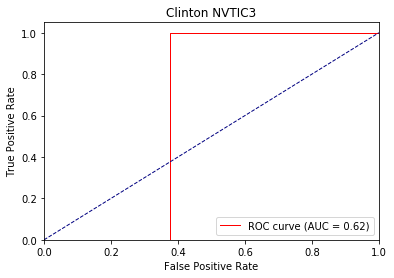

Directory already exists!
hc_nvtic3 2 ap tensor([1., 0.]) loss : 0.09887456893920898 0.10572055407932826 tid : 200 tg tensor([[0]], device='cuda:0')
hc_nvtic3 2 ap tensor([1., 0.]) loss : 0.08730792999267578 0.10244880226942209 tid : 400 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic3 2 ap tensor([0.9406, 0.1429]) loss : 0.031520724296569824 0.30805182456970215 tid : 60 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic3 2 ap tensor([0.9736, 0.0435]) loss : 0.04809534549713135 0.15676599740982056 tid : 210 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic3 2 ap tensor([0.9795, 0.0357]) loss : 0.09896600246429443 0.13665706316630047 tid : 240 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic3 2 ap tensor([0.9909, 0.0222]) loss : 0.025667786598205566 0.09757303473461106 tid : 390 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic3 2 ap tensor([0.9926, 0.0204]) loss : 0.023345232009887695 0.0912772442165174 tid : 450 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic3 2 ap tensor([0.9932, 0.0192]) lo

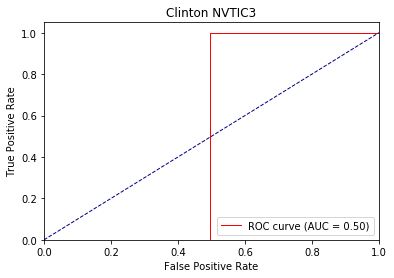

Directory already exists!
hc_nvtic5 0 ap tensor([1., 0.]) loss : 0.5337185859680176 0.6036803258316857 tid : 200 tg tensor([[0]], device='cuda:0')
hc_nvtic5 0 ap tensor([1., 0.]) loss : 0.4084640443325043 0.5753548479342199 tid : 400 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic5 0 ap tensor([1., 0.]) loss : 0.257282018661499 0.28100639084974927 tid : 60 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic5 0 ap tensor([1., 0.]) loss : 0.2459799349308014 0.3095543260375659 tid : 210 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic5 0 ap tensor([1., 0.]) loss : 0.322716623544693 0.3046449581782023 tid : 240 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic5 0 ap tensor([1., 0.]) loss : 0.210893452167511 0.30815972800714425 tid : 390 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic5 0 ap tensor([1., 0.]) loss : 0.22324007749557495 0.30902740202452006 tid : 450 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic5 0 ap tensor([1., 0.]) loss : 0.25431370735168457 0.30905110958744497 tid : 480 tg tenso

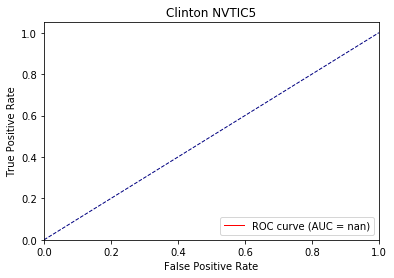

Directory already exists!
hc_nvtic5 1 ap tensor([1., 0.]) loss : 0.22350162267684937 0.27528812521595064 tid : 400 tg tensor([[0]], device='cuda:0')
hc_nvtic5 1 ap tensor([1., 0.]) loss : 0.1125745177268982 0.2014707725267021 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic5 1 ap tensor([1., 0.]) loss : 0.10146760940551758 0.12825000286102295 tid : 60 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic5 1 ap tensor([1., 0.]) loss : 0.10000789165496826 0.158164886964692 tid : 210 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic5 1 ap tensor([1., 0.]) loss : 0.17796415090560913 0.15339699321322972 tid : 240 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic5 1 ap tensor([1., 0.]) loss : 0.07474017143249512 0.1517775604523808 tid : 390 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic5 1 ap tensor([1., 0.]) loss : 0.07370173931121826 0.15060883384001883 tid : 450 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic5 1 ap tensor([1., 0.]) loss : 0.10247886180877686 0.15013468440841227 tid : 480 

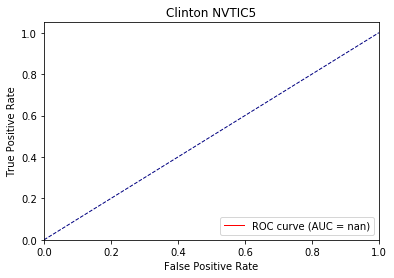

Directory already exists!
hc_nvtic5 2 ap tensor([1., 0.]) loss : 0.07442843914031982 0.11357273808841048 tid : 200 tg tensor([[0]], device='cuda:0')
hc_nvtic5 2 ap tensor([1., 0.]) loss : 0.04884231090545654 0.09495804517456655 tid : 400 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic5 2 ap tensor([1., 0.]) loss : 0.043054819107055664 0.06161955992380778 tid : 60 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic5 2 ap tensor([1., 0.]) loss : 0.0501171350479126 0.08678809056679408 tid : 210 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic5 2 ap tensor([1., 0.]) loss : 0.09531307220458984 0.08255425228012933 tid : 240 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic5 2 ap tensor([1., 0.]) loss : 0.03139698505401611 0.0794524887958205 tid : 390 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic5 2 ap tensor([1., 0.]) loss : 0.02944803237915039 0.07783866430583754 tid : 450 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic5 2 ap tensor([1., 0.]) loss : 0.04306983947753906 0.07730470101038615 tid : 

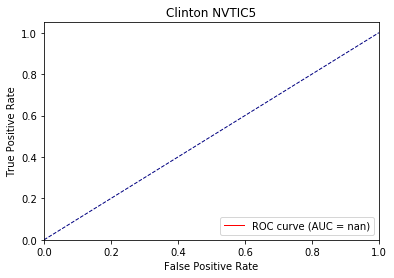

Directory already exists!
hc_nvtic4 0 ap tensor([0.9812, 0.1936]) loss : 0.43869826197624207 0.4985269774304758 tid : 200 tg tensor([[0]], device='cuda:0')
hc_nvtic4 0 ap tensor([0.9916, 0.0572]) loss : 0.27460020780563354 0.3966644376853092 tid : 400 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic4 0 ap tensor([1., 0.]) loss : 0.16536158323287964 0.25550952057043713 tid : 60 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic4 0 ap tensor([1., 0.]) loss : 0.19751602411270142 0.272479557328754 tid : 210 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic4 0 ap tensor([1., 0.]) loss : 0.31663277745246887 0.2664657824569278 tid : 240 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic4 0 ap tensor([1., 0.]) loss : 0.14385807514190674 0.2555005187729755 tid : 390 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic4 0 ap tensor([1., 0.]) loss : 0.13188862800598145 0.25173301100730894 tid : 450 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic4 0 ap tensor([1., 0.]) loss : 0.21839696168899536 0.2521386152389

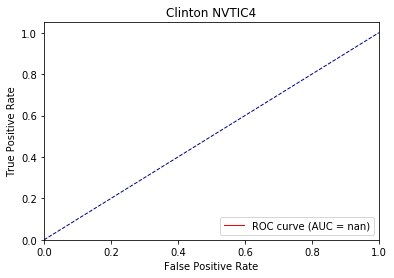

Directory already exists!
hc_nvtic4 1 ap tensor([0.9796, 0.0427]) loss : 0.18736612796783447 0.2555563114221814 tid : 200 tg tensor([[0]], device='cuda:0')
hc_nvtic4 1 ap tensor([0.9876, 0.0618]) loss : 0.11354517936706543 0.20864293020177674 tid : 400 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic4 1 ap tensor([1., 0.]) loss : 0.0802617073059082 0.12813051044940948 tid : 60 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic4 1 ap tensor([1., 0.]) loss : 0.10434198379516602 0.14723243481583065 tid : 210 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic4 1 ap tensor([1., 0.]) loss : 0.13591235876083374 0.14121519856982762 tid : 240 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic4 1 ap tensor([1., 0.]) loss : 0.062348008155822754 0.13221125933061162 tid : 390 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic4 1 ap tensor([1., 0.]) loss : 0.05691659450531006 0.12964218729420712 tid : 450 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic4 1 ap tensor([1., 0.]) loss : 0.09266436100006104 0.12987855

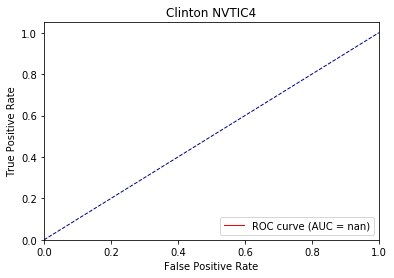

Directory already exists!
hc_nvtic4 2 ap tensor([1., 0.]) loss : 0.06965005397796631 0.10597713468438488 tid : 400 tg tensor([[0]], device='cuda:0')
hc_nvtic4 2 ap tensor([0.9791, 0.1008]) loss : 0.05367910861968994 0.14467107700923132 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic4 2 ap tensor([1., 0.]) loss : 0.045243024826049805 0.07152868310610454 tid : 60 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic4 2 ap tensor([1., 0.]) loss : 0.06664109230041504 0.08906876378589207 tid : 210 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic4 2 ap tensor([1., 0.]) loss : 0.06412184238433838 0.08407983382542929 tid : 240 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic4 2 ap tensor([1., 0.]) loss : 0.03400540351867676 0.07702334566288684 tid : 390 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic4 2 ap tensor([1., 0.]) loss : 0.030805230140686035 0.07515867854419507 tid : 450 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic4 2 ap tensor([1., 0.]) loss : 0.04642176628112793 0.0753061189955

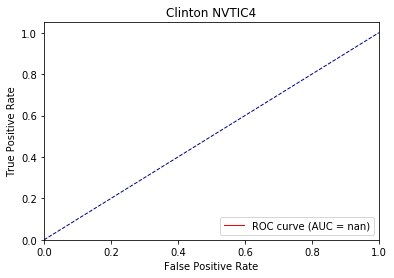

Directory already exists!
hc_interruptions 0 ap tensor([1., 0.]) loss : 0.5834895968437195 0.553348571062088 tid : 400 tg tensor([[0]], device='cuda:0')
hc_interruptions 0 ap tensor([0.9994, 0.7500]) loss : 0.5367468595504761 0.5601209619287717 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_interruptions 0 ap tensor([1., 0.]) loss : 0.27200478315353394 0.24362129469712576 tid : 60 tg tensor([[0]], device='cuda:0')
TEST hc_interruptions 0 ap tensor([1., 0.]) loss : 0.24991264939308167 0.269596585796939 tid : 210 tg tensor([[0]], device='cuda:0')
TEST hc_interruptions 0 ap tensor([1., 0.]) loss : 0.27231499552726746 0.26319641603363886 tid : 240 tg tensor([[0]], device='cuda:0')
TEST hc_interruptions 0 ap tensor([0.9626, 0.0412]) loss : 0.14999669790267944 0.3093451947332865 tid : 390 tg tensor([[0]], device='cuda:0')
TEST hc_interruptions 0 ap tensor([0.9682, 0.1285]) loss : 0.16859954595565796 0.3063537240028381 tid : 450 tg tensor([[0]], device='cuda:0')
TEST hc_interruptions 0 a

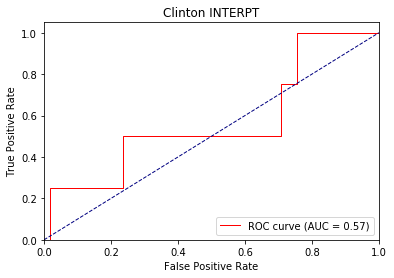

Directory already exists!
hc_interruptions 1 ap tensor([0.9821, 0.5000]) loss : 0.25805729627609253 0.3792189955711365 tid : 400 tg tensor([[0]], device='cuda:0')
hc_interruptions 1 ap tensor([0.9990, 0.2000]) loss : 0.20974355936050415 0.23855264278558586 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_interruptions 1 ap tensor([1., 0.]) loss : 0.12341916561126709 0.12183219194412231 tid : 60 tg tensor([[0]], device='cuda:0')
TEST hc_interruptions 1 ap tensor([1., 0.]) loss : 0.12441110610961914 0.14827032387256622 tid : 210 tg tensor([[0]], device='cuda:0')
TEST hc_interruptions 1 ap tensor([1., 0.]) loss : 0.1305350661277771 0.14168622228834366 tid : 240 tg tensor([[0]], device='cuda:0')
TEST hc_interruptions 1 ap tensor([0.9586, 0.0376]) loss : 0.057009220123291016 0.2169243289404605 tid : 390 tg tensor([[0]], device='cuda:0')
TEST hc_interruptions 1 ap tensor([0.9652, 0.1034]) loss : 0.06564390659332275 0.2154428731454046 tid : 450 tg tensor([[0]], device='cuda:0')
TEST hc_int

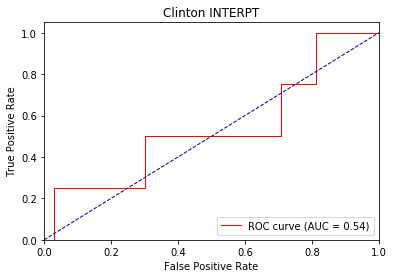

Directory already exists!
hc_interruptions 2 ap tensor([0.9978, 0.1586]) loss : 0.06526196002960205 0.1346446755139724 tid : 200 tg tensor([[0]], device='cuda:0')
hc_interruptions 2 ap tensor([0.9986, 0.1628]) loss : 0.06800127029418945 0.12161625503818306 tid : 400 tg tensor([[0]], device='cuda:0')
TEST hc_interruptions 2 ap tensor([1., 0.]) loss : 0.06470668315887451 0.06938111285368602 tid : 60 tg tensor([[0]], device='cuda:0')
TEST hc_interruptions 2 ap tensor([1., 0.]) loss : 0.07126832008361816 0.09456208099921544 tid : 210 tg tensor([[0]], device='cuda:0')
TEST hc_interruptions 2 ap tensor([1., 0.]) loss : 0.07686066627502441 0.08874842789438035 tid : 240 tg tensor([[0]], device='cuda:0')
TEST hc_interruptions 2 ap tensor([0.9568, 0.0365]) loss : 0.02789783477783203 0.18853251905326385 tid : 390 tg tensor([[0]], device='cuda:0')
TEST hc_interruptions 2 ap tensor([0.9640, 0.1022]) loss : 0.032152533531188965 0.18845446988155967 tid : 450 tg tensor([[0]], device='cuda:0')
TEST hc_

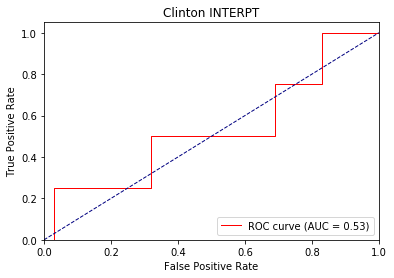

Directory already exists!
hc_lookat2 0 ap tensor([0.6556, 0.6228]) loss : 0.7187985777854919 0.6837659776210785 tid : 200 tg tensor([[0]], device='cuda:0')
hc_lookat2 0 ap tensor([0.8986, 0.9200]) loss : 0.46164339780807495 0.5638673874195989 tid : 400 tg tensor([[0]], device='cuda:0')
TEST hc_lookat2 0 ap tensor([0.9151, 0.2500]) loss : 0.7594197392463684 0.6149137105260577 tid : 30 tg tensor([[0]], device='cuda:0')
TEST hc_lookat2 0 ap tensor([0.9763, 0.9290]) loss : 0.42861080169677734 0.5043898697883363 tid : 330 tg tensor([[0]], device='cuda:0')


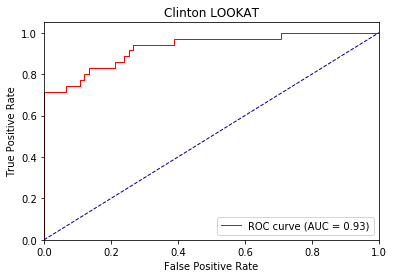

Directory already exists!
hc_lookat2 1 ap tensor([0.9559, 0.9519]) loss : 0.49624887108802795 0.4371716246372316 tid : 200 tg tensor([[0]], device='cuda:0')
hc_lookat2 1 ap tensor([0.9415, 0.9561]) loss : 0.2931675314903259 0.4121906102728785 tid : 400 tg tensor([[0]], device='cuda:0')
TEST hc_lookat2 1 ap tensor([0.9151, 0.2500]) loss : 0.7217817306518555 0.5569536558219365 tid : 30 tg tensor([[0]], device='cuda:0')
TEST hc_lookat2 1 ap tensor([0.9777, 0.9358]) loss : 0.26723891496658325 0.4028451433257451 tid : 330 tg tensor([[0]], device='cuda:0')


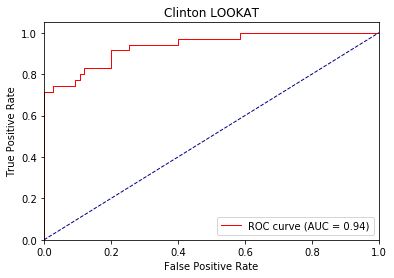

Directory already exists!
hc_lookat2 2 ap tensor([0.8648, 0.9409]) loss : 0.2741004228591919 0.4005097508430481 tid : 400 tg tensor([[0]], device='cuda:0')
hc_lookat2 2 ap tensor([0.9479, 0.9621]) loss : 0.3523327708244324 0.3405269028920701 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_lookat2 2 ap tensor([0.9151, 0.2500]) loss : 0.7032688856124878 0.5332582337515694 tid : 30 tg tensor([[0]], device='cuda:0')
TEST hc_lookat2 2 ap tensor([0.9781, 0.9385]) loss : 0.1786860227584839 0.34484101240597076 tid : 330 tg tensor([[0]], device='cuda:0')


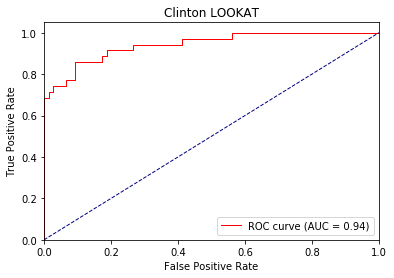

Directory already exists!
hc_brush1 0 ap tensor([0.8381, 0.1233]) loss : 0.6399876475334167 0.7528005996528937 tid : 200 tg tensor([[0]], device='cuda:0')
hc_brush1 0 ap tensor([0.8758, 0.1398]) loss : 0.5646551847457886 0.6726341007624642 tid : 400 tg tensor([[0]], device='cuda:0')
TEST hc_brush1 0 ap tensor([1., 0.]) loss : 0.3569207489490509 0.3831176289490291 tid : 30 tg tensor([[0]], device='cuda:0')
TEST hc_brush1 0 ap tensor([0.9725, 0.2969]) loss : 0.4095401167869568 0.48037833259219215 tid : 330 tg tensor([[0]], device='cuda:0')


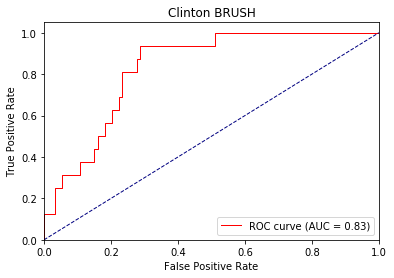

Directory already exists!
hc_brush1 1 ap tensor([0.9642, 0.0833]) loss : 0.3281588554382324 0.461333692073822 tid : 200 tg tensor([[0]], device='cuda:0')
hc_brush1 1 ap tensor([0.9687, 0.0822]) loss : 0.3556525707244873 0.454375038544337 tid : 400 tg tensor([[0]], device='cuda:0')
TEST hc_brush1 1 ap tensor([1., 0.]) loss : 0.2341662049293518 0.2296824710709708 tid : 30 tg tensor([[0]], device='cuda:0')
TEST hc_brush1 1 ap tensor([0.9697, 0.2792]) loss : 0.241985023021698 0.38993676172362435 tid : 330 tg tensor([[0]], device='cuda:0')


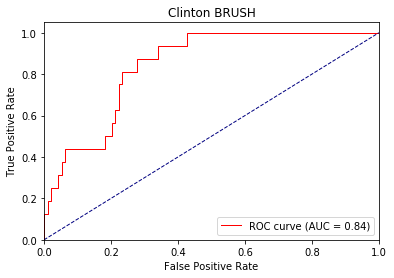

Directory already exists!
hc_brush1 2 ap tensor([0.9515, 0.2051]) loss : 0.18436890840530396 0.38640116889711834 tid : 200 tg tensor([[0]], device='cuda:0')
hc_brush1 2 ap tensor([0.9206, 0.1651]) loss : 0.1750282645225525 0.4185883721670209 tid : 400 tg tensor([[0]], device='cuda:0')
TEST hc_brush1 2 ap tensor([1., 0.]) loss : 0.18406718969345093 0.1589000906263079 tid : 30 tg tensor([[0]], device='cuda:0')
TEST hc_brush1 2 ap tensor([0.9733, 0.3061]) loss : 0.15732789039611816 0.3555832935704125 tid : 330 tg tensor([[0]], device='cuda:0')


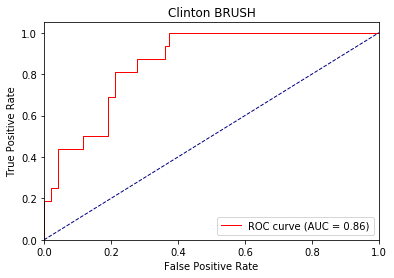

Directory already exists!
hc_nvdis1 0 ap tensor([1., 0.]) loss : 0.6855710744857788 0.6897126038869222 tid : 400 tg tensor([[0]], device='cuda:0')
hc_nvdis1 0 ap tensor([0.9500, 0.2742]) loss : 0.33671945333480835 0.5330287060180268 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_nvdis1 0 ap tensor([0.5833, 0.9429]) loss : 0.2795732617378235 0.9475494452885219 tid : 30 tg tensor([[0]], device='cuda:0')
TEST hc_nvdis1 0 ap tensor([0.8548, 0.3710]) loss : 0.38842982053756714 0.5223727694579533 tid : 330 tg tensor([[0]], device='cuda:0')


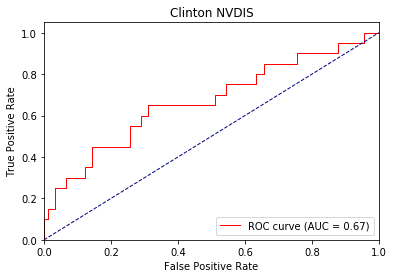

Directory already exists!
hc_nvdis1 1 ap tensor([0.9789, 0.4081]) loss : 0.23989182710647583 0.3626166920163738 tid : 400 tg tensor([[0]], device='cuda:0')
hc_nvdis1 1 ap tensor([0.9626, 0.3671]) loss : 0.1919640302658081 0.35597931176611464 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_nvdis1 1 ap tensor([0.8333, 0.9667]) loss : 0.15330207347869873 1.2444917133876257 tid : 30 tg tensor([[0]], device='cuda:0')
TEST hc_nvdis1 1 ap tensor([0.8616, 0.3443]) loss : 0.21127498149871826 0.525385474401807 tid : 330 tg tensor([[0]], device='cuda:0')


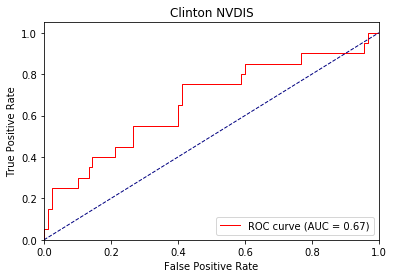

Directory already exists!
hc_nvdis1 2 ap tensor([0.8042, 0.2500]) loss : 0.17336249351501465 0.5348214507102966 tid : 400 tg tensor([[0]], device='cuda:0')
hc_nvdis1 2 ap tensor([0.9784, 0.4236]) loss : 0.12090146541595459 0.28385249578874877 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_nvdis1 2 ap tensor([1., 1.]) loss : 0.10121583938598633 1.5144562380654472 tid : 30 tg tensor([[0]], device='cuda:0')
TEST hc_nvdis1 2 ap tensor([0.8676, 0.3398]) loss : 0.12625956535339355 0.5613849626647102 tid : 330 tg tensor([[0]], device='cuda:0')


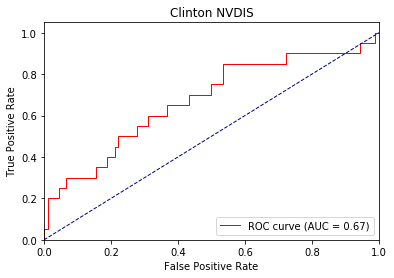

Directory already exists!
hc_look 0 ap tensor([0.2309, 0.6181]) loss : 0.5878161787986755 0.723564881460829 tid : 200 tg tensor([[1]], device='cuda:0')
hc_look 0 ap tensor([0.3376, 0.8018]) loss : 0.4535977244377136 0.6664048322950894 tid : 400 tg tensor([[1]], device='cuda:0')
TEST hc_look 0 ap tensor([0., 1.]) loss : 0.562446117401123 0.5009383984974453 tid : 30 tg tensor([[1]], device='cuda:0')
TEST hc_look 0 ap tensor([0.4431, 0.9576]) loss : 0.409271240234375 0.5827693149210915 tid : 330 tg tensor([[1]], device='cuda:0')


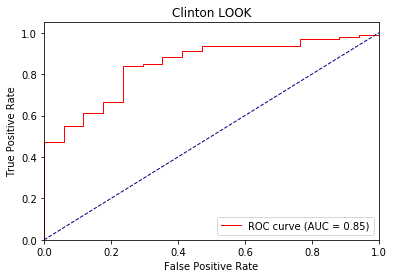

Directory already exists!
hc_look 1 ap tensor([0., 1.]) loss : 0.457072913646698 0.5880151987075806 tid : 200 tg tensor([[1]], device='cuda:0')
hc_look 1 ap tensor([0.7233, 0.9288]) loss : 0.34241729974746704 0.5547313783399859 tid : 400 tg tensor([[1]], device='cuda:0')
TEST hc_look 1 ap tensor([0., 1.]) loss : 0.4669416546821594 0.35262908254350933 tid : 30 tg tensor([[1]], device='cuda:0')
TEST hc_look 1 ap tensor([0.4403, 0.9721]) loss : 0.25011205673217773 0.48522794530505226 tid : 330 tg tensor([[1]], device='cuda:0')


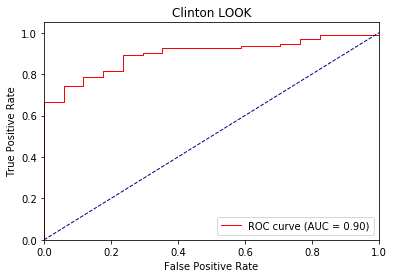

Directory already exists!
hc_look 2 ap tensor([0.7883, 0.9520]) loss : 0.19498991966247559 0.45514638998255824 tid : 400 tg tensor([[1]], device='cuda:0')
hc_look 2 ap tensor([0.7668, 0.9541]) loss : 0.21566444635391235 0.44675386152107366 tid : 200 tg tensor([[1]], device='cuda:0')
TEST hc_look 2 ap tensor([0., 1.]) loss : 0.40236884355545044 0.25962116037096294 tid : 30 tg tensor([[1]], device='cuda:0')
TEST hc_look 2 ap tensor([0.4464, 0.9750]) loss : 0.1604975461959839 0.4250782023346613 tid : 330 tg tensor([[1]], device='cuda:0')


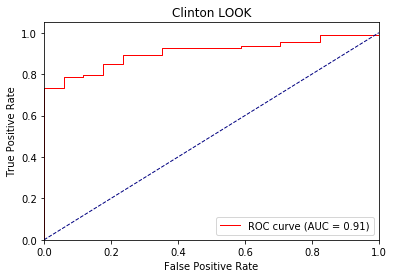

Directory already exists!
hc_eyebrow 0 ap tensor([0.8810, 0.6912]) loss : 0.7998243570327759 0.6163839216858263 tid : 400 tg tensor([[0]], device='cuda:0')
hc_eyebrow 0 ap tensor([0.8872, 0.6661]) loss : 0.7366757392883301 0.6134808820198017 tid : 200 tg tensor([[1]], device='cuda:0')
TEST hc_eyebrow 0 ap tensor([0.8333, 0.9667]) loss : 0.42374709248542786 0.627685010433197 tid : 30 tg tensor([[0]], device='cuda:0')
TEST hc_eyebrow 0 ap tensor([0.8456, 0.6432]) loss : 0.5965485572814941 0.5905970420156207 tid : 330 tg tensor([[0]], device='cuda:0')


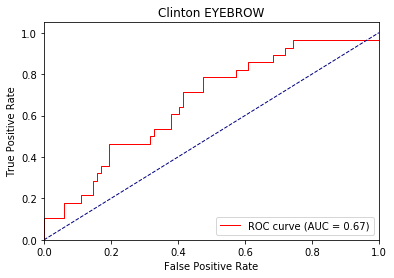

Directory already exists!
hc_eyebrow 1 ap tensor([0.9252, 0.7132]) loss : 0.7761725187301636 0.5387455213528413 tid : 200 tg tensor([[1]], device='cuda:0')
hc_eyebrow 1 ap tensor([0.9536, 0.7438]) loss : 0.8539659976959229 0.4756037494603624 tid : 400 tg tensor([[0]], device='cuda:0')
TEST hc_eyebrow 1 ap tensor([0.8333, 0.9667]) loss : 0.33368879556655884 0.6033026959214892 tid : 30 tg tensor([[0]], device='cuda:0')
TEST hc_eyebrow 1 ap tensor([0.8398, 0.6262]) loss : 0.6290569305419922 0.5792622727061075 tid : 330 tg tensor([[0]], device='cuda:0')


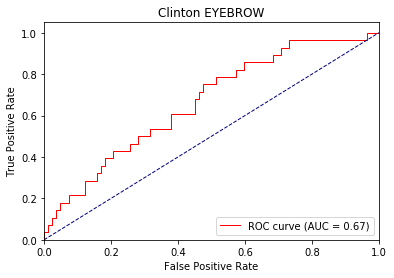

Directory already exists!
hc_eyebrow 2 ap tensor([0.9542, 0.7822]) loss : 0.9432559013366699 0.42095739330564225 tid : 400 tg tensor([[0]], device='cuda:0')
hc_eyebrow 2 ap tensor([0.9511, 0.7780]) loss : 0.8173235058784485 0.4260467598438263 tid : 200 tg tensor([[1]], device='cuda:0')
TEST hc_eyebrow 2 ap tensor([0.8333, 0.9667]) loss : 0.26934999227523804 0.593370965548924 tid : 30 tg tensor([[0]], device='cuda:0')
TEST hc_eyebrow 2 ap tensor([0.8395, 0.6295]) loss : 0.6419638395309448 0.5841674620196933 tid : 330 tg tensor([[0]], device='cuda:0')


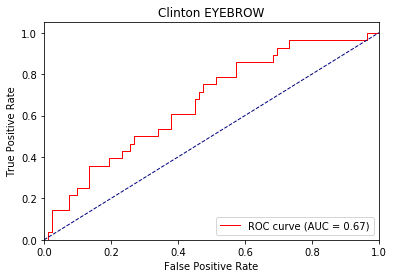

Directory already exists!
hc_atface 0 ap tensor([0.9359, 0.2002]) loss : 0.7652133703231812 0.7138976685771155 tid : 400 tg tensor([[0]], device='cuda:0')
hc_atface 0 ap tensor([0.9250, 0.1879]) loss : 0.8302717208862305 0.6505121259387752 tid : 200 tg tensor([[1]], device='cuda:0')
TEST hc_atface 0 ap tensor([0.9500, 0.9167]) loss : 0.5042159557342529 0.6414388035024915 tid : 30 tg tensor([[0]], device='cuda:0')
TEST hc_atface 0 ap tensor([0.9287, 0.5061]) loss : 0.4832003712654114 0.5536998056230091 tid : 330 tg tensor([[0]], device='cuda:0')


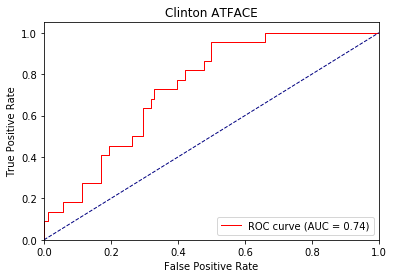

Directory already exists!
hc_atface 1 ap tensor([0.9450, 0.2409]) loss : 0.963107705116272 0.49917335656224465 tid : 200 tg tensor([[1]], device='cuda:0')
hc_atface 1 ap tensor([0.9572, 0.2305]) loss : 0.45199325680732727 0.46287581246832143 tid : 400 tg tensor([[0]], device='cuda:0')
TEST hc_atface 1 ap tensor([0.9167, 0.8056]) loss : 0.29089176654815674 0.6583676082747323 tid : 30 tg tensor([[0]], device='cuda:0')
TEST hc_atface 1 ap tensor([0.9286, 0.4917]) loss : 0.30027806758880615 0.4707781393376608 tid : 330 tg tensor([[0]], device='cuda:0')


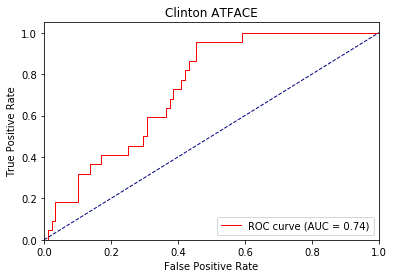

Directory already exists!
hc_atface 2 ap tensor([0.9617, 0.4080]) loss : 1.3187130689620972 0.39521293160708054 tid : 200 tg tensor([[1]], device='cuda:0')
hc_atface 2 ap tensor([0.9598, 0.3013]) loss : 0.34531068801879883 0.3836869049979293 tid : 400 tg tensor([[0]], device='cuda:0')
TEST hc_atface 2 ap tensor([0.9167, 0.8056]) loss : 0.19448214769363403 0.6999311745166779 tid : 30 tg tensor([[0]], device='cuda:0')
TEST hc_atface 2 ap tensor([0.9248, 0.4455]) loss : 0.215287983417511 0.4480072945829422 tid : 330 tg tensor([[0]], device='cuda:0')


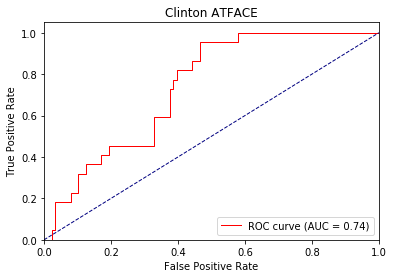

Directory already exists!
hc_feface 0 ap tensor([1., 0.]) loss : 0.4178851544857025 0.5560627309278178 tid : 200 tg tensor([[0]], device='cuda:0')
hc_feface 0 ap tensor([1., 0.]) loss : 0.34274035692214966 0.5548861128943307 tid : 400 tg tensor([[0]], device='cuda:0')
TEST hc_feface 0 ap tensor([1., 0.]) loss : 0.3131279945373535 0.3069275660174234 tid : 30 tg tensor([[0]], device='cuda:0')
TEST hc_feface 0 ap tensor([1., 0.]) loss : 0.37793901562690735 0.3167051441139645 tid : 330 tg tensor([[0]], device='cuda:0')


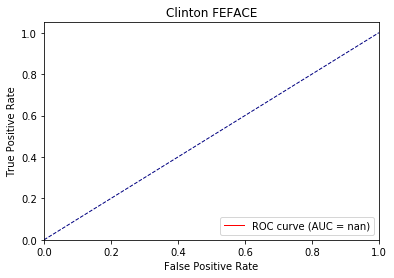

Directory already exists!
hc_feface 1 ap tensor([1., 0.]) loss : 0.2172664999961853 0.2763191736778434 tid : 200 tg tensor([[0]], device='cuda:0')
hc_feface 1 ap tensor([1., 0.]) loss : 0.14692258834838867 0.2489493616853659 tid : 400 tg tensor([[0]], device='cuda:0')
TEST hc_feface 1 ap tensor([1., 0.]) loss : 0.12275195121765137 0.1423062171254839 tid : 30 tg tensor([[0]], device='cuda:0')
TEST hc_feface 1 ap tensor([1., 0.]) loss : 0.1717185378074646 0.14569181582284352 tid : 330 tg tensor([[0]], device='cuda:0')


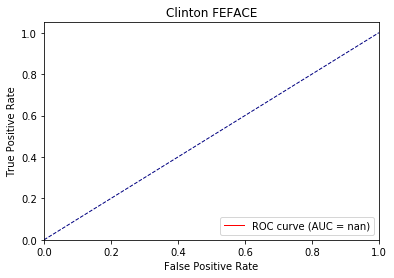

Directory already exists!
hc_feface 2 ap tensor([1., 0.]) loss : 0.09138953685760498 0.12892957126840632 tid : 400 tg tensor([[0]], device='cuda:0')
hc_feface 2 ap tensor([1., 0.]) loss : 0.048639655113220215 0.10730563894311106 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_feface 2 ap tensor([1., 0.]) loss : 0.048163771629333496 0.06673404148646764 tid : 30 tg tensor([[0]], device='cuda:0')
TEST hc_feface 2 ap tensor([1., 0.]) loss : 0.07504534721374512 0.06825394384444707 tid : 330 tg tensor([[0]], device='cuda:0')


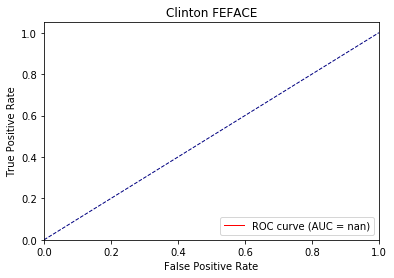

Directory already exists!
hc_hrface 0 ap tensor([0.5190, 0.5840]) loss : 0.6148340702056885 0.6935490436768263 tid : 400 tg tensor([[0]], device='cuda:0')
hc_hrface 0 ap tensor([0.6117, 0.6559]) loss : 0.6016154289245605 0.6787943732407358 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_hrface 0 ap tensor([1., 0.]) loss : 0.6215088963508606 0.5973981618881226 tid : 30 tg tensor([[0]], device='cuda:0')
TEST hc_hrface 0 ap tensor([0.9068, 0.5895]) loss : 0.5594303011894226 0.6276124550236596 tid : 330 tg tensor([[0]], device='cuda:0')


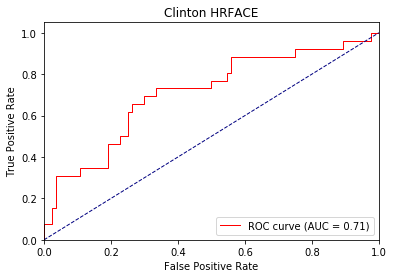

Directory already exists!
hc_hrface 1 ap tensor([0.7212, 0.8292]) loss : 0.525743842124939 0.6362426908321033 tid : 400 tg tensor([[0]], device='cuda:0')
hc_hrface 1 ap tensor([0.7092, 0.8128]) loss : 0.5633634924888611 0.6385918024065192 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_hrface 1 ap tensor([1., 0.]) loss : 0.6103042364120483 0.5806046213422503 tid : 30 tg tensor([[0]], device='cuda:0')
TEST hc_hrface 1 ap tensor([0.8930, 0.5524]) loss : 0.5262038707733154 0.6153049364922538 tid : 330 tg tensor([[0]], device='cuda:0')


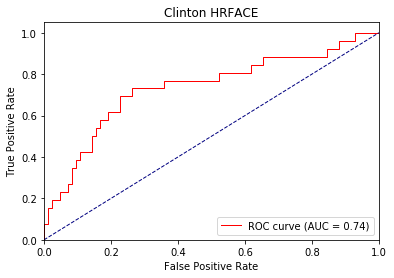

Directory already exists!
hc_hrface 2 ap tensor([0.8804, 0.7773]) loss : 0.5439394116401672 0.5980555824935436 tid : 200 tg tensor([[0]], device='cuda:0')
hc_hrface 2 ap tensor([0.7927, 0.8521]) loss : 0.46858251094818115 0.5927479229405264 tid : 400 tg tensor([[0]], device='cuda:0')
TEST hc_hrface 2 ap tensor([1., 0.]) loss : 0.6103556752204895 0.5755846415247236 tid : 30 tg tensor([[0]], device='cuda:0')
TEST hc_hrface 2 ap tensor([0.8803, 0.5274]) loss : 0.5074625015258789 0.6089941154396723 tid : 330 tg tensor([[0]], device='cuda:0')


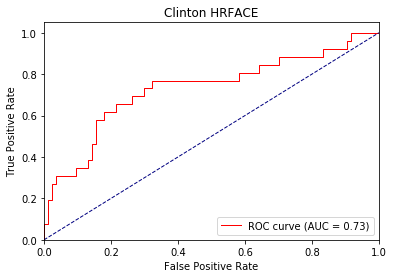

Directory already exists!
hc_saface 0 ap tensor([0.9917, 0.0454]) loss : 0.5176035165786743 0.5105448900467128 tid : 200 tg tensor([[0]], device='cuda:0')
hc_saface 0 ap tensor([0.9878, 0.0360]) loss : 0.33585885167121887 0.43238089946064634 tid : 400 tg tensor([[0]], device='cuda:0')
TEST hc_saface 0 ap tensor([1., 0.]) loss : 0.3956555128097534 0.35306788768087116 tid : 30 tg tensor([[0]], device='cuda:0')
TEST hc_saface 0 ap tensor([1., 0.]) loss : 0.49785369634628296 0.31113056531028144 tid : 330 tg tensor([[0]], device='cuda:0')


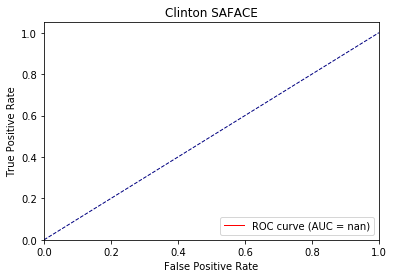

Directory already exists!
hc_saface 1 ap tensor([1., 0.]) loss : 0.29439640045166016 0.2724813457046236 tid : 400 tg tensor([[0]], device='cuda:0')
hc_saface 1 ap tensor([0.9919, 0.0391]) loss : 0.20749974250793457 0.24405938020702136 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_saface 1 ap tensor([1., 0.]) loss : 0.1728498339653015 0.17941841057368688 tid : 30 tg tensor([[0]], device='cuda:0')
TEST hc_saface 1 ap tensor([1., 0.]) loss : 0.26107537746429443 0.15704270061992465 tid : 330 tg tensor([[0]], device='cuda:0')


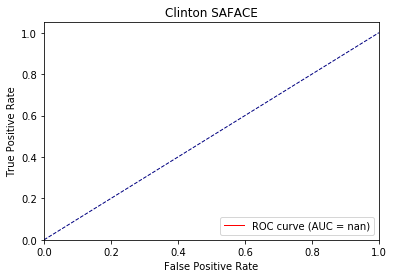

Directory already exists!
hc_saface 2 ap tensor([0.9790, 0.1667]) loss : 0.15243518352508545 0.25738177579991955 tid : 400 tg tensor([[0]], device='cuda:0')
hc_saface 2 ap tensor([0.9926, 0.0392]) loss : 0.08485114574432373 0.1476589189334349 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_saface 2 ap tensor([1., 0.]) loss : 0.08538246154785156 0.10439770562308175 tid : 30 tg tensor([[0]], device='cuda:0')
TEST hc_saface 2 ap tensor([1., 0.]) loss : 0.15521997213363647 0.09186449505033947 tid : 330 tg tensor([[0]], device='cuda:0')


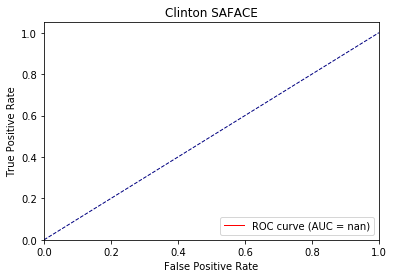

Directory already exists!
hc_neuface 0 ap tensor([0.6586, 0.3456]) loss : 0.7404893040657043 0.7222005926576772 tid : 400 tg tensor([[1]], device='cuda:0')
hc_neuface 0 ap tensor([0.6721, 0.3494]) loss : 0.6446372866630554 0.7065885933764252 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_neuface 0 ap tensor([0.4762, 0.5845]) loss : 0.7974956035614014 0.726178663117545 tid : 30 tg tensor([[1]], device='cuda:0')
TEST hc_neuface 0 ap tensor([0.6932, 0.8060]) loss : 0.8573064804077148 0.6652629810666281 tid : 330 tg tensor([[1]], device='cuda:0')


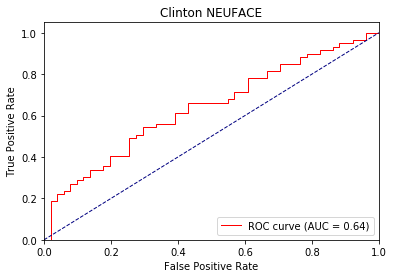

Directory already exists!
hc_neuface 1 ap tensor([0.7152, 0.3393]) loss : 0.8568907976150513 0.6674450088028956 tid : 400 tg tensor([[1]], device='cuda:0')
hc_neuface 1 ap tensor([0.7572, 0.3826]) loss : 0.5582181215286255 0.6540101901707003 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_neuface 1 ap tensor([0.4429, 0.5429]) loss : 0.9143115878105164 0.7489462579999652 tid : 30 tg tensor([[1]], device='cuda:0')
TEST hc_neuface 1 ap tensor([0.7203, 0.8266]) loss : 0.9185352921485901 0.6743627796097408 tid : 330 tg tensor([[1]], device='cuda:0')


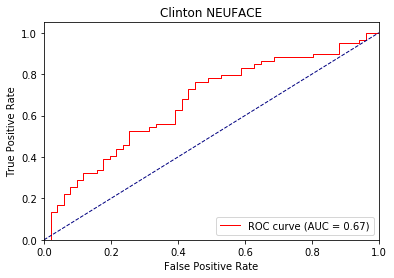

Directory already exists!
hc_neuface 2 ap tensor([0.8760, 0.5628]) loss : 0.490926593542099 0.6050834586319415 tid : 200 tg tensor([[0]], device='cuda:0')
hc_neuface 2 ap tensor([0.7807, 0.6173]) loss : 0.9330407381057739 0.635618178302018 tid : 400 tg tensor([[1]], device='cuda:0')
TEST hc_neuface 2 ap tensor([0.5317, 0.6220]) loss : 1.0040043592453003 0.7682508059910366 tid : 30 tg tensor([[1]], device='cuda:0')
TEST hc_neuface 2 ap tensor([0.7899, 0.8194]) loss : 0.9532860517501831 0.6799386664042397 tid : 330 tg tensor([[1]], device='cuda:0')


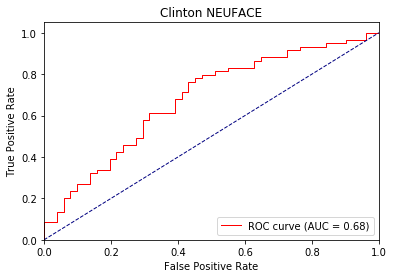

Directory already exists!
hc_inapprop 0 ap tensor([1., 0.]) loss : 0.5417715311050415 0.6772667122265649 tid : 400 tg tensor([[0]], device='cuda:0')
hc_inapprop 0 ap tensor([1., 0.]) loss : 0.3343774378299713 0.520377195056747 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_inapprop 0 ap tensor([1., 0.]) loss : 0.24943137168884277 0.3258802039282663 tid : 30 tg tensor([[0]], device='cuda:0')
TEST hc_inapprop 0 ap tensor([1., 0.]) loss : 0.36517590284347534 0.3087394743684738 tid : 330 tg tensor([[0]], device='cuda:0')


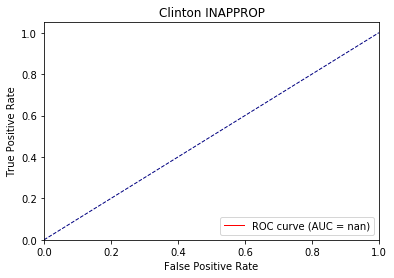

Directory already exists!
hc_inapprop 1 ap tensor([1., 0.]) loss : 0.24695074558258057 0.2625305075198412 tid : 200 tg tensor([[0]], device='cuda:0')
hc_inapprop 1 ap tensor([1., 0.]) loss : 0.15338951349258423 0.22666498547529473 tid : 400 tg tensor([[0]], device='cuda:0')
TEST hc_inapprop 1 ap tensor([1., 0.]) loss : 0.09408152103424072 0.1563969680241176 tid : 30 tg tensor([[0]], device='cuda:0')
TEST hc_inapprop 1 ap tensor([1., 0.]) loss : 0.16018712520599365 0.1384019454320272 tid : 330 tg tensor([[0]], device='cuda:0')


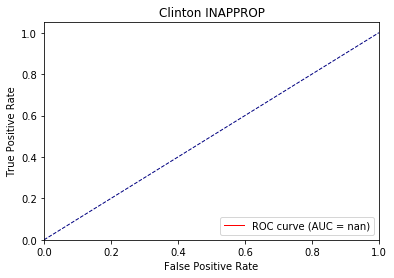

Directory already exists!
hc_inapprop 2 ap tensor([1., 0.]) loss : 0.08588111400604248 0.11903211520984769 tid : 200 tg tensor([[0]], device='cuda:0')
hc_inapprop 2 ap tensor([1., 0.]) loss : 0.06928360462188721 0.1120143733193389 tid : 400 tg tensor([[0]], device='cuda:0')
TEST hc_inapprop 2 ap tensor([1., 0.]) loss : 0.03725910186767578 0.07879934992109026 tid : 30 tg tensor([[0]], device='cuda:0')
TEST hc_inapprop 2 ap tensor([1., 0.]) loss : 0.06913578510284424 0.06510755088594225 tid : 330 tg tensor([[0]], device='cuda:0')


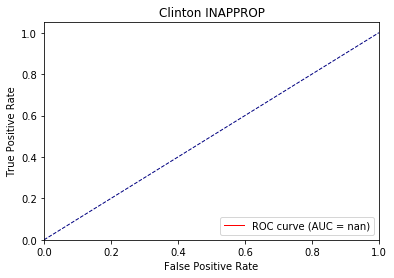

Directory already exists!
hc_affgest 0 ap tensor([0.9879, 0.0532]) loss : 0.6758325099945068 0.7098041969009593 tid : 200 tg tensor([[0]], device='cuda:0')
hc_affgest 0 ap tensor([0.9792, 0.0608]) loss : 0.6025129556655884 0.6914279751890288 tid : 400 tg tensor([[0]], device='cuda:0')
TEST hc_affgest 0 ap tensor([1., 0.]) loss : 0.3986976146697998 0.4750687777996063 tid : 30 tg tensor([[0]], device='cuda:0')
TEST hc_affgest 0 ap tensor([1., 0.]) loss : 0.5026885271072388 0.4288595503284818 tid : 330 tg tensor([[0]], device='cuda:0')


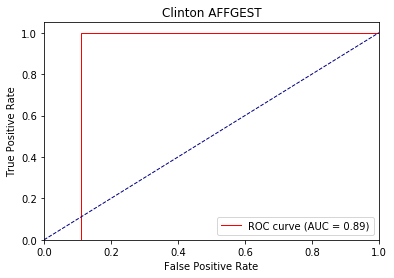

Directory already exists!
hc_affgest 1 ap tensor([0.9742, 0.2751]) loss : 0.30236363410949707 0.4025733559936672 tid : 200 tg tensor([[0]], device='cuda:0')
hc_affgest 1 ap tensor([0.9821, 0.2692]) loss : 0.3361278176307678 0.3795006902928048 tid : 400 tg tensor([[0]], device='cuda:0')
TEST hc_affgest 1 ap tensor([1., 0.]) loss : 0.17719048261642456 0.2755371630191803 tid : 30 tg tensor([[0]], device='cuda:0')
TEST hc_affgest 1 ap tensor([1., 0.]) loss : 0.2822956144809723 0.240534513242661 tid : 330 tg tensor([[0]], device='cuda:0')


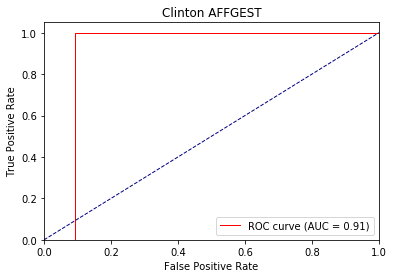

Directory already exists!
hc_affgest 2 ap tensor([0.9956, 0.1399]) loss : 0.11541903018951416 0.21028952073242704 tid : 200 tg tensor([[0]], device='cuda:0')
hc_affgest 2 ap tensor([0.9880, 0.2012]) loss : 0.13490629196166992 0.2350261268707422 tid : 400 tg tensor([[0]], device='cuda:0')
TEST hc_affgest 2 ap tensor([1., 0.]) loss : 0.08773267269134521 0.18671934519495284 tid : 30 tg tensor([[0]], device='cuda:0')
TEST hc_affgest 2 ap tensor([1., 0.]) loss : 0.18666350841522217 0.15689264545364986 tid : 330 tg tensor([[0]], device='cuda:0')


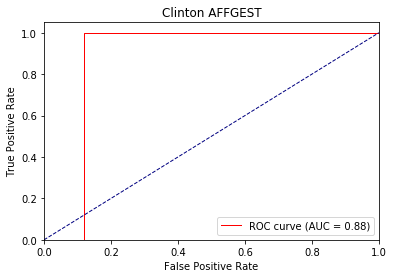

Directory already exists!
hc_defgest 0 ap tensor([0.9513, 0.2271]) loss : 0.7773838043212891 0.6738189717997676 tid : 400 tg tensor([[1]], device='cuda:0')
hc_defgest 0 ap tensor([0.9420, 0.2009]) loss : 0.640117883682251 0.6592595038140655 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_defgest 0 ap tensor([1., 0.]) loss : 0.32272017002105713 0.44257333874702454 tid : 30 tg tensor([[0]], device='cuda:0')
TEST hc_defgest 0 ap tensor([0.8945, 0.4450]) loss : 0.5351678133010864 0.5387011875235845 tid : 330 tg tensor([[0]], device='cuda:0')


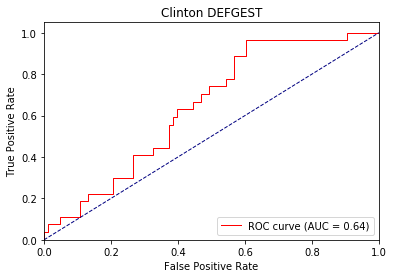

Directory already exists!
hc_defgest 1 ap tensor([0.9545, 0.2768]) loss : 1.2456717491149902 0.42147872885605236 tid : 400 tg tensor([[1]], device='cuda:0')
hc_defgest 1 ap tensor([0.9640, 0.2355]) loss : 0.2766536474227905 0.38592862702430564 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_defgest 1 ap tensor([1., 0.]) loss : 0.18043553829193115 0.2994803317955562 tid : 30 tg tensor([[0]], device='cuda:0')
TEST hc_defgest 1 ap tensor([0.9026, 0.4664]) loss : 0.36294713616371155 0.5109171891023242 tid : 330 tg tensor([[0]], device='cuda:0')


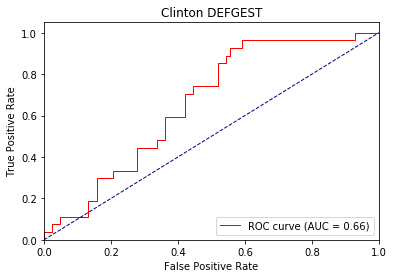

Directory already exists!
hc_defgest 2 ap tensor([0.9354, 0.1467]) loss : 1.428065538406372 0.3840137744943301 tid : 400 tg tensor([[1]], device='cuda:0')
hc_defgest 2 ap tensor([0.9611, 0.1857]) loss : 0.19850951433181763 0.3347171638357012 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_defgest 2 ap tensor([1., 0.]) loss : 0.12036287784576416 0.23192302669797624 tid : 30 tg tensor([[0]], device='cuda:0')
TEST hc_defgest 2 ap tensor([0.9064, 0.4992]) loss : 0.2798747420310974 0.5171140205292475 tid : 330 tg tensor([[0]], device='cuda:0')


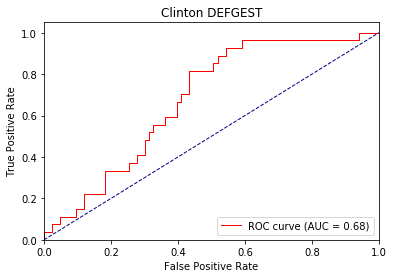

Directory already exists!
hc_agentic 0 ap tensor([0.8004, 0.7801]) loss : 0.4739488959312439 0.6164487119231905 tid : 400 tg tensor([[1]], device='cuda:0')
hc_agentic 0 ap tensor([0.8131, 0.7987]) loss : 0.5144281387329102 0.60419247702316 tid : 200 tg tensor([[1]], device='cuda:0')
TEST hc_agentic 0 ap tensor([0.5000, 0.9029]) loss : 0.7637609839439392 0.5686702813420977 tid : 30 tg tensor([[0]], device='cuda:0')
TEST hc_agentic 0 ap tensor([0.8570, 0.8934]) loss : 0.9942787885665894 0.5319951129338097 tid : 330 tg tensor([[0]], device='cuda:0')


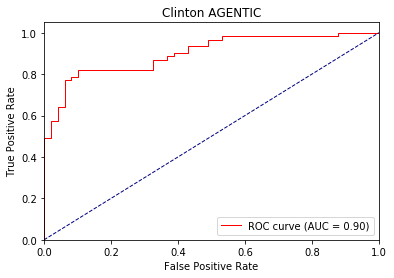

Directory already exists!
hc_agentic 1 ap tensor([0.9636, 0.9782]) loss : 0.5211155414581299 0.4189292184064086 tid : 200 tg tensor([[1]], device='cuda:0')
hc_agentic 1 ap tensor([0.9538, 0.9416]) loss : 0.3228098154067993 0.41949118530913576 tid : 400 tg tensor([[1]], device='cuda:0')
TEST hc_agentic 1 ap tensor([0.5000, 0.9029]) loss : 0.7088954448699951 0.5158517360687256 tid : 30 tg tensor([[0]], device='cuda:0')
TEST hc_agentic 1 ap tensor([0.8805, 0.9208]) loss : 1.2448574304580688 0.4522727354178353 tid : 330 tg tensor([[0]], device='cuda:0')


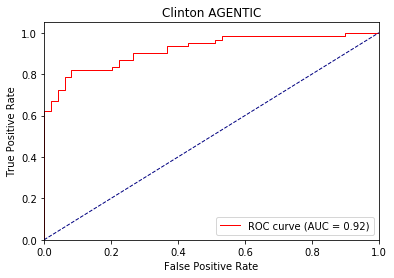

Directory already exists!
hc_agentic 2 ap tensor([0.9852, 0.9885]) loss : 0.2549847960472107 0.29416139502274363 tid : 400 tg tensor([[1]], device='cuda:0')
hc_agentic 2 ap tensor([0.9692, 0.9628]) loss : 0.42696547508239746 0.3322057165366747 tid : 200 tg tensor([[1]], device='cuda:0')
TEST hc_agentic 2 ap tensor([0.5833, 0.9429]) loss : 0.6320792436599731 0.48258611985615324 tid : 30 tg tensor([[0]], device='cuda:0')
TEST hc_agentic 2 ap tensor([0.8930, 0.9360]) loss : 1.4605798721313477 0.4075566279509711 tid : 330 tg tensor([[0]], device='cuda:0')


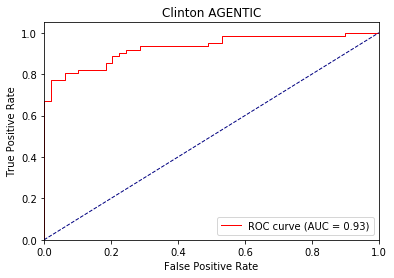

Directory already exists!
hc_waveoff 0 ap tensor([0.9012, 0.5917]) loss : 0.8610662221908569 0.581809975347429 tid : 200 tg tensor([[1]], device='cuda:0')
hc_waveoff 0 ap tensor([0.9015, 0.5938]) loss : 0.7633587121963501 0.5816700204654977 tid : 400 tg tensor([[1]], device='cuda:0')
TEST hc_waveoff 0 ap tensor([0.6429, 0.4111]) loss : 0.3673095107078552 0.8014303020068577 tid : 30 tg tensor([[0]], device='cuda:0')
TEST hc_waveoff 0 ap tensor([0.8149, 0.5887]) loss : 0.8925100564956665 0.612881317498192 tid : 330 tg tensor([[0]], device='cuda:0')


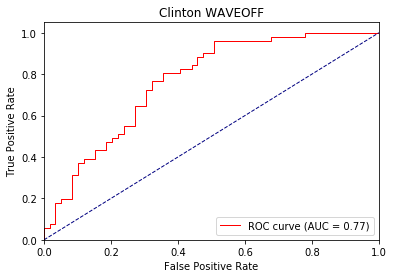

Directory already exists!
hc_waveoff 1 ap tensor([0.9395, 0.7347]) loss : 0.6012855172157288 0.46035374936304596 tid : 400 tg tensor([[1]], device='cuda:0')
hc_waveoff 1 ap tensor([0.9394, 0.7369]) loss : 0.7410476207733154 0.45412848874622463 tid : 200 tg tensor([[1]], device='cuda:0')
TEST hc_waveoff 1 ap tensor([0.6679, 0.4667]) loss : 0.32200637459754944 0.830928202186312 tid : 30 tg tensor([[0]], device='cuda:0')
TEST hc_waveoff 1 ap tensor([0.8300, 0.6244]) loss : 0.9740409851074219 0.5931278765201569 tid : 330 tg tensor([[0]], device='cuda:0')


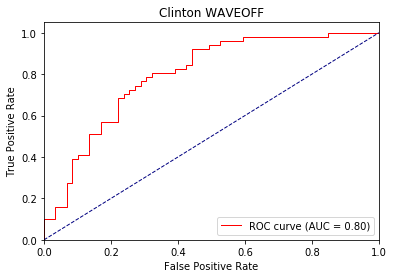

Directory already exists!
hc_waveoff 2 ap tensor([0.9562, 0.6851]) loss : 0.5295956134796143 0.399892261165839 tid : 400 tg tensor([[1]], device='cuda:0')
hc_waveoff 2 ap tensor([0.9550, 0.6867]) loss : 0.7489992380142212 0.4025571999204068 tid : 200 tg tensor([[1]], device='cuda:0')
TEST hc_waveoff 2 ap tensor([0.6679, 0.4667]) loss : 0.28173524141311646 0.8449081352778843 tid : 30 tg tensor([[0]], device='cuda:0')
TEST hc_waveoff 2 ap tensor([0.8371, 0.6561]) loss : 1.0082981586456299 0.5860587230750492 tid : 330 tg tensor([[0]], device='cuda:0')


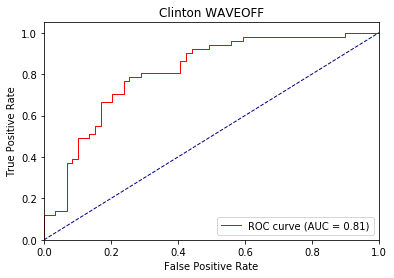

Directory already exists!
hc_nvtic1 0 ap tensor([0.7660, 0.2401]) loss : 0.6855161786079407 0.6715580350474307 tid : 400 tg tensor([[0]], device='cuda:0')
hc_nvtic1 0 ap tensor([0.7963, 0.1436]) loss : 0.7092692852020264 0.6840475270381341 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic1 0 ap tensor([0.8179, 0.1667]) loss : 0.4951588809490204 0.601991491658347 tid : 30 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic1 0 ap tensor([0.7774, 0.2164]) loss : 0.37029677629470825 0.5840734541416168 tid : 330 tg tensor([[0]], device='cuda:0')


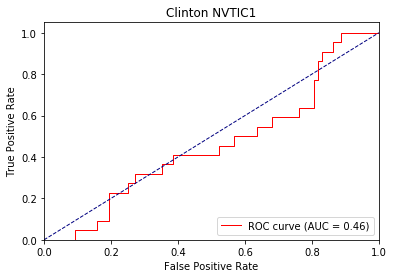

Directory already exists!
hc_nvtic1 1 ap tensor([0.9106, 0.2067]) loss : 0.4623141288757324 0.5117284437020619 tid : 200 tg tensor([[0]], device='cuda:0')
hc_nvtic1 1 ap tensor([0.9205, 0.1183]) loss : 0.35576963424682617 0.4729529808585842 tid : 400 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic1 1 ap tensor([0.8734, 0.2000]) loss : 0.4089168906211853 0.5225384065083095 tid : 30 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic1 1 ap tensor([0.8550, 0.2736]) loss : 0.26394909620285034 0.5327626835732233 tid : 330 tg tensor([[0]], device='cuda:0')


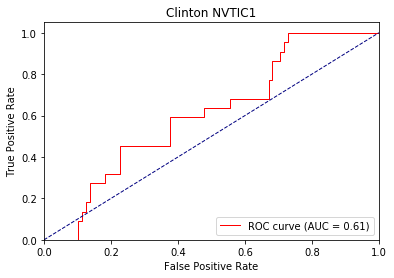

Directory already exists!
hc_nvtic1 2 ap tensor([0.9098, 0.3171]) loss : 0.2420213222503662 0.439424804633572 tid : 400 tg tensor([[0]], device='cuda:0')
hc_nvtic1 2 ap tensor([0.9098, 0.2595]) loss : 0.29134488105773926 0.4534035562817516 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic1 2 ap tensor([0.8734, 0.2000]) loss : 0.3700350522994995 0.4854875760419028 tid : 30 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic1 2 ap tensor([0.9018, 0.3199]) loss : 0.20228660106658936 0.5115481657641274 tid : 330 tg tensor([[0]], device='cuda:0')


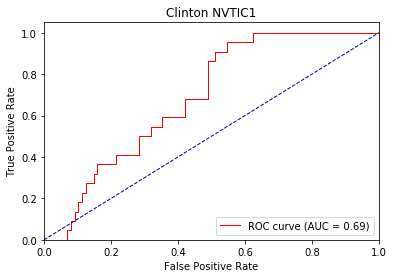

Directory already exists!
hc_nvtic2 0 ap tensor([0.9101, 0.2757]) loss : 0.48536789417266846 0.6342963190993878 tid : 400 tg tensor([[0]], device='cuda:0')
hc_nvtic2 0 ap tensor([0.9281, 0.2733]) loss : 0.43431445956230164 0.6150260748566356 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic2 0 ap tensor([1., 0.]) loss : 0.4479072093963623 0.3978531616074698 tid : 30 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic2 0 ap tensor([0.9676, 0.2444]) loss : 0.3389008045196533 0.4826894799868266 tid : 330 tg tensor([[0]], device='cuda:0')


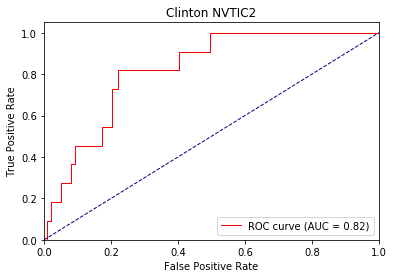

Directory already exists!
hc_nvtic2 1 ap tensor([0.9422, 0.4942]) loss : 0.3051077723503113 0.4772094272160798 tid : 200 tg tensor([[0]], device='cuda:0')
hc_nvtic2 1 ap tensor([0.9423, 0.4566]) loss : 0.28004616498947144 0.4702928988046424 tid : 400 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic2 1 ap tensor([1., 0.]) loss : 0.3859274983406067 0.2813556832926614 tid : 30 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic2 1 ap tensor([0.9646, 0.2914]) loss : 0.2126484513282776 0.3977886897230905 tid : 330 tg tensor([[0]], device='cuda:0')


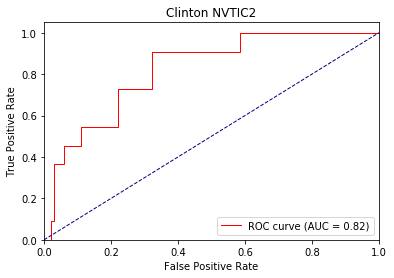

Directory already exists!
hc_nvtic2 2 ap tensor([0.9675, 0.5610]) loss : 0.23312318325042725 0.41351153294450227 tid : 200 tg tensor([[0]], device='cuda:0')
hc_nvtic2 2 ap tensor([0.9665, 0.5287]) loss : 0.17981058359146118 0.409207102065244 tid : 400 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic2 2 ap tensor([1., 0.]) loss : 0.38214001059532166 0.22866286975996836 tid : 30 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic2 2 ap tensor([0.9697, 0.3874]) loss : 0.15142297744750977 0.3567819618989551 tid : 330 tg tensor([[0]], device='cuda:0')


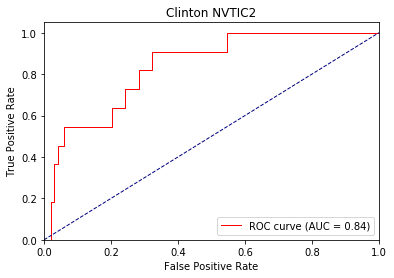

Directory already exists!
hc_nvtic3 0 ap tensor([1., 0.]) loss : 0.652209997177124 0.7130232679942423 tid : 400 tg tensor([[0]], device='cuda:0')
hc_nvtic3 0 ap tensor([0.9974, 0.0082]) loss : 0.29427117109298706 0.5346202310086426 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic3 0 ap tensor([1., 0.]) loss : 0.2522479295730591 0.32537172947611126 tid : 30 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic3 0 ap tensor([0.9931, 0.0435]) loss : 0.2669738531112671 0.3651472055722797 tid : 330 tg tensor([[0]], device='cuda:0')


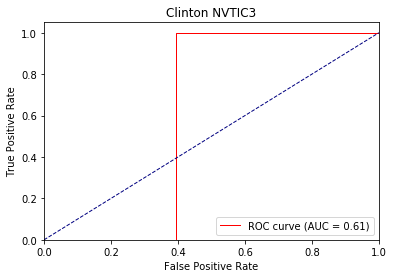

Directory already exists!
hc_nvtic3 1 ap tensor([0.9933, 0.0244]) loss : 0.23697996139526367 0.31363540352060554 tid : 200 tg tensor([[0]], device='cuda:0')
hc_nvtic3 1 ap tensor([0.9984, 0.0126]) loss : 0.1413319706916809 0.24612210060681575 tid : 400 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic3 1 ap tensor([1., 0.]) loss : 0.09154188632965088 0.1470662440572466 tid : 30 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic3 1 ap tensor([0.9915, 0.0370]) loss : 0.10804891586303711 0.19146720804865397 tid : 330 tg tensor([[0]], device='cuda:0')


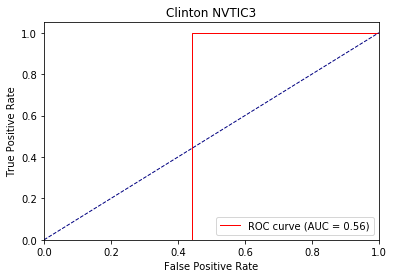

Directory already exists!
hc_nvtic3 2 ap tensor([1., 0.]) loss : 0.10470843315124512 0.1852818727493286 tid : 200 tg tensor([[0]], device='cuda:0')
hc_nvtic3 2 ap tensor([1., 0.]) loss : 0.0991142988204956 0.14569004557349466 tid : 400 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic3 2 ap tensor([1., 0.]) loss : 0.03668522834777832 0.0697674070085798 tid : 30 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic3 2 ap tensor([0.9906, 0.0345]) loss : 0.04642212390899658 0.12246855383827573 tid : 330 tg tensor([[0]], device='cuda:0')


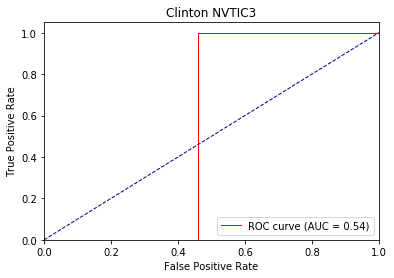

Directory already exists!
hc_nvtic5 0 ap tensor([1., 0.]) loss : 0.7202016711235046 0.5789762373481478 tid : 200 tg tensor([[0]], device='cuda:0')
hc_nvtic5 0 ap tensor([1., 0.]) loss : 0.3912774324417114 0.5012036217442641 tid : 400 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic5 0 ap tensor([1., 0.]) loss : 0.21299278736114502 0.22718372515269689 tid : 30 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic5 0 ap tensor([1., 0.]) loss : 0.22833144664764404 0.23577885022239078 tid : 330 tg tensor([[0]], device='cuda:0')


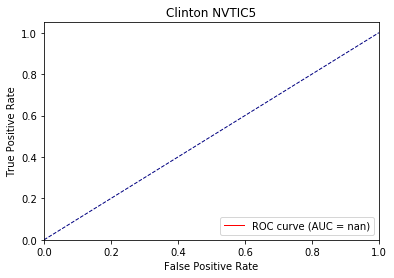

Directory already exists!
hc_nvtic5 1 ap tensor([1., 0.]) loss : 0.20550179481506348 0.22371548414230347 tid : 400 tg tensor([[0]], device='cuda:0')
hc_nvtic5 1 ap tensor([1., 0.]) loss : 0.19028133153915405 0.18059451824372952 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic5 1 ap tensor([1., 0.]) loss : 0.0756843090057373 0.09721440928322929 tid : 30 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic5 1 ap tensor([1., 0.]) loss : 0.09200584888458252 0.10185805483469887 tid : 330 tg tensor([[0]], device='cuda:0')


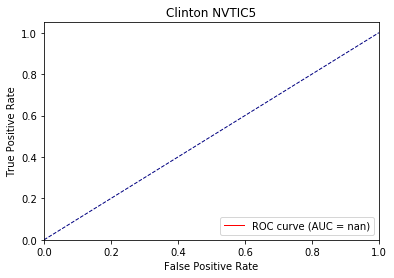

Directory already exists!
hc_nvtic5 2 ap tensor([1., 0.]) loss : 0.06116282939910889 0.08309728959027458 tid : 400 tg tensor([[0]], device='cuda:0')
hc_nvtic5 2 ap tensor([1., 0.]) loss : 0.06491923332214355 0.07908338273947056 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic5 2 ap tensor([1., 0.]) loss : 0.029616713523864746 0.045144030026027133 tid : 30 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic5 2 ap tensor([1., 0.]) loss : 0.04110062122344971 0.048135466991908966 tid : 330 tg tensor([[0]], device='cuda:0')


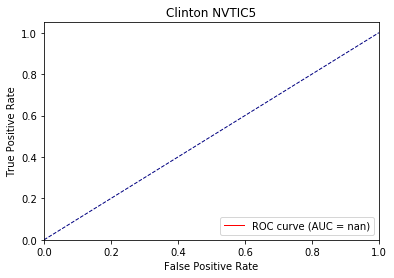

Directory already exists!
hc_nvtic4 0 ap tensor([0.9966, 0.0588]) loss : 0.5490905046463013 0.6113940926447307 tid : 400 tg tensor([[0]], device='cuda:0')
hc_nvtic4 0 ap tensor([0.9911, 0.0304]) loss : 0.42146730422973633 0.5460453000507857 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic4 0 ap tensor([0.8179, 0.1667]) loss : 1.508405089378357 0.4559555011136191 tid : 30 tg tensor([[1]], device='cuda:0')
TEST hc_nvtic4 0 ap tensor([0.9750, 0.0196]) loss : 0.25859498977661133 0.30485983027352226 tid : 330 tg tensor([[0]], device='cuda:0')


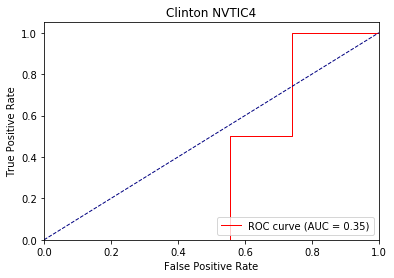

Directory already exists!
hc_nvtic4 1 ap tensor([0.9907, 0.0110]) loss : 0.18312859535217285 0.26203426210455194 tid : 200 tg tensor([[0]], device='cuda:0')
hc_nvtic4 1 ap tensor([0.9876, 0.0641]) loss : 0.1298491358757019 0.23420141987940846 tid : 400 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic4 1 ap tensor([0.8179, 0.1667]) loss : 2.33335542678833 0.45257149423871723 tid : 30 tg tensor([[1]], device='cuda:0')
TEST hc_nvtic4 1 ap tensor([0.9724, 0.0189]) loss : 0.1174783706665039 0.17177003196307591 tid : 330 tg tensor([[0]], device='cuda:0')


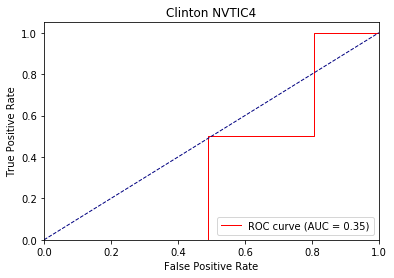

Directory already exists!
hc_nvtic4 2 ap tensor([1., 0.]) loss : 0.09267890453338623 0.12207113817089894 tid : 400 tg tensor([[0]], device='cuda:0')
hc_nvtic4 2 ap tensor([0.9858, 0.2649]) loss : 0.05427873134613037 0.1408113145785366 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic4 2 ap tensor([0.7345, 0.1429]) loss : 3.1640992164611816 0.5156614695276532 tid : 30 tg tensor([[1]], device='cuda:0')
TEST hc_nvtic4 2 ap tensor([0.9479, 0.0161]) loss : 0.05853307247161865 0.12151377068625556 tid : 330 tg tensor([[0]], device='cuda:0')


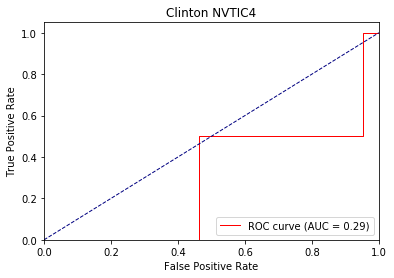

Directory already exists!
hc_interruptions 0 ap tensor([0.9980, 0.1667]) loss : 0.5471755862236023 0.6455576969128028 tid : 200 tg tensor([[0]], device='cuda:0')
hc_interruptions 0 ap tensor([0.9897, 0.1423]) loss : 0.3196045458316803 0.51182124790657 tid : 400 tg tensor([[0]], device='cuda:0')
TEST hc_interruptions 0 ap tensor([1., 0.]) loss : 0.25862857699394226 0.2857868586267744 tid : 30 tg tensor([[0]], device='cuda:0')
TEST hc_interruptions 0 ap tensor([0.9995, 0.3333]) loss : 0.31541121006011963 0.31195376222095794 tid : 330 tg tensor([[0]], device='cuda:0')


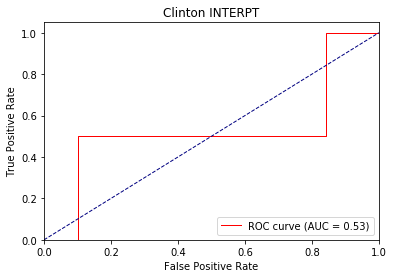

Directory already exists!
hc_interruptions 1 ap tensor([1., 1.]) loss : 0.20773303508758545 0.27751383265933477 tid : 200 tg tensor([[0]], device='cuda:0')
hc_interruptions 1 ap tensor([0.9946, 0.1255]) loss : 0.1343175172805786 0.239765038804428 tid : 400 tg tensor([[0]], device='cuda:0')
TEST hc_interruptions 1 ap tensor([1., 0.]) loss : 0.10988283157348633 0.14117489542279923 tid : 30 tg tensor([[0]], device='cuda:0')
TEST hc_interruptions 1 ap tensor([0.9984, 0.1429]) loss : 0.15389597415924072 0.16967454978397914 tid : 330 tg tensor([[0]], device='cuda:0')


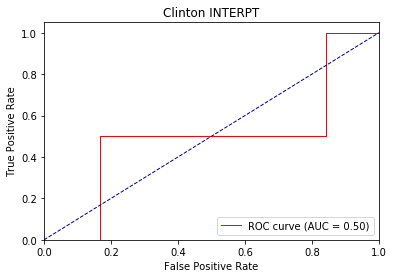

Directory already exists!
hc_interruptions 2 ap tensor([0.9973, 0.1409]) loss : 0.08652251958847046 0.14497969329357147 tid : 400 tg tensor([[0]], device='cuda:0')
hc_interruptions 2 ap tensor([0.9973, 0.1404]) loss : 0.0641254186630249 0.14344834647892754 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_interruptions 2 ap tensor([1., 0.]) loss : 0.054290056228637695 0.07701023135866437 tid : 30 tg tensor([[0]], device='cuda:0')
TEST hc_interruptions 2 ap tensor([0.9972, 0.0909]) loss : 0.08248656988143921 0.11410071168627058 tid : 330 tg tensor([[0]], device='cuda:0')


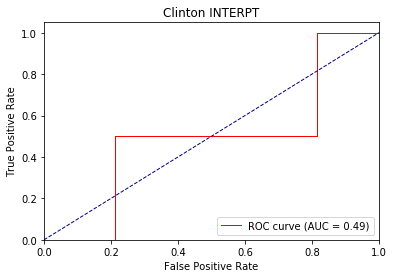

Directory already exists!
hc_lookat2 0 ap tensor([0.8764, 0.8535]) loss : 0.43237778544425964 0.6057420010385961 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_lookat2 0 ap tensor([0.9667, 0.5000]) loss : 0.6192623376846313 0.49523983895778656 tid : 30 tg tensor([[0]], device='cuda:0')
TEST hc_lookat2 0 ap tensor([0.9449, 0.7627]) loss : 0.6245219111442566 0.5007345924774805 tid : 300 tg tensor([[0]], device='cuda:0')
TEST hc_lookat2 0 ap tensor([0.9049, 0.8109]) loss : 0.3942629396915436 0.5193520806337658 tid : 450 tg tensor([[1]], device='cuda:0')


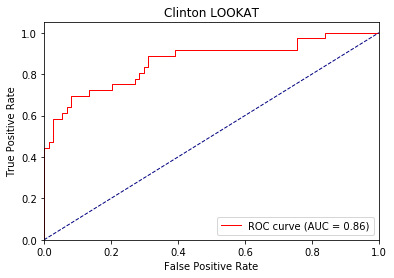

Directory already exists!
hc_lookat2 1 ap tensor([0.9518, 0.9615]) loss : 0.38683459162712097 0.44129141060622423 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_lookat2 1 ap tensor([0.9667, 0.5000]) loss : 0.7031967639923096 0.4582147349913915 tid : 30 tg tensor([[0]], device='cuda:0')
TEST hc_lookat2 1 ap tensor([0.9428, 0.7664]) loss : 0.5664516091346741 0.4563301568229993 tid : 300 tg tensor([[0]], device='cuda:0')
TEST hc_lookat2 1 ap tensor([0.9087, 0.8118]) loss : 0.18124884366989136 0.4707380357541536 tid : 450 tg tensor([[1]], device='cuda:0')


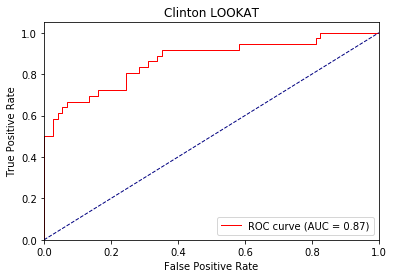

Directory already exists!
hc_lookat2 2 ap tensor([0.9462, 0.9557]) loss : 0.3119274377822876 0.3488066102227857 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_lookat2 2 ap tensor([0.9667, 0.5000]) loss : 0.7510581612586975 0.43141887585322064 tid : 30 tg tensor([[0]], device='cuda:0')
TEST hc_lookat2 2 ap tensor([0.9324, 0.7729]) loss : 0.4747430086135864 0.43293868054946266 tid : 300 tg tensor([[0]], device='cuda:0')
TEST hc_lookat2 2 ap tensor([0.9080, 0.8147]) loss : 0.10012125968933105 0.4463008099480679 tid : 450 tg tensor([[1]], device='cuda:0')


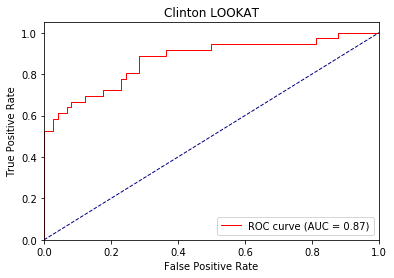

Directory already exists!
hc_brush1 0 ap tensor([0.8592, 0.1000]) loss : 0.43935275077819824 0.5860243922342425 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_brush1 0 ap tensor([1., 0.]) loss : 0.3388524651527405 0.40942398210366565 tid : 30 tg tensor([[0]], device='cuda:0')
TEST hc_brush1 0 ap tensor([0.9389, 0.3380]) loss : 0.2997053265571594 0.4508378729224205 tid : 300 tg tensor([[0]], device='cuda:0')
TEST hc_brush1 0 ap tensor([0.8776, 0.2914]) loss : 0.351489394903183 0.519692956146441 tid : 450 tg tensor([[0]], device='cuda:0')


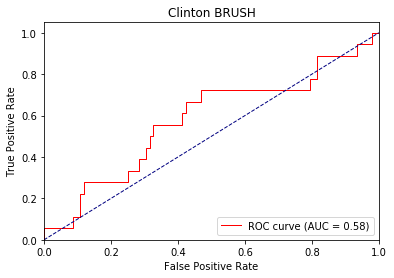

Directory already exists!
hc_brush1 1 ap tensor([0.9009, 0.0498]) loss : 0.3344953656196594 0.43837314333234517 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_brush1 1 ap tensor([1., 0.]) loss : 0.22703731060028076 0.2704343299070994 tid : 30 tg tensor([[0]], device='cuda:0')
TEST hc_brush1 1 ap tensor([0.9800, 0.4715]) loss : 0.19172024726867676 0.3415153279900551 tid : 300 tg tensor([[0]], device='cuda:0')
TEST hc_brush1 1 ap tensor([0.9395, 0.4007]) loss : 0.2598111629486084 0.4532541058565441 tid : 450 tg tensor([[0]], device='cuda:0')


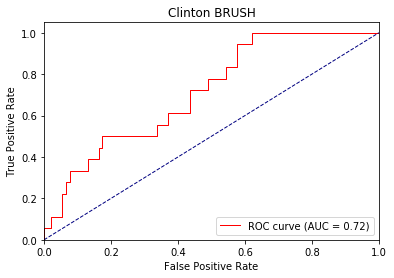

Directory already exists!
hc_brush1 2 ap tensor([0.9708, 0.4718]) loss : 0.20472562313079834 0.3828295675607828 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_brush1 2 ap tensor([1., 0.]) loss : 0.1757737398147583 0.19685934980710348 tid : 30 tg tensor([[0]], device='cuda:0')
TEST hc_brush1 2 ap tensor([0.9885, 0.4683]) loss : 0.13616037368774414 0.2890873918930689 tid : 300 tg tensor([[0]], device='cuda:0')
TEST hc_brush1 2 ap tensor([0.9442, 0.4514]) loss : 0.21625608205795288 0.4279302976633373 tid : 450 tg tensor([[0]], device='cuda:0')


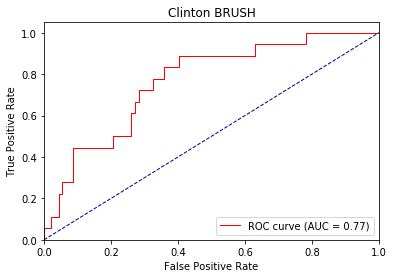

Directory already exists!
hc_nvdis1 0 ap tensor([0.8684, 0.0763]) loss : 0.6718955039978027 0.7758263507310081 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_nvdis1 0 ap tensor([1., 1.]) loss : 0.3903473913669586 0.5502144147952398 tid : 30 tg tensor([[0]], device='cuda:0')
TEST hc_nvdis1 0 ap tensor([0.9507, 0.3823]) loss : 0.334815114736557 0.5182181576887767 tid : 300 tg tensor([[0]], device='cuda:0')
TEST hc_nvdis1 0 ap tensor([0.8948, 0.4304]) loss : 0.33722150325775146 0.547611108265425 tid : 450 tg tensor([[0]], device='cuda:0')


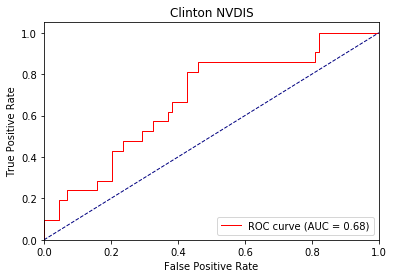

Directory already exists!
hc_nvdis1 1 ap tensor([0.9558, 0.3558]) loss : 0.24075037240982056 0.3934329332805228 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_nvdis1 1 ap tensor([1., 1.]) loss : 0.2166622281074524 0.570806473493576 tid : 30 tg tensor([[0]], device='cuda:0')
TEST hc_nvdis1 1 ap tensor([0.9514, 0.3618]) loss : 0.18388694524765015 0.41434318919976554 tid : 300 tg tensor([[0]], device='cuda:0')
TEST hc_nvdis1 1 ap tensor([0.9042, 0.5282]) loss : 0.16551077365875244 0.47123730402243763 tid : 450 tg tensor([[0]], device='cuda:0')


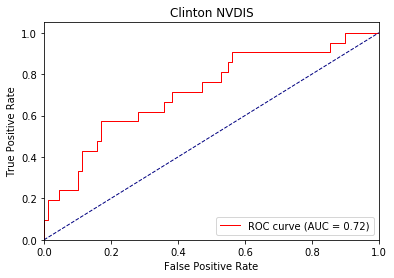

Directory already exists!
hc_nvdis1 2 ap tensor([0.9700, 0.6514]) loss : 0.152615487575531 0.31256965692191163 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_nvdis1 2 ap tensor([1., 1.]) loss : 0.13353008031845093 0.659141480922699 tid : 30 tg tensor([[0]], device='cuda:0')
TEST hc_nvdis1 2 ap tensor([0.9310, 0.3505]) loss : 0.11610716581344604 0.3935203363498052 tid : 300 tg tensor([[0]], device='cuda:0')
TEST hc_nvdis1 2 ap tensor([0.8810, 0.5083]) loss : 0.10500538349151611 0.46643596950330235 tid : 450 tg tensor([[0]], device='cuda:0')


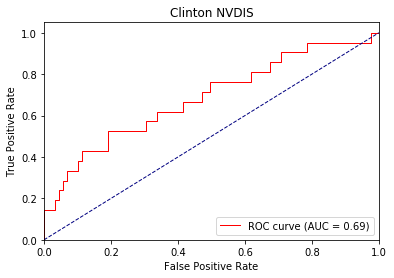

Directory already exists!
hc_look 0 ap tensor([0.5582, 0.9108]) loss : 0.566629946231842 0.6256798631324 tid : 200 tg tensor([[1]], device='cuda:0')
TEST hc_look 0 ap tensor([0., 1.]) loss : 0.5944671630859375 0.4734022418657939 tid : 30 tg tensor([[1]], device='cuda:0')
TEST hc_look 0 ap tensor([0.5479, 0.9879]) loss : 0.5599274635314941 0.5109733238816261 tid : 300 tg tensor([[1]], device='cuda:0')
TEST hc_look 0 ap tensor([0.5587, 0.9840]) loss : 0.5023643970489502 0.5208637871240315 tid : 450 tg tensor([[0]], device='cuda:0')


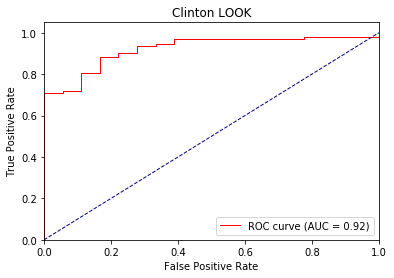

Directory already exists!
hc_look 1 ap tensor([0.7167, 0.9559]) loss : 0.28220367431640625 0.47687343190766307 tid : 200 tg tensor([[1]], device='cuda:0')
TEST hc_look 1 ap tensor([0., 1.]) loss : 0.46985992789268494 0.33188020686308545 tid : 30 tg tensor([[1]], device='cuda:0')
TEST hc_look 1 ap tensor([0.5876, 0.9917]) loss : 0.42357006669044495 0.39345156798760095 tid : 300 tg tensor([[1]], device='cuda:0')
TEST hc_look 1 ap tensor([0.5671, 0.9852]) loss : 0.41786953806877136 0.41596635799658926 tid : 450 tg tensor([[0]], device='cuda:0')


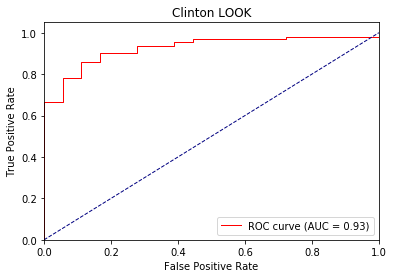

Directory already exists!
hc_look 2 ap tensor([0.7895, 0.9706]) loss : 0.21632462739944458 0.3977307444212758 tid : 200 tg tensor([[1]], device='cuda:0')
TEST hc_look 2 ap tensor([0., 1.]) loss : 0.40926340222358704 0.2577347159385681 tid : 30 tg tensor([[1]], device='cuda:0')
TEST hc_look 2 ap tensor([0.5997, 0.9925]) loss : 0.3361490070819855 0.32838859409093857 tid : 300 tg tensor([[1]], device='cuda:0')
TEST hc_look 2 ap tensor([0.5882, 0.9861]) loss : 0.3510519862174988 0.3580601955714979 tid : 450 tg tensor([[0]], device='cuda:0')


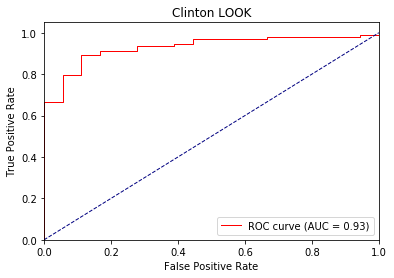

Directory already exists!
hc_eyebrow 0 ap tensor([0.8019, 0.3894]) loss : 0.8305809497833252 0.6152749841029828 tid : 200 tg tensor([[1]], device='cuda:0')
TEST hc_eyebrow 0 ap tensor([0.8875, 0.7500]) loss : 0.4373885989189148 0.6141285101572672 tid : 30 tg tensor([[0]], device='cuda:0')
TEST hc_eyebrow 0 ap tensor([0.8135, 0.4862]) loss : 1.0582696199417114 0.6133993243177732 tid : 300 tg tensor([[1]], device='cuda:0')
TEST hc_eyebrow 0 ap tensor([0.8592, 0.4657]) loss : 0.22487962245941162 0.5852481773025111 tid : 450 tg tensor([[0]], device='cuda:0')


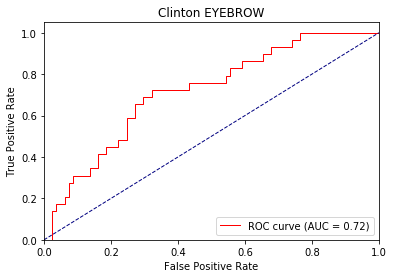

Directory already exists!
hc_eyebrow 1 ap tensor([0.9335, 0.7695]) loss : 0.7625151872634888 0.500713985306876 tid : 200 tg tensor([[1]], device='cuda:0')
TEST hc_eyebrow 1 ap tensor([0.9500, 0.8333]) loss : 0.3947920501232147 0.5712806930144628 tid : 30 tg tensor([[0]], device='cuda:0')
TEST hc_eyebrow 1 ap tensor([0.8292, 0.5225]) loss : 0.9844927787780762 0.588773534198602 tid : 300 tg tensor([[1]], device='cuda:0')
TEST hc_eyebrow 1 ap tensor([0.8808, 0.5241]) loss : 0.10901904106140137 0.5557759492020858 tid : 450 tg tensor([[0]], device='cuda:0')


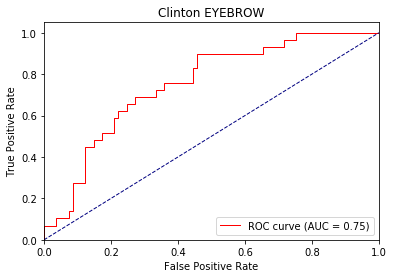

Directory already exists!
hc_eyebrow 2 ap tensor([0.9420, 0.8082]) loss : 0.7201303243637085 0.44283066507595686 tid : 200 tg tensor([[1]], device='cuda:0')
TEST hc_eyebrow 2 ap tensor([0.9500, 0.8333]) loss : 0.36317500472068787 0.5409750739733378 tid : 30 tg tensor([[0]], device='cuda:0')
TEST hc_eyebrow 2 ap tensor([0.8350, 0.5334]) loss : 0.8868386745452881 0.5797668074568113 tid : 300 tg tensor([[1]], device='cuda:0')
TEST hc_eyebrow 2 ap tensor([0.8886, 0.5378]) loss : 0.06687760353088379 0.5425503602153376 tid : 450 tg tensor([[0]], device='cuda:0')


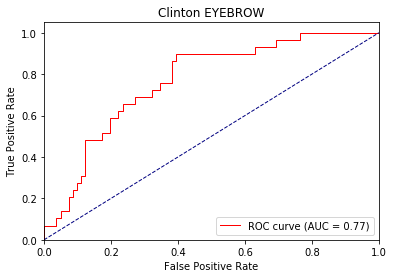

Directory already exists!
hc_atface 0 ap tensor([0.9118, 0.1524]) loss : 1.1499332189559937 0.5100375189833397 tid : 200 tg tensor([[1]], device='cuda:0')
TEST hc_atface 0 ap tensor([1., 0.]) loss : 0.374234676361084 0.41720664997895557 tid : 30 tg tensor([[0]], device='cuda:0')
TEST hc_atface 0 ap tensor([0.8208, 0.5404]) loss : 1.2037822008132935 0.5750753993789355 tid : 300 tg tensor([[1]], device='cuda:0')
TEST hc_atface 0 ap tensor([0.8331, 0.4350]) loss : 0.211536705493927 0.5418125698440953 tid : 450 tg tensor([[0]], device='cuda:0')


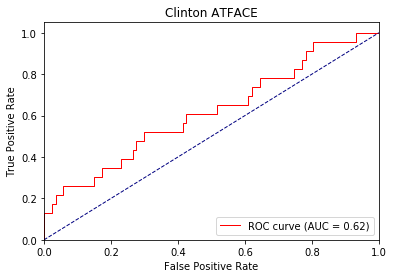

Directory already exists!
hc_atface 1 ap tensor([0.9595, 0.2792]) loss : 1.3854873180389404 0.3936116151271328 tid : 200 tg tensor([[1]], device='cuda:0')
TEST hc_atface 1 ap tensor([1., 0.]) loss : 0.23884844779968262 0.30821601549784344 tid : 30 tg tensor([[0]], device='cuda:0')
TEST hc_atface 1 ap tensor([0.8605, 0.6047]) loss : 1.42046058177948 0.5515973821282387 tid : 300 tg tensor([[1]], device='cuda:0')
TEST hc_atface 1 ap tensor([0.8680, 0.5049]) loss : 0.10228639841079712 0.5085623229804792 tid : 450 tg tensor([[0]], device='cuda:0')


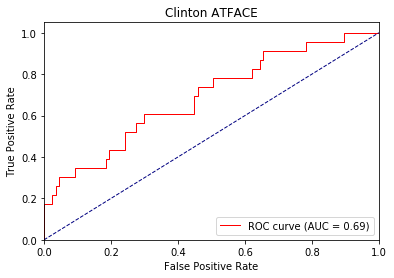

Directory already exists!
hc_atface 2 ap tensor([0.9647, 0.3542]) loss : 1.550922155380249 0.3561060800916309 tid : 200 tg tensor([[1]], device='cuda:0')
TEST hc_atface 2 ap tensor([1., 0.]) loss : 0.18044370412826538 0.25901178518931073 tid : 30 tg tensor([[0]], device='cuda:0')
TEST hc_atface 2 ap tensor([0.8886, 0.6395]) loss : 1.4748425483703613 0.5425211777289708 tid : 300 tg tensor([[1]], device='cuda:0')
TEST hc_atface 2 ap tensor([0.8909, 0.5466]) loss : 0.06234145164489746 0.4947909342615228 tid : 450 tg tensor([[0]], device='cuda:0')


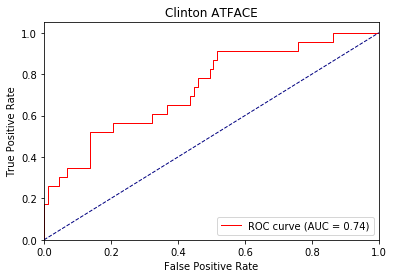

Directory already exists!
hc_feface 0 ap tensor([1., 0.]) loss : 0.316178560256958 0.5548815006529525 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_feface 0 ap tensor([1., 0.]) loss : 0.3416523337364197 0.37657110889752704 tid : 30 tg tensor([[0]], device='cuda:0')
TEST hc_feface 0 ap tensor([1., 0.]) loss : 0.296642541885376 0.3586209565401077 tid : 300 tg tensor([[0]], device='cuda:0')
TEST hc_feface 0 ap tensor([1., 0.]) loss : 0.292791485786438 0.36050430065707156 tid : 450 tg tensor([[0]], device='cuda:0')


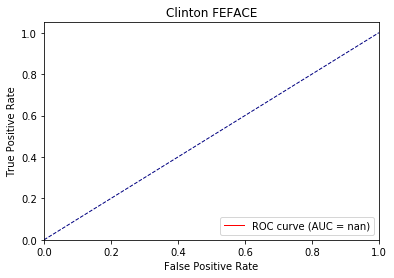

Directory already exists!
hc_feface 1 ap tensor([1., 0.]) loss : 0.1680358648300171 0.27133631627116583 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_feface 1 ap tensor([1., 0.]) loss : 0.12818121910095215 0.17315330108006796 tid : 30 tg tensor([[0]], device='cuda:0')
TEST hc_feface 1 ap tensor([1., 0.]) loss : 0.12432217597961426 0.16968988478183747 tid : 300 tg tensor([[0]], device='cuda:0')
TEST hc_feface 1 ap tensor([1., 0.]) loss : 0.10109055042266846 0.17470660523364417 tid : 450 tg tensor([[0]], device='cuda:0')


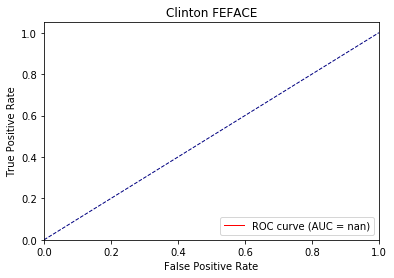

Directory already exists!
hc_feface 2 ap tensor([1., 0.]) loss : 0.054418206214904785 0.11371295546230517 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_feface 2 ap tensor([1., 0.]) loss : 0.0495222806930542 0.0772546927134196 tid : 30 tg tensor([[0]], device='cuda:0')
TEST hc_feface 2 ap tensor([1., 0.]) loss : 0.051529645919799805 0.08254812558492025 tid : 300 tg tensor([[0]], device='cuda:0')
TEST hc_feface 2 ap tensor([1., 0.]) loss : 0.040853261947631836 0.08830577699761642 tid : 450 tg tensor([[0]], device='cuda:0')


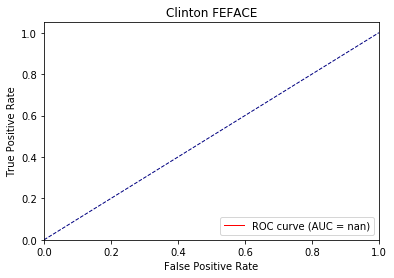

Directory already exists!
hc_hrface 0 ap tensor([0.4973, 0.5265]) loss : 0.7774604558944702 0.7049438837170601 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_hrface 0 ap tensor([0.8100, 0.2000]) loss : 0.8231347799301147 0.785097082455953 tid : 30 tg tensor([[0]], device='cuda:0')
TEST hc_hrface 0 ap tensor([0.7862, 0.3655]) loss : 0.6033388376235962 0.7195577298601469 tid : 300 tg tensor([[0]], device='cuda:0')
TEST hc_hrface 0 ap tensor([0.7628, 0.4034]) loss : 0.8481258749961853 0.7205042434366126 tid : 450 tg tensor([[0]], device='cuda:0')


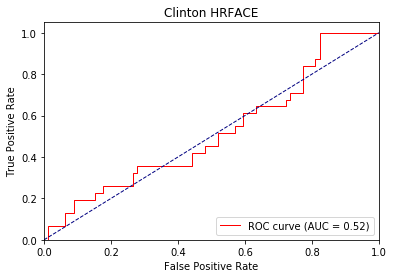

Directory already exists!
hc_hrface 1 ap tensor([0.7063, 0.7018]) loss : 0.6303098201751709 0.6567106346289316 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_hrface 1 ap tensor([0.8100, 0.2000]) loss : 0.7513390779495239 0.7550478378931681 tid : 30 tg tensor([[0]], device='cuda:0')
TEST hc_hrface 1 ap tensor([0.8282, 0.4635]) loss : 0.528470516204834 0.6723468244075775 tid : 300 tg tensor([[0]], device='cuda:0')
TEST hc_hrface 1 ap tensor([0.8012, 0.4952]) loss : 0.808550238609314 0.6795347003560317 tid : 450 tg tensor([[0]], device='cuda:0')


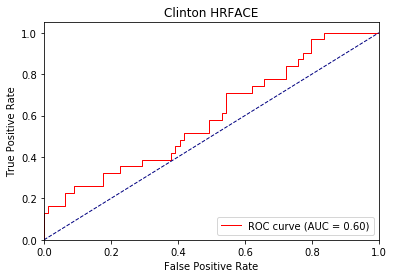

Directory already exists!
hc_hrface 2 ap tensor([0.6757, 0.8157]) loss : 0.6009019017219543 0.6270073426030848 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_hrface 2 ap tensor([0.8100, 0.2000]) loss : 0.6907800436019897 0.7372904568910599 tid : 30 tg tensor([[0]], device='cuda:0')
TEST hc_hrface 2 ap tensor([0.8490, 0.5109]) loss : 0.46615490317344666 0.6374334906538327 tid : 300 tg tensor([[0]], device='cuda:0')
TEST hc_hrface 2 ap tensor([0.8171, 0.5530]) loss : 0.7710986137390137 0.6487345168465062 tid : 450 tg tensor([[0]], device='cuda:0')


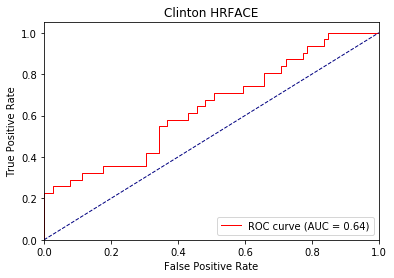

Directory already exists!
hc_saface 0 ap tensor([0.9959, 0.0263]) loss : 0.7404589653015137 0.6864285365028201 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_saface 0 ap tensor([1., 0.]) loss : 0.4646638333797455 0.4132344275712967 tid : 30 tg tensor([[0]], device='cuda:0')
TEST hc_saface 0 ap tensor([1., 0.]) loss : 0.4555785059928894 0.3936440795660019 tid : 300 tg tensor([[0]], device='cuda:0')
TEST hc_saface 0 ap tensor([1., 0.]) loss : 0.26077523827552795 0.3920342316752986 tid : 450 tg tensor([[0]], device='cuda:0')


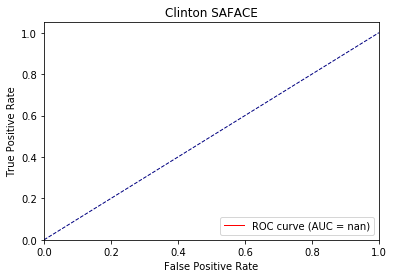

Directory already exists!
hc_saface 1 ap tensor([0.9972, 0.0588]) loss : 0.31633561849594116 0.3382832429704875 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_saface 1 ap tensor([1., 0.]) loss : 0.21620792150497437 0.21244403719902039 tid : 30 tg tensor([[0]], device='cuda:0')
TEST hc_saface 1 ap tensor([1., 0.]) loss : 0.2366095781326294 0.20627323190371197 tid : 300 tg tensor([[0]], device='cuda:0')
TEST hc_saface 1 ap tensor([1., 0.]) loss : 0.10498923063278198 0.20869907925003453 tid : 450 tg tensor([[0]], device='cuda:0')


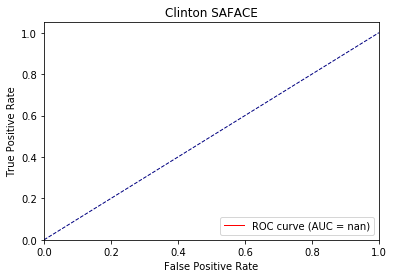

Directory already exists!
hc_saface 2 ap tensor([0.9982, 0.0631]) loss : 0.10257542133331299 0.1657766400699547 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_saface 2 ap tensor([1., 0.]) loss : 0.09848999977111816 0.11134789387385051 tid : 30 tg tensor([[0]], device='cuda:0')
TEST hc_saface 2 ap tensor([1., 0.]) loss : 0.11867094039916992 0.11294845590988795 tid : 300 tg tensor([[0]], device='cuda:0')
TEST hc_saface 2 ap tensor([1., 0.]) loss : 0.049314022064208984 0.11668300816887303 tid : 450 tg tensor([[0]], device='cuda:0')


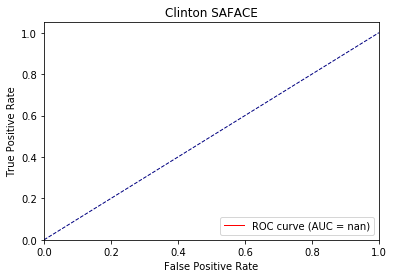

Directory already exists!
hc_neuface 0 ap tensor([0.6777, 0.3122]) loss : 0.7051910161972046 0.7291808297314982 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_neuface 0 ap tensor([0.1667, 0.7100]) loss : 0.868705689907074 0.8251691460609436 tid : 30 tg tensor([[1]], device='cuda:0')
TEST hc_neuface 0 ap tensor([0.4375, 0.3297]) loss : 0.8469374179840088 0.7312934676806132 tid : 300 tg tensor([[0]], device='cuda:0')
TEST hc_neuface 0 ap tensor([0.4368, 0.3617]) loss : 0.7809176445007324 0.7305873513221741 tid : 450 tg tensor([[1]], device='cuda:0')


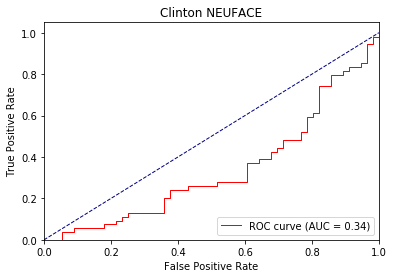

Directory already exists!
hc_neuface 1 ap tensor([0.7273, 0.4633]) loss : 0.5774129629135132 0.664236282636238 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_neuface 1 ap tensor([0.1667, 0.7100]) loss : 0.9255945086479187 0.8686381081740061 tid : 30 tg tensor([[1]], device='cuda:0')
TEST hc_neuface 1 ap tensor([0.4696, 0.3530]) loss : 0.7399191856384277 0.7173123508691788 tid : 300 tg tensor([[0]], device='cuda:0')
TEST hc_neuface 1 ap tensor([0.4741, 0.3856]) loss : 0.8515297174453735 0.71951576408587 tid : 450 tg tensor([[1]], device='cuda:0')


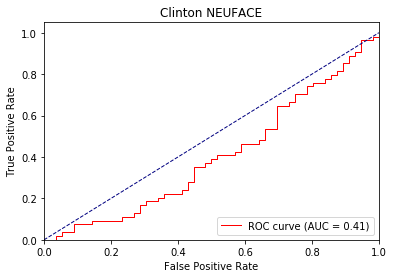

Directory already exists!
hc_neuface 2 ap tensor([0.8059, 0.5731]) loss : 0.5419309139251709 0.6403149009243516 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_neuface 2 ap tensor([0.1667, 0.7100]) loss : 0.9486966133117676 0.8941735327243805 tid : 30 tg tensor([[1]], device='cuda:0')
TEST hc_neuface 2 ap tensor([0.5382, 0.4165]) loss : 0.6737269759178162 0.7035052036245664 tid : 300 tg tensor([[0]], device='cuda:0')
TEST hc_neuface 2 ap tensor([0.5397, 0.4306]) loss : 0.8623254299163818 0.7067978360150989 tid : 450 tg tensor([[1]], device='cuda:0')


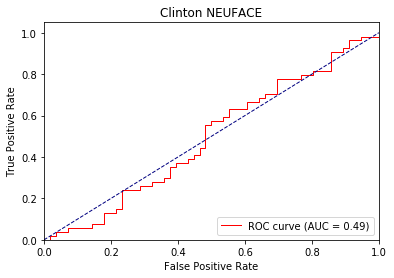

Directory already exists!
hc_inapprop 0 ap tensor([1., 0.]) loss : 0.2654687464237213 0.43613084136091884 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_inapprop 0 ap tensor([1., 0.]) loss : 0.24106913805007935 0.3158808946609497 tid : 30 tg tensor([[0]], device='cuda:0')
TEST hc_inapprop 0 ap tensor([1., 0.]) loss : 0.24841007590293884 0.29729858338832854 tid : 300 tg tensor([[0]], device='cuda:0')
TEST hc_inapprop 0 ap tensor([1., 0.]) loss : 0.16650092601776123 0.3047871501822221 tid : 450 tg tensor([[0]], device='cuda:0')


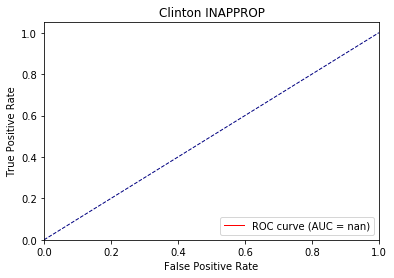

Directory already exists!
hc_inapprop 1 ap tensor([1., 0.]) loss : 0.10012215375900269 0.2035012603879305 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_inapprop 1 ap tensor([1., 0.]) loss : 0.09051942825317383 0.14511748651663461 tid : 30 tg tensor([[0]], device='cuda:0')
TEST hc_inapprop 1 ap tensor([1., 0.]) loss : 0.09973412752151489 0.1405246083935102 tid : 300 tg tensor([[0]], device='cuda:0')
TEST hc_inapprop 1 ap tensor([1., 0.]) loss : 0.06434744596481323 0.14655090005774246 tid : 450 tg tensor([[0]], device='cuda:0')


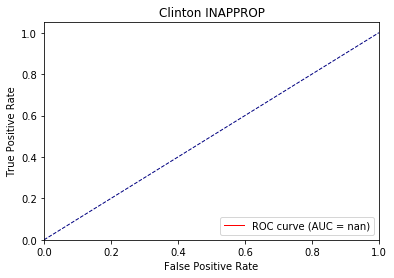

Directory already exists!
hc_inapprop 2 ap tensor([1., 0.]) loss : 0.06504213809967041 0.1224879256139199 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_inapprop 2 ap tensor([1., 0.]) loss : 0.03331291675567627 0.0666460394859314 tid : 30 tg tensor([[0]], device='cuda:0')
TEST hc_inapprop 2 ap tensor([1., 0.]) loss : 0.04081869125366211 0.069718703130881 tid : 300 tg tensor([[0]], device='cuda:0')
TEST hc_inapprop 2 ap tensor([1., 0.]) loss : 0.028533220291137695 0.07426939732150027 tid : 450 tg tensor([[0]], device='cuda:0')


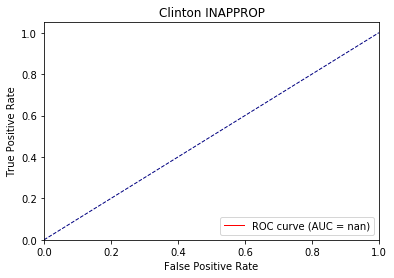

Directory already exists!
hc_affgest 0 ap tensor([0.9152, 0.0714]) loss : 0.5173537731170654 0.6168595394667458 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_affgest 0 ap tensor([1., 0.]) loss : 0.24174493551254272 0.31510942180951435 tid : 30 tg tensor([[0]], device='cuda:0')
TEST hc_affgest 0 ap tensor([1., 0.]) loss : 0.34421902894973755 0.32698745330174767 tid : 300 tg tensor([[0]], device='cuda:0')
TEST hc_affgest 0 ap tensor([1., 0.]) loss : 0.2115459442138672 0.3323116719722748 tid : 450 tg tensor([[0]], device='cuda:0')


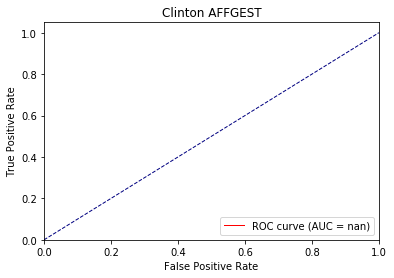

Directory already exists!
hc_affgest 1 ap tensor([0.9810, 0.1242]) loss : 0.15445846319198608 0.29795975365528937 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_affgest 1 ap tensor([1., 0.]) loss : 0.12305045127868652 0.20499561727046967 tid : 30 tg tensor([[0]], device='cuda:0')
TEST hc_affgest 1 ap tensor([1., 0.]) loss : 0.19336950778961182 0.20821940451860427 tid : 300 tg tensor([[0]], device='cuda:0')
TEST hc_affgest 1 ap tensor([1., 0.]) loss : 0.08130860328674316 0.2141130883442728 tid : 450 tg tensor([[0]], device='cuda:0')


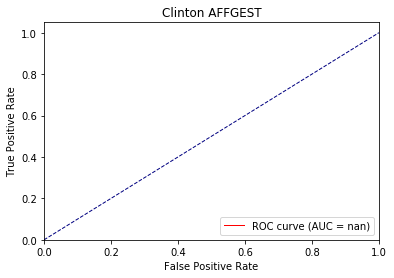

Directory already exists!
hc_affgest 2 ap tensor([0.9899, 0.2865]) loss : 0.11410641670227051 0.22974583221709027 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_affgest 2 ap tensor([1., 0.]) loss : 0.07330501079559326 0.15219816068808237 tid : 30 tg tensor([[0]], device='cuda:0')
TEST hc_affgest 2 ap tensor([1., 0.]) loss : 0.12298524379730225 0.15259855886300405 tid : 300 tg tensor([[0]], device='cuda:0')
TEST hc_affgest 2 ap tensor([1., 0.]) loss : 0.04004371166229248 0.1581872350291202 tid : 450 tg tensor([[0]], device='cuda:0')


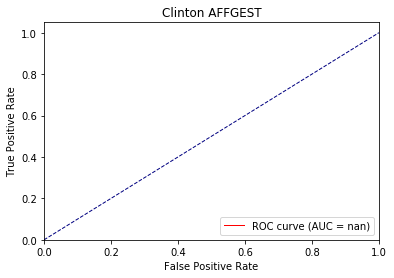

Directory already exists!
hc_defgest 0 ap tensor([0.8857, 0.1048]) loss : 0.4667574167251587 0.599703298509121 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_defgest 0 ap tensor([1., 0.]) loss : 0.34010404348373413 0.3754696200291316 tid : 30 tg tensor([[0]], device='cuda:0')
TEST hc_defgest 0 ap tensor([0.8303, 0.3742]) loss : 0.47963225841522217 0.6014972656965256 tid : 300 tg tensor([[0]], device='cuda:0')
TEST hc_defgest 0 ap tensor([0.8698, 0.2973]) loss : 0.30667823553085327 0.5652333736419678 tid : 450 tg tensor([[0]], device='cuda:0')


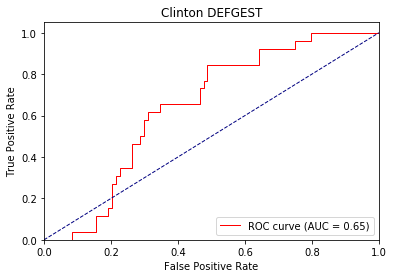

Directory already exists!
hc_defgest 1 ap tensor([0.9471, 0.2577]) loss : 0.3774024248123169 0.49503280448191095 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_defgest 1 ap tensor([1., 0.]) loss : 0.19917994737625122 0.25878939032554626 tid : 30 tg tensor([[0]], device='cuda:0')
TEST hc_defgest 1 ap tensor([0.8622, 0.4372]) loss : 0.2924339175224304 0.5897366990645726 tid : 300 tg tensor([[0]], device='cuda:0')
TEST hc_defgest 1 ap tensor([0.8794, 0.3294]) loss : 0.13519573211669922 0.5312384109748037 tid : 450 tg tensor([[0]], device='cuda:0')


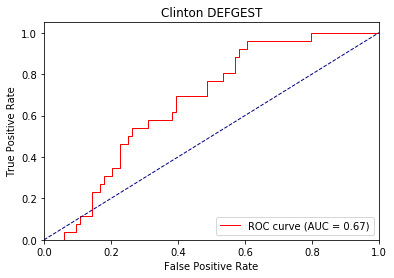

Directory already exists!
hc_defgest 2 ap tensor([0.9717, 0.2076]) loss : 0.18845003843307495 0.3339969128266805 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_defgest 2 ap tensor([1., 0.]) loss : 0.13316917419433594 0.20138650635878244 tid : 30 tg tensor([[0]], device='cuda:0')
TEST hc_defgest 2 ap tensor([0.8665, 0.4591]) loss : 0.21338516473770142 0.6019489735364913 tid : 300 tg tensor([[0]], device='cuda:0')
TEST hc_defgest 2 ap tensor([0.8809, 0.3422]) loss : 0.07218945026397705 0.5308333497298391 tid : 450 tg tensor([[0]], device='cuda:0')


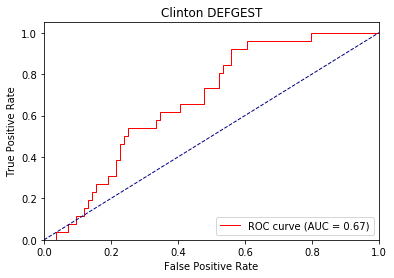

Directory already exists!
hc_agentic 0 ap tensor([0.8642, 0.8061]) loss : 0.5936524271965027 0.6291821960652813 tid : 200 tg tensor([[1]], device='cuda:0')
TEST hc_agentic 0 ap tensor([1., 1.]) loss : 0.7001941204071045 0.5676459272702535 tid : 30 tg tensor([[0]], device='cuda:0')
TEST hc_agentic 0 ap tensor([0.8632, 0.9424]) loss : 0.6223219037055969 0.5361286277572314 tid : 300 tg tensor([[1]], device='cuda:0')
TEST hc_agentic 0 ap tensor([0.8815, 0.9203]) loss : 0.3052694797515869 0.5385556512757351 tid : 450 tg tensor([[0]], device='cuda:0')


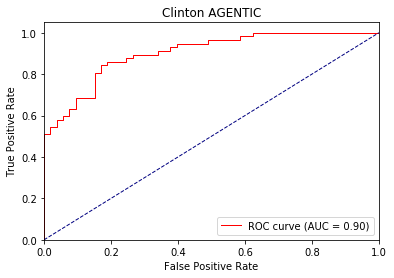

Directory already exists!
hc_agentic 1 ap tensor([0.9901, 0.9925]) loss : 0.49211442470550537 0.4198954469627804 tid : 200 tg tensor([[1]], device='cuda:0')
TEST hc_agentic 1 ap tensor([1., 1.]) loss : 0.6280550956726074 0.4518655737241109 tid : 30 tg tensor([[0]], device='cuda:0')
TEST hc_agentic 1 ap tensor([0.8793, 0.9599]) loss : 0.4822065234184265 0.4294148196776708 tid : 300 tg tensor([[1]], device='cuda:0')
TEST hc_agentic 1 ap tensor([0.9064, 0.9523]) loss : 0.15264654159545898 0.43655916170070047 tid : 450 tg tensor([[0]], device='cuda:0')


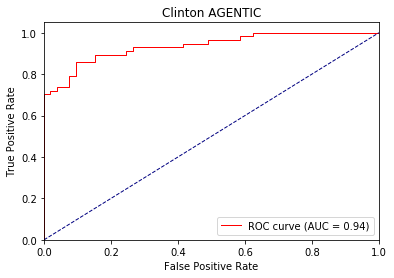

Directory already exists!
hc_agentic 2 ap tensor([0.9793, 0.9776]) loss : 0.36194390058517456 0.30036349732654927 tid : 200 tg tensor([[1]], device='cuda:0')
TEST hc_agentic 2 ap tensor([1., 1.]) loss : 0.5427935719490051 0.3534574160973231 tid : 30 tg tensor([[0]], device='cuda:0')
TEST hc_agentic 2 ap tensor([0.8934, 0.9660]) loss : 0.32833805680274963 0.3616185888648033 tid : 300 tg tensor([[1]], device='cuda:0')
TEST hc_agentic 2 ap tensor([0.9191, 0.9642]) loss : 0.08515000343322754 0.36946691337384674 tid : 450 tg tensor([[0]], device='cuda:0')


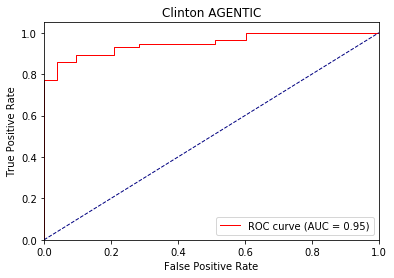

Directory already exists!
hc_waveoff 0 ap tensor([0.8769, 0.7289]) loss : 0.6559429168701172 0.6213689546870149 tid : 200 tg tensor([[1]], device='cuda:0')
TEST hc_waveoff 0 ap tensor([1., 1.]) loss : 0.5419777035713196 0.5403144061565399 tid : 30 tg tensor([[0]], device='cuda:0')
TEST hc_waveoff 0 ap tensor([0.8602, 0.8797]) loss : 0.700169563293457 0.56692702571551 tid : 300 tg tensor([[0]], device='cuda:0')
TEST hc_waveoff 0 ap tensor([0.8617, 0.8205]) loss : 0.2917579412460327 0.570467837547001 tid : 450 tg tensor([[0]], device='cuda:0')


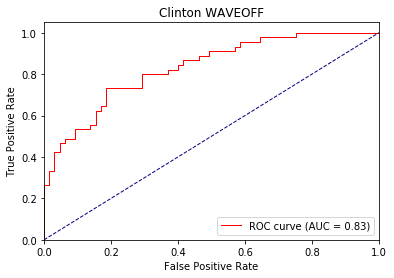

Directory already exists!
hc_waveoff 1 ap tensor([0.9374, 0.7474]) loss : 0.6693782210350037 0.5210245369478713 tid : 200 tg tensor([[1]], device='cuda:0')
TEST hc_waveoff 1 ap tensor([1., 1.]) loss : 0.45031869411468506 0.4843314091364543 tid : 30 tg tensor([[0]], device='cuda:0')
TEST hc_waveoff 1 ap tensor([0.8616, 0.8907]) loss : 0.753009021282196 0.5258599842588106 tid : 300 tg tensor([[0]], device='cuda:0')
TEST hc_waveoff 1 ap tensor([0.8705, 0.8287]) loss : 0.15419459342956543 0.5295540495922691 tid : 450 tg tensor([[0]], device='cuda:0')


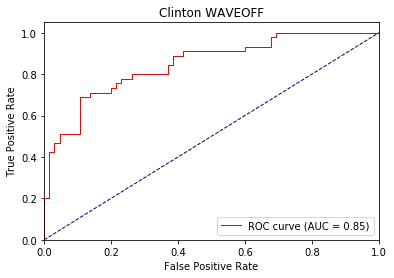

Directory already exists!
hc_waveoff 2 ap tensor([0.9492, 0.7656]) loss : 0.6207363605499268 0.4181607327927118 tid : 200 tg tensor([[1]], device='cuda:0')
TEST hc_waveoff 2 ap tensor([1., 1.]) loss : 0.396792471408844 0.45157553752263385 tid : 30 tg tensor([[0]], device='cuda:0')
TEST hc_waveoff 2 ap tensor([0.8590, 0.8846]) loss : 0.8709258437156677 0.5060538336634636 tid : 300 tg tensor([[0]], device='cuda:0')
TEST hc_waveoff 2 ap tensor([0.8741, 0.8295]) loss : 0.09526216983795166 0.5087371634809594 tid : 450 tg tensor([[0]], device='cuda:0')


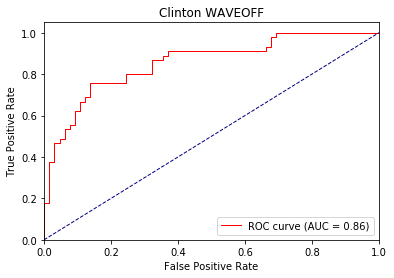

Directory already exists!
hc_nvtic1 0 ap tensor([0.9317, 0.2239]) loss : 0.5082954168319702 0.5967483459548517 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic1 0 ap tensor([0.9667, 0.5000]) loss : 0.45461687445640564 0.48145803809165955 tid : 30 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic1 0 ap tensor([0.7957, 0.3824]) loss : 0.4806266129016876 0.5617866749564807 tid : 300 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic1 0 ap tensor([0.8335, 0.3721]) loss : 0.41950395703315735 0.545057830998772 tid : 450 tg tensor([[0]], device='cuda:0')


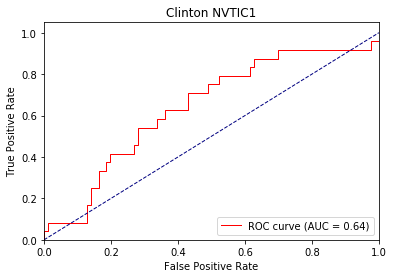

Directory already exists!
hc_nvtic1 1 ap tensor([0.9257, 0.2217]) loss : 0.34723448753356934 0.47283292202086286 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic1 1 ap tensor([1., 1.]) loss : 0.35858824849128723 0.42529750367005664 tid : 30 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic1 1 ap tensor([0.8270, 0.4044]) loss : 0.31697016954421997 0.5420586789647738 tid : 300 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic1 1 ap tensor([0.8570, 0.3444]) loss : 0.28231316804885864 0.5197442594327425 tid : 450 tg tensor([[0]], device='cuda:0')


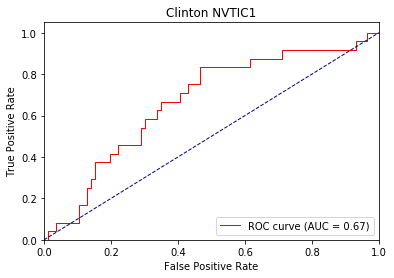

Directory already exists!
hc_nvtic1 2 ap tensor([0.9645, 0.2947]) loss : 0.22865694761276245 0.38880565137038997 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic1 2 ap tensor([1., 1.]) loss : 0.33518630266189575 0.39520161350568134 tid : 30 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic1 2 ap tensor([0.8488, 0.4055]) loss : 0.23637843132019043 0.5394955282409986 tid : 300 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic1 2 ap tensor([0.8741, 0.3525]) loss : 0.23098737001419067 0.5125462070891732 tid : 450 tg tensor([[0]], device='cuda:0')


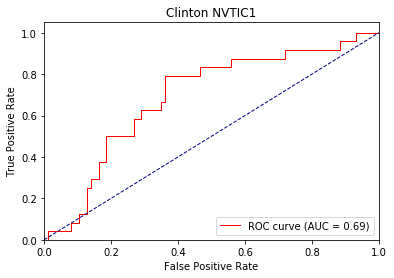

Directory already exists!
hc_nvtic2 0 ap tensor([1., 1.]) loss : 0.5019713640213013 0.5927358150482178 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic2 0 ap tensor([0.6917, 0.3250]) loss : 0.28718453645706177 0.6976820131142935 tid : 30 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic2 0 ap tensor([0.7919, 0.1557]) loss : 0.312602162361145 0.5400483960906665 tid : 300 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic2 0 ap tensor([0.8130, 0.1123]) loss : 0.3360134959220886 0.5179555384736312 tid : 450 tg tensor([[0]], device='cuda:0')


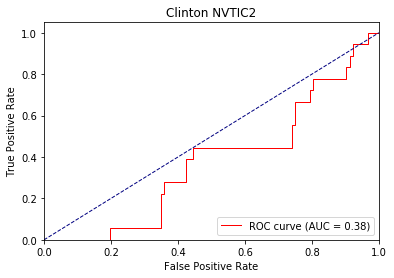

Directory already exists!
hc_nvtic2 1 ap tensor([0.9261, 0.2453]) loss : 0.2658899426460266 0.42777797327203265 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic2 1 ap tensor([0.9167, 0.5833]) loss : 0.2523895502090454 0.6490398645401001 tid : 30 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic2 1 ap tensor([0.9134, 0.2862]) loss : 0.22793984413146973 0.47300862669944765 tid : 300 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic2 1 ap tensor([0.9009, 0.1927]) loss : 0.2599679231643677 0.4505983986352619 tid : 450 tg tensor([[0]], device='cuda:0')


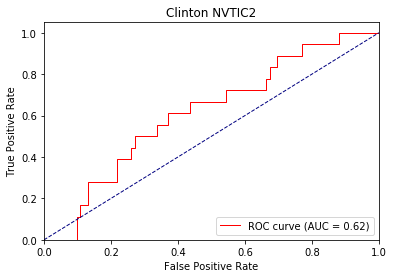

Directory already exists!
hc_nvtic2 2 ap tensor([0.9327, 0.3728]) loss : 0.18696117401123047 0.4068984125504653 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic2 2 ap tensor([1., 1.]) loss : 0.24575698375701904 0.6105640828609467 tid : 30 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic2 2 ap tensor([0.9540, 0.4110]) loss : 0.18238365650177002 0.4336250960826874 tid : 300 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic2 2 ap tensor([0.9369, 0.2606]) loss : 0.228532075881958 0.4153952454265795 tid : 450 tg tensor([[0]], device='cuda:0')


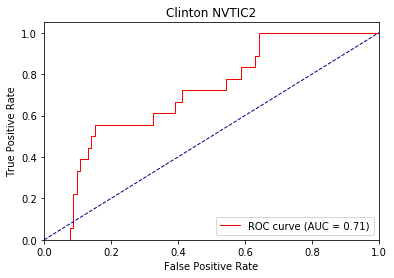

Directory already exists!
hc_nvtic3 0 ap tensor([1., 0.]) loss : 0.5724071264266968 0.605159204867151 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic3 0 ap tensor([0.8767, 0.2500]) loss : 0.2251104712486267 0.47993896901607513 tid : 30 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic3 0 ap tensor([0.9383, 0.0292]) loss : 0.2520419955253601 0.32227618545293807 tid : 300 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic3 0 ap tensor([0.9577, 0.0183]) loss : 0.17657852172851562 0.30783690276898834 tid : 450 tg tensor([[0]], device='cuda:0')


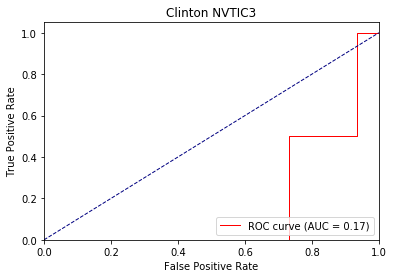

Directory already exists!
hc_nvtic3 1 ap tensor([1., 0.]) loss : 0.2056330442428589 0.25476543799690576 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic3 1 ap tensor([0.9267, 0.3333]) loss : 0.0836648941040039 0.483845849831899 tid : 30 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic3 1 ap tensor([0.9347, 0.0301]) loss : 0.1056089997291565 0.20978074570496877 tid : 300 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic3 1 ap tensor([0.9571, 0.0192]) loss : 0.0669029951095581 0.1843044666867507 tid : 450 tg tensor([[0]], device='cuda:0')


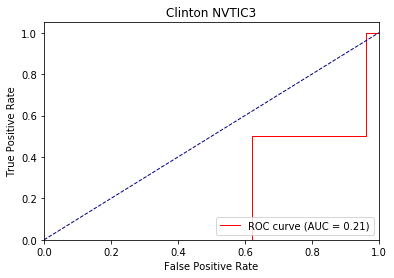

Directory already exists!
hc_nvtic3 2 ap tensor([0.9986, 0.0141]) loss : 0.0511089563369751 0.11282267304491406 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic3 2 ap tensor([0.9267, 0.3333]) loss : 0.0337139368057251 0.5591811736424764 tid : 30 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic3 2 ap tensor([0.9374, 0.0315]) loss : 0.04766404628753662 0.17362858454386393 tid : 300 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic3 2 ap tensor([0.9555, 0.0197]) loss : 0.03116011619567871 0.1372980513070759 tid : 450 tg tensor([[0]], device='cuda:0')


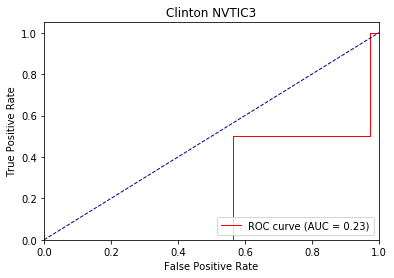

Directory already exists!
hc_nvtic5 0 ap tensor([1., 0.]) loss : 0.43966323137283325 0.637901011360697 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic5 0 ap tensor([1., 0.]) loss : 0.32472550868988037 0.43012145161628723 tid : 30 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic5 0 ap tensor([1., 0.]) loss : 0.3537769317626953 0.41060374627510704 tid : 300 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic5 0 ap tensor([1., 0.]) loss : 0.2284531593322754 0.4082651668473294 tid : 450 tg tensor([[0]], device='cuda:0')


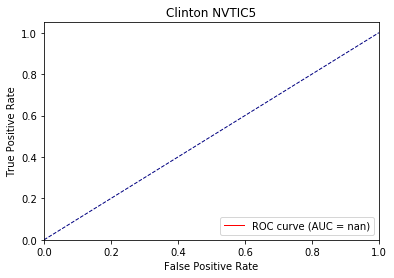

Directory already exists!
hc_nvtic5 1 ap tensor([1., 0.]) loss : 0.13476401567459106 0.2590394556088355 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic5 1 ap tensor([1., 0.]) loss : 0.14289778470993042 0.22616317868232727 tid : 30 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic5 1 ap tensor([1., 0.]) loss : 0.17060822248458862 0.21118849515914917 tid : 300 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic5 1 ap tensor([1., 0.]) loss : 0.08745217323303223 0.2142332020558809 tid : 450 tg tensor([[0]], device='cuda:0')


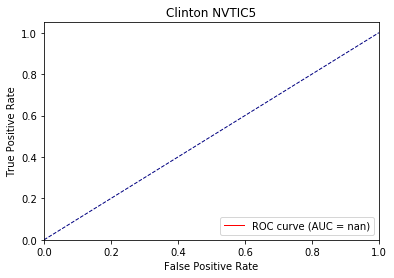

Directory already exists!
hc_nvtic5 2 ap tensor([1., 0.]) loss : 0.07018530368804932 0.1425300726071507 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic5 2 ap tensor([1., 0.]) loss : 0.06064307689666748 0.11495701471964519 tid : 30 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic5 2 ap tensor([1., 0.]) loss : 0.08346772193908691 0.1108503003915151 tid : 300 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic5 2 ap tensor([1., 0.]) loss : 0.03984355926513672 0.11609775518116199 tid : 450 tg tensor([[0]], device='cuda:0')


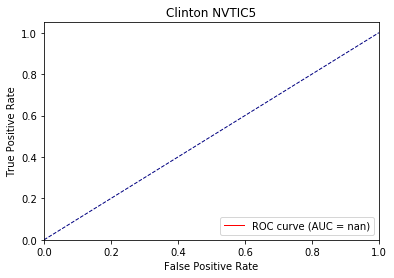

Directory already exists!
hc_nvtic4 0 ap tensor([1., 0.]) loss : 0.5908645987510681 0.679425984621048 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic4 0 ap tensor([0.8167, 0.4167]) loss : 1.3060741424560547 0.6494264602661133 tid : 30 tg tensor([[1]], device='cuda:0')
TEST hc_nvtic4 0 ap tensor([0.9770, 0.1230]) loss : 0.3001786172389984 0.35108968913555144 tid : 300 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic4 0 ap tensor([0.9858, 0.0923]) loss : 0.25448179244995117 0.33271731922501013 tid : 450 tg tensor([[0]], device='cuda:0')


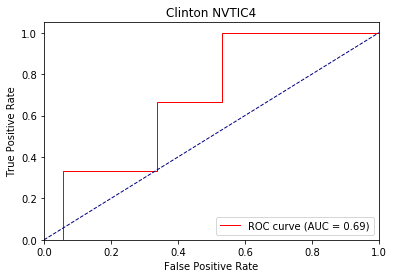

Directory already exists!
hc_nvtic4 1 ap tensor([0.9880, 0.0457]) loss : 0.13687008619308472 0.2590271142748116 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic4 1 ap tensor([0.6917, 0.3250]) loss : 2.0220837593078613 0.7732899983723959 tid : 30 tg tensor([[1]], device='cuda:0')
TEST hc_nvtic4 1 ap tensor([0.9704, 0.0753]) loss : 0.13613754510879517 0.24142072200775147 tid : 300 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic4 1 ap tensor([0.9813, 0.0519]) loss : 0.11362367868423462 0.21062479646582352 tid : 450 tg tensor([[0]], device='cuda:0')


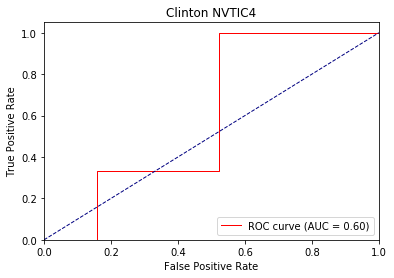

Directory already exists!
hc_nvtic4 2 ap tensor([0.9869, 0.0783]) loss : 0.056232571601867676 0.14460388689257336 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic4 2 ap tensor([0.6917, 0.3250]) loss : 2.724142551422119 0.9502920508384705 tid : 30 tg tensor([[1]], device='cuda:0')
TEST hc_nvtic4 2 ap tensor([0.9679, 0.0687]) loss : 0.0681537389755249 0.20855275044838587 tid : 300 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic4 2 ap tensor([0.9783, 0.0421]) loss : 0.060434818267822266 0.16533558839245846 tid : 450 tg tensor([[0]], device='cuda:0')


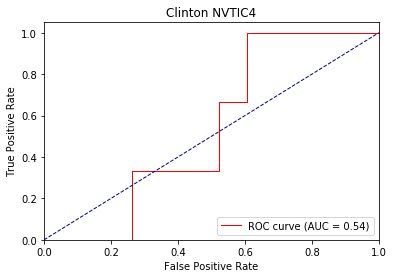

Directory already exists!
hc_interruptions 0 ap tensor([0.9958, 0.0217]) loss : 0.5534359216690063 0.5963253620369681 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_interruptions 0 ap tensor([1., 0.]) loss : 0.2378147840499878 0.3384234656890233 tid : 30 tg tensor([[0]], device='cuda:0')
TEST hc_interruptions 0 ap tensor([1., 0.]) loss : 0.26846539974212646 0.34603723635276157 tid : 300 tg tensor([[0]], device='cuda:0')
TEST hc_interruptions 0 ap tensor([0.9829, 0.2101]) loss : 0.16537916660308838 0.37267342962716754 tid : 450 tg tensor([[0]], device='cuda:0')


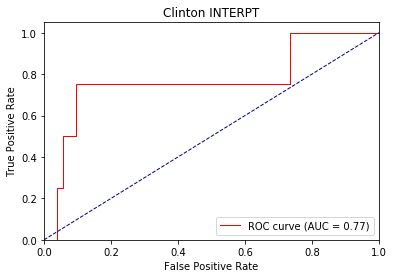

Directory already exists!
hc_interruptions 1 ap tensor([0.9989, 0.0435]) loss : 0.22417128086090088 0.2805767853374351 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_interruptions 1 ap tensor([1., 0.]) loss : 0.11192584037780762 0.17905119061470032 tid : 30 tg tensor([[0]], device='cuda:0')
TEST hc_interruptions 1 ap tensor([1., 0.]) loss : 0.13415485620498657 0.18766794403394063 tid : 300 tg tensor([[0]], device='cuda:0')
TEST hc_interruptions 1 ap tensor([0.9820, 0.2527]) loss : 0.07386457920074463 0.24022486492207176 tid : 450 tg tensor([[0]], device='cuda:0')


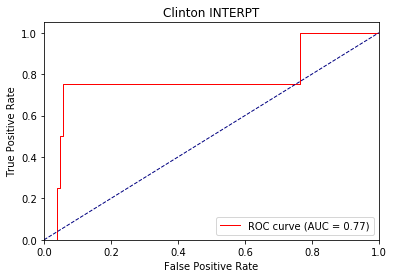

Directory already exists!
hc_interruptions 2 ap tensor([0.9969, 0.1089]) loss : 0.06483519077301025 0.1461909671835305 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_interruptions 2 ap tensor([1., 0.]) loss : 0.056391239166259766 0.0997024377187093 tid : 30 tg tensor([[0]], device='cuda:0')
TEST hc_interruptions 2 ap tensor([1., 0.]) loss : 0.0694655179977417 0.10970377326011657 tid : 300 tg tensor([[0]], device='cuda:0')
TEST hc_interruptions 2 ap tensor([0.9802, 0.2418]) loss : 0.0373920202255249 0.18340336523557965 tid : 450 tg tensor([[0]], device='cuda:0')


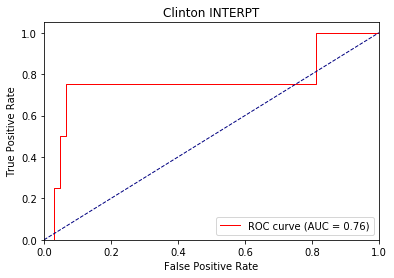

Directory already exists!
hc_lookat2 0 ap tensor([0.4314, 0.6643]) loss : 0.681969404220581 0.6814039285953452 tid : 400 tg tensor([[0]], device='cuda:0')
TEST hc_lookat2 0 ap tensor([0.8772, 0.8742]) loss : 0.7737568020820618 0.5435648382671417 tid : 300 tg tensor([[0]], device='cuda:0')
TEST hc_lookat2 0 ap tensor([0.9034, 0.8966]) loss : 0.6866060495376587 0.5384233405567566 tid : 510 tg tensor([[0]], device='cuda:0')


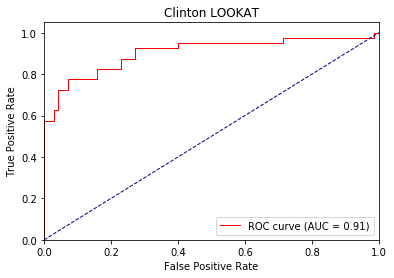

Directory already exists!
hc_lookat2 1 ap tensor([0.9406, 0.9705]) loss : 0.33920377492904663 0.42666951385958335 tid : 400 tg tensor([[0]], device='cuda:0')
TEST hc_lookat2 1 ap tensor([0.9395, 0.8856]) loss : 0.6987267732620239 0.42914374509165365 tid : 300 tg tensor([[0]], device='cuda:0')
TEST hc_lookat2 1 ap tensor([0.9492, 0.9140]) loss : 0.5410432815551758 0.42295810524022803 tid : 510 tg tensor([[0]], device='cuda:0')


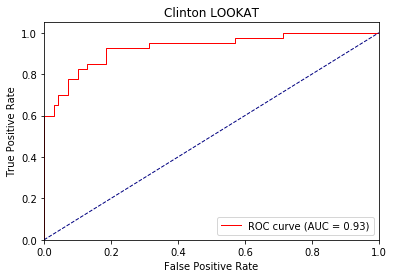

Directory already exists!
hc_lookat2 2 ap tensor([0.9746, 0.9788]) loss : 0.25441378355026245 0.3461752293490562 tid : 400 tg tensor([[0]], device='cuda:0')
TEST hc_lookat2 2 ap tensor([0.9471, 0.8934]) loss : 0.5748828649520874 0.36785902803944004 tid : 300 tg tensor([[0]], device='cuda:0')
TEST hc_lookat2 2 ap tensor([0.9558, 0.9215]) loss : 0.4376312494277954 0.36100333422984715 tid : 510 tg tensor([[0]], device='cuda:0')


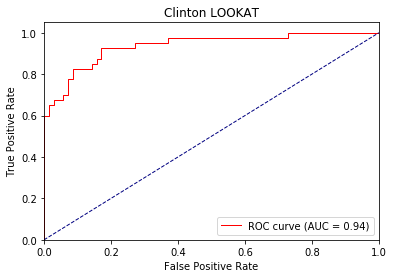

Directory already exists!
hc_brush1 0 ap tensor([0.8816, 0.1859]) loss : 0.44594284892082214 0.6193189263943858 tid : 400 tg tensor([[0]], device='cuda:0')
TEST hc_brush1 0 ap tensor([0.8526, 0.2008]) loss : 0.3926757574081421 0.5269468301726926 tid : 300 tg tensor([[0]], device='cuda:0')
TEST hc_brush1 0 ap tensor([0.8649, 0.2513]) loss : 0.46300172805786133 0.5150070974849305 tid : 510 tg tensor([[0]], device='cuda:0')


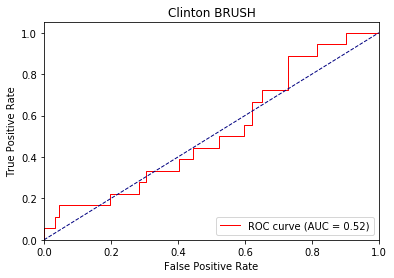

Directory already exists!
hc_brush1 1 ap tensor([0.8982, 0.1850]) loss : 0.28000617027282715 0.47994024291330456 tid : 400 tg tensor([[0]], device='cuda:0')
TEST hc_brush1 1 ap tensor([0.8814, 0.2891]) loss : 0.27721261978149414 0.46616659962361856 tid : 300 tg tensor([[0]], device='cuda:0')
TEST hc_brush1 1 ap tensor([0.9006, 0.3248]) loss : 0.30427151918411255 0.4499020556796272 tid : 510 tg tensor([[0]], device='cuda:0')


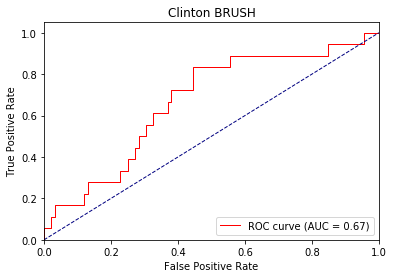

Directory already exists!
hc_brush1 2 ap tensor([0.9512, 0.2672]) loss : 0.14400702714920044 0.39045264286759457 tid : 400 tg tensor([[0]], device='cuda:0')
TEST hc_brush1 2 ap tensor([0.8888, 0.3398]) loss : 0.2159416675567627 0.4437670755770899 tid : 300 tg tensor([[0]], device='cuda:0')
TEST hc_brush1 2 ap tensor([0.9101, 0.3765]) loss : 0.22068184614181519 0.4236433691573593 tid : 510 tg tensor([[0]], device='cuda:0')


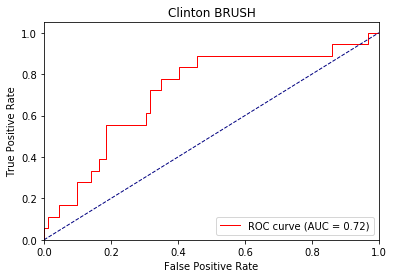

Directory already exists!
hc_nvdis1 0 ap tensor([0.8730, 0.1026]) loss : 0.5260694622993469 0.6544233357560807 tid : 400 tg tensor([[0]], device='cuda:0')
TEST hc_nvdis1 0 ap tensor([0.9030, 0.1838]) loss : 0.5206742286682129 0.4891057807591654 tid : 300 tg tensor([[0]], device='cuda:0')
TEST hc_nvdis1 0 ap tensor([0.8657, 0.2108]) loss : 0.34977585077285767 0.49438545417110874 tid : 510 tg tensor([[0]], device='cuda:0')


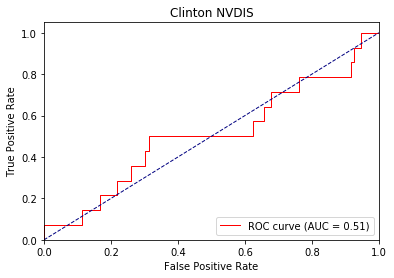

Directory already exists!
hc_nvdis1 1 ap tensor([0.9804, 0.2115]) loss : 0.3073803186416626 0.37921718859301945 tid : 400 tg tensor([[0]], device='cuda:0')
TEST hc_nvdis1 1 ap tensor([0.9039, 0.3274]) loss : 0.2849791646003723 0.3957971199866264 tid : 300 tg tensor([[0]], device='cuda:0')
TEST hc_nvdis1 1 ap tensor([0.8871, 0.3226]) loss : 0.20915651321411133 0.3958243215983769 tid : 510 tg tensor([[0]], device='cuda:0')


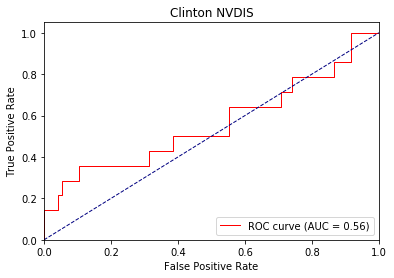

Directory already exists!
hc_nvdis1 2 ap tensor([0.9659, 0.4782]) loss : 0.18594509363174438 0.2981178533376717 tid : 400 tg tensor([[0]], device='cuda:0')
TEST hc_nvdis1 2 ap tensor([0.8807, 0.3054]) loss : 0.17414873838424683 0.38018423991818584 tid : 300 tg tensor([[0]], device='cuda:0')
TEST hc_nvdis1 2 ap tensor([0.8654, 0.3591]) loss : 0.14345836639404297 0.3739629236032378 tid : 510 tg tensor([[0]], device='cuda:0')


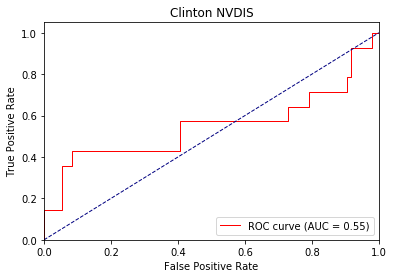

Directory already exists!
hc_look 0 ap tensor([0.5080, 0.8485]) loss : 0.4966055750846863 0.6291062159913019 tid : 400 tg tensor([[1]], device='cuda:0')
TEST hc_look 0 ap tensor([0.5007, 0.9838]) loss : 0.5227639675140381 0.4855002664750622 tid : 300 tg tensor([[1]], device='cuda:0')
TEST hc_look 0 ap tensor([0.5690, 0.9745]) loss : 0.46482259035110474 0.5071396566224549 tid : 510 tg tensor([[1]], device='cuda:0')


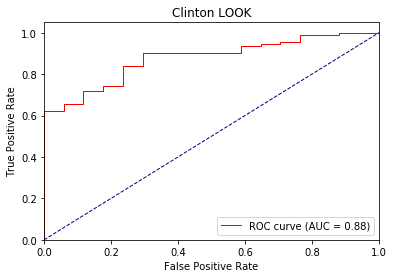

Directory already exists!
hc_look 1 ap tensor([0.7216, 0.9533]) loss : 0.3248685598373413 0.5022880219551454 tid : 400 tg tensor([[1]], device='cuda:0')
TEST hc_look 1 ap tensor([0.5115, 0.9841]) loss : 0.4285299777984619 0.38944511115550995 tid : 300 tg tensor([[1]], device='cuda:0')
TEST hc_look 1 ap tensor([0.5591, 0.9751]) loss : 0.29813113808631897 0.41981768579977863 tid : 510 tg tensor([[1]], device='cuda:0')


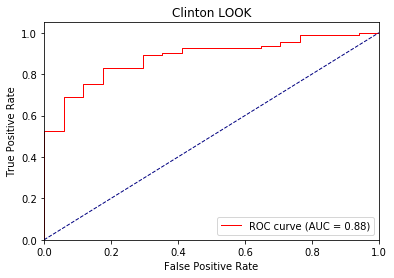

Directory already exists!
hc_look 2 ap tensor([0.7496, 0.9564]) loss : 0.21067363023757935 0.4461814829560577 tid : 400 tg tensor([[1]], device='cuda:0')
TEST hc_look 2 ap tensor([0.6112, 0.9863]) loss : 0.34710144996643066 0.3349572718143463 tid : 300 tg tensor([[1]], device='cuda:0')
TEST hc_look 2 ap tensor([0.6033, 0.9765]) loss : 0.2040838599205017 0.3706275317466484 tid : 510 tg tensor([[1]], device='cuda:0')


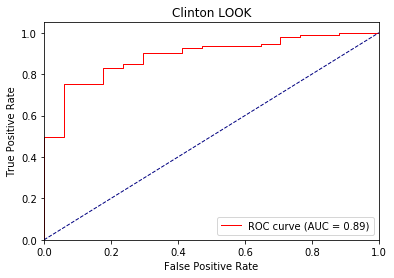

Directory already exists!
hc_eyebrow 0 ap tensor([0.6398, 0.3982]) loss : 0.919504702091217 0.7177505414275562 tid : 400 tg tensor([[0]], device='cuda:0')
TEST hc_eyebrow 0 ap tensor([0.9011, 0.6421]) loss : 0.6978284120559692 0.6201317541060909 tid : 300 tg tensor([[1]], device='cuda:0')
TEST hc_eyebrow 0 ap tensor([0.9379, 0.5006]) loss : 0.874732494354248 0.6218214639515247 tid : 510 tg tensor([[0]], device='cuda:0')


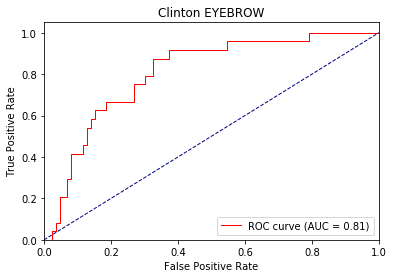

Directory already exists!
hc_eyebrow 1 ap tensor([0.9511, 0.6985]) loss : 0.9444227814674377 0.524535730265189 tid : 400 tg tensor([[0]], device='cuda:0')
TEST hc_eyebrow 1 ap tensor([0.9206, 0.7142]) loss : 0.8064067363739014 0.5580456675060333 tid : 300 tg tensor([[1]], device='cuda:0')
TEST hc_eyebrow 1 ap tensor([0.9436, 0.5731]) loss : 0.7795470356941223 0.5658920882445462 tid : 510 tg tensor([[0]], device='cuda:0')


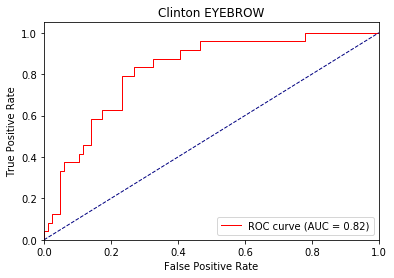

Directory already exists!
hc_eyebrow 2 ap tensor([0.9504, 0.7950]) loss : 1.0674443244934082 0.43453616762357483 tid : 400 tg tensor([[0]], device='cuda:0')
TEST hc_eyebrow 2 ap tensor([0.9249, 0.7357]) loss : 0.8443101644515991 0.5299180770112623 tid : 300 tg tensor([[1]], device='cuda:0')
TEST hc_eyebrow 2 ap tensor([0.9416, 0.5564]) loss : 0.7142329216003418 0.5476177587824048 tid : 510 tg tensor([[0]], device='cuda:0')


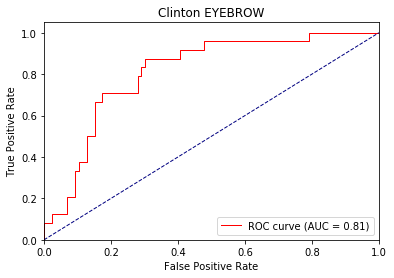

Directory already exists!
hc_atface 0 ap tensor([0.9388, 0.1624]) loss : 0.6321806311607361 0.6219188978386282 tid : 400 tg tensor([[0]], device='cuda:0')
TEST hc_atface 0 ap tensor([0.8705, 0.4983]) loss : 0.9857996702194214 0.569932036822842 tid : 300 tg tensor([[1]], device='cuda:0')
TEST hc_atface 0 ap tensor([0.8823, 0.4224]) loss : 0.5003503561019897 0.563599925839676 tid : 510 tg tensor([[0]], device='cuda:0')


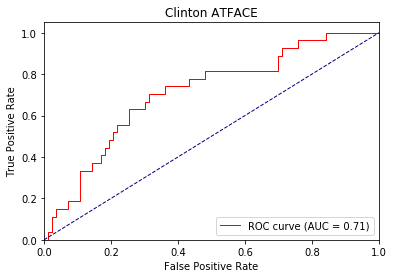

Directory already exists!
hc_atface 1 ap tensor([0.9571, 0.3885]) loss : 0.5320295691490173 0.46173046647556243 tid : 400 tg tensor([[0]], device='cuda:0')
TEST hc_atface 1 ap tensor([0.8880, 0.5201]) loss : 1.2865839004516602 0.5222018514910052 tid : 300 tg tensor([[1]], device='cuda:0')
TEST hc_atface 1 ap tensor([0.8935, 0.4444]) loss : 0.3436262905597687 0.5117325678748904 tid : 510 tg tensor([[0]], device='cuda:0')


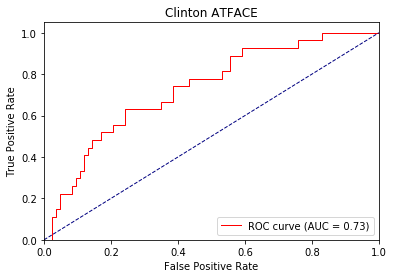

Directory already exists!
hc_atface 2 ap tensor([0.9604, 0.3979]) loss : 0.4007240831851959 0.37158891012271245 tid : 400 tg tensor([[0]], device='cuda:0')
TEST hc_atface 2 ap tensor([0.8985, 0.5604]) loss : 1.4469377994537354 0.51075463237301 tid : 300 tg tensor([[1]], device='cuda:0')
TEST hc_atface 2 ap tensor([0.9016, 0.4689]) loss : 0.2668003439903259 0.4986612594352578 tid : 510 tg tensor([[0]], device='cuda:0')


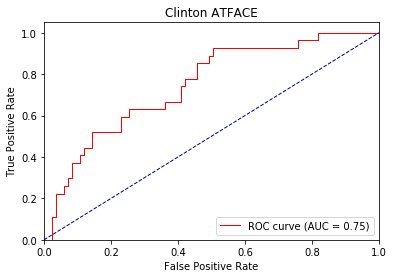

Directory already exists!
hc_feface 0 ap tensor([1., 0.]) loss : 0.5068350434303284 0.5938477332775409 tid : 400 tg tensor([[0]], device='cuda:0')
TEST hc_feface 0 ap tensor([0.9809, 0.0227]) loss : 0.2403719425201416 0.3193219481937347 tid : 300 tg tensor([[0]], device='cuda:0')
TEST hc_feface 0 ap tensor([0.9868, 0.0123]) loss : 0.26656946539878845 0.31809280475355545 tid : 510 tg tensor([[0]], device='cuda:0')


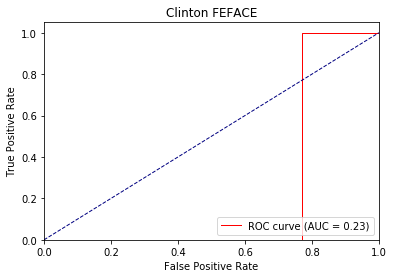

Directory already exists!
hc_feface 1 ap tensor([1., 0.]) loss : 0.21841925382614136 0.24481246075523433 tid : 400 tg tensor([[0]], device='cuda:0')
TEST hc_feface 1 ap tensor([0.9771, 0.0208]) loss : 0.10016334056854248 0.17056247207426256 tid : 300 tg tensor([[0]], device='cuda:0')
TEST hc_feface 1 ap tensor([0.9864, 0.0122]) loss : 0.10602670907974243 0.16017101564497319 tid : 510 tg tensor([[0]], device='cuda:0')


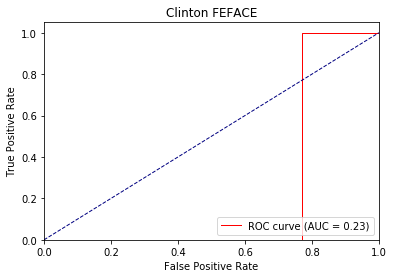

Directory already exists!
hc_feface 2 ap tensor([1., 0.]) loss : 0.04867959022521973 0.08954721985764764 tid : 400 tg tensor([[0]], device='cuda:0')
TEST hc_feface 2 ap tensor([0.9771, 0.0208]) loss : 0.04371953010559082 0.11509130174113859 tid : 300 tg tensor([[0]], device='cuda:0')
TEST hc_feface 2 ap tensor([0.9871, 0.0125]) loss : 0.043595075607299805 0.09723900174194912 tid : 510 tg tensor([[0]], device='cuda:0')


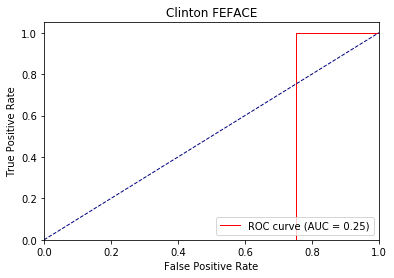

Directory already exists!
hc_hrface 0 ap tensor([0.5729, 0.5778]) loss : 0.7571884393692017 0.68666880890943 tid : 400 tg tensor([[0]], device='cuda:0')
TEST hc_hrface 0 ap tensor([0.8548, 0.4876]) loss : 0.8013019561767578 0.7029728024236618 tid : 300 tg tensor([[0]], device='cuda:0')
TEST hc_hrface 0 ap tensor([0.8822, 0.5141]) loss : 0.8390467166900635 0.6896913729186328 tid : 510 tg tensor([[0]], device='cuda:0')


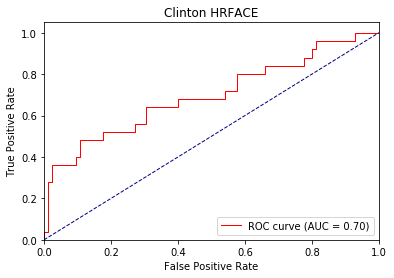

Directory already exists!
hc_hrface 1 ap tensor([0.7585, 0.8505]) loss : 0.6629262566566467 0.6246745300352873 tid : 400 tg tensor([[0]], device='cuda:0')
TEST hc_hrface 1 ap tensor([0.8554, 0.5569]) loss : 0.7160553336143494 0.6461227565042434 tid : 300 tg tensor([[0]], device='cuda:0')
TEST hc_hrface 1 ap tensor([0.8719, 0.5730]) loss : 0.7953119277954102 0.6361990436068121 tid : 510 tg tensor([[0]], device='cuda:0')


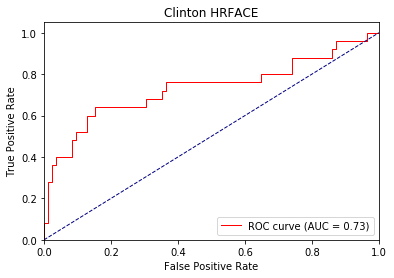

Directory already exists!
hc_hrface 2 ap tensor([0.8756, 0.8859]) loss : 0.5717020034790039 0.5851331726765968 tid : 400 tg tensor([[0]], device='cuda:0')
TEST hc_hrface 2 ap tensor([0.8790, 0.5712]) loss : 0.6392238140106201 0.6042829420297376 tid : 300 tg tensor([[0]], device='cuda:0')
TEST hc_hrface 2 ap tensor([0.8818, 0.6148]) loss : 0.7642279863357544 0.5950211297790959 tid : 510 tg tensor([[0]], device='cuda:0')


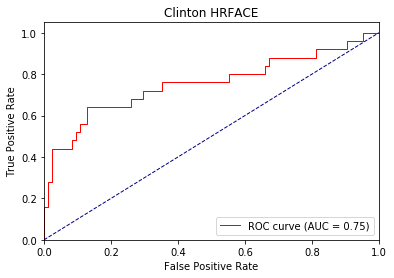

Directory already exists!
hc_saface 0 ap tensor([1., 0.]) loss : 0.6800948977470398 0.7130616108576456 tid : 400 tg tensor([[0]], device='cuda:0')
TEST hc_saface 0 ap tensor([1., 0.]) loss : 0.31133997440338135 0.3321870623096343 tid : 300 tg tensor([[0]], device='cuda:0')
TEST hc_saface 0 ap tensor([1., 0.]) loss : 0.32003358006477356 0.3257591718772672 tid : 510 tg tensor([[0]], device='cuda:0')


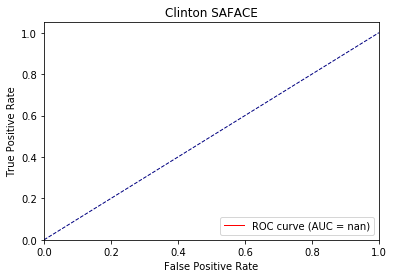

Directory already exists!
hc_saface 1 ap tensor([0.9822, 0.0207]) loss : 0.1898888349533081 0.26234782183213357 tid : 400 tg tensor([[0]], device='cuda:0')
TEST hc_saface 1 ap tensor([1., 0.]) loss : 0.1515432596206665 0.17217190227200907 tid : 300 tg tensor([[0]], device='cuda:0')
TEST hc_saface 1 ap tensor([1., 0.]) loss : 0.14651507139205933 0.16783758913570979 tid : 510 tg tensor([[0]], device='cuda:0')


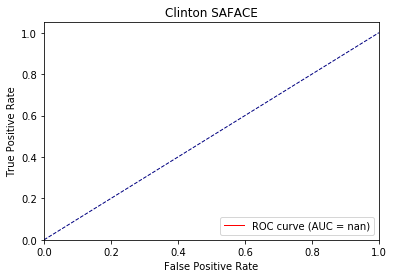

Directory already exists!
hc_saface 2 ap tensor([1., 0.]) loss : 0.13799262046813965 0.1437425414721171 tid : 400 tg tensor([[0]], device='cuda:0')
TEST hc_saface 2 ap tensor([1., 0.]) loss : 0.0765770673751831 0.09859530771932294 tid : 300 tg tensor([[0]], device='cuda:0')
TEST hc_saface 2 ap tensor([1., 0.]) loss : 0.06867325305938721 0.095703605773314 tid : 510 tg tensor([[0]], device='cuda:0')


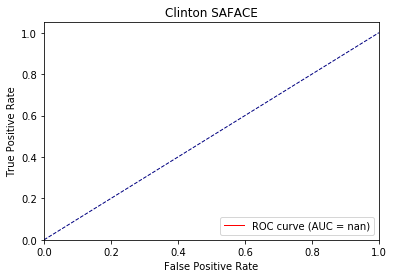

Directory already exists!
hc_neuface 0 ap tensor([0.6372, 0.3598]) loss : 0.7933701872825623 0.6900862013707395 tid : 400 tg tensor([[1]], device='cuda:0')
TEST hc_neuface 0 ap tensor([0.5029, 0.5927]) loss : 0.6328919529914856 0.7164345181757404 tid : 300 tg tensor([[0]], device='cuda:0')
TEST hc_neuface 0 ap tensor([0.5180, 0.5547]) loss : 0.7474850416183472 0.7144269251598502 tid : 510 tg tensor([[1]], device='cuda:0')


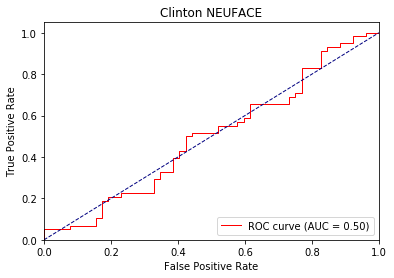

Directory already exists!
hc_neuface 1 ap tensor([0.7669, 0.4792]) loss : 0.9169535636901855 0.6382705507909551 tid : 400 tg tensor([[1]], device='cuda:0')
TEST hc_neuface 1 ap tensor([0.5020, 0.5933]) loss : 0.5555980801582336 0.733945498543401 tid : 300 tg tensor([[0]], device='cuda:0')
TEST hc_neuface 1 ap tensor([0.5352, 0.5824]) loss : 0.8555170297622681 0.7259112205707802 tid : 510 tg tensor([[1]], device='cuda:0')


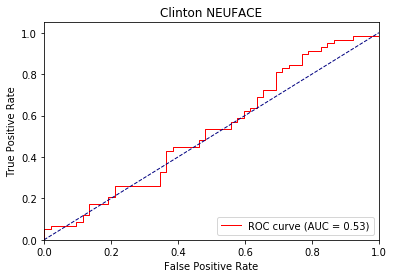

Directory already exists!
hc_neuface 2 ap tensor([0.8369, 0.6470]) loss : 0.9006636142730713 0.6384897968742285 tid : 400 tg tensor([[1]], device='cuda:0')
TEST hc_neuface 2 ap tensor([0.5131, 0.5695]) loss : 0.5054190754890442 0.7434091793913995 tid : 300 tg tensor([[0]], device='cuda:0')
TEST hc_neuface 2 ap tensor([0.5785, 0.6024]) loss : 0.9378618001937866 0.7296109348535538 tid : 510 tg tensor([[1]], device='cuda:0')


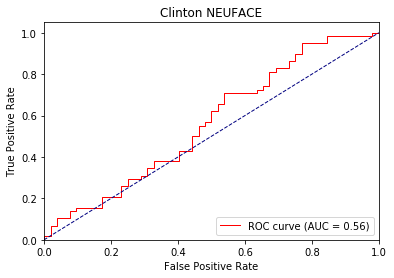

Directory already exists!
hc_inapprop 0 ap tensor([1., 0.]) loss : 0.6634892225265503 0.6123408185292597 tid : 400 tg tensor([[0]], device='cuda:0')
TEST hc_inapprop 0 ap tensor([1., 0.]) loss : 0.3563145399093628 0.36097385133466414 tid : 300 tg tensor([[0]], device='cuda:0')
TEST hc_inapprop 0 ap tensor([1., 0.]) loss : 0.4359542727470398 0.35997981423476955 tid : 510 tg tensor([[0]], device='cuda:0')


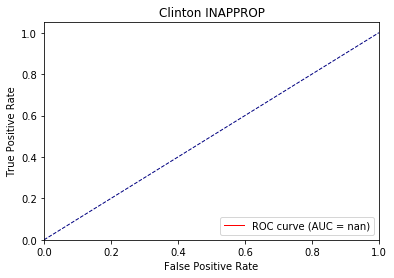

Directory already exists!
hc_inapprop 1 ap tensor([1., 0.]) loss : 0.20170170068740845 0.24459529051677786 tid : 400 tg tensor([[0]], device='cuda:0')
TEST hc_inapprop 1 ap tensor([1., 0.]) loss : 0.15845656394958496 0.17642604535625828 tid : 300 tg tensor([[0]], device='cuda:0')
TEST hc_inapprop 1 ap tensor([1., 0.]) loss : 0.18392086029052734 0.17627671304738746 tid : 510 tg tensor([[0]], device='cuda:0')


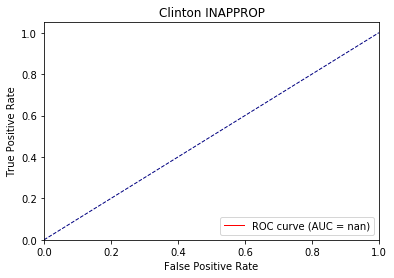

Directory already exists!
hc_inapprop 2 ap tensor([1., 0.]) loss : 0.09782934188842773 0.11752831370666109 tid : 400 tg tensor([[0]], device='cuda:0')
TEST hc_inapprop 2 ap tensor([1., 0.]) loss : 0.06723129749298096 0.08533668998749025 tid : 300 tg tensor([[0]], device='cuda:0')
TEST hc_inapprop 2 ap tensor([1., 0.]) loss : 0.06804037094116211 0.08594069784542299 tid : 510 tg tensor([[0]], device='cuda:0')


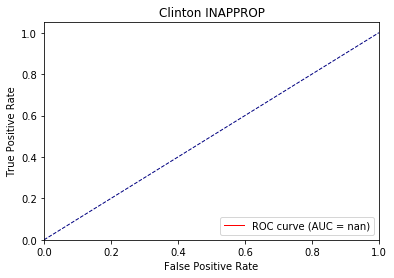

Directory already exists!
hc_affgest 0 ap tensor([0.9626, 0.1352]) loss : 0.5707971453666687 0.6540334518750509 tid : 400 tg tensor([[0]], device='cuda:0')
TEST hc_affgest 0 ap tensor([1., 0.]) loss : 0.32489460706710815 0.35527978693285295 tid : 300 tg tensor([[0]], device='cuda:0')
TEST hc_affgest 0 ap tensor([1., 0.]) loss : 0.28074413537979126 0.3475815330473882 tid : 510 tg tensor([[0]], device='cuda:0')


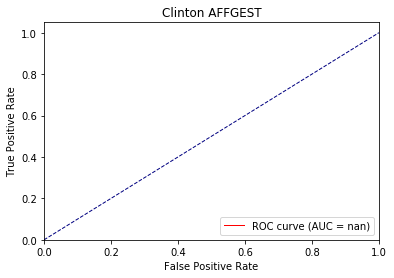

Directory already exists!
hc_affgest 1 ap tensor([0.9806, 0.2785]) loss : 0.3087117075920105 0.3785809594757703 tid : 400 tg tensor([[0]], device='cuda:0')
TEST hc_affgest 1 ap tensor([1., 0.]) loss : 0.16604852676391602 0.22086744635335862 tid : 300 tg tensor([[0]], device='cuda:0')
TEST hc_affgest 1 ap tensor([1., 0.]) loss : 0.15311598777770996 0.21216683989425875 tid : 510 tg tensor([[0]], device='cuda:0')


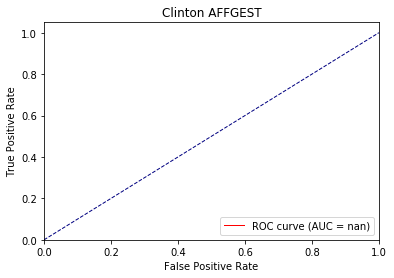

Directory already exists!
hc_affgest 2 ap tensor([0.9825, 0.2032]) loss : 0.17992520332336426 0.27130539112147833 tid : 400 tg tensor([[0]], device='cuda:0')
TEST hc_affgest 2 ap tensor([1., 0.]) loss : 0.09668970108032227 0.15967263617823202 tid : 300 tg tensor([[0]], device='cuda:0')
TEST hc_affgest 2 ap tensor([1., 0.]) loss : 0.09376871585845947 0.15086257738887138 tid : 510 tg tensor([[0]], device='cuda:0')


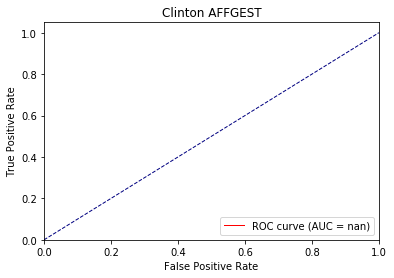

Directory already exists!
hc_defgest 0 ap tensor([0.8924, 0.0891]) loss : 0.8600891828536987 0.6512514216447968 tid : 400 tg tensor([[1]], device='cuda:0')
TEST hc_defgest 0 ap tensor([0.8427, 0.3800]) loss : 0.33371275663375854 0.5885981595323931 tid : 300 tg tensor([[0]], device='cuda:0')
TEST hc_defgest 0 ap tensor([0.8438, 0.3413]) loss : 0.3495711088180542 0.5726409891866288 tid : 510 tg tensor([[0]], device='cuda:0')


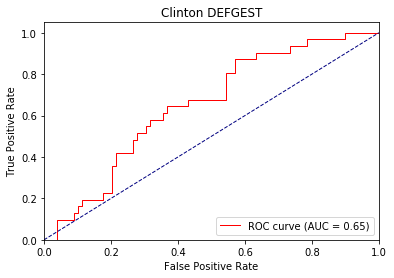

Directory already exists!
hc_defgest 1 ap tensor([0.9484, 0.2355]) loss : 1.23630952835083 0.4330879461355987 tid : 400 tg tensor([[1]], device='cuda:0')
TEST hc_defgest 1 ap tensor([0.8772, 0.4187]) loss : 0.22640931606292725 0.5599312859196817 tid : 300 tg tensor([[0]], device='cuda:0')
TEST hc_defgest 1 ap tensor([0.8737, 0.3886]) loss : 0.23936742544174194 0.5414204054845954 tid : 510 tg tensor([[0]], device='cuda:0')


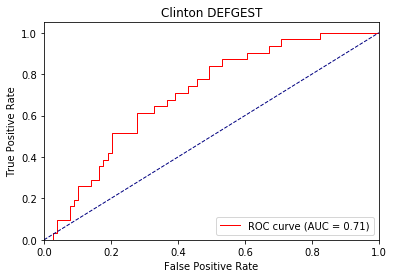

Directory already exists!
hc_defgest 2 ap tensor([0.9670, 0.2393]) loss : 1.4885046482086182 0.33966721355532986 tid : 400 tg tensor([[1]], device='cuda:0')
TEST hc_defgest 2 ap tensor([0.8912, 0.4410]) loss : 0.18419355154037476 0.5575129485899403 tid : 300 tg tensor([[0]], device='cuda:0')
TEST hc_defgest 2 ap tensor([0.8849, 0.4187]) loss : 0.1876755952835083 0.5395077587860935 tid : 510 tg tensor([[0]], device='cuda:0')


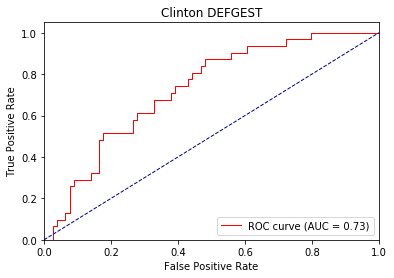

Directory already exists!
hc_agentic 0 ap tensor([0.8109, 0.6652]) loss : 0.6310116052627563 0.6388011525224703 tid : 400 tg tensor([[1]], device='cuda:0')
TEST hc_agentic 0 ap tensor([0.9023, 0.8960]) loss : 0.7282329797744751 0.576812578785804 tid : 300 tg tensor([[1]], device='cuda:0')
TEST hc_agentic 0 ap tensor([0.9142, 0.9067]) loss : 0.8220313787460327 0.5693733177657397 tid : 510 tg tensor([[0]], device='cuda:0')


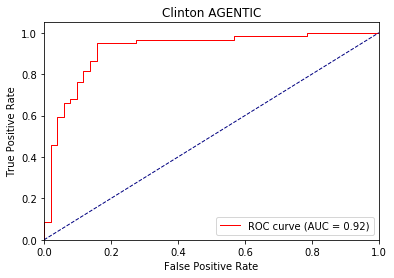

Directory already exists!
hc_agentic 1 ap tensor([0.9657, 0.9708]) loss : 0.44062140583992004 0.47656609315306087 tid : 400 tg tensor([[1]], device='cuda:0')
TEST hc_agentic 1 ap tensor([0.9193, 0.9341]) loss : 0.6244807243347168 0.4642091412698069 tid : 300 tg tensor([[1]], device='cuda:0')
TEST hc_agentic 1 ap tensor([0.9231, 0.9367]) loss : 1.012373924255371 0.4573479024869091 tid : 510 tg tensor([[0]], device='cuda:0')


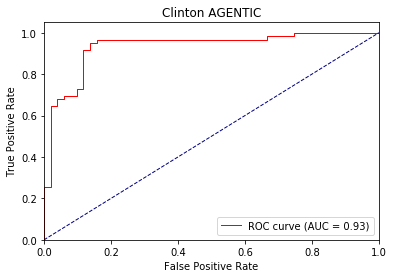

Directory already exists!
hc_agentic 2 ap tensor([0.9786, 0.9751]) loss : 0.2532850503921509 0.3468318526710414 tid : 400 tg tensor([[1]], device='cuda:0')
TEST hc_agentic 2 ap tensor([0.9317, 0.9419]) loss : 0.49145758152008057 0.39387628820634657 tid : 300 tg tensor([[1]], device='cuda:0')
TEST hc_agentic 2 ap tensor([0.9330, 0.9477]) loss : 1.1840459108352661 0.3869307952107124 tid : 510 tg tensor([[0]], device='cuda:0')


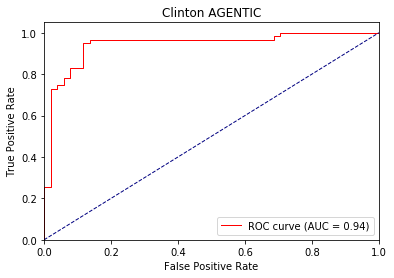

Directory already exists!
hc_waveoff 0 ap tensor([0.5393, 0.4297]) loss : 0.7932044863700867 0.6938296454027295 tid : 400 tg tensor([[1]], device='cuda:0')
TEST hc_waveoff 0 ap tensor([0.9536, 0.7489]) loss : 0.6519829034805298 0.556572740116427 tid : 300 tg tensor([[0]], device='cuda:0')
TEST hc_waveoff 0 ap tensor([0.9118, 0.7071]) loss : 0.745988130569458 0.5670572749848636 tid : 510 tg tensor([[0]], device='cuda:0')


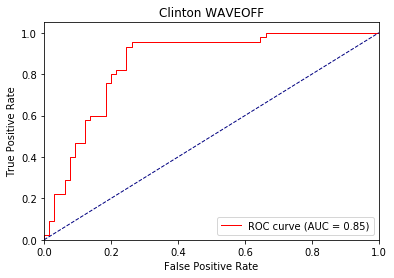

Directory already exists!
hc_waveoff 1 ap tensor([0.9590, 0.6906]) loss : 0.6124944090843201 0.4894393288541114 tid : 400 tg tensor([[1]], device='cuda:0')
TEST hc_waveoff 1 ap tensor([0.9600, 0.8253]) loss : 0.6714593768119812 0.49050111587970485 tid : 300 tg tensor([[0]], device='cuda:0')
TEST hc_waveoff 1 ap tensor([0.9147, 0.7676]) loss : 0.8194327354431152 0.5158735606467949 tid : 510 tg tensor([[0]], device='cuda:0')


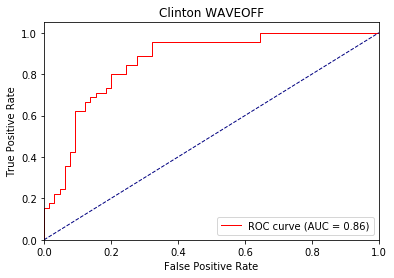

Directory already exists!
hc_waveoff 2 ap tensor([0.9727, 0.8306]) loss : 0.4701860249042511 0.39228612099375043 tid : 400 tg tensor([[1]], device='cuda:0')
TEST hc_waveoff 2 ap tensor([0.9678, 0.8557]) loss : 0.7377192378044128 0.45750900381995785 tid : 300 tg tensor([[0]], device='cuda:0')
TEST hc_waveoff 2 ap tensor([0.9168, 0.7865]) loss : 0.8715938925743103 0.4926906258992429 tid : 510 tg tensor([[0]], device='cuda:0')


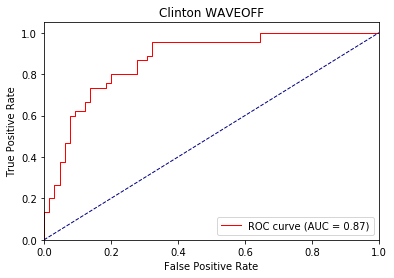

Directory already exists!
hc_nvtic1 0 ap tensor([0.8837, 0.2267]) loss : 0.5244319438934326 0.6332651330960377 tid : 400 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic1 0 ap tensor([0.8413, 0.5763]) loss : 0.4910097122192383 0.568519260614149 tid : 300 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic1 0 ap tensor([0.8619, 0.4427]) loss : 0.9654459953308105 0.5566747961741574 tid : 510 tg tensor([[1]], device='cuda:0')


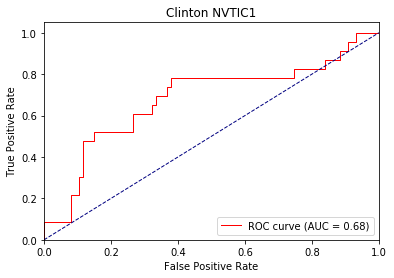

Directory already exists!
hc_nvtic1 1 ap tensor([0.9030, 0.2452]) loss : 0.27042537927627563 0.47038167380925383 tid : 400 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic1 1 ap tensor([0.8817, 0.6239]) loss : 0.33168885111808777 0.5214354910196797 tid : 300 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic1 1 ap tensor([0.9047, 0.4675]) loss : 1.2181215286254883 0.49772354116979634 tid : 510 tg tensor([[1]], device='cuda:0')


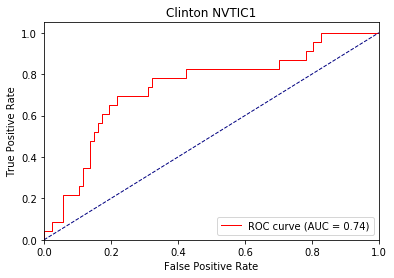

Directory already exists!
hc_nvtic1 2 ap tensor([0.9043, 0.2052]) loss : 0.21027249097824097 0.4477952233174952 tid : 400 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic1 2 ap tensor([0.9469, 0.6330]) loss : 0.250619113445282 0.5003410303784955 tid : 300 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic1 2 ap tensor([0.9445, 0.4795]) loss : 1.3718922138214111 0.4705798977388526 tid : 510 tg tensor([[1]], device='cuda:0')


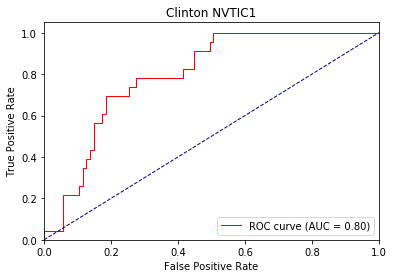

Directory already exists!
hc_nvtic2 0 ap tensor([0.8939, 0.2389]) loss : 0.5174233317375183 0.6890767756994669 tid : 400 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic2 0 ap tensor([0.9156, 0.4788]) loss : 0.6401170492172241 0.5726253991165469 tid : 300 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic2 0 ap tensor([0.9141, 0.3219]) loss : 0.987604022026062 0.5759826783301696 tid : 510 tg tensor([[1]], device='cuda:0')


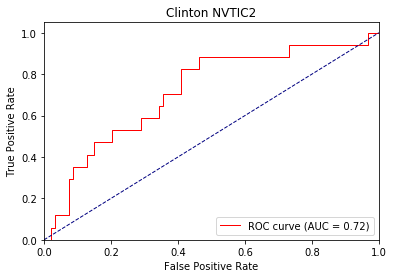

Directory already exists!
hc_nvtic2 1 ap tensor([0.9276, 0.3957]) loss : 0.32415568828582764 0.5026593147062817 tid : 400 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic2 1 ap tensor([0.9377, 0.7195]) loss : 0.41773563623428345 0.4611713468067108 tid : 300 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic2 1 ap tensor([0.9274, 0.5367]) loss : 1.3475624322891235 0.4613433834516777 tid : 510 tg tensor([[1]], device='cuda:0')


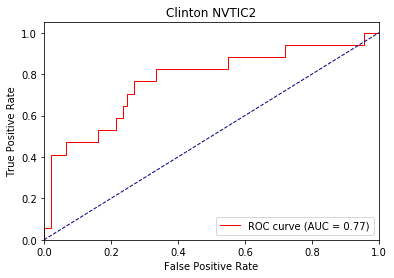

Directory already exists!
hc_nvtic2 2 ap tensor([0.9630, 0.6336]) loss : 0.26849159598350525 0.4149089204147458 tid : 400 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic2 2 ap tensor([0.9400, 0.7913]) loss : 0.30197399854660034 0.403896345486564 tid : 300 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic2 2 ap tensor([0.9398, 0.6078]) loss : 1.637617826461792 0.4042472912455505 tid : 510 tg tensor([[1]], device='cuda:0')


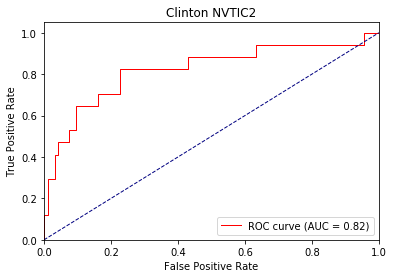

Directory already exists!
hc_nvtic3 0 ap tensor([1., 0.]) loss : 0.5840485692024231 0.6890352761044222 tid : 400 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic3 0 ap tensor([0.9944, 0.7167]) loss : 0.2834100127220154 0.3650784242537714 tid : 300 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic3 0 ap tensor([0.9965, 0.4192]) loss : 0.3292813301086426 0.3568388712856005 tid : 510 tg tensor([[0]], device='cuda:0')


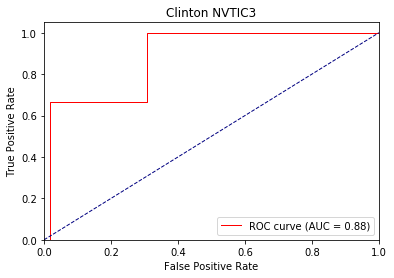

Directory already exists!
hc_nvtic3 1 ap tensor([0.9980, 0.0127]) loss : 0.21469658613204956 0.28011313012745825 tid : 400 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic3 1 ap tensor([0.9899, 0.4234]) loss : 0.11395847797393799 0.2190078237364369 tid : 300 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic3 1 ap tensor([0.9938, 0.2978]) loss : 0.13895797729492188 0.1953662560795838 tid : 510 tg tensor([[0]], device='cuda:0')


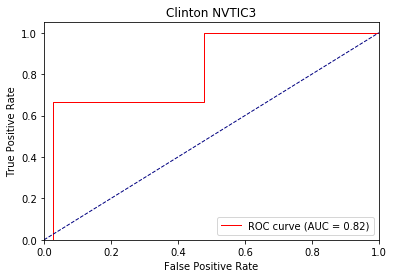

Directory already exists!
hc_nvtic3 2 ap tensor([1., 0.]) loss : 0.09371483325958252 0.12668034018472182 tid : 400 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic3 2 ap tensor([0.9876, 0.3636]) loss : 0.04598736763000488 0.17349609780696132 tid : 300 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic3 2 ap tensor([0.9924, 0.2398]) loss : 0.05465090274810791 0.13463033454598122 tid : 510 tg tensor([[0]], device='cuda:0')


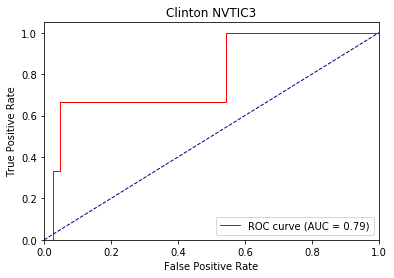

Directory already exists!
hc_nvtic5 0 ap tensor([1., 0.]) loss : 0.47325822710990906 0.4806063256480477 tid : 400 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic5 0 ap tensor([1., 0.]) loss : 0.21497130393981934 0.24323282222593984 tid : 300 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic5 0 ap tensor([1., 0.]) loss : 0.1686859130859375 0.23730264154245267 tid : 510 tg tensor([[0]], device='cuda:0')


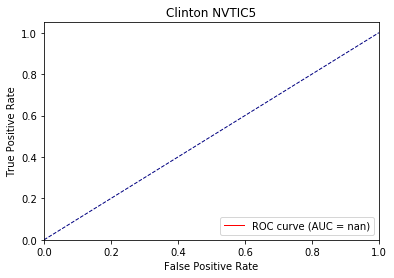

Directory already exists!
hc_nvtic5 1 ap tensor([1., 0.]) loss : 0.10500264167785645 0.16496544442479572 tid : 400 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic5 1 ap tensor([1., 0.]) loss : 0.09493207931518555 0.11485579513734387 tid : 300 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic5 1 ap tensor([1., 0.]) loss : 0.06493830680847168 0.11214501059280252 tid : 510 tg tensor([[0]], device='cuda:0')


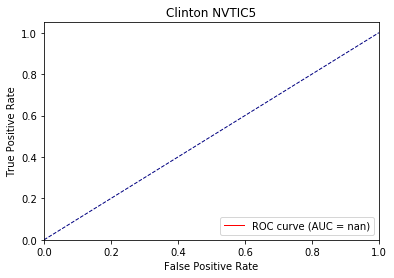

Directory already exists!
hc_nvtic5 2 ap tensor([1., 0.]) loss : 0.03379535675048828 0.07307777465400049 tid : 400 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic5 2 ap tensor([1., 0.]) loss : 0.04426395893096924 0.05711881287636295 tid : 300 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic5 2 ap tensor([1., 0.]) loss : 0.025553226470947266 0.056119683216202934 tid : 510 tg tensor([[0]], device='cuda:0')


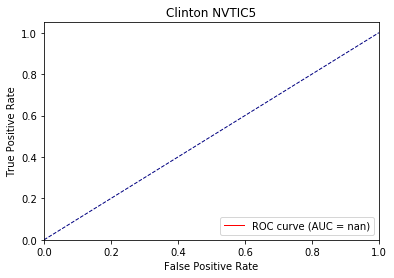

Directory already exists!
hc_nvtic4 0 ap tensor([0.9987, 0.0433]) loss : 0.31640124320983887 0.4679207455408089 tid : 400 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic4 0 ap tensor([0.9875, 0.1971]) loss : 0.22858232259750366 0.3496805857266149 tid : 300 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic4 0 ap tensor([0.9918, 0.1160]) loss : 0.2393220067024231 0.3287957822376827 tid : 510 tg tensor([[0]], device='cuda:0')


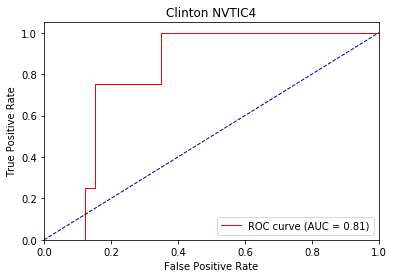

Directory already exists!
hc_nvtic4 1 ap tensor([0.9883, 0.0788]) loss : 0.1988835334777832 0.2803152749290714 tid : 400 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic4 1 ap tensor([0.9891, 0.2256]) loss : 0.1019740104675293 0.24496389733206841 tid : 300 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic4 1 ap tensor([0.9928, 0.1350]) loss : 0.10109573602676392 0.2053915560245514 tid : 510 tg tensor([[0]], device='cuda:0')


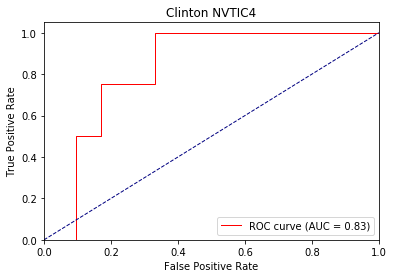

Directory already exists!
hc_nvtic4 2 ap tensor([0.9885, 0.0252]) loss : 0.07180273532867432 0.15301774959948103 tid : 400 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic4 2 ap tensor([0.9883, 0.2637]) loss : 0.04944944381713867 0.2184648456112031 tid : 300 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic4 2 ap tensor([0.9925, 0.1493]) loss : 0.044318556785583496 0.16181197593796928 tid : 510 tg tensor([[0]], device='cuda:0')


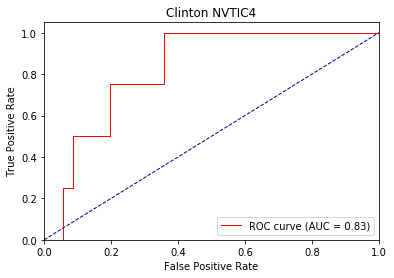

Directory already exists!
hc_interruptions 0 ap tensor([0.9568, 0.0189]) loss : 0.6702784299850464 0.6914716364685879 tid : 400 tg tensor([[0]], device='cuda:0')
TEST hc_interruptions 0 ap tensor([0.9855, 0.1000]) loss : 0.43387526273727417 0.43638924821730585 tid : 300 tg tensor([[0]], device='cuda:0')
TEST hc_interruptions 0 ap tensor([0.9730, 0.0425]) loss : 0.4180784821510315 0.4400190643544467 tid : 510 tg tensor([[0]], device='cuda:0')


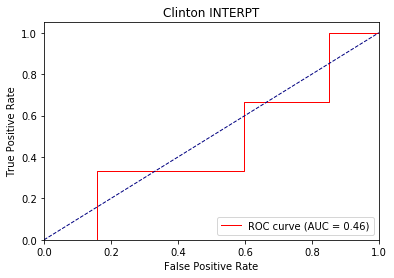

Directory already exists!
hc_interruptions 1 ap tensor([0.9982, 0.1907]) loss : 0.27927514910697937 0.3053034269221269 tid : 400 tg tensor([[0]], device='cuda:0')
TEST hc_interruptions 1 ap tensor([0.9700, 0.0385]) loss : 0.2255387008190155 0.2639933079481125 tid : 300 tg tensor([[0]], device='cuda:0')
TEST hc_interruptions 1 ap tensor([0.9635, 0.0260]) loss : 0.21270343661308289 0.26428765030402057 tid : 510 tg tensor([[0]], device='cuda:0')


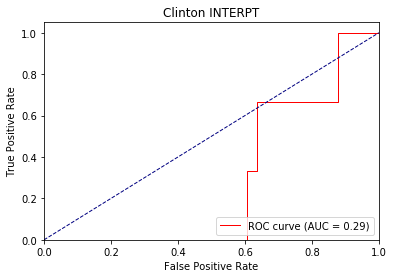

Directory already exists!
hc_interruptions 2 ap tensor([1., 0.]) loss : 0.21024265885353088 0.17592568275256035 tid : 400 tg tensor([[0]], device='cuda:0')
TEST hc_interruptions 2 ap tensor([0.9659, 0.0360]) loss : 0.11953127384185791 0.18833375698135746 tid : 300 tg tensor([[0]], device='cuda:0')
TEST hc_interruptions 2 ap tensor([0.9590, 0.0245]) loss : 0.09965759515762329 0.18605398119620556 tid : 510 tg tensor([[0]], device='cuda:0')


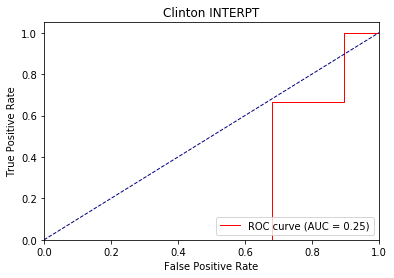

Directory already exists!
hc_lookat2 0 ap tensor([0.4968, 0.5695]) loss : 0.7360179424285889 0.6960854623998914 tid : 200 tg tensor([[0]], device='cuda:0')
hc_lookat2 0 ap tensor([0.7612, 0.7937]) loss : 0.5971298217773438 0.6280695259571075 tid : 400 tg tensor([[0]], device='cuda:0')
TEST hc_lookat2 0 ap tensor([0.9073, 0.8778]) loss : 0.978557825088501 0.541874361038208 tid : 300 tg tensor([[0]], device='cuda:0')
TEST hc_lookat2 0 ap tensor([0.9148, 0.8919]) loss : 0.309221088886261 0.538480120093635 tid : 420 tg tensor([[1]], device='cuda:0')


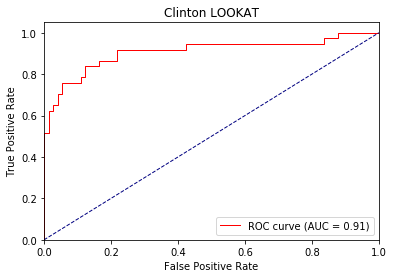

Directory already exists!
hc_lookat2 1 ap tensor([0.9436, 0.9310]) loss : 0.36353468894958496 0.45412849417821627 tid : 400 tg tensor([[0]], device='cuda:0')
hc_lookat2 1 ap tensor([0.9485, 0.9443]) loss : 0.4680384397506714 0.43747681013481343 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_lookat2 1 ap tensor([0.9101, 0.8911]) loss : 0.8614824414253235 0.4583439616056589 tid : 300 tg tensor([[0]], device='cuda:0')
TEST hc_lookat2 1 ap tensor([0.9141, 0.8888]) loss : 0.1658036708831787 0.45614186866899553 tid : 420 tg tensor([[1]], device='cuda:0')


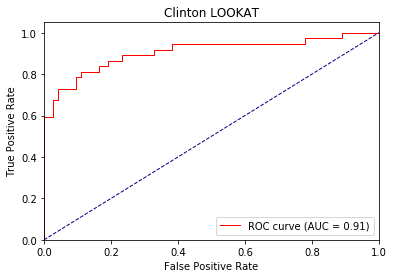

Directory already exists!
hc_lookat2 2 ap tensor([0.9461, 0.9496]) loss : 0.36863046884536743 0.36141906674201785 tid : 200 tg tensor([[0]], device='cuda:0')
hc_lookat2 2 ap tensor([0.9457, 0.9500]) loss : 0.21602535247802734 0.3614215395906392 tid : 400 tg tensor([[0]], device='cuda:0')
TEST hc_lookat2 2 ap tensor([0.9148, 0.8862]) loss : 0.7349709272384644 0.41560268356249885 tid : 300 tg tensor([[0]], device='cuda:0')
TEST hc_lookat2 2 ap tensor([0.9156, 0.8791]) loss : 0.09770679473876953 0.4163436869556984 tid : 420 tg tensor([[1]], device='cuda:0')


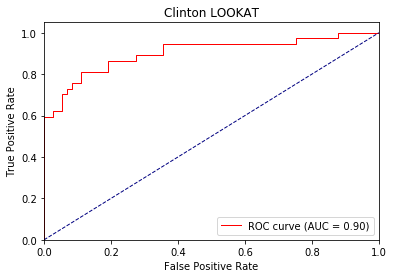

Directory already exists!
hc_brush1 0 ap tensor([0.7667, 0.0957]) loss : 0.5768907070159912 0.6839853629786917 tid : 200 tg tensor([[0]], device='cuda:0')
hc_brush1 0 ap tensor([0.8096, 0.0857]) loss : 0.551375150680542 0.6453319032524907 tid : 400 tg tensor([[0]], device='cuda:0')
TEST hc_brush1 0 ap tensor([0.7913, 0.1126]) loss : 0.3331000804901123 0.5650694668292999 tid : 300 tg tensor([[0]], device='cuda:0')
TEST hc_brush1 0 ap tensor([0.7685, 0.1195]) loss : 0.36755597591400146 0.5678673383225216 tid : 420 tg tensor([[0]], device='cuda:0')


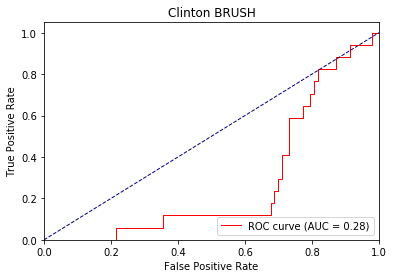

Directory already exists!
hc_brush1 1 ap tensor([0.8920, 0.0791]) loss : 0.3098605275154114 0.4776072802970994 tid : 200 tg tensor([[0]], device='cuda:0')
hc_brush1 1 ap tensor([0.8834, 0.0878]) loss : 0.30338776111602783 0.46771738383298117 tid : 400 tg tensor([[0]], device='cuda:0')
TEST hc_brush1 1 ap tensor([0.9046, 0.1938]) loss : 0.22520720958709717 0.4637118422068082 tid : 300 tg tensor([[0]], device='cuda:0')
TEST hc_brush1 1 ap tensor([0.8449, 0.1786]) loss : 0.2646823525428772 0.48226257857311977 tid : 420 tg tensor([[0]], device='cuda:0')


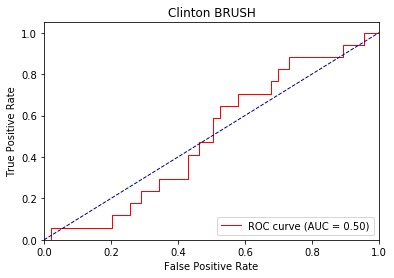

Directory already exists!
hc_brush1 2 ap tensor([0.9385, 0.1937]) loss : 0.18632292747497559 0.4218624430544236 tid : 400 tg tensor([[0]], device='cuda:0')
hc_brush1 2 ap tensor([0.9378, 0.2061]) loss : 0.16940820217132568 0.4011454310926724 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_brush1 2 ap tensor([0.9657, 0.3386]) loss : 0.16570830345153809 0.40880577655938954 tid : 300 tg tensor([[0]], device='cuda:0')
TEST hc_brush1 2 ap tensor([0.9023, 0.2920]) loss : 0.21533238887786865 0.4405212589863981 tid : 420 tg tensor([[0]], device='cuda:0')


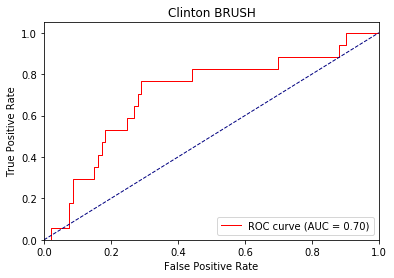

Directory already exists!
hc_nvdis1 0 ap tensor([0.9387, 0.2488]) loss : 0.4284553527832031 0.5329777397215366 tid : 400 tg tensor([[0]], device='cuda:0')
hc_nvdis1 0 ap tensor([0.9424, 0.2431]) loss : 0.43706563115119934 0.5243729676393901 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_nvdis1 0 ap tensor([0.7393, 0.2429]) loss : 0.3134830594062805 0.577447484089778 tid : 300 tg tensor([[0]], device='cuda:0')
TEST hc_nvdis1 0 ap tensor([0.8159, 0.2493]) loss : 0.23517608642578125 0.5356440333168159 tid : 420 tg tensor([[0]], device='cuda:0')


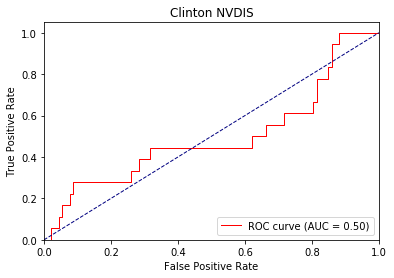

Directory already exists!
hc_nvdis1 1 ap tensor([0.9327, 0.3069]) loss : 0.2742117643356323 0.3855406520935485 tid : 400 tg tensor([[0]], device='cuda:0')
hc_nvdis1 1 ap tensor([0.9416, 0.3376]) loss : 0.28782063722610474 0.38055204075795634 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_nvdis1 1 ap tensor([0.7419, 0.2388]) loss : 0.1796504259109497 0.5729437965613146 tid : 300 tg tensor([[0]], device='cuda:0')
TEST hc_nvdis1 1 ap tensor([0.8166, 0.2555]) loss : 0.14022541046142578 0.5113618474328117 tid : 420 tg tensor([[0]], device='cuda:0')


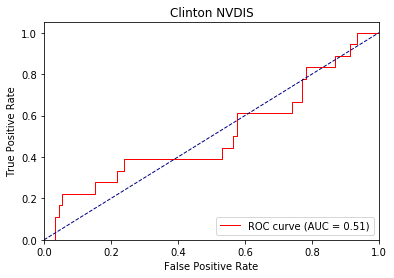

Directory already exists!
hc_nvdis1 2 ap tensor([0.9773, 0.6381]) loss : 0.18376374244689941 0.315628430753384 tid : 200 tg tensor([[0]], device='cuda:0')
hc_nvdis1 2 ap tensor([0.9842, 0.6076]) loss : 0.1505523920059204 0.29304345837839835 tid : 400 tg tensor([[0]], device='cuda:0')
TEST hc_nvdis1 2 ap tensor([0.7365, 0.2405]) loss : 0.115043044090271 0.6083917874556322 tid : 300 tg tensor([[0]], device='cuda:0')
TEST hc_nvdis1 2 ap tensor([0.8180, 0.2704]) loss : 0.09909498691558838 0.5302902125240712 tid : 420 tg tensor([[0]], device='cuda:0')


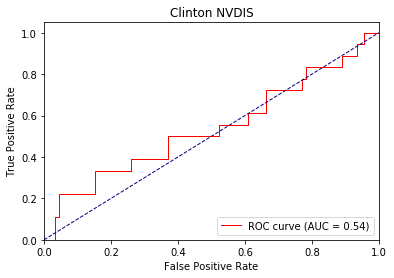

Directory already exists!
hc_look 0 ap tensor([0.4150, 0.9121]) loss : 0.6321408748626709 0.7054688716712205 tid : 400 tg tensor([[1]], device='cuda:0')
hc_look 0 ap tensor([0.5793, 0.9306]) loss : 0.6179674863815308 0.6599860752182167 tid : 200 tg tensor([[1]], device='cuda:0')
TEST hc_look 0 ap tensor([0.5201, 0.9783]) loss : 0.6785088181495667 0.538879494025157 tid : 300 tg tensor([[1]], device='cuda:0')
TEST hc_look 0 ap tensor([0.5989, 0.9207]) loss : 0.4050256311893463 0.5626851983284682 tid : 420 tg tensor([[0]], device='cuda:0')


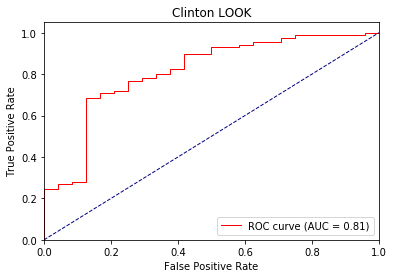

Directory already exists!
hc_look 1 ap tensor([0.7714, 0.9375]) loss : 0.3979652523994446 0.4924622196704149 tid : 400 tg tensor([[1]], device='cuda:0')
hc_look 1 ap tensor([0.8166, 0.9419]) loss : 0.3994978368282318 0.5250075906515121 tid : 200 tg tensor([[1]], device='cuda:0')
TEST hc_look 1 ap tensor([0.5280, 0.9778]) loss : 0.4748707413673401 0.43493760915902946 tid : 300 tg tensor([[1]], device='cuda:0')
TEST hc_look 1 ap tensor([0.5993, 0.9186]) loss : 0.3619767427444458 0.4918719563591346 tid : 420 tg tensor([[0]], device='cuda:0')


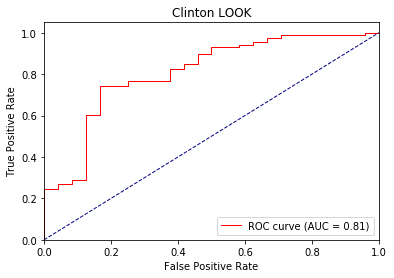

Directory already exists!
hc_look 2 ap tensor([0.7708, 0.9540]) loss : 0.1711634397506714 0.4452041006390599 tid : 400 tg tensor([[1]], device='cuda:0')
hc_look 2 ap tensor([0.7792, 0.9553]) loss : 0.23522204160690308 0.4422035230964911 tid : 200 tg tensor([[1]], device='cuda:0')
TEST hc_look 2 ap tensor([0.5718, 0.9788]) loss : 0.35395631194114685 0.37655624472177945 tid : 300 tg tensor([[1]], device='cuda:0')
TEST hc_look 2 ap tensor([0.6161, 0.9196]) loss : 0.30588436126708984 0.4584256018815416 tid : 420 tg tensor([[0]], device='cuda:0')


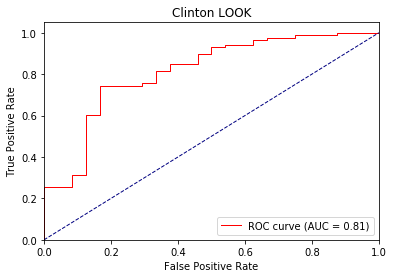

Directory already exists!
hc_eyebrow 0 ap tensor([0.8971, 0.5065]) loss : 0.569685161113739 0.6010011556308444 tid : 200 tg tensor([[1]], device='cuda:0')
hc_eyebrow 0 ap tensor([0.8724, 0.5350]) loss : 0.8804829120635986 0.5918714729304734 tid : 400 tg tensor([[0]], device='cuda:0')
TEST hc_eyebrow 0 ap tensor([0.8920, 0.5520]) loss : 0.6196420788764954 0.6004274725914002 tid : 300 tg tensor([[1]], device='cuda:0')
TEST hc_eyebrow 0 ap tensor([0.9098, 0.4835]) loss : 0.19965696334838867 0.5857412430007806 tid : 420 tg tensor([[0]], device='cuda:0')


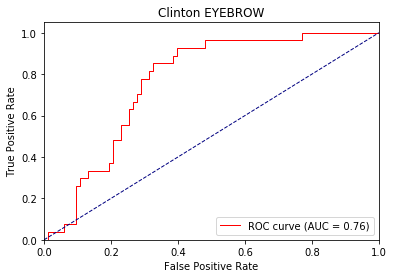

Directory already exists!
hc_eyebrow 1 ap tensor([0.9035, 0.5604]) loss : 0.613774299621582 0.5508942625660828 tid : 200 tg tensor([[1]], device='cuda:0')
hc_eyebrow 1 ap tensor([0.9189, 0.6403]) loss : 0.903597354888916 0.5094447096465772 tid : 400 tg tensor([[0]], device='cuda:0')
TEST hc_eyebrow 1 ap tensor([0.8970, 0.5931]) loss : 0.6317873001098633 0.5558144161334404 tid : 300 tg tensor([[1]], device='cuda:0')
TEST hc_eyebrow 1 ap tensor([0.9185, 0.5336]) loss : 0.11643505096435547 0.5402056296889701 tid : 420 tg tensor([[0]], device='cuda:0')


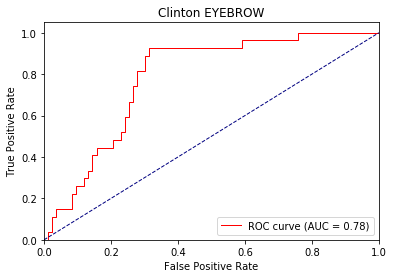

Directory already exists!
hc_eyebrow 2 ap tensor([0.9422, 0.7482]) loss : 0.9481468200683594 0.44689401971086007 tid : 400 tg tensor([[0]], device='cuda:0')
hc_eyebrow 2 ap tensor([0.9292, 0.7465]) loss : 0.6889914870262146 0.4538209454319571 tid : 200 tg tensor([[1]], device='cuda:0')
TEST hc_eyebrow 2 ap tensor([0.8975, 0.6062]) loss : 0.6126444339752197 0.5319961763345278 tid : 300 tg tensor([[1]], device='cuda:0')
TEST hc_eyebrow 2 ap tensor([0.9193, 0.5533]) loss : 0.0785132646560669 0.516709245657653 tid : 420 tg tensor([[0]], device='cuda:0')


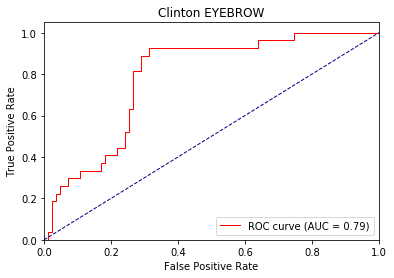

Directory already exists!
hc_atface 0 ap tensor([0.9194, 0.0864]) loss : 0.7718876600265503 0.645950436592102 tid : 200 tg tensor([[1]], device='cuda:0')
hc_atface 0 ap tensor([0.9124, 0.0985]) loss : 0.5772781372070312 0.6251990863910089 tid : 400 tg tensor([[0]], device='cuda:0')
TEST hc_atface 0 ap tensor([0.9233, 0.3616]) loss : 1.0330160856246948 0.5340024709701539 tid : 300 tg tensor([[1]], device='cuda:0')
TEST hc_atface 0 ap tensor([0.9265, 0.3754]) loss : 0.20954060554504395 0.5273563439926404 tid : 420 tg tensor([[0]], device='cuda:0')


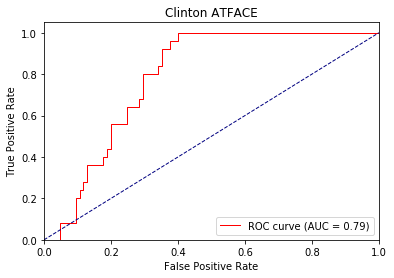

Directory already exists!
hc_atface 1 ap tensor([0.9252, 0.1857]) loss : 0.4600971043109894 0.4782544962457708 tid : 400 tg tensor([[0]], device='cuda:0')
hc_atface 1 ap tensor([0.9283, 0.1794]) loss : 1.139166235923767 0.4520678246021271 tid : 200 tg tensor([[1]], device='cuda:0')
TEST hc_atface 1 ap tensor([0.9357, 0.3997]) loss : 1.2879911661148071 0.4822416718189533 tid : 300 tg tensor([[1]], device='cuda:0')
TEST hc_atface 1 ap tensor([0.9341, 0.4061]) loss : 0.09190702438354492 0.4810703731654735 tid : 420 tg tensor([[0]], device='cuda:0')


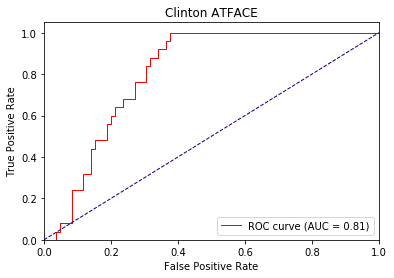

Directory already exists!
hc_atface 2 ap tensor([0.9690, 0.2400]) loss : 0.3028007745742798 0.3370787089091566 tid : 400 tg tensor([[0]], device='cuda:0')
hc_atface 2 ap tensor([0.9619, 0.2332]) loss : 1.5991430282592773 0.3480749474315161 tid : 200 tg tensor([[1]], device='cuda:0')
TEST hc_atface 2 ap tensor([0.9407, 0.4319]) loss : 1.4057828187942505 0.46150539334003743 tid : 300 tg tensor([[1]], device='cuda:0')
TEST hc_atface 2 ap tensor([0.9393, 0.4350]) loss : 0.05432939529418945 0.46451544996058003 tid : 420 tg tensor([[0]], device='cuda:0')


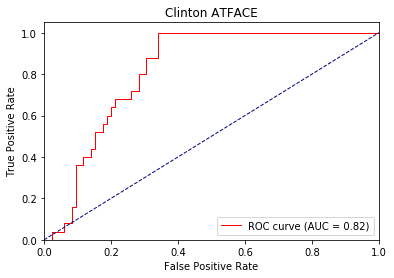

Directory already exists!
hc_feface 0 ap tensor([1., 0.]) loss : 0.3960992991924286 0.5405205702330885 tid : 400 tg tensor([[0]], device='cuda:0')
hc_feface 0 ap tensor([1., 0.]) loss : 0.3043665289878845 0.5124073681470594 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_feface 0 ap tensor([1., 0.]) loss : 0.31462252140045166 0.3454886890374697 tid : 300 tg tensor([[0]], device='cuda:0')
TEST hc_feface 0 ap tensor([1., 0.]) loss : 0.2869773507118225 0.33513253357972994 tid : 420 tg tensor([[0]], device='cuda:0')


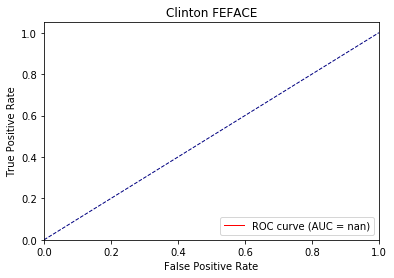

Directory already exists!
hc_feface 1 ap tensor([1., 0.]) loss : 0.23165440559387207 0.31212509455888165 tid : 200 tg tensor([[0]], device='cuda:0')
hc_feface 1 ap tensor([1., 0.]) loss : 0.14452797174453735 0.24146448477737262 tid : 400 tg tensor([[0]], device='cuda:0')
TEST hc_feface 1 ap tensor([1., 0.]) loss : 0.1652226448059082 0.1895123784358685 tid : 300 tg tensor([[0]], device='cuda:0')
TEST hc_feface 1 ap tensor([1., 0.]) loss : 0.10992634296417236 0.17705895190828302 tid : 420 tg tensor([[0]], device='cuda:0')


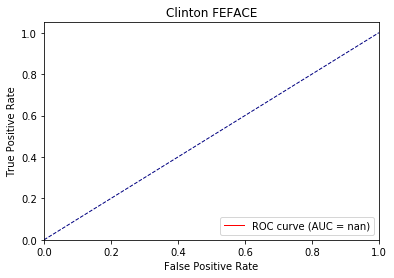

Directory already exists!
hc_feface 2 ap tensor([1., 0.]) loss : 0.09109950065612793 0.14551766939505845 tid : 400 tg tensor([[0]], device='cuda:0')
hc_feface 2 ap tensor([1., 0.]) loss : 0.043051958084106445 0.11882380354098784 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_feface 2 ap tensor([1., 0.]) loss : 0.08530354499816895 0.10748459788469168 tid : 300 tg tensor([[0]], device='cuda:0')
TEST hc_feface 2 ap tensor([1., 0.]) loss : 0.049592018127441406 0.09690864133031181 tid : 420 tg tensor([[0]], device='cuda:0')


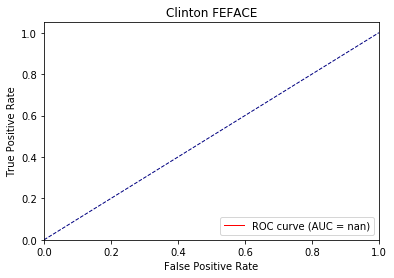

Directory already exists!
hc_hrface 0 ap tensor([0.5347, 0.4873]) loss : 0.7063350677490234 0.6948911445140838 tid : 200 tg tensor([[0]], device='cuda:0')
hc_hrface 0 ap tensor([0.5534, 0.5267]) loss : 0.573359489440918 0.6901001701931108 tid : 400 tg tensor([[0]], device='cuda:0')
TEST hc_hrface 0 ap tensor([0.8029, 0.6078]) loss : 0.7082059979438782 0.6619176915058723 tid : 300 tg tensor([[0]], device='cuda:0')
TEST hc_hrface 0 ap tensor([0.8147, 0.5018]) loss : 0.7350780367851257 0.6672452651382832 tid : 420 tg tensor([[0]], device='cuda:0')


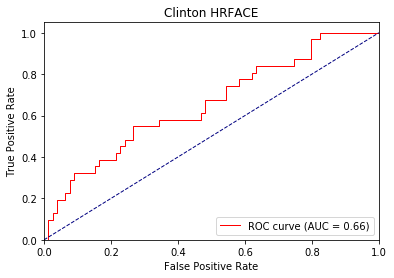

Directory already exists!
hc_hrface 1 ap tensor([0.7553, 0.7464]) loss : 0.6406654119491577 0.6516339392653441 tid : 200 tg tensor([[0]], device='cuda:0')
hc_hrface 1 ap tensor([0.7518, 0.7710]) loss : 0.47786134481430054 0.6457788913184892 tid : 400 tg tensor([[0]], device='cuda:0')
TEST hc_hrface 1 ap tensor([0.7974, 0.6386]) loss : 0.6691300868988037 0.6431431513566237 tid : 300 tg tensor([[0]], device='cuda:0')
TEST hc_hrface 1 ap tensor([0.8248, 0.5803]) loss : 0.7717294692993164 0.6438784927464603 tid : 420 tg tensor([[0]], device='cuda:0')


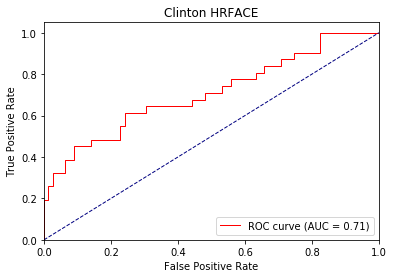

Directory already exists!
hc_hrface 2 ap tensor([0.7812, 0.8538]) loss : 0.6217300295829773 0.614886151908925 tid : 200 tg tensor([[0]], device='cuda:0')
hc_hrface 2 ap tensor([0.7940, 0.8534]) loss : 0.4257444739341736 0.6104160545614469 tid : 400 tg tensor([[0]], device='cuda:0')
TEST hc_hrface 2 ap tensor([0.8019, 0.6253]) loss : 0.6257942318916321 0.6296053042778602 tid : 300 tg tensor([[0]], device='cuda:0')
TEST hc_hrface 2 ap tensor([0.8318, 0.5849]) loss : 0.7754449844360352 0.6252575161751737 tid : 420 tg tensor([[0]], device='cuda:0')


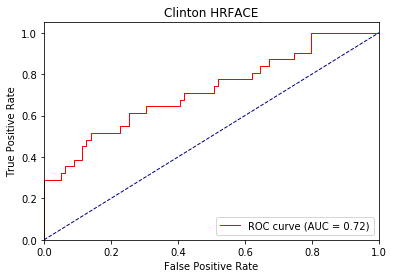

Directory already exists!
hc_saface 0 ap tensor([0.9943, 0.1576]) loss : 0.32302606105804443 0.4998014535913136 tid : 200 tg tensor([[0]], device='cuda:0')
hc_saface 0 ap tensor([0.9941, 0.1324]) loss : 0.32375413179397583 0.45061293018704607 tid : 400 tg tensor([[0]], device='cuda:0')
TEST hc_saface 0 ap tensor([1., 0.]) loss : 0.20093560218811035 0.31290941330102773 tid : 300 tg tensor([[0]], device='cuda:0')
TEST hc_saface 0 ap tensor([1., 0.]) loss : 0.19325733184814453 0.3057328553012248 tid : 420 tg tensor([[0]], device='cuda:0')


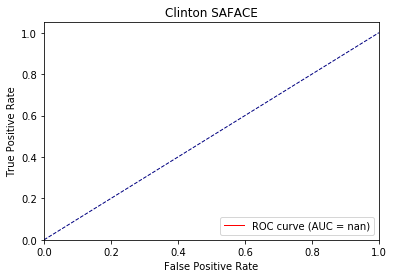

Directory already exists!
hc_saface 1 ap tensor([0.9920, 0.0317]) loss : 0.22642087936401367 0.2809278460511242 tid : 400 tg tensor([[0]], device='cuda:0')
hc_saface 1 ap tensor([0.9921, 0.0303]) loss : 0.17413097620010376 0.28044896174308864 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_saface 1 ap tensor([1., 0.]) loss : 0.09358334541320801 0.16892879421894366 tid : 300 tg tensor([[0]], device='cuda:0')
TEST hc_saface 1 ap tensor([1., 0.]) loss : 0.07805979251861572 0.1617299070519008 tid : 420 tg tensor([[0]], device='cuda:0')


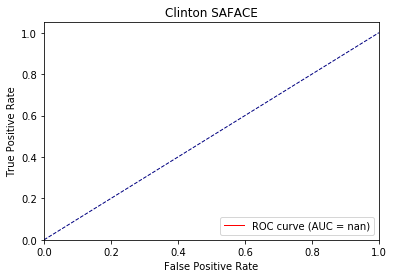

Directory already exists!
hc_saface 2 ap tensor([1., 0.]) loss : 0.13460832834243774 0.15093375288921854 tid : 400 tg tensor([[0]], device='cuda:0')
hc_saface 2 ap tensor([0.9971, 0.0265]) loss : 0.06090664863586426 0.13295835523021143 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_saface 2 ap tensor([1., 0.]) loss : 0.045766592025756836 0.09826428248332097 tid : 300 tg tensor([[0]], device='cuda:0')
TEST hc_saface 2 ap tensor([1., 0.]) loss : 0.036797523498535156 0.09244424238633574 tid : 420 tg tensor([[0]], device='cuda:0')


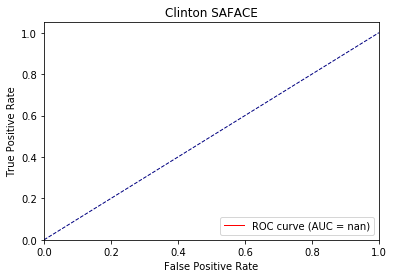

Directory already exists!
hc_neuface 0 ap tensor([0.6783, 0.4234]) loss : 0.975053071975708 0.6734543808632427 tid : 400 tg tensor([[1]], device='cuda:0')
hc_neuface 0 ap tensor([0.6332, 0.4401]) loss : 0.5399349331855774 0.6764644619713469 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_neuface 0 ap tensor([0.6695, 0.5718]) loss : 0.7111860513687134 0.6709034121953524 tid : 300 tg tensor([[0]], device='cuda:0')
TEST hc_neuface 0 ap tensor([0.6318, 0.6499]) loss : 0.7267035841941833 0.6766104798638419 tid : 420 tg tensor([[1]], device='cuda:0')


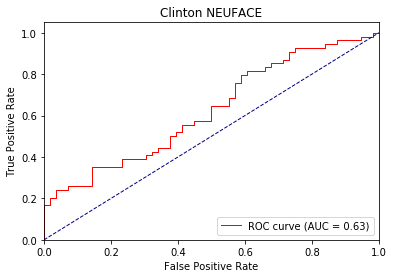

Directory already exists!
hc_neuface 1 ap tensor([0.8225, 0.6172]) loss : 0.5226883888244629 0.6318875899475612 tid : 200 tg tensor([[0]], device='cuda:0')
hc_neuface 1 ap tensor([0.7030, 0.6214]) loss : 0.9320616722106934 0.6502636869748434 tid : 400 tg tensor([[1]], device='cuda:0')
TEST hc_neuface 1 ap tensor([0.6433, 0.5270]) loss : 0.6606302261352539 0.6763937638356136 tid : 300 tg tensor([[0]], device='cuda:0')
TEST hc_neuface 1 ap tensor([0.6092, 0.5927]) loss : 0.808542013168335 0.6839043143090238 tid : 420 tg tensor([[1]], device='cuda:0')


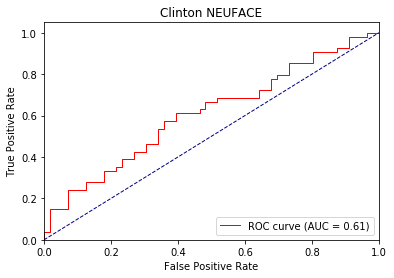

Directory already exists!
hc_neuface 2 ap tensor([0.8435, 0.4958]) loss : 0.9828558564186096 0.6034689284100825 tid : 400 tg tensor([[1]], device='cuda:0')
hc_neuface 2 ap tensor([0.8049, 0.6505]) loss : 0.4907820224761963 0.6121254324275542 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_neuface 2 ap tensor([0.6383, 0.4743]) loss : 0.6339249610900879 0.6793670094930209 tid : 300 tg tensor([[0]], device='cuda:0')
TEST hc_neuface 2 ap tensor([0.6067, 0.5453]) loss : 0.8458511233329773 0.6869807718844896 tid : 420 tg tensor([[1]], device='cuda:0')


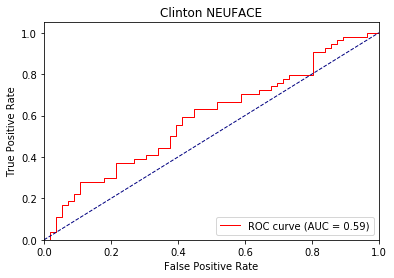

Directory already exists!
hc_inapprop 0 ap tensor([1., 0.]) loss : 0.625616192817688 0.6048090411350131 tid : 200 tg tensor([[0]], device='cuda:0')
hc_inapprop 0 ap tensor([1., 0.]) loss : 0.5151970386505127 0.5198864913767293 tid : 400 tg tensor([[0]], device='cuda:0')
TEST hc_inapprop 0 ap tensor([1., 0.]) loss : 0.2519066333770752 0.2919808241037222 tid : 300 tg tensor([[0]], device='cuda:0')
TEST hc_inapprop 0 ap tensor([1., 0.]) loss : 0.15369290113449097 0.2792607087097811 tid : 420 tg tensor([[0]], device='cuda:0')


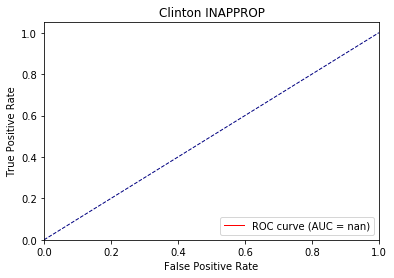

Directory already exists!
hc_inapprop 1 ap tensor([1., 0.]) loss : 0.19792050123214722 0.2559782086775221 tid : 200 tg tensor([[0]], device='cuda:0')
hc_inapprop 1 ap tensor([1., 0.]) loss : 0.11426782608032227 0.17697200010269146 tid : 400 tg tensor([[0]], device='cuda:0')
TEST hc_inapprop 1 ap tensor([1., 0.]) loss : 0.10535693168640137 0.139268303834475 tid : 300 tg tensor([[0]], device='cuda:0')
TEST hc_inapprop 1 ap tensor([1., 0.]) loss : 0.060936927795410156 0.12959981701347265 tid : 420 tg tensor([[0]], device='cuda:0')


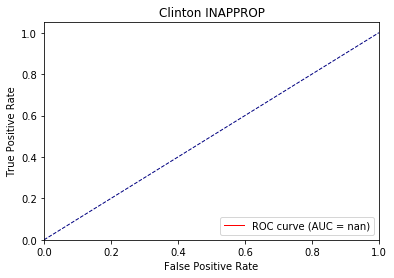

Directory already exists!
hc_inapprop 2 ap tensor([1., 0.]) loss : 0.10029017925262451 0.10445141579423632 tid : 400 tg tensor([[0]], device='cuda:0')
hc_inapprop 2 ap tensor([1., 0.]) loss : 0.05192971229553223 0.09521427750587463 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_inapprop 2 ap tensor([1., 0.]) loss : 0.04444527626037598 0.07199495159662687 tid : 300 tg tensor([[0]], device='cuda:0')
TEST hc_inapprop 2 ap tensor([1., 0.]) loss : 0.02902853488922119 0.06535551755615834 tid : 420 tg tensor([[0]], device='cuda:0')


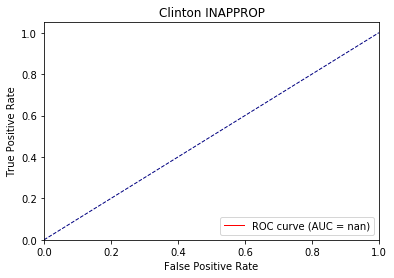

Directory already exists!
hc_affgest 0 ap tensor([0.9508, 0.1836]) loss : 0.49461492896080017 0.542911504705747 tid : 200 tg tensor([[0]], device='cuda:0')
hc_affgest 0 ap tensor([0.9539, 0.1834]) loss : 0.4947289824485779 0.5123599578158646 tid : 400 tg tensor([[0]], device='cuda:0')
TEST hc_affgest 0 ap tensor([0.9844, 0.0572]) loss : 0.32059192657470703 0.35197867659422066 tid : 300 tg tensor([[0]], device='cuda:0')
TEST hc_affgest 0 ap tensor([0.9900, 0.0471]) loss : 0.18746644258499146 0.3315515682268678 tid : 420 tg tensor([[0]], device='cuda:0')


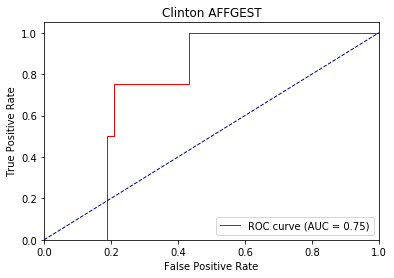

Directory already exists!
hc_affgest 1 ap tensor([0.9777, 0.1478]) loss : 0.2857643961906433 0.3187196163030771 tid : 400 tg tensor([[0]], device='cuda:0')
hc_affgest 1 ap tensor([0.9813, 0.1682]) loss : 0.16850095987319946 0.2939464072017518 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_affgest 1 ap tensor([0.9836, 0.0549]) loss : 0.1912139654159546 0.26023202446790844 tid : 300 tg tensor([[0]], device='cuda:0')
TEST hc_affgest 1 ap tensor([0.9899, 0.0455]) loss : 0.08816206455230713 0.23580528879433535 tid : 420 tg tensor([[0]], device='cuda:0')


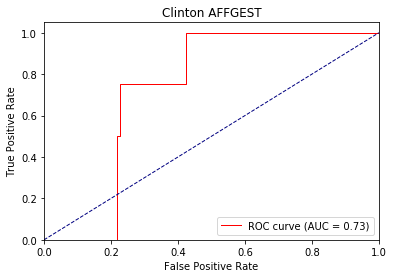

Directory already exists!
hc_affgest 2 ap tensor([0.9819, 0.2009]) loss : 0.13199138641357422 0.26044721490874584 tid : 200 tg tensor([[0]], device='cuda:0')
hc_affgest 2 ap tensor([0.9799, 0.1765]) loss : 0.1792367696762085 0.25760215834567424 tid : 400 tg tensor([[0]], device='cuda:0')
TEST hc_affgest 2 ap tensor([0.9831, 0.0541]) loss : 0.12694406509399414 0.2152014122559474 tid : 300 tg tensor([[0]], device='cuda:0')
TEST hc_affgest 2 ap tensor([0.9899, 0.0455]) loss : 0.049536705017089844 0.18929737605405658 tid : 420 tg tensor([[0]], device='cuda:0')


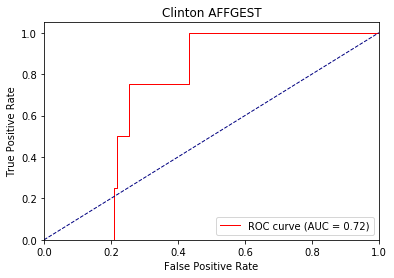

Directory already exists!
hc_defgest 0 ap tensor([0.8087, 0.1348]) loss : 0.5132445096969604 0.6765032623495374 tid : 200 tg tensor([[0]], device='cuda:0')
hc_defgest 0 ap tensor([0.8300, 0.1196]) loss : 1.1189873218536377 0.6382299733937845 tid : 400 tg tensor([[1]], device='cuda:0')
TEST hc_defgest 0 ap tensor([0.9066, 0.4927]) loss : 0.45238375663757324 0.531339554144786 tid : 300 tg tensor([[0]], device='cuda:0')
TEST hc_defgest 0 ap tensor([0.9151, 0.4669]) loss : 0.28059327602386475 0.5192989341998369 tid : 420 tg tensor([[0]], device='cuda:0')


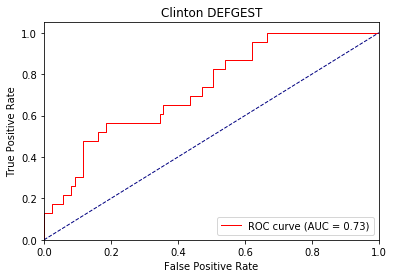

Directory already exists!
hc_defgest 1 ap tensor([0.9301, 0.1863]) loss : 1.426933765411377 0.45529516851963775 tid : 400 tg tensor([[1]], device='cuda:0')
hc_defgest 1 ap tensor([0.9386, 0.1957]) loss : 0.26703178882598877 0.4448719806969166 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_defgest 1 ap tensor([0.9281, 0.5098]) loss : 0.28084802627563477 0.47617143667661227 tid : 300 tg tensor([[0]], device='cuda:0')
TEST hc_defgest 1 ap tensor([0.9442, 0.5047]) loss : 0.11165452003479004 0.4524855305639546 tid : 420 tg tensor([[0]], device='cuda:0')


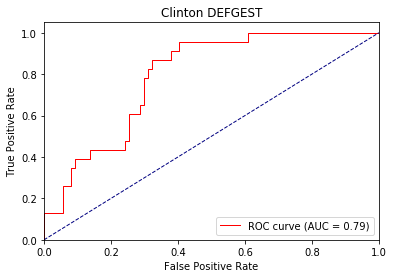

Directory already exists!
hc_defgest 2 ap tensor([0.9600, 0.2437]) loss : 0.19058531522750854 0.3526363959818175 tid : 200 tg tensor([[0]], device='cuda:0')
hc_defgest 2 ap tensor([0.9674, 0.2140]) loss : 1.7001323699951172 0.3349813264897216 tid : 400 tg tensor([[1]], device='cuda:0')
TEST hc_defgest 2 ap tensor([0.9321, 0.5289]) loss : 0.2054973840713501 0.45984087586402894 tid : 300 tg tensor([[0]], device='cuda:0')
TEST hc_defgest 2 ap tensor([0.9497, 0.5341]) loss : 0.0617985725402832 0.4317282187135032 tid : 420 tg tensor([[0]], device='cuda:0')


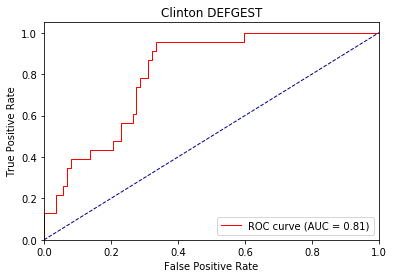

Directory already exists!
hc_agentic 0 ap tensor([0.6245, 0.7500]) loss : 0.560910165309906 0.6538373203424925 tid : 400 tg tensor([[1]], device='cuda:0')
hc_agentic 0 ap tensor([0.8274, 0.8279]) loss : 0.5603692531585693 0.615807303169678 tid : 200 tg tensor([[1]], device='cuda:0')
TEST hc_agentic 0 ap tensor([0.9384, 0.9487]) loss : 0.8120695352554321 0.48878623843193053 tid : 300 tg tensor([[1]], device='cuda:0')
TEST hc_agentic 0 ap tensor([0.9603, 0.9556]) loss : 0.3622925281524658 0.4866372356923778 tid : 420 tg tensor([[0]], device='cuda:0')


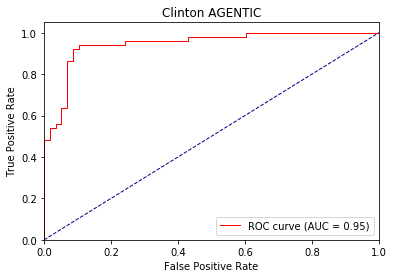

Directory already exists!
hc_agentic 1 ap tensor([0.9204, 0.8672]) loss : 0.4368852972984314 0.5067563930223155 tid : 400 tg tensor([[1]], device='cuda:0')
hc_agentic 1 ap tensor([0.9391, 0.9192]) loss : 0.5178857445716858 0.48147066980600356 tid : 200 tg tensor([[1]], device='cuda:0')
TEST hc_agentic 1 ap tensor([0.9573, 0.9775]) loss : 0.6349477767944336 0.37364525611584004 tid : 300 tg tensor([[1]], device='cuda:0')
TEST hc_agentic 1 ap tensor([0.9734, 0.9798]) loss : 0.17644786834716797 0.3677205697874005 tid : 420 tg tensor([[0]], device='cuda:0')


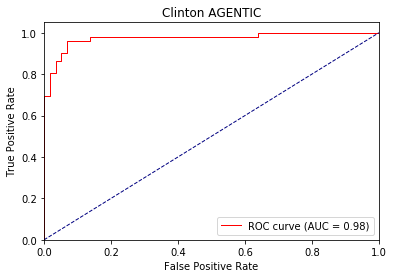

Directory already exists!
hc_agentic 2 ap tensor([0.9332, 0.9811]) loss : 0.26429325342178345 0.34954873857827023 tid : 400 tg tensor([[1]], device='cuda:0')
hc_agentic 2 ap tensor([0.9647, 0.9576]) loss : 0.3621988296508789 0.33871419110963513 tid : 200 tg tensor([[1]], device='cuda:0')
TEST hc_agentic 2 ap tensor([0.9626, 0.9842]) loss : 0.42237162590026855 0.30332846824939436 tid : 300 tg tensor([[1]], device='cuda:0')
TEST hc_agentic 2 ap tensor([0.9774, 0.9863]) loss : 0.09760427474975586 0.29890804679206245 tid : 420 tg tensor([[0]], device='cuda:0')


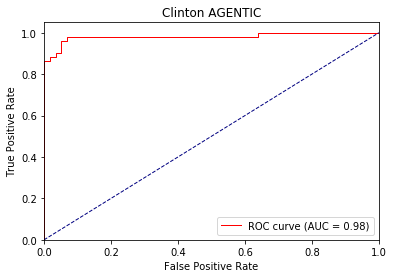

Directory already exists!
hc_waveoff 0 ap tensor([0.5271, 0.2833]) loss : 0.5984142422676086 0.7497793410953723 tid : 200 tg tensor([[1]], device='cuda:0')
hc_waveoff 0 ap tensor([0.6864, 0.3561]) loss : 0.733572781085968 0.7004643246571869 tid : 400 tg tensor([[1]], device='cuda:0')
TEST hc_waveoff 0 ap tensor([0.9083, 0.7029]) loss : 0.7661975026130676 0.6097055866168095 tid : 300 tg tensor([[0]], device='cuda:0')
TEST hc_waveoff 0 ap tensor([0.9377, 0.7720]) loss : 0.3674510717391968 0.5896235014615434 tid : 420 tg tensor([[0]], device='cuda:0')


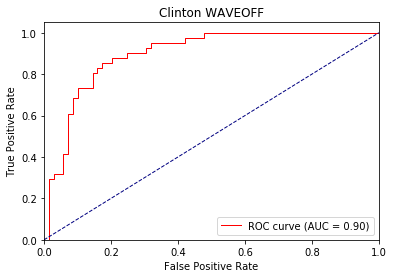

Directory already exists!
hc_waveoff 1 ap tensor([0.9441, 0.7844]) loss : 0.6056466698646545 0.534418024122715 tid : 200 tg tensor([[1]], device='cuda:0')
hc_waveoff 1 ap tensor([0.9460, 0.7780]) loss : 0.6135621070861816 0.530942808634968 tid : 400 tg tensor([[1]], device='cuda:0')
TEST hc_waveoff 1 ap tensor([0.9251, 0.7202]) loss : 0.7472256422042847 0.5356998131825373 tid : 300 tg tensor([[0]], device='cuda:0')
TEST hc_waveoff 1 ap tensor([0.9517, 0.7939]) loss : 0.1862809658050537 0.49996542528773963 tid : 420 tg tensor([[0]], device='cuda:0')


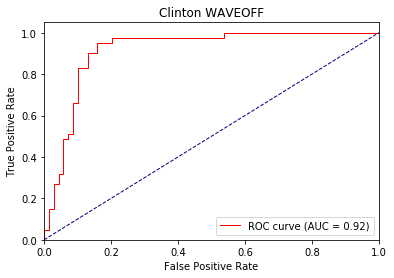

Directory already exists!
hc_waveoff 2 ap tensor([1., 1.]) loss : 0.6111522912979126 0.33266714215278625 tid : 200 tg tensor([[1]], device='cuda:0')
hc_waveoff 2 ap tensor([0.9506, 0.7899]) loss : 0.5214840769767761 0.43960275704210455 tid : 400 tg tensor([[1]], device='cuda:0')
TEST hc_waveoff 2 ap tensor([0.9259, 0.7074]) loss : 0.7861182689666748 0.4992529997458825 tid : 300 tg tensor([[0]], device='cuda:0')
TEST hc_waveoff 2 ap tensor([0.9511, 0.7822]) loss : 0.10965150594711304 0.4541422302803297 tid : 420 tg tensor([[0]], device='cuda:0')


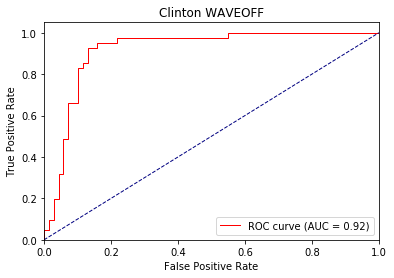

Directory already exists!
hc_nvtic1 0 ap tensor([0.9005, 0.1974]) loss : 0.6771398186683655 0.6515655987288641 tid : 200 tg tensor([[0]], device='cuda:0')
hc_nvtic1 0 ap tensor([0.8726, 0.1726]) loss : 0.4390113949775696 0.6265350232693563 tid : 400 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic1 0 ap tensor([0.7312, 0.3404]) loss : 0.44141197204589844 0.6024228224387536 tid : 300 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic1 0 ap tensor([0.6965, 0.3409]) loss : 1.2609212398529053 0.6140938649016819 tid : 420 tg tensor([[1]], device='cuda:0')


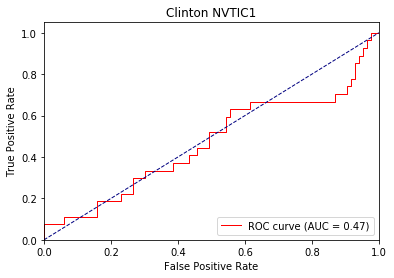

Directory already exists!
hc_nvtic1 1 ap tensor([0.9376, 0.4741]) loss : 0.36827725172042847 0.5127947839597861 tid : 400 tg tensor([[0]], device='cuda:0')
hc_nvtic1 1 ap tensor([0.9023, 0.3011]) loss : 0.4863971769809723 0.5233772437680851 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic1 1 ap tensor([0.7322, 0.3928]) loss : 0.30953872203826904 0.5579876239483174 tid : 300 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic1 1 ap tensor([0.6923, 0.3767]) loss : 1.6813476085662842 0.5851347881756471 tid : 420 tg tensor([[1]], device='cuda:0')


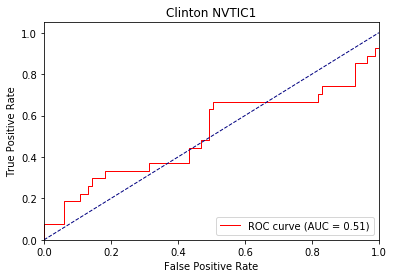

Directory already exists!
hc_nvtic1 2 ap tensor([0.9589, 0.2096]) loss : 0.36681243777275085 0.4068850587154257 tid : 200 tg tensor([[0]], device='cuda:0')
hc_nvtic1 2 ap tensor([0.9257, 0.1813]) loss : 0.21365344524383545 0.38064306633300093 tid : 400 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic1 2 ap tensor([0.8112, 0.4482]) loss : 0.24478667974472046 0.5370639356283041 tid : 300 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic1 2 ap tensor([0.7646, 0.4230]) loss : 1.8483843803405762 0.5726045480604922 tid : 420 tg tensor([[1]], device='cuda:0')


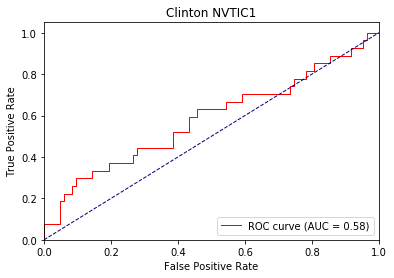

Directory already exists!
hc_nvtic2 0 ap tensor([0.9349, 0.2223]) loss : 0.7566971778869629 0.7514270492898885 tid : 200 tg tensor([[0]], device='cuda:0')
hc_nvtic2 0 ap tensor([0.9235, 0.2612]) loss : 0.4707760810852051 0.6767679752652035 tid : 400 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic2 0 ap tensor([0.9402, 0.7701]) loss : 0.5540244579315186 0.5562456085131718 tid : 300 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic2 0 ap tensor([0.9424, 0.5672]) loss : 0.5488159656524658 0.5593795197063618 tid : 420 tg tensor([[0]], device='cuda:0')


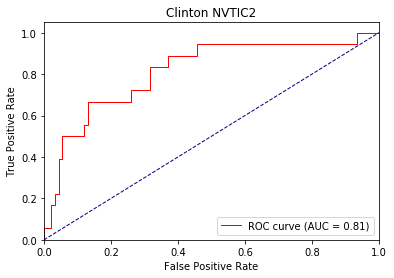

Directory already exists!
hc_nvtic2 1 ap tensor([0.9413, 0.2083]) loss : 0.40818965435028076 0.5498227030038834 tid : 400 tg tensor([[0]], device='cuda:0')
hc_nvtic2 1 ap tensor([0.9286, 0.4193]) loss : 0.5094354152679443 0.5594463410765625 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic2 1 ap tensor([0.9369, 0.5469]) loss : 0.4025917649269104 0.4699596372934488 tid : 300 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic2 1 ap tensor([0.9413, 0.4569]) loss : 0.35399526357650757 0.4653998707117659 tid : 420 tg tensor([[0]], device='cuda:0')


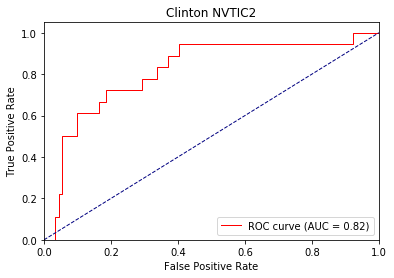

Directory already exists!
hc_nvtic2 2 ap tensor([0.9359, 0.5123]) loss : 0.22242987155914307 0.47477033275824326 tid : 400 tg tensor([[0]], device='cuda:0')
hc_nvtic2 2 ap tensor([0.9654, 0.5068]) loss : 0.2936031222343445 0.4154195285612537 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic2 2 ap tensor([0.9376, 0.5398]) loss : 0.3188779354095459 0.4249883234500885 tid : 300 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic2 2 ap tensor([0.9433, 0.4701]) loss : 0.26693636178970337 0.41898376486274636 tid : 420 tg tensor([[0]], device='cuda:0')


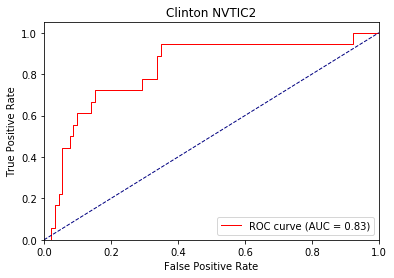

Directory already exists!
hc_nvtic3 0 ap tensor([1., 0.]) loss : 0.6031507253646851 0.7333899906703404 tid : 200 tg tensor([[0]], device='cuda:0')
hc_nvtic3 0 ap tensor([1., 0.]) loss : 0.5366264581680298 0.664618467092514 tid : 400 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic3 0 ap tensor([0.9881, 0.0278]) loss : 0.3204570710659027 0.3337714488689716 tid : 300 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic3 0 ap tensor([0.9926, 0.0227]) loss : 0.24404305219650269 0.32282255070932797 tid : 420 tg tensor([[0]], device='cuda:0')


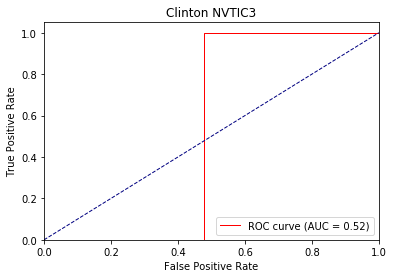

Directory already exists!
hc_nvtic3 1 ap tensor([0.9931, 0.0046]) loss : 0.14422684907913208 0.24921574914592437 tid : 200 tg tensor([[0]], device='cuda:0')
hc_nvtic3 1 ap tensor([0.9969, 0.0038]) loss : 0.12065625190734863 0.22376919730945868 tid : 400 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic3 1 ap tensor([0.9864, 0.0256]) loss : 0.14008361101150513 0.1811771713770353 tid : 300 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic3 1 ap tensor([0.9913, 0.0204]) loss : 0.08776795864105225 0.16516584090972214 tid : 420 tg tensor([[0]], device='cuda:0')


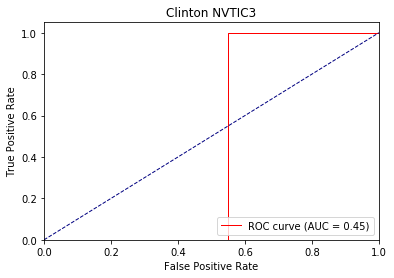

Directory already exists!
hc_nvtic3 2 ap tensor([1., 0.]) loss : 0.0722815990447998 0.13097263193130493 tid : 200 tg tensor([[0]], device='cuda:0')
hc_nvtic3 2 ap tensor([0.9986, 0.0074]) loss : 0.050223469734191895 0.10915255836907635 tid : 400 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic3 2 ap tensor([0.9819, 0.0217]) loss : 0.06176471710205078 0.12370687493911156 tid : 300 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic3 2 ap tensor([0.9888, 0.0175]) loss : 0.03490495681762695 0.10524109407757105 tid : 420 tg tensor([[0]], device='cuda:0')


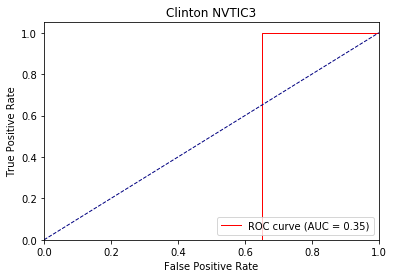

Directory already exists!
hc_nvtic5 0 ap tensor([1., 0.]) loss : 0.6710996627807617 0.5786897011778571 tid : 400 tg tensor([[0]], device='cuda:0')
hc_nvtic5 0 ap tensor([1., 0.]) loss : 0.34731602668762207 0.43079673764137294 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic5 0 ap tensor([1., 0.]) loss : 0.18963807821273804 0.28002417179254385 tid : 300 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic5 0 ap tensor([1., 0.]) loss : 0.18048745393753052 0.2688411648353834 tid : 420 tg tensor([[0]], device='cuda:0')


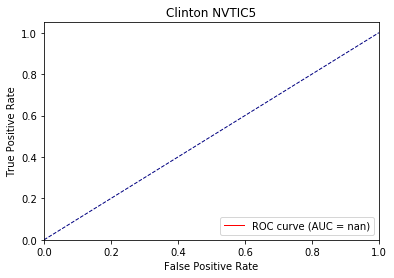

Directory already exists!
hc_nvtic5 1 ap tensor([1., 0.]) loss : 0.2054927945137024 0.2199981778324721 tid : 400 tg tensor([[0]], device='cuda:0')
hc_nvtic5 1 ap tensor([1., 0.]) loss : 0.18574875593185425 0.21702186260904585 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic5 1 ap tensor([1., 0.]) loss : 0.0824812650680542 0.1394826196707212 tid : 300 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic5 1 ap tensor([1., 0.]) loss : 0.0768582820892334 0.13027845239371397 tid : 420 tg tensor([[0]], device='cuda:0')


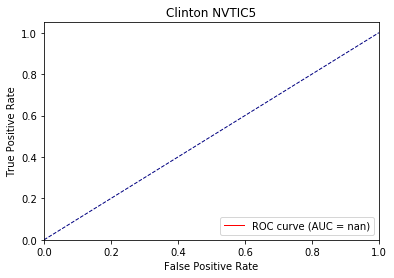

Directory already exists!
hc_nvtic5 2 ap tensor([1., 0.]) loss : 0.10001087188720703 0.11928757671582496 tid : 400 tg tensor([[0]], device='cuda:0')
hc_nvtic5 2 ap tensor([1., 0.]) loss : 0.04737412929534912 0.08879943338274224 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic5 2 ap tensor([1., 0.]) loss : 0.0367894172668457 0.07526783576378455 tid : 300 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic5 2 ap tensor([1., 0.]) loss : 0.03673505783081055 0.068243896023611 tid : 420 tg tensor([[0]], device='cuda:0')


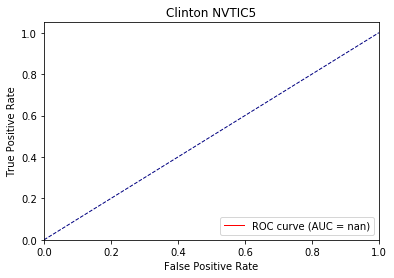

Directory already exists!
hc_nvtic4 0 ap tensor([0.9957, 0.0159]) loss : 0.4952978491783142 0.6264132132633127 tid : 400 tg tensor([[0]], device='cuda:0')
hc_nvtic4 0 ap tensor([0.9907, 0.0150]) loss : 0.49029266834259033 0.6098812630215844 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic4 0 ap tensor([0.9432, 0.0283]) loss : 0.4570719301700592 0.3667467869245089 tid : 300 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic4 0 ap tensor([0.9602, 0.0207]) loss : 0.26098132133483887 0.35069737909884935 tid : 420 tg tensor([[0]], device='cuda:0')


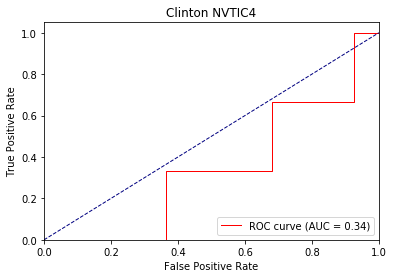

Directory already exists!
hc_nvtic4 1 ap tensor([0.9941, 0.0130]) loss : 0.22308671474456787 0.2813797836756184 tid : 200 tg tensor([[0]], device='cuda:0')
hc_nvtic4 1 ap tensor([0.9989, 0.0086]) loss : 0.14295482635498047 0.22914378555527684 tid : 400 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic4 1 ap tensor([0.9554, 0.0295]) loss : 0.23000633716583252 0.2323383134145003 tid : 300 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic4 1 ap tensor([0.9681, 0.0219]) loss : 0.10987651348114014 0.20784736851627908 tid : 420 tg tensor([[0]], device='cuda:0')


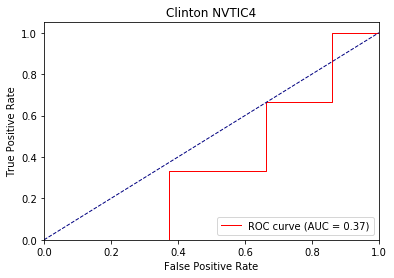

Directory already exists!
hc_nvtic4 2 ap tensor([0.9861, 0.0270]) loss : 0.08137404918670654 0.14967682400370033 tid : 400 tg tensor([[0]], device='cuda:0')
hc_nvtic4 2 ap tensor([0.9937, 0.0230]) loss : 0.06434166431427002 0.1335365267699225 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic4 2 ap tensor([0.9628, 0.0318]) loss : 0.11816686391830444 0.18109357219475966 tid : 300 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic4 2 ap tensor([0.9736, 0.0238]) loss : 0.057454824447631836 0.15177806341246272 tid : 420 tg tensor([[0]], device='cuda:0')


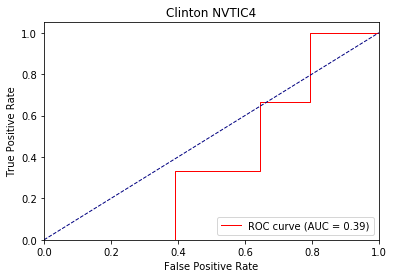

Directory already exists!
hc_interruptions 0 ap tensor([0.9901, 0.0133]) loss : 0.5429099798202515 0.647581586698154 tid : 400 tg tensor([[0]], device='cuda:0')
hc_interruptions 0 ap tensor([0.9875, 0.0241]) loss : 0.3383910655975342 0.5070064931343763 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_interruptions 0 ap tensor([0.9943, 0.0476]) loss : 0.3560933470726013 0.34868307526295 tid : 300 tg tensor([[0]], device='cuda:0')
TEST hc_interruptions 0 ap tensor([0.9752, 0.0425]) loss : 0.2213752269744873 0.36256255628017897 tid : 420 tg tensor([[0]], device='cuda:0')


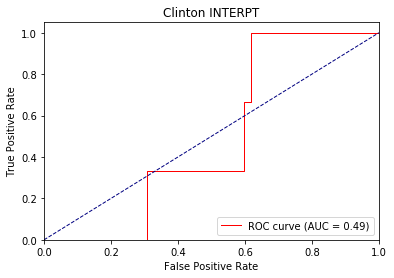

Directory already exists!
hc_interruptions 1 ap tensor([0.9960, 0.1618]) loss : 0.17152827978134155 0.2537601146734122 tid : 400 tg tensor([[0]], device='cuda:0')
hc_interruptions 1 ap tensor([0.9971, 0.1489]) loss : 0.14034593105316162 0.24175322298481872 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_interruptions 1 ap tensor([0.9956, 0.0588]) loss : 0.15574359893798828 0.1994843079493596 tid : 300 tg tensor([[0]], device='cuda:0')
TEST hc_interruptions 1 ap tensor([0.9709, 0.0433]) loss : 0.08653616905212402 0.22951426064030508 tid : 420 tg tensor([[0]], device='cuda:0')


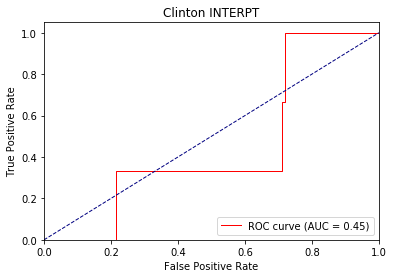

Directory already exists!
hc_interruptions 2 ap tensor([0.9969, 0.0792]) loss : 0.08144521713256836 0.14001121268736735 tid : 200 tg tensor([[0]], device='cuda:0')
hc_interruptions 2 ap tensor([0.9970, 0.0662]) loss : 0.08371162414550781 0.14191114836268956 tid : 400 tg tensor([[0]], device='cuda:0')
TEST hc_interruptions 2 ap tensor([0.9956, 0.0588]) loss : 0.07758307456970215 0.13965845520679768 tid : 300 tg tensor([[0]], device='cuda:0')
TEST hc_interruptions 2 ap tensor([0.9708, 0.0448]) loss : 0.04237377643585205 0.1845180429099651 tid : 420 tg tensor([[0]], device='cuda:0')


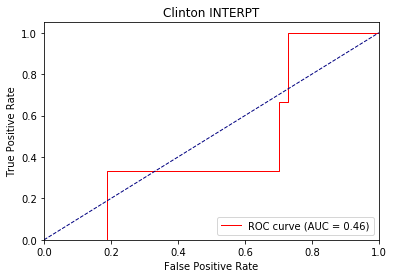

Directory already exists!
hc_lookat2 0 ap tensor([0.7980, 0.9621]) loss : 0.5535122156143188 0.590008709918369 tid : 400 tg tensor([[0]], device='cuda:0')
hc_lookat2 0 ap tensor([0.8920, 0.9435]) loss : 0.5484682321548462 0.5037549829767617 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_lookat2 0 ap tensor([0.9866, 0.9543]) loss : 0.2737770676612854 0.41603360398142947 tid : 240 tg tensor([[0]], device='cuda:0')
TEST hc_lookat2 0 ap tensor([0.9852, 0.9478]) loss : 0.4596880376338959 0.42016697647394957 tid : 270 tg tensor([[0]], device='cuda:0')
TEST hc_lookat2 0 ap tensor([0.9809, 0.9219]) loss : 0.3796464800834656 0.4362308820709586 tid : 330 tg tensor([[0]], device='cuda:0')
TEST hc_lookat2 0 ap tensor([0.9707, 0.8935]) loss : 0.6849321126937866 0.470122284591198 tid : 480 tg tensor([[0]], device='cuda:0')


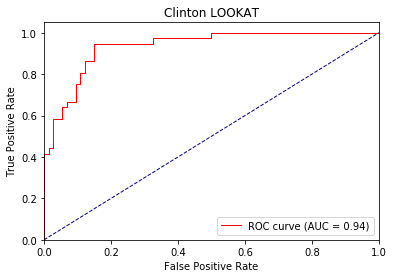

Directory already exists!
hc_lookat2 1 ap tensor([0.9600, 0.9585]) loss : 0.34627407789230347 0.41403827453972003 tid : 400 tg tensor([[0]], device='cuda:0')
hc_lookat2 1 ap tensor([0.9274, 0.9589]) loss : 0.41642919182777405 0.38165723460691947 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_lookat2 1 ap tensor([0.9796, 0.9519]) loss : 0.1624048948287964 0.3234141515750511 tid : 240 tg tensor([[0]], device='cuda:0')
TEST hc_lookat2 1 ap tensor([0.9787, 0.9463]) loss : 0.3361142873764038 0.3266277705077772 tid : 270 tg tensor([[0]], device='cuda:0')
TEST hc_lookat2 1 ap tensor([0.9765, 0.9270]) loss : 0.26442641019821167 0.3461957033723593 tid : 330 tg tensor([[0]], device='cuda:0')
TEST hc_lookat2 1 ap tensor([0.9690, 0.8997]) loss : 0.6889291405677795 0.39323241263628006 tid : 480 tg tensor([[0]], device='cuda:0')


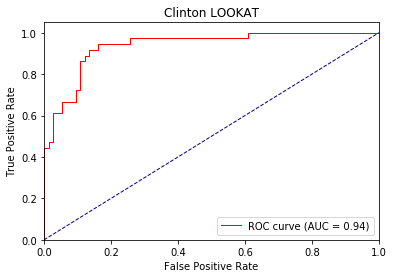

Directory already exists!
hc_lookat2 2 ap tensor([0.9611, 0.9537]) loss : 0.3797907829284668 0.3509077363270373 tid : 200 tg tensor([[0]], device='cuda:0')
hc_lookat2 2 ap tensor([0.9249, 0.9598]) loss : 0.20288392901420593 0.333559894950878 tid : 400 tg tensor([[0]], device='cuda:0')
TEST hc_lookat2 2 ap tensor([0.9767, 0.9488]) loss : 0.1087232232093811 0.27265864610671997 tid : 240 tg tensor([[0]], device='cuda:0')
TEST hc_lookat2 2 ap tensor([0.9760, 0.9431]) loss : 0.24799299240112305 0.2746059861448076 tid : 270 tg tensor([[0]], device='cuda:0')
TEST hc_lookat2 2 ap tensor([0.9748, 0.9293]) loss : 0.1944301724433899 0.29530781600624323 tid : 330 tg tensor([[0]], device='cuda:0')
TEST hc_lookat2 2 ap tensor([0.9678, 0.8984]) loss : 0.7000207304954529 0.35163911879062654 tid : 480 tg tensor([[0]], device='cuda:0')


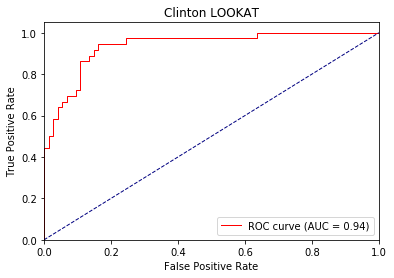

Directory already exists!
hc_brush1 0 ap tensor([0.9390, 0.2261]) loss : 0.5019760131835938 0.6836932114085311 tid : 400 tg tensor([[0]], device='cuda:0')
hc_brush1 0 ap tensor([0.9313, 0.1937]) loss : 0.46006500720977783 0.6146329761046783 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_brush1 0 ap tensor([0.9463, 0.2458]) loss : 0.24293524026870728 0.4353649774018456 tid : 240 tg tensor([[0]], device='cuda:0')
TEST hc_brush1 0 ap tensor([0.9484, 0.2427]) loss : 0.4227108657360077 0.43128781738104643 tid : 270 tg tensor([[0]], device='cuda:0')
TEST hc_brush1 0 ap tensor([0.9479, 0.3577]) loss : 0.33879661560058594 0.44970914954319596 tid : 330 tg tensor([[0]], device='cuda:0')
TEST hc_brush1 0 ap tensor([0.9457, 0.4187]) loss : 0.49621233344078064 0.47592234969139097 tid : 480 tg tensor([[0]], device='cuda:0')


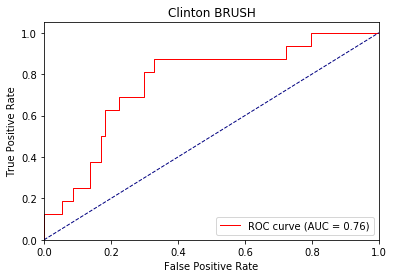

Directory already exists!
hc_brush1 1 ap tensor([0.9413, 0.2348]) loss : 0.352921724319458 0.47168356134341316 tid : 200 tg tensor([[0]], device='cuda:0')
hc_brush1 1 ap tensor([0.9490, 0.2324]) loss : 0.26154273748397827 0.462055079638958 tid : 400 tg tensor([[0]], device='cuda:0')
TEST hc_brush1 1 ap tensor([0.9482, 0.2844]) loss : 0.14579886198043823 0.3503252536642785 tid : 240 tg tensor([[0]], device='cuda:0')
TEST hc_brush1 1 ap tensor([0.9502, 0.2812]) loss : 0.2304445505142212 0.3425209301489371 tid : 270 tg tensor([[0]], device='cuda:0')
TEST hc_brush1 1 ap tensor([0.9466, 0.3566]) loss : 0.19595998525619507 0.3750351029448211 tid : 330 tg tensor([[0]], device='cuda:0')
TEST hc_brush1 1 ap tensor([0.9464, 0.3813]) loss : 0.32560622692108154 0.4036925208568573 tid : 480 tg tensor([[0]], device='cuda:0')


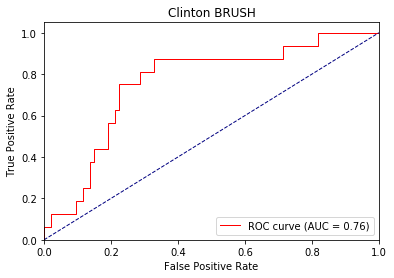

Directory already exists!
hc_brush1 2 ap tensor([0.9545, 0.3460]) loss : 0.2293725609779358 0.39752101726256883 tid : 200 tg tensor([[0]], device='cuda:0')
hc_brush1 2 ap tensor([0.9627, 0.3017]) loss : 0.12433958053588867 0.361225460731932 tid : 400 tg tensor([[0]], device='cuda:0')
TEST hc_brush1 2 ap tensor([0.9440, 0.3340]) loss : 0.09619170427322388 0.32182974791994284 tid : 240 tg tensor([[0]], device='cuda:0')
TEST hc_brush1 2 ap tensor([0.9460, 0.3310]) loss : 0.13998883962631226 0.3115216615023436 tid : 270 tg tensor([[0]], device='cuda:0')
TEST hc_brush1 2 ap tensor([0.9424, 0.3750]) loss : 0.12800461053848267 0.3530733799561858 tid : 330 tg tensor([[0]], device='cuda:0')
TEST hc_brush1 2 ap tensor([0.9434, 0.3803]) loss : 0.2544814944267273 0.38181933522224426 tid : 480 tg tensor([[0]], device='cuda:0')


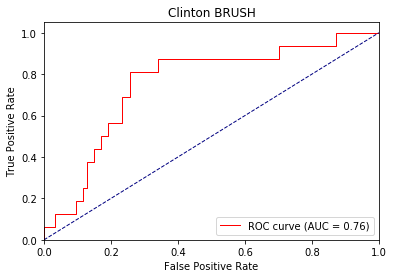

Directory already exists!
hc_nvdis1 0 ap tensor([0.9475, 0.5015]) loss : 0.4225665330886841 0.5427698224782944 tid : 400 tg tensor([[0]], device='cuda:0')
hc_nvdis1 0 ap tensor([0.9664, 0.4411]) loss : 0.28185558319091797 0.44939151787644877 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_nvdis1 0 ap tensor([0.8672, 0.3220]) loss : 0.25867223739624023 0.5756544248730529 tid : 240 tg tensor([[0]], device='cuda:0')
TEST hc_nvdis1 0 ap tensor([0.8666, 0.3041]) loss : 0.2598382234573364 0.5581348913687246 tid : 270 tg tensor([[0]], device='cuda:0')
TEST hc_nvdis1 0 ap tensor([0.8878, 0.2668]) loss : 0.23676490783691406 0.5110833295620978 tid : 330 tg tensor([[0]], device='cuda:0')
TEST hc_nvdis1 0 ap tensor([0.8460, 0.3555]) loss : 0.317333459854126 0.5519345059990883 tid : 480 tg tensor([[0]], device='cuda:0')


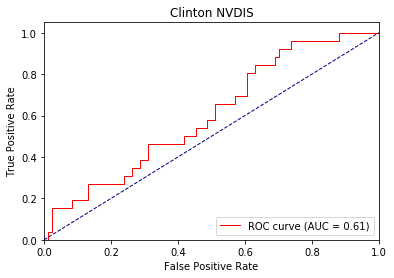

Directory already exists!
hc_nvdis1 1 ap tensor([0.9823, 0.6081]) loss : 0.21711933612823486 0.3240812970718867 tid : 400 tg tensor([[0]], device='cuda:0')
hc_nvdis1 1 ap tensor([0.9619, 0.5494]) loss : 0.20964491367340088 0.3374902521550414 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_nvdis1 1 ap tensor([0.8664, 0.3269]) loss : 0.14445030689239502 0.6236604884559033 tid : 240 tg tensor([[0]], device='cuda:0')
TEST hc_nvdis1 1 ap tensor([0.8678, 0.3110]) loss : 0.1456012725830078 0.5974548205181405 tid : 270 tg tensor([[0]], device='cuda:0')
TEST hc_nvdis1 1 ap tensor([0.8824, 0.2645]) loss : 0.1281270980834961 0.5281287468969822 tid : 330 tg tensor([[0]], device='cuda:0')
TEST hc_nvdis1 1 ap tensor([0.8532, 0.3781]) loss : 0.2016749382019043 0.5760254538059235 tid : 480 tg tensor([[0]], device='cuda:0')


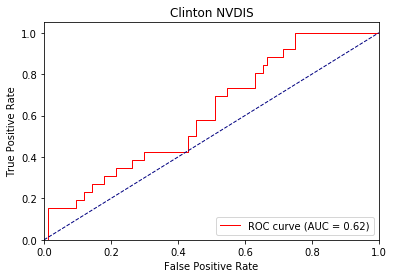

Directory already exists!
hc_nvdis1 2 ap tensor([0.9779, 0.5356]) loss : 0.13505327701568604 0.2734867973177957 tid : 200 tg tensor([[0]], device='cuda:0')
hc_nvdis1 2 ap tensor([0.9706, 0.4515]) loss : 0.09285449981689453 0.2773366527139964 tid : 400 tg tensor([[0]], device='cuda:0')
TEST hc_nvdis1 2 ap tensor([0.8348, 0.3085]) loss : 0.09118545055389404 0.689765214920044 tid : 240 tg tensor([[0]], device='cuda:0')
TEST hc_nvdis1 2 ap tensor([0.8380, 0.2945]) loss : 0.09172439575195312 0.6569226251708137 tid : 270 tg tensor([[0]], device='cuda:0')
TEST hc_nvdis1 2 ap tensor([0.8536, 0.2496]) loss : 0.07851362228393555 0.5709050642326474 tid : 330 tg tensor([[0]], device='cuda:0')
TEST hc_nvdis1 2 ap tensor([0.8363, 0.3846]) loss : 0.14880192279815674 0.6165593791007996 tid : 480 tg tensor([[0]], device='cuda:0')


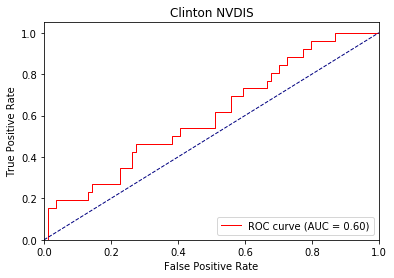

Directory already exists!
hc_look 0 ap tensor([0.3810, 0.8528]) loss : 0.4440019130706787 0.6284163906689613 tid : 200 tg tensor([[1]], device='cuda:0')
hc_look 0 ap tensor([0.4072, 0.8630]) loss : 0.3939017355442047 0.6234869015389595 tid : 400 tg tensor([[1]], device='cuda:0')
TEST hc_look 0 ap tensor([0.6105, 0.9851]) loss : 0.3688112199306488 0.46057529367652594 tid : 240 tg tensor([[1]], device='cuda:0')
TEST hc_look 0 ap tensor([0.6105, 0.9869]) loss : 0.3125615119934082 0.4552057059826674 tid : 270 tg tensor([[1]], device='cuda:0')
TEST hc_look 0 ap tensor([0.6066, 0.9758]) loss : 0.37017226219177246 0.4693053592927754 tid : 330 tg tensor([[1]], device='cuda:0')
TEST hc_look 0 ap tensor([0.5137, 0.9654]) loss : 0.9487882256507874 0.5006949296593666 tid : 480 tg tensor([[0]], device='cuda:0')


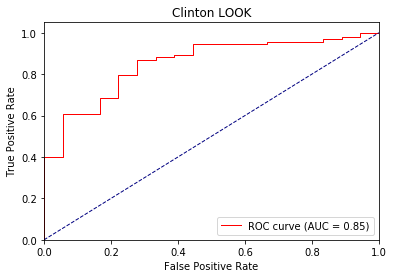

Directory already exists!
hc_look 1 ap tensor([0.7636, 0.9428]) loss : 0.3426598310470581 0.5190729713717173 tid : 200 tg tensor([[1]], device='cuda:0')
hc_look 1 ap tensor([0.7755, 0.9444]) loss : 0.26810842752456665 0.5188039176770158 tid : 400 tg tensor([[1]], device='cuda:0')
TEST hc_look 1 ap tensor([0.6167, 0.9864]) loss : 0.17529791593551636 0.35891914133932074 tid : 240 tg tensor([[1]], device='cuda:0')
TEST hc_look 1 ap tensor([0.6134, 0.9875]) loss : 0.1970720887184143 0.35280506699173536 tid : 270 tg tensor([[1]], device='cuda:0')
TEST hc_look 1 ap tensor([0.6084, 0.9762]) loss : 0.2144642472267151 0.37236683163791895 tid : 330 tg tensor([[1]], device='cuda:0')
TEST hc_look 1 ap tensor([0.5463, 0.9689]) loss : 1.1314914226531982 0.41638101518154147 tid : 480 tg tensor([[0]], device='cuda:0')


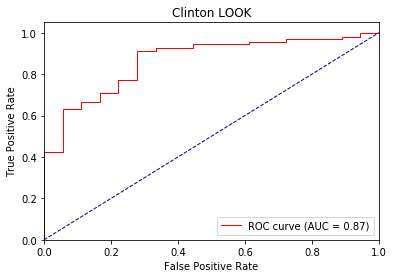

Directory already exists!
hc_look 2 ap tensor([0.8652, 0.9810]) loss : 0.1369418501853943 0.392333687937006 tid : 400 tg tensor([[1]], device='cuda:0')
hc_look 2 ap tensor([0.8144, 0.9640]) loss : 0.17484796047210693 0.4029960770415358 tid : 200 tg tensor([[1]], device='cuda:0')
TEST hc_look 2 ap tensor([0.6167, 0.9864]) loss : 0.09579503536224365 0.30566107993032415 tid : 240 tg tensor([[1]], device='cuda:0')
TEST hc_look 2 ap tensor([0.6134, 0.9875]) loss : 0.13483881950378418 0.2987731827629937 tid : 270 tg tensor([[1]], device='cuda:0')
TEST hc_look 2 ap tensor([0.6136, 0.9798]) loss : 0.13312530517578125 0.3220296995714307 tid : 330 tg tensor([[1]], device='cuda:0')
TEST hc_look 2 ap tensor([0.5675, 0.9719]) loss : 1.235236644744873 0.37369600892066956 tid : 480 tg tensor([[0]], device='cuda:0')


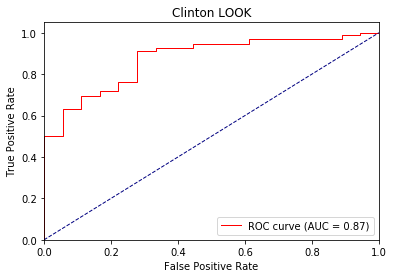

Directory already exists!
hc_eyebrow 0 ap tensor([0.8497, 0.6590]) loss : 0.8227600455284119 0.6643653850027379 tid : 400 tg tensor([[0]], device='cuda:0')
hc_eyebrow 0 ap tensor([0.8667, 0.6523]) loss : 0.631694495677948 0.6507693627183302 tid : 200 tg tensor([[1]], device='cuda:0')
TEST hc_eyebrow 0 ap tensor([0.8342, 0.5144]) loss : 0.5993325710296631 0.6582199972049863 tid : 240 tg tensor([[1]], device='cuda:0')
TEST hc_eyebrow 0 ap tensor([0.8342, 0.5620]) loss : 0.9174567461013794 0.6592214560067212 tid : 270 tg tensor([[0]], device='cuda:0')
TEST hc_eyebrow 0 ap tensor([0.8484, 0.5595]) loss : 0.8078961372375488 0.655856809578836 tid : 330 tg tensor([[0]], device='cuda:0')
TEST hc_eyebrow 0 ap tensor([0.9014, 0.4962]) loss : 0.508953869342804 0.6390284499526024 tid : 480 tg tensor([[0]], device='cuda:0')


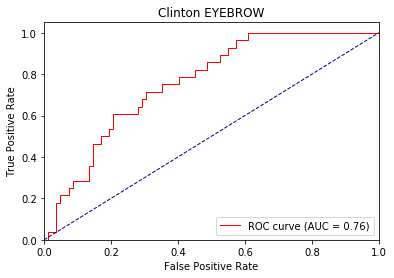

Directory already exists!
hc_eyebrow 1 ap tensor([0.9449, 0.7663]) loss : 0.8248112201690674 0.5263073259204097 tid : 400 tg tensor([[0]], device='cuda:0')
hc_eyebrow 1 ap tensor([0.9383, 0.7581]) loss : 0.6393709182739258 0.5149490011663272 tid : 200 tg tensor([[1]], device='cuda:0')
TEST hc_eyebrow 1 ap tensor([0.8529, 0.5522]) loss : 0.4943089783191681 0.6210461410821653 tid : 240 tg tensor([[1]], device='cuda:0')
TEST hc_eyebrow 1 ap tensor([0.8538, 0.5997]) loss : 0.9662061929702759 0.6226994417331837 tid : 270 tg tensor([[0]], device='cuda:0')
TEST hc_eyebrow 1 ap tensor([0.8643, 0.5900]) loss : 0.8134227991104126 0.6150047522969544 tid : 330 tg tensor([[0]], device='cuda:0')
TEST hc_eyebrow 1 ap tensor([0.9116, 0.5254]) loss : 0.3952252268791199 0.5852109593153 tid : 480 tg tensor([[0]], device='cuda:0')


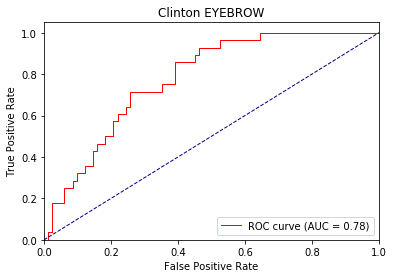

Directory already exists!
hc_eyebrow 2 ap tensor([0.9409, 0.8022]) loss : 0.9407792687416077 0.4502191427724524 tid : 400 tg tensor([[0]], device='cuda:0')
hc_eyebrow 2 ap tensor([0.9441, 0.8075]) loss : 0.6652200818061829 0.4444877189769448 tid : 200 tg tensor([[1]], device='cuda:0')
TEST hc_eyebrow 2 ap tensor([0.8575, 0.6060]) loss : 0.4087492525577545 0.6091975172360738 tid : 240 tg tensor([[1]], device='cuda:0')
TEST hc_eyebrow 2 ap tensor([0.8606, 0.6387]) loss : 1.0443058013916016 0.611402138515755 tid : 270 tg tensor([[0]], device='cuda:0')
TEST hc_eyebrow 2 ap tensor([0.8717, 0.6273]) loss : 0.8206679821014404 0.6001978390850127 tid : 330 tg tensor([[0]], device='cuda:0')
TEST hc_eyebrow 2 ap tensor([0.9157, 0.5469]) loss : 0.32310763001441956 0.5627092853188514 tid : 480 tg tensor([[0]], device='cuda:0')


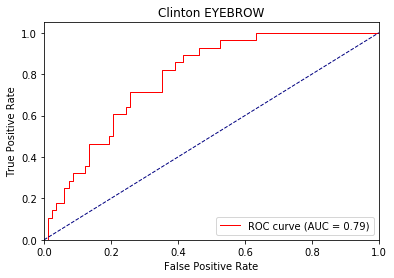

Directory already exists!
hc_atface 0 ap tensor([0.8970, 0.1204]) loss : 0.6489676237106323 0.6386161267757415 tid : 400 tg tensor([[0]], device='cuda:0')
hc_atface 0 ap tensor([0.9200, 0.1248]) loss : 1.0626177787780762 0.551740191441631 tid : 200 tg tensor([[1]], device='cuda:0')
TEST hc_atface 0 ap tensor([0.9188, 0.4181]) loss : 1.0946123600006104 0.5278795975096086 tid : 240 tg tensor([[1]], device='cuda:0')
TEST hc_atface 0 ap tensor([0.9178, 0.4402]) loss : 0.5335310101509094 0.5300450148405852 tid : 270 tg tensor([[0]], device='cuda:0')
TEST hc_atface 0 ap tensor([0.9192, 0.4486]) loss : 0.3656957745552063 0.5335115394555032 tid : 330 tg tensor([[0]], device='cuda:0')
TEST hc_atface 0 ap tensor([0.9521, 0.3571]) loss : 0.3495241701602936 0.4889060494303703 tid : 480 tg tensor([[0]], device='cuda:0')


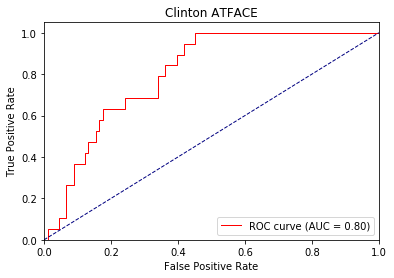

Directory already exists!
hc_atface 1 ap tensor([0.9617, 0.3119]) loss : 1.2368661165237427 0.42083974098259547 tid : 200 tg tensor([[1]], device='cuda:0')
hc_atface 1 ap tensor([0.9621, 0.2582]) loss : 0.42759978771209717 0.4148374300206726 tid : 400 tg tensor([[0]], device='cuda:0')
TEST hc_atface 1 ap tensor([0.9250, 0.4223]) loss : 1.2488160133361816 0.47953393646315035 tid : 240 tg tensor([[1]], device='cuda:0')
TEST hc_atface 1 ap tensor([0.9259, 0.4512]) loss : 0.44603073596954346 0.4823562933339013 tid : 270 tg tensor([[0]], device='cuda:0')
TEST hc_atface 1 ap tensor([0.9160, 0.4403]) loss : 0.26075279712677 0.4941037427634001 tid : 330 tg tensor([[0]], device='cuda:0')
TEST hc_atface 1 ap tensor([0.9457, 0.3519]) loss : 0.23927485942840576 0.4330276709794998 tid : 480 tg tensor([[0]], device='cuda:0')


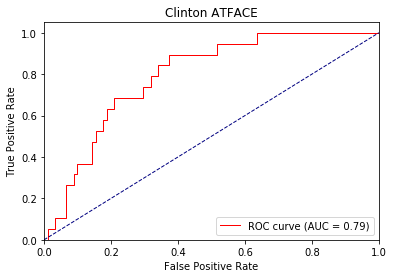

Directory already exists!
hc_atface 2 ap tensor([0.9624, 0.1978]) loss : 0.352597177028656 0.3491510711775886 tid : 400 tg tensor([[0]], device='cuda:0')
hc_atface 2 ap tensor([0.9640, 0.2212]) loss : 1.4618724584579468 0.35454906155186966 tid : 200 tg tensor([[1]], device='cuda:0')
TEST hc_atface 2 ap tensor([0.9309, 0.4486]) loss : 1.3373587131500244 0.4587901515119216 tid : 240 tg tensor([[1]], device='cuda:0')
TEST hc_atface 2 ap tensor([0.9314, 0.4746]) loss : 0.4065648913383484 0.46176090174251133 tid : 270 tg tensor([[0]], device='cuda:0')
TEST hc_atface 2 ap tensor([0.9147, 0.4526]) loss : 0.20654308795928955 0.47889571264386177 tid : 330 tg tensor([[0]], device='cuda:0')
TEST hc_atface 2 ap tensor([0.9463, 0.3915]) loss : 0.18173009157180786 0.4093901860713959 tid : 480 tg tensor([[0]], device='cuda:0')


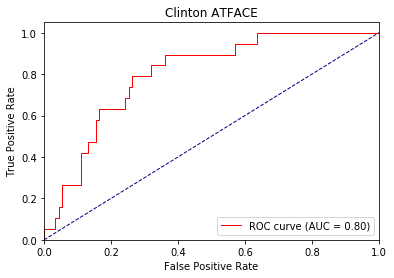

Directory already exists!
hc_feface 0 ap tensor([1., 0.]) loss : 0.563979983329773 0.6379569423371467 tid : 400 tg tensor([[0]], device='cuda:0')
hc_feface 0 ap tensor([1., 0.]) loss : 0.5003558397293091 0.6179554857313633 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_feface 0 ap tensor([1., 0.]) loss : 0.4155310392379761 0.3270780286368202 tid : 240 tg tensor([[0]], device='cuda:0')
TEST hc_feface 0 ap tensor([1., 0.]) loss : 0.26249587535858154 0.3242097281747394 tid : 270 tg tensor([[0]], device='cuda:0')
TEST hc_feface 0 ap tensor([1., 0.]) loss : 0.2842748165130615 0.31742891017347574 tid : 330 tg tensor([[0]], device='cuda:0')
TEST hc_feface 0 ap tensor([1., 0.]) loss : 0.2747621536254883 0.3213052412867546 tid : 480 tg tensor([[0]], device='cuda:0')


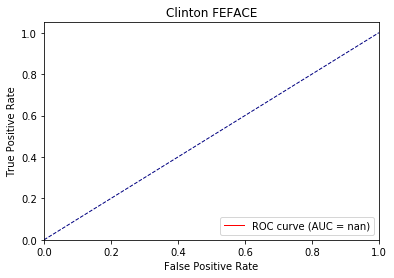

Directory already exists!
hc_feface 1 ap tensor([1., 0.]) loss : 0.22545278072357178 0.26793979686849256 tid : 400 tg tensor([[0]], device='cuda:0')
hc_feface 1 ap tensor([1., 0.]) loss : 0.14333152770996094 0.23721814762662957 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_feface 1 ap tensor([1., 0.]) loss : 0.2157498002052307 0.15717647297709597 tid : 240 tg tensor([[0]], device='cuda:0')
TEST hc_feface 1 ap tensor([1., 0.]) loss : 0.11727398633956909 0.15570148660076988 tid : 270 tg tensor([[0]], device='cuda:0')
TEST hc_feface 1 ap tensor([1., 0.]) loss : 0.12236708402633667 0.15045855334028602 tid : 330 tg tensor([[0]], device='cuda:0')
TEST hc_feface 1 ap tensor([1., 0.]) loss : 0.12081748247146606 0.15370366334915161 tid : 480 tg tensor([[0]], device='cuda:0')


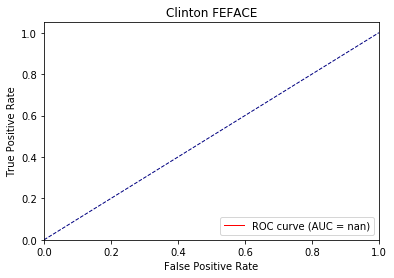

Directory already exists!
hc_feface 2 ap tensor([1., 0.]) loss : 0.09555268287658691 0.12565681163002462 tid : 200 tg tensor([[0]], device='cuda:0')
hc_feface 2 ap tensor([1., 0.]) loss : 0.07141005992889404 0.11977701610134493 tid : 400 tg tensor([[0]], device='cuda:0')
TEST hc_feface 2 ap tensor([1., 0.]) loss : 0.11805534362792969 0.07838365377164354 tid : 240 tg tensor([[0]], device='cuda:0')
TEST hc_feface 2 ap tensor([1., 0.]) loss : 0.05154430866241455 0.07739851651368318 tid : 270 tg tensor([[0]], device='cuda:0')
TEST hc_feface 2 ap tensor([1., 0.]) loss : 0.0544666051864624 0.0737791508436203 tid : 330 tg tensor([[0]], device='cuda:0')
TEST hc_feface 2 ap tensor([1., 0.]) loss : 0.05253612995147705 0.07659681260585785 tid : 480 tg tensor([[0]], device='cuda:0')


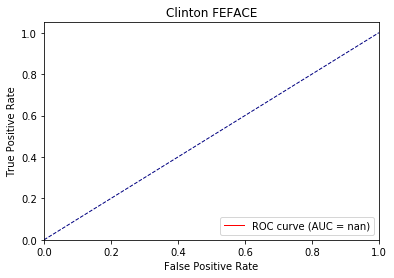

Directory already exists!
hc_hrface 0 ap tensor([0.4407, 0.4959]) loss : 0.5705424547195435 0.7047075547475731 tid : 400 tg tensor([[0]], device='cuda:0')
hc_hrface 0 ap tensor([0.4607, 0.5203]) loss : 0.537893533706665 0.7003923877848599 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_hrface 0 ap tensor([0.8155, 0.3988]) loss : 0.6512681245803833 0.6570075084181393 tid : 240 tg tensor([[0]], device='cuda:0')
TEST hc_hrface 0 ap tensor([0.8224, 0.3746]) loss : 0.5992356538772583 0.6570524794084055 tid : 270 tg tensor([[0]], device='cuda:0')
TEST hc_hrface 0 ap tensor([0.8318, 0.3409]) loss : 0.6544264554977417 0.6598066352307796 tid : 330 tg tensor([[0]], device='cuda:0')
TEST hc_hrface 0 ap tensor([0.7368, 0.4231]) loss : 0.5594080686569214 0.6685114386677742 tid : 480 tg tensor([[0]], device='cuda:0')


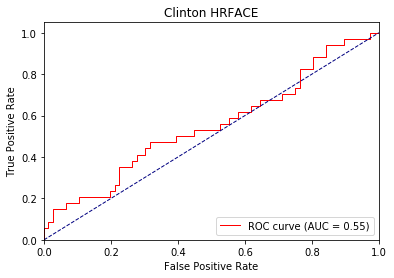

Directory already exists!
hc_hrface 1 ap tensor([0.6694, 0.7680]) loss : 0.5186600685119629 0.6565329119049269 tid : 400 tg tensor([[0]], device='cuda:0')
hc_hrface 1 ap tensor([0.7194, 0.7697]) loss : 0.47021621465682983 0.6502558024136168 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_hrface 1 ap tensor([0.8407, 0.4367]) loss : 0.5668426752090454 0.6250396546195535 tid : 240 tg tensor([[0]], device='cuda:0')
TEST hc_hrface 1 ap tensor([0.8457, 0.4186]) loss : 0.517123818397522 0.6232749753528171 tid : 270 tg tensor([[0]], device='cuda:0')
TEST hc_hrface 1 ap tensor([0.8562, 0.3966]) loss : 0.6101125478744507 0.6259111044928432 tid : 330 tg tensor([[0]], device='cuda:0')
TEST hc_hrface 1 ap tensor([0.8164, 0.5449]) loss : 0.614058256149292 0.637894546687603 tid : 480 tg tensor([[0]], device='cuda:0')


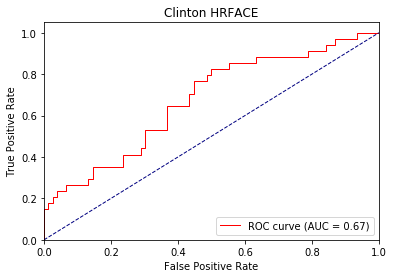

Directory already exists!
hc_hrface 2 ap tensor([0.8212, 0.8806]) loss : 0.46128350496292114 0.60472086252092 tid : 400 tg tensor([[0]], device='cuda:0')
hc_hrface 2 ap tensor([0.8056, 0.8565]) loss : 0.45488131046295166 0.6108633809025512 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_hrface 2 ap tensor([0.8635, 0.5150]) loss : 0.5021647214889526 0.5962981704403373 tid : 240 tg tensor([[0]], device='cuda:0')
TEST hc_hrface 2 ap tensor([0.8718, 0.5065]) loss : 0.4474097490310669 0.592826685971684 tid : 270 tg tensor([[0]], device='cuda:0')
TEST hc_hrface 2 ap tensor([0.8786, 0.4848]) loss : 0.5682713985443115 0.5941004571504891 tid : 330 tg tensor([[0]], device='cuda:0')
TEST hc_hrface 2 ap tensor([0.8455, 0.6167]) loss : 0.6558127403259277 0.6097868010401726 tid : 480 tg tensor([[0]], device='cuda:0')


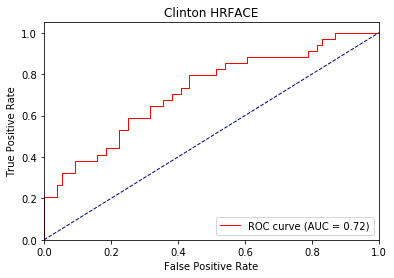

Directory already exists!
hc_saface 0 ap tensor([0.9902, 0.1000]) loss : 0.6998931169509888 0.6239526994300612 tid : 200 tg tensor([[0]], device='cuda:0')
hc_saface 0 ap tensor([0.9863, 0.0293]) loss : 0.31983256340026855 0.45895176694476253 tid : 400 tg tensor([[0]], device='cuda:0')
TEST hc_saface 0 ap tensor([1., 0.]) loss : 0.338437020778656 0.33304182513087405 tid : 240 tg tensor([[0]], device='cuda:0')
TEST hc_saface 0 ap tensor([1., 0.]) loss : 0.4082256853580475 0.3368717630704244 tid : 270 tg tensor([[0]], device='cuda:0')
TEST hc_saface 0 ap tensor([1., 0.]) loss : 0.37408196926116943 0.3342287805862725 tid : 330 tg tensor([[0]], device='cuda:0')
TEST hc_saface 0 ap tensor([1., 0.]) loss : 0.26237010955810547 0.32166316628456115 tid : 480 tg tensor([[0]], device='cuda:0')


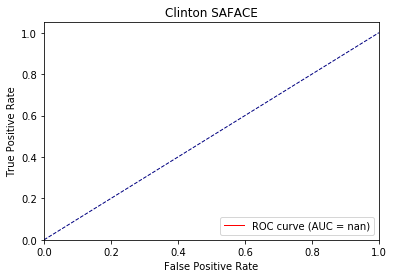

Directory already exists!
hc_saface 1 ap tensor([0.9867, 0.0272]) loss : 0.19781452417373657 0.26771641328930856 tid : 400 tg tensor([[0]], device='cuda:0')
hc_saface 1 ap tensor([0.9918, 0.0253]) loss : 0.15773427486419678 0.2430316326873643 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_saface 1 ap tensor([1., 0.]) loss : 0.16282665729522705 0.17650551363533618 tid : 240 tg tensor([[0]], device='cuda:0')
TEST hc_saface 1 ap tensor([1., 0.]) loss : 0.20271730422973633 0.17843972036132105 tid : 270 tg tensor([[0]], device='cuda:0')
TEST hc_saface 1 ap tensor([1., 0.]) loss : 0.18673312664031982 0.17549682362005115 tid : 330 tg tensor([[0]], device='cuda:0')
TEST hc_saface 1 ap tensor([1., 0.]) loss : 0.11870169639587402 0.16774418711662292 tid : 480 tg tensor([[0]], device='cuda:0')


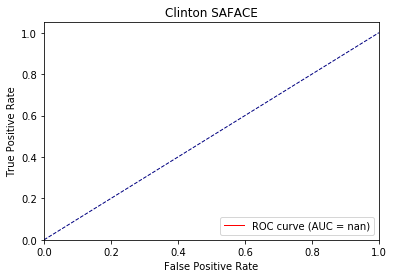

Directory already exists!
hc_saface 2 ap tensor([1., 0.]) loss : 0.12786865234375 0.16130492687225342 tid : 400 tg tensor([[0]], device='cuda:0')
hc_saface 2 ap tensor([0.9978, 0.0200]) loss : 0.08894109725952148 0.13879251098487436 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_saface 2 ap tensor([1., 0.]) loss : 0.10238611698150635 0.10601088813706941 tid : 240 tg tensor([[0]], device='cuda:0')
TEST hc_saface 2 ap tensor([1., 0.]) loss : 0.10873806476593018 0.10680671753706755 tid : 270 tg tensor([[0]], device='cuda:0')
TEST hc_saface 2 ap tensor([1., 0.]) loss : 0.10634791851043701 0.10400533024221659 tid : 330 tg tensor([[0]], device='cuda:0')
TEST hc_saface 2 ap tensor([1., 0.]) loss : 0.06273865699768066 0.09881298691034317 tid : 480 tg tensor([[0]], device='cuda:0')


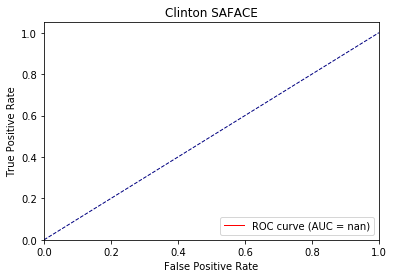

Directory already exists!
hc_neuface 0 ap tensor([0.3798, 0.3713]) loss : 0.7064741849899292 0.7164971360138485 tid : 400 tg tensor([[1]], device='cuda:0')
hc_neuface 0 ap tensor([0.6632, 0.2797]) loss : 0.6644750237464905 0.6805616324581769 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_neuface 0 ap tensor([0.5558, 0.5763]) loss : 0.5464581251144409 0.6978670008042279 tid : 240 tg tensor([[0]], device='cuda:0')
TEST hc_neuface 0 ap tensor([0.5330, 0.5735]) loss : 0.799391508102417 0.7010522992522629 tid : 270 tg tensor([[1]], device='cuda:0')
TEST hc_neuface 0 ap tensor([0.4885, 0.5439]) loss : 0.8711593747138977 0.7074616886675358 tid : 330 tg tensor([[1]], device='cuda:0')
TEST hc_neuface 0 ap tensor([0.5620, 0.5107]) loss : 0.8117110729217529 0.6967755955457687 tid : 480 tg tensor([[1]], device='cuda:0')


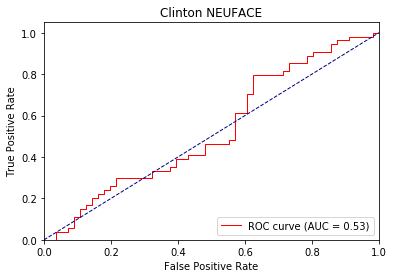

Directory already exists!
hc_neuface 1 ap tensor([0.7780, 0.3643]) loss : 0.6384246349334717 0.6487323466974956 tid : 200 tg tensor([[0]], device='cuda:0')
hc_neuface 1 ap tensor([0.7899, 0.4912]) loss : 0.8557891845703125 0.6404956401586532 tid : 400 tg tensor([[1]], device='cuda:0')
TEST hc_neuface 1 ap tensor([0.5779, 0.5927]) loss : 0.5296454429626465 0.6988848722448536 tid : 240 tg tensor([[0]], device='cuda:0')
TEST hc_neuface 1 ap tensor([0.5581, 0.5918]) loss : 0.8190146684646606 0.7026847275318923 tid : 270 tg tensor([[1]], device='cuda:0')
TEST hc_neuface 1 ap tensor([0.5334, 0.5866]) loss : 0.9145262837409973 0.708396642934531 tid : 330 tg tensor([[1]], device='cuda:0')
TEST hc_neuface 1 ap tensor([0.6272, 0.5890]) loss : 0.9147716760635376 0.6916126367449761 tid : 480 tg tensor([[1]], device='cuda:0')


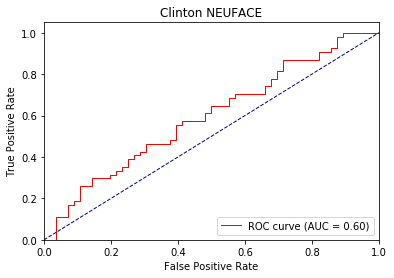

Directory already exists!
hc_neuface 2 ap tensor([0.8258, 0.7489]) loss : 0.6069774627685547 0.6383095173372163 tid : 200 tg tensor([[0]], device='cuda:0')
hc_neuface 2 ap tensor([0.8634, 0.7220]) loss : 0.8593260049819946 0.6219940824904656 tid : 400 tg tensor([[1]], device='cuda:0')
TEST hc_neuface 2 ap tensor([0.5884, 0.6641]) loss : 0.505729079246521 0.6984474658966064 tid : 240 tg tensor([[0]], device='cuda:0')
TEST hc_neuface 2 ap tensor([0.5725, 0.6590]) loss : 0.8487442135810852 0.702929683305599 tid : 270 tg tensor([[1]], device='cuda:0')
TEST hc_neuface 2 ap tensor([0.5597, 0.6566]) loss : 0.9598954916000366 0.7083561364561319 tid : 330 tg tensor([[1]], device='cuda:0')
TEST hc_neuface 2 ap tensor([0.6743, 0.6647]) loss : 1.0150305032730103 0.6867322292923927 tid : 480 tg tensor([[1]], device='cuda:0')


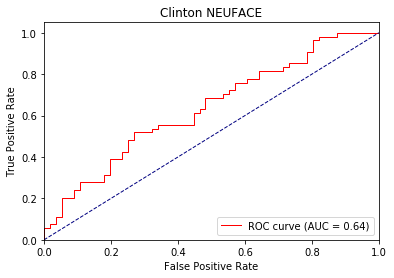

Directory already exists!
hc_inapprop 0 ap tensor([1., 0.]) loss : 0.431152880191803 0.5371895745396614 tid : 200 tg tensor([[0]], device='cuda:0')
hc_inapprop 0 ap tensor([1., 0.]) loss : 0.38046130537986755 0.47115746861810137 tid : 400 tg tensor([[0]], device='cuda:0')
TEST hc_inapprop 0 ap tensor([1., 0.]) loss : 0.2690880596637726 0.30486055098327935 tid : 240 tg tensor([[0]], device='cuda:0')
TEST hc_inapprop 0 ap tensor([1., 0.]) loss : 0.3492880165576935 0.30565375089645386 tid : 270 tg tensor([[0]], device='cuda:0')
TEST hc_inapprop 0 ap tensor([1., 0.]) loss : 0.2060377597808838 0.29566711094230413 tid : 330 tg tensor([[0]], device='cuda:0')
TEST hc_inapprop 0 ap tensor([1., 0.]) loss : 0.21911531686782837 0.2870844903588295 tid : 480 tg tensor([[0]], device='cuda:0')


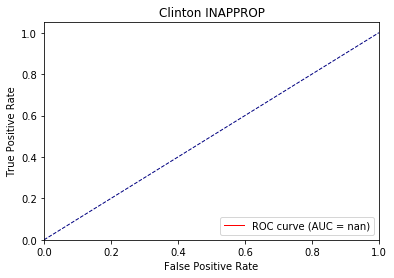

Directory already exists!
hc_inapprop 1 ap tensor([1., 0.]) loss : 0.1749851107597351 0.24703560163409022 tid : 200 tg tensor([[0]], device='cuda:0')
hc_inapprop 1 ap tensor([1., 0.]) loss : 0.2249293327331543 0.24369992495428586 tid : 400 tg tensor([[0]], device='cuda:0')
TEST hc_inapprop 1 ap tensor([1., 0.]) loss : 0.12096154689788818 0.14566293183495016 tid : 240 tg tensor([[0]], device='cuda:0')
TEST hc_inapprop 1 ap tensor([1., 0.]) loss : 0.1363968849182129 0.14586717111093025 tid : 270 tg tensor([[0]], device='cuda:0')
TEST hc_inapprop 1 ap tensor([1., 0.]) loss : 0.09281086921691895 0.13978405483067036 tid : 330 tg tensor([[0]], device='cuda:0')
TEST hc_inapprop 1 ap tensor([1., 0.]) loss : 0.09702789783477783 0.13779633790254592 tid : 480 tg tensor([[0]], device='cuda:0')


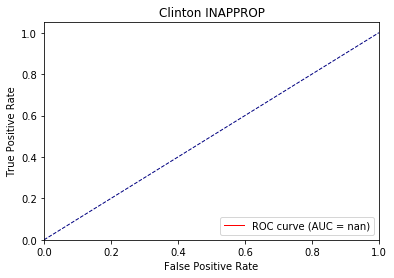

Directory already exists!
hc_inapprop 2 ap tensor([1., 0.]) loss : 0.07018113136291504 0.13006925092984553 tid : 200 tg tensor([[0]], device='cuda:0')
hc_inapprop 2 ap tensor([1., 0.]) loss : 0.06964695453643799 0.10247100960124622 tid : 400 tg tensor([[0]], device='cuda:0')
TEST hc_inapprop 2 ap tensor([1., 0.]) loss : 0.05885493755340576 0.07378523606880039 tid : 240 tg tensor([[0]], device='cuda:0')
TEST hc_inapprop 2 ap tensor([1., 0.]) loss : 0.05418956279754639 0.07362376870932402 tid : 270 tg tensor([[0]], device='cuda:0')
TEST hc_inapprop 2 ap tensor([1., 0.]) loss : 0.04535317420959473 0.06976133678108454 tid : 330 tg tensor([[0]], device='cuda:0')
TEST hc_inapprop 2 ap tensor([1., 0.]) loss : 0.0433344841003418 0.07074532866477966 tid : 480 tg tensor([[0]], device='cuda:0')


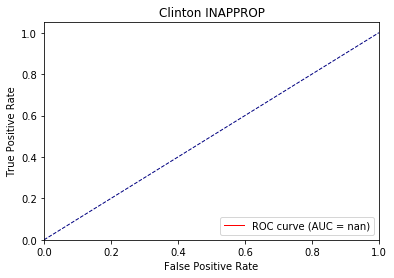

Directory already exists!
hc_affgest 0 ap tensor([0.9529, 0.0923]) loss : 0.7219576239585876 0.8364082884330016 tid : 200 tg tensor([[0]], device='cuda:0')
hc_affgest 0 ap tensor([0.9094, 0.0533]) loss : 0.5658326148986816 0.7711475474966897 tid : 400 tg tensor([[0]], device='cuda:0')
TEST hc_affgest 0 ap tensor([1., 0.]) loss : 0.5083552598953247 0.4650406825776194 tid : 240 tg tensor([[0]], device='cuda:0')
TEST hc_affgest 0 ap tensor([1., 0.]) loss : 0.43912047147750854 0.4656040933397081 tid : 270 tg tensor([[0]], device='cuda:0')
TEST hc_affgest 0 ap tensor([1., 0.]) loss : 0.47837772965431213 0.46389745036140084 tid : 330 tg tensor([[0]], device='cuda:0')
TEST hc_affgest 0 ap tensor([0.9950, 0.0250]) loss : 0.4210638105869293 0.4639074957370758 tid : 480 tg tensor([[0]], device='cuda:0')


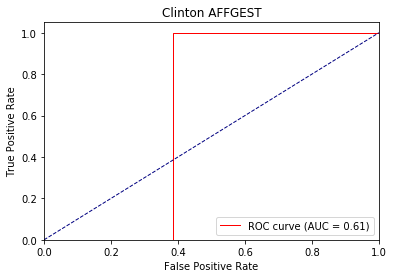

Directory already exists!
hc_affgest 1 ap tensor([0.9905, 0.3388]) loss : 0.38313543796539307 0.44575807584656607 tid : 400 tg tensor([[0]], device='cuda:0')
hc_affgest 1 ap tensor([0.9690, 0.1572]) loss : 0.23985815048217773 0.39850641329767844 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_affgest 1 ap tensor([1., 0.]) loss : 0.3930373191833496 0.2976572823290731 tid : 240 tg tensor([[0]], device='cuda:0')
TEST hc_affgest 1 ap tensor([1., 0.]) loss : 0.2842484712600708 0.29838997070436124 tid : 270 tg tensor([[0]], device='cuda:0')
TEST hc_affgest 1 ap tensor([1., 0.]) loss : 0.30822834372520447 0.2924397410824895 tid : 330 tg tensor([[0]], device='cuda:0')
TEST hc_affgest 1 ap tensor([0.9967, 0.0345]) loss : 0.22088879346847534 0.2920618337392807 tid : 480 tg tensor([[0]], device='cuda:0')


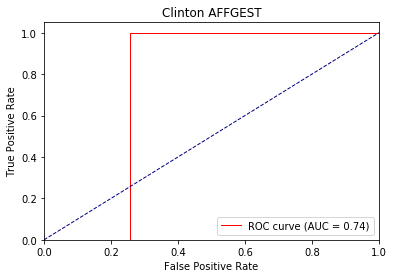

Directory already exists!
hc_affgest 2 ap tensor([0.9835, 0.1928]) loss : 0.17376482486724854 0.30266412636455226 tid : 200 tg tensor([[0]], device='cuda:0')
hc_affgest 2 ap tensor([0.9786, 0.2110]) loss : 0.19793927669525146 0.3099403094786864 tid : 400 tg tensor([[0]], device='cuda:0')
TEST hc_affgest 2 ap tensor([1., 0.]) loss : 0.33705610036849976 0.2129512925942739 tid : 240 tg tensor([[0]], device='cuda:0')
TEST hc_affgest 2 ap tensor([1., 0.]) loss : 0.1976158618927002 0.21319831907749176 tid : 270 tg tensor([[0]], device='cuda:0')
TEST hc_affgest 2 ap tensor([1., 0.]) loss : 0.21688717603683472 0.20581470848992467 tid : 330 tg tensor([[0]], device='cuda:0')
TEST hc_affgest 2 ap tensor([0.9979, 0.0500]) loss : 0.12530654668807983 0.20684512346982956 tid : 480 tg tensor([[0]], device='cuda:0')


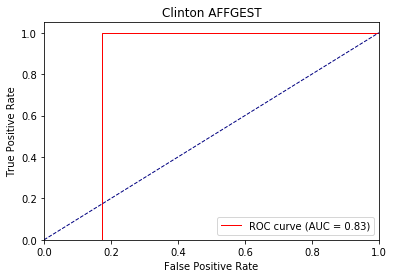

Directory already exists!
hc_defgest 0 ap tensor([0.8920, 0.0929]) loss : 0.8238396048545837 0.6237502245558906 tid : 400 tg tensor([[1]], device='cuda:0')
hc_defgest 0 ap tensor([0.9035, 0.0993]) loss : 0.5175120830535889 0.6173042613036425 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_defgest 0 ap tensor([0.9281, 0.6510]) loss : 0.44840341806411743 0.5403395616540722 tid : 240 tg tensor([[0]], device='cuda:0')
TEST hc_defgest 0 ap tensor([0.9284, 0.6750]) loss : 0.94392991065979 0.5520782056781981 tid : 270 tg tensor([[1]], device='cuda:0')
TEST hc_defgest 0 ap tensor([0.9101, 0.5945]) loss : 0.35070711374282837 0.5410793810151517 tid : 330 tg tensor([[0]], device='cuda:0')
TEST hc_defgest 0 ap tensor([0.9323, 0.4730]) loss : 0.37883448600769043 0.5104521870613098 tid : 480 tg tensor([[0]], device='cuda:0')


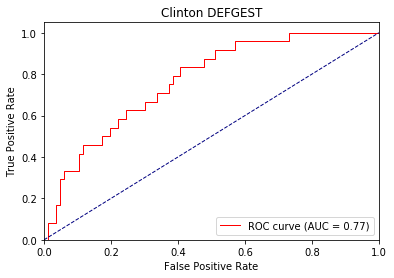

Directory already exists!
hc_defgest 1 ap tensor([0.9719, 0.1648]) loss : 0.24470996856689453 0.3644005433552795 tid : 200 tg tensor([[0]], device='cuda:0')
hc_defgest 1 ap tensor([0.9606, 0.1625]) loss : 1.3682799339294434 0.36635854719936706 tid : 400 tg tensor([[1]], device='cuda:0')
TEST hc_defgest 1 ap tensor([0.9190, 0.5638]) loss : 0.3360130786895752 0.5064806698584089 tid : 240 tg tensor([[0]], device='cuda:0')
TEST hc_defgest 1 ap tensor([0.9191, 0.5908]) loss : 1.2316908836364746 0.5270300899390821 tid : 270 tg tensor([[1]], device='cuda:0')
TEST hc_defgest 1 ap tensor([0.9090, 0.5426]) loss : 0.24458450078964233 0.5095320683903992 tid : 330 tg tensor([[0]], device='cuda:0')
TEST hc_defgest 1 ap tensor([0.9417, 0.4630]) loss : 0.22469258308410645 0.4599791523814201 tid : 480 tg tensor([[0]], device='cuda:0')


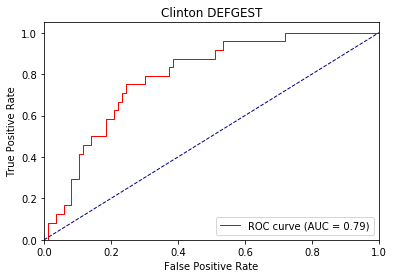

Directory already exists!
hc_defgest 2 ap tensor([0.9677, 0.1923]) loss : 0.19246912002563477 0.3054495187992221 tid : 200 tg tensor([[0]], device='cuda:0')
hc_defgest 2 ap tensor([0.9647, 0.1718]) loss : 1.49928617477417 0.31473577945840125 tid : 400 tg tensor([[1]], device='cuda:0')
TEST hc_defgest 2 ap tensor([0.9125, 0.5591]) loss : 0.2769743800163269 0.5031635293773576 tid : 240 tg tensor([[0]], device='cuda:0')
TEST hc_defgest 2 ap tensor([0.9101, 0.5766]) loss : 1.4149513244628906 0.5285653471946716 tid : 270 tg tensor([[1]], device='cuda:0')
TEST hc_defgest 2 ap tensor([0.9016, 0.5270]) loss : 0.19695639610290527 0.5090243760496378 tid : 330 tg tensor([[0]], device='cuda:0')
TEST hc_defgest 2 ap tensor([0.9399, 0.4629]) loss : 0.1541123390197754 0.44787288904190065 tid : 480 tg tensor([[0]], device='cuda:0')


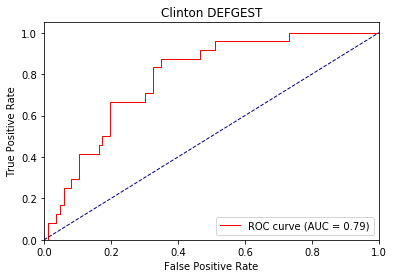

Directory already exists!
hc_agentic 0 ap tensor([0.6823, 0.7150]) loss : 0.6661455631256104 0.6429761425101546 tid : 200 tg tensor([[1]], device='cuda:0')
hc_agentic 0 ap tensor([0.7013, 0.7504]) loss : 0.47906798124313354 0.635214299604457 tid : 400 tg tensor([[1]], device='cuda:0')
TEST hc_agentic 0 ap tensor([0.8903, 0.8837]) loss : 0.35262516140937805 0.5328807497725767 tid : 240 tg tensor([[1]], device='cuda:0')
TEST hc_agentic 0 ap tensor([0.8894, 0.8837]) loss : 0.6826055645942688 0.5394761887965379 tid : 270 tg tensor([[1]], device='cuda:0')
TEST hc_agentic 0 ap tensor([0.8525, 0.8619]) loss : 0.7971490621566772 0.5589140173979104 tid : 330 tg tensor([[0]], device='cuda:0')
TEST hc_agentic 0 ap tensor([0.8831, 0.8561]) loss : 0.6347339153289795 0.5602858638763428 tid : 480 tg tensor([[0]], device='cuda:0')


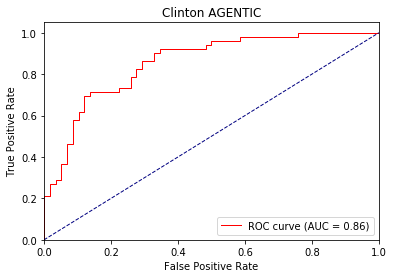

Directory already exists!
hc_agentic 1 ap tensor([0.8965, 0.9329]) loss : 0.3567146956920624 0.48402729799561467 tid : 400 tg tensor([[1]], device='cuda:0')
hc_agentic 1 ap tensor([0.9327, 0.9219]) loss : 0.46954989433288574 0.4505859517598454 tid : 200 tg tensor([[1]], device='cuda:0')
TEST hc_agentic 1 ap tensor([0.9354, 0.9392]) loss : 0.2099115252494812 0.4229539615266463 tid : 240 tg tensor([[1]], device='cuda:0')
TEST hc_agentic 1 ap tensor([0.9380, 0.9396]) loss : 0.4547448754310608 0.42893242670430076 tid : 270 tg tensor([[1]], device='cuda:0')
TEST hc_agentic 1 ap tensor([0.9061, 0.9213]) loss : 1.0567272901535034 0.4560330999083817 tid : 330 tg tensor([[0]], device='cuda:0')
TEST hc_agentic 1 ap tensor([0.9307, 0.9237]) loss : 0.5920406579971313 0.46386880993843077 tid : 480 tg tensor([[0]], device='cuda:0')


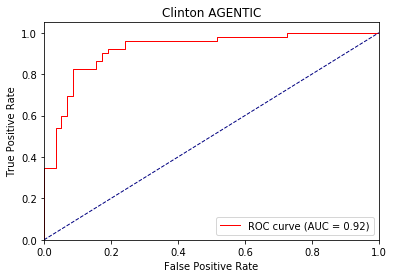

Directory already exists!
hc_agentic 2 ap tensor([0.9738, 0.9426]) loss : 0.470980703830719 0.38700509477745404 tid : 200 tg tensor([[1]], device='cuda:0')
hc_agentic 2 ap tensor([0.9595, 0.9419]) loss : 0.21494287252426147 0.35284622173524843 tid : 400 tg tensor([[1]], device='cuda:0')
TEST hc_agentic 2 ap tensor([0.9567, 0.9552]) loss : 0.13744193315505981 0.36438152603074614 tid : 240 tg tensor([[1]], device='cuda:0')
TEST hc_agentic 2 ap tensor([0.9571, 0.9543]) loss : 0.2953057289123535 0.3692775512183154 tid : 270 tg tensor([[1]], device='cuda:0')
TEST hc_agentic 2 ap tensor([0.9349, 0.9424]) loss : 1.2897160053253174 0.398227849509567 tid : 330 tg tensor([[0]], device='cuda:0')
TEST hc_agentic 2 ap tensor([0.9477, 0.9482]) loss : 0.5342124700546265 0.4068804332613945 tid : 480 tg tensor([[0]], device='cuda:0')


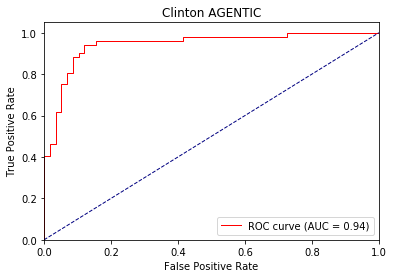

Directory already exists!
hc_waveoff 0 ap tensor([0.7209, 0.4233]) loss : 0.7923651933670044 0.66910465159914 tid : 400 tg tensor([[1]], device='cuda:0')
hc_waveoff 0 ap tensor([0.7485, 0.4558]) loss : 0.8038281798362732 0.6585183359500838 tid : 200 tg tensor([[1]], device='cuda:0')
TEST hc_waveoff 0 ap tensor([0.8665, 0.5788]) loss : 0.5833962559700012 0.6170809549443862 tid : 240 tg tensor([[1]], device='cuda:0')
TEST hc_waveoff 0 ap tensor([0.8587, 0.5886]) loss : 0.6518303155899048 0.6192755588778743 tid : 270 tg tensor([[1]], device='cuda:0')
TEST hc_waveoff 0 ap tensor([0.8481, 0.5517]) loss : 0.9370085000991821 0.6272346037440002 tid : 330 tg tensor([[0]], device='cuda:0')
TEST hc_waveoff 0 ap tensor([0.8472, 0.5242]) loss : 0.6924558281898499 0.6321464475989341 tid : 480 tg tensor([[0]], device='cuda:0')


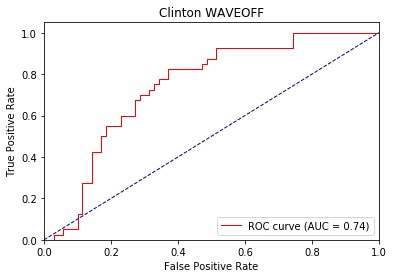

Directory already exists!
hc_waveoff 1 ap tensor([0.9191, 0.7185]) loss : 0.7274395227432251 0.5292891736688285 tid : 400 tg tensor([[1]], device='cuda:0')
hc_waveoff 1 ap tensor([0.9286, 0.7004]) loss : 0.8064903020858765 0.5167203125739293 tid : 200 tg tensor([[1]], device='cuda:0')
TEST hc_waveoff 1 ap tensor([0.8741, 0.5958]) loss : 0.4605449140071869 0.5681951910841698 tid : 240 tg tensor([[1]], device='cuda:0')
TEST hc_waveoff 1 ap tensor([0.8735, 0.6097]) loss : 0.5895800590515137 0.5692413957030685 tid : 270 tg tensor([[1]], device='cuda:0')
TEST hc_waveoff 1 ap tensor([0.8544, 0.5859]) loss : 1.0313316583633423 0.5789051582105458 tid : 330 tg tensor([[0]], device='cuda:0')
TEST hc_waveoff 1 ap tensor([0.8710, 0.5783]) loss : 0.5868697166442871 0.5749549373984337 tid : 480 tg tensor([[0]], device='cuda:0')


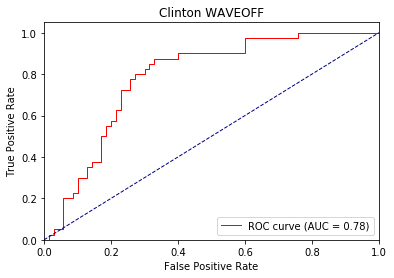

Directory already exists!
hc_waveoff 2 ap tensor([0.9601, 0.8057]) loss : 0.6376612782478333 0.4326640540047696 tid : 400 tg tensor([[1]], device='cuda:0')
hc_waveoff 2 ap tensor([0.9371, 0.7583]) loss : 0.7726843357086182 0.46841153539485814 tid : 200 tg tensor([[1]], device='cuda:0')
TEST hc_waveoff 2 ap tensor([0.8813, 0.6601]) loss : 0.3886723220348358 0.5422172517168755 tid : 240 tg tensor([[1]], device='cuda:0')
TEST hc_waveoff 2 ap tensor([0.8813, 0.6711]) loss : 0.5242739915847778 0.5413100222746531 tid : 270 tg tensor([[1]], device='cuda:0')
TEST hc_waveoff 2 ap tensor([0.8653, 0.6488]) loss : 1.0870298147201538 0.5520466626621783 tid : 330 tg tensor([[0]], device='cuda:0')
TEST hc_waveoff 2 ap tensor([0.8857, 0.6390]) loss : 0.4895993173122406 0.541315551996231 tid : 480 tg tensor([[0]], device='cuda:0')


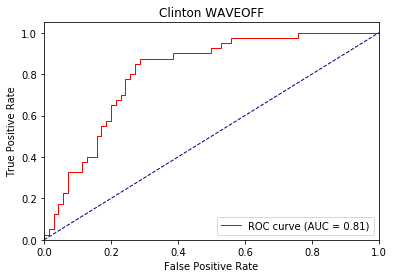

Directory already exists!
hc_nvtic1 0 ap tensor([0.8713, 0.0571]) loss : 0.5159209370613098 0.6796557700634003 tid : 400 tg tensor([[0]], device='cuda:0')
hc_nvtic1 0 ap tensor([0.7806, 0.1298]) loss : 0.44204962253570557 0.6613668899230769 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic1 0 ap tensor([0.8213, 0.3234]) loss : 0.3577337861061096 0.5741671528301987 tid : 240 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic1 0 ap tensor([0.8249, 0.3119]) loss : 0.3919636905193329 0.5674463361501694 tid : 270 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic1 0 ap tensor([0.8176, 0.2859]) loss : 0.45281755924224854 0.5668491530232131 tid : 330 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic1 0 ap tensor([0.7928, 0.3084]) loss : 0.45665261149406433 0.598222226202488 tid : 480 tg tensor([[0]], device='cuda:0')


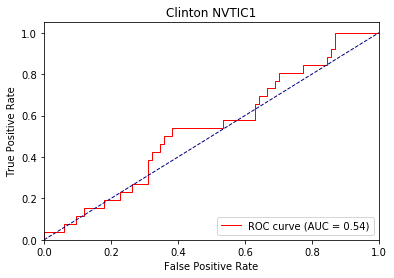

Directory already exists!
hc_nvtic1 1 ap tensor([0.8802, 0.1387]) loss : 0.29196155071258545 0.4965589951922875 tid : 400 tg tensor([[0]], device='cuda:0')
hc_nvtic1 1 ap tensor([0.8798, 0.1311]) loss : 0.29466599225997925 0.4930106089419167 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic1 1 ap tensor([0.8523, 0.4299]) loss : 0.21204781532287598 0.5127654180807226 tid : 240 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic1 1 ap tensor([0.8567, 0.4199]) loss : 0.26030588150024414 0.5018172733209751 tid : 270 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic1 1 ap tensor([0.8570, 0.3875]) loss : 0.2956036925315857 0.5031505590304732 tid : 330 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic1 1 ap tensor([0.8509, 0.3744]) loss : 0.3713840842247009 0.5532814732193947 tid : 480 tg tensor([[0]], device='cuda:0')


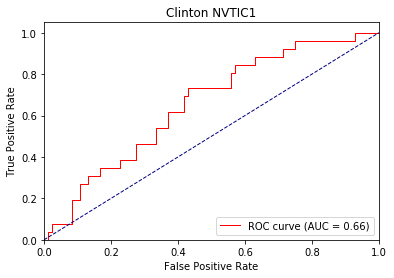

Directory already exists!
hc_nvtic1 2 ap tensor([0.8780, 0.2244]) loss : 0.21767085790634155 0.4733119822614561 tid : 200 tg tensor([[0]], device='cuda:0')
hc_nvtic1 2 ap tensor([0.9199, 0.2027]) loss : 0.15438568592071533 0.4344239398875396 tid : 400 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic1 2 ap tensor([0.8860, 0.4619]) loss : 0.14164400100708008 0.4883829600670758 tid : 240 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic1 2 ap tensor([0.8895, 0.4480]) loss : 0.18783777952194214 0.47447476122114396 tid : 270 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic1 2 ap tensor([0.8916, 0.4340]) loss : 0.2121397852897644 0.4762549754232168 tid : 330 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic1 2 ap tensor([0.8904, 0.4534]) loss : 0.3391266465187073 0.5348912778496743 tid : 480 tg tensor([[0]], device='cuda:0')


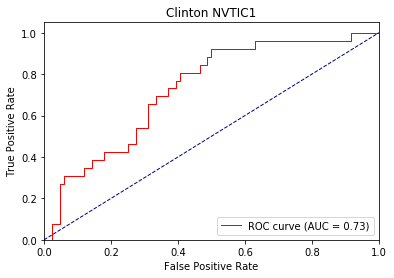

Directory already exists!
hc_nvtic2 0 ap tensor([0.8333, 0.1624]) loss : 0.5524085760116577 0.6133733074891238 tid : 200 tg tensor([[0]], device='cuda:0')
hc_nvtic2 0 ap tensor([0.8656, 0.1862]) loss : 0.43833547830581665 0.5847490789398314 tid : 400 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic2 0 ap tensor([1., 0.]) loss : 0.31270450353622437 0.34657026038450356 tid : 240 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic2 0 ap tensor([0.9897, 0.0417]) loss : 0.33088231086730957 0.3624297617762177 tid : 270 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic2 0 ap tensor([0.9828, 0.1656]) loss : 0.33799490332603455 0.3973718392662704 tid : 330 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic2 0 ap tensor([0.9737, 0.2191]) loss : 1.1362446546554565 0.4360430547595024 tid : 480 tg tensor([[1]], device='cuda:0')


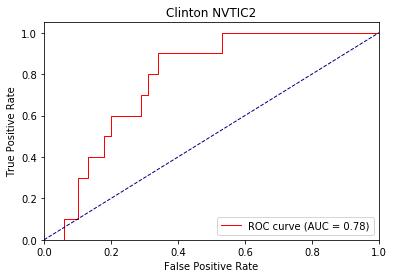

Directory already exists!
hc_nvtic2 1 ap tensor([0.9321, 0.2520]) loss : 0.31545567512512207 0.4580049409678108 tid : 400 tg tensor([[0]], device='cuda:0')
hc_nvtic2 1 ap tensor([0.9211, 0.3124]) loss : 0.3646770119667053 0.45846570625792454 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic2 1 ap tensor([1., 0.]) loss : 0.14798575639724731 0.23676449060440063 tid : 240 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic2 1 ap tensor([0.9953, 0.0769]) loss : 0.21134555339813232 0.25840371074499907 tid : 270 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic2 1 ap tensor([0.9888, 0.2356]) loss : 0.20931142568588257 0.3068775711581111 tid : 330 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic2 1 ap tensor([0.9821, 0.2892]) loss : 1.2306056022644043 0.3554812490940094 tid : 480 tg tensor([[1]], device='cuda:0')


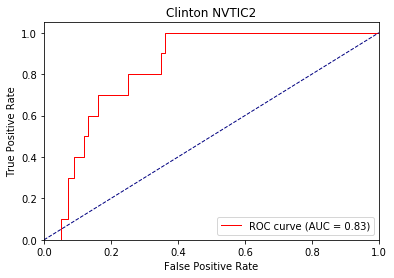

Directory already exists!
hc_nvtic2 2 ap tensor([0.9663, 0.6163]) loss : 0.22894960641860962 0.387958566347758 tid : 400 tg tensor([[0]], device='cuda:0')
hc_nvtic2 2 ap tensor([0.9496, 0.3554]) loss : 0.2597102224826813 0.3857823440974409 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic2 2 ap tensor([1., 0.]) loss : 0.09003341197967529 0.1846665932851679 tid : 240 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic2 2 ap tensor([0.9966, 0.1000]) loss : 0.14981919527053833 0.20887951884004805 tid : 270 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic2 2 ap tensor([0.9887, 0.3000]) loss : 0.14551711082458496 0.263877980876714 tid : 330 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic2 2 ap tensor([0.9827, 0.3227]) loss : 1.1976065635681152 0.31582879602909086 tid : 480 tg tensor([[1]], device='cuda:0')


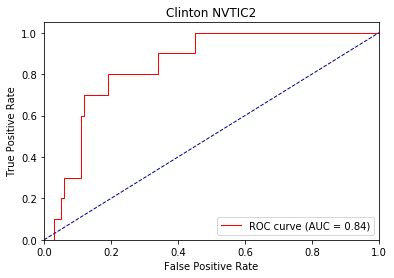

Directory already exists!
hc_nvtic3 0 ap tensor([0.9995, 0.0526]) loss : 0.4443856179714203 0.5809953791167348 tid : 400 tg tensor([[0]], device='cuda:0')
hc_nvtic3 0 ap tensor([0.9921, 0.0309]) loss : 0.42481282353401184 0.5514981081672743 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic3 0 ap tensor([0.9942, 0.0714]) loss : 0.32823824882507324 0.31724777058059095 tid : 240 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic3 0 ap tensor([0.9944, 0.0667]) loss : 0.24329513311386108 0.3150058896453292 tid : 270 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic3 0 ap tensor([0.9955, 0.0588]) loss : 0.3600076735019684 0.30852500861510634 tid : 330 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic3 0 ap tensor([0.9967, 0.0345]) loss : 0.27381306886672974 0.3084575620293617 tid : 480 tg tensor([[0]], device='cuda:0')


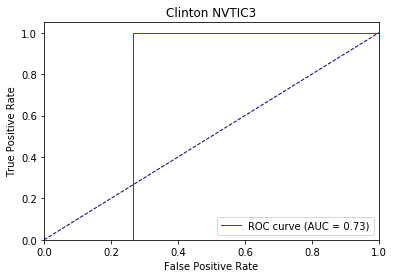

Directory already exists!
hc_nvtic3 1 ap tensor([0.9974, 0.0193]) loss : 0.16190379858016968 0.24166446110419243 tid : 400 tg tensor([[0]], device='cuda:0')
hc_nvtic3 1 ap tensor([0.9987, 0.0177]) loss : 0.11068785190582275 0.21635273484986062 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic3 1 ap tensor([0.9889, 0.0435]) loss : 0.15338027477264404 0.17919035518870635 tid : 240 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic3 1 ap tensor([0.9897, 0.0417]) loss : 0.10369575023651123 0.17594553364647758 tid : 270 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic3 1 ap tensor([0.9914, 0.0357]) loss : 0.13985246419906616 0.1661603692919016 tid : 330 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic3 1 ap tensor([0.9947, 0.0238]) loss : 0.10841941833496094 0.1564415630698204 tid : 480 tg tensor([[0]], device='cuda:0')


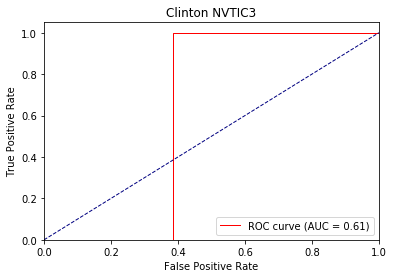

Directory already exists!
hc_nvtic3 2 ap tensor([0.9993, 0.0526]) loss : 0.07710504531860352 0.12731098116915904 tid : 400 tg tensor([[0]], device='cuda:0')
hc_nvtic3 2 ap tensor([0.9994, 0.0500]) loss : 0.06568467617034912 0.1250854476360278 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic3 2 ap tensor([0.9834, 0.0333]) loss : 0.08138477802276611 0.1291137840233597 tid : 240 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic3 2 ap tensor([0.9841, 0.0312]) loss : 0.04479026794433594 0.12494814616662485 tid : 270 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic3 2 ap tensor([0.9876, 0.0278]) loss : 0.05669903755187988 0.11321277730166912 tid : 330 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic3 2 ap tensor([0.9924, 0.0185]) loss : 0.046359896659851074 0.09745475888252259 tid : 480 tg tensor([[0]], device='cuda:0')


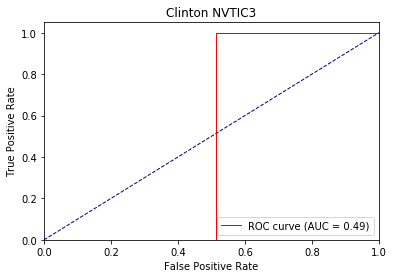

Directory already exists!
hc_nvtic5 0 ap tensor([1., 0.]) loss : 0.3027612566947937 0.48099424792271034 tid : 200 tg tensor([[0]], device='cuda:0')
hc_nvtic5 0 ap tensor([1., 0.]) loss : 0.2932586669921875 0.4348317708471696 tid : 400 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic5 0 ap tensor([1., 0.]) loss : 0.35871678590774536 0.3167765608020857 tid : 240 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic5 0 ap tensor([1., 0.]) loss : 0.3140370845794678 0.31834972125512584 tid : 270 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic5 0 ap tensor([1., 0.]) loss : 0.21895349025726318 0.30757798068225384 tid : 330 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic5 0 ap tensor([1., 0.]) loss : 0.20091384649276733 0.2956492257118225 tid : 480 tg tensor([[0]], device='cuda:0')


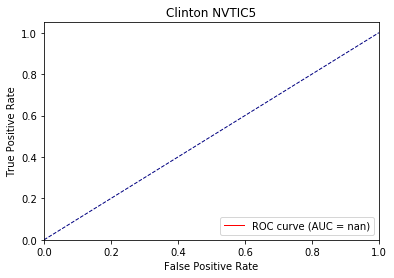

Directory already exists!
hc_nvtic5 1 ap tensor([1., 0.]) loss : 0.21761691570281982 0.2884812431457715 tid : 200 tg tensor([[0]], device='cuda:0')
hc_nvtic5 1 ap tensor([1., 0.]) loss : 0.14904814958572388 0.21425718806453586 tid : 400 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic5 1 ap tensor([1., 0.]) loss : 0.14452606439590454 0.1498736791750964 tid : 240 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic5 1 ap tensor([1., 0.]) loss : 0.1388421654701233 0.15066592616063576 tid : 270 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic5 1 ap tensor([1., 0.]) loss : 0.08781671524047852 0.14385954337194562 tid : 330 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic5 1 ap tensor([1., 0.]) loss : 0.07929444313049316 0.1384240499138832 tid : 480 tg tensor([[0]], device='cuda:0')


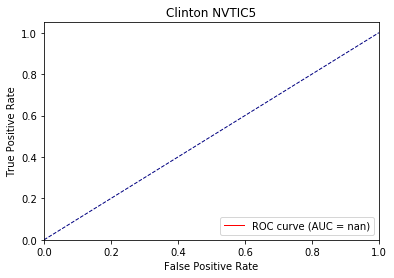

Directory already exists!
hc_nvtic5 2 ap tensor([1., 0.]) loss : 0.10866141319274902 0.15062975883483887 tid : 400 tg tensor([[0]], device='cuda:0')
hc_nvtic5 2 ap tensor([1., 0.]) loss : 0.0611424446105957 0.09639485920974594 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic5 2 ap tensor([1., 0.]) loss : 0.0770639181137085 0.07625005642573039 tid : 240 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic5 2 ap tensor([1., 0.]) loss : 0.06195235252380371 0.07636977014718233 tid : 270 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic5 2 ap tensor([1., 0.]) loss : 0.04001116752624512 0.07191594783216715 tid : 330 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic5 2 ap tensor([1., 0.]) loss : 0.03279256820678711 0.06922101318836212 tid : 480 tg tensor([[0]], device='cuda:0')


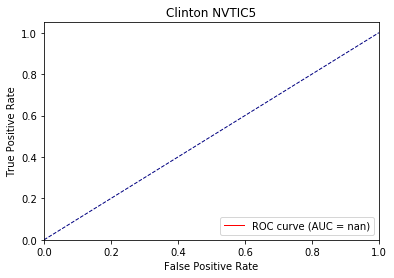

Directory already exists!
hc_nvtic4 0 ap tensor([0.9902, 0.0833]) loss : 0.5021274089813232 0.841672660317272 tid : 400 tg tensor([[0]], device='cuda:0')
hc_nvtic4 0 ap tensor([0.9925, 0.0801]) loss : 0.6194289326667786 0.8301417056719462 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic4 0 ap tensor([0.9942, 0.0714]) loss : 0.2736694812774658 0.3559811202918782 tid : 240 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic4 0 ap tensor([0.9949, 0.0714]) loss : 0.3222501873970032 0.35470069613721633 tid : 270 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic4 0 ap tensor([0.9948, 0.0526]) loss : 0.3147135376930237 0.35699085239320993 tid : 330 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic4 0 ap tensor([0.9963, 0.0312]) loss : 0.36543306708335876 0.3593196353316307 tid : 480 tg tensor([[0]], device='cuda:0')


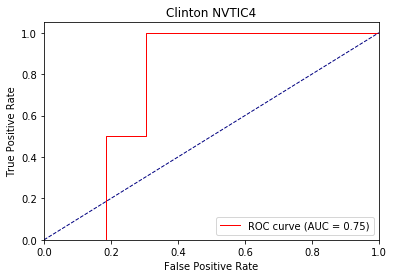

Directory already exists!
hc_nvtic4 1 ap tensor([1., 0.]) loss : 0.24407154321670532 0.35349823649112994 tid : 400 tg tensor([[0]], device='cuda:0')
hc_nvtic4 1 ap tensor([0.9889, 0.0595]) loss : 0.16914916038513184 0.3227215782638819 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic4 1 ap tensor([0.9947, 0.0769]) loss : 0.14118194580078125 0.1977761890373978 tid : 240 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic4 1 ap tensor([0.9953, 0.0769]) loss : 0.1502833366394043 0.19564523961808947 tid : 270 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic4 1 ap tensor([0.9961, 0.0667]) loss : 0.1522049903869629 0.19056966714560986 tid : 330 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic4 1 ap tensor([0.9975, 0.0435]) loss : 0.16072529554367065 0.18441018164157869 tid : 480 tg tensor([[0]], device='cuda:0')


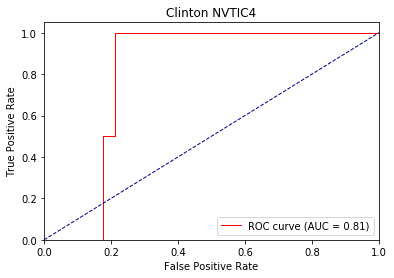

Directory already exists!
hc_nvtic4 2 ap tensor([0.9404, 0.2786]) loss : 0.11534464359283447 0.24484396608252273 tid : 200 tg tensor([[0]], device='cuda:0')
hc_nvtic4 2 ap tensor([0.9911, 0.0762]) loss : 0.048795223236083984 0.15313571258425127 tid : 400 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic4 2 ap tensor([0.9947, 0.0769]) loss : 0.07308506965637207 0.13440613770017437 tid : 240 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic4 2 ap tensor([0.9953, 0.0769]) loss : 0.07091927528381348 0.1312934105043058 tid : 270 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic4 2 ap tensor([0.9961, 0.0667]) loss : 0.07786941528320312 0.1229432886466384 tid : 330 tg tensor([[0]], device='cuda:0')
TEST hc_nvtic4 2 ap tensor([0.9972, 0.0400]) loss : 0.07364559173583984 0.11225314676761627 tid : 480 tg tensor([[0]], device='cuda:0')


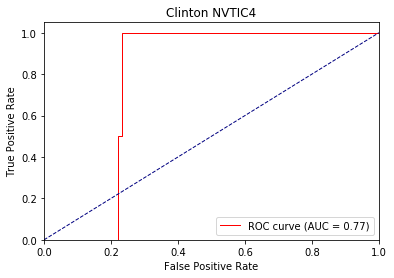

Directory already exists!
hc_interruptions 0 ap tensor([0.9883, 0.0932]) loss : 0.5284634828567505 0.611937806628785 tid : 200 tg tensor([[0]], device='cuda:0')
hc_interruptions 0 ap tensor([0.9910, 0.0840]) loss : 0.4107690155506134 0.5702773528390153 tid : 400 tg tensor([[0]], device='cuda:0')
TEST hc_interruptions 0 ap tensor([0.9859, 0.0370]) loss : 0.3667832911014557 0.39987006432869854 tid : 240 tg tensor([[0]], device='cuda:0')
TEST hc_interruptions 0 ap tensor([0.9871, 0.0357]) loss : 0.34394901990890503 0.39846316587041924 tid : 270 tg tensor([[0]], device='cuda:0')
TEST hc_interruptions 0 ap tensor([0.9905, 0.0333]) loss : 0.42165255546569824 0.39231539238244295 tid : 330 tg tensor([[0]], device='cuda:0')
TEST hc_interruptions 0 ap tensor([0.9538, 0.3001]) loss : 0.3943859338760376 0.4287526512145996 tid : 480 tg tensor([[0]], device='cuda:0')


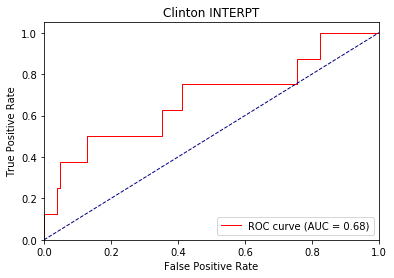

Directory already exists!
hc_interruptions 1 ap tensor([0.9967, 0.0810]) loss : 0.2578427791595459 0.3173703307167013 tid : 400 tg tensor([[0]], device='cuda:0')
hc_interruptions 1 ap tensor([0.9964, 0.1005]) loss : 0.1761510968208313 0.2694630639341015 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_interruptions 1 ap tensor([0.9867, 0.0385]) loss : 0.18356937170028687 0.23202695215449615 tid : 240 tg tensor([[0]], device='cuda:0')
TEST hc_interruptions 1 ap tensor([0.9878, 0.0370]) loss : 0.18463599681854248 0.23054717977841696 tid : 270 tg tensor([[0]], device='cuda:0')
TEST hc_interruptions 1 ap tensor([0.9901, 0.0323]) loss : 0.20211833715438843 0.22168995440006256 tid : 330 tg tensor([[0]], device='cuda:0')
TEST hc_interruptions 1 ap tensor([0.9544, 0.2421]) loss : 0.18140387535095215 0.30247296422719955 tid : 480 tg tensor([[0]], device='cuda:0')


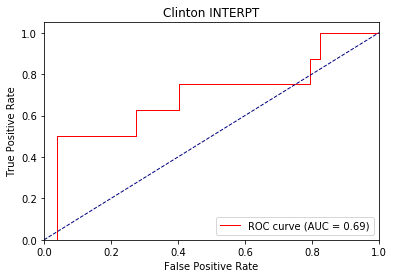

Directory already exists!
hc_interruptions 2 ap tensor([0.9977, 0.1234]) loss : 0.1049196720123291 0.1619945457753013 tid : 400 tg tensor([[0]], device='cuda:0')
hc_interruptions 2 ap tensor([0.9957, 0.1212]) loss : 0.0892404317855835 0.1629895065654287 tid : 200 tg tensor([[0]], device='cuda:0')
TEST hc_interruptions 2 ap tensor([0.9843, 0.0345]) loss : 0.08869123458862305 0.15946526211850784 tid : 240 tg tensor([[0]], device='cuda:0')
TEST hc_interruptions 2 ap tensor([0.9849, 0.0323]) loss : 0.10362744331359863 0.1571846455335617 tid : 270 tg tensor([[0]], device='cuda:0')
TEST hc_interruptions 2 ap tensor([0.9881, 0.0286]) loss : 0.10562324523925781 0.14684667298570275 tid : 330 tg tensor([[0]], device='cuda:0')
TEST hc_interruptions 2 ap tensor([0.9586, 0.2406]) loss : 0.09151333570480347 0.2650199058651924 tid : 480 tg tensor([[0]], device='cuda:0')


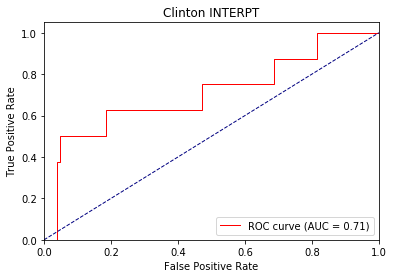

Directory already exists!


In [38]:
classify(1, 'HC')

SETTING UP DEBATE...
222
TRAINING DT1, TESTING DT3
Index(['dt_lookat2', 'dt_brush1', 'dt_nvdis1', 'dt_lookat3', 'dt_eyebrow',
       'dt_atface', 'dt_feface', 'dt_hrface', 'dt_saface', 'dt_neuface',
       'dt_inapprop', 'dt_affgest', 'dt_defgest', 'dt_agentic', 'dt_waveoff',
       'dt_nvtic1', 'dt_nvtic2', 'dt_nvtic3', 'dt_nvtic5', 'dt_nvtic4',
       'dt_interruptions'],
      dtype='object')
DF ROWS: 546
COLUMN LENGTHS:
CURRLABEL: Index(['dt_lookat2', 'dt_brush1', 'dt_nvdis1', 'dt_lookat3', 'dt_eyebrow',
       'dt_atface', 'dt_feface', 'dt_hrface', 'dt_saface', 'dt_neuface',
       'dt_inapprop', 'dt_affgest', 'dt_defgest', 'dt_agentic', 'dt_waveoff',
       'dt_nvtic1', 'dt_nvtic2', 'dt_nvtic3', 'dt_nvtic5', 'dt_nvtic4',
       'dt_interruptions'],
      dtype='object')
ALTLABEL: Index(['DT_LOOKAT', 'DT_BRUSH', 'DT_NVDIS', 'DT_LOOK', 'DT_EYEBROW',
       'DT_ATFACE', 'DT_FEFACE', 'DT_HRFACE', 'DT_SAFACE', 'DT_NEUFACE',
       'DT_INAPPROP', 'DT_AFFGEST', 'DT_DEFGEST', 'DT_AGENTIC

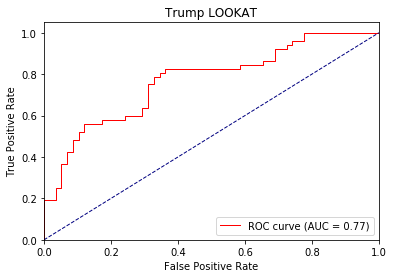

Directory already exists!
dt_lookat2 1 ap tensor([0.8542, 0.9398]) loss : 0.5907366871833801 0.5398532805823478 tid : 200 tg tensor([[1]], device='cuda:0')
TEST dt_lookat2 1 ap tensor([0.9478, 0.9029]) loss : 0.8309377431869507 0.5522691210110983 tid : 30 tg tensor([[0]], device='cuda:0')
TEST dt_lookat2 1 ap tensor([0.7127, 0.9063]) loss : 0.2747749984264374 0.5441639264424641 tid : 120 tg tensor([[0]], device='cuda:0')
TEST dt_lookat2 1 ap tensor([0.7625, 0.8648]) loss : 0.40221598744392395 0.5680832044233249 tid : 390 tg tensor([[0]], device='cuda:0')


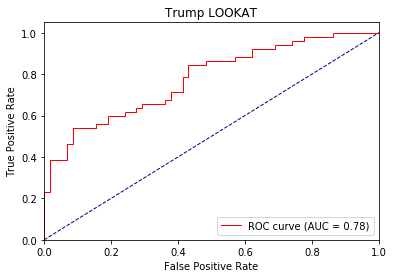

Directory already exists!
dt_lookat2 2 ap tensor([0.8770, 0.9357]) loss : 0.5432075262069702 0.43764679190478745 tid : 200 tg tensor([[1]], device='cuda:0')
TEST dt_lookat2 2 ap tensor([0.9478, 0.9029]) loss : 0.9594435691833496 0.5138924320538839 tid : 30 tg tensor([[0]], device='cuda:0')
TEST dt_lookat2 2 ap tensor([0.7084, 0.9041]) loss : 0.18943995237350464 0.5169176906347275 tid : 120 tg tensor([[0]], device='cuda:0')
TEST dt_lookat2 2 ap tensor([0.7582, 0.8618]) loss : 0.3195888102054596 0.5423234161696856 tid : 390 tg tensor([[0]], device='cuda:0')


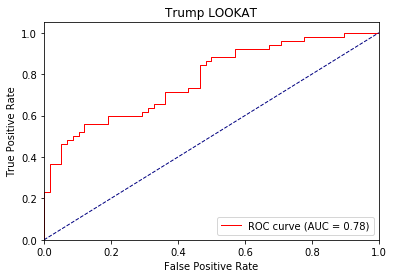

Directory already exists!
dt_brush1 0 ap tensor([0.9214, 0.0971]) loss : 0.29066115617752075 0.5230751730377179 tid : 200 tg tensor([[0]], device='cuda:0')
TEST dt_brush1 0 ap tensor([1., 0.]) loss : 0.466301828622818 0.4032508010665576 tid : 30 tg tensor([[0]], device='cuda:0')
TEST dt_brush1 0 ap tensor([1., 0.]) loss : 0.31360894441604614 0.388595445950826 tid : 120 tg tensor([[0]], device='cuda:0')
TEST dt_brush1 0 ap tensor([0.9863, 0.1255]) loss : 0.3133823871612549 0.4179993343504169 tid : 390 tg tensor([[0]], device='cuda:0')


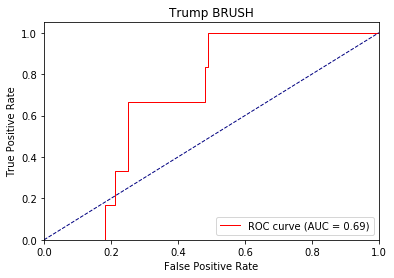

Directory already exists!
dt_brush1 1 ap tensor([0.9598, 0.4747]) loss : 0.2651940584182739 0.3868523807060428 tid : 200 tg tensor([[0]], device='cuda:0')
TEST dt_brush1 1 ap tensor([1., 0.]) loss : 0.3209221661090851 0.2580654000242551 tid : 30 tg tensor([[0]], device='cuda:0')
TEST dt_brush1 1 ap tensor([1., 0.]) loss : 0.18912887573242188 0.24863457481066387 tid : 120 tg tensor([[0]], device='cuda:0')
TEST dt_brush1 1 ap tensor([0.9912, 0.1635]) loss : 0.1725659966468811 0.2938289076467104 tid : 390 tg tensor([[0]], device='cuda:0')


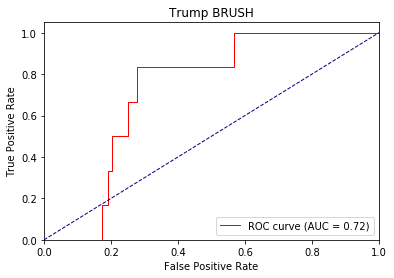

Directory already exists!
dt_brush1 2 ap tensor([0.9696, 0.3178]) loss : 0.08588004112243652 0.2963927460408455 tid : 200 tg tensor([[0]], device='cuda:0')
TEST dt_brush1 2 ap tensor([1., 0.]) loss : 0.24203771352767944 0.18496306240558624 tid : 30 tg tensor([[0]], device='cuda:0')
TEST dt_brush1 2 ap tensor([1., 0.]) loss : 0.12100338935852051 0.1798108031352361 tid : 120 tg tensor([[0]], device='cuda:0')
TEST dt_brush1 2 ap tensor([0.9918, 0.1723]) loss : 0.10497474670410156 0.23500202162356315 tid : 390 tg tensor([[0]], device='cuda:0')


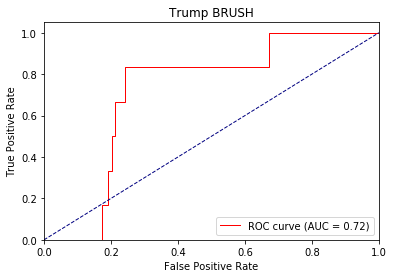

Directory already exists!
dt_nvdis1 0 ap tensor([0.6100, 0.9137]) loss : 0.42512047290802 0.5842491552119947 tid : 200 tg tensor([[1]], device='cuda:0')
TEST dt_nvdis1 0 ap tensor([0.5726, 0.8393]) loss : 0.7444137930870056 0.6106592466433843 tid : 30 tg tensor([[0]], device='cuda:0')
TEST dt_nvdis1 0 ap tensor([0.5857, 0.8557]) loss : 0.3074134290218353 0.5802203575770061 tid : 120 tg tensor([[1]], device='cuda:0')
TEST dt_nvdis1 0 ap tensor([0.5420, 0.8866]) loss : 0.2523210048675537 0.5756492154507697 tid : 390 tg tensor([[1]], device='cuda:0')


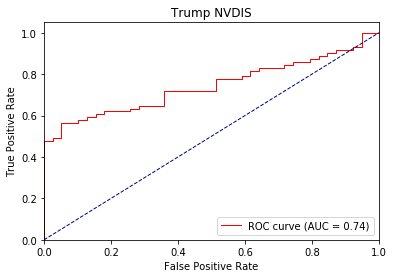

Directory already exists!
dt_nvdis1 1 ap tensor([0.5855, 0.9491]) loss : 0.17956197261810303 0.4701688528845185 tid : 200 tg tensor([[1]], device='cuda:0')
TEST dt_nvdis1 1 ap tensor([0.5726, 0.8393]) loss : 0.7333720922470093 0.5960930734872818 tid : 30 tg tensor([[0]], device='cuda:0')
TEST dt_nvdis1 1 ap tensor([0.6081, 0.8655]) loss : 0.19110107421875 0.5507116317749023 tid : 120 tg tensor([[1]], device='cuda:0')
TEST dt_nvdis1 1 ap tensor([0.5614, 0.8956]) loss : 0.15092933177947998 0.5495303397691702 tid : 390 tg tensor([[1]], device='cuda:0')


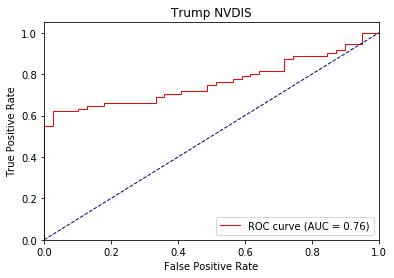

Directory already exists!
dt_nvdis1 2 ap tensor([0.6511, 0.9479]) loss : 0.11284279823303223 0.42649572305707123 tid : 200 tg tensor([[1]], device='cuda:0')
TEST dt_nvdis1 2 ap tensor([0.5726, 0.8393]) loss : 0.716842532157898 0.5948059360186259 tid : 30 tg tensor([[0]], device='cuda:0')
TEST dt_nvdis1 2 ap tensor([0.6192, 0.8729]) loss : 0.12882918119430542 0.5371930609146754 tid : 120 tg tensor([[1]], device='cuda:0')
TEST dt_nvdis1 2 ap tensor([0.5671, 0.8970]) loss : 0.09922611713409424 0.5430892189092273 tid : 390 tg tensor([[1]], device='cuda:0')


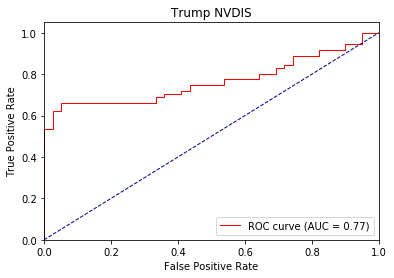

Directory already exists!
dt_lookat3 0 ap tensor([0.4586, 0.8752]) loss : 0.5220447778701782 0.6412189308334799 tid : 200 tg tensor([[1]], device='cuda:0')
TEST dt_lookat3 0 ap tensor([0.1250, 0.9255]) loss : 0.503000020980835 0.48253174126148224 tid : 30 tg tensor([[1]], device='cuda:0')
TEST dt_lookat3 0 ap tensor([0.2223, 0.9402]) loss : 0.2956981062889099 0.5010352939367294 tid : 120 tg tensor([[1]], device='cuda:0')
TEST dt_lookat3 0 ap tensor([0.3374, 0.9472]) loss : 0.2630433738231659 0.4845122095150284 tid : 390 tg tensor([[1]], device='cuda:0')


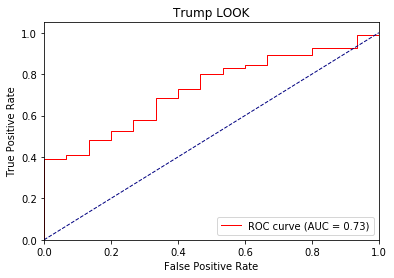

Directory already exists!
dt_lookat3 1 ap tensor([0.4287, 0.9471]) loss : 0.20097792148590088 0.4769929748835023 tid : 200 tg tensor([[1]], device='cuda:0')
TEST dt_lookat3 1 ap tensor([0.1250, 0.9255]) loss : 0.41485100984573364 0.41280612349510193 tid : 30 tg tensor([[1]], device='cuda:0')
TEST dt_lookat3 1 ap tensor([0.3333, 0.9498]) loss : 0.16721880435943604 0.4336873680353165 tid : 120 tg tensor([[1]], device='cuda:0')
TEST dt_lookat3 1 ap tensor([0.3971, 0.9526]) loss : 0.14626044034957886 0.41305467599554907 tid : 390 tg tensor([[1]], device='cuda:0')


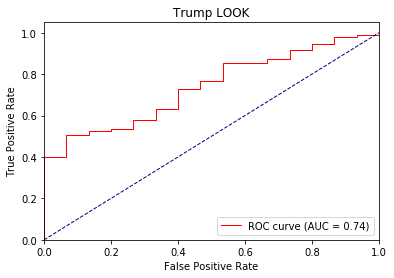

Directory already exists!
dt_lookat3 2 ap tensor([0.6610, 0.9625]) loss : 0.15003031492233276 0.4230266013970742 tid : 200 tg tensor([[1]], device='cuda:0')
TEST dt_lookat3 2 ap tensor([0.1250, 0.9255]) loss : 0.3470500111579895 0.3799552048246066 tid : 30 tg tensor([[1]], device='cuda:0')
TEST dt_lookat3 2 ap tensor([0.5348, 0.9531]) loss : 0.10520052909851074 0.3979247560103734 tid : 120 tg tensor([[1]], device='cuda:0')
TEST dt_lookat3 2 ap tensor([0.4342, 0.9542]) loss : 0.09089720249176025 0.3779894728449327 tid : 390 tg tensor([[1]], device='cuda:0')


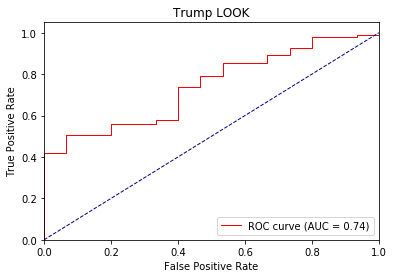

Directory already exists!
dt_eyebrow 0 ap tensor([0.0628, 0.9536]) loss : 0.8575587272644043 0.6827235187380767 tid : 200 tg tensor([[0]], device='cuda:0')
TEST dt_eyebrow 0 ap tensor([0.5726, 0.8393]) loss : 0.9962832927703857 0.6484656557440758 tid : 30 tg tensor([[0]], device='cuda:0')
TEST dt_eyebrow 0 ap tensor([0.6831, 0.6778]) loss : 0.40159958600997925 0.750897745291392 tid : 120 tg tensor([[1]], device='cuda:0')
TEST dt_eyebrow 0 ap tensor([0.7713, 0.7750]) loss : 0.39538779854774475 0.7137500987022738 tid : 390 tg tensor([[1]], device='cuda:0')


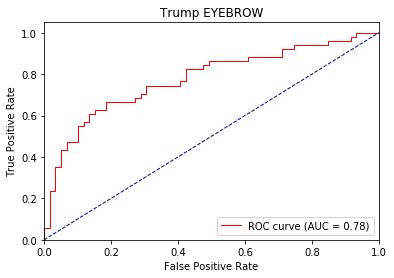

Directory already exists!
dt_eyebrow 1 ap tensor([0.1350, 0.9456]) loss : 1.4500951766967773 0.43552147516837486 tid : 200 tg tensor([[0]], device='cuda:0')
TEST dt_eyebrow 1 ap tensor([0.5454, 0.8139]) loss : 1.2949888706207275 0.7011648863554001 tid : 30 tg tensor([[0]], device='cuda:0')
TEST dt_eyebrow 1 ap tensor([0.7065, 0.6914]) loss : 0.22985485196113586 0.8876678317785263 tid : 120 tg tensor([[1]], device='cuda:0')
TEST dt_eyebrow 1 ap tensor([0.7966, 0.7921]) loss : 0.197363018989563 0.8296600463269632 tid : 390 tg tensor([[1]], device='cuda:0')


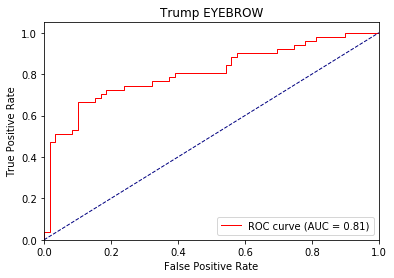

Directory already exists!
dt_eyebrow 2 ap tensor([0.1992, 0.9675]) loss : 2.6128342151641846 0.3020105246760419 tid : 200 tg tensor([[0]], device='cuda:0')
TEST dt_eyebrow 2 ap tensor([0.5454, 0.8139]) loss : 1.4702861309051514 0.7785304263234138 tid : 30 tg tensor([[0]], device='cuda:0')
TEST dt_eyebrow 2 ap tensor([0.7305, 0.7267]) loss : 0.13586002588272095 0.9948847313721975 tid : 120 tg tensor([[1]], device='cuda:0')
TEST dt_eyebrow 2 ap tensor([0.7945, 0.8022]) loss : 0.10691690444946289 0.9336979823021949 tid : 390 tg tensor([[1]], device='cuda:0')


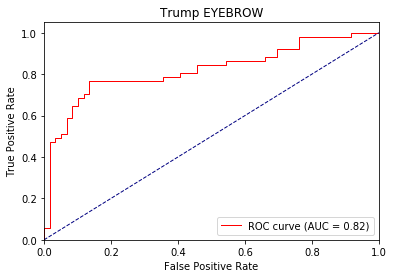

Directory already exists!
dt_atface 0 ap tensor([0.8181, 0.8917]) loss : 0.5466621518135071 0.6175230565178432 tid : 200 tg tensor([[1]], device='cuda:0')
TEST dt_atface 0 ap tensor([0.5060, 0.8220]) loss : 0.4963931441307068 0.6419866060217222 tid : 30 tg tensor([[0]], device='cuda:0')
TEST dt_atface 0 ap tensor([0.4649, 0.8592]) loss : 0.4812334477901459 0.6302910894155502 tid : 120 tg tensor([[1]], device='cuda:0')
TEST dt_atface 0 ap tensor([0.5616, 0.8988]) loss : 0.4149036407470703 0.5858560559115832 tid : 390 tg tensor([[1]], device='cuda:0')


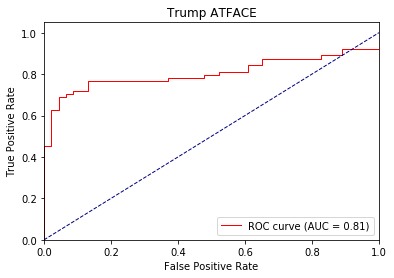

Directory already exists!
dt_atface 1 ap tensor([0.8251, 0.9353]) loss : 0.3284868597984314 0.47174861725974593 tid : 200 tg tensor([[1]], device='cuda:0')
TEST dt_atface 1 ap tensor([0.5393, 0.8298]) loss : 0.39027559757232666 0.6090595523516337 tid : 30 tg tensor([[0]], device='cuda:0')
TEST dt_atface 1 ap tensor([0.4852, 0.8652]) loss : 0.32308822870254517 0.5989613970120747 tid : 120 tg tensor([[1]], device='cuda:0')
TEST dt_atface 1 ap tensor([0.5763, 0.9101]) loss : 0.2555605173110962 0.5315400260158732 tid : 390 tg tensor([[1]], device='cuda:0')


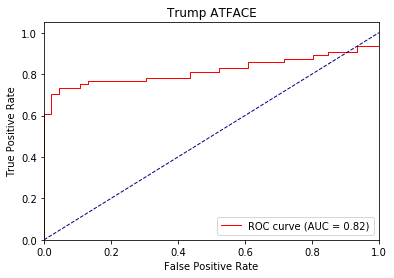

Directory already exists!
dt_atface 2 ap tensor([0.8895, 0.9360]) loss : 0.2623501420021057 0.38913086032867433 tid : 200 tg tensor([[1]], device='cuda:0')
TEST dt_atface 2 ap tensor([0.5393, 0.8298]) loss : 0.31328675150871277 0.5997199838360151 tid : 30 tg tensor([[0]], device='cuda:0')
TEST dt_atface 2 ap tensor([0.4937, 0.8690]) loss : 0.23665767908096313 0.5894539833068848 tid : 120 tg tensor([[1]], device='cuda:0')
TEST dt_atface 2 ap tensor([0.5813, 0.9117]) loss : 0.17795419692993164 0.5067281168472918 tid : 390 tg tensor([[1]], device='cuda:0')


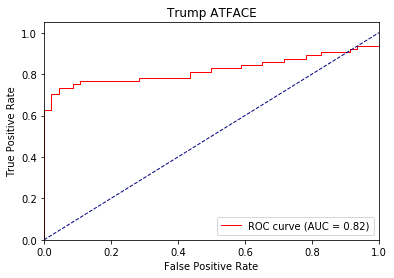

Directory already exists!
dt_feface 0 ap tensor([1., 0.]) loss : 0.5025750398635864 0.5807066499407775 tid : 200 tg tensor([[0]], device='cuda:0')
TEST dt_feface 0 ap tensor([1., 0.]) loss : 0.2786058783531189 0.29759737104177475 tid : 30 tg tensor([[0]], device='cuda:0')
TEST dt_feface 0 ap tensor([1., 0.]) loss : 0.30887338519096375 0.27513208091259 tid : 120 tg tensor([[0]], device='cuda:0')
TEST dt_feface 0 ap tensor([0.9773, 0.0149]) loss : 0.23234546184539795 0.2940260160572921 tid : 390 tg tensor([[0]], device='cuda:0')


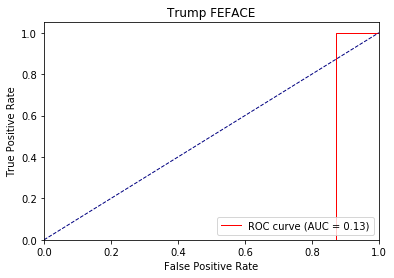

Directory already exists!
dt_feface 1 ap tensor([1., 0.]) loss : 0.11116313934326172 0.21283767401025847 tid : 200 tg tensor([[0]], device='cuda:0')
TEST dt_feface 1 ap tensor([1., 0.]) loss : 0.12293338775634766 0.1319732815027237 tid : 30 tg tensor([[0]], device='cuda:0')
TEST dt_feface 1 ap tensor([1., 0.]) loss : 0.15890586376190186 0.11978569825490316 tid : 120 tg tensor([[0]], device='cuda:0')
TEST dt_feface 1 ap tensor([0.9881, 0.0204]) loss : 0.09415280818939209 0.15326942145069944 tid : 390 tg tensor([[0]], device='cuda:0')


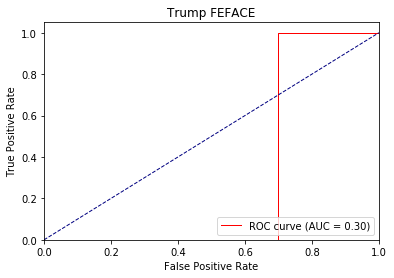

Directory already exists!
dt_feface 2 ap tensor([1., 0.]) loss : 0.08003497123718262 0.12810307870740475 tid : 200 tg tensor([[0]], device='cuda:0')
TEST dt_feface 2 ap tensor([1., 0.]) loss : 0.0528181791305542 0.05972498655319214 tid : 30 tg tensor([[0]], device='cuda:0')
TEST dt_feface 2 ap tensor([1., 0.]) loss : 0.08128082752227783 0.05516405304272969 tid : 120 tg tensor([[0]], device='cuda:0')
TEST dt_feface 2 ap tensor([0.9904, 0.0233]) loss : 0.03959047794342041 0.09761220895791356 tid : 390 tg tensor([[0]], device='cuda:0')


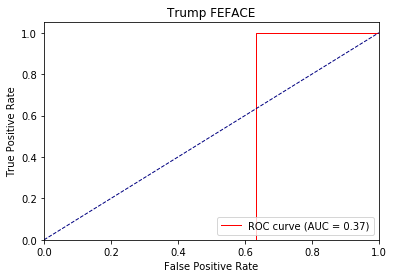

Directory already exists!
dt_hrface 0 ap tensor([0.9239, 0.1254]) loss : 0.38974931836128235 0.6696144388568017 tid : 200 tg tensor([[0]], device='cuda:0')
TEST dt_hrface 0 ap tensor([1., 0.]) loss : 0.36268022656440735 0.36708712329467136 tid : 30 tg tensor([[0]], device='cuda:0')
TEST dt_hrface 0 ap tensor([1., 0.]) loss : 0.3235631287097931 0.4039208203554153 tid : 120 tg tensor([[0]], device='cuda:0')
TEST dt_hrface 0 ap tensor([0.9812, 0.1726]) loss : 0.3448485732078552 0.44792526319057124 tid : 390 tg tensor([[0]], device='cuda:0')


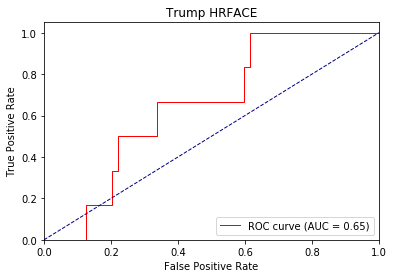

Directory already exists!
dt_hrface 1 ap tensor([0.9593, 0.2918]) loss : 0.17060589790344238 0.40977634884642833 tid : 200 tg tensor([[0]], device='cuda:0')
TEST dt_hrface 1 ap tensor([1., 0.]) loss : 0.2307928204536438 0.21391230324904123 tid : 30 tg tensor([[0]], device='cuda:0')
TEST dt_hrface 1 ap tensor([1., 0.]) loss : 0.1911817193031311 0.2423841675122579 tid : 120 tg tensor([[0]], device='cuda:0')
TEST dt_hrface 1 ap tensor([0.9880, 0.2310]) loss : 0.1583540439605713 0.30636427560939067 tid : 390 tg tensor([[0]], device='cuda:0')


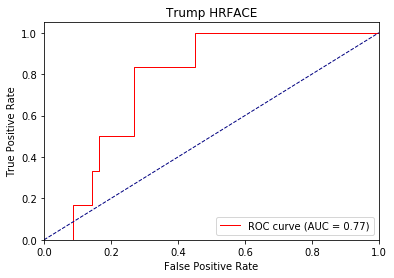

Directory already exists!
dt_hrface 2 ap tensor([0.9754, 0.5300]) loss : 0.09004616737365723 0.31089873595904277 tid : 200 tg tensor([[0]], device='cuda:0')
TEST dt_hrface 2 ap tensor([1., 0.]) loss : 0.16604292392730713 0.14544592797756195 tid : 30 tg tensor([[0]], device='cuda:0')
TEST dt_hrface 2 ap tensor([1., 0.]) loss : 0.1202806830406189 0.16902886430422465 tid : 120 tg tensor([[0]], device='cuda:0')
TEST dt_hrface 2 ap tensor([0.9896, 0.2556]) loss : 0.08366858959197998 0.2482196552843987 tid : 390 tg tensor([[0]], device='cuda:0')


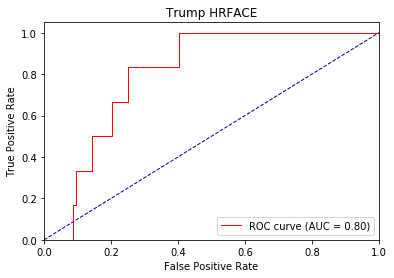

Directory already exists!
dt_saface 0 ap tensor([1., 0.]) loss : 0.44301164150238037 0.5859865289309929 tid : 200 tg tensor([[0]], device='cuda:0')
TEST dt_saface 0 ap tensor([1., 0.]) loss : 0.2659403681755066 0.2987161874771118 tid : 30 tg tensor([[0]], device='cuda:0')
TEST dt_saface 0 ap tensor([1., 0.]) loss : 0.3069383502006531 0.2973440905412038 tid : 120 tg tensor([[0]], device='cuda:0')
TEST dt_saface 0 ap tensor([1., 0.]) loss : 0.33334898948669434 0.3195995439456988 tid : 390 tg tensor([[0]], device='cuda:0')


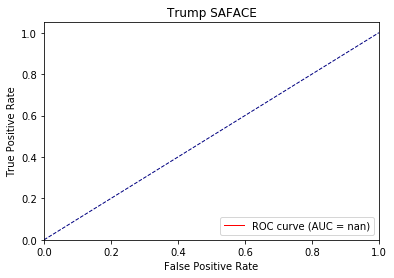

Directory already exists!
dt_saface 1 ap tensor([1., 0.]) loss : 0.12044930458068848 0.2489680817807056 tid : 200 tg tensor([[0]], device='cuda:0')
TEST dt_saface 1 ap tensor([1., 0.]) loss : 0.11519181728363037 0.135000209013621 tid : 30 tg tensor([[0]], device='cuda:0')
TEST dt_saface 1 ap tensor([1., 0.]) loss : 0.15974438190460205 0.13743475675582886 tid : 120 tg tensor([[0]], device='cuda:0')
TEST dt_saface 1 ap tensor([1., 0.]) loss : 0.15844088792800903 0.15834486031834083 tid : 390 tg tensor([[0]], device='cuda:0')


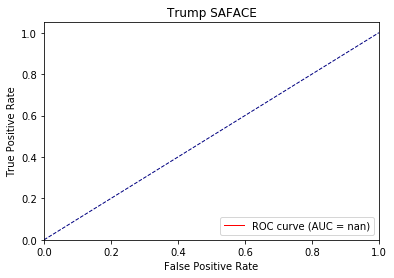

Directory already exists!
dt_saface 2 ap tensor([1., 0.]) loss : 0.07358133792877197 0.13828272819519044 tid : 200 tg tensor([[0]], device='cuda:0')
TEST dt_saface 2 ap tensor([1., 0.]) loss : 0.04875195026397705 0.060936917861302696 tid : 30 tg tensor([[0]], device='cuda:0')
TEST dt_saface 2 ap tensor([1., 0.]) loss : 0.0855334997177124 0.06510481039683023 tid : 120 tg tensor([[0]], device='cuda:0')
TEST dt_saface 2 ap tensor([1., 0.]) loss : 0.07629334926605225 0.07971795148487333 tid : 390 tg tensor([[0]], device='cuda:0')


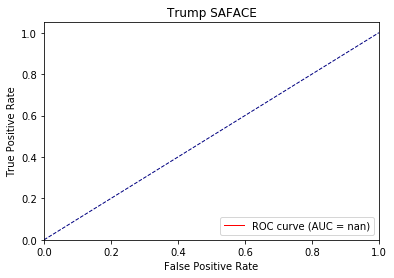

Directory already exists!
dt_neuface 0 ap tensor([0.8338, 0.3891]) loss : 0.5029695630073547 0.6552214209850018 tid : 200 tg tensor([[0]], device='cuda:0')
TEST dt_neuface 0 ap tensor([0.7755, 0.4554]) loss : 0.7104672193527222 0.6729617044329643 tid : 30 tg tensor([[1]], device='cuda:0')
TEST dt_neuface 0 ap tensor([0.7791, 0.3952]) loss : 0.670377254486084 0.6548877467711767 tid : 120 tg tensor([[0]], device='cuda:0')
TEST dt_neuface 0 ap tensor([0.8618, 0.4799]) loss : 0.5356277227401733 0.6155089830295949 tid : 390 tg tensor([[0]], device='cuda:0')


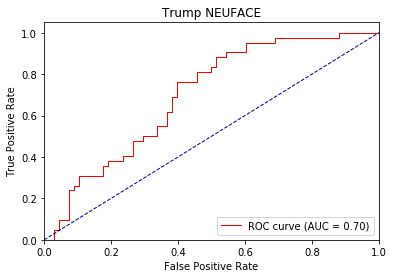

Directory already exists!
dt_neuface 1 ap tensor([0.8951, 0.6490]) loss : 0.4157673418521881 0.5766304200515151 tid : 200 tg tensor([[0]], device='cuda:0')
TEST dt_neuface 1 ap tensor([0.8120, 0.4860]) loss : 0.6572319269180298 0.6265624786416689 tid : 30 tg tensor([[1]], device='cuda:0')
TEST dt_neuface 1 ap tensor([0.8523, 0.4742]) loss : 0.43599629402160645 0.5970470120509466 tid : 120 tg tensor([[0]], device='cuda:0')
TEST dt_neuface 1 ap tensor([0.9049, 0.5500]) loss : 0.3306051790714264 0.5515894361689121 tid : 390 tg tensor([[0]], device='cuda:0')


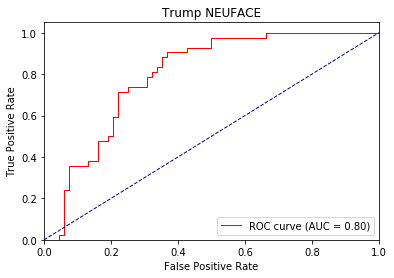

Directory already exists!
dt_neuface 2 ap tensor([0.9519, 0.6595]) loss : 0.24562117457389832 0.4622234160109505 tid : 200 tg tensor([[0]], device='cuda:0')
TEST dt_neuface 2 ap tensor([0.8120, 0.4860]) loss : 0.5983688831329346 0.6067478706439337 tid : 30 tg tensor([[1]], device='cuda:0')
TEST dt_neuface 2 ap tensor([0.8612, 0.4790]) loss : 0.31299716234207153 0.5677616387605667 tid : 120 tg tensor([[0]], device='cuda:0')
TEST dt_neuface 2 ap tensor([0.9126, 0.5597]) loss : 0.23399707674980164 0.522397475152076 tid : 390 tg tensor([[0]], device='cuda:0')


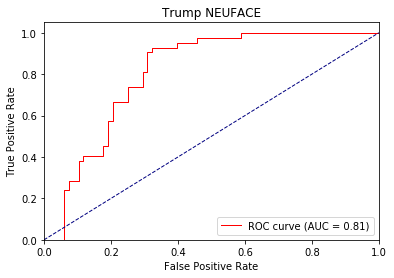

Directory already exists!
dt_inapprop 0 ap tensor([0.9697, 0.0486]) loss : 0.3093215227127075 0.5743411984486678 tid : 200 tg tensor([[0]], device='cuda:0')
TEST dt_inapprop 0 ap tensor([1., 0.]) loss : 0.4123808741569519 0.3690832555294037 tid : 30 tg tensor([[0]], device='cuda:0')
TEST dt_inapprop 0 ap tensor([1., 0.]) loss : 0.4172021150588989 0.37926222880681354 tid : 120 tg tensor([[0]], device='cuda:0')
TEST dt_inapprop 0 ap tensor([0.7985, 0.0934]) loss : 0.285145103931427 0.5052884013592442 tid : 390 tg tensor([[0]], device='cuda:0')


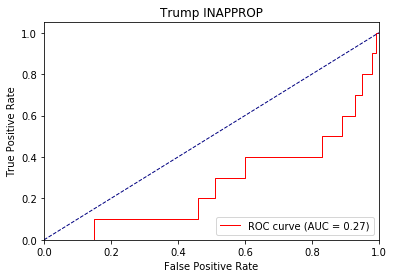

Directory already exists!
dt_inapprop 1 ap tensor([1., 0.]) loss : 0.24903011322021484 0.35948594356024705 tid : 200 tg tensor([[0]], device='cuda:0')
TEST dt_inapprop 1 ap tensor([1., 0.]) loss : 0.20316582918167114 0.19396947820981345 tid : 30 tg tensor([[0]], device='cuda:0')
TEST dt_inapprop 1 ap tensor([1., 0.]) loss : 0.22439831495285034 0.20232345561186474 tid : 120 tg tensor([[0]], device='cuda:0')
TEST dt_inapprop 1 ap tensor([0.8346, 0.1069]) loss : 0.14146876335144043 0.4240602945225148 tid : 390 tg tensor([[0]], device='cuda:0')


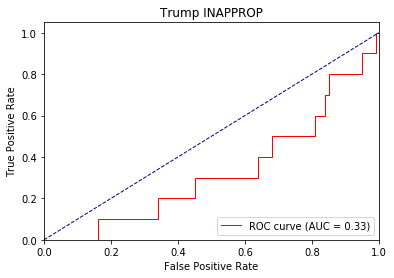

Directory already exists!
dt_inapprop 2 ap tensor([0.9757, 0.0819]) loss : 0.10889244079589844 0.2590680163960124 tid : 200 tg tensor([[0]], device='cuda:0')
TEST dt_inapprop 2 ap tensor([1., 0.]) loss : 0.10195159912109375 0.10686217248439789 tid : 30 tg tensor([[0]], device='cuda:0')
TEST dt_inapprop 2 ap tensor([1., 0.]) loss : 0.12846332788467407 0.11620662609736125 tid : 120 tg tensor([[0]], device='cuda:0')
TEST dt_inapprop 2 ap tensor([0.8544, 0.1178]) loss : 0.07535398006439209 0.4097734704802308 tid : 390 tg tensor([[0]], device='cuda:0')


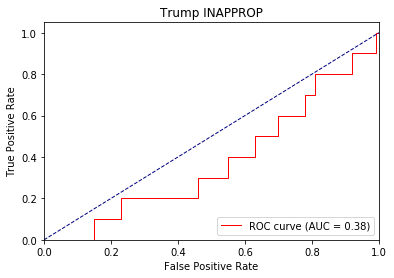

Directory already exists!
dt_affgest 0 ap tensor([0.9832, 0.0330]) loss : 0.2763689160346985 0.5706689419445171 tid : 200 tg tensor([[0]], device='cuda:0')
TEST dt_affgest 0 ap tensor([1., 0.]) loss : 0.37524721026420593 0.36390526592731476 tid : 30 tg tensor([[0]], device='cuda:0')
TEST dt_affgest 0 ap tensor([1., 0.]) loss : 0.45030519366264343 0.36581971247990924 tid : 120 tg tensor([[0]], device='cuda:0')
TEST dt_affgest 0 ap tensor([1., 0.]) loss : 0.3562190532684326 0.41527713137336925 tid : 390 tg tensor([[0]], device='cuda:0')


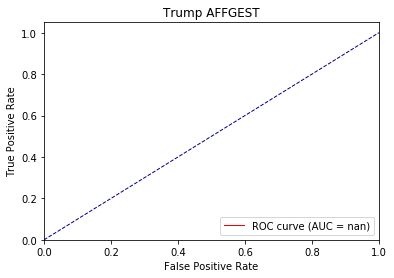

Directory already exists!
dt_affgest 1 ap tensor([1., 0.]) loss : 0.21372497081756592 0.3570327703599577 tid : 200 tg tensor([[0]], device='cuda:0')
TEST dt_affgest 1 ap tensor([1., 0.]) loss : 0.1861972212791443 0.1858779788017273 tid : 30 tg tensor([[0]], device='cuda:0')
TEST dt_affgest 1 ap tensor([1., 0.]) loss : 0.28179043531417847 0.1900232394536336 tid : 120 tg tensor([[0]], device='cuda:0')
TEST dt_affgest 1 ap tensor([1., 0.]) loss : 0.1904670000076294 0.23131068220621423 tid : 390 tg tensor([[0]], device='cuda:0')


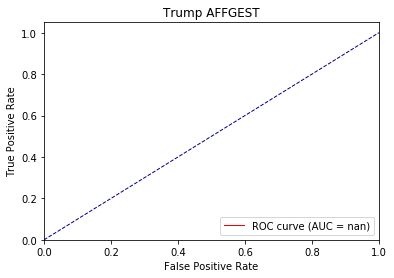

Directory already exists!
dt_affgest 2 ap tensor([0.9828, 0.0347]) loss : 0.08249831199645996 0.24224500612514774 tid : 200 tg tensor([[0]], device='cuda:0')
TEST dt_affgest 2 ap tensor([1., 0.]) loss : 0.09615731239318848 0.09989785899718602 tid : 30 tg tensor([[0]], device='cuda:0')
TEST dt_affgest 2 ap tensor([1., 0.]) loss : 0.18223166465759277 0.1078073392311732 tid : 120 tg tensor([[0]], device='cuda:0')
TEST dt_affgest 2 ap tensor([1., 0.]) loss : 0.11154913902282715 0.1393620801877372 tid : 390 tg tensor([[0]], device='cuda:0')


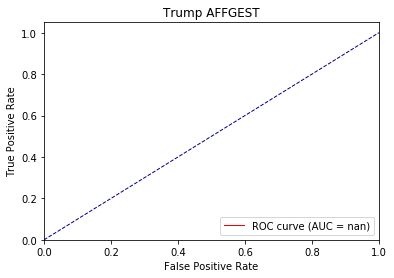

Directory already exists!
dt_defgest 0 ap tensor([0.8715, 0.4881]) loss : 0.6745469570159912 0.6405205728916021 tid : 200 tg tensor([[1]], device='cuda:0')
TEST dt_defgest 0 ap tensor([1., 0.]) loss : 0.4342520534992218 0.5473359351356825 tid : 30 tg tensor([[0]], device='cuda:0')
TEST dt_defgest 0 ap tensor([0.9971, 0.9167]) loss : 0.6239176988601685 0.5243787964185079 tid : 120 tg tensor([[1]], device='cuda:0')
TEST dt_defgest 0 ap tensor([0.8938, 0.6206]) loss : 0.647943913936615 0.6093886513498765 tid : 390 tg tensor([[1]], device='cuda:0')


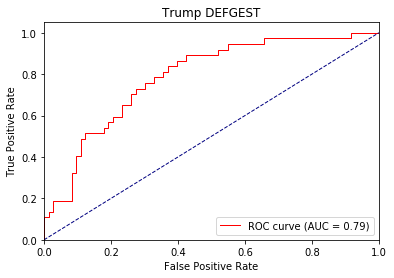

Directory already exists!
dt_defgest 1 ap tensor([0.9195, 0.6550]) loss : 0.7283656597137451 0.5390559691436512 tid : 200 tg tensor([[1]], device='cuda:0')
TEST dt_defgest 1 ap tensor([1., 0.]) loss : 0.2910350561141968 0.4666901578505834 tid : 30 tg tensor([[0]], device='cuda:0')
TEST dt_defgest 1 ap tensor([0.9956, 0.8929]) loss : 0.5778534412384033 0.43498058716456095 tid : 120 tg tensor([[1]], device='cuda:0')
TEST dt_defgest 1 ap tensor([0.9142, 0.6717]) loss : 0.6277042627334595 0.5532090445108051 tid : 390 tg tensor([[1]], device='cuda:0')


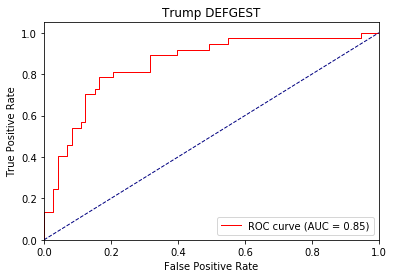

Directory already exists!
dt_defgest 2 ap tensor([0.9133, 0.6602]) loss : 0.6734597682952881 0.488225554227829 tid : 200 tg tensor([[1]], device='cuda:0')
TEST dt_defgest 2 ap tensor([1., 0.]) loss : 0.20680838823318481 0.4189998283982277 tid : 30 tg tensor([[0]], device='cuda:0')
TEST dt_defgest 2 ap tensor([0.9956, 0.8929]) loss : 0.5414721369743347 0.38374482889970146 tid : 120 tg tensor([[1]], device='cuda:0')
TEST dt_defgest 2 ap tensor([0.9120, 0.6838]) loss : 0.6150336861610413 0.5198831022540226 tid : 390 tg tensor([[1]], device='cuda:0')


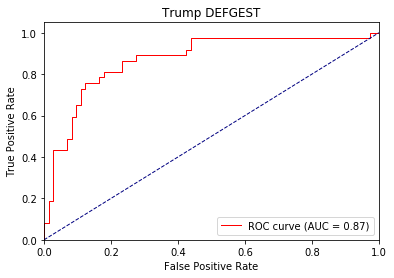

Directory already exists!
dt_agentic 0 ap tensor([0.4407, 0.7528]) loss : 0.5127813816070557 0.6789869114064969 tid : 200 tg tensor([[1]], device='cuda:0')
TEST dt_agentic 0 ap tensor([1., 1.]) loss : 0.6053556203842163 0.5591824154059092 tid : 30 tg tensor([[0]], device='cuda:0')
TEST dt_agentic 0 ap tensor([0.9315, 0.7952]) loss : 0.6168973445892334 0.6027969300746918 tid : 120 tg tensor([[1]], device='cuda:0')
TEST dt_agentic 0 ap tensor([0.8542, 0.8675]) loss : 0.4319150745868683 0.6067550861382787 tid : 390 tg tensor([[1]], device='cuda:0')


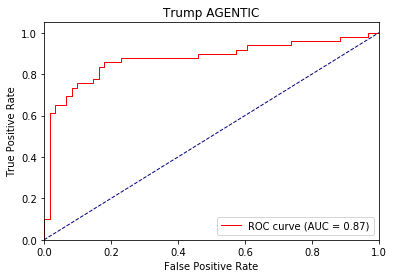

Directory already exists!
dt_agentic 1 ap tensor([0.7410, 0.9622]) loss : 0.39248424768447876 0.5146944346251311 tid : 200 tg tensor([[1]], device='cuda:0')
TEST dt_agentic 1 ap tensor([1., 1.]) loss : 0.48072123527526855 0.462013507882754 tid : 30 tg tensor([[0]], device='cuda:0')
TEST dt_agentic 1 ap tensor([0.9339, 0.8683]) loss : 0.3762876093387604 0.5288582692543665 tid : 120 tg tensor([[1]], device='cuda:0')
TEST dt_agentic 1 ap tensor([0.8698, 0.9159]) loss : 0.2518860697746277 0.5413339311563516 tid : 390 tg tensor([[1]], device='cuda:0')


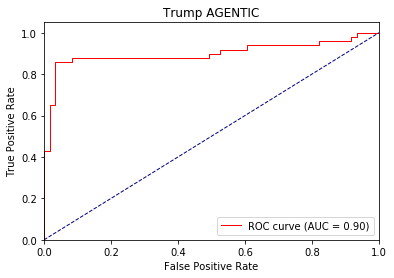

Directory already exists!
dt_agentic 2 ap tensor([0.8764, 0.9549]) loss : 0.2068881392478943 0.37809447906724175 tid : 200 tg tensor([[1]], device='cuda:0')
TEST dt_agentic 2 ap tensor([1., 1.]) loss : 0.3957683742046356 0.4028617938359578 tid : 30 tg tensor([[0]], device='cuda:0')
TEST dt_agentic 2 ap tensor([0.9275, 0.8852]) loss : 0.2340754270553589 0.4933681776126226 tid : 120 tg tensor([[1]], device='cuda:0')
TEST dt_agentic 2 ap tensor([0.8680, 0.9218]) loss : 0.15764743089675903 0.5124586590483219 tid : 390 tg tensor([[1]], device='cuda:0')


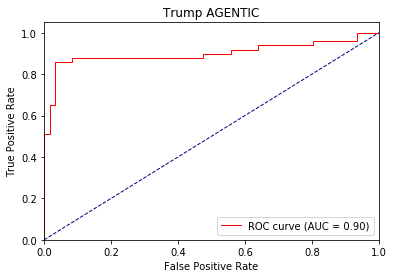

Directory already exists!
dt_waveoff 0 ap tensor([1., 0.]) loss : 0.657886266708374 0.6144998658884753 tid : 200 tg tensor([[0]], device='cuda:0')
TEST dt_waveoff 0 ap tensor([0.9650, 0.2000]) loss : 0.2829738259315491 0.4113006765643756 tid : 30 tg tensor([[0]], device='cuda:0')
TEST dt_waveoff 0 ap tensor([0.8425, 0.2042]) loss : 1.4200907945632935 0.45243718127409616 tid : 120 tg tensor([[1]], device='cuda:0')
TEST dt_waveoff 0 ap tensor([0.8688, 0.1349]) loss : 0.24682354927062988 0.41674664692033697 tid : 390 tg tensor([[0]], device='cuda:0')


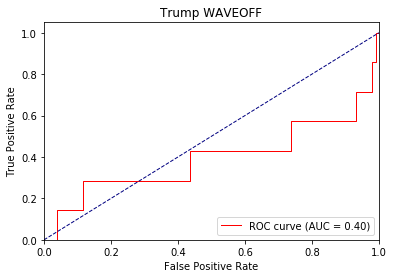

Directory already exists!
dt_waveoff 1 ap tensor([1., 0.]) loss : 0.1844603419303894 0.2474298577108783 tid : 200 tg tensor([[0]], device='cuda:0')
TEST dt_waveoff 1 ap tensor([0.9073, 0.1111]) loss : 0.13501989841461182 0.32302942872047424 tid : 30 tg tensor([[0]], device='cuda:0')
TEST dt_waveoff 1 ap tensor([0.8924, 0.1710]) loss : 2.063380002975464 0.409199125568072 tid : 120 tg tensor([[1]], device='cuda:0')
TEST dt_waveoff 1 ap tensor([0.8642, 0.1189]) loss : 0.10573136806488037 0.3341689694531356 tid : 390 tg tensor([[0]], device='cuda:0')


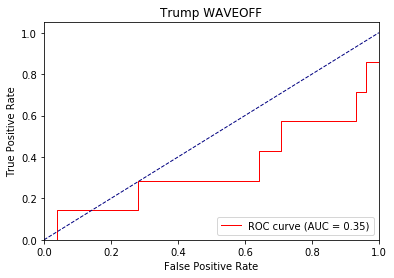

Directory already exists!
dt_waveoff 2 ap tensor([1., 0.]) loss : 0.08809065818786621 0.13354049057796083 tid : 200 tg tensor([[0]], device='cuda:0')
TEST dt_waveoff 2 ap tensor([0.8543, 0.0909]) loss : 0.06310427188873291 0.3203690896431605 tid : 30 tg tensor([[0]], device='cuda:0')
TEST dt_waveoff 2 ap tensor([0.9016, 0.1559]) loss : 2.7415666580200195 0.44705023368199664 tid : 120 tg tensor([[1]], device='cuda:0')
TEST dt_waveoff 2 ap tensor([0.8644, 0.0855]) loss : 0.04680895805358887 0.3281623487231098 tid : 390 tg tensor([[0]], device='cuda:0')


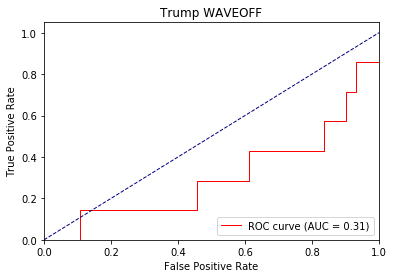

Directory already exists!
dt_nvtic1 0 ap tensor([0.9313, 0.1483]) loss : 0.43176671862602234 0.6052328469017134 tid : 200 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic1 0 ap tensor([0.9127, 0.5845]) loss : 0.43921491503715515 0.5711135491728783 tid : 30 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic1 0 ap tensor([0.8225, 0.3863]) loss : 0.2939826548099518 0.6167759716510772 tid : 120 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic1 0 ap tensor([0.9203, 0.2926]) loss : 0.28833767771720886 0.5131921496572374 tid : 390 tg tensor([[0]], device='cuda:0')


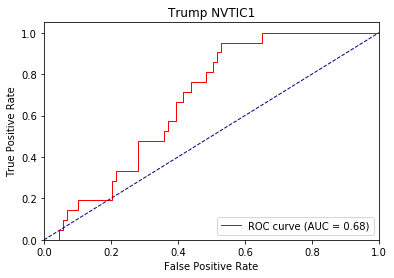

Directory already exists!
dt_nvtic1 1 ap tensor([0.9604, 0.2614]) loss : 0.20446664094924927 0.4268525825894397 tid : 200 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic1 1 ap tensor([0.9127, 0.5845]) loss : 0.3647657632827759 0.5571020866433779 tid : 30 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic1 1 ap tensor([0.8128, 0.3836]) loss : 0.18046724796295166 0.622157683968544 tid : 120 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic1 1 ap tensor([0.9154, 0.2678]) loss : 0.1705564260482788 0.46932495206217223 tid : 390 tg tensor([[0]], device='cuda:0')


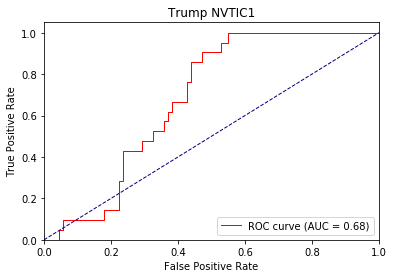

Directory already exists!
dt_nvtic1 2 ap tensor([0.9587, 0.4439]) loss : 0.16571730375289917 0.42462851326255235 tid : 200 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic1 2 ap tensor([0.9203, 0.7095]) loss : 0.3295709192752838 0.5568459928035736 tid : 30 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic1 2 ap tensor([0.8150, 0.3838]) loss : 0.11905097961425781 0.6397177249193191 tid : 120 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic1 2 ap tensor([0.9144, 0.2679]) loss : 0.11012434959411621 0.4560539986513838 tid : 390 tg tensor([[0]], device='cuda:0')


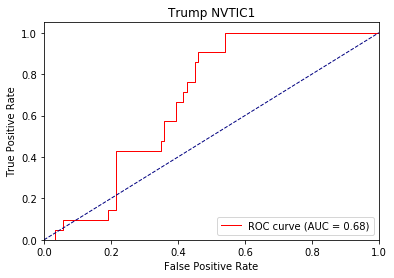

Directory already exists!
dt_nvtic2 0 ap tensor([0.9452, 0.6333]) loss : 0.5872500538825989 0.597824731698403 tid : 200 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic2 0 ap tensor([0.7946, 0.7042]) loss : 0.9872454404830933 0.7311883469422659 tid : 30 tg tensor([[1]], device='cuda:0')
TEST dt_nvtic2 0 ap tensor([0.8399, 0.7030]) loss : 0.4332467317581177 0.6368364294370016 tid : 120 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic2 0 ap tensor([0.9079, 0.4411]) loss : 0.261904239654541 0.5090616062472139 tid : 390 tg tensor([[0]], device='cuda:0')


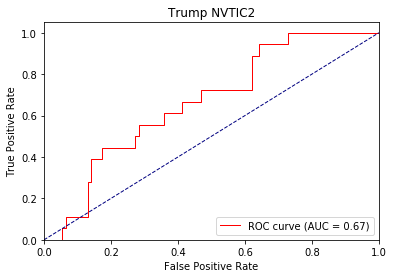

Directory already exists!
dt_nvtic2 1 ap tensor([0.9497, 0.1871]) loss : 0.19323033094406128 0.4149922011467406 tid : 200 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic2 1 ap tensor([0.8062, 0.7292]) loss : 1.1923158168792725 0.8090149660905203 tid : 30 tg tensor([[1]], device='cuda:0')
TEST dt_nvtic2 1 ap tensor([0.8551, 0.7294]) loss : 0.2718806266784668 0.6639947116374969 tid : 120 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic2 1 ap tensor([0.9124, 0.5037]) loss : 0.14787495136260986 0.4770543907262102 tid : 390 tg tensor([[0]], device='cuda:0')


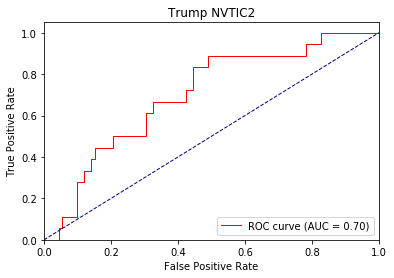

Directory already exists!
dt_nvtic2 2 ap tensor([0.9442, 0.2597]) loss : 0.09883546829223633 0.36890152805968174 tid : 200 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic2 2 ap tensor([0.7792, 0.6496]) loss : 1.32737398147583 0.8753684063752493 tid : 30 tg tensor([[1]], device='cuda:0')
TEST dt_nvtic2 2 ap tensor([0.8345, 0.7076]) loss : 0.18165993690490723 0.695389970143636 tid : 120 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic2 2 ap tensor([0.9063, 0.5082]) loss : 0.09586334228515625 0.47109862973418415 tid : 390 tg tensor([[0]], device='cuda:0')


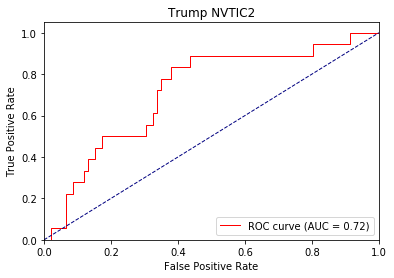

Directory already exists!
dt_nvtic3 0 ap tensor([0.4646, 0.4950]) loss : 0.6606661677360535 0.7017155287565885 tid : 200 tg tensor([[1]], device='cuda:0')
TEST dt_nvtic3 0 ap tensor([0.2262, 0.8979]) loss : 0.45620039105415344 0.629540354013443 tid : 30 tg tensor([[1]], device='cuda:0')
TEST dt_nvtic3 0 ap tensor([0.5046, 0.9294]) loss : 0.6307675838470459 0.5983401467402776 tid : 120 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic3 0 ap tensor([0.7660, 0.8393]) loss : 0.671534538269043 0.6210839439042007 tid : 390 tg tensor([[0]], device='cuda:0')


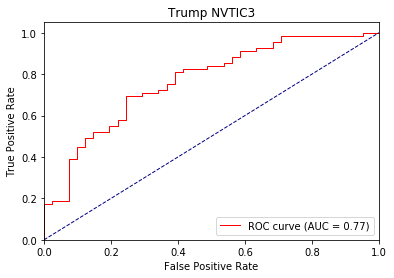

Directory already exists!
dt_nvtic3 1 ap tensor([0.6869, 0.8238]) loss : 0.7411425113677979 0.60173921066092 tid : 200 tg tensor([[1]], device='cuda:0')
TEST dt_nvtic3 1 ap tensor([0.2667, 0.9229]) loss : 0.3439985513687134 0.6364344755808512 tid : 30 tg tensor([[1]], device='cuda:0')
TEST dt_nvtic3 1 ap tensor([0.6835, 0.9511]) loss : 0.47081342339515686 0.5594396432240804 tid : 120 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic3 1 ap tensor([0.8305, 0.8751]) loss : 0.5053749084472656 0.5781609231158148 tid : 390 tg tensor([[0]], device='cuda:0')


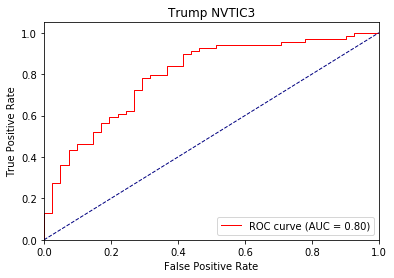

Directory already exists!
dt_nvtic3 2 ap tensor([0.7971, 0.8577]) loss : 0.8295124769210815 0.5319344669754742 tid : 200 tg tensor([[1]], device='cuda:0')
TEST dt_nvtic3 2 ap tensor([0.2667, 0.9229]) loss : 0.2664331793785095 0.6407192349433899 tid : 30 tg tensor([[1]], device='cuda:0')
TEST dt_nvtic3 2 ap tensor([0.6835, 0.9511]) loss : 0.3770301938056946 0.5342296600341797 tid : 120 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic3 2 ap tensor([0.8137, 0.8844]) loss : 0.40847814083099365 0.55320175689987 tid : 390 tg tensor([[0]], device='cuda:0')


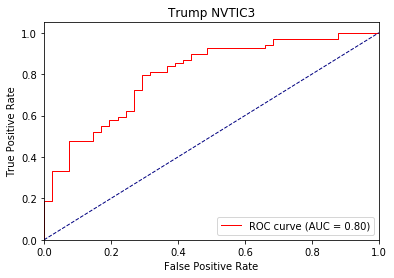

Directory already exists!
dt_nvtic5 0 ap tensor([0.9688, 0.0319]) loss : 0.2703040838241577 0.47909823747781605 tid : 200 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic5 0 ap tensor([1., 0.]) loss : 0.2984117269515991 0.29314808050791424 tid : 30 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic5 0 ap tensor([0.8967, 0.0333]) loss : 0.32652416825294495 0.33088132242361706 tid : 120 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic5 0 ap tensor([0.9428, 0.0939]) loss : 0.2600240707397461 0.3295446592795698 tid : 390 tg tensor([[0]], device='cuda:0')


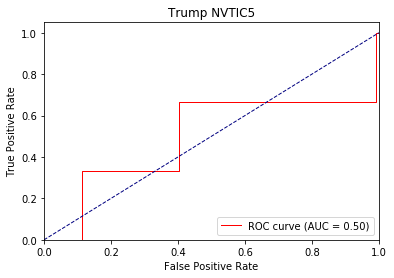

Directory already exists!
dt_nvtic5 1 ap tensor([0.9815, 0.0500]) loss : 0.18030601739883423 0.2951418893572725 tid : 200 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic5 1 ap tensor([1., 0.]) loss : 0.14194262027740479 0.14317849775155386 tid : 30 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic5 1 ap tensor([0.9632, 0.0476]) loss : 0.16938567161560059 0.2113520602385203 tid : 120 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic5 1 ap tensor([0.9734, 0.0848]) loss : 0.11824452877044678 0.21715499630457238 tid : 390 tg tensor([[0]], device='cuda:0')


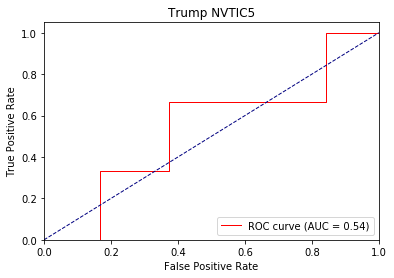

Directory already exists!
dt_nvtic5 2 ap tensor([0.9837, 0.0487]) loss : 0.05388224124908447 0.19082898665421275 tid : 200 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic5 2 ap tensor([1., 0.]) loss : 0.07024872303009033 0.0740896463394165 tid : 30 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic5 2 ap tensor([0.9846, 0.0833]) loss : 0.08496952056884766 0.16271632711092632 tid : 120 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic5 2 ap tensor([0.9858, 0.1091]) loss : 0.0617748498916626 0.1714785800704473 tid : 390 tg tensor([[0]], device='cuda:0')


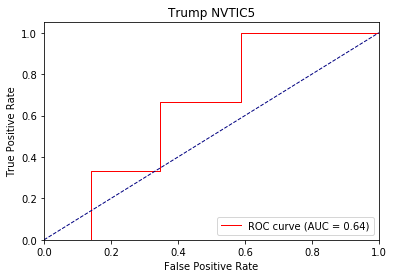

Directory already exists!
dt_nvtic4 0 ap tensor([0.9866, 0.0713]) loss : 0.36523371934890747 0.5982387521792025 tid : 200 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic4 0 ap tensor([1., 0.]) loss : 0.479495108127594 0.37034564713637036 tid : 30 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic4 0 ap tensor([0.9476, 0.0955]) loss : 0.40795618295669556 0.42760208050409954 tid : 120 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic4 0 ap tensor([0.9727, 0.1120]) loss : 0.28545790910720825 0.40705390217938003 tid : 390 tg tensor([[0]], device='cuda:0')


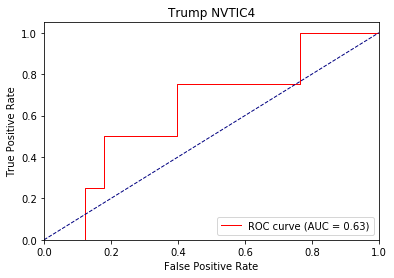

Directory already exists!
dt_nvtic4 1 ap tensor([0.9762, 0.2188]) loss : 0.13363856077194214 0.3251733071618266 tid : 200 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic4 1 ap tensor([1., 0.]) loss : 0.2830221652984619 0.2157029484709104 tid : 30 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic4 1 ap tensor([0.9594, 0.1005]) loss : 0.23669856786727905 0.3199085245529811 tid : 120 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic4 1 ap tensor([0.9756, 0.0930]) loss : 0.1434999704360962 0.2837412515773049 tid : 390 tg tensor([[0]], device='cuda:0')


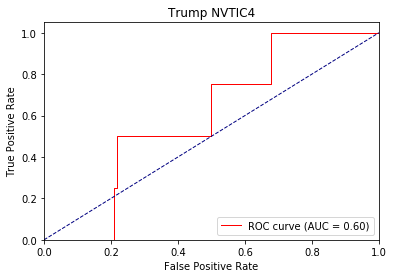

Directory already exists!
dt_nvtic4 2 ap tensor([0.9866, 0.3333]) loss : 0.09228843450546265 0.3058198094367981 tid : 200 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic4 2 ap tensor([1., 0.]) loss : 0.1845005750656128 0.14085798462231955 tid : 30 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic4 2 ap tensor([0.9622, 0.1051]) loss : 0.13958674669265747 0.28253853718439736 tid : 120 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic4 2 ap tensor([0.9756, 0.0866]) loss : 0.08282411098480225 0.23395530973808676 tid : 390 tg tensor([[0]], device='cuda:0')


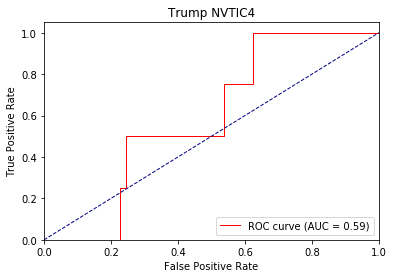

Directory already exists!
dt_interruptions 0 ap tensor([0.9238, 0.1445]) loss : 1.3266100883483887 0.5153718545848941 tid : 200 tg tensor([[1]], device='cuda:0')
TEST dt_interruptions 0 ap tensor([1., 0.]) loss : 0.4891047775745392 0.4099266231060028 tid : 30 tg tensor([[0]], device='cuda:0')
TEST dt_interruptions 0 ap tensor([1., 0.]) loss : 0.42869412899017334 0.381391962369283 tid : 120 tg tensor([[0]], device='cuda:0')
TEST dt_interruptions 0 ap tensor([0.9082, 0.0978]) loss : 0.3556344509124756 0.45159191081795513 tid : 390 tg tensor([[0]], device='cuda:0')


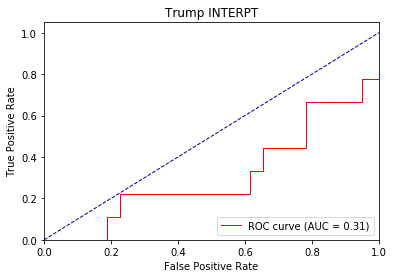

Directory already exists!
dt_interruptions 1 ap tensor([0.9202, 0.1886]) loss : 1.8200278282165527 0.36836204955563745 tid : 200 tg tensor([[1]], device='cuda:0')
TEST dt_interruptions 1 ap tensor([1., 0.]) loss : 0.33601105213165283 0.2640499497453372 tid : 30 tg tensor([[0]], device='cuda:0')
TEST dt_interruptions 1 ap tensor([1., 0.]) loss : 0.23071807622909546 0.2517534057299296 tid : 120 tg tensor([[0]], device='cuda:0')
TEST dt_interruptions 1 ap tensor([0.9145, 0.0895]) loss : 0.18553131818771362 0.37011281108554406 tid : 390 tg tensor([[0]], device='cuda:0')


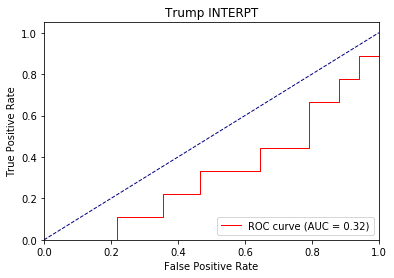

Directory already exists!
dt_interruptions 2 ap tensor([0.8898, 0.2240]) loss : 1.9577386379241943 0.39685254446838214 tid : 200 tg tensor([[1]], device='cuda:0')
TEST dt_interruptions 2 ap tensor([1., 0.]) loss : 0.24045789241790771 0.18557115395863852 tid : 30 tg tensor([[0]], device='cuda:0')
TEST dt_interruptions 2 ap tensor([1., 0.]) loss : 0.13719528913497925 0.18281188408533733 tid : 120 tg tensor([[0]], device='cuda:0')
TEST dt_interruptions 2 ap tensor([0.9199, 0.0895]) loss : 0.11024820804595947 0.3371560226512861 tid : 390 tg tensor([[0]], device='cuda:0')


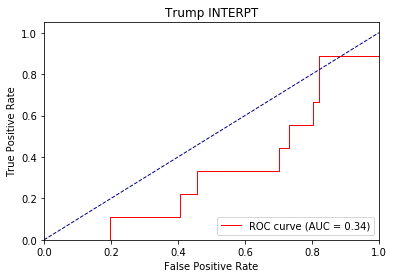

Directory already exists!
dt_lookat2 0 ap tensor([0.3382, 0.4302]) loss : 0.5799046754837036 0.8135647508833144 tid : 400 tg tensor([[0]], device='cuda:0')
dt_lookat2 0 ap tensor([0.2304, 0.5506]) loss : 0.7552183866500854 0.7901268384673379 tid : 200 tg tensor([[1]], device='cuda:0')
TEST dt_lookat2 0 ap tensor([0.7961, 0.8648]) loss : 0.7146651744842529 0.6093777498683414 tid : 180 tg tensor([[1]], device='cuda:0')
TEST dt_lookat2 0 ap tensor([0.7900, 0.8444]) loss : 0.5390245318412781 0.6136919440225114 tid : 210 tg tensor([[0]], device='cuda:0')
TEST dt_lookat2 0 ap tensor([0.8143, 0.8576]) loss : 0.4057222306728363 0.6064512279995701 tid : 270 tg tensor([[1]], device='cuda:0')
TEST dt_lookat2 0 ap tensor([0.7015, 0.8046]) loss : 0.74689120054245 0.625116014984292 tid : 360 tg tensor([[0]], device='cuda:0')
TEST dt_lookat2 0 ap tensor([0.7218, 0.8119]) loss : 0.6556457281112671 0.6231184604794088 tid : 450 tg tensor([[0]], device='cuda:0')


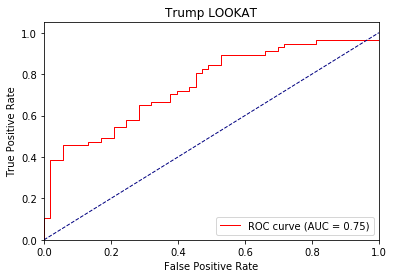

Directory already exists!
dt_lookat2 1 ap tensor([0.8596, 0.9281]) loss : 0.9352817535400391 0.5282612733232478 tid : 400 tg tensor([[0]], device='cuda:0')
dt_lookat2 1 ap tensor([0.8480, 0.9332]) loss : 0.6020538806915283 0.5194782689918855 tid : 200 tg tensor([[1]], device='cuda:0')
TEST dt_lookat2 1 ap tensor([0.7960, 0.8654]) loss : 0.7029042840003967 0.5446726365669353 tid : 180 tg tensor([[1]], device='cuda:0')
TEST dt_lookat2 1 ap tensor([0.8196, 0.8613]) loss : 0.36367911100387573 0.5434245723624562 tid : 210 tg tensor([[0]], device='cuda:0')
TEST dt_lookat2 1 ap tensor([0.8340, 0.8728]) loss : 0.20103198289871216 0.5339760539824503 tid : 270 tg tensor([[1]], device='cuda:0')
TEST dt_lookat2 1 ap tensor([0.7607, 0.8296]) loss : 0.6268853545188904 0.5658544704947673 tid : 360 tg tensor([[0]], device='cuda:0')
TEST dt_lookat2 1 ap tensor([0.7599, 0.8309]) loss : 0.49822449684143066 0.5725187430478106 tid : 450 tg tensor([[0]], device='cuda:0')


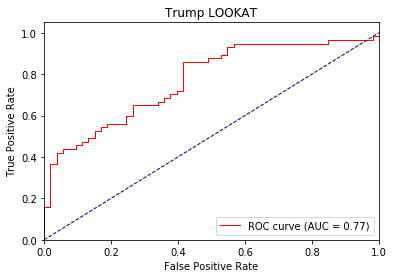

Directory already exists!
dt_lookat2 2 ap tensor([0.8363, 0.9198]) loss : 1.0478875637054443 0.5274796172976494 tid : 400 tg tensor([[0]], device='cuda:0')
dt_lookat2 2 ap tensor([0.8650, 0.9481]) loss : 0.5404120087623596 0.4228514346013586 tid : 200 tg tensor([[1]], device='cuda:0')
TEST dt_lookat2 2 ap tensor([0.7975, 0.8688]) loss : 0.7247512340545654 0.5187093551094467 tid : 180 tg tensor([[1]], device='cuda:0')
TEST dt_lookat2 2 ap tensor([0.8219, 0.8655]) loss : 0.25382328033447266 0.5126402599867 tid : 210 tg tensor([[0]], device='cuda:0')
TEST dt_lookat2 2 ap tensor([0.8355, 0.8750]) loss : 0.12001162767410278 0.5006957681555497 tid : 270 tg tensor([[1]], device='cuda:0')
TEST dt_lookat2 2 ap tensor([0.7747, 0.8391]) loss : 0.5318816900253296 0.5412147162665784 tid : 360 tg tensor([[0]], device='cuda:0')
TEST dt_lookat2 2 ap tensor([0.7672, 0.8361]) loss : 0.3796910345554352 0.5528267393208514 tid : 450 tg tensor([[0]], device='cuda:0')


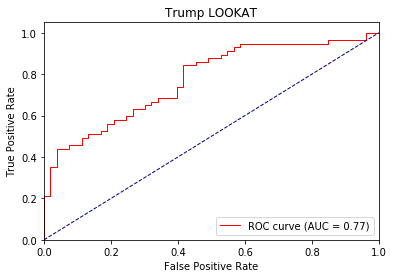

Directory already exists!
dt_brush1 0 ap tensor([0.8439, 0.1329]) loss : 0.5505630373954773 0.6369384696354737 tid : 200 tg tensor([[0]], device='cuda:0')
dt_brush1 0 ap tensor([0.9161, 0.1066]) loss : 0.36216849088668823 0.5046287434441703 tid : 400 tg tensor([[0]], device='cuda:0')
TEST dt_brush1 0 ap tensor([0.9029, 0.1359]) loss : 0.506240963935852 0.4357547180072681 tid : 180 tg tensor([[0]], device='cuda:0')
TEST dt_brush1 0 ap tensor([0.9161, 0.1120]) loss : 0.40120425820350647 0.4283242426639379 tid : 210 tg tensor([[0]], device='cuda:0')
TEST dt_brush1 0 ap tensor([0.8721, 0.0749]) loss : 1.5205168724060059 0.4359894719040185 tid : 270 tg tensor([[1]], device='cuda:0')
TEST dt_brush1 0 ap tensor([0.8774, 0.1001]) loss : 0.4959840774536133 0.44864167923658665 tid : 360 tg tensor([[0]], device='cuda:0')
TEST dt_brush1 0 ap tensor([0.8626, 0.0942]) loss : 0.33770063519477844 0.464102024381811 tid : 450 tg tensor([[0]], device='cuda:0')


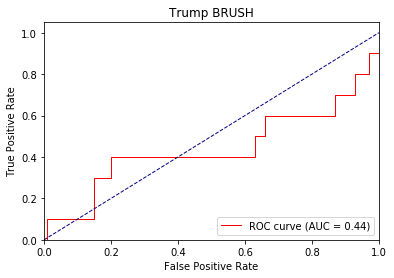

Directory already exists!
dt_brush1 1 ap tensor([0.8112, 0.5370]) loss : 0.36098045110702515 0.5941813458998998 tid : 400 tg tensor([[0]], device='cuda:0')
dt_brush1 1 ap tensor([0.9368, 0.2677]) loss : 0.14344018697738647 0.3762109761704129 tid : 200 tg tensor([[0]], device='cuda:0')
TEST dt_brush1 1 ap tensor([0.9445, 0.2341]) loss : 0.40424200892448425 0.3389486928243895 tid : 180 tg tensor([[0]], device='cuda:0')
TEST dt_brush1 1 ap tensor([0.9513, 0.1691]) loss : 0.24370181560516357 0.32786647871483204 tid : 210 tg tensor([[0]], device='cuda:0')
TEST dt_brush1 1 ap tensor([0.9307, 0.1160]) loss : 1.8317171335220337 0.33762258604953166 tid : 270 tg tensor([[1]], device='cuda:0')
TEST dt_brush1 1 ap tensor([0.9288, 0.1316]) loss : 0.3228662312030792 0.3550853662087884 tid : 360 tg tensor([[0]], device='cuda:0')
TEST dt_brush1 1 ap tensor([0.9135, 0.1090]) loss : 0.20485854148864746 0.37352998449344826 tid : 450 tg tensor([[0]], device='cuda:0')


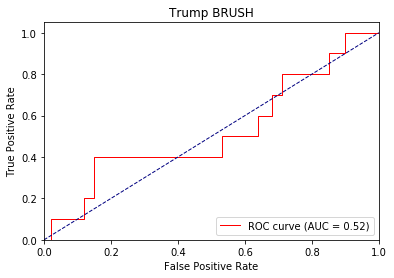

Directory already exists!
dt_brush1 2 ap tensor([0.9531, 0.2249]) loss : 0.08666694164276123 0.3221055241214071 tid : 200 tg tensor([[0]], device='cuda:0')
dt_brush1 2 ap tensor([0.9481, 0.2512]) loss : 0.19333937764167786 0.31555517949163914 tid : 400 tg tensor([[0]], device='cuda:0')
TEST dt_brush1 2 ap tensor([0.9576, 0.2455]) loss : 0.3360354006290436 0.29479776604755503 tid : 180 tg tensor([[0]], device='cuda:0')
TEST dt_brush1 2 ap tensor([0.9659, 0.1831]) loss : 0.15853101015090942 0.2807691859644513 tid : 210 tg tensor([[0]], device='cuda:0')
TEST dt_brush1 2 ap tensor([0.9515, 0.1264]) loss : 2.0063247680664062 0.29061291040035714 tid : 270 tg tensor([[1]], device='cuda:0')
TEST dt_brush1 2 ap tensor([0.9520, 0.1373]) loss : 0.22674596309661865 0.3116703323075469 tid : 360 tg tensor([[0]], device='cuda:0')
TEST dt_brush1 2 ap tensor([0.9402, 0.1167]) loss : 0.1373676061630249 0.3322105919471895 tid : 450 tg tensor([[0]], device='cuda:0')


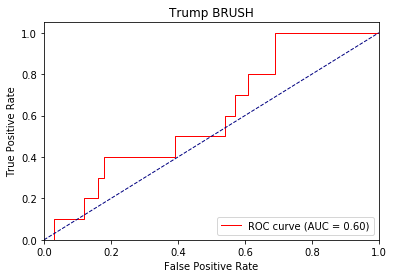

Directory already exists!
dt_nvdis1 0 ap tensor([0.6143, 0.8986]) loss : 0.5963257551193237 0.6270297752830373 tid : 400 tg tensor([[0]], device='cuda:0')
dt_nvdis1 0 ap tensor([0.6030, 0.9457]) loss : 0.3947025537490845 0.5867896650868337 tid : 200 tg tensor([[1]], device='cuda:0')
TEST dt_nvdis1 0 ap tensor([0.3388, 0.9543]) loss : 0.5763014554977417 0.5607929833837457 tid : 180 tg tensor([[1]], device='cuda:0')
TEST dt_nvdis1 0 ap tensor([0.3487, 0.9301]) loss : 0.40326032042503357 0.5691824361335399 tid : 210 tg tensor([[1]], device='cuda:0')
TEST dt_nvdis1 0 ap tensor([0.4326, 0.9180]) loss : 0.9092473983764648 0.570564809075573 tid : 270 tg tensor([[1]], device='cuda:0')
TEST dt_nvdis1 0 ap tensor([0.4338, 0.9287]) loss : 0.36330103874206543 0.5551734453355762 tid : 360 tg tensor([[1]], device='cuda:0')
TEST dt_nvdis1 0 ap tensor([0.4308, 0.9237]) loss : 0.3140699863433838 0.5488245228324273 tid : 450 tg tensor([[1]], device='cuda:0')


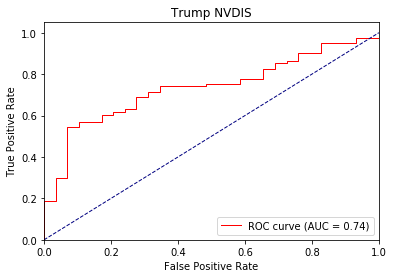

Directory already exists!
dt_nvdis1 1 ap tensor([0.6572, 0.9494]) loss : 0.7210270762443542 0.48538425208433816 tid : 400 tg tensor([[0]], device='cuda:0')
dt_nvdis1 1 ap tensor([0.6199, 0.9470]) loss : 0.2649250030517578 0.49084376008784186 tid : 200 tg tensor([[1]], device='cuda:0')
TEST dt_nvdis1 1 ap tensor([0.3245, 0.9598]) loss : 0.5295010805130005 0.4941320725389429 tid : 180 tg tensor([[1]], device='cuda:0')
TEST dt_nvdis1 1 ap tensor([0.3354, 0.9327]) loss : 0.23982876539230347 0.5096939261569533 tid : 210 tg tensor([[1]], device='cuda:0')
TEST dt_nvdis1 1 ap tensor([0.4046, 0.9183]) loss : 0.9694001078605652 0.5190705385124474 tid : 270 tg tensor([[1]], device='cuda:0')
TEST dt_nvdis1 1 ap tensor([0.4057, 0.9257]) loss : 0.22178047895431519 0.5016276483804407 tid : 360 tg tensor([[1]], device='cuda:0')
TEST dt_nvdis1 1 ap tensor([0.4076, 0.9134]) loss : 0.18915849924087524 0.5007530366531526 tid : 450 tg tensor([[1]], device='cuda:0')


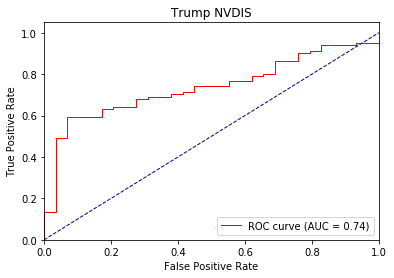

Directory already exists!
dt_nvdis1 2 ap tensor([0.7493, 0.9786]) loss : 0.2172732949256897 0.40978449165821074 tid : 200 tg tensor([[1]], device='cuda:0')
dt_nvdis1 2 ap tensor([0.8396, 0.9672]) loss : 0.7580800652503967 0.39725673361258074 tid : 400 tg tensor([[0]], device='cuda:0')
TEST dt_nvdis1 2 ap tensor([0.3090, 0.9578]) loss : 0.5048294067382812 0.45858317855242137 tid : 180 tg tensor([[1]], device='cuda:0')
TEST dt_nvdis1 2 ap tensor([0.3327, 0.9343]) loss : 0.15518856048583984 0.4796502139679221 tid : 210 tg tensor([[1]], device='cuda:0')
TEST dt_nvdis1 2 ap tensor([0.4153, 0.9248]) loss : 1.0274423360824585 0.49278547314175386 tid : 270 tg tensor([[1]], device='cuda:0')
TEST dt_nvdis1 2 ap tensor([0.4125, 0.9278]) loss : 0.14899426698684692 0.474805817217894 tid : 360 tg tensor([[1]], device='cuda:0')
TEST dt_nvdis1 2 ap tensor([0.4041, 0.9083]) loss : 0.12788069248199463 0.47890732595414826 tid : 450 tg tensor([[1]], device='cuda:0')


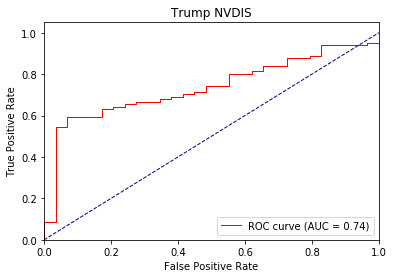

Directory already exists!
dt_lookat3 0 ap tensor([0.1556, 0.8369]) loss : 0.4763534963130951 0.6403644337103918 tid : 200 tg tensor([[1]], device='cuda:0')
dt_lookat3 0 ap tensor([0.1517, 0.7944]) loss : 0.4511725902557373 0.6088578619657119 tid : 400 tg tensor([[1]], device='cuda:0')
TEST dt_lookat3 0 ap tensor([0.2065, 0.7930]) loss : 0.6665152907371521 0.5767718972386541 tid : 180 tg tensor([[1]], device='cuda:0')
TEST dt_lookat3 0 ap tensor([0.2308, 0.8084]) loss : 0.5398522615432739 0.5713689971801846 tid : 210 tg tensor([[1]], device='cuda:0')
TEST dt_lookat3 0 ap tensor([0.1997, 0.8270]) loss : 0.508817195892334 0.561442131013201 tid : 270 tg tensor([[1]], device='cuda:0')
TEST dt_lookat3 0 ap tensor([0.1863, 0.8602]) loss : 0.3767964839935303 0.5460071844953887 tid : 360 tg tensor([[1]], device='cuda:0')
TEST dt_lookat3 0 ap tensor([0.1349, 0.8921]) loss : 0.44871729612350464 0.5330731772413158 tid : 450 tg tensor([[1]], device='cuda:0')


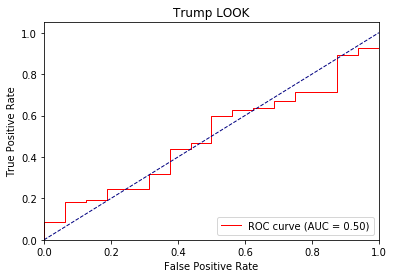

Directory already exists!
dt_lookat3 1 ap tensor([0.2703, 0.9136]) loss : 0.40812262892723083 0.5249028448015451 tid : 400 tg tensor([[1]], device='cuda:0')
dt_lookat3 1 ap tensor([0.3324, 0.9278]) loss : 0.165249764919281 0.4841115805678643 tid : 200 tg tensor([[1]], device='cuda:0')
TEST dt_lookat3 1 ap tensor([0.2661, 0.8326]) loss : 0.5467966794967651 0.5333605167028066 tid : 180 tg tensor([[1]], device='cuda:0')
TEST dt_lookat3 1 ap tensor([0.3130, 0.8435]) loss : 0.32935646176338196 0.5200410575367683 tid : 210 tg tensor([[1]], device='cuda:0')
TEST dt_lookat3 1 ap tensor([0.2666, 0.8582]) loss : 0.5272233486175537 0.5060679002812034 tid : 270 tg tensor([[1]], device='cuda:0')
TEST dt_lookat3 1 ap tensor([0.2525, 0.8865]) loss : 0.22698244452476501 0.4774615164373962 tid : 360 tg tensor([[1]], device='cuda:0')
TEST dt_lookat3 1 ap tensor([0.1718, 0.9132]) loss : 0.2915598452091217 0.4488779791075774 tid : 450 tg tensor([[1]], device='cuda:0')


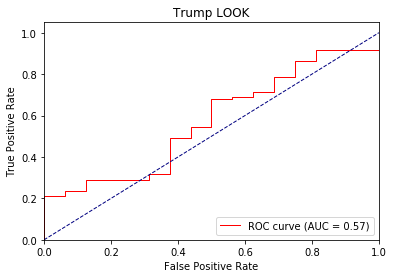

Directory already exists!
dt_lookat3 2 ap tensor([0.4947, 0.9467]) loss : 0.13080883026123047 0.435243031625584 tid : 200 tg tensor([[1]], device='cuda:0')
dt_lookat3 2 ap tensor([0.4771, 0.9441]) loss : 0.287162721157074 0.4448595868818688 tid : 400 tg tensor([[1]], device='cuda:0')
TEST dt_lookat3 2 ap tensor([0.2874, 0.8407]) loss : 0.45777368545532227 0.5265199147366189 tid : 180 tg tensor([[1]], device='cuda:0')
TEST dt_lookat3 2 ap tensor([0.3408, 0.8534]) loss : 0.20679891109466553 0.5064251679320668 tid : 210 tg tensor([[1]], device='cuda:0')
TEST dt_lookat3 2 ap tensor([0.2926, 0.8674]) loss : 0.5417988300323486 0.4881975624644965 tid : 270 tg tensor([[1]], device='cuda:0')
TEST dt_lookat3 2 ap tensor([0.2739, 0.8910]) loss : 0.1511775255203247 0.4516872679683524 tid : 360 tg tensor([[1]], device='cuda:0')
TEST dt_lookat3 2 ap tensor([0.1846, 0.9152]) loss : 0.19906151294708252 0.41078020587111963 tid : 450 tg tensor([[1]], device='cuda:0')


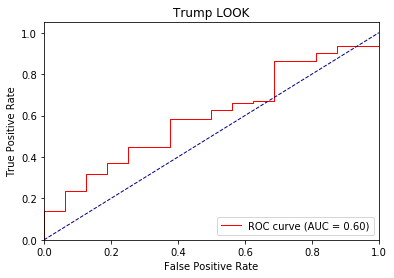

Directory already exists!
dt_eyebrow 0 ap tensor([0.0985, 0.8961]) loss : 0.6014416217803955 0.6947009968803304 tid : 400 tg tensor([[1]], device='cuda:0')
dt_eyebrow 0 ap tensor([0.0938, 0.9299]) loss : 0.9734027981758118 0.6350055127046429 tid : 200 tg tensor([[0]], device='cuda:0')
TEST dt_eyebrow 0 ap tensor([0.7132, 0.6406]) loss : 0.5842483639717102 0.7259725759158263 tid : 180 tg tensor([[1]], device='cuda:0')
TEST dt_eyebrow 0 ap tensor([0.7465, 0.6194]) loss : 0.5054522752761841 0.7308807996816413 tid : 210 tg tensor([[1]], device='cuda:0')
TEST dt_eyebrow 0 ap tensor([0.7100, 0.5512]) loss : 1.0572896003723145 0.7420540985308195 tid : 270 tg tensor([[0]], device='cuda:0')
TEST dt_eyebrow 0 ap tensor([0.7800, 0.6125]) loss : 0.3708997070789337 0.7247905559103254 tid : 360 tg tensor([[1]], device='cuda:0')
TEST dt_eyebrow 0 ap tensor([0.6181, 0.6621]) loss : 0.4953599274158478 0.6868969900439484 tid : 450 tg tensor([[1]], device='cuda:0')


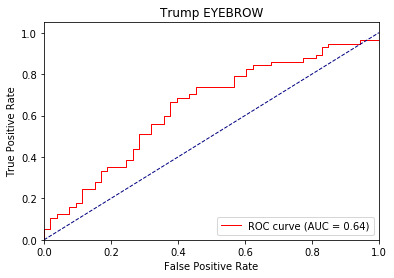

Directory already exists!
dt_eyebrow 1 ap tensor([0.1332, 0.9239]) loss : 1.33254873752594 0.4321537948634526 tid : 200 tg tensor([[0]], device='cuda:0')
dt_eyebrow 1 ap tensor([0.1173, 0.9437]) loss : 0.3402157425880432 0.41596157600482303 tid : 400 tg tensor([[1]], device='cuda:0')
TEST dt_eyebrow 1 ap tensor([0.7023, 0.7212]) loss : 0.442033976316452 0.857735434899459 tid : 180 tg tensor([[1]], device='cuda:0')
TEST dt_eyebrow 1 ap tensor([0.7546, 0.7075]) loss : 0.3038470149040222 0.8641453115052955 tid : 210 tg tensor([[1]], device='cuda:0')
TEST dt_eyebrow 1 ap tensor([0.6923, 0.6435]) loss : 1.400538682937622 0.8856341127763715 tid : 270 tg tensor([[0]], device='cuda:0')
TEST dt_eyebrow 1 ap tensor([0.7622, 0.7076]) loss : 0.2155175805091858 0.8579902699295904 tid : 360 tg tensor([[1]], device='cuda:0')
TEST dt_eyebrow 1 ap tensor([0.6096, 0.7372]) loss : 0.31360509991645813 0.7596923645698663 tid : 450 tg tensor([[1]], device='cuda:0')


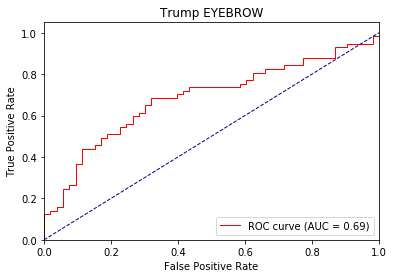

Directory already exists!
dt_eyebrow 2 ap tensor([0.2259, 0.9734]) loss : 0.2486041784286499 0.3389794919639826 tid : 400 tg tensor([[1]], device='cuda:0')
dt_eyebrow 2 ap tensor([0.1772, 0.9602]) loss : 2.2331840991973877 0.32404140592495795 tid : 200 tg tensor([[0]], device='cuda:0')
TEST dt_eyebrow 2 ap tensor([0.7367, 0.7901]) loss : 0.3517049252986908 1.0000742859131582 tid : 180 tg tensor([[1]], device='cuda:0')
TEST dt_eyebrow 2 ap tensor([0.7890, 0.7906]) loss : 0.19271165132522583 1.005659510229909 tid : 210 tg tensor([[1]], device='cuda:0')
TEST dt_eyebrow 2 ap tensor([0.7166, 0.7268]) loss : 1.6221903562545776 1.0320793949721152 tid : 270 tg tensor([[0]], device='cuda:0')
TEST dt_eyebrow 2 ap tensor([0.7724, 0.7852]) loss : 0.1375257968902588 0.9986937705060126 tid : 360 tg tensor([[1]], device='cuda:0')
TEST dt_eyebrow 2 ap tensor([0.6229, 0.7915]) loss : 0.20427566766738892 0.8546936120649781 tid : 450 tg tensor([[1]], device='cuda:0')


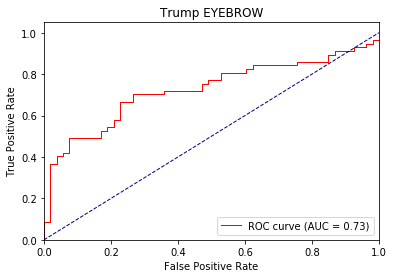

Directory already exists!
dt_atface 0 ap tensor([0.7350, 0.8872]) loss : 0.48306208848953247 0.5875349480575985 tid : 200 tg tensor([[1]], device='cuda:0')
dt_atface 0 ap tensor([0.8159, 0.8796]) loss : 0.5511475205421448 0.5646072901268997 tid : 400 tg tensor([[0]], device='cuda:0')
TEST dt_atface 0 ap tensor([0.3889, 0.8859]) loss : 0.7529019117355347 0.6032332198039906 tid : 180 tg tensor([[1]], device='cuda:0')
TEST dt_atface 0 ap tensor([0.4677, 0.8704]) loss : 0.36087965965270996 0.596824377082115 tid : 210 tg tensor([[1]], device='cuda:0')
TEST dt_atface 0 ap tensor([0.4240, 0.8743]) loss : 1.0644668340682983 0.6019192651698464 tid : 270 tg tensor([[1]], device='cuda:0')
TEST dt_atface 0 ap tensor([0.4498, 0.8553]) loss : 0.3720752000808716 0.6050694765339435 tid : 360 tg tensor([[1]], device='cuda:0')
TEST dt_atface 0 ap tensor([0.4757, 0.8437]) loss : 0.3891182541847229 0.5884630047913754 tid : 450 tg tensor([[1]], device='cuda:0')


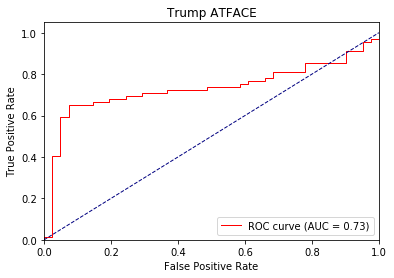

Directory already exists!
dt_atface 1 ap tensor([0.8198, 0.9459]) loss : 0.545364499092102 0.4724545507661758 tid : 400 tg tensor([[0]], device='cuda:0')
dt_atface 1 ap tensor([0.8677, 0.9127]) loss : 0.29578298330307007 0.46717108119586936 tid : 200 tg tensor([[1]], device='cuda:0')
TEST dt_atface 1 ap tensor([0.3858, 0.8934]) loss : 0.815609335899353 0.5858375301232209 tid : 180 tg tensor([[1]], device='cuda:0')
TEST dt_atface 1 ap tensor([0.4665, 0.8776]) loss : 0.23598212003707886 0.5709643447121908 tid : 210 tg tensor([[1]], device='cuda:0')
TEST dt_atface 1 ap tensor([0.4289, 0.8813]) loss : 1.3087341785430908 0.5787297231063508 tid : 270 tg tensor([[1]], device='cuda:0')
TEST dt_atface 1 ap tensor([0.4543, 0.8553]) loss : 0.2548629939556122 0.5867933647733339 tid : 360 tg tensor([[1]], device='cuda:0')
TEST dt_atface 1 ap tensor([0.4741, 0.8402]) loss : 0.2737635374069214 0.564866099393729 tid : 450 tg tensor([[1]], device='cuda:0')


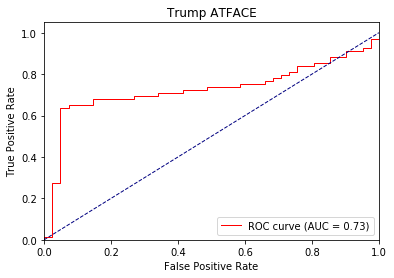

Directory already exists!
dt_atface 2 ap tensor([0.8866, 0.9345]) loss : 0.39721161127090454 0.4054692519195189 tid : 400 tg tensor([[0]], device='cuda:0')
dt_atface 2 ap tensor([0.8502, 0.9224]) loss : 0.2008320689201355 0.4114699802440632 tid : 200 tg tensor([[1]], device='cuda:0')
TEST dt_atface 2 ap tensor([0.3767, 0.8913]) loss : 0.8697700500488281 0.586890426841942 tid : 180 tg tensor([[1]], device='cuda:0')
TEST dt_atface 2 ap tensor([0.4575, 0.8751]) loss : 0.16443049907684326 0.5649060149525487 tid : 210 tg tensor([[1]], device='cuda:0')
TEST dt_atface 2 ap tensor([0.4255, 0.8805]) loss : 1.5195200443267822 0.5731854402182395 tid : 270 tg tensor([[1]], device='cuda:0')
TEST dt_atface 2 ap tensor([0.4532, 0.8577]) loss : 0.18969130516052246 0.5852360784167975 tid : 360 tg tensor([[1]], device='cuda:0')
TEST dt_atface 2 ap tensor([0.4713, 0.8448]) loss : 0.20541906356811523 0.5589517908866959 tid : 450 tg tensor([[1]], device='cuda:0')


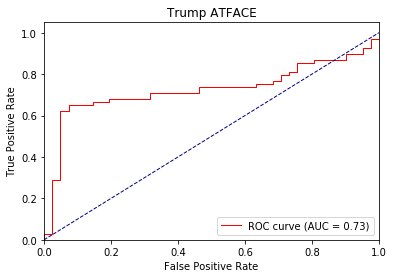

Directory already exists!
dt_feface 0 ap tensor([1., 0.]) loss : 0.7696585059165955 0.7985269507665312 tid : 200 tg tensor([[0]], device='cuda:0')
dt_feface 0 ap tensor([1., 0.]) loss : 0.6770292520523071 0.7562148194564017 tid : 400 tg tensor([[0]], device='cuda:0')
TEST dt_feface 0 ap tensor([0.9992, 0.5000]) loss : 0.5698951482772827 0.44447589081686895 tid : 180 tg tensor([[0]], device='cuda:0')
TEST dt_feface 0 ap tensor([0.9989, 0.3333]) loss : 0.5015580654144287 0.44929965706758723 tid : 210 tg tensor([[0]], device='cuda:0')
TEST dt_feface 0 ap tensor([0.9994, 0.3333]) loss : 0.3830729126930237 0.453303595383962 tid : 270 tg tensor([[0]], device='cuda:0')
TEST dt_feface 0 ap tensor([0.9992, 0.2000]) loss : 0.5025676488876343 0.4588130296955646 tid : 360 tg tensor([[0]], device='cuda:0')
TEST dt_feface 0 ap tensor([0.9994, 0.1429]) loss : 0.4388022720813751 0.46545129291939014 tid : 450 tg tensor([[0]], device='cuda:0')


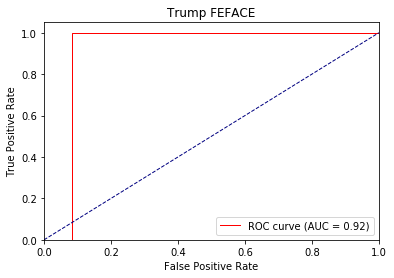

Directory already exists!
dt_feface 1 ap tensor([1., 0.]) loss : 0.337155282497406 0.3928930870812349 tid : 400 tg tensor([[0]], device='cuda:0')
dt_feface 1 ap tensor([1., 0.]) loss : 0.23764467239379883 0.34848083935531915 tid : 200 tg tensor([[0]], device='cuda:0')
TEST dt_feface 1 ap tensor([0.9992, 0.5000]) loss : 0.35816097259521484 0.2300062993088284 tid : 180 tg tensor([[0]], device='cuda:0')
TEST dt_feface 1 ap tensor([0.9983, 0.2500]) loss : 0.25043338537216187 0.23111469315928082 tid : 210 tg tensor([[0]], device='cuda:0')
TEST dt_feface 1 ap tensor([0.9980, 0.1429]) loss : 0.14310145378112793 0.2299583815691764 tid : 270 tg tensor([[0]], device='cuda:0')
TEST dt_feface 1 ap tensor([0.9983, 0.1111]) loss : 0.2768842577934265 0.23271871872351202 tid : 360 tg tensor([[0]], device='cuda:0')
TEST dt_feface 1 ap tensor([0.9987, 0.0769]) loss : 0.23658019304275513 0.2397229840057065 tid : 450 tg tensor([[0]], device='cuda:0')


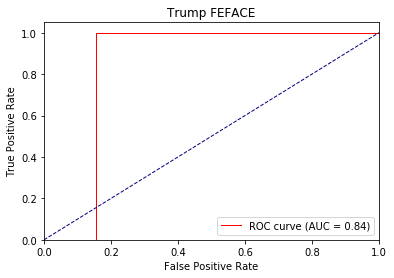

Directory already exists!
dt_feface 2 ap tensor([1., 0.]) loss : 0.059140801429748535 0.14652664801537596 tid : 200 tg tensor([[0]], device='cuda:0')
dt_feface 2 ap tensor([1., 0.]) loss : 0.07482445240020752 0.1458895252958225 tid : 400 tg tensor([[0]], device='cuda:0')
TEST dt_feface 2 ap tensor([0.9977, 0.2500]) loss : 0.21106266975402832 0.13932085037231445 tid : 180 tg tensor([[0]], device='cuda:0')
TEST dt_feface 2 ap tensor([0.9971, 0.1667]) loss : 0.1211007833480835 0.1359478942183561 tid : 210 tg tensor([[0]], device='cuda:0')
TEST dt_feface 2 ap tensor([0.9970, 0.1000]) loss : 0.05498385429382324 0.1295002311990972 tid : 270 tg tensor([[0]], device='cuda:0')
TEST dt_feface 2 ap tensor([0.9971, 0.0714]) loss : 0.1503961682319641 0.12687929919068242 tid : 360 tg tensor([[0]], device='cuda:0')
TEST dt_feface 2 ap tensor([0.9973, 0.0417]) loss : 0.1270478367805481 0.13021856787228825 tid : 450 tg tensor([[0]], device='cuda:0')


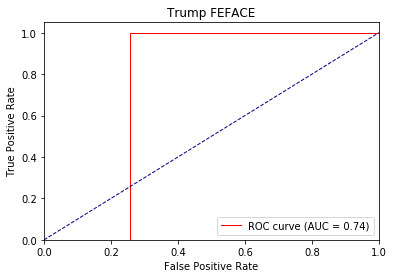

Directory already exists!
dt_hrface 0 ap tensor([0.9708, 0.3159]) loss : 0.565263569355011 0.7155989161853132 tid : 200 tg tensor([[0]], device='cuda:0')
dt_hrface 0 ap tensor([0.9278, 0.2108]) loss : 0.4406028091907501 0.6040469783636713 tid : 400 tg tensor([[0]], device='cuda:0')
TEST dt_hrface 0 ap tensor([0.9869, 0.1667]) loss : 0.5166824460029602 0.4287623996670182 tid : 180 tg tensor([[0]], device='cuda:0')
TEST dt_hrface 0 ap tensor([0.9877, 0.1339]) loss : 0.3915410041809082 0.4325208102547845 tid : 210 tg tensor([[0]], device='cuda:0')
TEST dt_hrface 0 ap tensor([0.9897, 0.0943]) loss : 0.4524618089199066 0.4263588885466258 tid : 270 tg tensor([[0]], device='cuda:0')
TEST dt_hrface 0 ap tensor([0.9698, 0.0625]) loss : 0.4394111633300781 0.4382019445929729 tid : 360 tg tensor([[0]], device='cuda:0')
TEST dt_hrface 0 ap tensor([0.9757, 0.0774]) loss : 0.39294469356536865 0.43936835846515615 tid : 450 tg tensor([[0]], device='cuda:0')


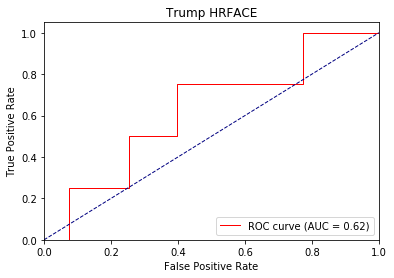

Directory already exists!
dt_hrface 1 ap tensor([0.9684, 0.3776]) loss : 0.19614654779434204 0.4017042838907861 tid : 200 tg tensor([[0]], device='cuda:0')
dt_hrface 1 ap tensor([0.9605, 0.3698]) loss : 0.2667948603630066 0.3861633997473984 tid : 400 tg tensor([[0]], device='cuda:0')
TEST dt_hrface 1 ap tensor([0.9898, 0.2000]) loss : 0.3962523639202118 0.29508073507128535 tid : 180 tg tensor([[0]], device='cuda:0')
TEST dt_hrface 1 ap tensor([0.9899, 0.1548]) loss : 0.21293413639068604 0.29427969455718994 tid : 210 tg tensor([[0]], device='cuda:0')
TEST dt_hrface 1 ap tensor([0.9913, 0.1111]) loss : 0.2860247492790222 0.2838570695174368 tid : 270 tg tensor([[0]], device='cuda:0')
TEST dt_hrface 1 ap tensor([0.9780, 0.0773]) loss : 0.2533498704433441 0.2993364313118894 tid : 360 tg tensor([[0]], device='cuda:0')
TEST dt_hrface 1 ap tensor([0.9836, 0.3087]) loss : 0.2182842493057251 0.2961512301305328 tid : 450 tg tensor([[0]], device='cuda:0')


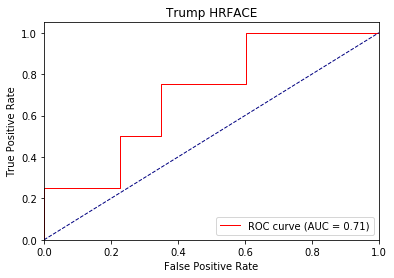

Directory already exists!
dt_hrface 2 ap tensor([1., 0.]) loss : 0.2587289810180664 0.27332641184329987 tid : 400 tg tensor([[0]], device='cuda:0')
dt_hrface 2 ap tensor([0.9593, 0.4045]) loss : 0.0986013412475586 0.33666967516820107 tid : 200 tg tensor([[0]], device='cuda:0')
TEST dt_hrface 2 ap tensor([0.9891, 0.1825]) loss : 0.3175409436225891 0.2395637566978867 tid : 180 tg tensor([[0]], device='cuda:0')
TEST dt_hrface 2 ap tensor([0.9894, 0.1465]) loss : 0.12156683206558228 0.23513187502705774 tid : 210 tg tensor([[0]], device='cuda:0')
TEST dt_hrface 2 ap tensor([0.9914, 0.1080]) loss : 0.20839208364486694 0.22073219481267428 tid : 270 tg tensor([[0]], device='cuda:0')
TEST dt_hrface 2 ap tensor([0.9797, 0.0774]) loss : 0.1554364562034607 0.23782590073598942 tid : 360 tg tensor([[0]], device='cuda:0')
TEST dt_hrface 2 ap tensor([0.9844, 0.3090]) loss : 0.13347011804580688 0.2293539194747655 tid : 450 tg tensor([[0]], device='cuda:0')


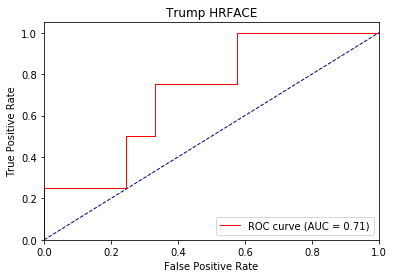

Directory already exists!
dt_saface 0 ap tensor([1., 0.]) loss : 0.34344223141670227 0.45991889395556607 tid : 200 tg tensor([[0]], device='cuda:0')
dt_saface 0 ap tensor([1., 0.]) loss : 0.32727110385894775 0.4274890772934288 tid : 400 tg tensor([[0]], device='cuda:0')
TEST dt_saface 0 ap tensor([1., 0.]) loss : 0.34905949234962463 0.29093901692210017 tid : 180 tg tensor([[0]], device='cuda:0')
TEST dt_saface 0 ap tensor([1., 0.]) loss : 0.39631563425064087 0.2951150210790856 tid : 210 tg tensor([[0]], device='cuda:0')
TEST dt_saface 0 ap tensor([1., 0.]) loss : 0.21432918310165405 0.2968372880366811 tid : 270 tg tensor([[0]], device='cuda:0')
TEST dt_saface 0 ap tensor([1., 0.]) loss : 0.331682413816452 0.2994700292466392 tid : 360 tg tensor([[0]], device='cuda:0')
TEST dt_saface 0 ap tensor([1., 0.]) loss : 0.35986483097076416 0.3056595412769703 tid : 450 tg tensor([[0]], device='cuda:0')


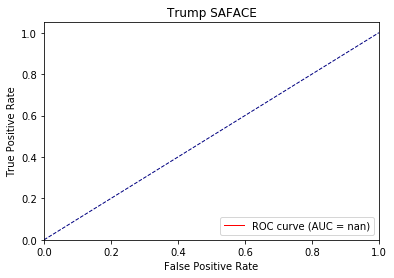

Directory already exists!
dt_saface 1 ap tensor([1., 0.]) loss : 0.17023807764053345 0.2089095745728985 tid : 400 tg tensor([[0]], device='cuda:0')
dt_saface 1 ap tensor([1., 0.]) loss : 0.09756779670715332 0.19592674742557611 tid : 200 tg tensor([[0]], device='cuda:0')
TEST dt_saface 1 ap tensor([1., 0.]) loss : 0.20101189613342285 0.12469154113047831 tid : 180 tg tensor([[0]], device='cuda:0')
TEST dt_saface 1 ap tensor([1., 0.]) loss : 0.1897771954536438 0.12852519473364188 tid : 210 tg tensor([[0]], device='cuda:0')
TEST dt_saface 1 ap tensor([1., 0.]) loss : 0.08615267276763916 0.13103219814467848 tid : 270 tg tensor([[0]], device='cuda:0')
TEST dt_saface 1 ap tensor([1., 0.]) loss : 0.16288268566131592 0.13472285908712467 tid : 360 tg tensor([[0]], device='cuda:0')
TEST dt_saface 1 ap tensor([1., 0.]) loss : 0.18382441997528076 0.14437276425987783 tid : 450 tg tensor([[0]], device='cuda:0')


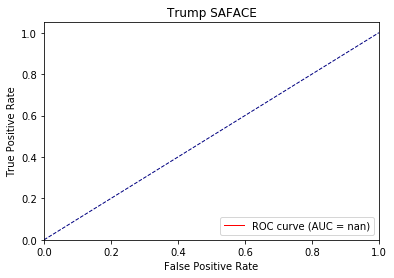

Directory already exists!
dt_saface 2 ap tensor([1., 0.]) loss : 0.02694094181060791 0.08540915387548063 tid : 200 tg tensor([[0]], device='cuda:0')
dt_saface 2 ap tensor([1., 0.]) loss : 0.04047751426696777 0.08537456442232001 tid : 400 tg tensor([[0]], device='cuda:0')
TEST dt_saface 2 ap tensor([1., 0.]) loss : 0.11475372314453125 0.05311519068640631 tid : 180 tg tensor([[0]], device='cuda:0')
TEST dt_saface 2 ap tensor([1., 0.]) loss : 0.09439635276794434 0.0559055347775304 tid : 210 tg tensor([[0]], device='cuda:0')
TEST dt_saface 2 ap tensor([1., 0.]) loss : 0.035772085189819336 0.05815579180131879 tid : 270 tg tensor([[0]], device='cuda:0')
TEST dt_saface 2 ap tensor([1., 0.]) loss : 0.0835345983505249 0.06079913193071392 tid : 360 tg tensor([[0]], device='cuda:0')
TEST dt_saface 2 ap tensor([1., 0.]) loss : 0.09562015533447266 0.0696072777112325 tid : 450 tg tensor([[0]], device='cuda:0')


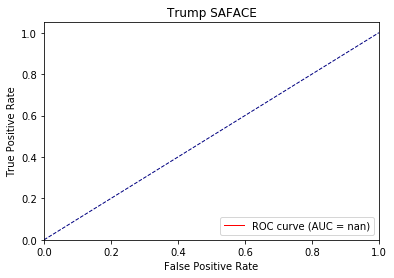

Directory already exists!
dt_neuface 0 ap tensor([0.8400, 0.2998]) loss : 0.6542646884918213 0.6768482807394746 tid : 400 tg tensor([[1]], device='cuda:0')
dt_neuface 0 ap tensor([0.8778, 0.3670]) loss : 0.41586047410964966 0.6377412441643802 tid : 200 tg tensor([[0]], device='cuda:0')
TEST dt_neuface 0 ap tensor([0.9133, 0.3525]) loss : 0.6801691651344299 0.6009447308810981 tid : 180 tg tensor([[0]], device='cuda:0')
TEST dt_neuface 0 ap tensor([0.8861, 0.4729]) loss : 0.6578084826469421 0.6105161385480747 tid : 210 tg tensor([[0]], device='cuda:0')
TEST dt_neuface 0 ap tensor([0.8842, 0.4457]) loss : 0.7584193348884583 0.611778357049875 tid : 270 tg tensor([[0]], device='cuda:0')
TEST dt_neuface 0 ap tensor([0.8476, 0.4454]) loss : 0.4909888207912445 0.619095589073611 tid : 360 tg tensor([[0]], device='cuda:0')
TEST dt_neuface 0 ap tensor([0.8593, 0.4338]) loss : 0.38595569133758545 0.6120342049333785 tid : 450 tg tensor([[0]], device='cuda:0')


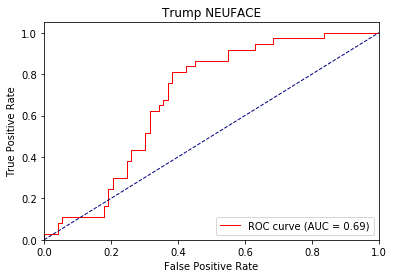

Directory already exists!
dt_neuface 1 ap tensor([0.9297, 0.6725]) loss : 0.6633414626121521 0.533889625332143 tid : 400 tg tensor([[1]], device='cuda:0')
dt_neuface 1 ap tensor([0.9246, 0.6387]) loss : 0.2892346978187561 0.5336027712591233 tid : 200 tg tensor([[0]], device='cuda:0')
TEST dt_neuface 1 ap tensor([0.9236, 0.4023]) loss : 0.6262508034706116 0.5319816888989629 tid : 180 tg tensor([[0]], device='cuda:0')
TEST dt_neuface 1 ap tensor([0.9025, 0.5126]) loss : 0.4134082496166229 0.5455195009708405 tid : 210 tg tensor([[0]], device='cuda:0')
TEST dt_neuface 1 ap tensor([0.8969, 0.4595]) loss : 0.7881327867507935 0.5510914100889575 tid : 270 tg tensor([[0]], device='cuda:0')
TEST dt_neuface 1 ap tensor([0.8667, 0.4623]) loss : 0.2894939184188843 0.5696034624542988 tid : 360 tg tensor([[0]], device='cuda:0')
TEST dt_neuface 1 ap tensor([0.8728, 0.4503]) loss : 0.24229007959365845 0.5625712176163992 tid : 450 tg tensor([[0]], device='cuda:0')


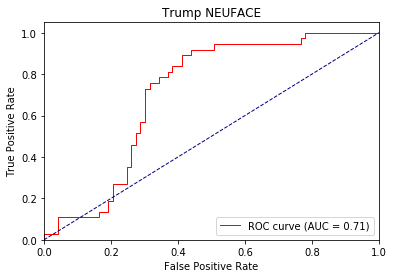

Directory already exists!
dt_neuface 2 ap tensor([0.9381, 0.6614]) loss : 0.6978570818901062 0.453270714879036 tid : 400 tg tensor([[1]], device='cuda:0')
dt_neuface 2 ap tensor([0.9389, 0.6664]) loss : 0.14326131343841553 0.45176323608115865 tid : 200 tg tensor([[0]], device='cuda:0')
TEST dt_neuface 2 ap tensor([0.9181, 0.3646]) loss : 0.6034178733825684 0.502240394418304 tid : 180 tg tensor([[0]], device='cuda:0')
TEST dt_neuface 2 ap tensor([0.9000, 0.4900]) loss : 0.2788907289505005 0.5167956400749295 tid : 210 tg tensor([[0]], device='cuda:0')
TEST dt_neuface 2 ap tensor([0.8952, 0.4439]) loss : 0.8455437421798706 0.5239379155008417 tid : 270 tg tensor([[0]], device='cuda:0')
TEST dt_neuface 2 ap tensor([0.8711, 0.4522]) loss : 0.1916981339454651 0.551949379309802 tid : 360 tg tensor([[0]], device='cuda:0')
TEST dt_neuface 2 ap tensor([0.8765, 0.4456]) loss : 0.16907042264938354 0.5450745754771762 tid : 450 tg tensor([[0]], device='cuda:0')


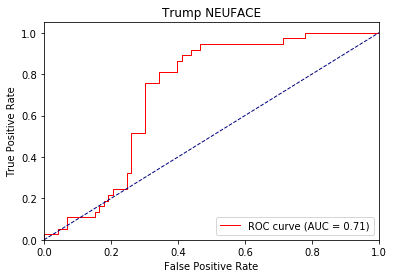

Directory already exists!
dt_inapprop 0 ap tensor([1., 0.]) loss : 0.6278878450393677 0.6834945976734161 tid : 400 tg tensor([[0]], device='cuda:0')
dt_inapprop 0 ap tensor([0.9630, 0.0496]) loss : 0.33774644136428833 0.5332385687644665 tid : 200 tg tensor([[0]], device='cuda:0')
TEST dt_inapprop 0 ap tensor([0.8830, 0.5342]) loss : 1.0321590900421143 0.4930251474316056 tid : 180 tg tensor([[1]], device='cuda:0')
TEST dt_inapprop 0 ap tensor([0.8998, 0.4481]) loss : 0.5059621334075928 0.4888190758782764 tid : 210 tg tensor([[0]], device='cuda:0')
TEST dt_inapprop 0 ap tensor([0.9133, 0.3416]) loss : 0.27158641815185547 0.46981584712078694 tid : 270 tg tensor([[0]], device='cuda:0')
TEST dt_inapprop 0 ap tensor([0.9210, 0.3530]) loss : 1.023827075958252 0.4666532752379565 tid : 360 tg tensor([[1]], device='cuda:0')
TEST dt_inapprop 0 ap tensor([0.9079, 0.1830]) loss : 0.5030698776245117 0.45620119300755585 tid : 450 tg tensor([[0]], device='cuda:0')


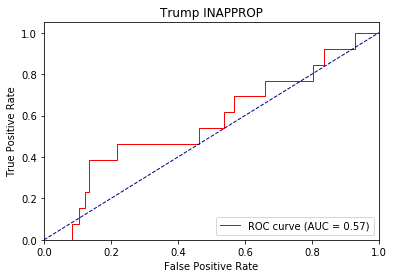

Directory already exists!
dt_inapprop 1 ap tensor([0.8412, 0.1111]) loss : 0.260731041431427 0.4336841881275177 tid : 200 tg tensor([[0]], device='cuda:0')
dt_inapprop 1 ap tensor([0.9749, 0.0389]) loss : 0.1835881471633911 0.3154284724317458 tid : 400 tg tensor([[0]], device='cuda:0')
TEST dt_inapprop 1 ap tensor([0.9152, 0.5478]) loss : 1.3172121047973633 0.45961478755280777 tid : 180 tg tensor([[1]], device='cuda:0')
TEST dt_inapprop 1 ap tensor([0.9195, 0.4462]) loss : 0.30413031578063965 0.4556709320046181 tid : 210 tg tensor([[0]], device='cuda:0')
TEST dt_inapprop 1 ap tensor([0.9279, 0.3544]) loss : 0.133012056350708 0.4175135592619578 tid : 270 tg tensor([[0]], device='cuda:0')
TEST dt_inapprop 1 ap tensor([0.9276, 0.3484]) loss : 1.3752717971801758 0.41239294661602505 tid : 360 tg tensor([[1]], device='cuda:0')
TEST dt_inapprop 1 ap tensor([0.9027, 0.1571]) loss : 0.3253835141658783 0.38584953426110624 tid : 450 tg tensor([[0]], device='cuda:0')


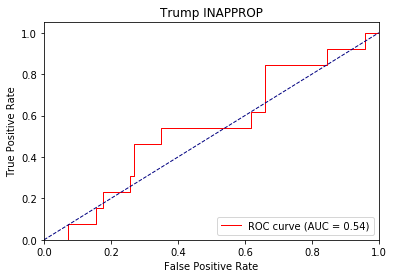

Directory already exists!
dt_inapprop 2 ap tensor([0.9392, 0.0723]) loss : 0.09863817691802979 0.29488716097105117 tid : 200 tg tensor([[0]], device='cuda:0')
dt_inapprop 2 ap tensor([0.9679, 0.0870]) loss : 0.08389520645141602 0.25835916744207 tid : 400 tg tensor([[0]], device='cuda:0')
TEST dt_inapprop 2 ap tensor([0.9072, 0.4991]) loss : 1.6162933111190796 0.48736522648785563 tid : 180 tg tensor([[1]], device='cuda:0')
TEST dt_inapprop 2 ap tensor([0.9112, 0.4150]) loss : 0.1956864297389984 0.482733792343805 tid : 210 tg tensor([[0]], device='cuda:0')
TEST dt_inapprop 2 ap tensor([0.9224, 0.3541]) loss : 0.07481813430786133 0.4261791925681265 tid : 270 tg tensor([[0]], device='cuda:0')
TEST dt_inapprop 2 ap tensor([0.9189, 0.3285]) loss : 1.726757287979126 0.41819388345933295 tid : 360 tg tensor([[1]], device='cuda:0')
TEST dt_inapprop 2 ap tensor([0.8994, 0.1520]) loss : 0.21376636624336243 0.37412275118057176 tid : 450 tg tensor([[0]], device='cuda:0')


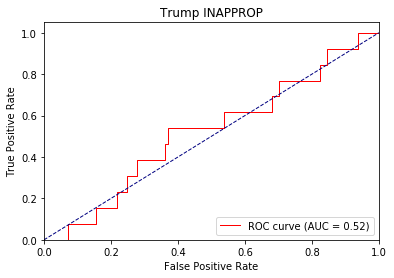

Directory already exists!
dt_affgest 0 ap tensor([0.9557, 0.0337]) loss : 0.29459530115127563 0.5283554961838698 tid : 400 tg tensor([[0]], device='cuda:0')
dt_affgest 0 ap tensor([0.9594, 0.0335]) loss : 0.2902684211730957 0.5231121562347554 tid : 200 tg tensor([[0]], device='cuda:0')
TEST dt_affgest 0 ap tensor([1., 0.]) loss : 0.5633711814880371 0.35294097339784775 tid : 180 tg tensor([[0]], device='cuda:0')
TEST dt_affgest 0 ap tensor([1., 0.]) loss : 0.45320451259613037 0.3575294662353604 tid : 210 tg tensor([[0]], device='cuda:0')
TEST dt_affgest 0 ap tensor([1., 0.]) loss : 0.22377467155456543 0.36355272301456387 tid : 270 tg tensor([[0]], device='cuda:0')
TEST dt_affgest 0 ap tensor([1., 0.]) loss : 0.27639979124069214 0.36812246601346515 tid : 360 tg tensor([[0]], device='cuda:0')
TEST dt_affgest 0 ap tensor([1., 0.]) loss : 0.434905469417572 0.3855106972082697 tid : 450 tg tensor([[0]], device='cuda:0')


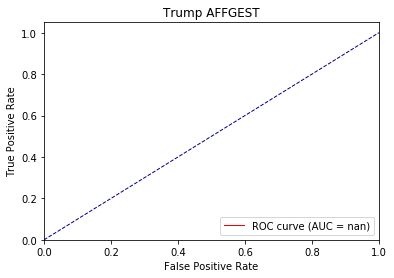

Directory already exists!
dt_affgest 1 ap tensor([0.9655, 0.0505]) loss : 0.24507534503936768 0.34860279776833275 tid : 200 tg tensor([[0]], device='cuda:0')
dt_affgest 1 ap tensor([0.9787, 0.0365]) loss : 0.20767951011657715 0.3236578812061901 tid : 400 tg tensor([[0]], device='cuda:0')
TEST dt_affgest 1 ap tensor([1., 0.]) loss : 0.3934769034385681 0.18700008778958707 tid : 180 tg tensor([[0]], device='cuda:0')
TEST dt_affgest 1 ap tensor([1., 0.]) loss : 0.2693776488304138 0.19116321829862373 tid : 210 tg tensor([[0]], device='cuda:0')
TEST dt_affgest 1 ap tensor([1., 0.]) loss : 0.09609413146972656 0.19617855235149986 tid : 270 tg tensor([[0]], device='cuda:0')
TEST dt_affgest 1 ap tensor([1., 0.]) loss : 0.17150747776031494 0.20258512379417956 tid : 360 tg tensor([[0]], device='cuda:0')
TEST dt_affgest 1 ap tensor([1., 0.]) loss : 0.27383071184158325 0.2211168965305945 tid : 450 tg tensor([[0]], device='cuda:0')


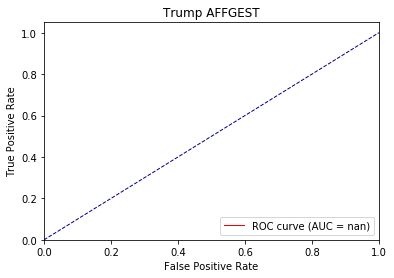

Directory already exists!
dt_affgest 2 ap tensor([0.9709, 0.0461]) loss : 0.10405111312866211 0.23658029916130494 tid : 400 tg tensor([[0]], device='cuda:0')
dt_affgest 2 ap tensor([0.9751, 0.0433]) loss : 0.10370123386383057 0.22724532702211606 tid : 200 tg tensor([[0]], device='cuda:0')
TEST dt_affgest 2 ap tensor([1., 0.]) loss : 0.2777242660522461 0.11298531293869019 tid : 180 tg tensor([[0]], device='cuda:0')
TEST dt_affgest 2 ap tensor([1., 0.]) loss : 0.1655343770980835 0.11591689115346865 tid : 210 tg tensor([[0]], device='cuda:0')
TEST dt_affgest 2 ap tensor([1., 0.]) loss : 0.050733327865600586 0.120230027458124 tid : 270 tg tensor([[0]], device='cuda:0')
TEST dt_affgest 2 ap tensor([1., 0.]) loss : 0.12079131603240967 0.12647311536359115 tid : 360 tg tensor([[0]], device='cuda:0')
TEST dt_affgest 2 ap tensor([1., 0.]) loss : 0.19275832176208496 0.14394078772477428 tid : 450 tg tensor([[0]], device='cuda:0')


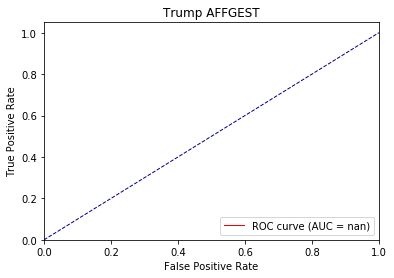

Directory already exists!
dt_defgest 0 ap tensor([0.7996, 0.4955]) loss : 0.6833544969558716 0.6829696513084044 tid : 200 tg tensor([[1]], device='cuda:0')
dt_defgest 0 ap tensor([0.8150, 0.5060]) loss : 0.666340708732605 0.6768610908434941 tid : 400 tg tensor([[0]], device='cuda:0')
TEST dt_defgest 0 ap tensor([0.9751, 0.8718]) loss : 0.7102479934692383 0.5700888955915296 tid : 180 tg tensor([[1]], device='cuda:0')
TEST dt_defgest 0 ap tensor([0.9784, 0.9027]) loss : 0.5350983142852783 0.5633329638214999 tid : 210 tg tensor([[1]], device='cuda:0')
TEST dt_defgest 0 ap tensor([0.9771, 0.8677]) loss : 0.4149264097213745 0.5660818182585532 tid : 270 tg tensor([[0]], device='cuda:0')
TEST dt_defgest 0 ap tensor([0.9705, 0.8637]) loss : 0.5405576229095459 0.5762621949256306 tid : 360 tg tensor([[1]], device='cuda:0')
TEST dt_defgest 0 ap tensor([0.9409, 0.8108]) loss : 0.6137186884880066 0.5926227066854034 tid : 450 tg tensor([[1]], device='cuda:0')


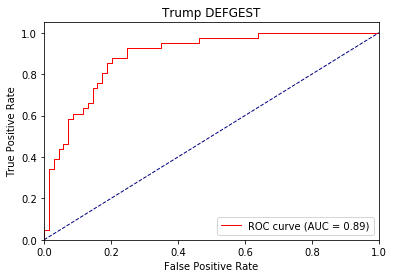

Directory already exists!
dt_defgest 1 ap tensor([0.8969, 0.7460]) loss : 0.4800313413143158 0.5575791118722974 tid : 400 tg tensor([[0]], device='cuda:0')
dt_defgest 1 ap tensor([0.9072, 0.6298]) loss : 0.819718062877655 0.5554408000852273 tid : 200 tg tensor([[1]], device='cuda:0')
TEST dt_defgest 1 ap tensor([0.9702, 0.8894]) loss : 0.8301723003387451 0.49353274380838547 tid : 180 tg tensor([[1]], device='cuda:0')
TEST dt_defgest 1 ap tensor([0.9745, 0.9150]) loss : 0.5022420883178711 0.48471370339393616 tid : 210 tg tensor([[1]], device='cuda:0')
TEST dt_defgest 1 ap tensor([0.9775, 0.9012]) loss : 0.24278831481933594 0.4837407694573988 tid : 270 tg tensor([[0]], device='cuda:0')
TEST dt_defgest 1 ap tensor([0.9706, 0.8888]) loss : 0.5338778495788574 0.5017155459229375 tid : 360 tg tensor([[1]], device='cuda:0')
TEST dt_defgest 1 ap tensor([0.9363, 0.8398]) loss : 0.5721601247787476 0.5353022825838339 tid : 450 tg tensor([[1]], device='cuda:0')


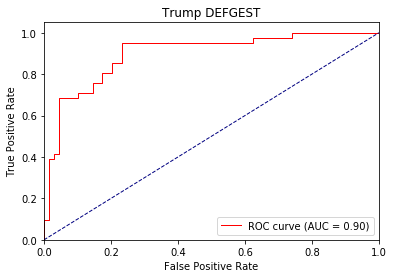

Directory already exists!
dt_defgest 2 ap tensor([0.9134, 0.7096]) loss : 0.3075259327888489 0.503046211314528 tid : 400 tg tensor([[0]], device='cuda:0')
dt_defgest 2 ap tensor([0.9093, 0.6504]) loss : 0.8844832181930542 0.5055131826779289 tid : 200 tg tensor([[1]], device='cuda:0')
TEST dt_defgest 2 ap tensor([0.9630, 0.8900]) loss : 0.9485669136047363 0.44407485224105214 tid : 180 tg tensor([[1]], device='cuda:0')
TEST dt_defgest 2 ap tensor([0.9670, 0.9131]) loss : 0.4807123839855194 0.43320908033570577 tid : 210 tg tensor([[1]], device='cuda:0')
TEST dt_defgest 2 ap tensor([0.9728, 0.9042]) loss : 0.1472417116165161 0.4291268519142218 tid : 270 tg tensor([[0]], device='cuda:0')
TEST dt_defgest 2 ap tensor([0.9681, 0.8983]) loss : 0.527984619140625 0.4513138452885856 tid : 360 tg tensor([[1]], device='cuda:0')
TEST dt_defgest 2 ap tensor([0.9333, 0.8421]) loss : 0.541604220867157 0.49778483251128536 tid : 450 tg tensor([[1]], device='cuda:0')


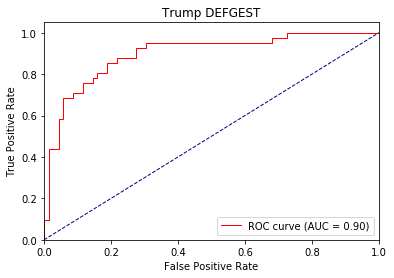

Directory already exists!
dt_agentic 0 ap tensor([0.6842, 0.9319]) loss : 0.6460014581680298 0.6139512965528984 tid : 400 tg tensor([[0]], device='cuda:0')
dt_agentic 0 ap tensor([0.7539, 0.9398]) loss : 0.511138916015625 0.5961786721564509 tid : 200 tg tensor([[1]], device='cuda:0')
TEST dt_agentic 0 ap tensor([0.7982, 0.9117]) loss : 0.9447957277297974 0.5292335515086716 tid : 180 tg tensor([[1]], device='cuda:0')
TEST dt_agentic 0 ap tensor([0.8213, 0.9185]) loss : 0.35364729166030884 0.5243057165034982 tid : 210 tg tensor([[1]], device='cuda:0')
TEST dt_agentic 0 ap tensor([0.8210, 0.9179]) loss : 0.9343533515930176 0.5211216645282611 tid : 270 tg tensor([[1]], device='cuda:0')
TEST dt_agentic 0 ap tensor([0.8269, 0.9280]) loss : 0.41425055265426636 0.5323569392654258 tid : 360 tg tensor([[1]], device='cuda:0')
TEST dt_agentic 0 ap tensor([0.7944, 0.9177]) loss : 0.35794979333877563 0.5375951892799802 tid : 450 tg tensor([[1]], device='cuda:0')


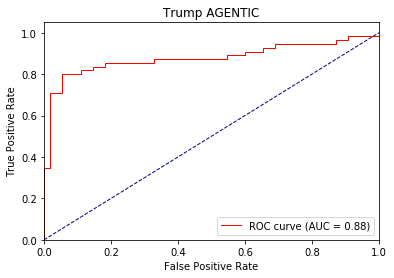

Directory already exists!
dt_agentic 1 ap tensor([0.7153, 0.8486]) loss : 0.5937075614929199 0.6106488650495355 tid : 400 tg tensor([[0]], device='cuda:0')
dt_agentic 1 ap tensor([0.8221, 0.9489]) loss : 0.4035998582839966 0.49122685671762656 tid : 200 tg tensor([[1]], device='cuda:0')
TEST dt_agentic 1 ap tensor([0.8194, 0.9128]) loss : 0.9739626049995422 0.4751086581397701 tid : 180 tg tensor([[1]], device='cuda:0')
TEST dt_agentic 1 ap tensor([0.8574, 0.9200]) loss : 0.20033490657806396 0.4675105137880458 tid : 210 tg tensor([[1]], device='cuda:0')
TEST dt_agentic 1 ap tensor([0.8246, 0.9157]) loss : 1.183221697807312 0.4666827012572372 tid : 270 tg tensor([[1]], device='cuda:0')
TEST dt_agentic 1 ap tensor([0.8299, 0.9270]) loss : 0.25227612257003784 0.48358169449886806 tid : 360 tg tensor([[1]], device='cuda:0')
TEST dt_agentic 1 ap tensor([0.7970, 0.9059]) loss : 0.2151021957397461 0.48925474165665983 tid : 450 tg tensor([[1]], device='cuda:0')


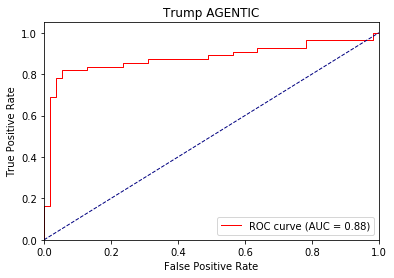

Directory already exists!
dt_agentic 2 ap tensor([0.8340, 0.9533]) loss : 0.2617114782333374 0.3908258218696152 tid : 200 tg tensor([[1]], device='cuda:0')
dt_agentic 2 ap tensor([0.8411, 0.9579]) loss : 0.5028115510940552 0.380202473865615 tid : 400 tg tensor([[0]], device='cuda:0')
TEST dt_agentic 2 ap tensor([0.8406, 0.9118]) loss : 1.0193301439285278 0.44832222445591075 tid : 180 tg tensor([[1]], device='cuda:0')
TEST dt_agentic 2 ap tensor([0.8688, 0.9193]) loss : 0.12578105926513672 0.43833413442900016 tid : 210 tg tensor([[1]], device='cuda:0')
TEST dt_agentic 2 ap tensor([0.8151, 0.9154]) loss : 1.42081618309021 0.4387932681200797 tid : 270 tg tensor([[1]], device='cuda:0')
TEST dt_agentic 2 ap tensor([0.8218, 0.9269]) loss : 0.15848982334136963 0.4616499895780859 tid : 360 tg tensor([[1]], device='cuda:0')
TEST dt_agentic 2 ap tensor([0.7885, 0.9029]) loss : 0.13657855987548828 0.46901203345770787 tid : 450 tg tensor([[1]], device='cuda:0')


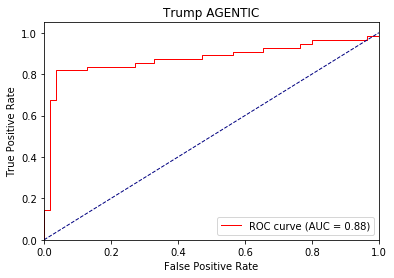

Directory already exists!
dt_waveoff 0 ap tensor([1., 0.]) loss : 0.7255428433418274 0.7790816903114319 tid : 400 tg tensor([[0]], device='cuda:0')
dt_waveoff 0 ap tensor([1., 0.]) loss : 0.5226567983627319 0.6548471241519692 tid : 200 tg tensor([[0]], device='cuda:0')
TEST dt_waveoff 0 ap tensor([0.8603, 0.2364]) loss : 0.4550936222076416 0.5174912633122625 tid : 180 tg tensor([[0]], device='cuda:0')
TEST dt_waveoff 0 ap tensor([0.8720, 0.2012]) loss : 0.4287450313568115 0.4973380260689314 tid : 210 tg tensor([[0]], device='cuda:0')
TEST dt_waveoff 0 ap tensor([0.9033, 0.1574]) loss : 0.3152811527252197 0.46462660348206236 tid : 270 tg tensor([[0]], device='cuda:0')
TEST dt_waveoff 0 ap tensor([0.9181, 0.1249]) loss : 0.40258651971817017 0.44590617233598734 tid : 360 tg tensor([[0]], device='cuda:0')
TEST dt_waveoff 0 ap tensor([0.9420, 0.0841]) loss : 0.416766881942749 0.4302472375860118 tid : 450 tg tensor([[0]], device='cuda:0')


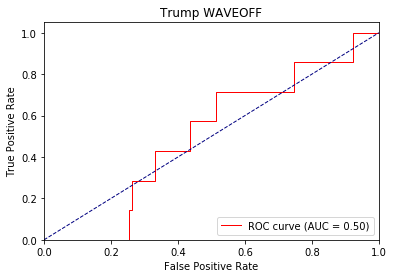

Directory already exists!
dt_waveoff 1 ap tensor([1., 0.]) loss : 0.27113285660743713 0.3144752504052343 tid : 400 tg tensor([[0]], device='cuda:0')
dt_waveoff 1 ap tensor([1., 0.]) loss : 0.15336740016937256 0.2702996007195025 tid : 200 tg tensor([[0]], device='cuda:0')
TEST dt_waveoff 1 ap tensor([0.8846, 0.2598]) loss : 0.2739626169204712 0.48496742345191335 tid : 180 tg tensor([[0]], device='cuda:0')
TEST dt_waveoff 1 ap tensor([0.8939, 0.2055]) loss : 0.2123112678527832 0.4424067562402681 tid : 210 tg tensor([[0]], device='cuda:0')
TEST dt_waveoff 1 ap tensor([0.9202, 0.1571]) loss : 0.11643791198730469 0.37678307660839017 tid : 270 tg tensor([[0]], device='cuda:0')
TEST dt_waveoff 1 ap tensor([0.9282, 0.1190]) loss : 0.21635663509368896 0.3380455647555875 tid : 360 tg tensor([[0]], device='cuda:0')
TEST dt_waveoff 1 ap tensor([0.9413, 0.0787]) loss : 0.24264031648635864 0.30291294238784094 tid : 450 tg tensor([[0]], device='cuda:0')


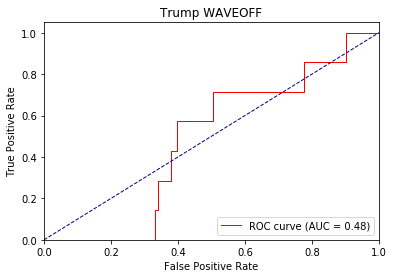

Directory already exists!
dt_waveoff 2 ap tensor([1., 0.]) loss : 0.10596781969070435 0.13835193861776324 tid : 400 tg tensor([[0]], device='cuda:0')
dt_waveoff 2 ap tensor([1., 0.]) loss : 0.052713751792907715 0.12487446090192285 tid : 200 tg tensor([[0]], device='cuda:0')
TEST dt_waveoff 2 ap tensor([0.8993, 0.2755]) loss : 0.15249252319335938 0.5443060140351992 tid : 180 tg tensor([[0]], device='cuda:0')
TEST dt_waveoff 2 ap tensor([0.9052, 0.2175]) loss : 0.10662031173706055 0.48047479224759476 tid : 210 tg tensor([[0]], device='cuda:0')
TEST dt_waveoff 2 ap tensor([0.9262, 0.1645]) loss : 0.04513382911682129 0.3834752126743919 tid : 270 tg tensor([[0]], device='cuda:0')
TEST dt_waveoff 2 ap tensor([0.9346, 0.1233]) loss : 0.11964160203933716 0.32547872754889473 tid : 360 tg tensor([[0]], device='cuda:0')
TEST dt_waveoff 2 ap tensor([0.9434, 0.0776]) loss : 0.14185190200805664 0.267580099178083 tid : 450 tg tensor([[0]], device='cuda:0')


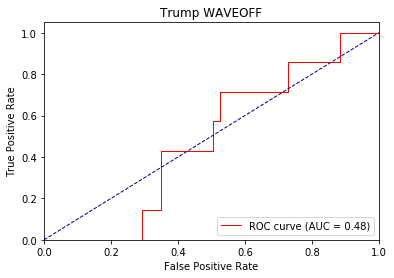

Directory already exists!
dt_nvtic1 0 ap tensor([0.9305, 0.3045]) loss : 0.6769917011260986 0.6518965412217838 tid : 400 tg tensor([[0]], device='cuda:0')
dt_nvtic1 0 ap tensor([0.9348, 0.2406]) loss : 0.3393080532550812 0.6003285831234361 tid : 200 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic1 0 ap tensor([0.9549, 0.1233]) loss : 0.6898189187049866 0.4827355452485987 tid : 180 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic1 0 ap tensor([0.9589, 0.1046]) loss : 0.3907186985015869 0.479577430458956 tid : 210 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic1 0 ap tensor([0.9240, 0.1120]) loss : 1.033426284790039 0.5131319949501439 tid : 270 tg tensor([[1]], device='cuda:0')
TEST dt_nvtic1 0 ap tensor([0.9429, 0.1197]) loss : 0.3845583200454712 0.49647488770350606 tid : 360 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic1 0 ap tensor([0.9515, 0.0944]) loss : 0.3210643529891968 0.49049031042089364 tid : 450 tg tensor([[0]], device='cuda:0')


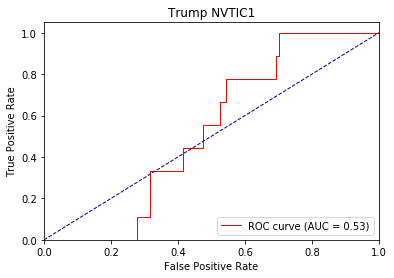

Directory already exists!
dt_nvtic1 1 ap tensor([0.9474, 0.3383]) loss : 0.22558045387268066 0.47157261962607755 tid : 200 tg tensor([[0]], device='cuda:0')
dt_nvtic1 1 ap tensor([0.9658, 0.2952]) loss : 0.3712565302848816 0.4278763754671788 tid : 400 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic1 1 ap tensor([0.9539, 0.1207]) loss : 0.5873166918754578 0.37864223525330826 tid : 180 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic1 1 ap tensor([0.9613, 0.1090]) loss : 0.2206605076789856 0.37040593457776444 tid : 210 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic1 1 ap tensor([0.9328, 0.1199]) loss : 1.2602035999298096 0.4166778786140576 tid : 270 tg tensor([[1]], device='cuda:0')
TEST dt_nvtic1 1 ap tensor([0.9488, 0.1262]) loss : 0.22942698001861572 0.3967071360265705 tid : 360 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic1 1 ap tensor([0.9587, 0.1037]) loss : 0.19486278295516968 0.3845946689446767 tid : 450 tg tensor([[0]], device='cuda:0')


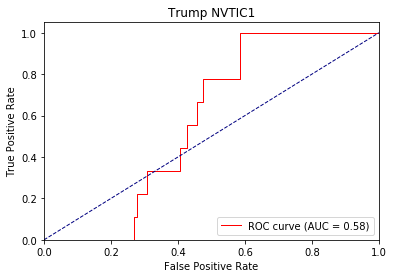

Directory already exists!
dt_nvtic1 2 ap tensor([0.9608, 0.4079]) loss : 0.12557953596115112 0.3701193031544487 tid : 200 tg tensor([[0]], device='cuda:0')
dt_nvtic1 2 ap tensor([0.9531, 0.3075]) loss : 0.3216448426246643 0.38923153426589036 tid : 400 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic1 2 ap tensor([0.9559, 0.1263]) loss : 0.5371643304824829 0.3354157217451044 tid : 180 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic1 2 ap tensor([0.9627, 0.1136]) loss : 0.13726329803466797 0.3244947416837825 tid : 210 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic1 2 ap tensor([0.9369, 0.1249]) loss : 1.3663655519485474 0.37745809502768934 tid : 270 tg tensor([[1]], device='cuda:0')
TEST dt_nvtic1 2 ap tensor([0.9510, 0.1306]) loss : 0.146662175655365 0.35504687378104305 tid : 360 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic1 2 ap tensor([0.9607, 0.1075]) loss : 0.1307653784751892 0.3388023755767129 tid : 450 tg tensor([[0]], device='cuda:0')


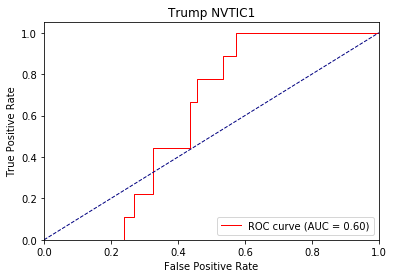

Directory already exists!
dt_nvtic2 0 ap tensor([0.8473, 0.1079]) loss : 0.5296746492385864 0.6593362604578336 tid : 400 tg tensor([[0]], device='cuda:0')
dt_nvtic2 0 ap tensor([0.8689, 0.1058]) loss : 0.3925987184047699 0.6405571666877834 tid : 200 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic2 0 ap tensor([0.9394, 0.4301]) loss : 0.41495996713638306 0.5163048924626531 tid : 180 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic2 0 ap tensor([0.8623, 0.4546]) loss : 0.5766873955726624 0.5569407239902852 tid : 210 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic2 0 ap tensor([0.8544, 0.3814]) loss : 0.38257700204849243 0.5542305226911578 tid : 270 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic2 0 ap tensor([0.8831, 0.3120]) loss : 0.5018858909606934 0.5375808792214998 tid : 360 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic2 0 ap tensor([0.9100, 0.2543]) loss : 0.5490912795066833 0.5184832862531296 tid : 450 tg tensor([[0]], device='cuda:0')


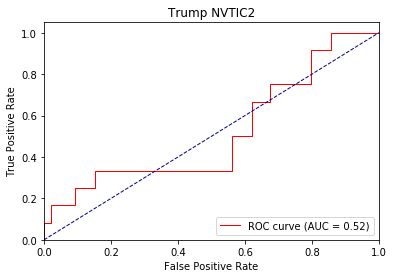

Directory already exists!
dt_nvtic2 1 ap tensor([0.9028, 0.1995]) loss : 0.2592811584472656 0.4859882296751375 tid : 200 tg tensor([[0]], device='cuda:0')
dt_nvtic2 1 ap tensor([0.8789, 0.1733]) loss : 0.3584206700325012 0.4723094360006547 tid : 400 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic2 1 ap tensor([0.9185, 0.3990]) loss : 0.3363800644874573 0.42760660197283773 tid : 180 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic2 1 ap tensor([0.8679, 0.4835]) loss : 0.3285730481147766 0.49209148246188494 tid : 210 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic2 1 ap tensor([0.8469, 0.3841]) loss : 0.29736894369125366 0.486819712216394 tid : 270 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic2 1 ap tensor([0.8905, 0.3488]) loss : 0.3008763790130615 0.44954727359221014 tid : 360 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic2 1 ap tensor([0.9242, 0.2204]) loss : 0.33063435554504395 0.41206006209055585 tid : 450 tg tensor([[0]], device='cuda:0')


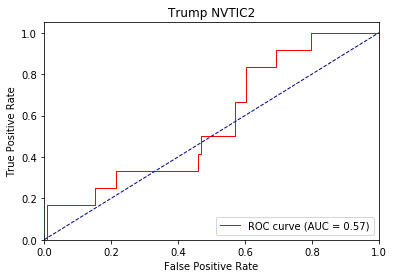

Directory already exists!
dt_nvtic2 2 ap tensor([0.9590, 0.3091]) loss : 0.2949727177619934 0.3896137819840358 tid : 400 tg tensor([[0]], device='cuda:0')
dt_nvtic2 2 ap tensor([0.9563, 0.2236]) loss : 0.14944958686828613 0.3841069571208209 tid : 200 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic2 2 ap tensor([0.8924, 0.3286]) loss : 0.2881056070327759 0.3993853080917049 tid : 180 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic2 2 ap tensor([0.8641, 0.4755]) loss : 0.20900499820709229 0.4793123263259267 tid : 210 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic2 2 ap tensor([0.8479, 0.3893]) loss : 0.26125770807266235 0.4701720209498155 tid : 270 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic2 2 ap tensor([0.8922, 0.3557]) loss : 0.20077383518218994 0.41853431244971045 tid : 360 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic2 2 ap tensor([0.9250, 0.2235]) loss : 0.22026944160461426 0.36700855662124326 tid : 450 tg tensor([[0]], device='cuda:0')


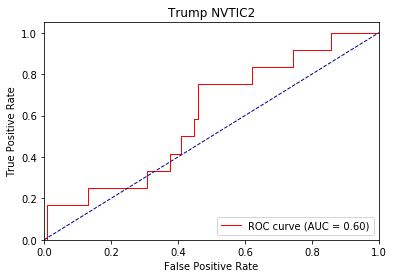

Directory already exists!
dt_nvtic3 0 ap tensor([0.5623, 0.4554]) loss : 0.5845409631729126 0.7022869944572449 tid : 400 tg tensor([[1]], device='cuda:0')
dt_nvtic3 0 ap tensor([0.6253, 0.6372]) loss : 0.7862182855606079 0.6763121636434534 tid : 200 tg tensor([[1]], device='cuda:0')
TEST dt_nvtic3 0 ap tensor([0.6732, 0.9804]) loss : 0.48358863592147827 0.5627511119520342 tid : 180 tg tensor([[1]], device='cuda:0')
TEST dt_nvtic3 0 ap tensor([0.6601, 0.8903]) loss : 0.5251479148864746 0.5745633216791375 tid : 210 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic3 0 ap tensor([0.6793, 0.9093]) loss : 0.4620358645915985 0.5635887007964285 tid : 270 tg tensor([[1]], device='cuda:0')
TEST dt_nvtic3 0 ap tensor([0.6810, 0.8680]) loss : 0.6615234017372131 0.5824464463012319 tid : 360 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic3 0 ap tensor([0.7327, 0.8009]) loss : 0.5623713731765747 0.5987291194573797 tid : 450 tg tensor([[0]], device='cuda:0')


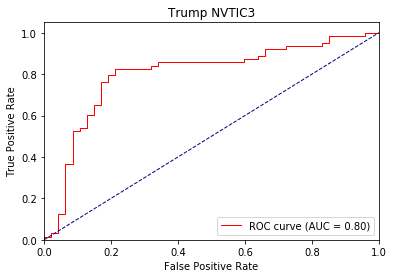

Directory already exists!
dt_nvtic3 1 ap tensor([0.7978, 0.8362]) loss : 0.8354846835136414 0.5701932186304137 tid : 200 tg tensor([[1]], device='cuda:0')
dt_nvtic3 1 ap tensor([0.7439, 0.8028]) loss : 0.3350432813167572 0.5673497956578094 tid : 400 tg tensor([[1]], device='cuda:0')
TEST dt_nvtic3 1 ap tensor([0.7242, 0.9843]) loss : 0.43487054109573364 0.5241186522148751 tid : 180 tg tensor([[1]], device='cuda:0')
TEST dt_nvtic3 1 ap tensor([0.7031, 0.9198]) loss : 0.40314996242523193 0.5363800345465194 tid : 210 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic3 1 ap tensor([0.7077, 0.9271]) loss : 0.33605438470840454 0.5156784125587397 tid : 270 tg tensor([[1]], device='cuda:0')
TEST dt_nvtic3 1 ap tensor([0.7056, 0.9011]) loss : 0.5716369152069092 0.5396373015894017 tid : 360 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic3 1 ap tensor([0.7496, 0.8480]) loss : 0.47246670722961426 0.5566559120862171 tid : 450 tg tensor([[0]], device='cuda:0')


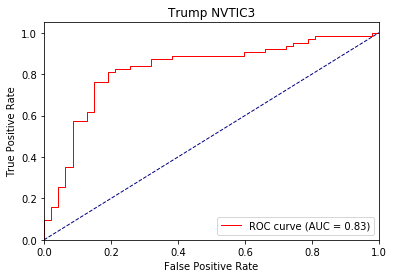

Directory already exists!
dt_nvtic3 2 ap tensor([0.7690, 0.8560]) loss : 0.2861539423465729 0.5365596190594987 tid : 400 tg tensor([[1]], device='cuda:0')
dt_nvtic3 2 ap tensor([0.7658, 0.8559]) loss : 0.864851713180542 0.5386028538312627 tid : 200 tg tensor([[1]], device='cuda:0')
TEST dt_nvtic3 2 ap tensor([0.7456, 0.9865]) loss : 0.39747679233551025 0.4977038712114901 tid : 180 tg tensor([[1]], device='cuda:0')
TEST dt_nvtic3 2 ap tensor([0.7484, 0.9391]) loss : 0.33506810665130615 0.5124474403470062 tid : 210 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic3 2 ap tensor([0.7443, 0.9424]) loss : 0.2681814432144165 0.48546244962173596 tid : 270 tg tensor([[1]], device='cuda:0')
TEST dt_nvtic3 2 ap tensor([0.7311, 0.9172]) loss : 0.5258191823959351 0.5137016319892775 tid : 360 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic3 2 ap tensor([0.7602, 0.8691]) loss : 0.4250287711620331 0.5316471063127421 tid : 450 tg tensor([[0]], device='cuda:0')


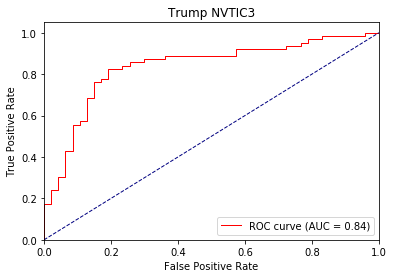

Directory already exists!
dt_nvtic5 0 ap tensor([0.9472, 0.0652]) loss : 0.6116679310798645 0.7388230788516489 tid : 400 tg tensor([[0]], device='cuda:0')
dt_nvtic5 0 ap tensor([0.9726, 0.0673]) loss : 0.35851311683654785 0.6951961511420826 tid : 200 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic5 0 ap tensor([0.9588, 0.0333]) loss : 0.54680997133255 0.46389483036221685 tid : 180 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic5 0 ap tensor([0.9638, 0.0286]) loss : 0.49868953227996826 0.4606594200744185 tid : 210 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic5 0 ap tensor([0.9728, 0.0217]) loss : 0.3453344404697418 0.4544228796373334 tid : 270 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic5 0 ap tensor([0.9762, 0.0169]) loss : 0.5052818059921265 0.45164037590295497 tid : 360 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic5 0 ap tensor([0.9839, 0.0125]) loss : 0.48287779092788696 0.4539483156469133 tid : 450 tg tensor([[0]], device='cuda:0')


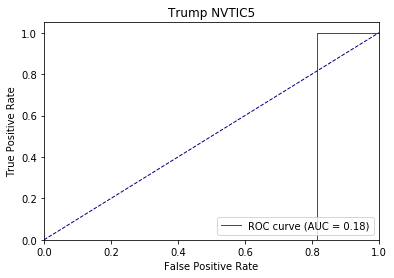

Directory already exists!
dt_nvtic5 1 ap tensor([0.9812, 0.0479]) loss : 0.11085319519042969 0.355145531960509 tid : 200 tg tensor([[0]], device='cuda:0')
dt_nvtic5 1 ap tensor([0.9799, 0.0402]) loss : 0.1817392110824585 0.31828553084846883 tid : 400 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic5 1 ap tensor([0.9646, 0.0357]) loss : 0.351292222738266 0.26726393280802546 tid : 180 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic5 1 ap tensor([0.9683, 0.0303]) loss : 0.2606222629547119 0.2632466811080312 tid : 210 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic5 1 ap tensor([0.9754, 0.0227]) loss : 0.1621382236480713 0.25542660920243515 tid : 270 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic5 1 ap tensor([0.9791, 0.0179]) loss : 0.2933812737464905 0.2519287336880053 tid : 360 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic5 1 ap tensor([0.9848, 0.0128]) loss : 0.2743830978870392 0.25700524027901467 tid : 450 tg tensor([[0]], device='cuda:0')


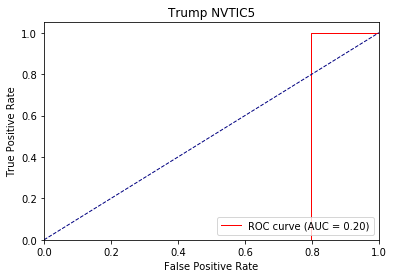

Directory already exists!
dt_nvtic5 2 ap tensor([0.9803, 0.0367]) loss : 0.0446467399597168 0.2194990451765243 tid : 200 tg tensor([[0]], device='cuda:0')
dt_nvtic5 2 ap tensor([0.9814, 0.0334]) loss : 0.10620665550231934 0.2129559731936153 tid : 400 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic5 2 ap tensor([0.9736, 0.0417]) loss : 0.23555248975753784 0.18259197634619637 tid : 180 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic5 2 ap tensor([0.9783, 0.0370]) loss : 0.14107418060302734 0.17654800415039062 tid : 210 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic5 2 ap tensor([0.9832, 0.0278]) loss : 0.10053753852844238 0.16756552510094225 tid : 270 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic5 2 ap tensor([0.9853, 0.0213]) loss : 0.1831972599029541 0.16230212928543628 tid : 360 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic5 2 ap tensor([0.9886, 0.0147]) loss : 0.1674126386642456 0.1665754814942678 tid : 450 tg tensor([[0]], device='cuda:0')


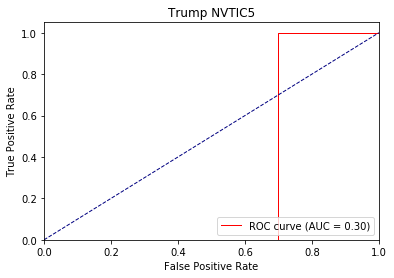

Directory already exists!
dt_nvtic4 0 ap tensor([0.9714, 0.0309]) loss : 0.6162946224212646 0.6891772723840383 tid : 200 tg tensor([[0]], device='cuda:0')
dt_nvtic4 0 ap tensor([0.9632, 0.0326]) loss : 0.48163169622421265 0.6874829589972022 tid : 400 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic4 0 ap tensor([0.9952, 0.1429]) loss : 0.44335389137268066 0.3660769857264854 tid : 180 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic4 0 ap tensor([0.9958, 0.1250]) loss : 0.27960842847824097 0.3645053817782291 tid : 210 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic4 0 ap tensor([0.9973, 0.1111]) loss : 0.2815771698951721 0.36220612076290865 tid : 270 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic4 0 ap tensor([0.9974, 0.0769]) loss : 0.29426833987236023 0.3613980278162889 tid : 360 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic4 0 ap tensor([0.9910, 0.0965]) loss : 0.2845451235771179 0.3843172719382276 tid : 450 tg tensor([[0]], device='cuda:0')


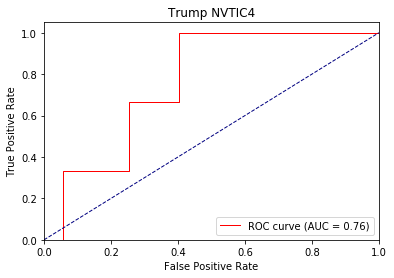

Directory already exists!
dt_nvtic4 1 ap tensor([0.9447, 0.0338]) loss : 0.24545568227767944 0.36577258104676597 tid : 400 tg tensor([[0]], device='cuda:0')
dt_nvtic4 1 ap tensor([0.9522, 0.0331]) loss : 0.19835889339447021 0.3594863659523903 tid : 200 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic4 1 ap tensor([0.9914, 0.0909]) loss : 0.31539905071258545 0.22784454033181473 tid : 180 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic4 1 ap tensor([0.9923, 0.0769]) loss : 0.13266408443450928 0.22532346290211344 tid : 210 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic4 1 ap tensor([0.9942, 0.0588]) loss : 0.14101505279541016 0.2190307352626533 tid : 270 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic4 1 ap tensor([0.9950, 0.0455]) loss : 0.1541578769683838 0.21466155581071344 tid : 360 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic4 1 ap tensor([0.9897, 0.0902]) loss : 0.1391303539276123 0.24587444855709267 tid : 450 tg tensor([[0]], device='cuda:0')


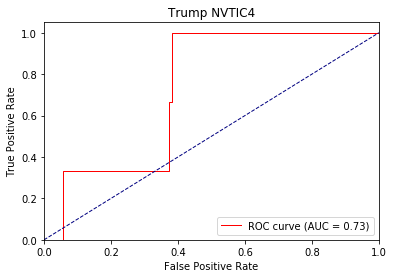

Directory already exists!
dt_nvtic4 2 ap tensor([0.9869, 0.0627]) loss : 0.14588963985443115 0.2235166603173965 tid : 400 tg tensor([[0]], device='cuda:0')
dt_nvtic4 2 ap tensor([0.9792, 0.0539]) loss : 0.08961713314056396 0.22735843858960586 tid : 200 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic4 2 ap tensor([0.9893, 0.0769]) loss : 0.2433018684387207 0.17059544453749786 tid : 180 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic4 2 ap tensor([0.9908, 0.0667]) loss : 0.08037018775939941 0.16699458693349084 tid : 210 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic4 2 ap tensor([0.9933, 0.0526]) loss : 0.08843767642974854 0.15815556049346924 tid : 270 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic4 2 ap tensor([0.9947, 0.0435]) loss : 0.0922921895980835 0.15114438617733164 tid : 360 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic4 2 ap tensor([0.9898, 0.0849]) loss : 0.08216500282287598 0.1877636427831168 tid : 450 tg tensor([[0]], device='cuda:0')


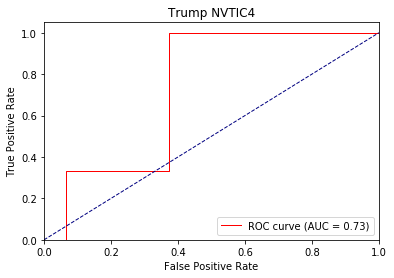

Directory already exists!
dt_interruptions 0 ap tensor([0.9230, 0.1218]) loss : 0.4195181131362915 0.5414180166927385 tid : 400 tg tensor([[0]], device='cuda:0')
dt_interruptions 0 ap tensor([0.9040, 0.1212]) loss : 1.3611572980880737 0.5447776039115718 tid : 200 tg tensor([[1]], device='cuda:0')
TEST dt_interruptions 0 ap tensor([0.9448, 0.1345]) loss : 0.3291690945625305 0.39625482462547923 tid : 180 tg tensor([[0]], device='cuda:0')
TEST dt_interruptions 0 ap tensor([0.9457, 0.1036]) loss : 0.33992326259613037 0.3941044564857039 tid : 210 tg tensor([[0]], device='cuda:0')
TEST dt_interruptions 0 ap tensor([0.9106, 0.0676]) loss : 0.2883133888244629 0.4106160909460302 tid : 270 tg tensor([[0]], device='cuda:0')
TEST dt_interruptions 0 ap tensor([0.9145, 0.0631]) loss : 0.3286804258823395 0.41027235942827145 tid : 360 tg tensor([[0]], device='cuda:0')
TEST dt_interruptions 0 ap tensor([0.8929, 0.0981]) loss : 0.4159080982208252 0.44194314997605605 tid : 450 tg tensor([[0]], device='cu

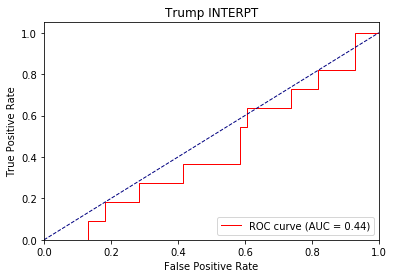

Directory already exists!
dt_interruptions 1 ap tensor([0.8780, 0.1956]) loss : 1.751161813735962 0.4320057356773421 tid : 200 tg tensor([[1]], device='cuda:0')
dt_interruptions 1 ap tensor([0.9574, 0.1422]) loss : 0.20354634523391724 0.35230514918824274 tid : 400 tg tensor([[0]], device='cuda:0')
TEST dt_interruptions 1 ap tensor([0.9743, 0.1687]) loss : 0.24150854349136353 0.3155532173208288 tid : 180 tg tensor([[0]], device='cuda:0')
TEST dt_interruptions 1 ap tensor([0.9754, 0.1366]) loss : 0.19672495126724243 0.30591049998305564 tid : 210 tg tensor([[0]], device='cuda:0')
TEST dt_interruptions 1 ap tensor([0.9490, 0.0844]) loss : 0.18187445402145386 0.3201008355408384 tid : 270 tg tensor([[0]], device='cuda:0')
TEST dt_interruptions 1 ap tensor([0.9261, 0.0688]) loss : 0.22087734937667847 0.32489084022145875 tid : 360 tg tensor([[0]], device='cuda:0')
TEST dt_interruptions 1 ap tensor([0.9223, 0.1144]) loss : 0.2662651538848877 0.37105803718470565 tid : 450 tg tensor([[0]], device

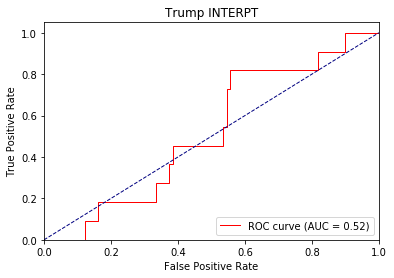

Directory already exists!
dt_interruptions 2 ap tensor([0.9343, 0.1173]) loss : 2.3491721153259277 0.302200959278987 tid : 200 tg tensor([[1]], device='cuda:0')
dt_interruptions 2 ap tensor([0.9164, 0.1192]) loss : 0.1611689329147339 0.3419430434703827 tid : 400 tg tensor([[0]], device='cuda:0')
TEST dt_interruptions 2 ap tensor([0.9761, 0.1824]) loss : 0.19372576475143433 0.28528706608591853 tid : 180 tg tensor([[0]], device='cuda:0')
TEST dt_interruptions 2 ap tensor([0.9784, 0.1528]) loss : 0.12649667263031006 0.27089403119198113 tid : 210 tg tensor([[0]], device='cuda:0')
TEST dt_interruptions 2 ap tensor([0.9624, 0.0985]) loss : 0.13985049724578857 0.2834144475167258 tid : 270 tg tensor([[0]], device='cuda:0')
TEST dt_interruptions 2 ap tensor([0.9309, 0.0736]) loss : 0.15936696529388428 0.2910738939970312 tid : 360 tg tensor([[0]], device='cuda:0')
TEST dt_interruptions 2 ap tensor([0.9279, 0.1223]) loss : 0.18297576904296875 0.34564037274832676 tid : 450 tg tensor([[0]], device=

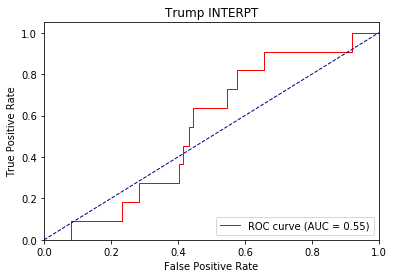

Directory already exists!
dt_lookat2 0 ap tensor([0.6050, 0.8428]) loss : 0.6469162702560425 0.635536405200861 tid : 200 tg tensor([[1]], device='cuda:0')
dt_lookat2 0 ap tensor([0.7029, 0.8841]) loss : 0.8783172369003296 0.6043374789343483 tid : 400 tg tensor([[0]], device='cuda:0')
TEST dt_lookat2 0 ap tensor([0.9536, 0.8850]) loss : 0.9065796136856079 0.6206362055880683 tid : 60 tg tensor([[0]], device='cuda:0')
TEST dt_lookat2 0 ap tensor([0.8390, 0.8461]) loss : 0.5197531580924988 0.5880315831074348 tid : 180 tg tensor([[1]], device='cuda:0')
TEST dt_lookat2 0 ap tensor([0.7021, 0.7824]) loss : 0.6058835983276367 0.6306608227583078 tid : 420 tg tensor([[0]], device='cuda:0')


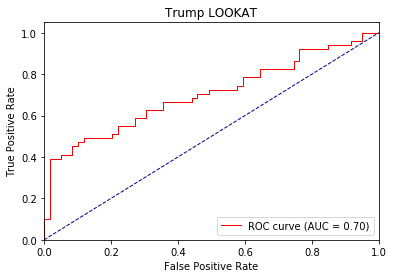

Directory already exists!
dt_lookat2 1 ap tensor([0.9821, 0.9667]) loss : 0.8771345615386963 0.5572609379887581 tid : 400 tg tensor([[0]], device='cuda:0')
dt_lookat2 1 ap tensor([0.7598, 0.9357]) loss : 0.5840916633605957 0.5229056703234182 tid : 200 tg tensor([[1]], device='cuda:0')
TEST dt_lookat2 1 ap tensor([0.9536, 0.8850]) loss : 0.937641441822052 0.5515433124133519 tid : 60 tg tensor([[0]], device='cuda:0')
TEST dt_lookat2 1 ap tensor([0.8369, 0.8691]) loss : 0.506895899772644 0.5305572847525278 tid : 180 tg tensor([[1]], device='cuda:0')
TEST dt_lookat2 1 ap tensor([0.7383, 0.8032]) loss : 0.4246954917907715 0.5906167872004456 tid : 420 tg tensor([[0]], device='cuda:0')


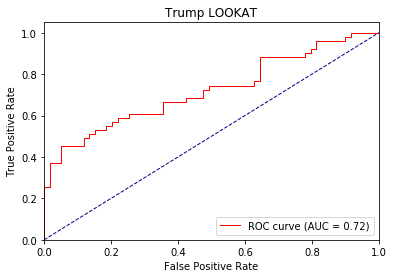

Directory already exists!
dt_lookat2 2 ap tensor([0.8967, 0.9631]) loss : 1.0608530044555664 0.4018791893268014 tid : 400 tg tensor([[0]], device='cuda:0')
dt_lookat2 2 ap tensor([0.8767, 0.9685]) loss : 0.5564834475517273 0.39662273061364445 tid : 200 tg tensor([[1]], device='cuda:0')
TEST dt_lookat2 2 ap tensor([0.9536, 0.8850]) loss : 0.9334093332290649 0.5161773945604052 tid : 60 tg tensor([[0]], device='cuda:0')
TEST dt_lookat2 2 ap tensor([0.8488, 0.8784]) loss : 0.5088504552841187 0.506472436281351 tid : 180 tg tensor([[1]], device='cuda:0')
TEST dt_lookat2 2 ap tensor([0.7600, 0.8128]) loss : 0.3249863386154175 0.5741144192742778 tid : 420 tg tensor([[0]], device='cuda:0')


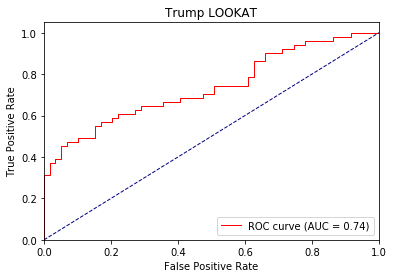

Directory already exists!
dt_brush1 0 ap tensor([0.9288, 0.5741]) loss : 0.7250514626502991 0.6358499700824419 tid : 400 tg tensor([[0]], device='cuda:0')
dt_brush1 0 ap tensor([0.9501, 0.1958]) loss : 0.49646657705307007 0.6194003119723488 tid : 200 tg tensor([[0]], device='cuda:0')
TEST dt_brush1 0 ap tensor([1., 0.]) loss : 0.2990686297416687 0.30331848774637493 tid : 60 tg tensor([[0]], device='cuda:0')
TEST dt_brush1 0 ap tensor([1., 1.]) loss : 0.5303044319152832 0.352130515453143 tid : 180 tg tensor([[0]], device='cuda:0')
TEST dt_brush1 0 ap tensor([0.9784, 0.3406]) loss : 0.33214351534843445 0.4001168798614334 tid : 420 tg tensor([[0]], device='cuda:0')


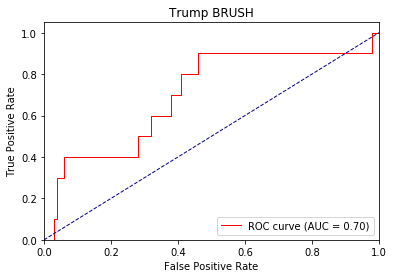

Directory already exists!
dt_brush1 1 ap tensor([0.9717, 0.2106]) loss : 0.18379586935043335 0.36555469247299854 tid : 200 tg tensor([[0]], device='cuda:0')
dt_brush1 1 ap tensor([0.9721, 0.2099]) loss : 0.3040175437927246 0.36423919898595 tid : 400 tg tensor([[0]], device='cuda:0')
TEST dt_brush1 1 ap tensor([1., 0.]) loss : 0.18702763319015503 0.1727494980607714 tid : 60 tg tensor([[0]], device='cuda:0')
TEST dt_brush1 1 ap tensor([1., 1.]) loss : 0.3992997407913208 0.23801956115624842 tid : 180 tg tensor([[0]], device='cuda:0')
TEST dt_brush1 1 ap tensor([0.9756, 0.3441]) loss : 0.19144856929779053 0.3110310412370242 tid : 420 tg tensor([[0]], device='cuda:0')


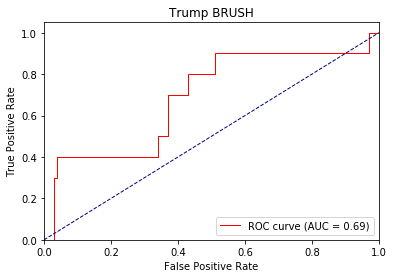

Directory already exists!
dt_brush1 2 ap tensor([1., 1.]) loss : 0.2100679874420166 0.5898790756861368 tid : 400 tg tensor([[0]], device='cuda:0')
dt_brush1 2 ap tensor([0.9781, 0.4455]) loss : 0.08702611923217773 0.279961495411278 tid : 200 tg tensor([[0]], device='cuda:0')
TEST dt_brush1 2 ap tensor([1., 0.]) loss : 0.1333562731742859 0.11537033319473267 tid : 60 tg tensor([[0]], device='cuda:0')
TEST dt_brush1 2 ap tensor([0.9993, 0.8333]) loss : 0.32511335611343384 0.18924831885557908 tid : 180 tg tensor([[0]], device='cuda:0')
TEST dt_brush1 2 ap tensor([0.9729, 0.3268]) loss : 0.11849981546401978 0.27713806681580594 tid : 420 tg tensor([[0]], device='cuda:0')


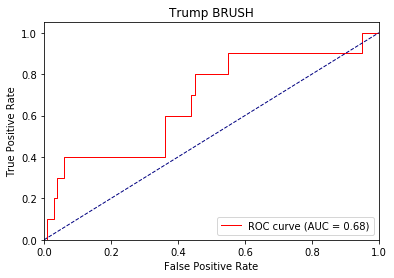

Directory already exists!
dt_nvdis1 0 ap tensor([0.3771, 0.8456]) loss : 0.8004922866821289 0.6298979913934748 tid : 400 tg tensor([[0]], device='cuda:0')
dt_nvdis1 0 ap tensor([0.4230, 0.8448]) loss : 0.4527771770954132 0.6254694603028752 tid : 200 tg tensor([[1]], device='cuda:0')
TEST dt_nvdis1 0 ap tensor([0.4405, 0.8984]) loss : 0.9459449052810669 0.5804946273565292 tid : 60 tg tensor([[0]], device='cuda:0')
TEST dt_nvdis1 0 ap tensor([0.4438, 0.9320]) loss : 0.6076377034187317 0.5476858149736356 tid : 180 tg tensor([[1]], device='cuda:0')
TEST dt_nvdis1 0 ap tensor([0.3049, 0.9158]) loss : 0.4117479622364044 0.5382944836721315 tid : 420 tg tensor([[1]], device='cuda:0')


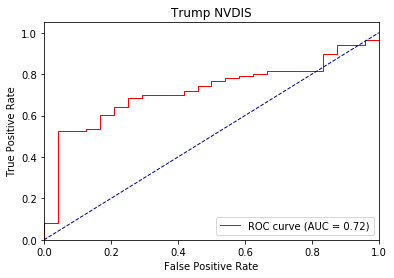

Directory already exists!
dt_nvdis1 1 ap tensor([0.6777, 0.9430]) loss : 0.7699443101882935 0.5300733453075358 tid : 400 tg tensor([[0]], device='cuda:0')
dt_nvdis1 1 ap tensor([0.6563, 0.9464]) loss : 0.2693352699279785 0.5009671178025504 tid : 200 tg tensor([[1]], device='cuda:0')
TEST dt_nvdis1 1 ap tensor([0.4405, 0.8984]) loss : 1.041078805923462 0.5321120194026402 tid : 60 tg tensor([[0]], device='cuda:0')
TEST dt_nvdis1 1 ap tensor([0.5198, 0.9342]) loss : 0.5792392492294312 0.47659725180039036 tid : 180 tg tensor([[1]], device='cuda:0')
TEST dt_nvdis1 1 ap tensor([0.3205, 0.9218]) loss : 0.240189790725708 0.4756203021976974 tid : 420 tg tensor([[1]], device='cuda:0')


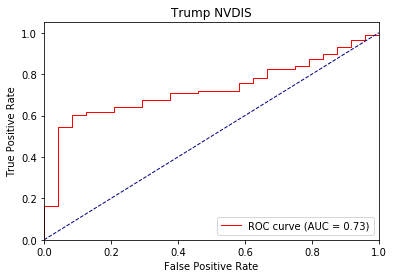

Directory already exists!
dt_nvdis1 2 ap tensor([0.7754, 0.9555]) loss : 0.22714614868164062 0.4408318755978888 tid : 200 tg tensor([[1]], device='cuda:0')
dt_nvdis1 2 ap tensor([0.7681, 0.9621]) loss : 0.7846930027008057 0.4303731721800727 tid : 400 tg tensor([[0]], device='cuda:0')
TEST dt_nvdis1 2 ap tensor([0.4405, 0.8984]) loss : 1.110756516456604 0.5178757395063128 tid : 60 tg tensor([[0]], device='cuda:0')
TEST dt_nvdis1 2 ap tensor([0.5914, 0.9401]) loss : 0.5664490461349487 0.4414865947686709 tid : 180 tg tensor([[1]], device='cuda:0')
TEST dt_nvdis1 2 ap tensor([0.3705, 0.9238]) loss : 0.14516836404800415 0.44873046875 tid : 420 tg tensor([[1]], device='cuda:0')


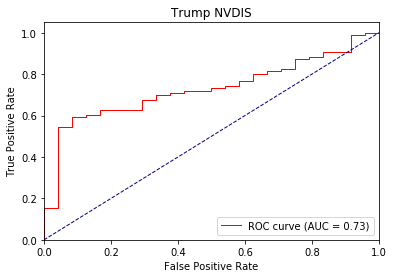

Directory already exists!
dt_lookat3 0 ap tensor([0.4513, 0.9150]) loss : 0.6069012880325317 0.6124944140513738 tid : 400 tg tensor([[1]], device='cuda:0')
dt_lookat3 0 ap tensor([0.4844, 0.9426]) loss : 0.4883209764957428 0.5961641826563411 tid : 200 tg tensor([[1]], device='cuda:0')
TEST dt_lookat3 0 ap tensor([0.2500, 0.9822]) loss : 0.38320669531822205 0.4219093599489757 tid : 60 tg tensor([[1]], device='cuda:0')
TEST dt_lookat3 0 ap tensor([0.2808, 0.8138]) loss : 0.4949842691421509 0.5268694521524967 tid : 180 tg tensor([[1]], device='cuda:0')
TEST dt_lookat3 0 ap tensor([0.2076, 0.9042]) loss : 0.2519274950027466 0.4557966527703044 tid : 420 tg tensor([[1]], device='cuda:0')


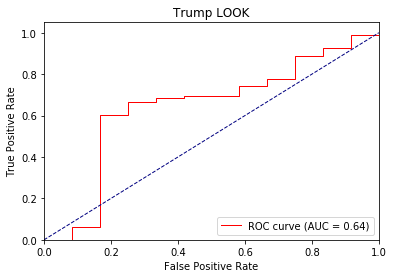

Directory already exists!
dt_lookat3 1 ap tensor([0.4908, 0.9580]) loss : 0.23449617624282837 0.4673271944614056 tid : 200 tg tensor([[1]], device='cuda:0')
dt_lookat3 1 ap tensor([0.5080, 0.9474]) loss : 0.3440116345882416 0.45892574373059547 tid : 400 tg tensor([[1]], device='cuda:0')
TEST dt_lookat3 1 ap tensor([0.2000, 0.9752]) loss : 0.27865058183670044 0.3433831994022642 tid : 60 tg tensor([[1]], device='cuda:0')
TEST dt_lookat3 1 ap tensor([0.4023, 0.8291]) loss : 0.3978692293167114 0.4861485950457744 tid : 180 tg tensor([[1]], device='cuda:0')
TEST dt_lookat3 1 ap tensor([0.2947, 0.9108]) loss : 0.15029311180114746 0.3871086711411948 tid : 420 tg tensor([[1]], device='cuda:0')


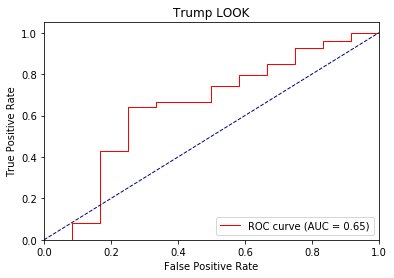

Directory already exists!
dt_lookat3 2 ap tensor([0.5630, 0.9340]) loss : 0.16087651252746582 0.4669889805700955 tid : 200 tg tensor([[1]], device='cuda:0')
dt_lookat3 2 ap tensor([0.6047, 0.9479]) loss : 0.32621070742607117 0.44585336336876424 tid : 400 tg tensor([[1]], device='cuda:0')
TEST dt_lookat3 2 ap tensor([0.2000, 0.9752]) loss : 0.20887219905853271 0.3046562948397228 tid : 60 tg tensor([[1]], device='cuda:0')
TEST dt_lookat3 2 ap tensor([0.4415, 0.8454]) loss : 0.32835644483566284 0.47178263389147246 tid : 180 tg tensor([[1]], device='cuda:0')
TEST dt_lookat3 2 ap tensor([0.3189, 0.9170]) loss : 0.10083591938018799 0.3521549626366123 tid : 420 tg tensor([[1]], device='cuda:0')


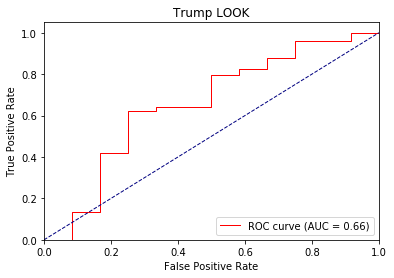

Directory already exists!
dt_eyebrow 0 ap tensor([0.1325, 0.9291]) loss : 0.46722838282585144 0.6848864190672573 tid : 400 tg tensor([[1]], device='cuda:0')
dt_eyebrow 0 ap tensor([0.1259, 0.9190]) loss : 1.0485939979553223 0.6632267712192101 tid : 200 tg tensor([[0]], device='cuda:0')
TEST dt_eyebrow 0 ap tensor([0.5148, 0.7107]) loss : 0.38160890340805054 0.7271544145686286 tid : 60 tg tensor([[1]], device='cuda:0')
TEST dt_eyebrow 0 ap tensor([0.8151, 0.6259]) loss : 0.4437071681022644 0.7906852219349298 tid : 180 tg tensor([[1]], device='cuda:0')
TEST dt_eyebrow 0 ap tensor([0.5408, 0.7493]) loss : 0.27124732732772827 0.6656942966875139 tid : 420 tg tensor([[1]], device='cuda:0')


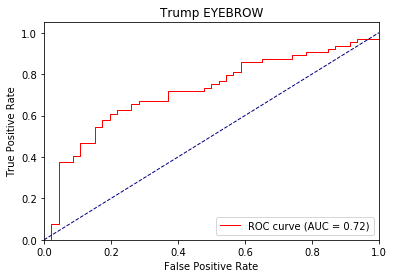

Directory already exists!
dt_eyebrow 1 ap tensor([0.2154, 0.9528]) loss : 2.026707410812378 0.3999951777956154 tid : 200 tg tensor([[0]], device='cuda:0')
dt_eyebrow 1 ap tensor([0.2083, 0.9498]) loss : 0.21692794561386108 0.40174187913801546 tid : 400 tg tensor([[1]], device='cuda:0')
TEST dt_eyebrow 1 ap tensor([0.5259, 0.7655]) loss : 0.24402892589569092 0.8494373645101275 tid : 60 tg tensor([[1]], device='cuda:0')
TEST dt_eyebrow 1 ap tensor([0.8095, 0.6236]) loss : 0.3418155312538147 0.9696051860466982 tid : 180 tg tensor([[1]], device='cuda:0')
TEST dt_eyebrow 1 ap tensor([0.5319, 0.7413]) loss : 0.1410224437713623 0.7428723197061937 tid : 420 tg tensor([[1]], device='cuda:0')


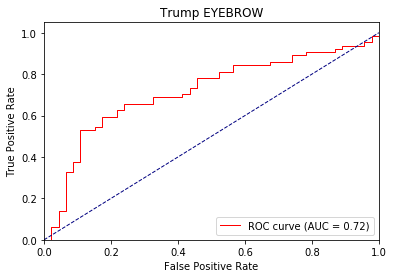

Directory already exists!
dt_eyebrow 2 ap tensor([0.2850, 0.9580]) loss : 2.5142621994018555 0.3185352123781448 tid : 200 tg tensor([[0]], device='cuda:0')
dt_eyebrow 2 ap tensor([0.2187, 0.9673]) loss : 0.13931787014007568 0.30651185524706936 tid : 400 tg tensor([[1]], device='cuda:0')
TEST dt_eyebrow 2 ap tensor([0.5375, 0.7804]) loss : 0.1792525053024292 0.9597946916307721 tid : 60 tg tensor([[1]], device='cuda:0')
TEST dt_eyebrow 2 ap tensor([0.7978, 0.6353]) loss : 0.28217965364456177 1.119979325013283 tid : 180 tg tensor([[1]], device='cuda:0')
TEST dt_eyebrow 2 ap tensor([0.5434, 0.7564]) loss : 0.08988338708877563 0.8248059140456901 tid : 420 tg tensor([[1]], device='cuda:0')


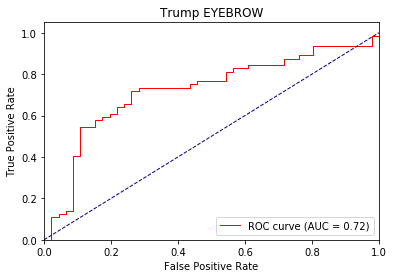

Directory already exists!
dt_atface 0 ap tensor([0.8000, 0.9111]) loss : 0.5736374258995056 0.6257193635921089 tid : 200 tg tensor([[1]], device='cuda:0')
dt_atface 0 ap tensor([0.7470, 0.8956]) loss : 0.5459973812103271 0.5893852502197117 tid : 400 tg tensor([[0]], device='cuda:0')
TEST dt_atface 0 ap tensor([0.5238, 0.9110]) loss : 0.510401725769043 0.583055276955877 tid : 60 tg tensor([[0]], device='cuda:0')
TEST dt_atface 0 ap tensor([0.6342, 0.9165]) loss : 0.7608110308647156 0.5368099021605957 tid : 180 tg tensor([[1]], device='cuda:0')
TEST dt_atface 0 ap tensor([0.7050, 0.9339]) loss : 0.34821486473083496 0.5213547191777073 tid : 420 tg tensor([[1]], device='cuda:0')


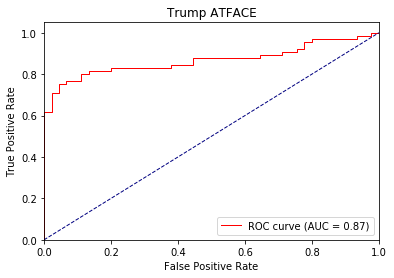

Directory already exists!
dt_atface 1 ap tensor([0.8153, 0.9672]) loss : 0.5095537304878235 0.4577605567311728 tid : 400 tg tensor([[0]], device='cuda:0')
dt_atface 1 ap tensor([0.8182, 0.9433]) loss : 0.2525143027305603 0.45317098346377904 tid : 200 tg tensor([[1]], device='cuda:0')
TEST dt_atface 1 ap tensor([0.4571, 0.8969]) loss : 0.4393264353275299 0.5637113388095584 tid : 60 tg tensor([[0]], device='cuda:0')
TEST dt_atface 1 ap tensor([0.6183, 0.9146]) loss : 0.7915529608726501 0.4833204264824207 tid : 180 tg tensor([[1]], device='cuda:0')
TEST dt_atface 1 ap tensor([0.6989, 0.9359]) loss : 0.2049512267112732 0.46361107649383965 tid : 420 tg tensor([[1]], device='cuda:0')


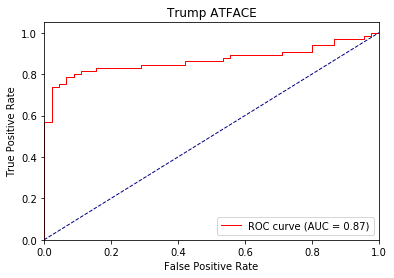

Directory already exists!
dt_atface 2 ap tensor([0.6684, 0.9276]) loss : 0.42452093958854675 0.44364630498669366 tid : 400 tg tensor([[0]], device='cuda:0')
dt_atface 2 ap tensor([0.8264, 0.9408]) loss : 0.17336499691009521 0.39367396992043663 tid : 200 tg tensor([[1]], device='cuda:0')
TEST dt_atface 2 ap tensor([0.4571, 0.8969]) loss : 0.401661217212677 0.5622803398541042 tid : 60 tg tensor([[0]], device='cuda:0')
TEST dt_atface 2 ap tensor([0.6421, 0.9153]) loss : 0.7974934577941895 0.4556479071959471 tid : 180 tg tensor([[1]], device='cuda:0')
TEST dt_atface 2 ap tensor([0.7101, 0.9370]) loss : 0.13497745990753174 0.4349855217304859 tid : 420 tg tensor([[1]], device='cuda:0')


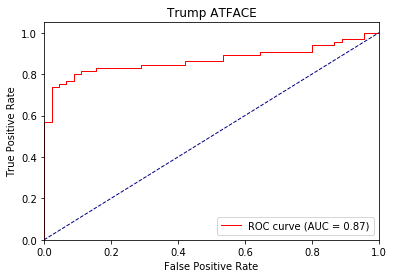

Directory already exists!
dt_feface 0 ap tensor([1., 0.]) loss : 0.5874947309494019 0.66546151638031 tid : 200 tg tensor([[0]], device='cuda:0')
dt_feface 0 ap tensor([1., 0.]) loss : 0.38008758425712585 0.49659662116509656 tid : 400 tg tensor([[0]], device='cuda:0')
TEST dt_feface 0 ap tensor([0.8070, 0.2381]) loss : 0.2870233654975891 0.4678006427628653 tid : 60 tg tensor([[0]], device='cuda:0')
TEST dt_feface 0 ap tensor([0.9335, 0.0694]) loss : 0.39644262194633484 0.3663150851543133 tid : 180 tg tensor([[0]], device='cuda:0')
TEST dt_feface 0 ap tensor([0.9610, 0.0253]) loss : 0.5240507125854492 0.38109848099750476 tid : 420 tg tensor([[0]], device='cuda:0')


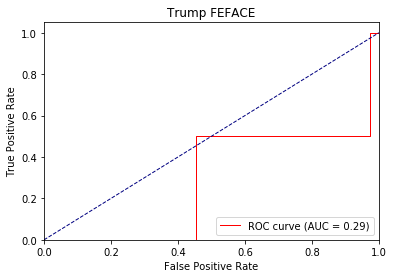

Directory already exists!
dt_feface 1 ap tensor([1., 0.]) loss : 0.24772518873214722 0.26801044816401465 tid : 400 tg tensor([[0]], device='cuda:0')
dt_feface 1 ap tensor([1., 0.]) loss : 0.10077667236328125 0.22529853731943672 tid : 200 tg tensor([[0]], device='cuda:0')
TEST dt_feface 1 ap tensor([0.8128, 0.3214]) loss : 0.1286160945892334 0.42797438161713736 tid : 60 tg tensor([[0]], device='cuda:0')
TEST dt_feface 1 ap tensor([0.9344, 0.0732]) loss : 0.24071800708770752 0.25068944081282 tid : 180 tg tensor([[0]], device='cuda:0')
TEST dt_feface 1 ap tensor([0.9612, 0.0256]) loss : 0.26724231243133545 0.2314720101408906 tid : 420 tg tensor([[0]], device='cuda:0')


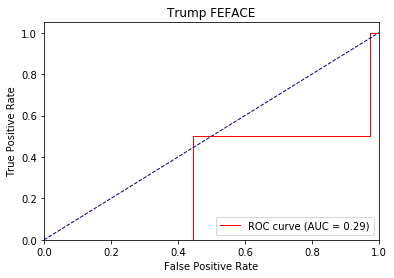

Directory already exists!
dt_feface 2 ap tensor([1., 0.]) loss : 0.054801225662231445 0.12617058417584637 tid : 200 tg tensor([[0]], device='cuda:0')
dt_feface 2 ap tensor([1., 0.]) loss : 0.0685805082321167 0.11332561197199023 tid : 400 tg tensor([[0]], device='cuda:0')
TEST dt_feface 2 ap tensor([0.8823, 0.3333]) loss : 0.05437469482421875 0.4759492874145508 tid : 60 tg tensor([[0]], device='cuda:0')
TEST dt_feface 2 ap tensor([0.9443, 0.0749]) loss : 0.1437596082687378 0.21999066609602708 tid : 180 tg tensor([[0]], device='cuda:0')
TEST dt_feface 2 ap tensor([0.9647, 0.0248]) loss : 0.13731145858764648 0.16713852148789626 tid : 420 tg tensor([[0]], device='cuda:0')


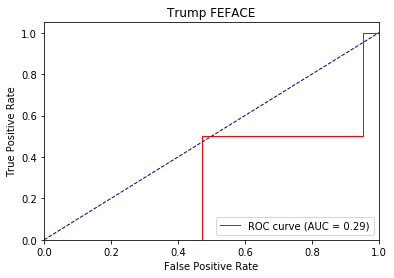

Directory already exists!
dt_hrface 0 ap tensor([0.9893, 0.2180]) loss : 0.5194498300552368 0.6966551503288412 tid : 200 tg tensor([[0]], device='cuda:0')
dt_hrface 0 ap tensor([0.9810, 0.1828]) loss : 0.5723655223846436 0.597420835142195 tid : 400 tg tensor([[0]], device='cuda:0')
TEST dt_hrface 0 ap tensor([1., 0.]) loss : 0.41054072976112366 0.41297327833516256 tid : 60 tg tensor([[0]], device='cuda:0')
TEST dt_hrface 0 ap tensor([0.9905, 0.3687]) loss : 0.5041607618331909 0.44253751177054185 tid : 180 tg tensor([[0]], device='cuda:0')
TEST dt_hrface 0 ap tensor([0.9674, 0.3070]) loss : 0.42709237337112427 0.46553147723386573 tid : 420 tg tensor([[0]], device='cuda:0')


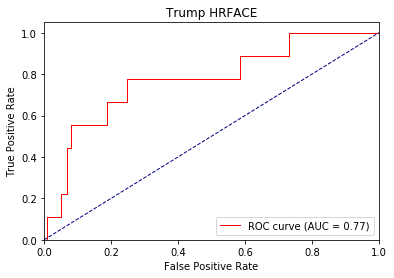

Directory already exists!
dt_hrface 1 ap tensor([0.9843, 0.2207]) loss : 0.2238161563873291 0.39719355749812996 tid : 200 tg tensor([[0]], device='cuda:0')
dt_hrface 1 ap tensor([0.9838, 0.2474]) loss : 0.44107586145401 0.40256944683290297 tid : 400 tg tensor([[0]], device='cuda:0')
TEST dt_hrface 1 ap tensor([1., 0.]) loss : 0.24935492873191833 0.23258223278181894 tid : 60 tg tensor([[0]], device='cuda:0')
TEST dt_hrface 1 ap tensor([0.9948, 0.4762]) loss : 0.3461424708366394 0.3010615568894606 tid : 180 tg tensor([[0]], device='cuda:0')
TEST dt_hrface 1 ap tensor([0.9733, 0.4830]) loss : 0.24255800247192383 0.332888153228131 tid : 420 tg tensor([[0]], device='cuda:0')


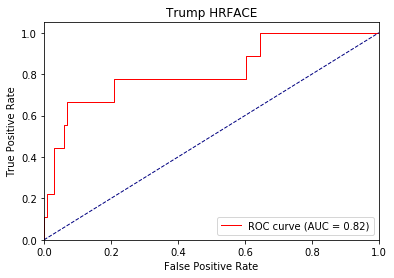

Directory already exists!
dt_hrface 2 ap tensor([0.9816, 0.5286]) loss : 0.11325955390930176 0.312720644062963 tid : 200 tg tensor([[0]], device='cuda:0')
dt_hrface 2 ap tensor([0.9917, 0.5792]) loss : 0.2530781626701355 0.2774347689151764 tid : 400 tg tensor([[0]], device='cuda:0')
TEST dt_hrface 2 ap tensor([1., 0.]) loss : 0.1608012318611145 0.1446014302117484 tid : 60 tg tensor([[0]], device='cuda:0')
TEST dt_hrface 2 ap tensor([0.9948, 0.4762]) loss : 0.24172407388687134 0.23920876399064675 tid : 180 tg tensor([[0]], device='cuda:0')
TEST dt_hrface 2 ap tensor([0.9766, 0.5627]) loss : 0.1438027024269104 0.2748089447453782 tid : 420 tg tensor([[0]], device='cuda:0')


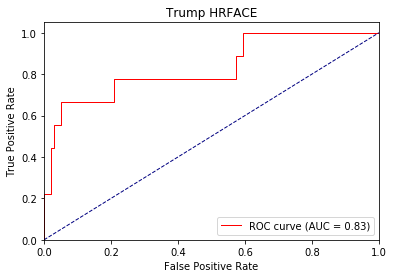

Directory already exists!
dt_saface 0 ap tensor([1., 0.]) loss : 0.4464975595474243 0.5699777770385468 tid : 200 tg tensor([[0]], device='cuda:0')
dt_saface 0 ap tensor([1., 0.]) loss : 0.34955647587776184 0.45666306499108245 tid : 400 tg tensor([[0]], device='cuda:0')
TEST dt_saface 0 ap tensor([1., 0.]) loss : 0.24771839380264282 0.24639834250722611 tid : 60 tg tensor([[0]], device='cuda:0')
TEST dt_saface 0 ap tensor([1., 0.]) loss : 0.4190060794353485 0.2729596251096481 tid : 180 tg tensor([[0]], device='cuda:0')
TEST dt_saface 0 ap tensor([1., 0.]) loss : 0.20301103591918945 0.28989396317974553 tid : 420 tg tensor([[0]], device='cuda:0')


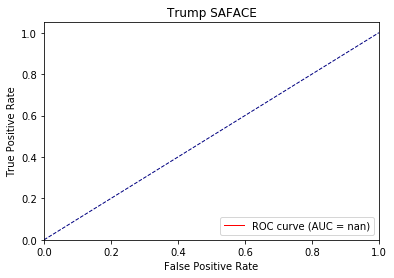

Directory already exists!
dt_saface 1 ap tensor([1., 0.]) loss : 0.1718955636024475 0.2706355081029134 tid : 200 tg tensor([[0]], device='cuda:0')
dt_saface 1 ap tensor([1., 0.]) loss : 0.20705431699752808 0.24602649484361921 tid : 400 tg tensor([[0]], device='cuda:0')
TEST dt_saface 1 ap tensor([1., 0.]) loss : 0.09975206851959229 0.10047319957188197 tid : 60 tg tensor([[0]], device='cuda:0')
TEST dt_saface 1 ap tensor([1., 0.]) loss : 0.2480725646018982 0.1277554310285128 tid : 180 tg tensor([[0]], device='cuda:0')
TEST dt_saface 1 ap tensor([1., 0.]) loss : 0.10725939273834229 0.15239846509891553 tid : 420 tg tensor([[0]], device='cuda:0')


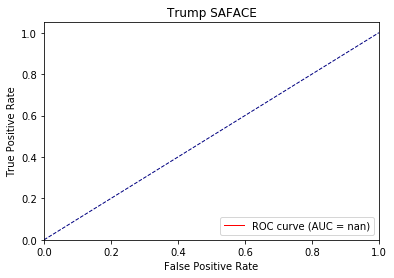

Directory already exists!
dt_saface 2 ap tensor([1., 0.]) loss : 0.06783342361450195 0.10851271030577746 tid : 400 tg tensor([[0]], device='cuda:0')
dt_saface 2 ap tensor([1., 0.]) loss : 0.029772281646728516 0.0973138283630382 tid : 200 tg tensor([[0]], device='cuda:0')
TEST dt_saface 2 ap tensor([1., 0.]) loss : 0.03852880001068115 0.042347533362252374 tid : 60 tg tensor([[0]], device='cuda:0')
TEST dt_saface 2 ap tensor([1., 0.]) loss : 0.13742685317993164 0.06231935284076593 tid : 180 tg tensor([[0]], device='cuda:0')
TEST dt_saface 2 ap tensor([1., 0.]) loss : 0.06222033500671387 0.08638074044342879 tid : 420 tg tensor([[0]], device='cuda:0')


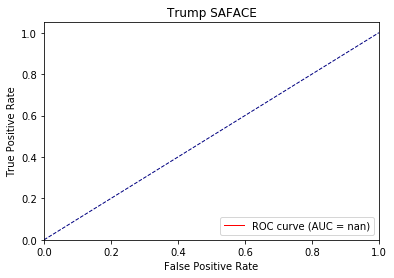

Directory already exists!
dt_neuface 0 ap tensor([0.8922, 0.3750]) loss : 0.6715184450149536 0.7093695043507269 tid : 400 tg tensor([[1]], device='cuda:0')
dt_neuface 0 ap tensor([0.8937, 0.5366]) loss : 0.4655321538448334 0.6070970719740575 tid : 200 tg tensor([[0]], device='cuda:0')
TEST dt_neuface 0 ap tensor([0.8847, 0.2758]) loss : 0.7689642310142517 0.5762489118746349 tid : 60 tg tensor([[1]], device='cuda:0')
TEST dt_neuface 0 ap tensor([0.9336, 0.6565]) loss : 0.638480544090271 0.5477919150621463 tid : 180 tg tensor([[0]], device='cuda:0')
TEST dt_neuface 0 ap tensor([0.9371, 0.6242]) loss : 0.32674023509025574 0.5394804176393446 tid : 420 tg tensor([[0]], device='cuda:0')


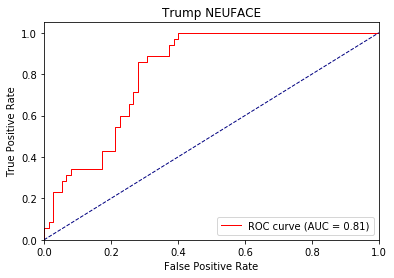

Directory already exists!
dt_neuface 1 ap tensor([0.9265, 0.5803]) loss : 0.38814347982406616 0.5138332304320757 tid : 200 tg tensor([[0]], device='cuda:0')
dt_neuface 1 ap tensor([0.9312, 0.6163]) loss : 0.7457042336463928 0.5000316538472673 tid : 400 tg tensor([[1]], device='cuda:0')
TEST dt_neuface 1 ap tensor([0.8847, 0.2758]) loss : 0.8298724889755249 0.5239993802138737 tid : 60 tg tensor([[1]], device='cuda:0')
TEST dt_neuface 1 ap tensor([0.9408, 0.6477]) loss : 0.6210759878158569 0.4836468413854257 tid : 180 tg tensor([[0]], device='cuda:0')
TEST dt_neuface 1 ap tensor([0.9424, 0.6365]) loss : 0.2005344033241272 0.47751225023479255 tid : 420 tg tensor([[0]], device='cuda:0')


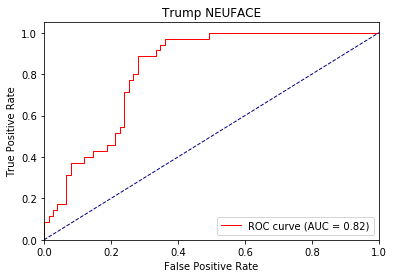

Directory already exists!
dt_neuface 2 ap tensor([0.9339, 0.6862]) loss : 0.20023059844970703 0.450573360378092 tid : 200 tg tensor([[0]], device='cuda:0')
dt_neuface 2 ap tensor([0.9272, 0.6648]) loss : 0.7148813009262085 0.4610703572359952 tid : 400 tg tensor([[1]], device='cuda:0')
TEST dt_neuface 2 ap tensor([0.9046, 0.3313]) loss : 0.839544415473938 0.5060550229890006 tid : 60 tg tensor([[1]], device='cuda:0')
TEST dt_neuface 2 ap tensor([0.9431, 0.6456]) loss : 0.6246477365493774 0.4543950909223312 tid : 180 tg tensor([[0]], device='cuda:0')
TEST dt_neuface 2 ap tensor([0.9436, 0.6489]) loss : 0.13091933727264404 0.44822058409124943 tid : 420 tg tensor([[0]], device='cuda:0')


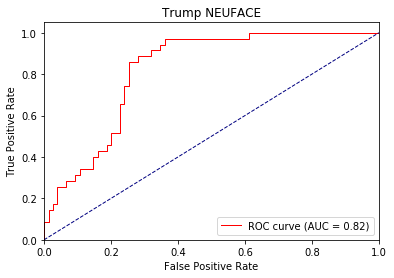

Directory already exists!
dt_inapprop 0 ap tensor([0.9331, 0.0868]) loss : 0.5556827783584595 0.6160975228269379 tid : 400 tg tensor([[0]], device='cuda:0')
dt_inapprop 0 ap tensor([0.9533, 0.0840]) loss : 0.3939884305000305 0.5666686347616252 tid : 200 tg tensor([[0]], device='cuda:0')
TEST dt_inapprop 0 ap tensor([1., 0.]) loss : 0.3503355085849762 0.3335184667791639 tid : 60 tg tensor([[0]], device='cuda:0')
TEST dt_inapprop 0 ap tensor([0.9450, 0.3775]) loss : 0.8804295659065247 0.42919248266097826 tid : 180 tg tensor([[1]], device='cuda:0')
TEST dt_inapprop 0 ap tensor([0.8923, 0.1160]) loss : 0.42238888144493103 0.4591696180485107 tid : 420 tg tensor([[0]], device='cuda:0')


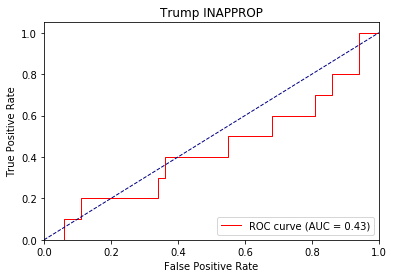

Directory already exists!
dt_inapprop 1 ap tensor([0.9672, 0.0578]) loss : 0.25214284658432007 0.35025947941607566 tid : 400 tg tensor([[0]], device='cuda:0')
dt_inapprop 1 ap tensor([0.9619, 0.0613]) loss : 0.1649436354637146 0.35037462274555253 tid : 200 tg tensor([[0]], device='cuda:0')
TEST dt_inapprop 1 ap tensor([1., 0.]) loss : 0.18693983554840088 0.17412665486335754 tid : 60 tg tensor([[0]], device='cuda:0')
TEST dt_inapprop 1 ap tensor([0.9424, 0.3639]) loss : 1.1319873332977295 0.34247636030881834 tid : 180 tg tensor([[1]], device='cuda:0')
TEST dt_inapprop 1 ap tensor([0.9163, 0.1281]) loss : 0.27899056673049927 0.37000499682112054 tid : 420 tg tensor([[0]], device='cuda:0')


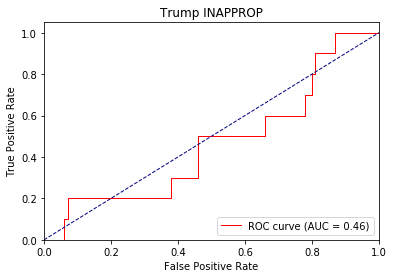

Directory already exists!
dt_inapprop 2 ap tensor([0.9718, 0.0776]) loss : 0.09602606296539307 0.2507156956137395 tid : 400 tg tensor([[0]], device='cuda:0')
dt_inapprop 2 ap tensor([0.9727, 0.0766]) loss : 0.06667649745941162 0.24785466684679094 tid : 200 tg tensor([[0]], device='cuda:0')
TEST dt_inapprop 2 ap tensor([1., 0.]) loss : 0.10935187339782715 0.10384485551289149 tid : 60 tg tensor([[0]], device='cuda:0')
TEST dt_inapprop 2 ap tensor([0.9425, 0.3659]) loss : 1.3631243705749512 0.31824457492583835 tid : 180 tg tensor([[1]], device='cuda:0')
TEST dt_inapprop 2 ap tensor([0.9256, 0.1436]) loss : 0.19180303812026978 0.3385519463937361 tid : 420 tg tensor([[0]], device='cuda:0')


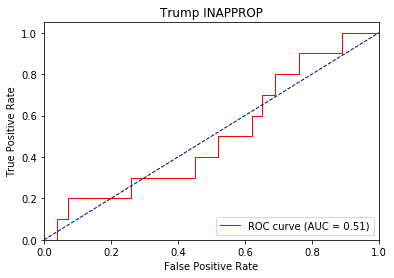

Directory already exists!
dt_affgest 0 ap tensor([0.9712, 0.0246]) loss : 0.37884676456451416 0.5540725906428537 tid : 200 tg tensor([[0]], device='cuda:0')
dt_affgest 0 ap tensor([0.9768, 0.0374]) loss : 0.38742175698280334 0.5228632011656034 tid : 400 tg tensor([[0]], device='cuda:0')
TEST dt_affgest 0 ap tensor([1., 0.]) loss : 0.246282696723938 0.2904006391763687 tid : 60 tg tensor([[0]], device='cuda:0')
TEST dt_affgest 0 ap tensor([1., 0.]) loss : 0.3752211928367615 0.29715374035713 tid : 180 tg tensor([[0]], device='cuda:0')
TEST dt_affgest 0 ap tensor([1., 0.]) loss : 0.42074355483055115 0.3370936123224405 tid : 420 tg tensor([[0]], device='cuda:0')


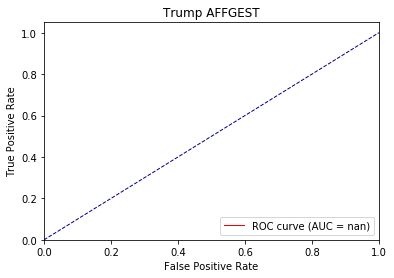

Directory already exists!
dt_affgest 1 ap tensor([0.9897, 0.0544]) loss : 0.1712610125541687 0.3049715158732041 tid : 200 tg tensor([[0]], device='cuda:0')
dt_affgest 1 ap tensor([0.9893, 0.0630]) loss : 0.21158790588378906 0.3046867772368074 tid : 400 tg tensor([[0]], device='cuda:0')
TEST dt_affgest 1 ap tensor([1., 0.]) loss : 0.12750661373138428 0.14785569054739817 tid : 60 tg tensor([[0]], device='cuda:0')
TEST dt_affgest 1 ap tensor([1., 0.]) loss : 0.2304396629333496 0.15945559587234107 tid : 180 tg tensor([[0]], device='cuda:0')
TEST dt_affgest 1 ap tensor([1., 0.]) loss : 0.2600066065788269 0.19978575523083025 tid : 420 tg tensor([[0]], device='cuda:0')


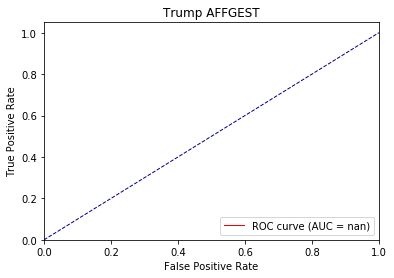

Directory already exists!
dt_affgest 2 ap tensor([0.9872, 0.0395]) loss : 0.10558915138244629 0.19825111572132553 tid : 400 tg tensor([[0]], device='cuda:0')
dt_affgest 2 ap tensor([0.9834, 0.0457]) loss : 0.08694589138031006 0.2133355610298388 tid : 200 tg tensor([[0]], device='cuda:0')
TEST dt_affgest 2 ap tensor([1., 0.]) loss : 0.07036113739013672 0.08445455346788679 tid : 60 tg tensor([[0]], device='cuda:0')
TEST dt_affgest 2 ap tensor([1., 0.]) loss : 0.14683109521865845 0.09537550424918151 tid : 180 tg tensor([[0]], device='cuda:0')
TEST dt_affgest 2 ap tensor([1., 0.]) loss : 0.17118436098098755 0.13097049574275593 tid : 420 tg tensor([[0]], device='cuda:0')


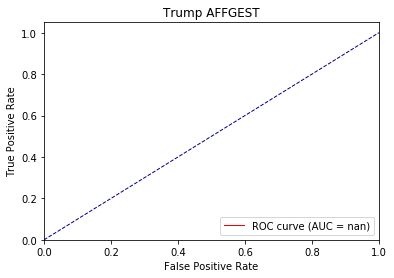

Directory already exists!
dt_defgest 0 ap tensor([0.8692, 0.6192]) loss : 0.7843827605247498 0.6270028161897994 tid : 200 tg tensor([[1]], device='cuda:0')
dt_defgest 0 ap tensor([0.8935, 0.6224]) loss : 0.41455963253974915 0.5878374449374891 tid : 400 tg tensor([[0]], device='cuda:0')
TEST dt_defgest 0 ap tensor([0.9397, 0.2917]) loss : 1.086588740348816 0.555557906627655 tid : 60 tg tensor([[1]], device='cuda:0')
TEST dt_defgest 0 ap tensor([0.9263, 0.6788]) loss : 1.0491936206817627 0.5442226445063566 tid : 180 tg tensor([[1]], device='cuda:0')
TEST dt_defgest 0 ap tensor([0.8885, 0.6933]) loss : 0.5806578993797302 0.575434684753418 tid : 420 tg tensor([[1]], device='cuda:0')


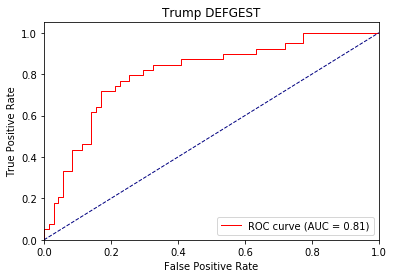

Directory already exists!
dt_defgest 1 ap tensor([0.9240, 0.7159]) loss : 0.30113041400909424 0.518549828018461 tid : 400 tg tensor([[0]], device='cuda:0')
dt_defgest 1 ap tensor([0.9211, 0.7236]) loss : 0.8079006671905518 0.5209948476828659 tid : 200 tg tensor([[1]], device='cuda:0')
TEST dt_defgest 1 ap tensor([0.9397, 0.2917]) loss : 1.2931331396102905 0.5347574395792825 tid : 60 tg tensor([[1]], device='cuda:0')
TEST dt_defgest 1 ap tensor([0.9378, 0.6994]) loss : 1.190740942955017 0.49635219497558397 tid : 180 tg tensor([[1]], device='cuda:0')
TEST dt_defgest 1 ap tensor([0.9013, 0.7216]) loss : 0.5088925361633301 0.5342218217613933 tid : 420 tg tensor([[1]], device='cuda:0')


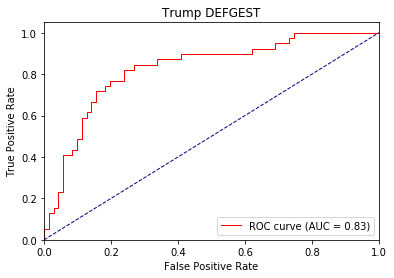

Directory already exists!
dt_defgest 2 ap tensor([0.9239, 0.7582]) loss : 0.8254784345626831 0.49121759650863217 tid : 200 tg tensor([[1]], device='cuda:0')
dt_defgest 2 ap tensor([0.9368, 0.7877]) loss : 0.2529774308204651 0.46954797321352465 tid : 400 tg tensor([[0]], device='cuda:0')
TEST dt_defgest 2 ap tensor([0.9334, 0.2500]) loss : 1.4701848030090332 0.527434378862381 tid : 60 tg tensor([[1]], device='cuda:0')
TEST dt_defgest 2 ap tensor([0.9368, 0.6924]) loss : 1.3093116283416748 0.4703653317231398 tid : 180 tg tensor([[1]], device='cuda:0')
TEST dt_defgest 2 ap tensor([0.9045, 0.7500]) loss : 0.4626426100730896 0.5091025076069675 tid : 420 tg tensor([[1]], device='cuda:0')


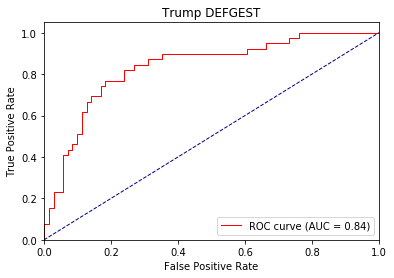

Directory already exists!
dt_agentic 0 ap tensor([0.7040, 0.8855]) loss : 0.7890163660049438 0.6142262074113624 tid : 400 tg tensor([[0]], device='cuda:0')
dt_agentic 0 ap tensor([0.6980, 0.8898]) loss : 0.42037639021873474 0.6122067730341639 tid : 200 tg tensor([[1]], device='cuda:0')
TEST dt_agentic 0 ap tensor([0.7857, 0.8714]) loss : 0.7082356810569763 0.657096654176712 tid : 60 tg tensor([[0]], device='cuda:0')
TEST dt_agentic 0 ap tensor([0.8808, 0.8553]) loss : 0.5662219524383545 0.5715936109041556 tid : 180 tg tensor([[1]], device='cuda:0')
TEST dt_agentic 0 ap tensor([0.7988, 0.8207]) loss : 0.256250262260437 0.5771895388325492 tid : 420 tg tensor([[1]], device='cuda:0')


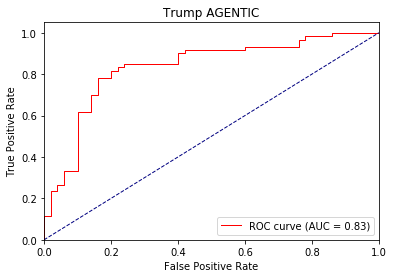

Directory already exists!
dt_agentic 1 ap tensor([0.9057, 0.9650]) loss : 0.7765842080116272 0.4884348622074834 tid : 400 tg tensor([[0]], device='cuda:0')
dt_agentic 1 ap tensor([0.8362, 0.9658]) loss : 0.22670745849609375 0.4477098737061728 tid : 200 tg tensor([[1]], device='cuda:0')
TEST dt_agentic 1 ap tensor([0.7857, 0.8714]) loss : 0.6426805257797241 0.6567574654306684 tid : 60 tg tensor([[0]], device='cuda:0')
TEST dt_agentic 1 ap tensor([0.8752, 0.8819]) loss : 0.5728170871734619 0.5288881208652105 tid : 180 tg tensor([[1]], device='cuda:0')
TEST dt_agentic 1 ap tensor([0.8130, 0.8568]) loss : 0.14864444732666016 0.5311663429160695 tid : 420 tg tensor([[1]], device='cuda:0')


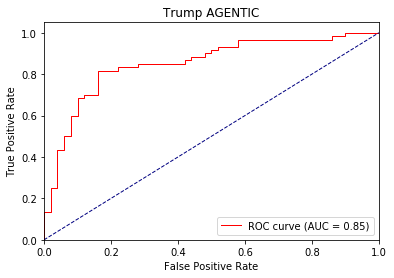

Directory already exists!
dt_agentic 2 ap tensor([0.8674, 0.9774]) loss : 0.6545550227165222 0.3603774290458829 tid : 400 tg tensor([[0]], device='cuda:0')
dt_agentic 2 ap tensor([0.8412, 0.9719]) loss : 0.1390761137008667 0.36255865803058135 tid : 200 tg tensor([[1]], device='cuda:0')
TEST dt_agentic 2 ap tensor([0.7857, 0.8714]) loss : 0.5831525921821594 0.681554798568998 tid : 60 tg tensor([[0]], device='cuda:0')
TEST dt_agentic 2 ap tensor([0.8764, 0.9052]) loss : 0.5775655508041382 0.5132569212179917 tid : 180 tg tensor([[1]], device='cuda:0')
TEST dt_agentic 2 ap tensor([0.8085, 0.8564]) loss : 0.09368622303009033 0.5165941184693641 tid : 420 tg tensor([[1]], device='cuda:0')


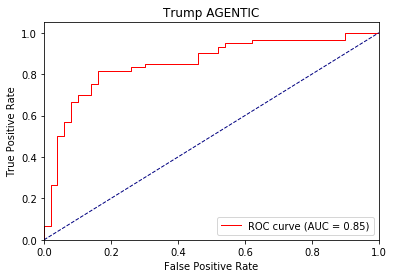

Directory already exists!
dt_waveoff 0 ap tensor([1., 0.]) loss : 0.46854034066200256 0.6146001930236816 tid : 200 tg tensor([[0]], device='cuda:0')
dt_waveoff 0 ap tensor([1., 0.]) loss : 0.38754215836524963 0.49985507394119005 tid : 400 tg tensor([[0]], device='cuda:0')
TEST dt_waveoff 0 ap tensor([0.9493, 0.1250]) loss : 0.24182307720184326 0.3579308177743639 tid : 60 tg tensor([[0]], device='cuda:0')
TEST dt_waveoff 0 ap tensor([0.8657, 0.1850]) loss : 0.34912604093551636 0.4585445943551186 tid : 180 tg tensor([[0]], device='cuda:0')
TEST dt_waveoff 0 ap tensor([0.9071, 0.0715]) loss : 0.30100899934768677 0.41123243380378893 tid : 420 tg tensor([[0]], device='cuda:0')


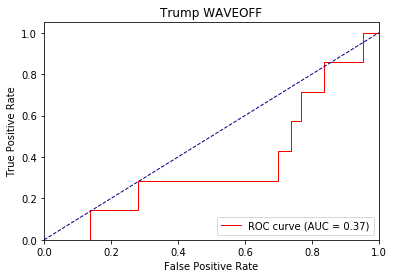

Directory already exists!
dt_waveoff 1 ap tensor([1., 0.]) loss : 0.16179406642913818 0.23511669757189574 tid : 400 tg tensor([[0]], device='cuda:0')
dt_waveoff 1 ap tensor([1., 0.]) loss : 0.0832744836807251 0.2152555367633617 tid : 200 tg tensor([[0]], device='cuda:0')
TEST dt_waveoff 1 ap tensor([0.9822, 0.2500]) loss : 0.09836101531982422 0.26223093271255493 tid : 60 tg tensor([[0]], device='cuda:0')
TEST dt_waveoff 1 ap tensor([0.8623, 0.1684]) loss : 0.18601953983306885 0.4472507819151267 tid : 180 tg tensor([[0]], device='cuda:0')
TEST dt_waveoff 1 ap tensor([0.9065, 0.0669]) loss : 0.15107786655426025 0.3244526949557629 tid : 420 tg tensor([[0]], device='cuda:0')


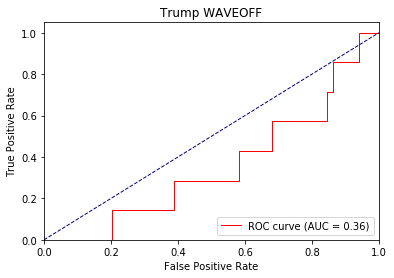

Directory already exists!
dt_waveoff 2 ap tensor([1., 0.]) loss : 0.053626418113708496 0.10683227159652203 tid : 400 tg tensor([[0]], device='cuda:0')
dt_waveoff 2 ap tensor([1., 0.]) loss : 0.03179764747619629 0.09944081567024272 tid : 200 tg tensor([[0]], device='cuda:0')
TEST dt_waveoff 2 ap tensor([0.9822, 0.2500]) loss : 0.041455984115600586 0.25680868114743916 tid : 60 tg tensor([[0]], device='cuda:0')
TEST dt_waveoff 2 ap tensor([0.8677, 0.1677]) loss : 0.09722292423248291 0.5152056217193604 tid : 180 tg tensor([[0]], device='cuda:0')
TEST dt_waveoff 2 ap tensor([0.9072, 0.0663]) loss : 0.07731997966766357 0.316894742158743 tid : 420 tg tensor([[0]], device='cuda:0')


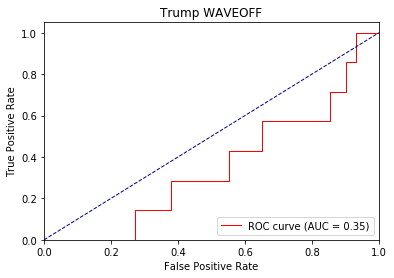

Directory already exists!
dt_nvtic1 0 ap tensor([0.8756, 0.2021]) loss : 0.5499075651168823 0.6089625646587179 tid : 400 tg tensor([[0]], device='cuda:0')
dt_nvtic1 0 ap tensor([0.8886, 0.1959]) loss : 0.30743342638015747 0.5753110524486093 tid : 200 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic1 0 ap tensor([0.7713, 0.5686]) loss : 0.4241373538970947 0.5989212883370263 tid : 60 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic1 0 ap tensor([0.8679, 0.3462]) loss : 0.4711442291736603 0.5171532309972323 tid : 180 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic1 0 ap tensor([0.9340, 0.2438]) loss : 0.4249138832092285 0.4827305792452215 tid : 420 tg tensor([[0]], device='cuda:0')


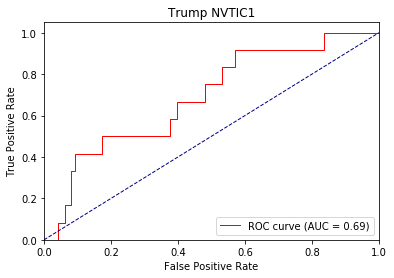

Directory already exists!
dt_nvtic1 1 ap tensor([0.9541, 0.2973]) loss : 0.460175096988678 0.4735861405730247 tid : 400 tg tensor([[0]], device='cuda:0')
dt_nvtic1 1 ap tensor([0.9553, 0.3371]) loss : 0.14227372407913208 0.4228040923301439 tid : 200 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic1 1 ap tensor([0.8299, 0.5938]) loss : 0.32910624146461487 0.5737063714436123 tid : 60 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic1 1 ap tensor([0.8859, 0.4761]) loss : 0.39193665981292725 0.46034802687473786 tid : 180 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic1 1 ap tensor([0.9381, 0.2525]) loss : 0.25676751136779785 0.4102970132460961 tid : 420 tg tensor([[0]], device='cuda:0')


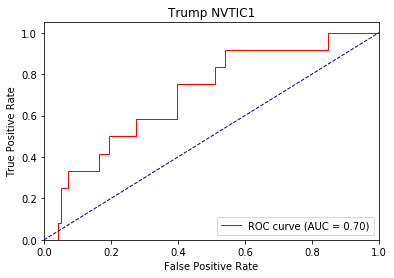

Directory already exists!
dt_nvtic1 2 ap tensor([0.9647, 0.4805]) loss : 0.3570626378059387 0.3936635170664106 tid : 400 tg tensor([[0]], device='cuda:0')
dt_nvtic1 2 ap tensor([0.9599, 0.3297]) loss : 0.0910940170288086 0.37873497258972477 tid : 200 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic1 2 ap tensor([0.8406, 0.6071]) loss : 0.2908417582511902 0.576264602797372 tid : 60 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic1 2 ap tensor([0.8943, 0.4373]) loss : 0.3598870038986206 0.44423089883266353 tid : 180 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic1 2 ap tensor([0.9395, 0.2547]) loss : 0.16504263877868652 0.3839973384862418 tid : 420 tg tensor([[0]], device='cuda:0')


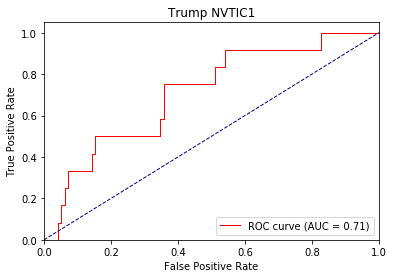

Directory already exists!
dt_nvtic2 0 ap tensor([0.8240, 0.3232]) loss : 0.7716638445854187 0.7272979164123535 tid : 400 tg tensor([[0]], device='cuda:0')
dt_nvtic2 0 ap tensor([0.9324, 0.1698]) loss : 0.3716810643672943 0.6000028923153877 tid : 200 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic2 0 ap tensor([0.5899, 0.7161]) loss : 0.4571359157562256 0.8207902184554509 tid : 60 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic2 0 ap tensor([0.7599, 0.3547]) loss : 0.5595601797103882 0.5894705660832233 tid : 180 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic2 0 ap tensor([0.8512, 0.2976]) loss : 0.5320636034011841 0.5423790065796821 tid : 420 tg tensor([[0]], device='cuda:0')


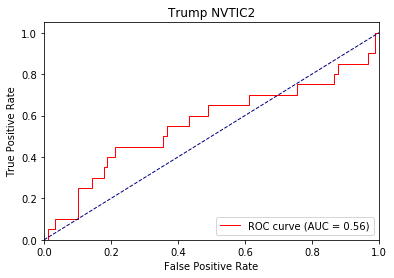

Directory already exists!
dt_nvtic2 1 ap tensor([0.9716, 0.1138]) loss : 0.4181002378463745 0.4259099649346393 tid : 400 tg tensor([[0]], device='cuda:0')
dt_nvtic2 1 ap tensor([0.9712, 0.2321]) loss : 0.26819300651550293 0.43003254804280727 tid : 200 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic2 1 ap tensor([0.5869, 0.6935]) loss : 0.3042900562286377 1.0045739433595113 tid : 60 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic2 1 ap tensor([0.7677, 0.3350]) loss : 0.44266629219055176 0.5588833414591275 tid : 180 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic2 1 ap tensor([0.8581, 0.2828]) loss : 0.3055000901222229 0.4709532005446298 tid : 420 tg tensor([[0]], device='cuda:0')


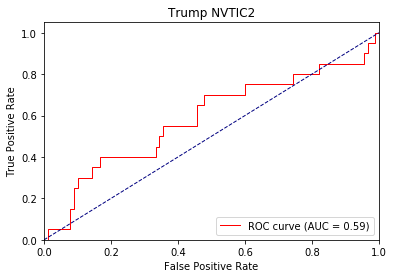

Directory already exists!
dt_nvtic2 2 ap tensor([0.9751, 0.1596]) loss : 0.27060478925704956 0.3523810444734035 tid : 400 tg tensor([[0]], device='cuda:0')
dt_nvtic2 2 ap tensor([0.9609, 0.1235]) loss : 0.12700039148330688 0.35427639943308536 tid : 200 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic2 2 ap tensor([0.6527, 0.6666]) loss : 0.23013049364089966 1.168915012053081 tid : 60 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic2 2 ap tensor([0.7917, 0.3321]) loss : 0.3774318993091583 0.5732352779461787 tid : 180 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic2 2 ap tensor([0.8708, 0.2959]) loss : 0.18580466508865356 0.45316609543758435 tid : 420 tg tensor([[0]], device='cuda:0')


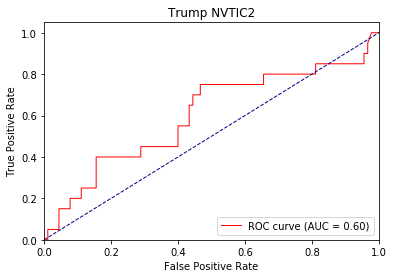

Directory already exists!
dt_nvtic3 0 ap tensor([0.4519, 0.4104]) loss : 0.7347814440727234 0.7558709939320882 tid : 400 tg tensor([[1]], device='cuda:0')
dt_nvtic3 0 ap tensor([0.6376, 0.4634]) loss : 0.7952538132667542 0.7026638572032635 tid : 200 tg tensor([[1]], device='cuda:0')
TEST dt_nvtic3 0 ap tensor([0.1111, 0.9383]) loss : 0.6699543595314026 0.6860067141907555 tid : 60 tg tensor([[1]], device='cuda:0')
TEST dt_nvtic3 0 ap tensor([0.4709, 0.9264]) loss : 0.6420673727989197 0.6417003709536332 tid : 180 tg tensor([[1]], device='cuda:0')
TEST dt_nvtic3 0 ap tensor([0.5678, 0.7177]) loss : 0.6159263849258423 0.6624872786003154 tid : 420 tg tensor([[0]], device='cuda:0')


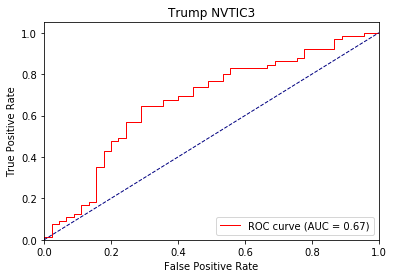

Directory already exists!
dt_nvtic3 1 ap tensor([0.7356, 0.8404]) loss : 0.8904901146888733 0.5912194593803032 tid : 200 tg tensor([[1]], device='cuda:0')
dt_nvtic3 1 ap tensor([0.7764, 0.8575]) loss : 0.4054035544395447 0.5507987325301256 tid : 400 tg tensor([[1]], device='cuda:0')
TEST dt_nvtic3 1 ap tensor([0.1429, 0.9589]) loss : 0.5731440186500549 0.6957054819379535 tid : 60 tg tensor([[1]], device='cuda:0')
TEST dt_nvtic3 1 ap tensor([0.6323, 0.9452]) loss : 0.583092987537384 0.5960444655173864 tid : 180 tg tensor([[1]], device='cuda:0')
TEST dt_nvtic3 1 ap tensor([0.6068, 0.7776]) loss : 0.4616093337535858 0.6280993334539644 tid : 420 tg tensor([[0]], device='cuda:0')


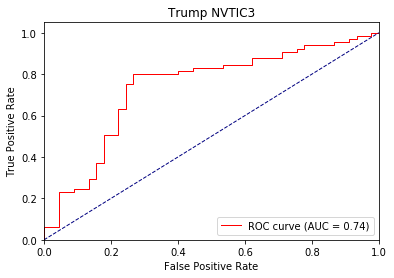

Directory already exists!
dt_nvtic3 2 ap tensor([0.6193, 0.8851]) loss : 0.37957167625427246 0.5716958443323771 tid : 400 tg tensor([[1]], device='cuda:0')
dt_nvtic3 2 ap tensor([0.7991, 0.8995]) loss : 0.9046886563301086 0.5057533165635584 tid : 200 tg tensor([[1]], device='cuda:0')
TEST dt_nvtic3 2 ap tensor([0.1429, 0.9589]) loss : 0.5123746395111084 0.7183008811303547 tid : 60 tg tensor([[1]], device='cuda:0')
TEST dt_nvtic3 2 ap tensor([0.6769, 0.9452]) loss : 0.546178936958313 0.5790704855552087 tid : 180 tg tensor([[1]], device='cuda:0')
TEST dt_nvtic3 2 ap tensor([0.6312, 0.7927]) loss : 0.36694222688674927 0.6165702555860791 tid : 420 tg tensor([[0]], device='cuda:0')


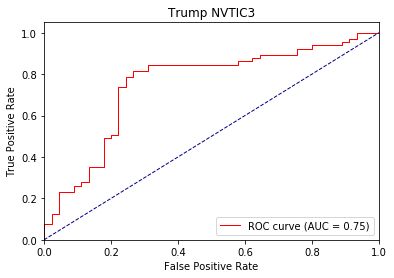

Directory already exists!
dt_nvtic5 0 ap tensor([0.9716, 0.0271]) loss : 0.4646029472351074 0.5630540324531439 tid : 400 tg tensor([[0]], device='cuda:0')
dt_nvtic5 0 ap tensor([0.9727, 0.0271]) loss : 0.23344528675079346 0.514525326446713 tid : 200 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic5 0 ap tensor([1., 0.]) loss : 0.42767471075057983 0.3139690990958895 tid : 60 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic5 0 ap tensor([0.9885, 0.0667]) loss : 0.5726711750030518 0.36138141460907763 tid : 180 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic5 0 ap tensor([0.9895, 0.0420]) loss : 0.4047113060951233 0.3793155695055867 tid : 420 tg tensor([[0]], device='cuda:0')


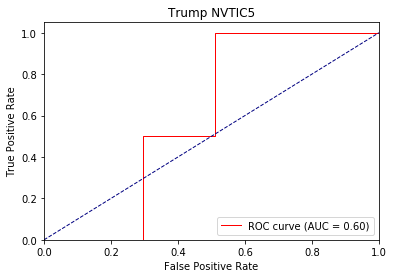

Directory already exists!
dt_nvtic5 1 ap tensor([0.9663, 0.0177]) loss : 0.16126424074172974 0.31221194295656113 tid : 200 tg tensor([[0]], device='cuda:0')
dt_nvtic5 1 ap tensor([0.9709, 0.0161]) loss : 0.26785147190093994 0.3063987554647984 tid : 400 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic5 1 ap tensor([1., 0.]) loss : 0.21276086568832397 0.14569430691855295 tid : 60 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic5 1 ap tensor([0.9914, 0.0833]) loss : 0.3668586015701294 0.21192543705304465 tid : 180 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic5 1 ap tensor([0.9925, 0.0544]) loss : 0.22683066129684448 0.22785655515534536 tid : 420 tg tensor([[0]], device='cuda:0')


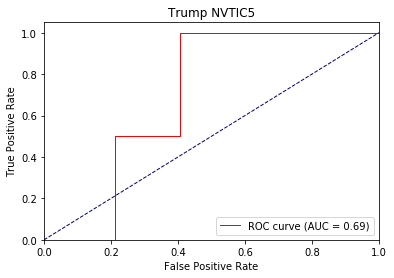

Directory already exists!
dt_nvtic5 2 ap tensor([0.9844, 0.0215]) loss : 0.09787189960479736 0.1728064825660304 tid : 400 tg tensor([[0]], device='cuda:0')
dt_nvtic5 2 ap tensor([0.9853, 0.0254]) loss : 0.05246412754058838 0.17540434254726894 tid : 200 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic5 2 ap tensor([1., 0.]) loss : 0.11272847652435303 0.07678610512188502 tid : 60 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic5 2 ap tensor([0.9957, 0.1429]) loss : 0.23840487003326416 0.14976085454989702 tid : 180 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic5 2 ap tensor([0.9943, 0.0663]) loss : 0.13539791107177734 0.162106556224299 tid : 420 tg tensor([[0]], device='cuda:0')


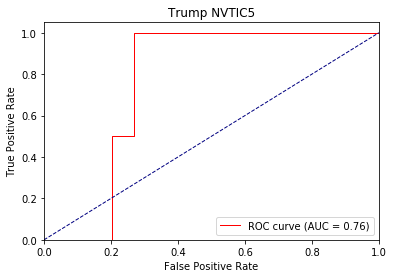

Directory already exists!
dt_nvtic4 0 ap tensor([0.9559, 0.0285]) loss : 0.41977065801620483 0.6177434800412711 tid : 200 tg tensor([[0]], device='cuda:0')
dt_nvtic4 0 ap tensor([0.9605, 0.0280]) loss : 0.4505767524242401 0.596743825128523 tid : 400 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic4 0 ap tensor([0.9493, 0.1250]) loss : 0.2985343933105469 0.42482899342264446 tid : 60 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic4 0 ap tensor([0.9814, 0.0476]) loss : 0.470464825630188 0.3756457765897115 tid : 180 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic4 0 ap tensor([0.9849, 0.0145]) loss : 0.37667515873908997 0.39865417729367264 tid : 420 tg tensor([[0]], device='cuda:0')


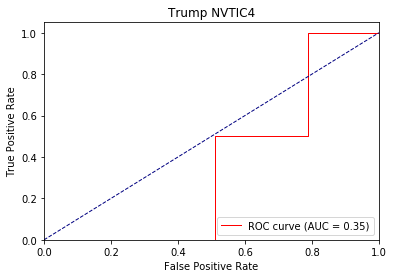

Directory already exists!
dt_nvtic4 1 ap tensor([0.9694, 0.1213]) loss : 0.22205311059951782 0.36042287361990544 tid : 200 tg tensor([[0]], device='cuda:0')
dt_nvtic4 1 ap tensor([0.9846, 0.0841]) loss : 0.2655491828918457 0.325782094226808 tid : 400 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic4 1 ap tensor([0.9383, 0.1111]) loss : 0.15363085269927979 0.30060671482767376 tid : 60 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic4 1 ap tensor([0.9754, 0.0400]) loss : 0.30410903692245483 0.22426605988771486 tid : 180 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic4 1 ap tensor([0.9839, 0.0141]) loss : 0.19838368892669678 0.23339784472853273 tid : 420 tg tensor([[0]], device='cuda:0')


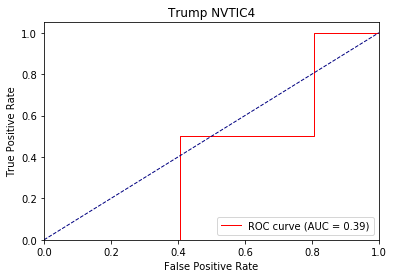

Directory already exists!
dt_nvtic4 2 ap tensor([0.9668, 0.0667]) loss : 0.1684187650680542 0.24155861616134644 tid : 400 tg tensor([[0]], device='cuda:0')
dt_nvtic4 2 ap tensor([0.9794, 0.0506]) loss : 0.08974802494049072 0.21365381850570928 tid : 200 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic4 2 ap tensor([0.9383, 0.1111]) loss : 0.08976411819458008 0.2708559249128614 tid : 60 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic4 2 ap tensor([0.9736, 0.0385]) loss : 0.20770835876464844 0.16777148766395372 tid : 180 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic4 2 ap tensor([0.9849, 0.0145]) loss : 0.11729931831359863 0.16202008494964013 tid : 420 tg tensor([[0]], device='cuda:0')


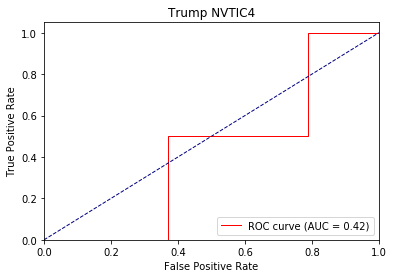

Directory already exists!
dt_interruptions 0 ap tensor([0.9477, 0.2335]) loss : 0.6392213702201843 0.6834133273208296 tid : 400 tg tensor([[0]], device='cuda:0')
dt_interruptions 0 ap tensor([0.9179, 0.2114]) loss : 0.8683903217315674 0.6837967647158582 tid : 200 tg tensor([[1]], device='cuda:0')
TEST dt_interruptions 0 ap tensor([1., 0.]) loss : 0.35988491773605347 0.3658031438078199 tid : 60 tg tensor([[0]], device='cuda:0')
TEST dt_interruptions 0 ap tensor([0.9625, 0.0323]) loss : 0.5895155668258667 0.4307080904642741 tid : 180 tg tensor([[0]], device='cuda:0')
TEST dt_interruptions 0 ap tensor([0.9366, 0.0500]) loss : 0.44543251395225525 0.4866450471537454 tid : 420 tg tensor([[0]], device='cuda:0')


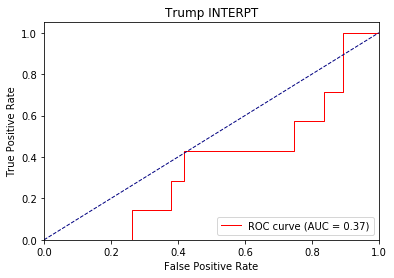

Directory already exists!
dt_interruptions 1 ap tensor([0.9741, 0.3712]) loss : 0.3763096332550049 0.43356380272995343 tid : 400 tg tensor([[0]], device='cuda:0')
dt_interruptions 1 ap tensor([0.9367, 0.1724]) loss : 1.9213287830352783 0.37833715099554793 tid : 200 tg tensor([[1]], device='cuda:0')
TEST dt_interruptions 1 ap tensor([1., 0.]) loss : 0.21285146474838257 0.20237142273357936 tid : 60 tg tensor([[0]], device='cuda:0')
TEST dt_interruptions 1 ap tensor([0.9697, 0.0357]) loss : 0.41439947485923767 0.28421094937202257 tid : 180 tg tensor([[0]], device='cuda:0')
TEST dt_interruptions 1 ap tensor([0.9441, 0.0502]) loss : 0.2670595347881317 0.36027911141678526 tid : 420 tg tensor([[0]], device='cuda:0')


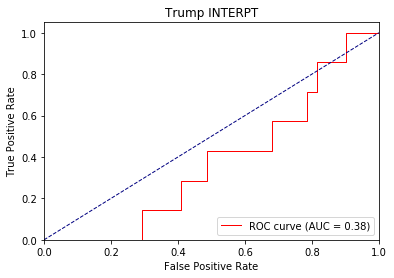

Directory already exists!
dt_interruptions 2 ap tensor([0.8562, 0.1313]) loss : 2.0944571495056152 0.3878274603236106 tid : 200 tg tensor([[1]], device='cuda:0')
dt_interruptions 2 ap tensor([0.9305, 0.1644]) loss : 0.20343822240829468 0.3314714511235555 tid : 400 tg tensor([[0]], device='cuda:0')
TEST dt_interruptions 2 ap tensor([1., 0.]) loss : 0.13627099990844727 0.126786402293614 tid : 60 tg tensor([[0]], device='cuda:0')
TEST dt_interruptions 2 ap tensor([0.9736, 0.0385]) loss : 0.3075816035270691 0.21782579101048982 tid : 180 tg tensor([[0]], device='cuda:0')
TEST dt_interruptions 2 ap tensor([0.9447, 0.0519]) loss : 0.17596787214279175 0.3060669250540681 tid : 420 tg tensor([[0]], device='cuda:0')


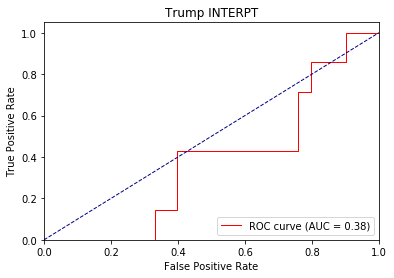

Directory already exists!
TEST dt_lookat2 0 ap tensor([0.9097, 0.7083]) loss : 0.29185765981674194 0.5900011595926786 tid : 120 tg tensor([[0]], device='cuda:0')
TEST dt_lookat2 0 ap tensor([0.7054, 0.7000]) loss : 0.3540392518043518 0.6297121721506119 tid : 240 tg tensor([[1]], device='cuda:0')
TEST dt_lookat2 0 ap tensor([0.6876, 0.6867]) loss : 0.9431123733520508 0.6499572350105769 tid : 330 tg tensor([[0]], device='cuda:0')


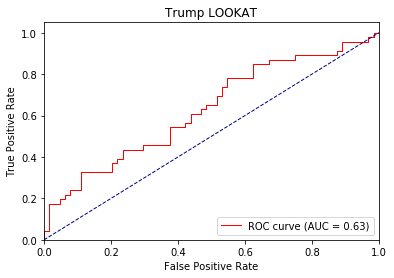

Directory already exists!
TEST dt_lookat2 1 ap tensor([0.9293, 0.7870]) loss : 0.2093137502670288 0.5543736031180934 tid : 120 tg tensor([[0]], device='cuda:0')
TEST dt_lookat2 1 ap tensor([0.7247, 0.7430]) loss : 0.2180245816707611 0.6017987245321273 tid : 240 tg tensor([[1]], device='cuda:0')
TEST dt_lookat2 1 ap tensor([0.7053, 0.7126]) loss : 1.3739229440689087 0.6321413563170903 tid : 330 tg tensor([[0]], device='cuda:0')


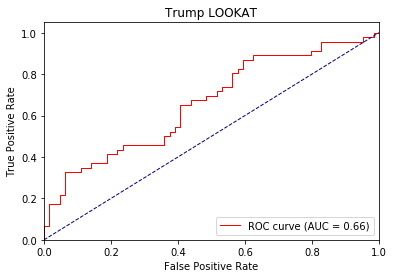

Directory already exists!
TEST dt_lookat2 2 ap tensor([0.9337, 0.8093]) loss : 0.15603148937225342 0.5314602051910601 tid : 120 tg tensor([[0]], device='cuda:0')
TEST dt_lookat2 2 ap tensor([0.7378, 0.7550]) loss : 0.15318578481674194 0.5900265216827393 tid : 240 tg tensor([[1]], device='cuda:0')
TEST dt_lookat2 2 ap tensor([0.7163, 0.7209]) loss : 1.7223035097122192 0.6267924753712936 tid : 330 tg tensor([[0]], device='cuda:0')


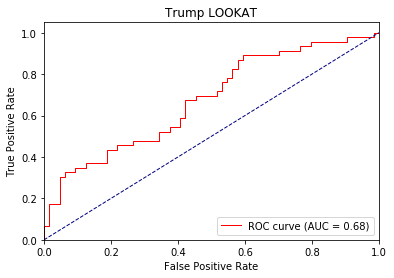

Directory already exists!
TEST dt_brush1 0 ap tensor([1., 1.]) loss : 0.35397571325302124 0.3626401455778825 tid : 120 tg tensor([[0]], device='cuda:0')
TEST dt_brush1 0 ap tensor([0.9501, 0.4575]) loss : 1.1767758131027222 0.43947585344314577 tid : 240 tg tensor([[1]], device='cuda:0')
TEST dt_brush1 0 ap tensor([0.9467, 0.4258]) loss : 0.30031687021255493 0.4621561513820165 tid : 330 tg tensor([[0]], device='cuda:0')


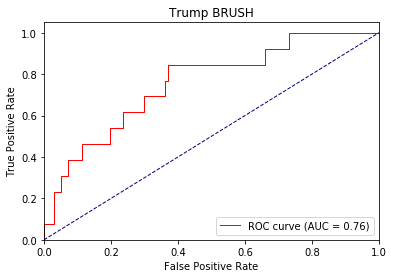

Directory already exists!
TEST dt_brush1 1 ap tensor([1., 1.]) loss : 0.18727976083755493 0.23879462009982058 tid : 120 tg tensor([[0]], device='cuda:0')
TEST dt_brush1 1 ap tensor([0.9625, 0.3887]) loss : 1.5673205852508545 0.35283871114253995 tid : 240 tg tensor([[1]], device='cuda:0')
TEST dt_brush1 1 ap tensor([0.9523, 0.3821]) loss : 0.1874956488609314 0.3835564159171682 tid : 330 tg tensor([[0]], device='cuda:0')


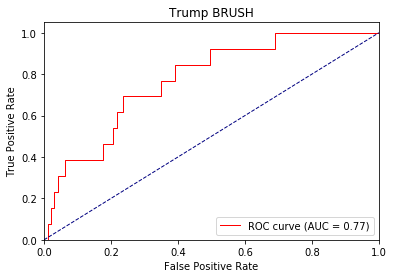

Directory already exists!
TEST dt_brush1 2 ap tensor([1., 1.]) loss : 0.11306285858154297 0.1848914607575065 tid : 120 tg tensor([[0]], device='cuda:0')
TEST dt_brush1 2 ap tensor([0.9654, 0.3909]) loss : 1.8022511005401611 0.3234494423866272 tid : 240 tg tensor([[1]], device='cuda:0')
TEST dt_brush1 2 ap tensor([0.9555, 0.3989]) loss : 0.14107352495193481 0.35775608957653315 tid : 330 tg tensor([[0]], device='cuda:0')


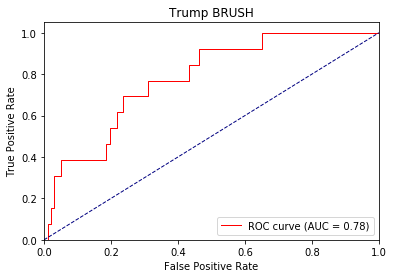

Directory already exists!
TEST dt_nvdis1 0 ap tensor([0.7997, 0.9258]) loss : 0.6015013456344604 0.5677257572349749 tid : 120 tg tensor([[1]], device='cuda:0')
TEST dt_nvdis1 0 ap tensor([0.6296, 0.8895]) loss : 0.7595260143280029 0.5986048209667206 tid : 240 tg tensor([[0]], device='cuda:0')
TEST dt_nvdis1 0 ap tensor([0.4999, 0.7932]) loss : 0.7366927862167358 0.6378129515009867 tid : 330 tg tensor([[0]], device='cuda:0')


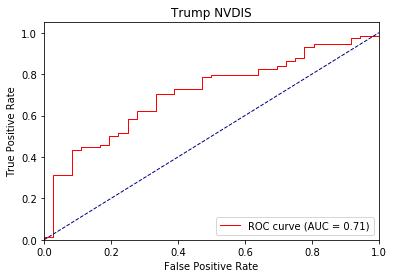

Directory already exists!
TEST dt_nvdis1 1 ap tensor([0.7390, 0.9375]) loss : 0.3330143690109253 0.50072233771023 tid : 120 tg tensor([[1]], device='cuda:0')
TEST dt_nvdis1 1 ap tensor([0.6142, 0.8967]) loss : 0.7454946637153625 0.5419579821825028 tid : 240 tg tensor([[0]], device='cuda:0')
TEST dt_nvdis1 1 ap tensor([0.5043, 0.8121]) loss : 0.6680355668067932 0.5954118853723499 tid : 330 tg tensor([[0]], device='cuda:0')


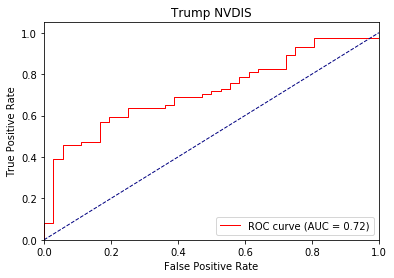

Directory already exists!
TEST dt_nvdis1 2 ap tensor([0.7983, 0.9285]) loss : 0.20573776960372925 0.47389097119632523 tid : 120 tg tensor([[1]], device='cuda:0')
TEST dt_nvdis1 2 ap tensor([0.6423, 0.8962]) loss : 0.7051377296447754 0.5219987624883652 tid : 240 tg tensor([[0]], device='cuda:0')
TEST dt_nvdis1 2 ap tensor([0.5637, 0.8226]) loss : 0.6178479194641113 0.5827949227581561 tid : 330 tg tensor([[0]], device='cuda:0')


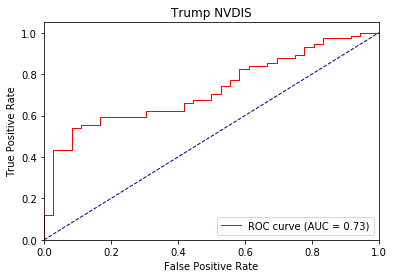

Directory already exists!
TEST dt_lookat3 0 ap tensor([0.3492, 0.9210]) loss : 0.35228338837623596 0.5045309411851984 tid : 120 tg tensor([[1]], device='cuda:0')
TEST dt_lookat3 0 ap tensor([0.1242, 0.9190]) loss : 0.4328741133213043 0.49988761603832244 tid : 240 tg tensor([[1]], device='cuda:0')
TEST dt_lookat3 0 ap tensor([0.1108, 0.8738]) loss : 0.3964099586009979 0.5368399380798071 tid : 330 tg tensor([[1]], device='cuda:0')


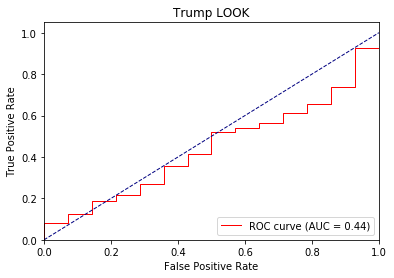

Directory already exists!
TEST dt_lookat3 1 ap tensor([0.3106, 0.9138]) loss : 0.1819620132446289 0.45995368298731354 tid : 120 tg tensor([[1]], device='cuda:0')
TEST dt_lookat3 1 ap tensor([0.1478, 0.9318]) loss : 0.39112570881843567 0.4108737915754318 tid : 240 tg tensor([[1]], device='cuda:0')
TEST dt_lookat3 1 ap tensor([0.1536, 0.9197]) loss : 0.36669158935546875 0.4446140573897832 tid : 330 tg tensor([[1]], device='cuda:0')


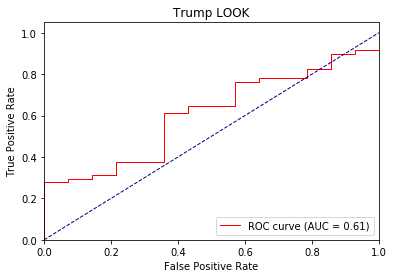

Directory already exists!
TEST dt_lookat3 2 ap tensor([0.4654, 0.9000]) loss : 0.10702705383300781 0.44944469395436737 tid : 120 tg tensor([[1]], device='cuda:0')
TEST dt_lookat3 2 ap tensor([0.1983, 0.9338]) loss : 0.3629913926124573 0.37048365235328673 tid : 240 tg tensor([[1]], device='cuda:0')
TEST dt_lookat3 2 ap tensor([0.2223, 0.9316]) loss : 0.34604698419570923 0.39926427644743046 tid : 330 tg tensor([[1]], device='cuda:0')


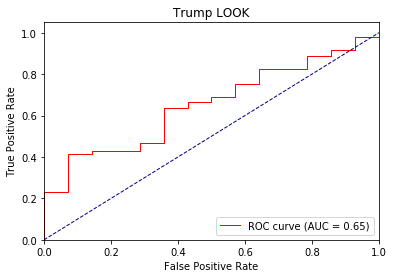

Directory already exists!
TEST dt_eyebrow 0 ap tensor([0.6068, 0.8066]) loss : 0.29106205701828003 0.635240619119845 tid : 120 tg tensor([[1]], device='cuda:0')
TEST dt_eyebrow 0 ap tensor([0.6559, 0.6785]) loss : 1.0585317611694336 0.743911737203598 tid : 240 tg tensor([[0]], device='cuda:0')
TEST dt_eyebrow 0 ap tensor([0.6850, 0.5817]) loss : 0.8954063653945923 0.7922760327936897 tid : 330 tg tensor([[0]], device='cuda:0')


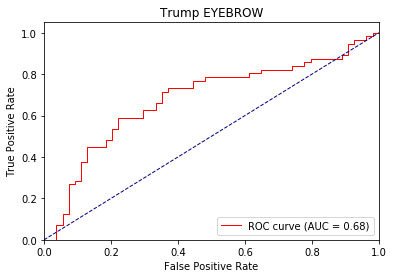

Directory already exists!
TEST dt_eyebrow 1 ap tensor([0.6200, 0.7874]) loss : 0.16584473848342896 0.6673688339559656 tid : 120 tg tensor([[1]], device='cuda:0')
TEST dt_eyebrow 1 ap tensor([0.6512, 0.7321]) loss : 1.3714792728424072 0.8529552811384201 tid : 240 tg tensor([[0]], device='cuda:0')
TEST dt_eyebrow 1 ap tensor([0.6911, 0.6153]) loss : 1.14304518699646 0.9276979389324994 tid : 330 tg tensor([[0]], device='cuda:0')


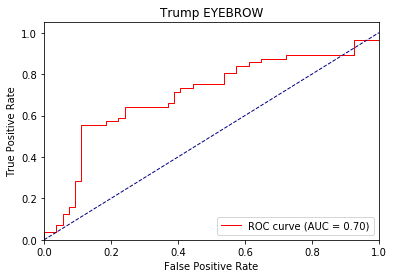

Directory already exists!
TEST dt_eyebrow 2 ap tensor([0.6423, 0.8089]) loss : 0.103537917137146 0.7217659307153601 tid : 120 tg tensor([[1]], device='cuda:0')
TEST dt_eyebrow 2 ap tensor([0.6635, 0.7782]) loss : 1.5694215297698975 0.9626271134614944 tid : 240 tg tensor([[0]], device='cuda:0')
TEST dt_eyebrow 2 ap tensor([0.7023, 0.6568]) loss : 1.295201301574707 1.055535207751771 tid : 330 tg tensor([[0]], device='cuda:0')


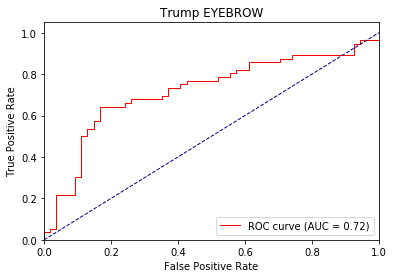

Directory already exists!
TEST dt_atface 0 ap tensor([0.6512, 0.9027]) loss : 0.4157062768936157 0.607542125802291 tid : 120 tg tensor([[1]], device='cuda:0')
TEST dt_atface 0 ap tensor([0.7228, 0.8889]) loss : 0.7038337588310242 0.5867087721824646 tid : 240 tg tensor([[0]], device='cuda:0')
TEST dt_atface 0 ap tensor([0.7169, 0.8345]) loss : 0.595374345779419 0.6060837876628822 tid : 330 tg tensor([[0]], device='cuda:0')


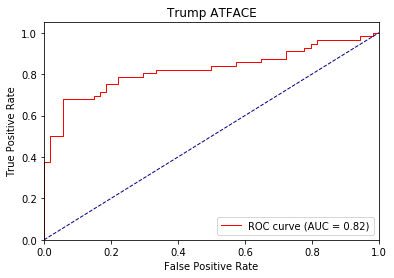

Directory already exists!
TEST dt_atface 1 ap tensor([0.6512, 0.8967]) loss : 0.2520066499710083 0.5554901000700498 tid : 120 tg tensor([[1]], device='cuda:0')
TEST dt_atface 1 ap tensor([0.7321, 0.8971]) loss : 0.68910151720047 0.5298183822631836 tid : 240 tg tensor([[0]], device='cuda:0')
TEST dt_atface 1 ap tensor([0.7342, 0.8618]) loss : 0.5151970386505127 0.5560805390418415 tid : 330 tg tensor([[0]], device='cuda:0')


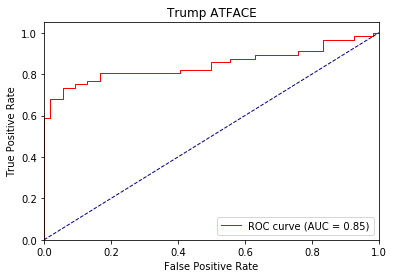

Directory already exists!
TEST dt_atface 2 ap tensor([0.6512, 0.8967]) loss : 0.1717889904975891 0.5346467071457913 tid : 120 tg tensor([[1]], device='cuda:0')
TEST dt_atface 2 ap tensor([0.7361, 0.8981]) loss : 0.6834714412689209 0.507765371799469 tid : 240 tg tensor([[0]], device='cuda:0')
TEST dt_atface 2 ap tensor([0.7363, 0.8686]) loss : 0.48200467228889465 0.5376732320013181 tid : 330 tg tensor([[0]], device='cuda:0')


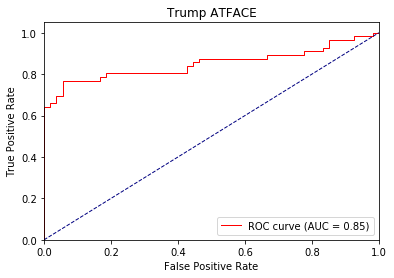

Directory already exists!
TEST dt_feface 0 ap tensor([0.9539, 0.0833]) loss : 0.47434136271476746 0.36363972645056875 tid : 120 tg tensor([[0]], device='cuda:0')
TEST dt_feface 0 ap tensor([0.9883, 0.0435]) loss : 0.2596646249294281 0.31539771318435667 tid : 240 tg tensor([[0]], device='cuda:0')
TEST dt_feface 0 ap tensor([0.9926, 0.0333]) loss : 0.17983239889144897 0.3090025006045758 tid : 330 tg tensor([[0]], device='cuda:0')


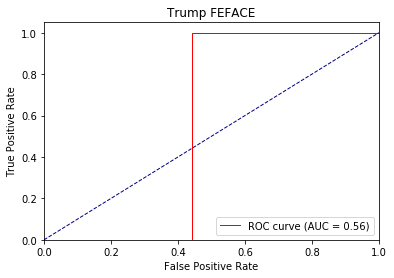

Directory already exists!
TEST dt_feface 1 ap tensor([0.9539, 0.0833]) loss : 0.24495995044708252 0.26297484103002045 tid : 120 tg tensor([[0]], device='cuda:0')
TEST dt_feface 1 ap tensor([0.9868, 0.0400]) loss : 0.12074679136276245 0.1901247549057007 tid : 240 tg tensor([[0]], device='cuda:0')
TEST dt_feface 1 ap tensor([0.9883, 0.0244]) loss : 0.06691551208496094 0.181041741874856 tid : 330 tg tensor([[0]], device='cuda:0')


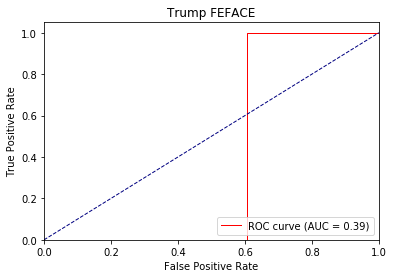

Directory already exists!
TEST dt_feface 2 ap tensor([0.9656, 0.1000]) loss : 0.11902713775634766 0.23082678098427623 tid : 120 tg tensor([[0]], device='cuda:0')
TEST dt_feface 2 ap tensor([0.9868, 0.0400]) loss : 0.061164796352386475 0.13574342906475068 tid : 240 tg tensor([[0]], device='cuda:0')
TEST dt_feface 2 ap tensor([0.9878, 0.0238]) loss : 0.02687978744506836 0.12160091878662646 tid : 330 tg tensor([[0]], device='cuda:0')


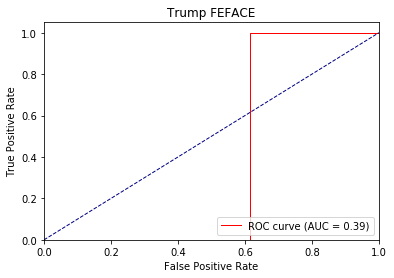

Directory already exists!
TEST dt_hrface 0 ap tensor([1., 0.]) loss : 0.3695305585861206 0.41386788142354863 tid : 120 tg tensor([[0]], device='cuda:0')
TEST dt_hrface 0 ap tensor([0.9594, 0.3252]) loss : 0.3069395422935486 0.44983781218528746 tid : 240 tg tensor([[0]], device='cuda:0')
TEST dt_hrface 0 ap tensor([0.9558, 0.3993]) loss : 0.32712987065315247 0.45844895067349284 tid : 330 tg tensor([[0]], device='cuda:0')


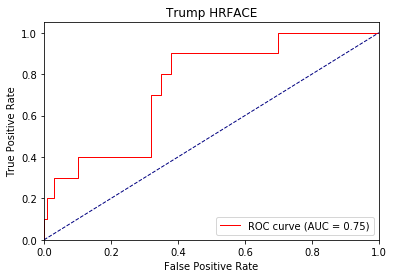

Directory already exists!
TEST dt_hrface 1 ap tensor([1., 0.]) loss : 0.20385295152664185 0.2685417109414151 tid : 120 tg tensor([[0]], device='cuda:0')
TEST dt_hrface 1 ap tensor([0.9625, 0.3998]) loss : 0.2082100510597229 0.35526998043060304 tid : 240 tg tensor([[0]], device='cuda:0')
TEST dt_hrface 1 ap tensor([0.9583, 0.4580]) loss : 0.1976226568222046 0.3661097149613877 tid : 330 tg tensor([[0]], device='cuda:0')


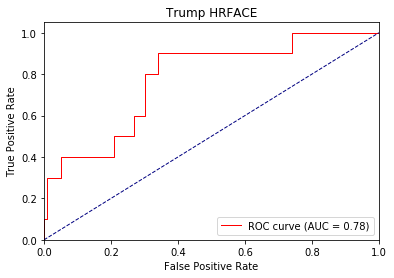

Directory already exists!
TEST dt_hrface 2 ap tensor([1., 0.]) loss : 0.12427067756652832 0.19571945384929054 tid : 120 tg tensor([[0]], device='cuda:0')
TEST dt_hrface 2 ap tensor([0.9644, 0.4037]) loss : 0.16639280319213867 0.31638308107852936 tid : 240 tg tensor([[0]], device='cuda:0')
TEST dt_hrface 2 ap tensor([0.9620, 0.4707]) loss : 0.1425166130065918 0.32805698858180515 tid : 330 tg tensor([[0]], device='cuda:0')


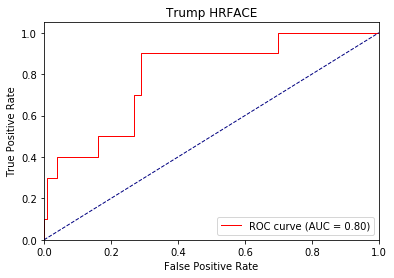

Directory already exists!
TEST dt_saface 0 ap tensor([1., 0.]) loss : 0.362510621547699 0.3441365376899117 tid : 120 tg tensor([[0]], device='cuda:0')
TEST dt_saface 0 ap tensor([1., 0.]) loss : 0.350312739610672 0.3567048490047455 tid : 240 tg tensor([[0]], device='cuda:0')
TEST dt_saface 0 ap tensor([1., 0.]) loss : 0.31914183497428894 0.3665744653889831 tid : 330 tg tensor([[0]], device='cuda:0')


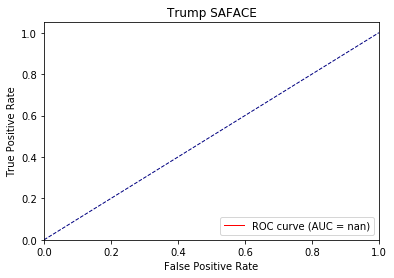

Directory already exists!
TEST dt_saface 1 ap tensor([1., 0.]) loss : 0.17833411693572998 0.17399009121091744 tid : 120 tg tensor([[0]], device='cuda:0')
TEST dt_saface 1 ap tensor([1., 0.]) loss : 0.18409138917922974 0.18319307029247284 tid : 240 tg tensor([[0]], device='cuda:0')
TEST dt_saface 1 ap tensor([1., 0.]) loss : 0.15006864070892334 0.19417347748514632 tid : 330 tg tensor([[0]], device='cuda:0')


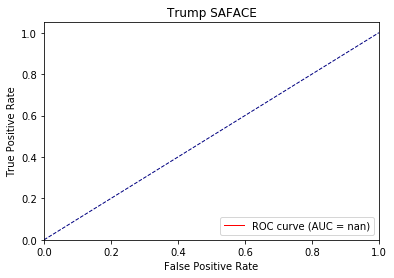

Directory already exists!
TEST dt_saface 2 ap tensor([1., 0.]) loss : 0.08710670471191406 0.08853854317414134 tid : 120 tg tensor([[0]], device='cuda:0')
TEST dt_saface 2 ap tensor([1., 0.]) loss : 0.09396529197692871 0.09391205549240113 tid : 240 tg tensor([[0]], device='cuda:0')
TEST dt_saface 2 ap tensor([1., 0.]) loss : 0.06805193424224854 0.10201898343126539 tid : 330 tg tensor([[0]], device='cuda:0')


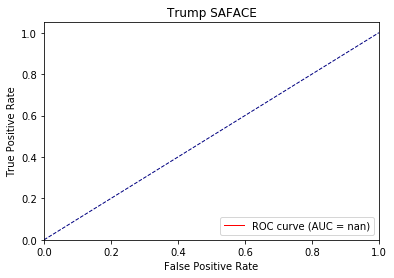

Directory already exists!
TEST dt_neuface 0 ap tensor([0.9184, 0.7619]) loss : 0.2821347713470459 0.5493388662212774 tid : 120 tg tensor([[0]], device='cuda:0')
TEST dt_neuface 0 ap tensor([0.8736, 0.5409]) loss : 1.1481091976165771 0.596402434706688 tid : 240 tg tensor([[1]], device='cuda:0')
TEST dt_neuface 0 ap tensor([0.8494, 0.5305]) loss : 1.0534557104110718 0.6226922878077332 tid : 330 tg tensor([[1]], device='cuda:0')


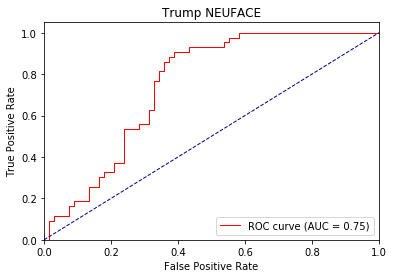

Directory already exists!
TEST dt_neuface 1 ap tensor([0.9046, 0.6571]) loss : 0.19434136152267456 0.5184298769423836 tid : 120 tg tensor([[0]], device='cuda:0')
TEST dt_neuface 1 ap tensor([0.8708, 0.5512]) loss : 1.1762163639068604 0.5767550736665725 tid : 240 tg tensor([[1]], device='cuda:0')
TEST dt_neuface 1 ap tensor([0.8503, 0.5496]) loss : 1.0390199422836304 0.6080236237653545 tid : 330 tg tensor([[1]], device='cuda:0')


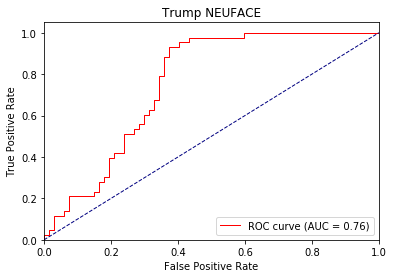

Directory already exists!
TEST dt_neuface 2 ap tensor([0.9042, 0.6119]) loss : 0.15104150772094727 0.5067038708611539 tid : 120 tg tensor([[0]], device='cuda:0')
TEST dt_neuface 2 ap tensor([0.8721, 0.5608]) loss : 1.1977181434631348 0.5713725703954696 tid : 240 tg tensor([[1]], device='cuda:0')
TEST dt_neuface 2 ap tensor([0.8508, 0.5524]) loss : 1.0400431156158447 0.6055342584428652 tid : 330 tg tensor([[1]], device='cuda:0')


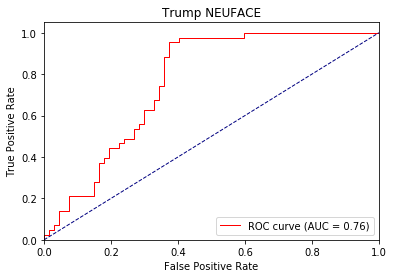

Directory already exists!
TEST dt_inapprop 0 ap tensor([0.9470, 0.0769]) loss : 0.49504178762435913 0.510890499541634 tid : 120 tg tensor([[0]], device='cuda:0')
TEST dt_inapprop 0 ap tensor([0.8454, 0.2571]) loss : 0.4427257776260376 0.5485352712869644 tid : 240 tg tensor([[0]], device='cuda:0')
TEST dt_inapprop 0 ap tensor([0.8480, 0.2003]) loss : 0.4288955330848694 0.5318132424858254 tid : 330 tg tensor([[0]], device='cuda:0')


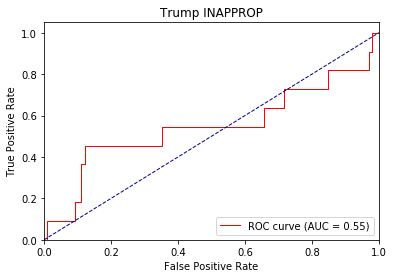

Directory already exists!
TEST dt_inapprop 1 ap tensor([0.9601, 0.0909]) loss : 0.27983665466308594 0.3382129104513871 tid : 120 tg tensor([[0]], device='cuda:0')
TEST dt_inapprop 1 ap tensor([0.8523, 0.2798]) loss : 0.2921349108219147 0.4548277819156647 tid : 240 tg tensor([[0]], device='cuda:0')
TEST dt_inapprop 1 ap tensor([0.8474, 0.2207]) loss : 0.2424076497554779 0.42399205372367105 tid : 330 tg tensor([[0]], device='cuda:0')


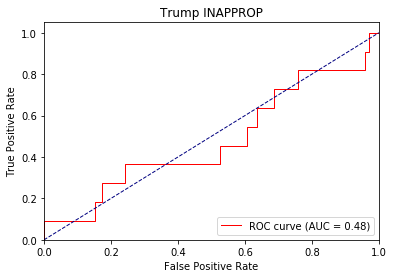

Directory already exists!
TEST dt_inapprop 2 ap tensor([0.9753, 0.1250]) loss : 0.1708071231842041 0.257369223393892 tid : 120 tg tensor([[0]], device='cuda:0')
TEST dt_inapprop 2 ap tensor([0.8546, 0.2764]) loss : 0.2233080267906189 0.4375224125385284 tid : 240 tg tensor([[0]], device='cuda:0')
TEST dt_inapprop 2 ap tensor([0.8604, 0.2176]) loss : 0.15653693675994873 0.39133115301669485 tid : 330 tg tensor([[0]], device='cuda:0')


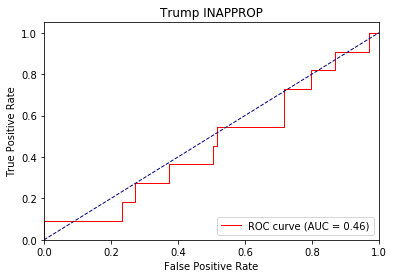

Directory already exists!
TEST dt_affgest 0 ap tensor([1., 0.]) loss : 0.5111414194107056 0.3291053395522268 tid : 120 tg tensor([[0]], device='cuda:0')
TEST dt_affgest 0 ap tensor([0.9868, 0.0400]) loss : 0.2508387565612793 0.34739271640777586 tid : 240 tg tensor([[0]], device='cuda:0')
TEST dt_affgest 0 ap tensor([0.9892, 0.0256]) loss : 0.2548006772994995 0.35834284777372655 tid : 330 tg tensor([[0]], device='cuda:0')


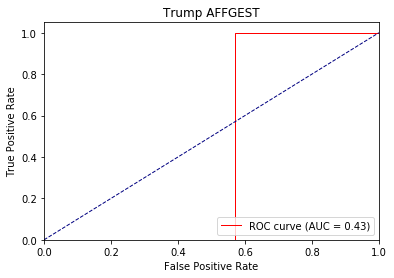

Directory already exists!
TEST dt_affgest 1 ap tensor([1., 0.]) loss : 0.2962169647216797 0.18219816214159915 tid : 120 tg tensor([[0]], device='cuda:0')
TEST dt_affgest 1 ap tensor([0.9844, 0.0357]) loss : 0.14433109760284424 0.2172285395860672 tid : 240 tg tensor([[0]], device='cuda:0')
TEST dt_affgest 1 ap tensor([0.9869, 0.0227]) loss : 0.11820101737976074 0.2208221130807635 tid : 330 tg tensor([[0]], device='cuda:0')


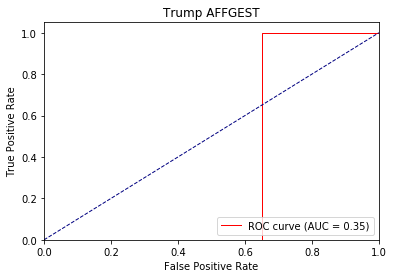

Directory already exists!
TEST dt_affgest 2 ap tensor([1., 0.]) loss : 0.18824172019958496 0.11016789235566792 tid : 120 tg tensor([[0]], device='cuda:0')
TEST dt_affgest 2 ap tensor([0.9844, 0.0357]) loss : 0.09309768676757812 0.15820871710777282 tid : 240 tg tensor([[0]], device='cuda:0')
TEST dt_affgest 2 ap tensor([0.9874, 0.0233]) loss : 0.061278581619262695 0.15507680345589006 tid : 330 tg tensor([[0]], device='cuda:0')


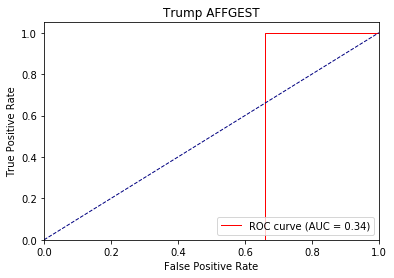

Directory already exists!
TEST dt_defgest 0 ap tensor([0.9963, 0.9167]) loss : 0.451288640499115 0.5083493951119875 tid : 120 tg tensor([[1]], device='cuda:0')
TEST dt_defgest 0 ap tensor([0.9807, 0.8596]) loss : 0.7677727937698364 0.5653271967172623 tid : 240 tg tensor([[0]], device='cuda:0')
TEST dt_defgest 0 ap tensor([0.9575, 0.7375]) loss : 0.4623572528362274 0.590409086623662 tid : 330 tg tensor([[0]], device='cuda:0')


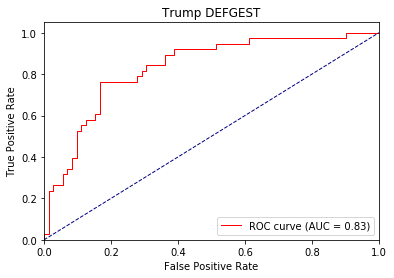

Directory already exists!
TEST dt_defgest 1 ap tensor([0.9924, 0.8667]) loss : 0.43292373418807983 0.43176529438872085 tid : 120 tg tensor([[1]], device='cuda:0')
TEST dt_defgest 1 ap tensor([0.9830, 0.8841]) loss : 0.5280690789222717 0.486071537733078 tid : 240 tg tensor([[0]], device='cuda:0')
TEST dt_defgest 1 ap tensor([0.9647, 0.7903]) loss : 0.2911674976348877 0.5139740734872683 tid : 330 tg tensor([[0]], device='cuda:0')


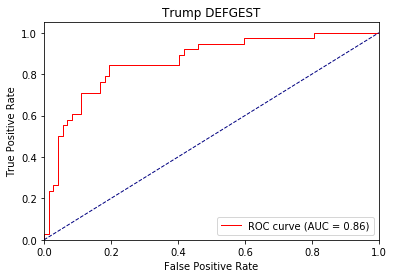

Directory already exists!
TEST dt_defgest 2 ap tensor([0.9924, 0.8667]) loss : 0.4195736050605774 0.38595576192203324 tid : 120 tg tensor([[1]], device='cuda:0')
TEST dt_defgest 2 ap tensor([0.9839, 0.8831]) loss : 0.39312928915023804 0.4360459238290787 tid : 240 tg tensor([[0]], device='cuda:0')
TEST dt_defgest 2 ap tensor([0.9658, 0.7961]) loss : 0.1970527172088623 0.46688352168445857 tid : 330 tg tensor([[0]], device='cuda:0')


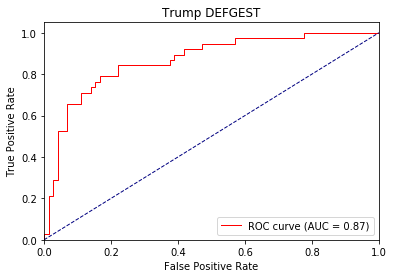

Directory already exists!
TEST dt_agentic 0 ap tensor([0.9819, 0.8734]) loss : 0.3585038185119629 0.6528776256661666 tid : 120 tg tensor([[1]], device='cuda:0')
TEST dt_agentic 0 ap tensor([0.9278, 0.8995]) loss : 0.9909079670906067 0.6907016956806182 tid : 240 tg tensor([[0]], device='cuda:0')
TEST dt_agentic 0 ap tensor([0.8324, 0.7139]) loss : 0.9736509323120117 0.7294600215596212 tid : 330 tg tensor([[0]], device='cuda:0')


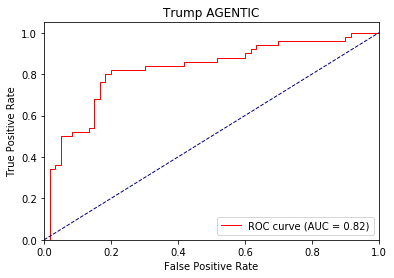

Directory already exists!
TEST dt_agentic 1 ap tensor([0.9897, 0.9484]) loss : 0.2044864296913147 0.5688012681509319 tid : 120 tg tensor([[1]], device='cuda:0')
TEST dt_agentic 1 ap tensor([0.9242, 0.9186]) loss : 0.889741837978363 0.6296802300214768 tid : 240 tg tensor([[0]], device='cuda:0')
TEST dt_agentic 1 ap tensor([0.8461, 0.7323]) loss : 0.7896953225135803 0.6905461344080912 tid : 330 tg tensor([[0]], device='cuda:0')


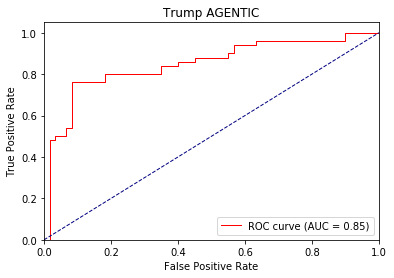

Directory already exists!
TEST dt_agentic 2 ap tensor([0.9897, 0.9484]) loss : 0.12662780284881592 0.5187523584616812 tid : 120 tg tensor([[1]], device='cuda:0')
TEST dt_agentic 2 ap tensor([0.9281, 0.9184]) loss : 0.8021278977394104 0.594793239235878 tid : 240 tg tensor([[0]], device='cuda:0')
TEST dt_agentic 2 ap tensor([0.8554, 0.7378]) loss : 0.6583549976348877 0.6733312720144299 tid : 330 tg tensor([[0]], device='cuda:0')


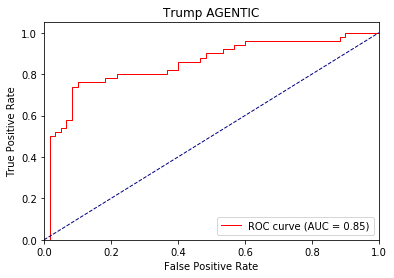

Directory already exists!
TEST dt_waveoff 0 ap tensor([0.8057, 0.1347]) loss : 1.444330096244812 0.5341399813953199 tid : 120 tg tensor([[1]], device='cuda:0')
TEST dt_waveoff 0 ap tensor([0.7824, 0.1511]) loss : 0.3895885944366455 0.5186523294448853 tid : 240 tg tensor([[0]], device='cuda:0')
TEST dt_waveoff 0 ap tensor([0.8274, 0.1052]) loss : 0.3693881630897522 0.4771818006542367 tid : 330 tg tensor([[0]], device='cuda:0')


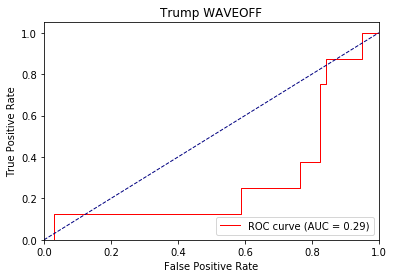

Directory already exists!
TEST dt_waveoff 1 ap tensor([0.8428, 0.1551]) loss : 2.096909523010254 0.4948839200170417 tid : 120 tg tensor([[1]], device='cuda:0')
TEST dt_waveoff 1 ap tensor([0.7945, 0.1441]) loss : 0.1862555742263794 0.4877182710170746 tid : 240 tg tensor([[0]], device='cuda:0')
TEST dt_waveoff 1 ap tensor([0.8309, 0.0919]) loss : 0.14242595434188843 0.40276652574539185 tid : 330 tg tensor([[0]], device='cuda:0')


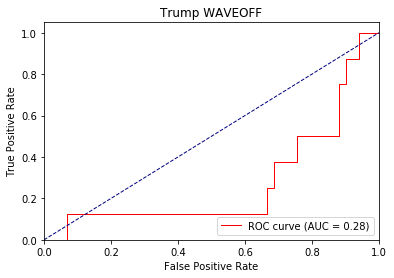

Directory already exists!
TEST dt_waveoff 2 ap tensor([0.8955, 0.2024]) loss : 2.8604788780212402 0.5385535986799943 tid : 120 tg tensor([[1]], device='cuda:0')
TEST dt_waveoff 2 ap tensor([0.8190, 0.1435]) loss : 0.10004830360412598 0.5396411091089248 tid : 240 tg tensor([[0]], device='cuda:0')
TEST dt_waveoff 2 ap tensor([0.8466, 0.0921]) loss : 0.05596292018890381 0.41079591613420297 tid : 330 tg tensor([[0]], device='cuda:0')


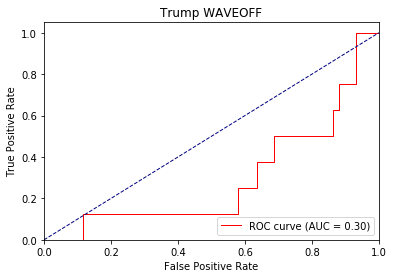

Directory already exists!
TEST dt_nvtic1 0 ap tensor([0.8406, 0.4495]) loss : 0.3825998306274414 0.5461839531597338 tid : 120 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic1 0 ap tensor([0.8693, 0.1428]) loss : 0.5816451907157898 0.5392060375213623 tid : 240 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic1 0 ap tensor([0.8474, 0.2383]) loss : 0.4219508171081543 0.5600406850727511 tid : 330 tg tensor([[0]], device='cuda:0')


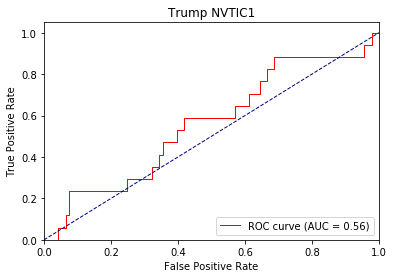

Directory already exists!
TEST dt_nvtic1 1 ap tensor([0.8610, 0.2366]) loss : 0.22330856323242188 0.48707738518714905 tid : 120 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic1 1 ap tensor([0.8933, 0.1439]) loss : 0.43660768866539 0.45230324745178224 tid : 240 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic1 1 ap tensor([0.8574, 0.2127]) loss : 0.30838948488235474 0.4969238580112726 tid : 330 tg tensor([[0]], device='cuda:0')


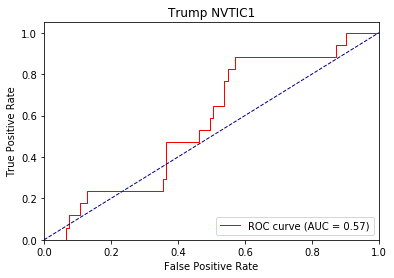

Directory already exists!
TEST dt_nvtic1 2 ap tensor([0.8578, 0.2088]) loss : 0.14093804359436035 0.466354323060889 tid : 120 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic1 2 ap tensor([0.9119, 0.1397]) loss : 0.36090680956840515 0.41324958205223083 tid : 240 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic1 2 ap tensor([0.8802, 0.1984]) loss : 0.24945774674415588 0.4732307405538962 tid : 330 tg tensor([[0]], device='cuda:0')


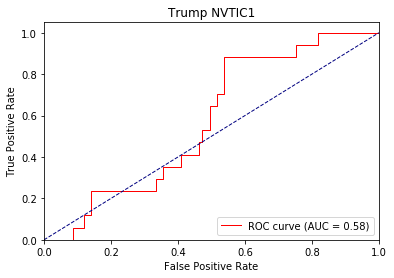

Directory already exists!
TEST dt_nvtic2 0 ap tensor([0.6086, 0.4874]) loss : 0.39668235182762146 0.6728563151861492 tid : 120 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic2 0 ap tensor([0.7874, 0.4747]) loss : 0.9686219692230225 0.5830156689882279 tid : 240 tg tensor([[1]], device='cuda:0')
TEST dt_nvtic2 0 ap tensor([0.8009, 0.3644]) loss : 1.0117758512496948 0.5759191030347851 tid : 330 tg tensor([[1]], device='cuda:0')


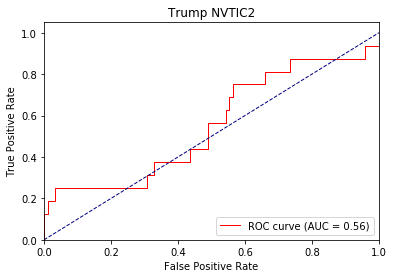

Directory already exists!
TEST dt_nvtic2 1 ap tensor([0.6044, 0.4772]) loss : 0.22404366731643677 0.7249107972571724 tid : 120 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic2 1 ap tensor([0.7786, 0.4482]) loss : 1.2896654605865479 0.5561991012096406 tid : 240 tg tensor([[1]], device='cuda:0')
TEST dt_nvtic2 1 ap tensor([0.7986, 0.3465]) loss : 1.3421403169631958 0.5246830905826998 tid : 330 tg tensor([[1]], device='cuda:0')


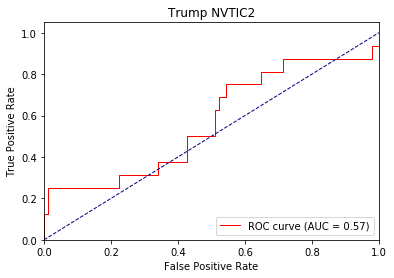

Directory already exists!
TEST dt_nvtic2 2 ap tensor([0.6071, 0.4731]) loss : 0.1382685899734497 0.7960429897433833 tid : 120 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic2 2 ap tensor([0.7736, 0.4321]) loss : 1.4782150983810425 0.571290300488472 tid : 240 tg tensor([[1]], device='cuda:0')
TEST dt_nvtic2 2 ap tensor([0.7991, 0.3381]) loss : 1.528788685798645 0.5187402220679002 tid : 330 tg tensor([[1]], device='cuda:0')


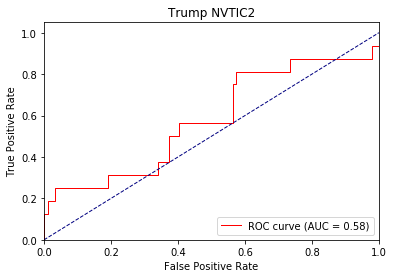

Directory already exists!
TEST dt_nvtic3 0 ap tensor([0.3930, 0.9298]) loss : 0.45766681432724 0.6725858857757167 tid : 120 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic3 0 ap tensor([0.5821, 0.8848]) loss : 0.5857166051864624 0.6489647382497787 tid : 240 tg tensor([[1]], device='cuda:0')
TEST dt_nvtic3 0 ap tensor([0.5222, 0.8201]) loss : 0.8988528251647949 0.6460572691030906 tid : 330 tg tensor([[0]], device='cuda:0')


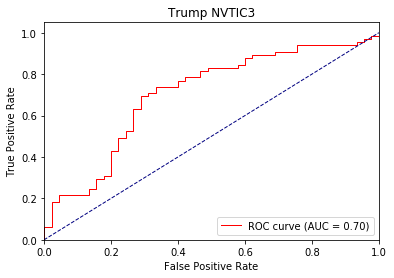

Directory already exists!
TEST dt_nvtic3 1 ap tensor([0.4021, 0.9364]) loss : 0.39753949642181396 0.6370096943880382 tid : 120 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic3 1 ap tensor([0.5745, 0.8965]) loss : 0.523086667060852 0.614912326335907 tid : 240 tg tensor([[1]], device='cuda:0')
TEST dt_nvtic3 1 ap tensor([0.5242, 0.8363]) loss : 1.089479684829712 0.6169427713038216 tid : 330 tg tensor([[0]], device='cuda:0')


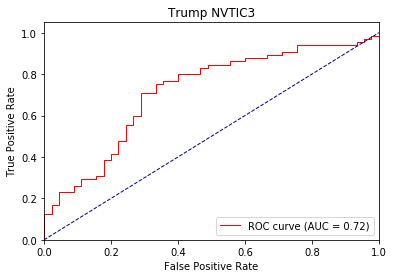

Directory already exists!
TEST dt_nvtic3 2 ap tensor([0.4437, 0.9395]) loss : 0.3532305955886841 0.6181004047393799 tid : 120 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic3 2 ap tensor([0.5494, 0.9050]) loss : 0.48894003033638 0.5954584205150604 tid : 240 tg tensor([[1]], device='cuda:0')
TEST dt_nvtic3 2 ap tensor([0.5029, 0.8454]) loss : 1.2368359565734863 0.6005794112111481 tid : 330 tg tensor([[0]], device='cuda:0')


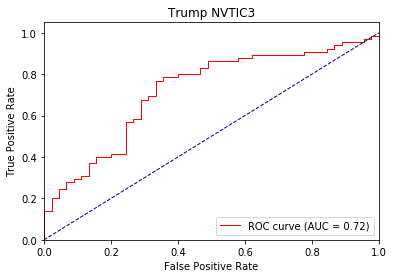

Directory already exists!
TEST dt_nvtic5 0 ap tensor([1., 0.]) loss : 0.34322410821914673 0.4237061613484433 tid : 120 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic5 0 ap tensor([0.9816, 0.0323]) loss : 1.1135966777801514 0.43286046385765076 tid : 240 tg tensor([[1]], device='cuda:0')
TEST dt_nvtic5 0 ap tensor([0.9690, 0.0308]) loss : 0.3815338909626007 0.4476845461717794 tid : 330 tg tensor([[0]], device='cuda:0')


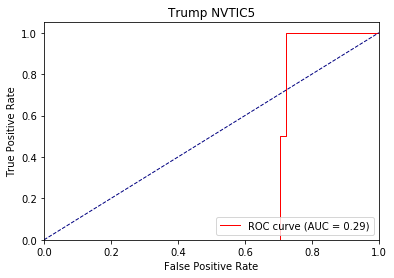

Directory already exists!
TEST dt_nvtic5 1 ap tensor([1., 0.]) loss : 0.17287677526474 0.23037679885563098 tid : 120 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic5 1 ap tensor([0.9939, 0.0714]) loss : 1.4803462028503418 0.25364327788352964 tid : 240 tg tensor([[1]], device='cuda:0')
TEST dt_nvtic5 1 ap tensor([0.9860, 0.0512]) loss : 0.19091367721557617 0.2771705380627807 tid : 330 tg tensor([[0]], device='cuda:0')


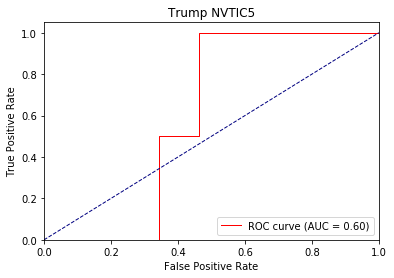

Directory already exists!
TEST dt_nvtic5 2 ap tensor([1., 0.]) loss : 0.09046816825866699 0.13046837480444656 tid : 120 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic5 2 ap tensor([0.9960, 0.1000]) loss : 1.7790007591247559 0.1643378907442093 tid : 240 tg tensor([[1]], device='cuda:0')
TEST dt_nvtic5 2 ap tensor([0.9902, 0.0690]) loss : 0.11259627342224121 0.1917626421216508 tid : 330 tg tensor([[0]], device='cuda:0')


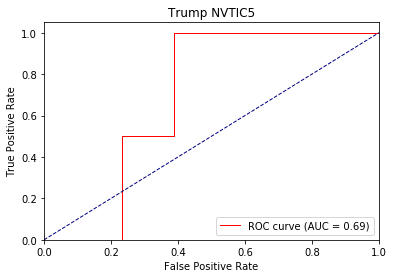

Directory already exists!
TEST dt_nvtic4 0 ap tensor([1., 0.]) loss : 0.22527146339416504 0.32258094298212153 tid : 120 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic4 0 ap tensor([1., 0.]) loss : 0.28602105379104614 0.315218979716301 tid : 240 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic4 0 ap tensor([1., 0.]) loss : 0.28396761417388916 0.32542197637155024 tid : 330 tg tensor([[0]], device='cuda:0')


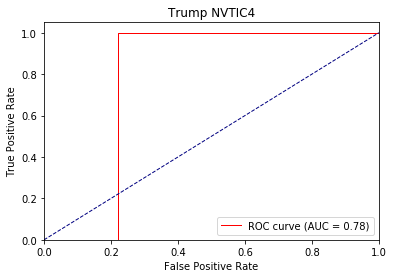

Directory already exists!
TEST dt_nvtic4 1 ap tensor([1., 0.]) loss : 0.11118948459625244 0.18755414768269188 tid : 120 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic4 1 ap tensor([1., 0.]) loss : 0.17607486248016357 0.18159721076488494 tid : 240 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic4 1 ap tensor([1., 0.]) loss : 0.15190792083740234 0.1910832834915376 tid : 330 tg tensor([[0]], device='cuda:0')


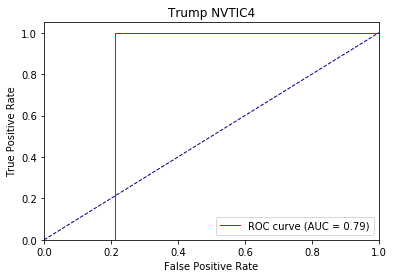

Directory already exists!
TEST dt_nvtic4 2 ap tensor([1., 0.]) loss : 0.06331849098205566 0.12735832051226967 tid : 120 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic4 2 ap tensor([1., 0.]) loss : 0.12519240379333496 0.1218300461769104 tid : 240 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic4 2 ap tensor([1., 0.]) loss : 0.09755802154541016 0.1298403068327568 tid : 330 tg tensor([[0]], device='cuda:0')


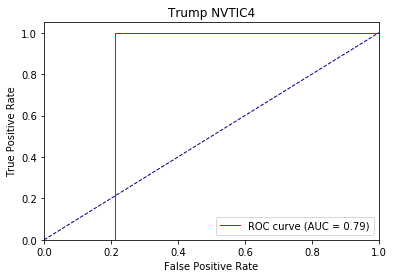

Directory already exists!
TEST dt_interruptions 0 ap tensor([1., 0.]) loss : 0.4603152871131897 0.37987065942663895 tid : 120 tg tensor([[0]], device='cuda:0')
TEST dt_interruptions 0 ap tensor([0.8617, 0.0588]) loss : 0.3745460510253906 0.44676256060600283 tid : 240 tg tensor([[0]], device='cuda:0')
TEST dt_interruptions 0 ap tensor([0.8811, 0.0656]) loss : 0.3607838749885559 0.4573288635468819 tid : 330 tg tensor([[0]], device='cuda:0')


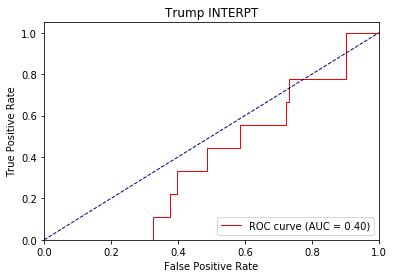

Directory already exists!
TEST dt_interruptions 1 ap tensor([1., 0.]) loss : 0.24803853034973145 0.22423863567804037 tid : 120 tg tensor([[0]], device='cuda:0')
TEST dt_interruptions 1 ap tensor([0.8700, 0.0604]) loss : 0.252446711063385 0.36035208523273465 tid : 240 tg tensor([[0]], device='cuda:0')
TEST dt_interruptions 1 ap tensor([0.8804, 0.0674]) loss : 0.2186090350151062 0.37065578640346797 tid : 330 tg tensor([[0]], device='cuda:0')


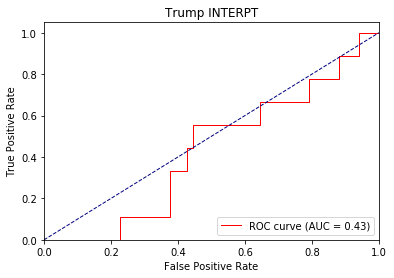

Directory already exists!
TEST dt_interruptions 2 ap tensor([1., 0.]) loss : 0.14293742179870605 0.15261326024406835 tid : 120 tg tensor([[0]], device='cuda:0')
TEST dt_interruptions 2 ap tensor([0.8818, 0.0632]) loss : 0.1964161992073059 0.334635882973671 tid : 240 tg tensor([[0]], device='cuda:0')
TEST dt_interruptions 2 ap tensor([0.8866, 0.0688]) loss : 0.16210883855819702 0.34327733516693115 tid : 330 tg tensor([[0]], device='cuda:0')


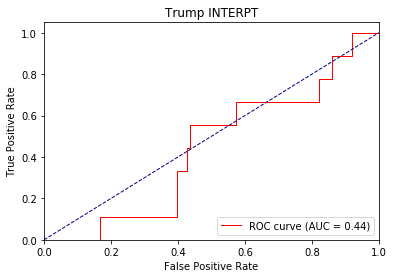

Directory already exists!
dt_lookat2 0 ap tensor([0.6254, 0.4571]) loss : 0.6803383827209473 0.7232831319173177 tid : 400 tg tensor([[0]], device='cuda:0')
dt_lookat2 0 ap tensor([0.6098, 0.8217]) loss : 0.6762024164199829 0.6553607902168173 tid : 200 tg tensor([[1]], device='cuda:0')
TEST dt_lookat2 0 ap tensor([0.9034, 0.9156]) loss : 0.7968867421150208 0.5490112386900803 tid : 150 tg tensor([[0]], device='cuda:0')
TEST dt_lookat2 0 ap tensor([0.8097, 0.7747]) loss : 0.5441910028457642 0.6142413973115212 tid : 420 tg tensor([[0]], device='cuda:0')


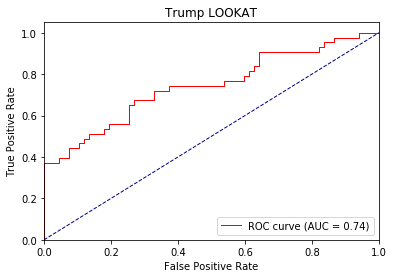

Directory already exists!
dt_lookat2 1 ap tensor([0.8112, 0.7825]) loss : 0.6531890034675598 0.5724755453340935 tid : 200 tg tensor([[1]], device='cuda:0')
dt_lookat2 1 ap tensor([0.8740, 0.8609]) loss : 0.8577445149421692 0.5454723521553236 tid : 400 tg tensor([[0]], device='cuda:0')
TEST dt_lookat2 1 ap tensor([0.9328, 0.9335]) loss : 0.8472357988357544 0.4724850634048725 tid : 150 tg tensor([[0]], device='cuda:0')
TEST dt_lookat2 1 ap tensor([0.8710, 0.8168]) loss : 0.3986027240753174 0.5539764592120814 tid : 420 tg tensor([[0]], device='cuda:0')


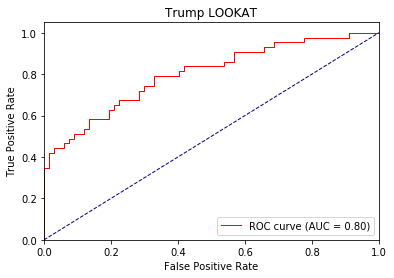

Directory already exists!
dt_lookat2 2 ap tensor([0.8239, 0.9333]) loss : 0.588426947593689 0.47119289115071294 tid : 200 tg tensor([[1]], device='cuda:0')
dt_lookat2 2 ap tensor([0.8413, 0.9448]) loss : 1.0253303050994873 0.4191658713878729 tid : 400 tg tensor([[0]], device='cuda:0')
TEST dt_lookat2 2 ap tensor([0.9398, 0.9356]) loss : 0.8563721179962158 0.4269185847249524 tid : 150 tg tensor([[0]], device='cuda:0')
TEST dt_lookat2 2 ap tensor([0.8811, 0.8304]) loss : 0.3058643937110901 0.5184650878573573 tid : 420 tg tensor([[0]], device='cuda:0')


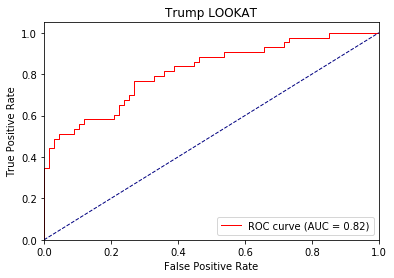

Directory already exists!
dt_brush1 0 ap tensor([0.9053, 0.0766]) loss : 0.67237788438797 0.7698015297452608 tid : 400 tg tensor([[0]], device='cuda:0')
dt_brush1 0 ap tensor([0.8939, 0.0905]) loss : 0.6541517972946167 0.7597632898693591 tid : 200 tg tensor([[0]], device='cuda:0')
TEST dt_brush1 0 ap tensor([0.9859, 0.5909]) loss : 0.5306365489959717 0.46062446462697 tid : 150 tg tensor([[0]], device='cuda:0')
TEST dt_brush1 0 ap tensor([0.9424, 0.1071]) loss : 0.3276878893375397 0.5025628333867982 tid : 420 tg tensor([[0]], device='cuda:0')


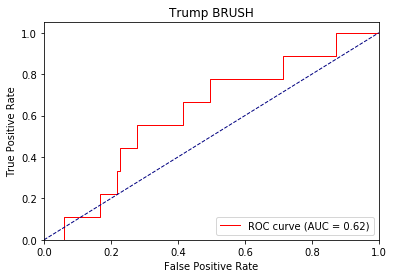

Directory already exists!
dt_brush1 1 ap tensor([0.9295, 0.2627]) loss : 0.34813445806503296 0.4387346982066311 tid : 400 tg tensor([[0]], device='cuda:0')
dt_brush1 1 ap tensor([0.9507, 0.1409]) loss : 0.15707999467849731 0.3949844283971958 tid : 200 tg tensor([[0]], device='cuda:0')
TEST dt_brush1 1 ap tensor([0.9896, 0.6111]) loss : 0.3514607548713684 0.3081521915978399 tid : 150 tg tensor([[0]], device='cuda:0')
TEST dt_brush1 1 ap tensor([0.9446, 0.1139]) loss : 0.16684716939926147 0.36801492197569025 tid : 420 tg tensor([[0]], device='cuda:0')


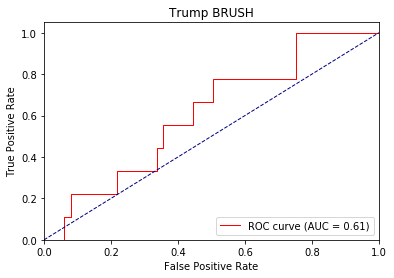

Directory already exists!
dt_brush1 2 ap tensor([0.9584, 0.2829]) loss : 0.18441319465637207 0.3321454409666902 tid : 400 tg tensor([[0]], device='cuda:0')
dt_brush1 2 ap tensor([0.9676, 0.2403]) loss : 0.07627439498901367 0.3046026114846619 tid : 200 tg tensor([[0]], device='cuda:0')
TEST dt_brush1 2 ap tensor([0.9896, 0.6111]) loss : 0.2562099099159241 0.24552827251368556 tid : 150 tg tensor([[0]], device='cuda:0')
TEST dt_brush1 2 ap tensor([0.9488, 0.1220]) loss : 0.09639978408813477 0.3161506167677946 tid : 420 tg tensor([[0]], device='cuda:0')


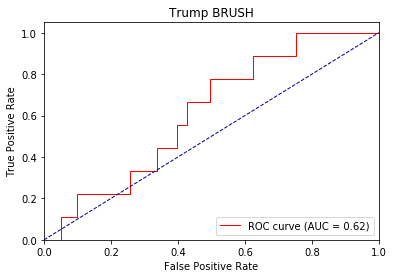

Directory already exists!
dt_nvdis1 0 ap tensor([0.2172, 0.7465]) loss : 0.8195363879203796 0.795663771033287 tid : 200 tg tensor([[1]], device='cuda:0')
dt_nvdis1 0 ap tensor([0.3547, 0.8234]) loss : 0.8425376415252686 0.6816362023813253 tid : 400 tg tensor([[0]], device='cuda:0')
TEST dt_nvdis1 0 ap tensor([0.2773, 0.9076]) loss : 0.6387799978256226 0.6040454321894152 tid : 150 tg tensor([[1]], device='cuda:0')
TEST dt_nvdis1 0 ap tensor([0.2880, 0.8830]) loss : 0.38870495557785034 0.600407067772954 tid : 420 tg tensor([[1]], device='cuda:0')


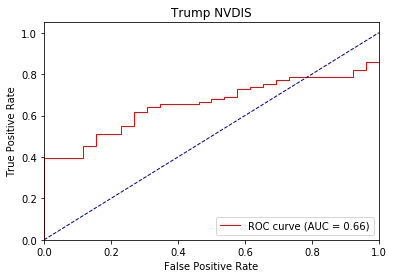

Directory already exists!
dt_nvdis1 1 ap tensor([0., 1.]) loss : 0.4319241940975189 0.47192275822162627 tid : 200 tg tensor([[1]], device='cuda:0')
dt_nvdis1 1 ap tensor([0.6095, 0.9304]) loss : 0.8898557424545288 0.5425598640215726 tid : 400 tg tensor([[0]], device='cuda:0')
TEST dt_nvdis1 1 ap tensor([0.2697, 0.9008]) loss : 0.5997850894927979 0.5367922639024669 tid : 150 tg tensor([[1]], device='cuda:0')
TEST dt_nvdis1 1 ap tensor([0.2874, 0.8843]) loss : 0.20538461208343506 0.5419049013492673 tid : 420 tg tensor([[1]], device='cuda:0')


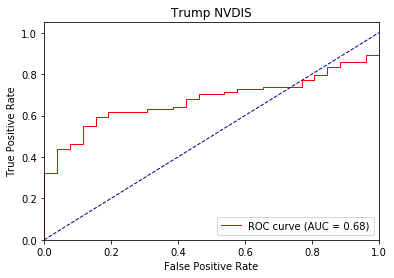

Directory already exists!
dt_nvdis1 2 ap tensor([0.7039, 0.9673]) loss : 0.9117079973220825 0.4259166752590853 tid : 400 tg tensor([[0]], device='cuda:0')
dt_nvdis1 2 ap tensor([0.6517, 0.9631]) loss : 0.16584819555282593 0.43241550845022386 tid : 200 tg tensor([[1]], device='cuda:0')
TEST dt_nvdis1 2 ap tensor([0.2582, 0.8897]) loss : 0.576958179473877 0.5170978318000662 tid : 150 tg tensor([[1]], device='cuda:0')
TEST dt_nvdis1 2 ap tensor([0.2866, 0.8783]) loss : 0.11725366115570068 0.5255200072776439 tid : 420 tg tensor([[1]], device='cuda:0')


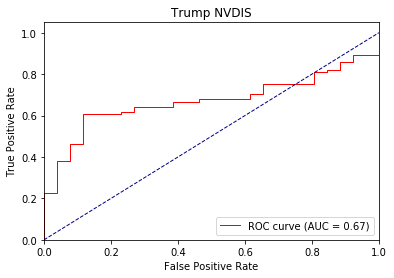

Directory already exists!
dt_lookat3 0 ap tensor([0.1227, 0.7147]) loss : 0.6756917834281921 0.7047084298464331 tid : 200 tg tensor([[1]], device='cuda:0')
dt_lookat3 0 ap tensor([0.1459, 0.7756]) loss : 0.6340864300727844 0.6466623665151482 tid : 400 tg tensor([[1]], device='cuda:0')
TEST dt_lookat3 0 ap tensor([0.4632, 0.9506]) loss : 0.6365105509757996 0.5396632213017036 tid : 150 tg tensor([[1]], device='cuda:0')
TEST dt_lookat3 0 ap tensor([0.1983, 0.9441]) loss : 0.4000488519668579 0.5418508929568667 tid : 420 tg tensor([[1]], device='cuda:0')


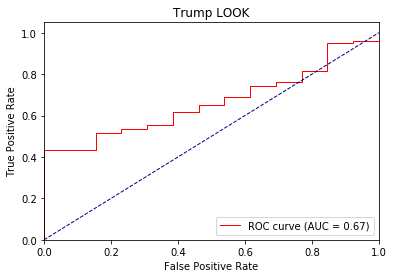

Directory already exists!
dt_lookat3 1 ap tensor([0.1335, 0.9143]) loss : 0.5796949863433838 0.5311271651433065 tid : 400 tg tensor([[1]], device='cuda:0')
dt_lookat3 1 ap tensor([0.3492, 0.9276]) loss : 0.26369649171829224 0.5089363035636508 tid : 200 tg tensor([[1]], device='cuda:0')
TEST dt_lookat3 1 ap tensor([0.5247, 0.9618]) loss : 0.5090462565422058 0.4485991535515621 tid : 150 tg tensor([[1]], device='cuda:0')
TEST dt_lookat3 1 ap tensor([0.2281, 0.9601]) loss : 0.20394957065582275 0.43058926040350004 tid : 420 tg tensor([[1]], device='cuda:0')


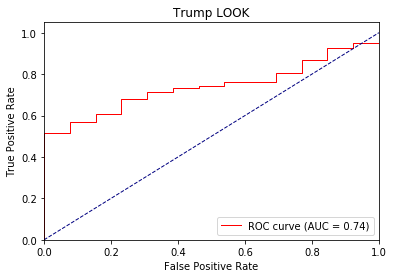

Directory already exists!
dt_lookat3 2 ap tensor([0.5457, 0.9501]) loss : 0.4386937916278839 0.4685126810430366 tid : 400 tg tensor([[1]], device='cuda:0')
dt_lookat3 2 ap tensor([0.5640, 0.9510]) loss : 0.20015913248062134 0.4577406570315361 tid : 200 tg tensor([[1]], device='cuda:0')
TEST dt_lookat3 2 ap tensor([0.4497, 0.9602]) loss : 0.4157440662384033 0.40673378315465203 tid : 150 tg tensor([[1]], device='cuda:0')
TEST dt_lookat3 2 ap tensor([0.2569, 0.9661]) loss : 0.11791253089904785 0.37411938122538635 tid : 420 tg tensor([[1]], device='cuda:0')


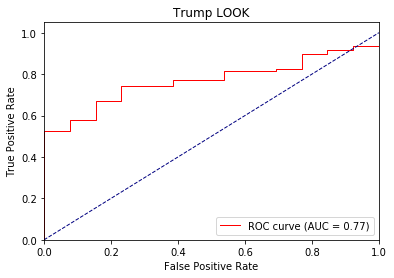

Directory already exists!
dt_eyebrow 0 ap tensor([0.1584, 0.9513]) loss : 1.1832935810089111 0.5732216668655594 tid : 200 tg tensor([[0]], device='cuda:0')
dt_eyebrow 0 ap tensor([0.1420, 0.9491]) loss : 0.40115195512771606 0.5272605370871628 tid : 400 tg tensor([[1]], device='cuda:0')
TEST dt_eyebrow 0 ap tensor([0.5594, 0.7105]) loss : 0.45633745193481445 0.7065889794251015 tid : 150 tg tensor([[1]], device='cuda:0')
TEST dt_eyebrow 0 ap tensor([0.6236, 0.7621]) loss : 0.3538590669631958 0.6780092511759248 tid : 420 tg tensor([[1]], device='cuda:0')


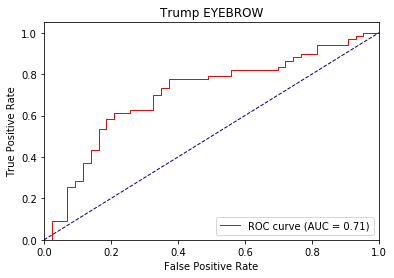

Directory already exists!
dt_eyebrow 1 ap tensor([0.2926, 0.9765]) loss : 0.3382241725921631 0.36111132114121086 tid : 400 tg tensor([[1]], device='cuda:0')
dt_eyebrow 1 ap tensor([0.2286, 0.9557]) loss : 2.0378546714782715 0.37251578211784364 tid : 200 tg tensor([[0]], device='cuda:0')
TEST dt_eyebrow 1 ap tensor([0.6090, 0.7108]) loss : 0.30076462030410767 0.8233884100256295 tid : 150 tg tensor([[1]], device='cuda:0')
TEST dt_eyebrow 1 ap tensor([0.6137, 0.7643]) loss : 0.2119905948638916 0.770488976392635 tid : 420 tg tensor([[1]], device='cuda:0')


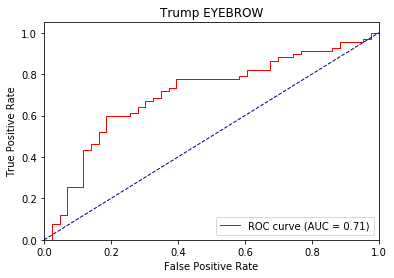

Directory already exists!
dt_eyebrow 2 ap tensor([0.1973, 0.9739]) loss : 0.1630265712738037 0.2783861395273134 tid : 400 tg tensor([[1]], device='cuda:0')
dt_eyebrow 2 ap tensor([0.1883, 0.9641]) loss : 2.871587038040161 0.2875949924694743 tid : 200 tg tensor([[0]], device='cuda:0')
TEST dt_eyebrow 2 ap tensor([0.6166, 0.7174]) loss : 0.2289397120475769 0.914300784982484 tid : 150 tg tensor([[1]], device='cuda:0')
TEST dt_eyebrow 2 ap tensor([0.6257, 0.7737]) loss : 0.13808667659759521 0.8517475602931754 tid : 420 tg tensor([[1]], device='cuda:0')


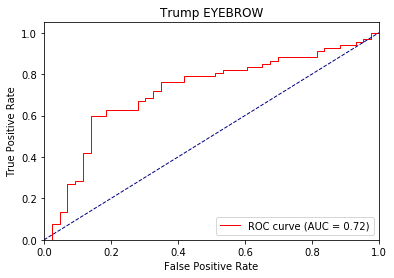

Directory already exists!
dt_atface 0 ap tensor([0.6938, 0.8359]) loss : 0.5503951907157898 0.662809251944224 tid : 400 tg tensor([[0]], device='cuda:0')
dt_atface 0 ap tensor([0.7294, 0.8758]) loss : 0.5932140350341797 0.6295111630879455 tid : 200 tg tensor([[1]], device='cuda:0')
TEST dt_atface 0 ap tensor([0.3977, 0.8634]) loss : 0.9404891133308411 0.6535349919878203 tid : 150 tg tensor([[1]], device='cuda:0')
TEST dt_atface 0 ap tensor([0.6291, 0.9028]) loss : 0.3545178771018982 0.5775745219962541 tid : 420 tg tensor([[1]], device='cuda:0')


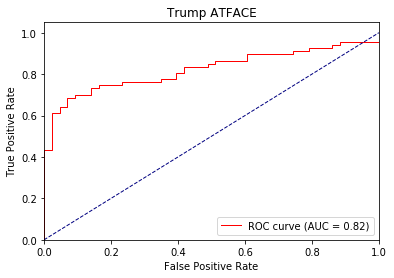

Directory already exists!
dt_atface 1 ap tensor([0.8171, 0.9625]) loss : 0.4877949059009552 0.500653449275078 tid : 200 tg tensor([[1]], device='cuda:0')
dt_atface 1 ap tensor([0.7753, 0.8797]) loss : 0.5154938101768494 0.5198781508171629 tid : 400 tg tensor([[0]], device='cuda:0')
TEST dt_atface 1 ap tensor([0.3951, 0.8695]) loss : 0.9913054704666138 0.6007712267596146 tid : 150 tg tensor([[1]], device='cuda:0')
TEST dt_atface 1 ap tensor([0.6281, 0.9092]) loss : 0.21054261922836304 0.5146217765503152 tid : 420 tg tensor([[1]], device='cuda:0')


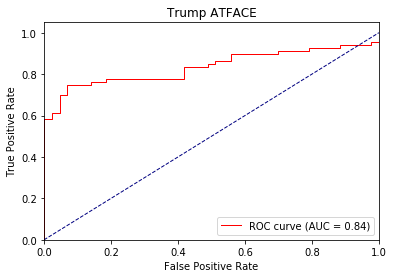

Directory already exists!
dt_atface 2 ap tensor([0.9069, 0.9749]) loss : 0.24826174974441528 0.3723366833650149 tid : 200 tg tensor([[1]], device='cuda:0')
dt_atface 2 ap tensor([0.7940, 0.9086]) loss : 0.43613672256469727 0.4193538505968144 tid : 400 tg tensor([[0]], device='cuda:0')
TEST dt_atface 2 ap tensor([0.3988, 0.8722]) loss : 1.0685789585113525 0.5862623278436989 tid : 150 tg tensor([[1]], device='cuda:0')
TEST dt_atface 2 ap tensor([0.6268, 0.9122]) loss : 0.1410379409790039 0.4872670970683874 tid : 420 tg tensor([[1]], device='cuda:0')


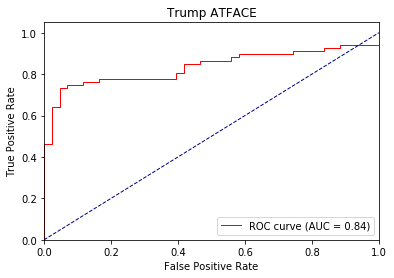

Directory already exists!
dt_feface 0 ap tensor([1., 0.]) loss : 0.5705927610397339 0.6127174761560228 tid : 400 tg tensor([[0]], device='cuda:0')
dt_feface 0 ap tensor([1., 0.]) loss : 0.48833224177360535 0.5594353516896565 tid : 200 tg tensor([[0]], device='cuda:0')
TEST dt_feface 0 ap tensor([0.9698, 0.2255]) loss : 0.37351277470588684 0.3569358176198499 tid : 150 tg tensor([[0]], device='cuda:0')
TEST dt_feface 0 ap tensor([0.9790, 0.0408]) loss : 0.2675427198410034 0.34697500044523283 tid : 420 tg tensor([[0]], device='cuda:0')


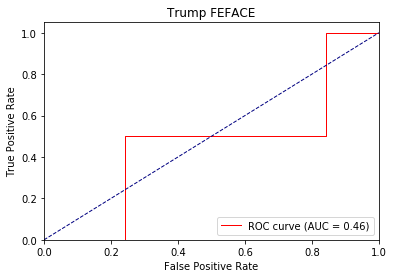

Directory already exists!
dt_feface 1 ap tensor([1., 0.]) loss : 0.1543784737586975 0.2388751688102881 tid : 200 tg tensor([[0]], device='cuda:0')
dt_feface 1 ap tensor([1., 0.]) loss : 0.13148462772369385 0.19874494397451006 tid : 400 tg tensor([[0]], device='cuda:0')
TEST dt_feface 1 ap tensor([0.9639, 0.2193]) loss : 0.1965075135231018 0.2560237563889602 tid : 150 tg tensor([[0]], device='cuda:0')
TEST dt_feface 1 ap tensor([0.9773, 0.0433]) loss : 0.13509738445281982 0.20509678749151009 tid : 420 tg tensor([[0]], device='cuda:0')


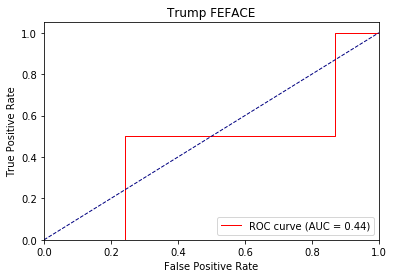

Directory already exists!
dt_feface 2 ap tensor([1., 0.]) loss : 0.06562674045562744 0.1254162381995808 tid : 200 tg tensor([[0]], device='cuda:0')
dt_feface 2 ap tensor([1., 0.]) loss : 0.06420862674713135 0.09969198892388163 tid : 400 tg tensor([[0]], device='cuda:0')
TEST dt_feface 2 ap tensor([0.9568, 0.2143]) loss : 0.09818339347839355 0.2441652149989687 tid : 150 tg tensor([[0]], device='cuda:0')
TEST dt_feface 2 ap tensor([0.9736, 0.0409]) loss : 0.07125699520111084 0.14686024258303088 tid : 420 tg tensor([[0]], device='cuda:0')


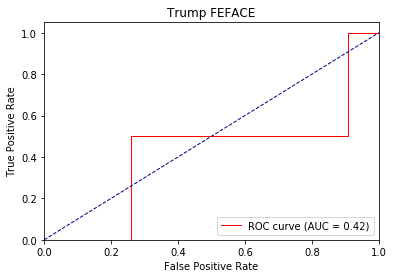

Directory already exists!
dt_hrface 0 ap tensor([0.9370, 0.1101]) loss : 0.4754360318183899 0.6152801763920384 tid : 200 tg tensor([[0]], device='cuda:0')
dt_hrface 0 ap tensor([0.9527, 0.1451]) loss : 0.549222469329834 0.5586302281642447 tid : 400 tg tensor([[0]], device='cuda:0')
TEST dt_hrface 0 ap tensor([0.9251, 0.1218]) loss : 0.4817752242088318 0.4244629740715027 tid : 150 tg tensor([[0]], device='cuda:0')
TEST dt_hrface 0 ap tensor([0.9308, 0.1369]) loss : 0.41226014494895935 0.44798312630764275 tid : 420 tg tensor([[0]], device='cuda:0')


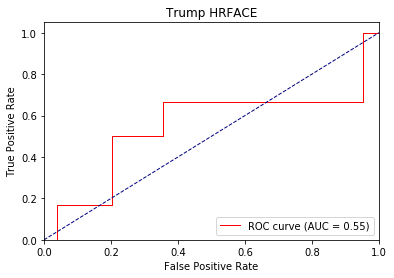

Directory already exists!
dt_hrface 1 ap tensor([0.9489, 0.0834]) loss : 0.20597225427627563 0.3918894006146325 tid : 200 tg tensor([[0]], device='cuda:0')
dt_hrface 1 ap tensor([0.9784, 0.2437]) loss : 0.2522149682044983 0.33057478854530736 tid : 400 tg tensor([[0]], device='cuda:0')
TEST dt_hrface 1 ap tensor([0.9486, 0.1288]) loss : 0.3146859407424927 0.3110956693517751 tid : 150 tg tensor([[0]], device='cuda:0')
TEST dt_hrface 1 ap tensor([0.9371, 0.2632]) loss : 0.23460900783538818 0.329091212084127 tid : 420 tg tensor([[0]], device='cuda:0')


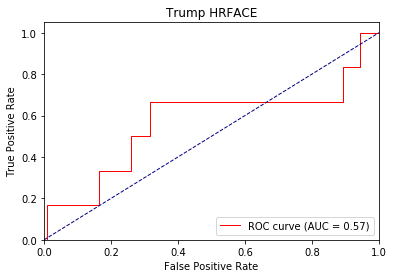

Directory already exists!
dt_hrface 2 ap tensor([0.9924, 0.5252]) loss : 0.08551633358001709 0.23580080245723242 tid : 200 tg tensor([[0]], device='cuda:0')
dt_hrface 2 ap tensor([0.9672, 0.3679]) loss : 0.1612343192100525 0.2637482773656307 tid : 400 tg tensor([[0]], device='cuda:0')
TEST dt_hrface 2 ap tensor([0.9698, 0.1625]) loss : 0.22277307510375977 0.2675977349281311 tid : 150 tg tensor([[0]], device='cuda:0')
TEST dt_hrface 2 ap tensor([0.9529, 0.2704]) loss : 0.14673000574111938 0.2775710734517075 tid : 420 tg tensor([[0]], device='cuda:0')


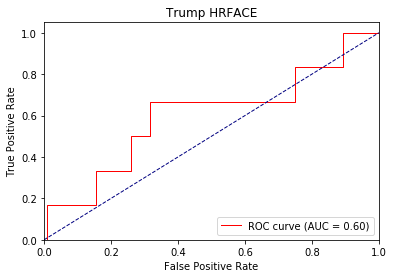

Directory already exists!
dt_saface 0 ap tensor([1., 0.]) loss : 0.523001492023468 0.709245781962936 tid : 200 tg tensor([[0]], device='cuda:0')
dt_saface 0 ap tensor([1., 0.]) loss : 0.4798808693885803 0.5882321823999365 tid : 400 tg tensor([[0]], device='cuda:0')
TEST dt_saface 0 ap tensor([1., 0.]) loss : 0.501794159412384 0.37366560101509094 tid : 150 tg tensor([[0]], device='cuda:0')
TEST dt_saface 0 ap tensor([1., 0.]) loss : 0.42457062005996704 0.41705749270527864 tid : 420 tg tensor([[0]], device='cuda:0')


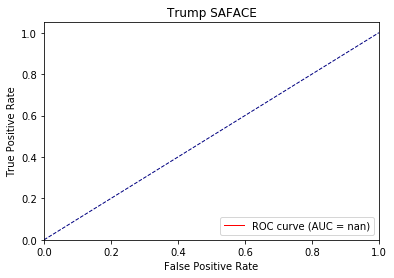

Directory already exists!
dt_saface 1 ap tensor([1., 0.]) loss : 0.15303480625152588 0.29545173476571623 tid : 200 tg tensor([[0]], device='cuda:0')
dt_saface 1 ap tensor([1., 0.]) loss : 0.20442163944244385 0.2496456894839164 tid : 400 tg tensor([[0]], device='cuda:0')
TEST dt_saface 1 ap tensor([1., 0.]) loss : 0.24964165687561035 0.1728094970357829 tid : 150 tg tensor([[0]], device='cuda:0')
TEST dt_saface 1 ap tensor([1., 0.]) loss : 0.22257614135742188 0.21094429146411808 tid : 420 tg tensor([[0]], device='cuda:0')


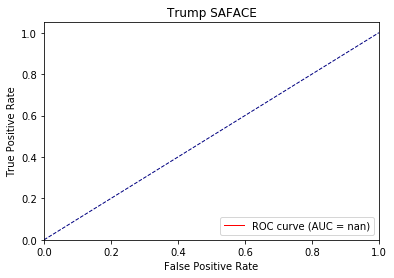

Directory already exists!
dt_saface 2 ap tensor([1., 0.]) loss : 0.07912755012512207 0.15525496403376263 tid : 200 tg tensor([[0]], device='cuda:0')
dt_saface 2 ap tensor([1., 0.]) loss : 0.12397706508636475 0.1332462457852943 tid : 400 tg tensor([[0]], device='cuda:0')
TEST dt_saface 2 ap tensor([1., 0.]) loss : 0.11239063739776611 0.0812609915075631 tid : 150 tg tensor([[0]], device='cuda:0')
TEST dt_saface 2 ap tensor([1., 0.]) loss : 0.11621147394180298 0.10907478180042533 tid : 420 tg tensor([[0]], device='cuda:0')


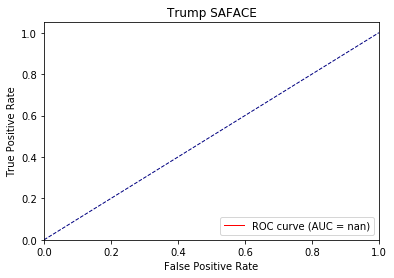

Directory already exists!
dt_neuface 0 ap tensor([0.8489, 0.5735]) loss : 0.7322734594345093 0.6631153065424699 tid : 400 tg tensor([[1]], device='cuda:0')
dt_neuface 0 ap tensor([0.8732, 0.4999]) loss : 0.40064337849617004 0.6306623850638667 tid : 200 tg tensor([[0]], device='cuda:0')
TEST dt_neuface 0 ap tensor([0.9316, 0.3599]) loss : 0.6463040113449097 0.5626161016266922 tid : 150 tg tensor([[0]], device='cuda:0')
TEST dt_neuface 0 ap tensor([0.9077, 0.5258]) loss : 0.38687434792518616 0.5835024821896886 tid : 420 tg tensor([[0]], device='cuda:0')


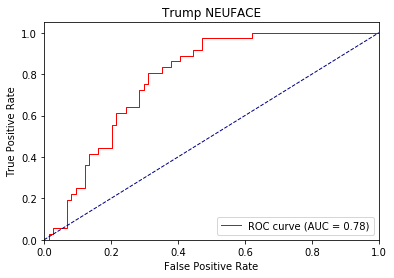

Directory already exists!
dt_neuface 1 ap tensor([0.9317, 0.4415]) loss : 0.31587252020835876 0.5437514672816639 tid : 200 tg tensor([[0]], device='cuda:0')
dt_neuface 1 ap tensor([0.9406, 0.6890]) loss : 0.7148427963256836 0.5259727286587795 tid : 400 tg tensor([[1]], device='cuda:0')
TEST dt_neuface 1 ap tensor([0.9164, 0.3005]) loss : 0.6688827276229858 0.5157040295929745 tid : 150 tg tensor([[0]], device='cuda:0')
TEST dt_neuface 1 ap tensor([0.9109, 0.5079]) loss : 0.23902159929275513 0.5362757558739463 tid : 420 tg tensor([[0]], device='cuda:0')


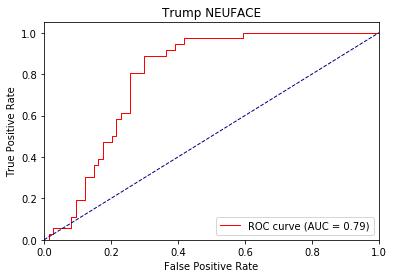

Directory already exists!
dt_neuface 2 ap tensor([0.9110, 0.7955]) loss : 0.6751973032951355 0.5101796954870224 tid : 400 tg tensor([[1]], device='cuda:0')
dt_neuface 2 ap tensor([0.9455, 0.7290]) loss : 0.19161099195480347 0.4687408208847046 tid : 200 tg tensor([[0]], device='cuda:0')
TEST dt_neuface 2 ap tensor([0.9093, 0.2806]) loss : 0.7012618780136108 0.4997063906028353 tid : 150 tg tensor([[0]], device='cuda:0')
TEST dt_neuface 2 ap tensor([0.9100, 0.5066]) loss : 0.1572977900505066 0.5135182218496189 tid : 420 tg tensor([[0]], device='cuda:0')


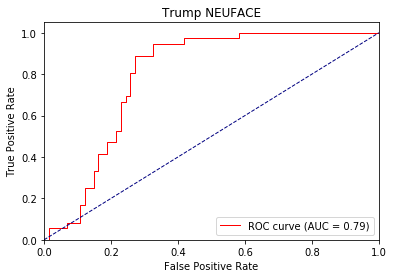

Directory already exists!
dt_inapprop 0 ap tensor([0.9637, 0.0581]) loss : 0.3476266860961914 0.5639065239042373 tid : 200 tg tensor([[0]], device='cuda:0')
dt_inapprop 0 ap tensor([0.9600, 0.0532]) loss : 0.27030277252197266 0.5224909038131774 tid : 400 tg tensor([[0]], device='cuda:0')
TEST dt_inapprop 0 ap tensor([0.8826, 0.2256]) loss : 1.4137799739837646 0.48202073985132676 tid : 150 tg tensor([[1]], device='cuda:0')
TEST dt_inapprop 0 ap tensor([0.8756, 0.1122]) loss : 0.40517351031303406 0.46886318679465805 tid : 420 tg tensor([[0]], device='cuda:0')


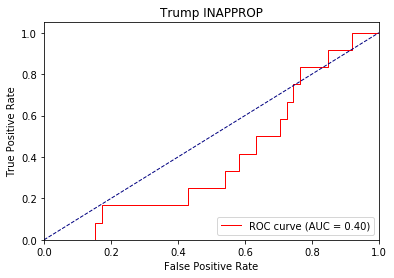

Directory already exists!
dt_inapprop 1 ap tensor([0.9861, 0.0447]) loss : 0.21253526210784912 0.33241048377829713 tid : 400 tg tensor([[0]], device='cuda:0')
dt_inapprop 1 ap tensor([0.9803, 0.0445]) loss : 0.16845929622650146 0.3256863611085074 tid : 200 tg tensor([[0]], device='cuda:0')
TEST dt_inapprop 1 ap tensor([0.8916, 0.2272]) loss : 1.9560372829437256 0.4620588956208065 tid : 150 tg tensor([[1]], device='cuda:0')
TEST dt_inapprop 1 ap tensor([0.8795, 0.1181]) loss : 0.23718762397766113 0.40559208947558734 tid : 420 tg tensor([[0]], device='cuda:0')


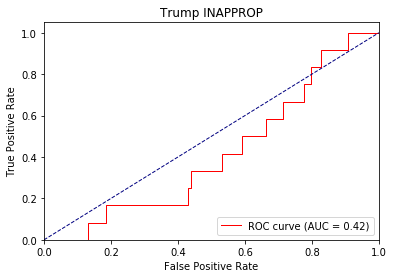

Directory already exists!
dt_inapprop 2 ap tensor([0.9825, 0.0560]) loss : 0.05711519718170166 0.2005505267385248 tid : 200 tg tensor([[0]], device='cuda:0')
dt_inapprop 2 ap tensor([0.9709, 0.0579]) loss : 0.062357425689697266 0.21660369065107477 tid : 400 tg tensor([[0]], device='cuda:0')
TEST dt_inapprop 2 ap tensor([0.8837, 0.2068]) loss : 2.4537911415100098 0.4965443405611762 tid : 150 tg tensor([[1]], device='cuda:0')
TEST dt_inapprop 2 ap tensor([0.8805, 0.1187]) loss : 0.153692364692688 0.4029607246088427 tid : 420 tg tensor([[0]], device='cuda:0')


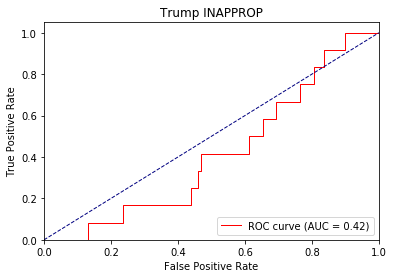

Directory already exists!
dt_affgest 0 ap tensor([0.9660, 0.0350]) loss : 0.5480023622512817 0.6857492238283157 tid : 400 tg tensor([[0]], device='cuda:0')
dt_affgest 0 ap tensor([0.9771, 0.0338]) loss : 0.3516877293586731 0.6319661306801126 tid : 200 tg tensor([[0]], device='cuda:0')
TEST dt_affgest 0 ap tensor([0.9541, 0.1476]) loss : 0.5349708199501038 0.4605661281223955 tid : 150 tg tensor([[0]], device='cuda:0')
TEST dt_affgest 0 ap tensor([0.9592, 0.0541]) loss : 0.5263911485671997 0.47746332925419477 tid : 420 tg tensor([[0]], device='cuda:0')


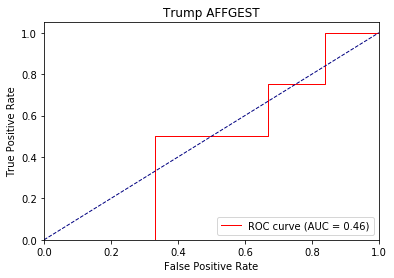

Directory already exists!
dt_affgest 1 ap tensor([0.9878, 0.0596]) loss : 0.18099725246429443 0.3486250144739946 tid : 200 tg tensor([[0]], device='cuda:0')
dt_affgest 1 ap tensor([0.9729, 0.0437]) loss : 0.18529927730560303 0.32648279247128575 tid : 400 tg tensor([[0]], device='cuda:0')
TEST dt_affgest 1 ap tensor([0.9497, 0.1101]) loss : 0.3036051392555237 0.3210924452748792 tid : 150 tg tensor([[0]], device='cuda:0')
TEST dt_affgest 1 ap tensor([0.9546, 0.0487]) loss : 0.3148803114891052 0.3252527474663978 tid : 420 tg tensor([[0]], device='cuda:0')


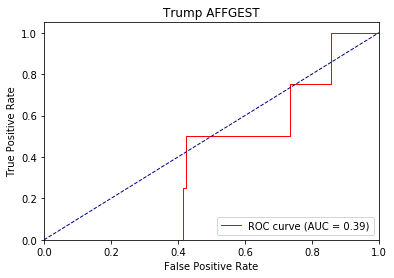

Directory already exists!
dt_affgest 2 ap tensor([0.9764, 0.0567]) loss : 0.08101880550384521 0.2316723087460937 tid : 200 tg tensor([[0]], device='cuda:0')
dt_affgest 2 ap tensor([0.9783, 0.0552]) loss : 0.10257422924041748 0.22740819027321565 tid : 400 tg tensor([[0]], device='cuda:0')
TEST dt_affgest 2 ap tensor([0.9518, 0.1056]) loss : 0.1663980484008789 0.27199153036906804 tid : 150 tg tensor([[0]], device='cuda:0')
TEST dt_affgest 2 ap tensor([0.9529, 0.0462]) loss : 0.19339025020599365 0.2565245205579802 tid : 420 tg tensor([[0]], device='cuda:0')


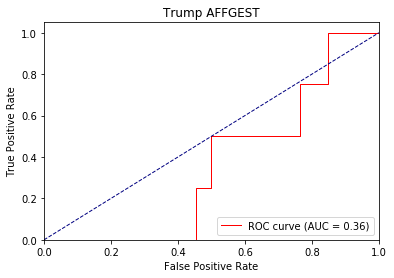

Directory already exists!
dt_defgest 0 ap tensor([0.5928, 0.3152]) loss : 0.7818637490272522 0.7599868928944623 tid : 400 tg tensor([[0]], device='cuda:0')
dt_defgest 0 ap tensor([0.5785, 0.2801]) loss : 0.6523308157920837 0.7306083894487637 tid : 200 tg tensor([[1]], device='cuda:0')
TEST dt_defgest 0 ap tensor([0.9496, 0.3708]) loss : 0.8058962225914001 0.6132845868324411 tid : 150 tg tensor([[1]], device='cuda:0')
TEST dt_defgest 0 ap tensor([0.8678, 0.4663]) loss : 0.6677926182746887 0.6497389691513639 tid : 420 tg tensor([[1]], device='cuda:0')


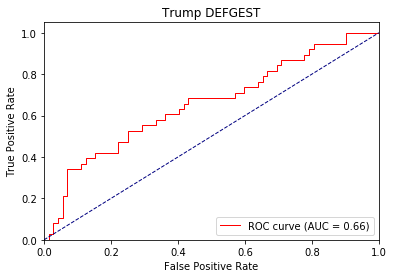

Directory already exists!
dt_defgest 1 ap tensor([0.8165, 0.6899]) loss : 0.7053004503250122 0.6231674357600834 tid : 200 tg tensor([[1]], device='cuda:0')
dt_defgest 1 ap tensor([0.8572, 0.5535]) loss : 0.4801807999610901 0.6074882483304437 tid : 400 tg tensor([[0]], device='cuda:0')
TEST dt_defgest 1 ap tensor([0.9562, 0.5214]) loss : 1.040057897567749 0.5302517444923006 tid : 150 tg tensor([[1]], device='cuda:0')
TEST dt_defgest 1 ap tensor([0.9314, 0.6612]) loss : 0.5956807136535645 0.575425730541695 tid : 420 tg tensor([[1]], device='cuda:0')


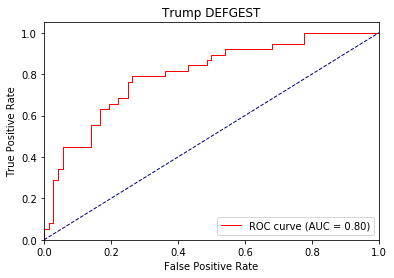

Directory already exists!
dt_defgest 2 ap tensor([0.9502, 0.7307]) loss : 0.3226640224456787 0.5111073870812693 tid : 400 tg tensor([[0]], device='cuda:0')
dt_defgest 2 ap tensor([0.8942, 0.6929]) loss : 0.7827180027961731 0.5354685353545042 tid : 200 tg tensor([[1]], device='cuda:0')
TEST dt_defgest 2 ap tensor([0.9545, 0.5110]) loss : 1.2470872402191162 0.4879329810882437 tid : 150 tg tensor([[1]], device='cuda:0')
TEST dt_defgest 2 ap tensor([0.9350, 0.6999]) loss : 0.5306118726730347 0.5310865744601848 tid : 420 tg tensor([[1]], device='cuda:0')


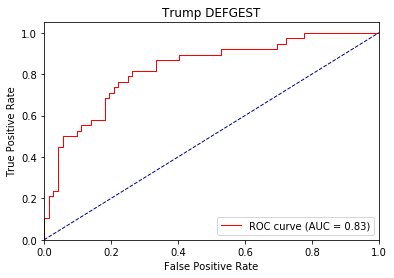

Directory already exists!
dt_agentic 0 ap tensor([0.5224, 0.8238]) loss : 0.43278414011001587 0.6356409151371711 tid : 200 tg tensor([[1]], device='cuda:0')
dt_agentic 0 ap tensor([0.5532, 0.8321]) loss : 0.6397429704666138 0.6304321136603319 tid : 400 tg tensor([[0]], device='cuda:0')
TEST dt_agentic 0 ap tensor([0.9469, 0.9601]) loss : 0.8534307479858398 0.5125254022664038 tid : 150 tg tensor([[1]], device='cuda:0')
TEST dt_agentic 0 ap tensor([0.9076, 0.9268]) loss : 0.5254244804382324 0.5530657820230307 tid : 420 tg tensor([[1]], device='cuda:0')


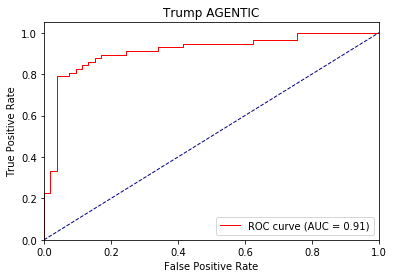

Directory already exists!
dt_agentic 1 ap tensor([0.7725, 0.9511]) loss : 0.5948212742805481 0.4882120224269661 tid : 400 tg tensor([[0]], device='cuda:0')
dt_agentic 1 ap tensor([0.7971, 0.9509]) loss : 0.2669324278831482 0.47720879554748535 tid : 200 tg tensor([[1]], device='cuda:0')
TEST dt_agentic 1 ap tensor([0.9608, 0.9643]) loss : 0.921131432056427 0.4254653114697029 tid : 150 tg tensor([[1]], device='cuda:0')
TEST dt_agentic 1 ap tensor([0.9222, 0.9351]) loss : 0.277274489402771 0.4722954793724903 tid : 420 tg tensor([[1]], device='cuda:0')


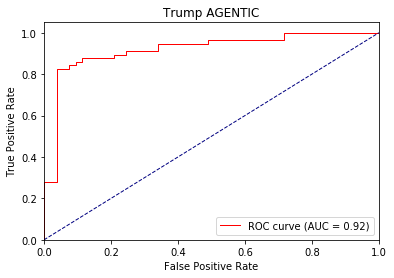

Directory already exists!
dt_agentic 2 ap tensor([0.8254, 0.9541]) loss : 0.5177050232887268 0.39381648841741923 tid : 400 tg tensor([[0]], device='cuda:0')
dt_agentic 2 ap tensor([0.7901, 0.9531]) loss : 0.16787123680114746 0.3979917076634772 tid : 200 tg tensor([[1]], device='cuda:0')
TEST dt_agentic 2 ap tensor([0.9667, 0.9667]) loss : 0.9828042984008789 0.37772065092777385 tid : 150 tg tensor([[1]], device='cuda:0')
TEST dt_agentic 2 ap tensor([0.9276, 0.9396]) loss : 0.16817831993103027 0.4345913806626963 tid : 420 tg tensor([[1]], device='cuda:0')


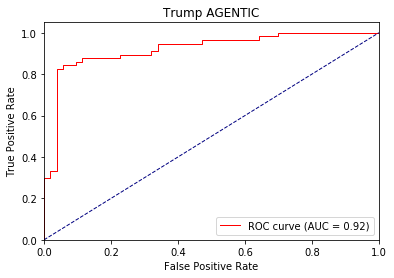

Directory already exists!
dt_waveoff 0 ap tensor([1., 0.]) loss : 0.8161511421203613 0.6598605145426357 tid : 200 tg tensor([[0]], device='cuda:0')
dt_waveoff 0 ap tensor([1., 0.]) loss : 0.28389912843704224 0.45330429148865253 tid : 400 tg tensor([[0]], device='cuda:0')
TEST dt_waveoff 0 ap tensor([0.9694, 0.8145]) loss : 0.26930248737335205 0.47302917365370123 tid : 150 tg tensor([[0]], device='cuda:0')
TEST dt_waveoff 0 ap tensor([0.9506, 0.1912]) loss : 0.42113029956817627 0.4125393091939216 tid : 420 tg tensor([[0]], device='cuda:0')


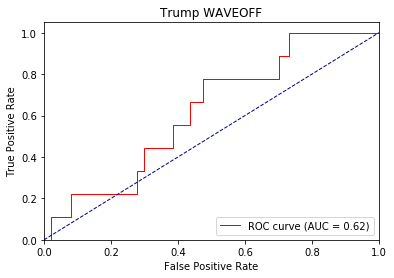

Directory already exists!
dt_waveoff 1 ap tensor([1., 0.]) loss : 0.20876282453536987 0.2601239523797665 tid : 400 tg tensor([[0]], device='cuda:0')
dt_waveoff 1 ap tensor([1., 0.]) loss : 0.13836580514907837 0.2272957862634969 tid : 200 tg tensor([[0]], device='cuda:0')
TEST dt_waveoff 1 ap tensor([0.9265, 0.4731]) loss : 0.13354265689849854 0.5505758153981176 tid : 150 tg tensor([[0]], device='cuda:0')
TEST dt_waveoff 1 ap tensor([0.9279, 0.2141]) loss : 0.23764455318450928 0.34270725035390187 tid : 420 tg tensor([[0]], device='cuda:0')


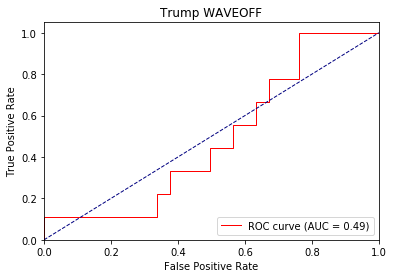

Directory already exists!
dt_waveoff 2 ap tensor([1., 0.]) loss : 0.09747457504272461 0.1266732116540273 tid : 400 tg tensor([[0]], device='cuda:0')
dt_waveoff 2 ap tensor([1., 0.]) loss : 0.05440926551818848 0.10582200437784195 tid : 200 tg tensor([[0]], device='cuda:0')
TEST dt_waveoff 2 ap tensor([0.9208, 0.4089]) loss : 0.06271946430206299 0.6899215640692875 tid : 150 tg tensor([[0]], device='cuda:0')
TEST dt_waveoff 2 ap tensor([0.9232, 0.2094]) loss : 0.12657403945922852 0.34814294340998625 tid : 420 tg tensor([[0]], device='cuda:0')


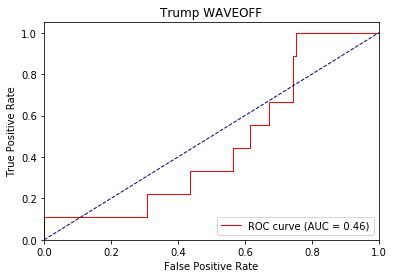

Directory already exists!
dt_nvtic1 0 ap tensor([0.9019, 0.2456]) loss : 0.7330975532531738 0.6561272549960349 tid : 200 tg tensor([[0]], device='cuda:0')
dt_nvtic1 0 ap tensor([0.8562, 0.1610]) loss : 0.4183275103569031 0.6412503098258535 tid : 400 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic1 0 ap tensor([0.9137, 0.2438]) loss : 0.33604952692985535 0.4946154489599425 tid : 150 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic1 0 ap tensor([0.9428, 0.3061]) loss : 0.41404297947883606 0.4663470439439596 tid : 420 tg tensor([[0]], device='cuda:0')


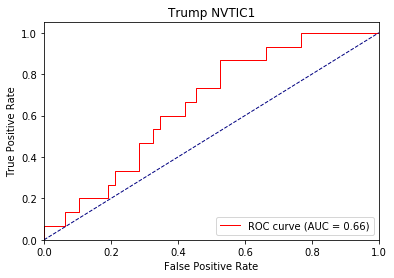

Directory already exists!
dt_nvtic1 1 ap tensor([0.8971, 0.1911]) loss : 0.37095141410827637 0.48799109533429147 tid : 200 tg tensor([[0]], device='cuda:0')
dt_nvtic1 1 ap tensor([0.9290, 0.2177]) loss : 0.27042633295059204 0.4623091126743116 tid : 400 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic1 1 ap tensor([0.9269, 0.2693]) loss : 0.2785945534706116 0.4361448000217306 tid : 150 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic1 1 ap tensor([0.9568, 0.3221]) loss : 0.2633422613143921 0.39904016013755356 tid : 420 tg tensor([[0]], device='cuda:0')


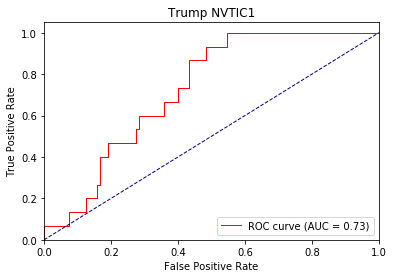

Directory already exists!
dt_nvtic1 2 ap tensor([0.9487, 0.2502]) loss : 0.2269095778465271 0.3797273698511782 tid : 400 tg tensor([[0]], device='cuda:0')
dt_nvtic1 2 ap tensor([0.9545, 0.2555]) loss : 0.12794709205627441 0.370295678302059 tid : 200 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic1 2 ap tensor([0.9463, 0.3682]) loss : 0.26486825942993164 0.4103950868392813 tid : 150 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic1 2 ap tensor([0.9605, 0.2976]) loss : 0.18194270133972168 0.3719567774340164 tid : 420 tg tensor([[0]], device='cuda:0')


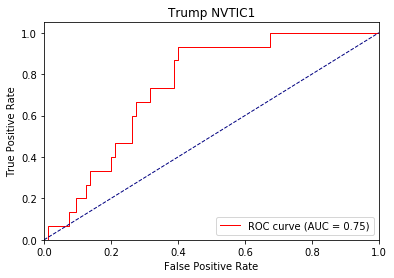

Directory already exists!
dt_nvtic2 0 ap tensor([0.9122, 0.0814]) loss : 0.6914428472518921 0.7214772138330672 tid : 200 tg tensor([[0]], device='cuda:0')
dt_nvtic2 0 ap tensor([0.9171, 0.1116]) loss : 0.5724698901176453 0.6391684710073616 tid : 400 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic2 0 ap tensor([0.8401, 0.5583]) loss : 0.529859185218811 0.6225534533632213 tid : 150 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic2 0 ap tensor([0.9223, 0.5103]) loss : 0.30814385414123535 0.5112855510656223 tid : 420 tg tensor([[0]], device='cuda:0')


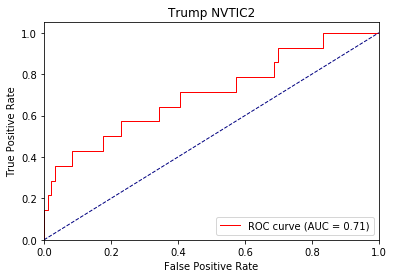

Directory already exists!
dt_nvtic2 1 ap tensor([1., 0.]) loss : 0.48787933588027954 0.4577265400439501 tid : 400 tg tensor([[0]], device='cuda:0')
dt_nvtic2 1 ap tensor([0.9419, 0.1901]) loss : 0.19495439529418945 0.42657773664608095 tid : 200 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic2 1 ap tensor([0.8140, 0.5541]) loss : 0.3795433044433594 0.6471006705843169 tid : 150 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic2 1 ap tensor([0.9067, 0.5279]) loss : 0.17761588096618652 0.4324529926444209 tid : 420 tg tensor([[0]], device='cuda:0')


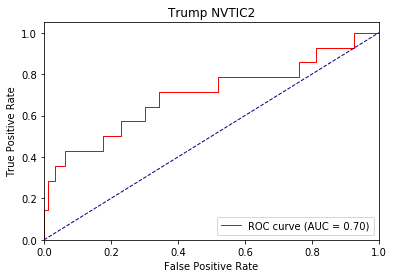

Directory already exists!
dt_nvtic2 2 ap tensor([0.9686, 0.4453]) loss : 0.3264119029045105 0.3722762123067328 tid : 400 tg tensor([[0]], device='cuda:0')
dt_nvtic2 2 ap tensor([0.9603, 0.2431]) loss : 0.11761033535003662 0.35320848371924424 tid : 200 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic2 2 ap tensor([0.7697, 0.5416]) loss : 0.29126691818237305 0.7041311140718132 tid : 150 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic2 2 ap tensor([0.8957, 0.5287]) loss : 0.11207199096679688 0.4090708916963533 tid : 420 tg tensor([[0]], device='cuda:0')


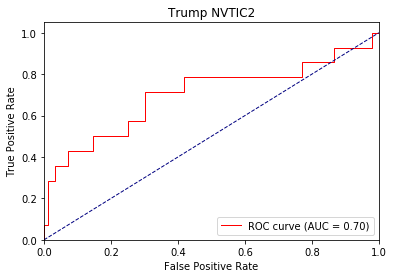

Directory already exists!
dt_nvtic3 0 ap tensor([0.6044, 0.6844]) loss : 0.7359490394592285 0.6623766486551247 tid : 200 tg tensor([[1]], device='cuda:0')
dt_nvtic3 0 ap tensor([0.6426, 0.7619]) loss : 0.49343281984329224 0.6393117968162353 tid : 400 tg tensor([[1]], device='cuda:0')
TEST dt_nvtic3 0 ap tensor([0.6034, 0.9452]) loss : 0.49160221219062805 0.6118950422467857 tid : 150 tg tensor([[1]], device='cuda:0')
TEST dt_nvtic3 0 ap tensor([0.6006, 0.8045]) loss : 0.6559150218963623 0.6430330051239147 tid : 420 tg tensor([[0]], device='cuda:0')


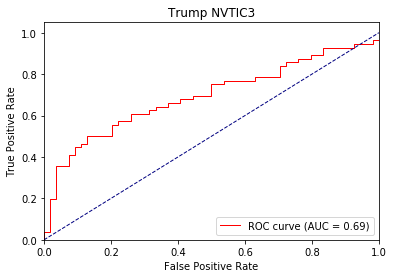

Directory already exists!
dt_nvtic3 1 ap tensor([0.7172, 0.8599]) loss : 0.8094943165779114 0.5506244833005294 tid : 200 tg tensor([[1]], device='cuda:0')
dt_nvtic3 1 ap tensor([0.6969, 0.8580]) loss : 0.394830584526062 0.5527301778395971 tid : 400 tg tensor([[1]], device='cuda:0')
TEST dt_nvtic3 1 ap tensor([0.4912, 0.9449]) loss : 0.43184763193130493 0.5793647622240001 tid : 150 tg tensor([[1]], device='cuda:0')
TEST dt_nvtic3 1 ap tensor([0.6093, 0.8267]) loss : 0.5067205429077148 0.6096505366785582 tid : 420 tg tensor([[0]], device='cuda:0')


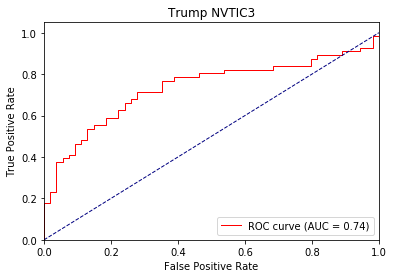

Directory already exists!
dt_nvtic3 2 ap tensor([0.7324, 0.8733]) loss : 0.8171794414520264 0.523979240466678 tid : 200 tg tensor([[1]], device='cuda:0')
dt_nvtic3 2 ap tensor([0.6980, 0.8945]) loss : 0.3283012807369232 0.5148703622521821 tid : 400 tg tensor([[1]], device='cuda:0')
TEST dt_nvtic3 2 ap tensor([0.4793, 0.9441]) loss : 0.39000174403190613 0.5692384726014631 tid : 150 tg tensor([[1]], device='cuda:0')
TEST dt_nvtic3 2 ap tensor([0.6151, 0.8295]) loss : 0.41622865200042725 0.5963876521171525 tid : 420 tg tensor([[0]], device='cuda:0')


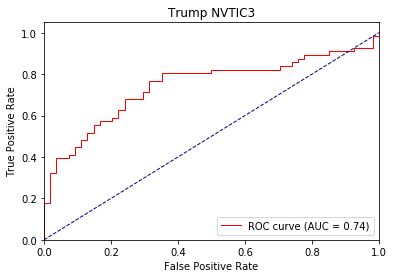

Directory already exists!
dt_nvtic5 0 ap tensor([0.9718, 0.0172]) loss : 0.37179672718048096 0.5373762002281866 tid : 200 tg tensor([[0]], device='cuda:0')
dt_nvtic5 0 ap tensor([0.9738, 0.0174]) loss : 0.3616623282432556 0.5187514489977667 tid : 400 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic5 0 ap tensor([1., 0.]) loss : 0.3571585714817047 0.3304328754030425 tid : 150 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic5 0 ap tensor([0.9881, 0.1019]) loss : 0.39149150252342224 0.3864186520493308 tid : 420 tg tensor([[0]], device='cuda:0')


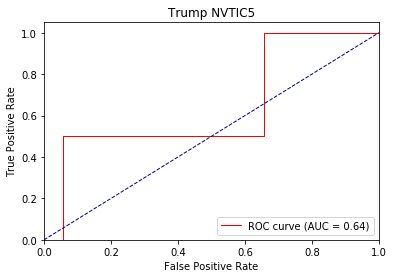

Directory already exists!
dt_nvtic5 1 ap tensor([0.9792, 0.0084]) loss : 0.14212775230407715 0.2635386177663053 tid : 200 tg tensor([[0]], device='cuda:0')
dt_nvtic5 1 ap tensor([0.9822, 0.0082]) loss : 0.16150587797164917 0.25791400128429987 tid : 400 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic5 1 ap tensor([1., 0.]) loss : 0.1837056279182434 0.16096379428074278 tid : 150 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic5 1 ap tensor([0.9928, 0.1096]) loss : 0.1888381838798523 0.22375714120476745 tid : 420 tg tensor([[0]], device='cuda:0')


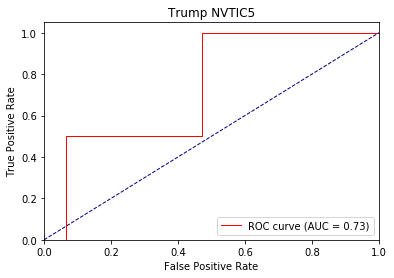

Directory already exists!
dt_nvtic5 2 ap tensor([0.9797, 0.0163]) loss : 0.09721624851226807 0.1839773070717615 tid : 200 tg tensor([[0]], device='cuda:0')
dt_nvtic5 2 ap tensor([0.9847, 0.0163]) loss : 0.08997178077697754 0.16122631651307473 tid : 400 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic5 2 ap tensor([1., 0.]) loss : 0.09540712833404541 0.08650922364202039 tid : 150 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic5 2 ap tensor([0.9954, 0.1218]) loss : 0.09972262382507324 0.15202248754889466 tid : 420 tg tensor([[0]], device='cuda:0')


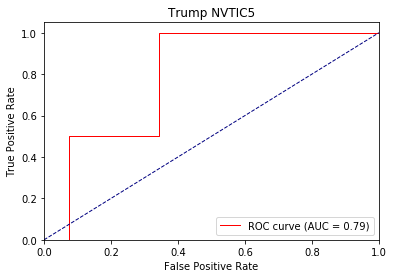

Directory already exists!
dt_nvtic4 0 ap tensor([0.9551, 0.0937]) loss : 0.39546486735343933 0.518734614241798 tid : 400 tg tensor([[0]], device='cuda:0')
dt_nvtic4 0 ap tensor([0.9782, 0.0829]) loss : 0.2584594488143921 0.47152673790005134 tid : 200 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic4 0 ap tensor([1., 0.]) loss : 0.43563520908355713 0.3203590214252472 tid : 150 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic4 0 ap tensor([0.9915, 0.0542]) loss : 0.37296146154403687 0.37745690726956654 tid : 420 tg tensor([[0]], device='cuda:0')


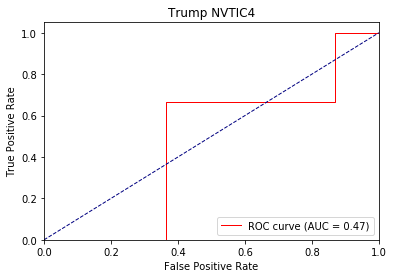

Directory already exists!
dt_nvtic4 1 ap tensor([0.9648, 0.1336]) loss : 0.1811765432357788 0.27661137636502586 tid : 400 tg tensor([[0]], device='cuda:0')
dt_nvtic4 1 ap tensor([0.9671, 0.1323]) loss : 0.09937751293182373 0.27358028893322905 tid : 200 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic4 1 ap tensor([1., 0.]) loss : 0.27790191769599915 0.17411944064600715 tid : 150 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic4 1 ap tensor([0.9913, 0.0526]) loss : 0.19736963510513306 0.24145414558954018 tid : 420 tg tensor([[0]], device='cuda:0')


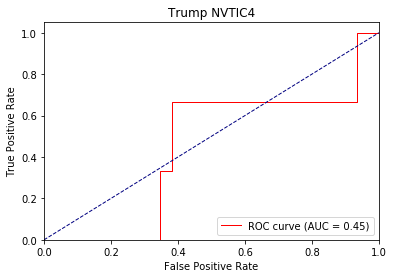

Directory already exists!
dt_nvtic4 2 ap tensor([0.9721, 0.2714]) loss : 0.1376340389251709 0.21864702423712365 tid : 400 tg tensor([[0]], device='cuda:0')
dt_nvtic4 2 ap tensor([0.9788, 0.2569]) loss : 0.06655895709991455 0.20476192044906127 tid : 200 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic4 2 ap tensor([1., 0.]) loss : 0.19135767221450806 0.10981851302344224 tid : 150 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic4 2 ap tensor([0.9908, 0.0503]) loss : 0.10989689826965332 0.1808947990106982 tid : 420 tg tensor([[0]], device='cuda:0')


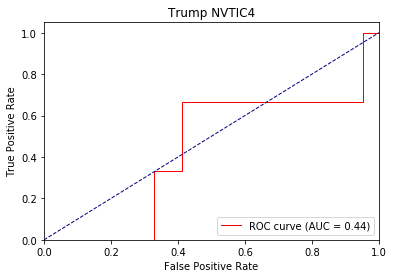

Directory already exists!
dt_interruptions 0 ap tensor([0.9315, 0.1515]) loss : 0.5592856407165527 0.6248319627023211 tid : 400 tg tensor([[0]], device='cuda:0')
dt_interruptions 0 ap tensor([0.9325, 0.1421]) loss : 1.0177510976791382 0.6018080789352132 tid : 200 tg tensor([[1]], device='cuda:0')
TEST dt_interruptions 0 ap tensor([1., 0.]) loss : 0.4068433344364166 0.37127693357138797 tid : 150 tg tensor([[0]], device='cuda:0')
TEST dt_interruptions 0 ap tensor([0.9742, 0.1009]) loss : 0.3573756814002991 0.41381840165271316 tid : 420 tg tensor([[0]], device='cuda:0')


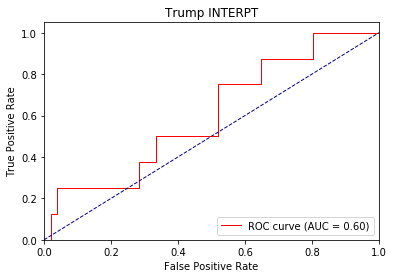

Directory already exists!
dt_interruptions 1 ap tensor([0.9602, 0.1799]) loss : 1.7250417470932007 0.3740581663546229 tid : 200 tg tensor([[1]], device='cuda:0')
dt_interruptions 1 ap tensor([0.9587, 0.1824]) loss : 0.2748398780822754 0.37302766602507903 tid : 400 tg tensor([[0]], device='cuda:0')
TEST dt_interruptions 1 ap tensor([1., 0.]) loss : 0.262798011302948 0.21767969275343008 tid : 150 tg tensor([[0]], device='cuda:0')
TEST dt_interruptions 1 ap tensor([0.9742, 0.1134]) loss : 0.21229147911071777 0.2929665979950927 tid : 420 tg tensor([[0]], device='cuda:0')


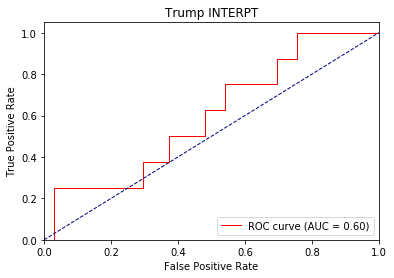

Directory already exists!
dt_interruptions 2 ap tensor([0.9668, 0.0572]) loss : 2.0079822540283203 0.28131436004682825 tid : 200 tg tensor([[1]], device='cuda:0')
dt_interruptions 2 ap tensor([0.9666, 0.0629]) loss : 0.2137967348098755 0.2841419179492922 tid : 400 tg tensor([[0]], device='cuda:0')
TEST dt_interruptions 2 ap tensor([1., 0.]) loss : 0.1816609501838684 0.14517321052222415 tid : 150 tg tensor([[0]], device='cuda:0')
TEST dt_interruptions 2 ap tensor([0.9736, 0.1006]) loss : 0.13343101739883423 0.23954383335834326 tid : 420 tg tensor([[0]], device='cuda:0')


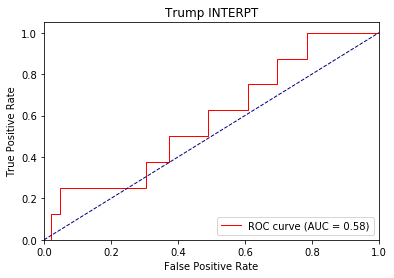

Directory already exists!
dt_lookat2 0 ap tensor([0.5000, 0.5000]) loss : 0.7709287405014038 0.7593710422515869 tid : 400 tg tensor([[0]], device='cuda:0')
dt_lookat2 0 ap tensor([0.7132, 0.8529]) loss : 0.6052612066268921 0.6239831517401494 tid : 200 tg tensor([[1]], device='cuda:0')
TEST dt_lookat2 0 ap tensor([0.9379, 0.9250]) loss : 0.787470281124115 0.6056383276979128 tid : 60 tg tensor([[0]], device='cuda:0')
TEST dt_lookat2 0 ap tensor([0.9122, 0.9500]) loss : 0.6756443381309509 0.5717800868594128 tid : 90 tg tensor([[1]], device='cuda:0')
TEST dt_lookat2 0 ap tensor([0.9032, 0.9619]) loss : 0.6597756743431091 0.5575726181268692 tid : 180 tg tensor([[1]], device='cuda:0')
TEST dt_lookat2 0 ap tensor([0.7953, 0.8638]) loss : 0.9885488748550415 0.6109419465065002 tid : 330 tg tensor([[0]], device='cuda:0')
TEST dt_lookat2 0 ap tensor([0.8345, 0.8110]) loss : 0.4885573983192444 0.6215533566745844 tid : 420 tg tensor([[0]], device='cuda:0')


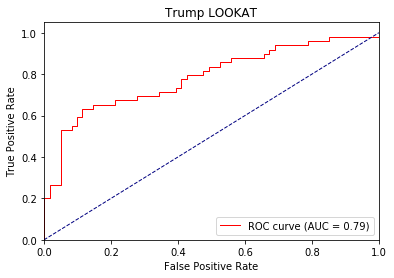

Directory already exists!
dt_lookat2 1 ap tensor([0.8732, 0.9470]) loss : 0.9500407576560974 0.5034992503814208 tid : 400 tg tensor([[0]], device='cuda:0')
dt_lookat2 1 ap tensor([0.8477, 0.9279]) loss : 0.5538372993469238 0.4866089384370255 tid : 200 tg tensor([[1]], device='cuda:0')
TEST dt_lookat2 1 ap tensor([0.9379, 0.9250]) loss : 0.8484822511672974 0.5538388391335806 tid : 60 tg tensor([[0]], device='cuda:0')
TEST dt_lookat2 1 ap tensor([0.8979, 0.9468]) loss : 0.6378928422927856 0.49401015043258667 tid : 90 tg tensor([[1]], device='cuda:0')
TEST dt_lookat2 1 ap tensor([0.8940, 0.9605]) loss : 0.6257166266441345 0.4713372816057766 tid : 180 tg tensor([[1]], device='cuda:0')
TEST dt_lookat2 1 ap tensor([0.8024, 0.8579]) loss : 1.3907727003097534 0.5596935739440303 tid : 330 tg tensor([[0]], device='cuda:0')
TEST dt_lookat2 1 ap tensor([0.8458, 0.8244]) loss : 0.36997538805007935 0.5776393515142527 tid : 420 tg tensor([[0]], device='cuda:0')


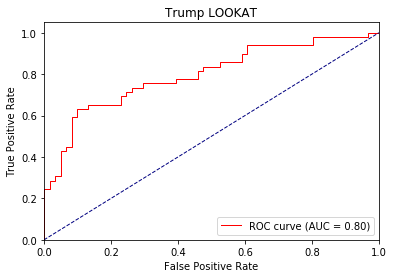

Directory already exists!
dt_lookat2 2 ap tensor([0.8851, 0.9584]) loss : 0.5374717712402344 0.4096718753055061 tid : 200 tg tensor([[1]], device='cuda:0')
dt_lookat2 2 ap tensor([0.8635, 0.9305]) loss : 1.074422001838684 0.4248266813599251 tid : 400 tg tensor([[0]], device='cuda:0')
TEST dt_lookat2 2 ap tensor([0.9094, 0.9111]) loss : 0.8552571535110474 0.5161191746592522 tid : 60 tg tensor([[0]], device='cuda:0')
TEST dt_lookat2 2 ap tensor([0.8881, 0.9429]) loss : 0.6287986040115356 0.4509535418904346 tid : 90 tg tensor([[1]], device='cuda:0')
TEST dt_lookat2 2 ap tensor([0.8842, 0.9615]) loss : 0.6192899346351624 0.4256116756621529 tid : 180 tg tensor([[1]], device='cuda:0')
TEST dt_lookat2 2 ap tensor([0.8064, 0.8593]) loss : 1.7345912456512451 0.5336926550634445 tid : 330 tg tensor([[0]], device='cuda:0')
TEST dt_lookat2 2 ap tensor([0.8492, 0.8286]) loss : 0.28665757179260254 0.5524297017942775 tid : 420 tg tensor([[0]], device='cuda:0')


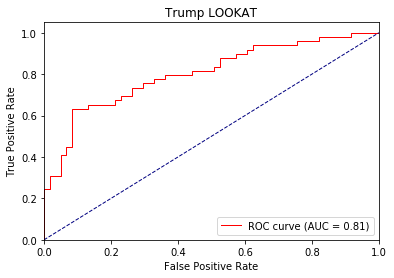

Directory already exists!
dt_brush1 0 ap tensor([0.9032, 0.0841]) loss : 0.514113187789917 0.6682833920395563 tid : 200 tg tensor([[0]], device='cuda:0')
dt_brush1 0 ap tensor([0.9104, 0.0864]) loss : 0.5859686136245728 0.6598267833296763 tid : 400 tg tensor([[0]], device='cuda:0')
TEST dt_brush1 0 ap tensor([1., 0.]) loss : 0.4327559471130371 0.40868060539166134 tid : 60 tg tensor([[0]], device='cuda:0')
TEST dt_brush1 0 ap tensor([1., 0.]) loss : 0.3785615563392639 0.38985135892163153 tid : 90 tg tensor([[0]], device='cuda:0')
TEST dt_brush1 0 ap tensor([0.9900, 0.3651]) loss : 0.5334988832473755 0.44271717965602875 tid : 180 tg tensor([[0]], device='cuda:0')
TEST dt_brush1 0 ap tensor([0.9898, 0.2151]) loss : 0.3565478026866913 0.4436623247400407 tid : 330 tg tensor([[0]], device='cuda:0')
TEST dt_brush1 0 ap tensor([0.9802, 0.1967]) loss : 0.471742182970047 0.4609490108083595 tid : 420 tg tensor([[0]], device='cuda:0')


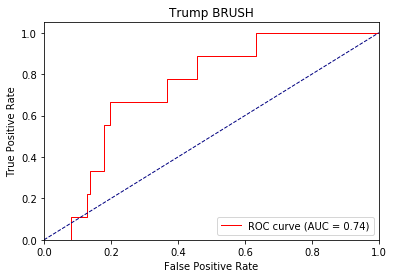

Directory already exists!
dt_brush1 1 ap tensor([0.9551, 0.2307]) loss : 0.16915464401245117 0.4006271871953523 tid : 200 tg tensor([[0]], device='cuda:0')
dt_brush1 1 ap tensor([0.9643, 0.2520]) loss : 0.30709895491600037 0.38105910772698537 tid : 400 tg tensor([[0]], device='cuda:0')
TEST dt_brush1 1 ap tensor([1., 0.]) loss : 0.28054672479629517 0.26205029090245563 tid : 60 tg tensor([[0]], device='cuda:0')
TEST dt_brush1 1 ap tensor([1., 0.]) loss : 0.23049873113632202 0.23897935255714084 tid : 90 tg tensor([[0]], device='cuda:0')
TEST dt_brush1 1 ap tensor([0.9898, 0.4028]) loss : 0.4109046459197998 0.32717538318213296 tid : 180 tg tensor([[0]], device='cuda:0')
TEST dt_brush1 1 ap tensor([0.9899, 0.2290]) loss : 0.2131914496421814 0.3177254815255442 tid : 330 tg tensor([[0]], device='cuda:0')
TEST dt_brush1 1 ap tensor([0.9808, 0.2027]) loss : 0.2451561689376831 0.34098113870078867 tid : 420 tg tensor([[0]], device='cuda:0')


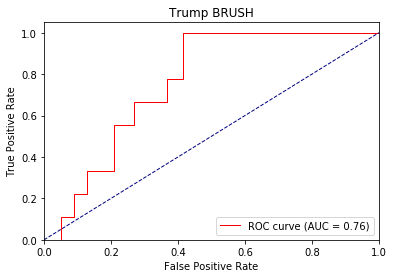

Directory already exists!
dt_brush1 2 ap tensor([0.9645, 0.1607]) loss : 0.23045200109481812 0.31876581886789646 tid : 400 tg tensor([[0]], device='cuda:0')
dt_brush1 2 ap tensor([0.9726, 0.2885]) loss : 0.07485771179199219 0.3058003755931807 tid : 200 tg tensor([[0]], device='cuda:0')
TEST dt_brush1 2 ap tensor([1., 0.]) loss : 0.2019069790840149 0.19389835000038147 tid : 60 tg tensor([[0]], device='cuda:0')
TEST dt_brush1 2 ap tensor([1., 0.]) loss : 0.15547585487365723 0.16966303794280344 tid : 90 tg tensor([[0]], device='cuda:0')
TEST dt_brush1 2 ap tensor([0.9898, 0.4028]) loss : 0.33135470747947693 0.2812659731682609 tid : 180 tg tensor([[0]], device='cuda:0')
TEST dt_brush1 2 ap tensor([0.9896, 0.2249]) loss : 0.15062880516052246 0.2634620825129171 tid : 330 tg tensor([[0]], device='cuda:0')
TEST dt_brush1 2 ap tensor([0.9793, 0.1945]) loss : 0.1354990005493164 0.290591608394276 tid : 420 tg tensor([[0]], device='cuda:0')


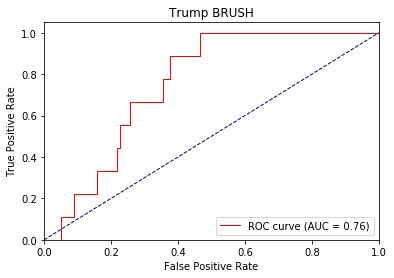

Directory already exists!
dt_nvdis1 0 ap tensor([0.2088, 0.6685]) loss : 0.3887110948562622 0.696747043303081 tid : 200 tg tensor([[1]], device='cuda:0')
dt_nvdis1 0 ap tensor([0.2115, 0.6691]) loss : 0.8374490141868591 0.6969028328040346 tid : 400 tg tensor([[0]], device='cuda:0')
TEST dt_nvdis1 0 ap tensor([0.4972, 0.7066]) loss : 0.9302792549133301 0.6718028262257576 tid : 60 tg tensor([[0]], device='cuda:0')
TEST dt_nvdis1 0 ap tensor([0.4354, 0.7529]) loss : 0.6437384486198425 0.6574126974396084 tid : 90 tg tensor([[1]], device='cuda:0')
TEST dt_nvdis1 0 ap tensor([0.3932, 0.8103]) loss : 0.6007717847824097 0.6360908764250138 tid : 180 tg tensor([[1]], device='cuda:0')
TEST dt_nvdis1 0 ap tensor([0.4661, 0.7756]) loss : 0.7700826525688171 0.646066744000681 tid : 330 tg tensor([[0]], device='cuda:0')
TEST dt_nvdis1 0 ap tensor([0.4294, 0.7091]) loss : 0.5472702980041504 0.6615491448478266 tid : 420 tg tensor([[1]], device='cuda:0')


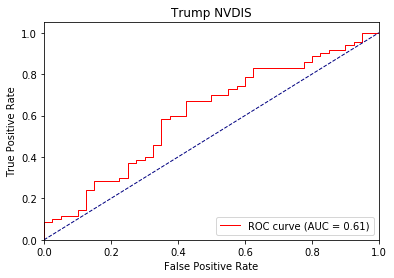

Directory already exists!
dt_nvdis1 1 ap tensor([0.5229, 0.9243]) loss : 0.26233887672424316 0.5495613212370155 tid : 200 tg tensor([[1]], device='cuda:0')
dt_nvdis1 1 ap tensor([0.5572, 0.9356]) loss : 0.8613249063491821 0.5367961572226426 tid : 400 tg tensor([[0]], device='cuda:0')
TEST dt_nvdis1 1 ap tensor([0.4435, 0.7508]) loss : 0.9929546117782593 0.6518562535444895 tid : 60 tg tensor([[0]], device='cuda:0')
TEST dt_nvdis1 1 ap tensor([0.4123, 0.8234]) loss : 0.5277426242828369 0.6037848073503246 tid : 90 tg tensor([[1]], device='cuda:0')
TEST dt_nvdis1 1 ap tensor([0.3492, 0.8579]) loss : 0.5715992450714111 0.5840307894875022 tid : 180 tg tensor([[1]], device='cuda:0')
TEST dt_nvdis1 1 ap tensor([0.5189, 0.8440]) loss : 0.67690110206604 0.5877375242210203 tid : 330 tg tensor([[0]], device='cuda:0')
TEST dt_nvdis1 1 ap tensor([0.4971, 0.8321]) loss : 0.2901678681373596 0.6038844598965212 tid : 420 tg tensor([[1]], device='cuda:0')


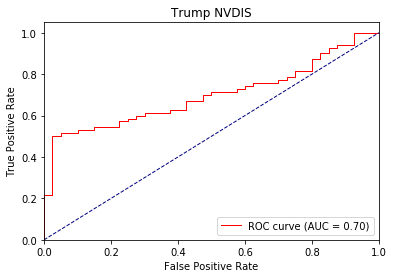

Directory already exists!
dt_nvdis1 2 ap tensor([0.5700, 0.9534]) loss : 0.8990077376365662 0.4706421728645052 tid : 400 tg tensor([[0]], device='cuda:0')
dt_nvdis1 2 ap tensor([0.6367, 0.9482]) loss : 0.16079556941986084 0.4533859846137819 tid : 200 tg tensor([[1]], device='cuda:0')
TEST dt_nvdis1 2 ap tensor([0.4411, 0.7565]) loss : 1.0442616939544678 0.6547659387191137 tid : 60 tg tensor([[0]], device='cuda:0')
TEST dt_nvdis1 2 ap tensor([0.4465, 0.8399]) loss : 0.4450404644012451 0.5846204550369926 tid : 90 tg tensor([[1]], device='cuda:0')
TEST dt_nvdis1 2 ap tensor([0.3519, 0.8681]) loss : 0.5483136177062988 0.5629361289388993 tid : 180 tg tensor([[1]], device='cuda:0')
TEST dt_nvdis1 2 ap tensor([0.5313, 0.8492]) loss : 0.5981279015541077 0.5637410509009515 tid : 330 tg tensor([[0]], device='cuda:0')
TEST dt_nvdis1 2 ap tensor([0.5164, 0.8414]) loss : 0.17035746574401855 0.5805078565397046 tid : 420 tg tensor([[1]], device='cuda:0')


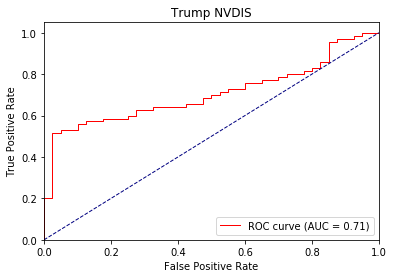

Directory already exists!
dt_lookat3 0 ap tensor([0.3326, 0.8737]) loss : 0.957935094833374 0.6847730632376882 tid : 400 tg tensor([[1]], device='cuda:0')
dt_lookat3 0 ap tensor([0.2895, 0.8641]) loss : 0.5720665454864502 0.6900276738962681 tid : 200 tg tensor([[1]], device='cuda:0')
TEST dt_lookat3 0 ap tensor([0.1250, 0.9255]) loss : 0.6259792447090149 0.5909699176748594 tid : 60 tg tensor([[1]], device='cuda:0')
TEST dt_lookat3 0 ap tensor([0.3271, 0.8820]) loss : 0.8467954397201538 0.5842417659966842 tid : 90 tg tensor([[0]], device='cuda:0')
TEST dt_lookat3 0 ap tensor([0.3517, 0.9064]) loss : 0.5527917742729187 0.5864518801955616 tid : 180 tg tensor([[1]], device='cuda:0')
TEST dt_lookat3 0 ap tensor([0.2907, 0.9541]) loss : 0.5132747888565063 0.5485873664579084 tid : 330 tg tensor([[1]], device='cuda:0')
TEST dt_lookat3 0 ap tensor([0.2560, 0.9478]) loss : 0.33974912762641907 0.5402588122947649 tid : 420 tg tensor([[1]], device='cuda:0')


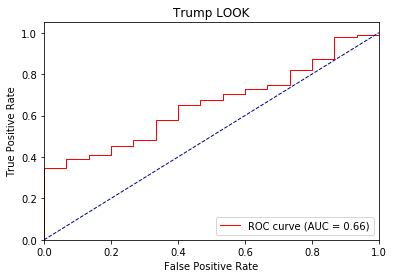

Directory already exists!
dt_lookat3 1 ap tensor([0.3012, 0.9061]) loss : 0.6492819786071777 0.5393005928822926 tid : 400 tg tensor([[1]], device='cuda:0')
dt_lookat3 1 ap tensor([0.3189, 0.8992]) loss : 0.30587881803512573 0.5376611246908312 tid : 200 tg tensor([[1]], device='cuda:0')
TEST dt_lookat3 1 ap tensor([0.1111, 0.9073]) loss : 0.4470805525779724 0.4860416054725647 tid : 60 tg tensor([[1]], device='cuda:0')
TEST dt_lookat3 1 ap tensor([0.5587, 0.8806]) loss : 1.1048017740249634 0.508973997572194 tid : 90 tg tensor([[0]], device='cuda:0')
TEST dt_lookat3 1 ap tensor([0.5337, 0.9091]) loss : 0.44340798258781433 0.5067200020832174 tid : 180 tg tensor([[1]], device='cuda:0')
TEST dt_lookat3 1 ap tensor([0.4609, 0.9501]) loss : 0.4322187602519989 0.45299790463139933 tid : 330 tg tensor([[1]], device='cuda:0')
TEST dt_lookat3 1 ap tensor([0.3785, 0.9439]) loss : 0.19063812494277954 0.44668063114989887 tid : 420 tg tensor([[1]], device='cuda:0')


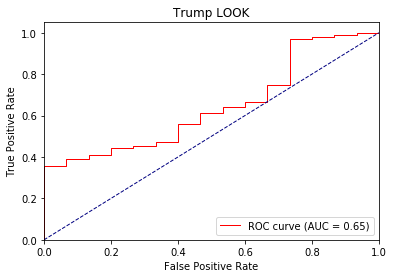

Directory already exists!
dt_lookat3 2 ap tensor([0.7314, 0.9802]) loss : 0.5291444063186646 0.3962536468738463 tid : 400 tg tensor([[1]], device='cuda:0')
dt_lookat3 2 ap tensor([0.7234, 0.9809]) loss : 0.19804441928863525 0.3910651236772537 tid : 200 tg tensor([[1]], device='cuda:0')
TEST dt_lookat3 2 ap tensor([0.1111, 0.9073]) loss : 0.32801809906959534 0.42948736995458603 tid : 60 tg tensor([[1]], device='cuda:0')
TEST dt_lookat3 2 ap tensor([0.5658, 0.8884]) loss : 1.3498172760009766 0.47519403566484864 tid : 90 tg tensor([[0]], device='cuda:0')
TEST dt_lookat3 2 ap tensor([0.5717, 0.9124]) loss : 0.36374446749687195 0.4661676226293339 tid : 180 tg tensor([[1]], device='cuda:0')
TEST dt_lookat3 2 ap tensor([0.4906, 0.9486]) loss : 0.38075125217437744 0.40088152645095704 tid : 330 tg tensor([[1]], device='cuda:0')
TEST dt_lookat3 2 ap tensor([0.3990, 0.9420]) loss : 0.1145927906036377 0.397404284639792 tid : 420 tg tensor([[1]], device='cuda:0')


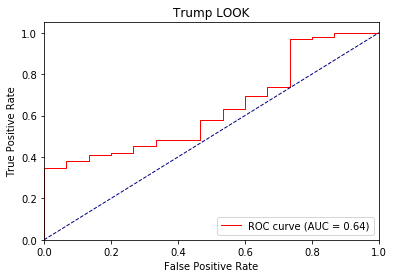

Directory already exists!
dt_eyebrow 0 ap tensor([0.0485, 0.8912]) loss : 0.5175034999847412 0.6265920119339161 tid : 400 tg tensor([[1]], device='cuda:0')
dt_eyebrow 0 ap tensor([0.0883, 0.8252]) loss : 1.0410465002059937 0.6276469159385433 tid : 200 tg tensor([[0]], device='cuda:0')
TEST dt_eyebrow 0 ap tensor([0.6176, 0.6668]) loss : 0.3027437925338745 0.6807682539025942 tid : 60 tg tensor([[1]], device='cuda:0')
TEST dt_eyebrow 0 ap tensor([0.5809, 0.6261]) loss : 0.36049866676330566 0.7578024164490078 tid : 90 tg tensor([[1]], device='cuda:0')
TEST dt_eyebrow 0 ap tensor([0.6054, 0.6045]) loss : 0.3993772864341736 0.8033019505879458 tid : 180 tg tensor([[1]], device='cuda:0')
TEST dt_eyebrow 0 ap tensor([0.6666, 0.6183]) loss : 1.2274514436721802 0.8156181838243238 tid : 330 tg tensor([[0]], device='cuda:0')
TEST dt_eyebrow 0 ap tensor([0.5956, 0.6348]) loss : 0.4320577383041382 0.7595389404080131 tid : 420 tg tensor([[1]], device='cuda:0')


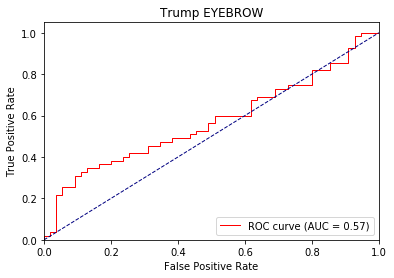

Directory already exists!
dt_eyebrow 1 ap tensor([0.0872, 0.8845]) loss : 1.5304114818572998 0.44988985714458285 tid : 200 tg tensor([[0]], device='cuda:0')
dt_eyebrow 1 ap tensor([0.1090, 0.9524]) loss : 0.27469107508659363 0.3794786867565161 tid : 400 tg tensor([[1]], device='cuda:0')
TEST dt_eyebrow 1 ap tensor([0.6252, 0.7382]) loss : 0.21202611923217773 0.7514443770051003 tid : 60 tg tensor([[1]], device='cuda:0')
TEST dt_eyebrow 1 ap tensor([0.6649, 0.7317]) loss : 0.243742436170578 0.8335920520450758 tid : 90 tg tensor([[1]], device='cuda:0')
TEST dt_eyebrow 1 ap tensor([0.7001, 0.7413]) loss : 0.3057743310928345 0.8913200260961757 tid : 180 tg tensor([[1]], device='cuda:0')
TEST dt_eyebrow 1 ap tensor([0.7694, 0.7783]) loss : 1.4295942783355713 0.9043227563942632 tid : 330 tg tensor([[0]], device='cuda:0')
TEST dt_eyebrow 1 ap tensor([0.6813, 0.7704]) loss : 0.24381905794143677 0.82916913384741 tid : 420 tg tensor([[1]], device='cuda:0')


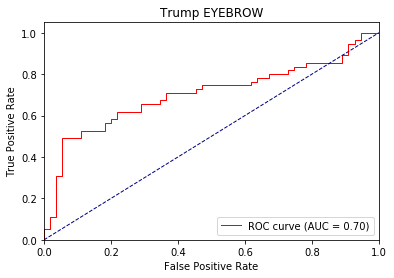

Directory already exists!
dt_eyebrow 2 ap tensor([0.1493, 0.9686]) loss : 0.2097976803779602 0.3168122038998956 tid : 400 tg tensor([[1]], device='cuda:0')
dt_eyebrow 2 ap tensor([0.1418, 0.9560]) loss : 2.415410041809082 0.3255894925008273 tid : 200 tg tensor([[0]], device='cuda:0')
TEST dt_eyebrow 2 ap tensor([0.6052, 0.7254]) loss : 0.16303271055221558 0.8269947071870168 tid : 60 tg tensor([[1]], device='cuda:0')
TEST dt_eyebrow 2 ap tensor([0.6789, 0.7496]) loss : 0.1801687479019165 0.905799899412238 tid : 90 tg tensor([[1]], device='cuda:0')
TEST dt_eyebrow 2 ap tensor([0.6980, 0.7533]) loss : 0.24767082929611206 0.9690545008463018 tid : 180 tg tensor([[1]], device='cuda:0')
TEST dt_eyebrow 2 ap tensor([0.7690, 0.8147]) loss : 1.5340147018432617 0.983230296161867 tid : 330 tg tensor([[0]], device='cuda:0')
TEST dt_eyebrow 2 ap tensor([0.6915, 0.8143]) loss : 0.14636224508285522 0.8975942588665269 tid : 420 tg tensor([[1]], device='cuda:0')


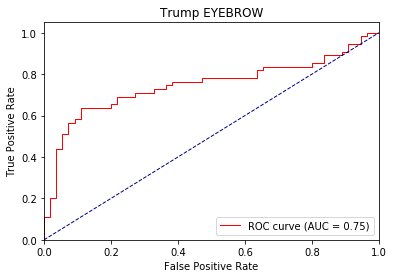

Directory already exists!
dt_atface 0 ap tensor([0.7825, 0.9094]) loss : 0.5091348886489868 0.5902037455743512 tid : 200 tg tensor([[1]], device='cuda:0')
dt_atface 0 ap tensor([0.7747, 0.9133]) loss : 0.5683385133743286 0.5862089491542711 tid : 400 tg tensor([[0]], device='cuda:0')
TEST dt_atface 0 ap tensor([0.4035, 0.7247]) loss : 0.7454595565795898 0.7105367730061213 tid : 60 tg tensor([[0]], device='cuda:0')
TEST dt_atface 0 ap tensor([0.5797, 0.8588]) loss : 0.6223317384719849 0.617143698360609 tid : 90 tg tensor([[1]], device='cuda:0')
TEST dt_atface 0 ap tensor([0.5465, 0.8436]) loss : 0.7315099835395813 0.6178861514610403 tid : 180 tg tensor([[1]], device='cuda:0')
TEST dt_atface 0 ap tensor([0.5879, 0.8604]) loss : 0.5778867602348328 0.5966230409760629 tid : 330 tg tensor([[0]], device='cuda:0')
TEST dt_atface 0 ap tensor([0.6111, 0.8443]) loss : 0.31954532861709595 0.6054598841477524 tid : 420 tg tensor([[1]], device='cuda:0')


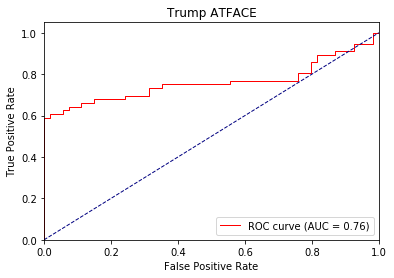

Directory already exists!
dt_atface 1 ap tensor([0.7800, 0.9103]) loss : 0.5474271774291992 0.4956738152066056 tid : 400 tg tensor([[0]], device='cuda:0')
dt_atface 1 ap tensor([0.7787, 0.9293]) loss : 0.4131009578704834 0.4922446507600046 tid : 200 tg tensor([[1]], device='cuda:0')
TEST dt_atface 1 ap tensor([0.4035, 0.7247]) loss : 0.681308925151825 0.7138132055600485 tid : 60 tg tensor([[0]], device='cuda:0')
TEST dt_atface 1 ap tensor([0.5797, 0.8588]) loss : 0.6150481700897217 0.6000310156656348 tid : 90 tg tensor([[1]], device='cuda:0')
TEST dt_atface 1 ap tensor([0.5333, 0.8432]) loss : 0.791875958442688 0.6066150489975425 tid : 180 tg tensor([[1]], device='cuda:0')
TEST dt_atface 1 ap tensor([0.5788, 0.8595]) loss : 0.503819465637207 0.5666187391165765 tid : 330 tg tensor([[0]], device='cuda:0')
TEST dt_atface 1 ap tensor([0.6077, 0.8443]) loss : 0.20594555139541626 0.5759275572543795 tid : 420 tg tensor([[1]], device='cuda:0')


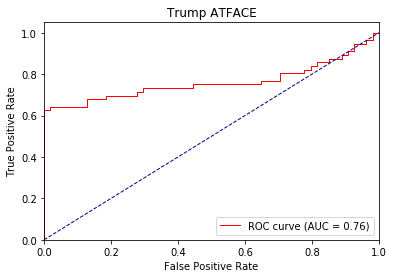

Directory already exists!
dt_atface 2 ap tensor([0.8531, 0.9367]) loss : 0.23706549406051636 0.41403182591710774 tid : 200 tg tensor([[1]], device='cuda:0')
dt_atface 2 ap tensor([0.8537, 0.9351]) loss : 0.38733774423599243 0.4163762152522475 tid : 400 tg tensor([[0]], device='cuda:0')
TEST dt_atface 2 ap tensor([0.4035, 0.7247]) loss : 0.6276294589042664 0.7213540002703667 tid : 60 tg tensor([[0]], device='cuda:0')
TEST dt_atface 2 ap tensor([0.5765, 0.8591]) loss : 0.6113827228546143 0.5943856887195421 tid : 90 tg tensor([[1]], device='cuda:0')
TEST dt_atface 2 ap tensor([0.5313, 0.8434]) loss : 0.8443379402160645 0.6055726636858547 tid : 180 tg tensor([[1]], device='cuda:0')
TEST dt_atface 2 ap tensor([0.5751, 0.8584]) loss : 0.4594738483428955 0.551918143706937 tid : 330 tg tensor([[0]], device='cuda:0')
TEST dt_atface 2 ap tensor([0.6056, 0.8435]) loss : 0.1443650722503662 0.5614887983961538 tid : 420 tg tensor([[1]], device='cuda:0')


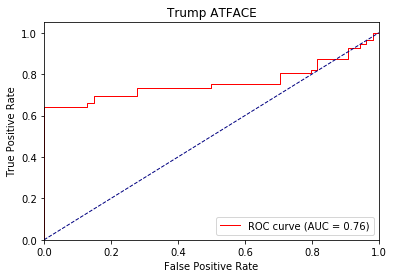

Directory already exists!
dt_feface 0 ap tensor([1., 0.]) loss : 0.409467875957489 0.5206927331834058 tid : 400 tg tensor([[0]], device='cuda:0')
dt_feface 0 ap tensor([1., 0.]) loss : 0.31062066555023193 0.45348151462773484 tid : 200 tg tensor([[0]], device='cuda:0')
TEST dt_feface 0 ap tensor([1., 0.]) loss : 0.23072999715805054 0.255109337468942 tid : 60 tg tensor([[0]], device='cuda:0')
TEST dt_feface 0 ap tensor([1., 0.]) loss : 0.25140172243118286 0.24742173759833627 tid : 90 tg tensor([[0]], device='cuda:0')
TEST dt_feface 0 ap tensor([1., 0.]) loss : 0.32791078090667725 0.25556178829249215 tid : 180 tg tensor([[0]], device='cuda:0')
TEST dt_feface 0 ap tensor([1., 0.]) loss : 0.27526694536209106 0.2731616487426142 tid : 330 tg tensor([[0]], device='cuda:0')
TEST dt_feface 0 ap tensor([1., 0.]) loss : 0.28894346952438354 0.2763958183879202 tid : 420 tg tensor([[0]], device='cuda:0')


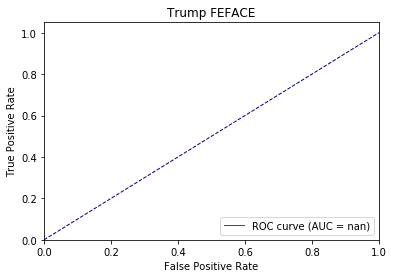

Directory already exists!
dt_feface 1 ap tensor([1., 0.]) loss : 0.10672652721405029 0.1816065652421647 tid : 400 tg tensor([[0]], device='cuda:0')
dt_feface 1 ap tensor([1., 0.]) loss : 0.07504034042358398 0.1709808934517581 tid : 200 tg tensor([[0]], device='cuda:0')
TEST dt_feface 1 ap tensor([1., 0.]) loss : 0.10032773017883301 0.11655387779076894 tid : 60 tg tensor([[0]], device='cuda:0')
TEST dt_feface 1 ap tensor([1., 0.]) loss : 0.10749280452728271 0.10644273135973059 tid : 90 tg tensor([[0]], device='cuda:0')
TEST dt_feface 1 ap tensor([1., 0.]) loss : 0.1911022663116455 0.11242079033571131 tid : 180 tg tensor([[0]], device='cuda:0')
TEST dt_feface 1 ap tensor([1., 0.]) loss : 0.10597753524780273 0.12922392016456974 tid : 330 tg tensor([[0]], device='cuda:0')
TEST dt_feface 1 ap tensor([1., 0.]) loss : 0.13656824827194214 0.1299064616588029 tid : 420 tg tensor([[0]], device='cuda:0')


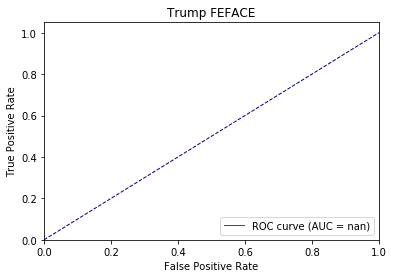

Directory already exists!
dt_feface 2 ap tensor([1., 0.]) loss : 0.06359672546386719 0.12962099596073753 tid : 200 tg tensor([[0]], device='cuda:0')
dt_feface 2 ap tensor([1., 0.]) loss : 0.07194554805755615 0.11328097241265433 tid : 400 tg tensor([[0]], device='cuda:0')
TEST dt_feface 2 ap tensor([1., 0.]) loss : 0.04424166679382324 0.05676409602165222 tid : 60 tg tensor([[0]], device='cuda:0')
TEST dt_feface 2 ap tensor([1., 0.]) loss : 0.047292470932006836 0.0495445210000743 tid : 90 tg tensor([[0]], device='cuda:0')
TEST dt_feface 2 ap tensor([1., 0.]) loss : 0.11249619722366333 0.05344149295021506 tid : 180 tg tensor([[0]], device='cuda:0')
TEST dt_feface 2 ap tensor([1., 0.]) loss : 0.04537177085876465 0.06669680245461003 tid : 330 tg tensor([[0]], device='cuda:0')
TEST dt_feface 2 ap tensor([1., 0.]) loss : 0.06394219398498535 0.06534985520622948 tid : 420 tg tensor([[0]], device='cuda:0')


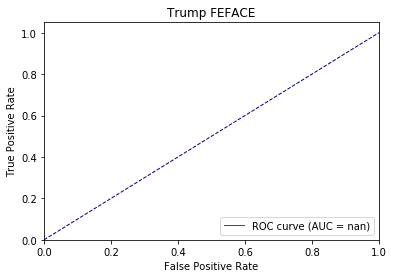

Directory already exists!
dt_hrface 0 ap tensor([0.9544, 0.2681]) loss : 0.401908278465271 0.6218648487940813 tid : 200 tg tensor([[0]], device='cuda:0')
dt_hrface 0 ap tensor([0.9394, 0.2436]) loss : 0.48169365525245667 0.5946408089027044 tid : 400 tg tensor([[0]], device='cuda:0')
TEST dt_hrface 0 ap tensor([1., 0.]) loss : 0.37122222781181335 0.39882996926705044 tid : 60 tg tensor([[0]], device='cuda:0')
TEST dt_hrface 0 ap tensor([1., 0.]) loss : 0.4061650037765503 0.3894290185492972 tid : 90 tg tensor([[0]], device='cuda:0')
TEST dt_hrface 0 ap tensor([1., 1.]) loss : 0.5148248672485352 0.40069346831125374 tid : 180 tg tensor([[0]], device='cuda:0')
TEST dt_hrface 0 ap tensor([0.9991, 0.8333]) loss : 0.3614307641983032 0.4195178242460374 tid : 330 tg tensor([[0]], device='cuda:0')
TEST dt_hrface 0 ap tensor([0.9909, 0.5491]) loss : 0.42686232924461365 0.4358136064626954 tid : 420 tg tensor([[0]], device='cuda:0')


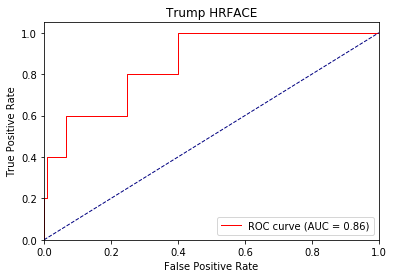

Directory already exists!
dt_hrface 1 ap tensor([0.9479, 0.2920]) loss : 0.22614634037017822 0.39219245889100685 tid : 200 tg tensor([[0]], device='cuda:0')
dt_hrface 1 ap tensor([0.9699, 0.3387]) loss : 0.29351937770843506 0.37857203850245685 tid : 400 tg tensor([[0]], device='cuda:0')
TEST dt_hrface 1 ap tensor([1., 0.]) loss : 0.22819256782531738 0.24892938882112503 tid : 60 tg tensor([[0]], device='cuda:0')
TEST dt_hrface 1 ap tensor([1., 0.]) loss : 0.2467924952507019 0.23409053424130316 tid : 90 tg tensor([[0]], device='cuda:0')
TEST dt_hrface 1 ap tensor([1., 1.]) loss : 0.38129493594169617 0.2558778454275692 tid : 180 tg tensor([[0]], device='cuda:0')
TEST dt_hrface 1 ap tensor([1., 1.]) loss : 0.22645318508148193 0.2784189702041687 tid : 330 tg tensor([[0]], device='cuda:0')
TEST dt_hrface 1 ap tensor([0.9924, 0.6707]) loss : 0.2245369553565979 0.3000942428003658 tid : 420 tg tensor([[0]], device='cuda:0')


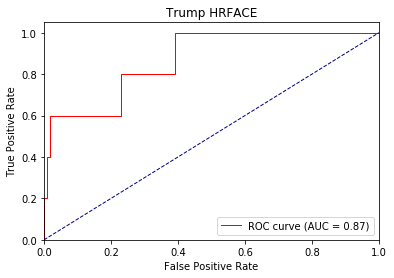

Directory already exists!
dt_hrface 2 ap tensor([0.9765, 0.4572]) loss : 0.2222498059272766 0.31088583819844107 tid : 400 tg tensor([[0]], device='cuda:0')
dt_hrface 2 ap tensor([0.9682, 0.4179]) loss : 0.06504380702972412 0.29267566008422213 tid : 200 tg tensor([[0]], device='cuda:0')
TEST dt_hrface 2 ap tensor([1., 0.]) loss : 0.15748882293701172 0.17780076464017233 tid : 60 tg tensor([[0]], device='cuda:0')
TEST dt_hrface 2 ap tensor([1., 0.]) loss : 0.1653916835784912 0.16263045953667682 tid : 90 tg tensor([[0]], device='cuda:0')
TEST dt_hrface 2 ap tensor([1., 1.]) loss : 0.2934134006500244 0.18929385087069342 tid : 180 tg tensor([[0]], device='cuda:0')
TEST dt_hrface 2 ap tensor([1., 1.]) loss : 0.16907048225402832 0.2121508563718488 tid : 330 tg tensor([[0]], device='cuda:0')
TEST dt_hrface 2 ap tensor([0.9919, 0.6659]) loss : 0.1364506483078003 0.23748967999761755 tid : 420 tg tensor([[0]], device='cuda:0')


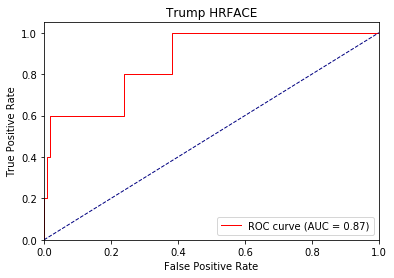

Directory already exists!
dt_saface 0 ap tensor([1., 0.]) loss : 0.5577707886695862 0.6381185971341043 tid : 400 tg tensor([[0]], device='cuda:0')
dt_saface 0 ap tensor([1., 0.]) loss : 0.3788922131061554 0.5422801883864742 tid : 200 tg tensor([[0]], device='cuda:0')
TEST dt_saface 0 ap tensor([1., 0.]) loss : 0.303190141916275 0.31797364602486294 tid : 60 tg tensor([[0]], device='cuda:0')
TEST dt_saface 0 ap tensor([1., 0.]) loss : 0.2577466070652008 0.285500617130943 tid : 90 tg tensor([[0]], device='cuda:0')
TEST dt_saface 0 ap tensor([1., 0.]) loss : 0.3606471121311188 0.28866222588454976 tid : 180 tg tensor([[0]], device='cuda:0')
TEST dt_saface 0 ap tensor([1., 0.]) loss : 0.2357640266418457 0.3126512371724652 tid : 330 tg tensor([[0]], device='cuda:0')
TEST dt_saface 0 ap tensor([1., 0.]) loss : 0.27991023659706116 0.31294805251739244 tid : 420 tg tensor([[0]], device='cuda:0')


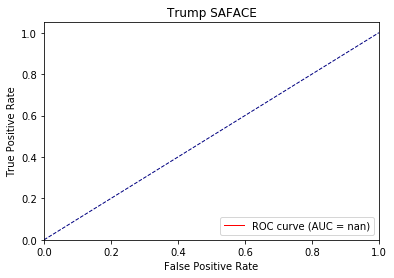

Directory already exists!
dt_saface 1 ap tensor([1., 0.]) loss : 0.19764947891235352 0.2905184779225326 tid : 200 tg tensor([[0]], device='cuda:0')
dt_saface 1 ap tensor([1., 0.]) loss : 0.17807453870773315 0.2500994168478867 tid : 400 tg tensor([[0]], device='cuda:0')
TEST dt_saface 1 ap tensor([1., 0.]) loss : 0.12098991870880127 0.1544415478905042 tid : 60 tg tensor([[0]], device='cuda:0')
TEST dt_saface 1 ap tensor([1., 0.]) loss : 0.10670214891433716 0.12886377909909125 tid : 90 tg tensor([[0]], device='cuda:0')
TEST dt_saface 1 ap tensor([1., 0.]) loss : 0.20902401208877563 0.1313602600027533 tid : 180 tg tensor([[0]], device='cuda:0')
TEST dt_saface 1 ap tensor([1., 0.]) loss : 0.09154701232910156 0.15371866043536894 tid : 330 tg tensor([[0]], device='cuda:0')
TEST dt_saface 1 ap tensor([1., 0.]) loss : 0.13899821043014526 0.153950515457175 tid : 420 tg tensor([[0]], device='cuda:0')


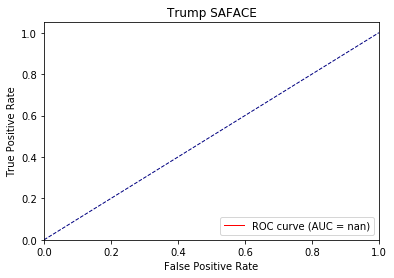

Directory already exists!
dt_saface 2 ap tensor([1., 0.]) loss : 0.06988167762756348 0.09907629489898681 tid : 200 tg tensor([[0]], device='cuda:0')
dt_saface 2 ap tensor([1., 0.]) loss : 0.03766047954559326 0.0944141662415163 tid : 400 tg tensor([[0]], device='cuda:0')
TEST dt_saface 2 ap tensor([1., 0.]) loss : 0.0506443977355957 0.07921162247657776 tid : 60 tg tensor([[0]], device='cuda:0')
TEST dt_saface 2 ap tensor([1., 0.]) loss : 0.04627633094787598 0.06220671404962954 tid : 90 tg tensor([[0]], device='cuda:0')
TEST dt_saface 2 ap tensor([1., 0.]) loss : 0.1200215220451355 0.06351911846329183 tid : 180 tg tensor([[0]], device='cuda:0')
TEST dt_saface 2 ap tensor([1., 0.]) loss : 0.03800499439239502 0.08144063670789042 tid : 330 tg tensor([[0]], device='cuda:0')
TEST dt_saface 2 ap tensor([1., 0.]) loss : 0.07137167453765869 0.08022909374399619 tid : 420 tg tensor([[0]], device='cuda:0')


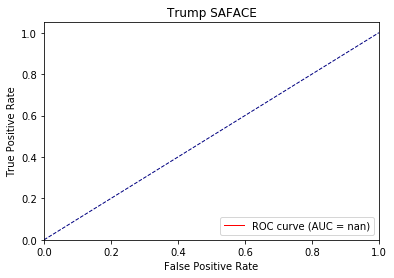

Directory already exists!
dt_neuface 0 ap tensor([0.8865, 0.4998]) loss : 0.48006606101989746 0.6195744979419893 tid : 200 tg tensor([[0]], device='cuda:0')
dt_neuface 0 ap tensor([0.8900, 0.5278]) loss : 0.6417288184165955 0.6086461110409244 tid : 400 tg tensor([[1]], device='cuda:0')
TEST dt_neuface 0 ap tensor([0.9594, 0.8542]) loss : 0.7868671417236328 0.5756729915738106 tid : 60 tg tensor([[1]], device='cuda:0')
TEST dt_neuface 0 ap tensor([0.9627, 0.8513]) loss : 0.5795990824699402 0.5681342119755952 tid : 90 tg tensor([[0]], device='cuda:0')
TEST dt_neuface 0 ap tensor([0.9061, 0.7081]) loss : 0.6420487761497498 0.5898991980973411 tid : 180 tg tensor([[0]], device='cuda:0')
TEST dt_neuface 0 ap tensor([0.8887, 0.6775]) loss : 0.8763945698738098 0.5936613659704885 tid : 330 tg tensor([[1]], device='cuda:0')
TEST dt_neuface 0 ap tensor([0.8841, 0.7100]) loss : 0.3172581195831299 0.5900975723158229 tid : 420 tg tensor([[0]], device='cuda:0')


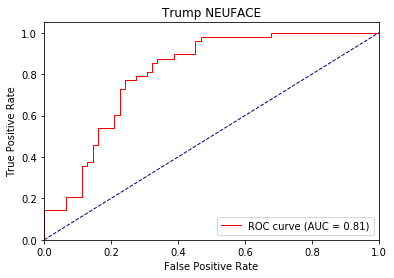

Directory already exists!
dt_neuface 1 ap tensor([0.9297, 0.5378]) loss : 0.6754717230796814 0.5148428128911303 tid : 400 tg tensor([[1]], device='cuda:0')
dt_neuface 1 ap tensor([0.9065, 0.6086]) loss : 0.3054739236831665 0.5238965221790857 tid : 200 tg tensor([[0]], device='cuda:0')
TEST dt_neuface 1 ap tensor([0.9415, 0.8304]) loss : 0.8464688062667847 0.5502762595812479 tid : 60 tg tensor([[1]], device='cuda:0')
TEST dt_neuface 1 ap tensor([0.9465, 0.8105]) loss : 0.4974091351032257 0.5273355880509252 tid : 90 tg tensor([[0]], device='cuda:0')
TEST dt_neuface 1 ap tensor([0.9113, 0.7116]) loss : 0.6116733551025391 0.550573303419001 tid : 180 tg tensor([[0]], device='cuda:0')
TEST dt_neuface 1 ap tensor([0.8863, 0.6727]) loss : 0.8962218761444092 0.5499729619872186 tid : 330 tg tensor([[1]], device='cuda:0')
TEST dt_neuface 1 ap tensor([0.8856, 0.6902]) loss : 0.20019209384918213 0.5588701699267734 tid : 420 tg tensor([[0]], device='cuda:0')


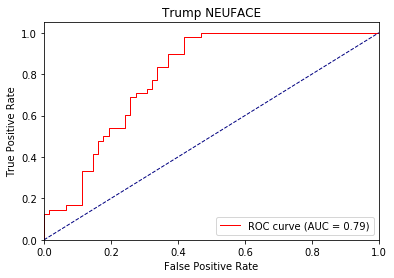

Directory already exists!
dt_neuface 2 ap tensor([0.8883, 0.6284]) loss : 0.6870492100715637 0.5021635895475335 tid : 400 tg tensor([[1]], device='cuda:0')
dt_neuface 2 ap tensor([0.9400, 0.6691]) loss : 0.20014816522598267 0.45181692501699383 tid : 200 tg tensor([[0]], device='cuda:0')
TEST dt_neuface 2 ap tensor([0.9203, 0.7095]) loss : 0.86909419298172 0.5458855380614599 tid : 60 tg tensor([[1]], device='cuda:0')
TEST dt_neuface 2 ap tensor([0.9280, 0.6846]) loss : 0.4561488926410675 0.5100809543029122 tid : 90 tg tensor([[0]], device='cuda:0')
TEST dt_neuface 2 ap tensor([0.9102, 0.6265]) loss : 0.6066087484359741 0.533127520014258 tid : 180 tg tensor([[0]], device='cuda:0')
TEST dt_neuface 2 ap tensor([0.8858, 0.6484]) loss : 0.8921200037002563 0.5276266908453356 tid : 330 tg tensor([[1]], device='cuda:0')
TEST dt_neuface 2 ap tensor([0.8789, 0.6578]) loss : 0.13809716701507568 0.5443442104892298 tid : 420 tg tensor([[0]], device='cuda:0')


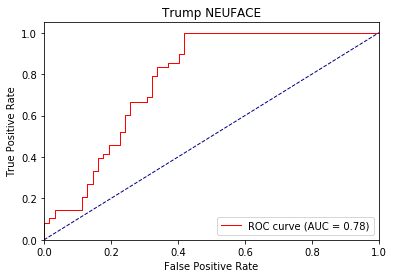

Directory already exists!
dt_inapprop 0 ap tensor([0.9681, 0.0593]) loss : 0.3502015173435211 0.5433354659980496 tid : 200 tg tensor([[0]], device='cuda:0')
dt_inapprop 0 ap tensor([0.9730, 0.0591]) loss : 0.4091968536376953 0.534571279552663 tid : 400 tg tensor([[0]], device='cuda:0')
TEST dt_inapprop 0 ap tensor([1., 0.]) loss : 0.3089790344238281 0.3397250746687253 tid : 60 tg tensor([[0]], device='cuda:0')
TEST dt_inapprop 0 ap tensor([0.9538, 0.0625]) loss : 0.29112446308135986 0.3686881790990415 tid : 90 tg tensor([[0]], device='cuda:0')
TEST dt_inapprop 0 ap tensor([0.9526, 0.4289]) loss : 0.7963783740997314 0.39939549740623026 tid : 180 tg tensor([[1]], device='cuda:0')
TEST dt_inapprop 0 ap tensor([0.9702, 0.3813]) loss : 0.3508009612560272 0.3824679668872587 tid : 330 tg tensor([[0]], device='cuda:0')
TEST dt_inapprop 0 ap tensor([0.9766, 0.3656]) loss : 0.29452845454216003 0.3763991783965718 tid : 420 tg tensor([[0]], device='cuda:0')


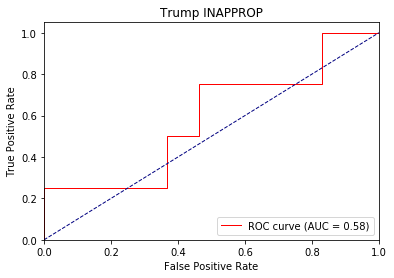

Directory already exists!
dt_inapprop 1 ap tensor([0.9654, 0.1794]) loss : 0.30475348234176636 0.3652400576843406 tid : 400 tg tensor([[0]], device='cuda:0')
dt_inapprop 1 ap tensor([0.9701, 0.0674]) loss : 0.13211297988891602 0.30263087325702515 tid : 200 tg tensor([[0]], device='cuda:0')
TEST dt_inapprop 1 ap tensor([1., 0.]) loss : 0.14351880550384521 0.18051100770632425 tid : 60 tg tensor([[0]], device='cuda:0')
TEST dt_inapprop 1 ap tensor([0.9588, 0.0667]) loss : 0.15102839469909668 0.2498818998751433 tid : 90 tg tensor([[0]], device='cuda:0')
TEST dt_inapprop 1 ap tensor([0.9528, 0.4226]) loss : 1.123647689819336 0.303464453886537 tid : 180 tg tensor([[1]], device='cuda:0')
TEST dt_inapprop 1 ap tensor([0.9679, 0.1554]) loss : 0.18332695960998535 0.2618761581759299 tid : 330 tg tensor([[0]], device='cuda:0')
TEST dt_inapprop 1 ap tensor([0.9748, 0.1415]) loss : 0.1657121777534485 0.24382903596216982 tid : 420 tg tensor([[0]], device='cuda:0')


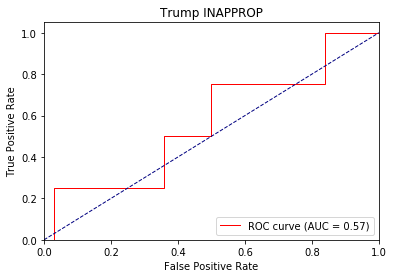

Directory already exists!
dt_inapprop 2 ap tensor([0.9918, 0.0798]) loss : 0.12248122692108154 0.20796221065091658 tid : 400 tg tensor([[0]], device='cuda:0')
dt_inapprop 2 ap tensor([0.9792, 0.1137]) loss : 0.07705628871917725 0.23446170564442245 tid : 200 tg tensor([[0]], device='cuda:0')
TEST dt_inapprop 2 ap tensor([1., 0.]) loss : 0.0780109167098999 0.10706620415051778 tid : 60 tg tensor([[0]], device='cuda:0')
TEST dt_inapprop 2 ap tensor([0.9538, 0.0625]) loss : 0.08675670623779297 0.2100366535394088 tid : 90 tg tensor([[0]], device='cuda:0')
TEST dt_inapprop 2 ap tensor([0.9538, 0.4339]) loss : 1.4658968448638916 0.2789280668777578 tid : 180 tg tensor([[1]], device='cuda:0')
TEST dt_inapprop 2 ap tensor([0.9668, 0.1323]) loss : 0.1164928674697876 0.21488472819328308 tid : 330 tg tensor([[0]], device='cuda:0')
TEST dt_inapprop 2 ap tensor([0.9729, 0.1173]) loss : 0.10199469327926636 0.187655893239108 tid : 420 tg tensor([[0]], device='cuda:0')


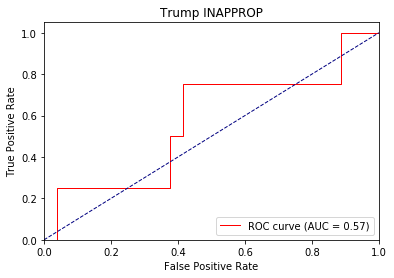

Directory already exists!
dt_affgest 0 ap tensor([0.9332, 0.0398]) loss : 0.6364982724189758 0.5841484593138808 tid : 400 tg tensor([[0]], device='cuda:0')
dt_affgest 0 ap tensor([0.9640, 0.0362]) loss : 0.28465303778648376 0.5152168171773167 tid : 200 tg tensor([[0]], device='cuda:0')
TEST dt_affgest 0 ap tensor([1., 0.]) loss : 0.3932642936706543 0.3709769124786059 tid : 60 tg tensor([[0]], device='cuda:0')
TEST dt_affgest 0 ap tensor([1., 0.]) loss : 0.32765528559684753 0.3492961720280025 tid : 90 tg tensor([[0]], device='cuda:0')
TEST dt_affgest 0 ap tensor([1., 0.]) loss : 0.42753058671951294 0.34663065829697776 tid : 180 tg tensor([[0]], device='cuda:0')
TEST dt_affgest 0 ap tensor([1., 0.]) loss : 0.2621077001094818 0.3667374565716713 tid : 330 tg tensor([[0]], device='cuda:0')
TEST dt_affgest 0 ap tensor([1., 0.]) loss : 0.4100629687309265 0.37018788809126074 tid : 420 tg tensor([[0]], device='cuda:0')


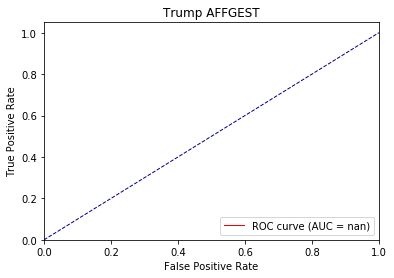

Directory already exists!
dt_affgest 1 ap tensor([0.9760, 0.0661]) loss : 0.17026180028915405 0.3196221697067029 tid : 200 tg tensor([[0]], device='cuda:0')
dt_affgest 1 ap tensor([0.9777, 0.0612]) loss : 0.311133474111557 0.3149539979604574 tid : 400 tg tensor([[0]], device='cuda:0')
TEST dt_affgest 1 ap tensor([1., 0.]) loss : 0.2055920958518982 0.2058155486981074 tid : 60 tg tensor([[0]], device='cuda:0')
TEST dt_affgest 1 ap tensor([1., 0.]) loss : 0.177961528301239 0.1909219855847566 tid : 90 tg tensor([[0]], device='cuda:0')
TEST dt_affgest 1 ap tensor([1., 0.]) loss : 0.2737748920917511 0.19286471342339234 tid : 180 tg tensor([[0]], device='cuda:0')
TEST dt_affgest 1 ap tensor([1., 0.]) loss : 0.12151581048965454 0.21158027456652734 tid : 330 tg tensor([[0]], device='cuda:0')
TEST dt_affgest 1 ap tensor([1., 0.]) loss : 0.25269782543182373 0.21438769488172096 tid : 420 tg tensor([[0]], device='cuda:0')


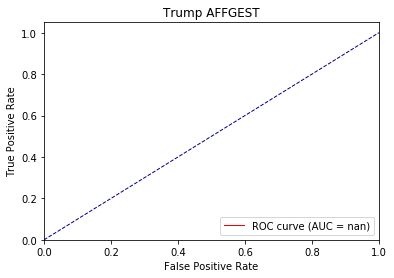

Directory already exists!
dt_affgest 2 ap tensor([0.9553, 0.0730]) loss : 0.19084328413009644 0.27324802259152586 tid : 400 tg tensor([[0]], device='cuda:0')
dt_affgest 2 ap tensor([0.9775, 0.0634]) loss : 0.08092063665390015 0.23279513300083912 tid : 200 tg tensor([[0]], device='cuda:0')
TEST dt_affgest 2 ap tensor([1., 0.]) loss : 0.11602652072906494 0.12479951977729797 tid : 60 tg tensor([[0]], device='cuda:0')
TEST dt_affgest 2 ap tensor([1., 0.]) loss : 0.1060187816619873 0.11689910940502 tid : 90 tg tensor([[0]], device='cuda:0')
TEST dt_affgest 2 ap tensor([1., 0.]) loss : 0.17953932285308838 0.11989967086735893 tid : 180 tg tensor([[0]], device='cuda:0')
TEST dt_affgest 2 ap tensor([1., 0.]) loss : 0.06355440616607666 0.13537608519677194 tid : 330 tg tensor([[0]], device='cuda:0')
TEST dt_affgest 2 ap tensor([1., 0.]) loss : 0.17454463243484497 0.1370743370868943 tid : 420 tg tensor([[0]], device='cuda:0')


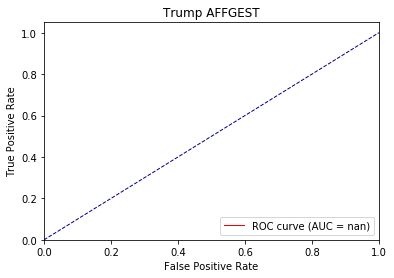

Directory already exists!
dt_defgest 0 ap tensor([0.8858, 0.4808]) loss : 0.7090255618095398 0.628431942866329 tid : 200 tg tensor([[1]], device='cuda:0')
dt_defgest 0 ap tensor([0.8908, 0.4767]) loss : 0.5804551839828491 0.6245461846516881 tid : 400 tg tensor([[0]], device='cuda:0')
TEST dt_defgest 0 ap tensor([0.9406, 0.1429]) loss : 0.8552627563476562 0.5743367075920105 tid : 60 tg tensor([[1]], device='cuda:0')
TEST dt_defgest 0 ap tensor([0.9646, 0.4658]) loss : 0.6842001676559448 0.5619100889433986 tid : 90 tg tensor([[0]], device='cuda:0')
TEST dt_defgest 0 ap tensor([0.9694, 0.5758]) loss : 0.717267632484436 0.5491034940761679 tid : 180 tg tensor([[1]], device='cuda:0')
TEST dt_defgest 0 ap tensor([0.9510, 0.5740]) loss : 0.3438817858695984 0.5828975607310573 tid : 330 tg tensor([[0]], device='cuda:0')
TEST dt_defgest 0 ap tensor([0.9248, 0.6260]) loss : 0.5098589658737183 0.6004924577745524 tid : 420 tg tensor([[1]], device='cuda:0')


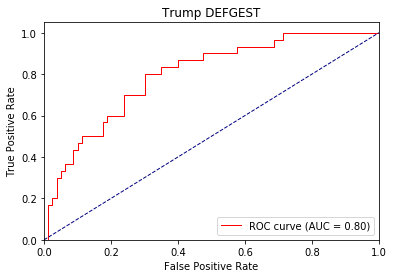

Directory already exists!
dt_defgest 1 ap tensor([0.9040, 0.6498]) loss : 0.45905911922454834 0.5673475282372169 tid : 400 tg tensor([[0]], device='cuda:0')
dt_defgest 1 ap tensor([0.9056, 0.6144]) loss : 0.8119620084762573 0.534943083354405 tid : 200 tg tensor([[1]], device='cuda:0')
TEST dt_defgest 1 ap tensor([0.9255, 0.1250]) loss : 1.0680878162384033 0.49453429877758026 tid : 60 tg tensor([[1]], device='cuda:0')
TEST dt_defgest 1 ap tensor([0.9592, 0.7333]) loss : 0.5699334144592285 0.4731025851291159 tid : 90 tg tensor([[0]], device='cuda:0')
TEST dt_defgest 1 ap tensor([0.9674, 0.7174]) loss : 0.8644864559173584 0.46322837559615865 tid : 180 tg tensor([[1]], device='cuda:0')
TEST dt_defgest 1 ap tensor([0.9579, 0.7114]) loss : 0.22843575477600098 0.5055791581830671 tid : 330 tg tensor([[0]], device='cuda:0')
TEST dt_defgest 1 ap tensor([0.9287, 0.7187]) loss : 0.48622575402259827 0.5342898599126122 tid : 420 tg tensor([[1]], device='cuda:0')


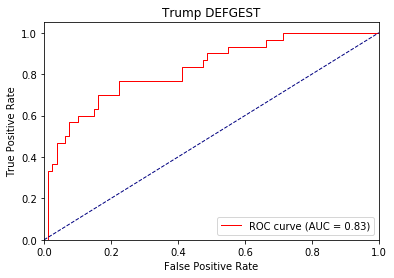

Directory already exists!
dt_defgest 2 ap tensor([0.9146, 0.7810]) loss : 0.82278972864151 0.5058635476976633 tid : 200 tg tensor([[1]], device='cuda:0')
dt_defgest 2 ap tensor([0.8978, 0.6516]) loss : 0.29566308856010437 0.5043473015938487 tid : 400 tg tensor([[0]], device='cuda:0')
TEST dt_defgest 2 ap tensor([0.9255, 0.1250]) loss : 1.2582284212112427 0.4479030321041743 tid : 60 tg tensor([[1]], device='cuda:0')
TEST dt_defgest 2 ap tensor([0.9592, 0.7333]) loss : 0.4886520504951477 0.42019510917041614 tid : 90 tg tensor([[0]], device='cuda:0')
TEST dt_defgest 2 ap tensor([0.9646, 0.7504]) loss : 1.0038249492645264 0.4136150952647714 tid : 180 tg tensor([[1]], device='cuda:0')
TEST dt_defgest 2 ap tensor([0.9579, 0.7452]) loss : 0.1661602258682251 0.4589939521205041 tid : 330 tg tensor([[0]], device='cuda:0')
TEST dt_defgest 2 ap tensor([0.9258, 0.7107]) loss : 0.47212278842926025 0.49570516327565367 tid : 420 tg tensor([[1]], device='cuda:0')


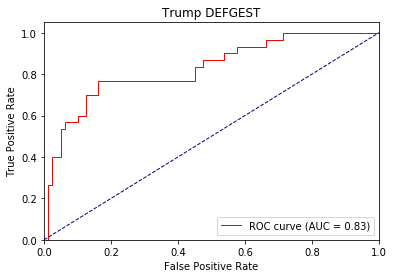

Directory already exists!
dt_agentic 0 ap tensor([0.8608, 0.8792]) loss : 0.5052893161773682 0.5963762657982963 tid : 200 tg tensor([[1]], device='cuda:0')
dt_agentic 0 ap tensor([0.8736, 0.8945]) loss : 0.695629358291626 0.5913317282410229 tid : 400 tg tensor([[0]], device='cuda:0')
TEST dt_agentic 0 ap tensor([0.9283, 0.7917]) loss : 0.8098875284194946 0.6277904411156973 tid : 60 tg tensor([[0]], device='cuda:0')
TEST dt_agentic 0 ap tensor([0.9549, 0.9196]) loss : 0.9925684332847595 0.5862882085468458 tid : 90 tg tensor([[0]], device='cuda:0')
TEST dt_agentic 0 ap tensor([0.9246, 0.8865]) loss : 0.5437145233154297 0.5696291967349894 tid : 180 tg tensor([[1]], device='cuda:0')
TEST dt_agentic 0 ap tensor([0.9411, 0.9153]) loss : 0.6326755285263062 0.5825013648117742 tid : 330 tg tensor([[0]], device='cuda:0')
TEST dt_agentic 0 ap tensor([0.9317, 0.9118]) loss : 0.22659063339233398 0.5924490219490095 tid : 420 tg tensor([[1]], device='cuda:0')


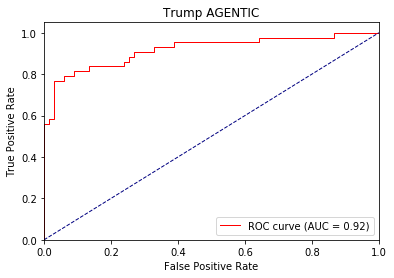

Directory already exists!
dt_agentic 1 ap tensor([0.8157, 0.9305]) loss : 0.607460081577301 0.4643833302804248 tid : 400 tg tensor([[0]], device='cuda:0')
dt_agentic 1 ap tensor([0.8304, 0.9481]) loss : 0.2499036192893982 0.4414353126081927 tid : 200 tg tensor([[1]], device='cuda:0')
TEST dt_agentic 1 ap tensor([0.9283, 0.7917]) loss : 0.7673113346099854 0.6135079512993494 tid : 60 tg tensor([[0]], device='cuda:0')
TEST dt_agentic 1 ap tensor([0.9618, 0.9238]) loss : 1.0239763259887695 0.5479894008325494 tid : 90 tg tensor([[0]], device='cuda:0')
TEST dt_agentic 1 ap tensor([0.9208, 0.8779]) loss : 0.5830933451652527 0.5309008517686058 tid : 180 tg tensor([[1]], device='cuda:0')
TEST dt_agentic 1 ap tensor([0.9364, 0.9199]) loss : 0.5552186965942383 0.5407321313696523 tid : 330 tg tensor([[0]], device='cuda:0')
TEST dt_agentic 1 ap tensor([0.9222, 0.9077]) loss : 0.1276344656944275 0.5606686110523614 tid : 420 tg tensor([[1]], device='cuda:0')


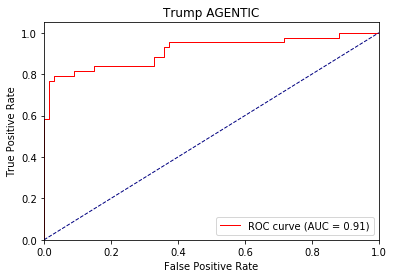

Directory already exists!
dt_agentic 2 ap tensor([0.8056, 0.9471]) loss : 0.5598541498184204 0.40277099146017337 tid : 400 tg tensor([[0]], device='cuda:0')
dt_agentic 2 ap tensor([0.8429, 0.9569]) loss : 0.13452959060668945 0.3793450882452419 tid : 200 tg tensor([[1]], device='cuda:0')
TEST dt_agentic 2 ap tensor([0.9283, 0.7917]) loss : 0.7187250852584839 0.6083079998691877 tid : 60 tg tensor([[0]], device='cuda:0')
TEST dt_agentic 2 ap tensor([0.9618, 0.9238]) loss : 1.0263001918792725 0.5225309768448705 tid : 90 tg tensor([[0]], device='cuda:0')
TEST dt_agentic 2 ap tensor([0.9151, 0.8766]) loss : 0.6328031420707703 0.5061155540101668 tid : 180 tg tensor([[1]], device='cuda:0')
TEST dt_agentic 2 ap tensor([0.9346, 0.9251]) loss : 0.4889388084411621 0.5117329623430006 tid : 330 tg tensor([[0]], device='cuda:0')
TEST dt_agentic 2 ap tensor([0.9166, 0.9058]) loss : 0.08179152011871338 0.5396493006158959 tid : 420 tg tensor([[1]], device='cuda:0')


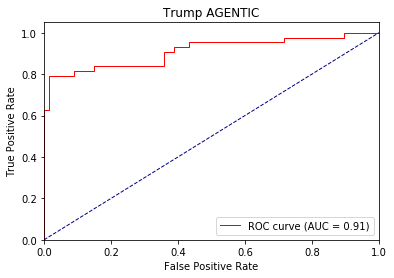

Directory already exists!
dt_waveoff 0 ap tensor([1., 0.]) loss : 0.5223616361618042 0.6885057340521331 tid : 200 tg tensor([[0]], device='cuda:0')
dt_waveoff 0 ap tensor([1., 0.]) loss : 0.499290406703949 0.6310863026948733 tid : 400 tg tensor([[0]], device='cuda:0')
TEST dt_waveoff 0 ap tensor([1., 0.]) loss : 0.4170070290565491 0.4234211916724841 tid : 60 tg tensor([[0]], device='cuda:0')
TEST dt_waveoff 0 ap tensor([0.9006, 0.1546]) loss : 0.49927565455436707 0.5096536576747894 tid : 90 tg tensor([[0]], device='cuda:0')
TEST dt_waveoff 0 ap tensor([0.9103, 0.1315]) loss : 0.4852069914340973 0.4999779646887499 tid : 180 tg tensor([[0]], device='cuda:0')
TEST dt_waveoff 0 ap tensor([0.9227, 0.0749]) loss : 0.43996575474739075 0.49787609615633566 tid : 330 tg tensor([[0]], device='cuda:0')
TEST dt_waveoff 0 ap tensor([0.9435, 0.0528]) loss : 0.4381332993507385 0.4824387942525474 tid : 420 tg tensor([[0]], device='cuda:0')


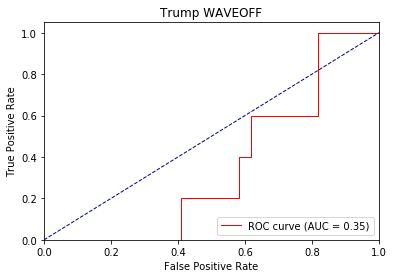

Directory already exists!
dt_waveoff 1 ap tensor([1., 0.]) loss : 0.35252875089645386 0.3633471538241093 tid : 400 tg tensor([[0]], device='cuda:0')
dt_waveoff 1 ap tensor([1., 0.]) loss : 0.1206439733505249 0.27218603592321094 tid : 200 tg tensor([[0]], device='cuda:0')
TEST dt_waveoff 1 ap tensor([1., 0.]) loss : 0.17358183860778809 0.19356999546289444 tid : 60 tg tensor([[0]], device='cuda:0')
TEST dt_waveoff 1 ap tensor([0.9067, 0.1620]) loss : 0.24646425247192383 0.4026099560053452 tid : 90 tg tensor([[0]], device='cuda:0')
TEST dt_waveoff 1 ap tensor([0.9198, 0.1484]) loss : 0.27142536640167236 0.378767266869545 tid : 180 tg tensor([[0]], device='cuda:0')
TEST dt_waveoff 1 ap tensor([0.9215, 0.0762]) loss : 0.20841938257217407 0.3472273128647958 tid : 330 tg tensor([[0]], device='cuda:0')
TEST dt_waveoff 1 ap tensor([0.9398, 0.0521]) loss : 0.21172106266021729 0.31150371818379924 tid : 420 tg tensor([[0]], device='cuda:0')


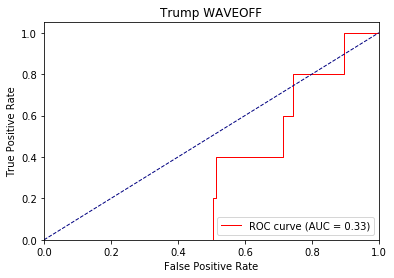

Directory already exists!
dt_waveoff 2 ap tensor([1., 0.]) loss : 0.09595227241516113 0.16919347398421344 tid : 200 tg tensor([[0]], device='cuda:0')
dt_waveoff 2 ap tensor([1., 0.]) loss : 0.09038490056991577 0.15000055458745346 tid : 400 tg tensor([[0]], device='cuda:0')
TEST dt_waveoff 2 ap tensor([1., 0.]) loss : 0.0686500072479248 0.08676700294017792 tid : 60 tg tensor([[0]], device='cuda:0')
TEST dt_waveoff 2 ap tensor([0.9134, 0.2056]) loss : 0.11500179767608643 0.40883331972619763 tid : 90 tg tensor([[0]], device='cuda:0')
TEST dt_waveoff 2 ap tensor([0.9318, 0.1995]) loss : 0.1420532464981079 0.36678990897010355 tid : 180 tg tensor([[0]], device='cuda:0')
TEST dt_waveoff 2 ap tensor([0.9260, 0.0855]) loss : 0.09589529037475586 0.30339325483768215 tid : 330 tg tensor([[0]], device='cuda:0')
TEST dt_waveoff 2 ap tensor([0.9406, 0.0569]) loss : 0.09382855892181396 0.24661040475422685 tid : 420 tg tensor([[0]], device='cuda:0')


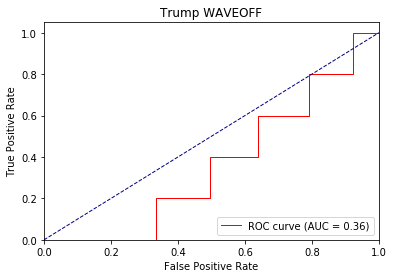

Directory already exists!
dt_nvtic1 0 ap tensor([0.7867, 0.1254]) loss : 0.499320924282074 0.6110267868129219 tid : 200 tg tensor([[0]], device='cuda:0')
dt_nvtic1 0 ap tensor([0.8143, 0.1285]) loss : 0.39793282747268677 0.5993653787069084 tid : 400 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic1 0 ap tensor([0.8470, 0.2000]) loss : 0.2669038474559784 0.49361488471428555 tid : 60 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic1 0 ap tensor([0.8512, 0.2026]) loss : 0.2866635024547577 0.4933572463367296 tid : 90 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic1 0 ap tensor([0.8649, 0.3281]) loss : 0.38630402088165283 0.46565806076807137 tid : 180 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic1 0 ap tensor([0.9252, 0.3041]) loss : 0.3633023500442505 0.43540963530540466 tid : 330 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic1 0 ap tensor([0.8919, 0.1861]) loss : 0.271475613117218 0.44191899353807623 tid : 420 tg tensor([[0]], device='cuda:0')


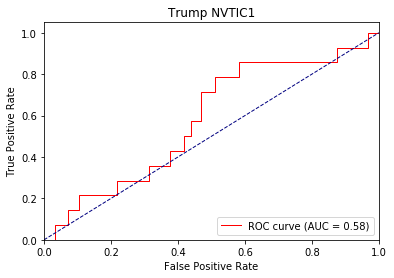

Directory already exists!
dt_nvtic1 1 ap tensor([0.9800, 0.2805]) loss : 0.28050583600997925 0.3803536640159015 tid : 400 tg tensor([[0]], device='cuda:0')
dt_nvtic1 1 ap tensor([0.9347, 0.2860]) loss : 0.19572800397872925 0.4374744837531949 tid : 200 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic1 1 ap tensor([0.8567, 0.2250]) loss : 0.2105819582939148 0.49347152809302014 tid : 60 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic1 1 ap tensor([0.8820, 0.2640]) loss : 0.21131497621536255 0.47073095907335694 tid : 90 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic1 1 ap tensor([0.8946, 0.3629]) loss : 0.3366152346134186 0.4271353500730851 tid : 180 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic1 1 ap tensor([0.9386, 0.3594]) loss : 0.2858191728591919 0.3873982121867518 tid : 330 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic1 1 ap tensor([0.9145, 0.2693]) loss : 0.1640613079071045 0.3943061791360378 tid : 420 tg tensor([[0]], device='cuda:0')


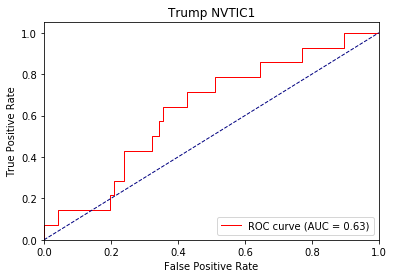

Directory already exists!
dt_nvtic1 2 ap tensor([0.9743, 0.4454]) loss : 0.24654614925384521 0.3614934275789959 tid : 400 tg tensor([[0]], device='cuda:0')
dt_nvtic1 2 ap tensor([0.9545, 0.2476]) loss : 0.1244581937789917 0.4013674795627594 tid : 200 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic1 2 ap tensor([0.8567, 0.2250]) loss : 0.18007278442382812 0.5073461929957072 tid : 60 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic1 2 ap tensor([0.8794, 0.2521]) loss : 0.16835159063339233 0.4675717042840045 tid : 90 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic1 2 ap tensor([0.8955, 0.3696]) loss : 0.30823659896850586 0.41231177133672375 tid : 180 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic1 2 ap tensor([0.9431, 0.4016]) loss : 0.2374248504638672 0.36538396679585977 tid : 330 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic1 2 ap tensor([0.9226, 0.3007]) loss : 0.10443317890167236 0.373184148222208 tid : 420 tg tensor([[0]], device='cuda:0')


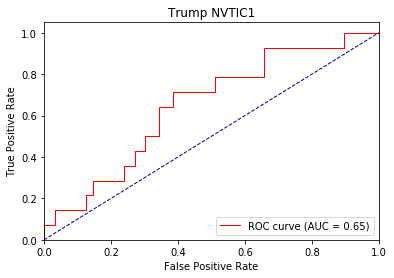

Directory already exists!
dt_nvtic2 0 ap tensor([0.8980, 0.1648]) loss : 0.5487608313560486 0.6890439980656561 tid : 200 tg tensor([[0]], device='cuda:0')
dt_nvtic2 0 ap tensor([0.9194, 0.1572]) loss : 0.5810065269470215 0.639094000155071 tid : 400 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic2 0 ap tensor([0.3508, 0.3508]) loss : 0.528240978717804 0.82328083862861 tid : 60 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic2 0 ap tensor([0.5295, 0.2589]) loss : 0.9522013664245605 0.6906385499498119 tid : 90 tg tensor([[1]], device='cuda:0')
TEST dt_nvtic2 0 ap tensor([0.5804, 0.2472]) loss : 0.6253365874290466 0.6724313050508499 tid : 180 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic2 0 ap tensor([0.7040, 0.2537]) loss : 0.857317328453064 0.6300172772138349 tid : 330 tg tensor([[1]], device='cuda:0')
TEST dt_nvtic2 0 ap tensor([0.7845, 0.1966]) loss : 0.6070099472999573 0.5937564467841928 tid : 420 tg tensor([[0]], device='cuda:0')


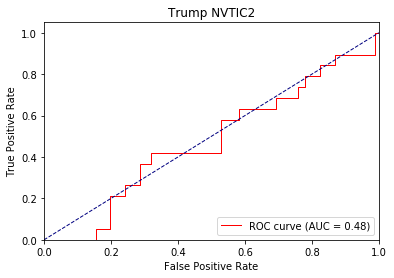

Directory already exists!
dt_nvtic2 1 ap tensor([0.9954, 0.2214]) loss : 0.2541837692260742 0.3961325073745889 tid : 200 tg tensor([[0]], device='cuda:0')
dt_nvtic2 1 ap tensor([0.9709, 0.2944]) loss : 0.43347060680389404 0.4174685011608432 tid : 400 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic2 1 ap tensor([0.3988, 0.3988]) loss : 0.3661637604236603 0.9368487124641737 tid : 60 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic2 1 ap tensor([0.5794, 0.3031]) loss : 1.2946207523345947 0.7158845572367959 tid : 90 tg tensor([[1]], device='cuda:0')
TEST dt_nvtic2 1 ap tensor([0.6244, 0.2784]) loss : 0.4700508117675781 0.6772429005188101 tid : 180 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic2 1 ap tensor([0.7511, 0.3708]) loss : 1.088591456413269 0.5902380669309247 tid : 330 tg tensor([[1]], device='cuda:0')
TEST dt_nvtic2 1 ap tensor([0.8173, 0.2753]) loss : 0.3672141134738922 0.5225551687180996 tid : 420 tg tensor([[0]], device='cuda:0')


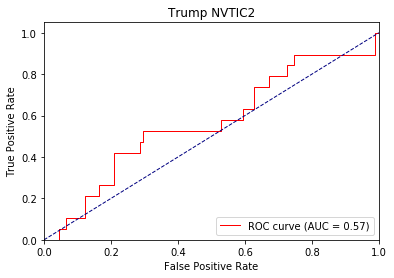

Directory already exists!
dt_nvtic2 2 ap tensor([0.9406, 0.4043]) loss : 0.3280467987060547 0.47600717609748244 tid : 400 tg tensor([[0]], device='cuda:0')
dt_nvtic2 2 ap tensor([0.9296, 0.3118]) loss : 0.134177565574646 0.42987996868207945 tid : 200 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic2 2 ap tensor([0.3988, 0.3988]) loss : 0.2760215997695923 1.044810858865579 tid : 60 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic2 2 ap tensor([0.6009, 0.3108]) loss : 1.5763812065124512 0.7630030642385068 tid : 90 tg tensor([[1]], device='cuda:0')
TEST dt_nvtic2 2 ap tensor([0.6456, 0.2905]) loss : 0.37187010049819946 0.7085568449076485 tid : 180 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic2 2 ap tensor([0.7687, 0.4185]) loss : 1.258767008781433 0.5900619582783792 tid : 330 tg tensor([[1]], device='cuda:0')
TEST dt_nvtic2 2 ap tensor([0.8285, 0.3560]) loss : 0.23862791061401367 0.49953875521367247 tid : 420 tg tensor([[0]], device='cuda:0')


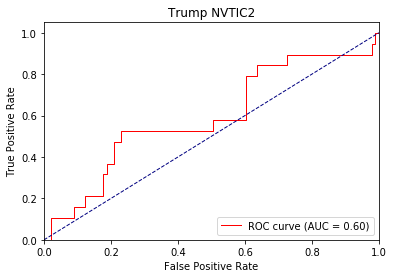

Directory already exists!
dt_nvtic3 0 ap tensor([0.4504, 0.5926]) loss : 0.8973962068557739 0.7383452080763303 tid : 200 tg tensor([[1]], device='cuda:0')
dt_nvtic3 0 ap tensor([0.6110, 0.7184]) loss : 0.5499767661094666 0.6674706293066053 tid : 400 tg tensor([[1]], device='cuda:0')
TEST dt_nvtic3 0 ap tensor([0.1964, 0.8694]) loss : 0.6962158679962158 0.7241138989726702 tid : 60 tg tensor([[1]], device='cuda:0')
TEST dt_nvtic3 0 ap tensor([0.3733, 0.8315]) loss : 0.8239963054656982 0.7089459727639738 tid : 90 tg tensor([[1]], device='cuda:0')
TEST dt_nvtic3 0 ap tensor([0.4896, 0.8755]) loss : 0.7377803921699524 0.6670627427451751 tid : 180 tg tensor([[1]], device='cuda:0')
TEST dt_nvtic3 0 ap tensor([0.4988, 0.7416]) loss : 0.7869976758956909 0.6787353105122044 tid : 330 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic3 0 ap tensor([0.4942, 0.6946]) loss : 0.501483678817749 0.6844074600799517 tid : 420 tg tensor([[0]], device='cuda:0')


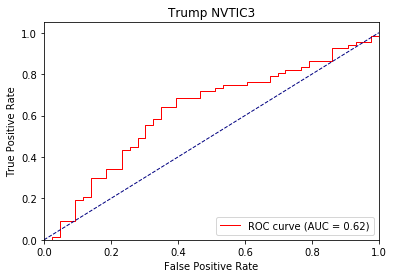

Directory already exists!
dt_nvtic3 1 ap tensor([0.6895, 0.8481]) loss : 0.8784493803977966 0.5784400720661933 tid : 200 tg tensor([[1]], device='cuda:0')
dt_nvtic3 1 ap tensor([0.6929, 0.8548]) loss : 0.394248902797699 0.568703323958525 tid : 400 tg tensor([[1]], device='cuda:0')
TEST dt_nvtic3 1 ap tensor([0.1964, 0.8694]) loss : 0.6138436198234558 0.6904175157348315 tid : 60 tg tensor([[1]], device='cuda:0')
TEST dt_nvtic3 1 ap tensor([0.2984, 0.8549]) loss : 0.7451754212379456 0.674052331758582 tid : 90 tg tensor([[1]], device='cuda:0')
TEST dt_nvtic3 1 ap tensor([0.4761, 0.9062]) loss : 0.6895195245742798 0.6102594110895606 tid : 180 tg tensor([[1]], device='cuda:0')
TEST dt_nvtic3 1 ap tensor([0.4767, 0.7834]) loss : 1.0631754398345947 0.6395303501236823 tid : 330 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic3 1 ap tensor([0.5144, 0.7398]) loss : 0.42092499136924744 0.6566468511115421 tid : 420 tg tensor([[0]], device='cuda:0')


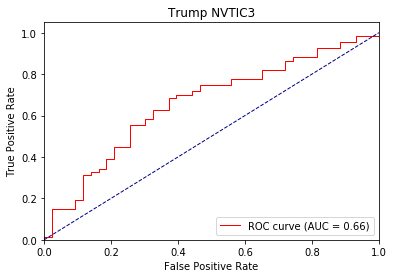

Directory already exists!
dt_nvtic3 2 ap tensor([0.7802, 0.8450]) loss : 0.9648985266685486 0.5259727244265378 tid : 200 tg tensor([[1]], device='cuda:0')
dt_nvtic3 2 ap tensor([0.7784, 0.8361]) loss : 0.34279167652130127 0.5330192597394579 tid : 400 tg tensor([[1]], device='cuda:0')
TEST dt_nvtic3 2 ap tensor([0.1964, 0.8694]) loss : 0.5703997611999512 0.6859851156671842 tid : 60 tg tensor([[1]], device='cuda:0')
TEST dt_nvtic3 2 ap tensor([0.3089, 0.8520]) loss : 0.6963143348693848 0.6701438776824785 tid : 90 tg tensor([[1]], device='cuda:0')
TEST dt_nvtic3 2 ap tensor([0.4047, 0.9051]) loss : 0.6578087210655212 0.5909810872638926 tid : 180 tg tensor([[1]], device='cuda:0')
TEST dt_nvtic3 2 ap tensor([0.4430, 0.7890]) loss : 1.2573069334030151 0.6255871956386874 tid : 330 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic3 2 ap tensor([0.5329, 0.7496]) loss : 0.3658532202243805 0.6476314301517877 tid : 420 tg tensor([[0]], device='cuda:0')


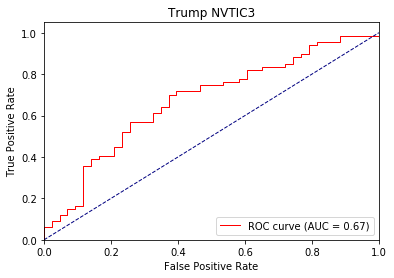

Directory already exists!
dt_nvtic5 0 ap tensor([0.9721, 0.2410]) loss : 0.5811675786972046 0.6663032863696996 tid : 400 tg tensor([[0]], device='cuda:0')
dt_nvtic5 0 ap tensor([0.9757, 0.1394]) loss : 0.5409276485443115 0.6639958289610285 tid : 200 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic5 0 ap tensor([1., 0.]) loss : 0.4051528871059418 0.34943515807390213 tid : 60 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic5 0 ap tensor([1., 0.]) loss : 0.31083443760871887 0.3548694330713023 tid : 90 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic5 0 ap tensor([0.9920, 0.1111]) loss : 0.3783261477947235 0.3841648469952976 tid : 180 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic5 0 ap tensor([0.9952, 0.0588]) loss : 0.338718980550766 0.38572998969785627 tid : 330 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic5 0 ap tensor([0.9967, 0.0435]) loss : 0.3837129473686218 0.37736022201451386 tid : 420 tg tensor([[0]], device='cuda:0')


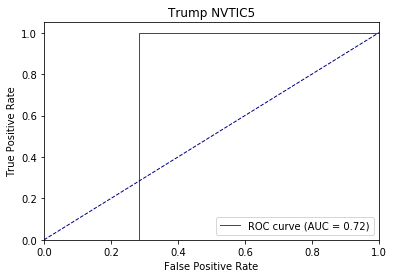

Directory already exists!
dt_nvtic5 1 ap tensor([1., 0.]) loss : 0.3030579686164856 0.34859342873096466 tid : 200 tg tensor([[0]], device='cuda:0')
dt_nvtic5 1 ap tensor([0.9778, 0.0367]) loss : 0.20455116033554077 0.32494299220588974 tid : 400 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic5 1 ap tensor([1., 0.]) loss : 0.1967288851737976 0.17908993860085806 tid : 60 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic5 1 ap tensor([1., 0.]) loss : 0.15429693460464478 0.17710660203643466 tid : 90 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic5 1 ap tensor([0.9931, 0.1250]) loss : 0.23275434970855713 0.2275969228323768 tid : 180 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic5 1 ap tensor([0.9952, 0.0588]) loss : 0.15846973657608032 0.22318855552904068 tid : 330 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic5 1 ap tensor([0.9969, 0.0455]) loss : 0.19689345359802246 0.21412899480624634 tid : 420 tg tensor([[0]], device='cuda:0')


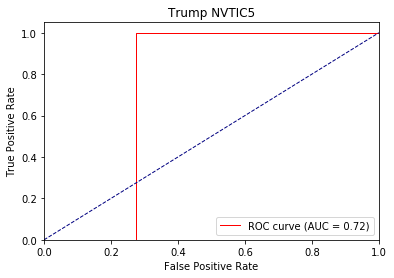

Directory already exists!
dt_nvtic5 2 ap tensor([0.9859, 0.0420]) loss : 0.11209702491760254 0.2124467737534467 tid : 200 tg tensor([[0]], device='cuda:0')
dt_nvtic5 2 ap tensor([0.9894, 0.0689]) loss : 0.07504570484161377 0.19282439488854142 tid : 400 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic5 2 ap tensor([1., 0.]) loss : 0.10146224498748779 0.10092150171597798 tid : 60 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic5 2 ap tensor([1., 0.]) loss : 0.08261734247207642 0.09828334787617558 tid : 90 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic5 2 ap tensor([0.9953, 0.1667]) loss : 0.142578125 0.16130336417871363 tid : 180 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic5 2 ap tensor([0.9971, 0.0909]) loss : 0.08634179830551147 0.14820023650123226 tid : 330 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic5 2 ap tensor([0.9980, 0.0667]) loss : 0.11136758327484131 0.13736500895836137 tid : 420 tg tensor([[0]], device='cuda:0')


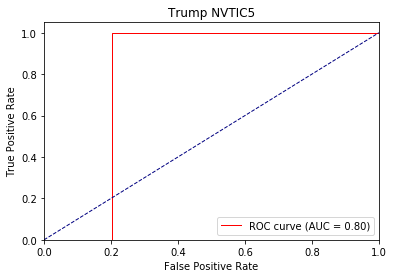

Directory already exists!
dt_nvtic4 0 ap tensor([0.9643, 0.0750]) loss : 0.3868207335472107 0.5974892589742737 tid : 200 tg tensor([[0]], device='cuda:0')
dt_nvtic4 0 ap tensor([0.9745, 0.0647]) loss : 0.5148904919624329 0.553985646312887 tid : 400 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic4 0 ap tensor([1., 0.]) loss : 0.350064218044281 0.3674609884619713 tid : 60 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic4 0 ap tensor([1., 0.]) loss : 0.3790420889854431 0.35045748430749646 tid : 90 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic4 0 ap tensor([1., 0.]) loss : 0.4428560733795166 0.3509225617436802 tid : 180 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic4 0 ap tensor([0.9944, 0.0526]) loss : 0.38597571849823 0.3751328193372296 tid : 330 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic4 0 ap tensor([0.9962, 0.0385]) loss : 0.3803863227367401 0.370378758080981 tid : 420 tg tensor([[0]], device='cuda:0')


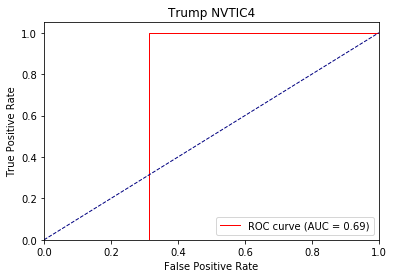

Directory already exists!
dt_nvtic4 1 ap tensor([0.9784, 0.2308]) loss : 0.32663410902023315 0.32784577798681197 tid : 400 tg tensor([[0]], device='cuda:0')
dt_nvtic4 1 ap tensor([0.9828, 0.1590]) loss : 0.12513554096221924 0.30008497564184583 tid : 200 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic4 1 ap tensor([1., 0.]) loss : 0.1933537721633911 0.21318353215853372 tid : 60 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic4 1 ap tensor([1., 0.]) loss : 0.21376729011535645 0.19345029799834543 tid : 90 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic4 1 ap tensor([1., 0.]) loss : 0.30340737104415894 0.19470091952997096 tid : 180 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic4 1 ap tensor([0.9948, 0.0556]) loss : 0.19577765464782715 0.2324436282919299 tid : 330 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic4 1 ap tensor([0.9964, 0.0400]) loss : 0.22483479976654053 0.2268639047714797 tid : 420 tg tensor([[0]], device='cuda:0')


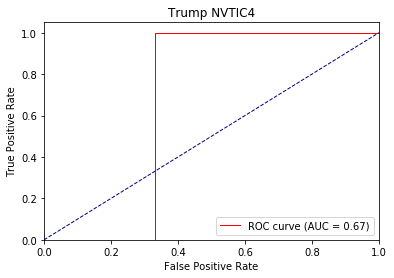

Directory already exists!
dt_nvtic4 2 ap tensor([1., 0.]) loss : 0.09347057342529297 0.19233437663032896 tid : 200 tg tensor([[0]], device='cuda:0')
dt_nvtic4 2 ap tensor([0.9797, 0.1197]) loss : 0.15046930313110352 0.215891011201652 tid : 400 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic4 2 ap tensor([1., 0.]) loss : 0.1193457841873169 0.13849327464898428 tid : 60 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic4 2 ap tensor([1., 0.]) loss : 0.13252544403076172 0.12062248198882393 tid : 90 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic4 2 ap tensor([1., 0.]) loss : 0.22028690576553345 0.12164683377041537 tid : 180 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic4 2 ap tensor([0.9948, 0.0556]) loss : 0.1146092414855957 0.16626706430988927 tid : 330 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic4 2 ap tensor([0.9962, 0.0385]) loss : 0.13934838771820068 0.15816778892820532 tid : 420 tg tensor([[0]], device='cuda:0')


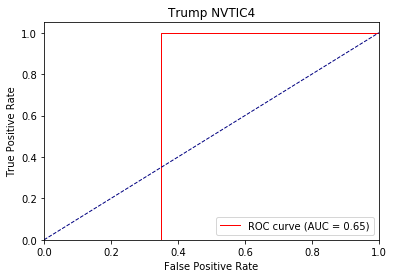

Directory already exists!
dt_interruptions 0 ap tensor([0.9174, 0.1694]) loss : 0.6722781658172607 0.6614997600949051 tid : 400 tg tensor([[0]], device='cuda:0')
dt_interruptions 0 ap tensor([0.9064, 0.1661]) loss : 0.9123485088348389 0.6618321610997054 tid : 200 tg tensor([[1]], device='cuda:0')
TEST dt_interruptions 0 ap tensor([1., 0.]) loss : 0.43314358592033386 0.432550348341465 tid : 60 tg tensor([[0]], device='cuda:0')
TEST dt_interruptions 0 ap tensor([1., 0.]) loss : 0.548556923866272 0.42320554930230847 tid : 90 tg tensor([[0]], device='cuda:0')
TEST dt_interruptions 0 ap tensor([0.9857, 0.0714]) loss : 0.6520485281944275 0.45298275176216574 tid : 180 tg tensor([[0]], device='cuda:0')
TEST dt_interruptions 0 ap tensor([0.9869, 0.0938]) loss : 0.39605700969696045 0.4708964579528378 tid : 330 tg tensor([[0]], device='cuda:0')
TEST dt_interruptions 0 ap tensor([0.9895, 0.0700]) loss : 0.5398122668266296 0.4778888201849027 tid : 420 tg tensor([[0]], device='cuda:0')


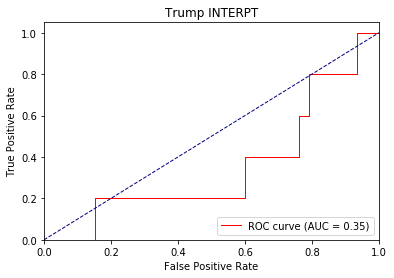

Directory already exists!
dt_interruptions 1 ap tensor([0.9235, 0.1286]) loss : 1.612990379333496 0.4222728837043681 tid : 200 tg tensor([[1]], device='cuda:0')
dt_interruptions 1 ap tensor([0.9361, 0.1421]) loss : 0.3117181360721588 0.4029695727359289 tid : 400 tg tensor([[0]], device='cuda:0')
TEST dt_interruptions 1 ap tensor([1., 0.]) loss : 0.2610740065574646 0.2758374611536662 tid : 60 tg tensor([[0]], device='cuda:0')
TEST dt_interruptions 1 ap tensor([1., 0.]) loss : 0.35129791498184204 0.26326593367949774 tid : 90 tg tensor([[0]], device='cuda:0')
TEST dt_interruptions 1 ap tensor([0.9896, 0.0909]) loss : 0.48210209608078003 0.3073871416204116 tid : 180 tg tensor([[0]], device='cuda:0')
TEST dt_interruptions 1 ap tensor([0.9904, 0.0972]) loss : 0.26378053426742554 0.3262053506989633 tid : 330 tg tensor([[0]], device='cuda:0')
TEST dt_interruptions 1 ap tensor([0.9922, 0.0711]) loss : 0.3414255976676941 0.3243503746661273 tid : 420 tg tensor([[0]], device='cuda:0')


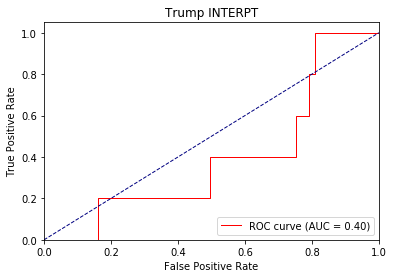

Directory already exists!
dt_interruptions 2 ap tensor([0.9638, 0.3108]) loss : 2.1541097164154053 0.30982492905295356 tid : 200 tg tensor([[1]], device='cuda:0')
dt_interruptions 2 ap tensor([0.9543, 0.2010]) loss : 0.19221919775009155 0.30841441949208576 tid : 400 tg tensor([[0]], device='cuda:0')
TEST dt_interruptions 2 ap tensor([1., 0.]) loss : 0.17356610298156738 0.19692911952733994 tid : 60 tg tensor([[0]], device='cuda:0')
TEST dt_interruptions 2 ap tensor([1., 0.]) loss : 0.24054449796676636 0.18334842505662338 tid : 90 tg tensor([[0]], device='cuda:0')
TEST dt_interruptions 2 ap tensor([0.9920, 0.1111]) loss : 0.3746581971645355 0.23569311464534087 tid : 180 tg tensor([[0]], device='cuda:0')
TEST dt_interruptions 2 ap tensor([0.9910, 0.0931]) loss : 0.20400375127792358 0.25366330771676954 tid : 330 tg tensor([[0]], device='cuda:0')
TEST dt_interruptions 2 ap tensor([0.9932, 0.0688]) loss : 0.2260766625404358 0.24430261281403629 tid : 420 tg tensor([[0]], device='cuda:0')


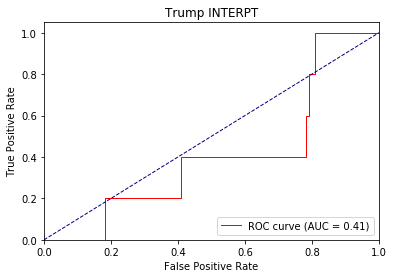

Directory already exists!
dt_lookat2 0 ap tensor([0.7257, 0.8385]) loss : 0.6219321489334106 0.6357655487954617 tid : 200 tg tensor([[1]], device='cuda:0')
dt_lookat2 0 ap tensor([0.7778, 0.8289]) loss : 0.7668201923370361 0.6362958810430892 tid : 400 tg tensor([[0]], device='cuda:0')
TEST dt_lookat2 0 ap tensor([0.8838, 0.7803]) loss : 0.7560169696807861 0.5862028628587723 tid : 60 tg tensor([[0]], device='cuda:0')
TEST dt_lookat2 0 ap tensor([0.7451, 0.7892]) loss : 0.24112361669540405 0.5916952443750281 tid : 270 tg tensor([[1]], device='cuda:0')
TEST dt_lookat2 0 ap tensor([0.7399, 0.7693]) loss : 0.45191940665245056 0.6133372250725241 tid : 450 tg tensor([[0]], device='cuda:0')


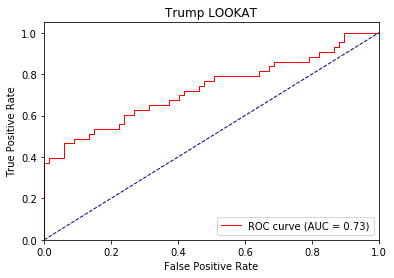

Directory already exists!
dt_lookat2 1 ap tensor([0.9066, 0.9534]) loss : 0.580851674079895 0.4794209599494934 tid : 200 tg tensor([[1]], device='cuda:0')
dt_lookat2 1 ap tensor([0.8926, 0.9547]) loss : 0.9700687527656555 0.4682990019001178 tid : 400 tg tensor([[0]], device='cuda:0')
TEST dt_lookat2 1 ap tensor([0.8992, 0.7839]) loss : 0.8231909275054932 0.5360582292079925 tid : 60 tg tensor([[0]], device='cuda:0')
TEST dt_lookat2 1 ap tensor([0.7444, 0.8204]) loss : 0.13073360919952393 0.561547014796943 tid : 270 tg tensor([[1]], device='cuda:0')
TEST dt_lookat2 1 ap tensor([0.7402, 0.7865]) loss : 0.3437710106372833 0.5913599235170027 tid : 450 tg tensor([[0]], device='cuda:0')


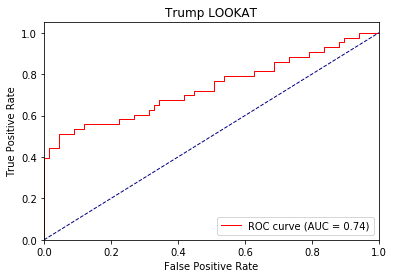

Directory already exists!
dt_lookat2 2 ap tensor([0.8897, 0.9456]) loss : 1.1186301708221436 0.38092030272653454 tid : 400 tg tensor([[0]], device='cuda:0')
dt_lookat2 2 ap tensor([0.8467, 0.9482]) loss : 0.534756064414978 0.3905563184311795 tid : 200 tg tensor([[1]], device='cuda:0')
TEST dt_lookat2 2 ap tensor([0.9299, 0.8571]) loss : 0.8313350081443787 0.49962930381298065 tid : 60 tg tensor([[0]], device='cuda:0')
TEST dt_lookat2 2 ap tensor([0.7382, 0.8344]) loss : 0.08441591262817383 0.548231349702467 tid : 270 tg tensor([[1]], device='cuda:0')
TEST dt_lookat2 2 ap tensor([0.7357, 0.7954]) loss : 0.2771618366241455 0.5817078902440913 tid : 450 tg tensor([[0]], device='cuda:0')


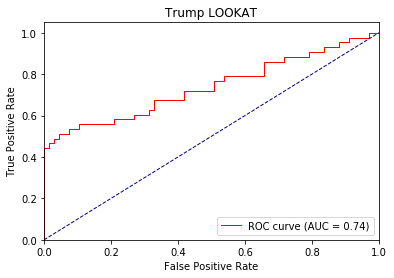

Directory already exists!
dt_brush1 0 ap tensor([0.9986, 0.7556]) loss : 0.47139495611190796 0.599798459787758 tid : 200 tg tensor([[0]], device='cuda:0')
dt_brush1 0 ap tensor([0.9741, 0.2310]) loss : 0.42303672432899475 0.49083656735800124 tid : 400 tg tensor([[0]], device='cuda:0')
TEST dt_brush1 0 ap tensor([1., 0.]) loss : 0.41347068548202515 0.2868403822183609 tid : 60 tg tensor([[0]], device='cuda:0')
TEST dt_brush1 0 ap tensor([0.9847, 0.4858]) loss : 1.0242223739624023 0.376434967706078 tid : 270 tg tensor([[1]], device='cuda:0')
TEST dt_brush1 0 ap tensor([0.9833, 0.2108]) loss : 0.34345299005508423 0.386536281599718 tid : 450 tg tensor([[0]], device='cuda:0')


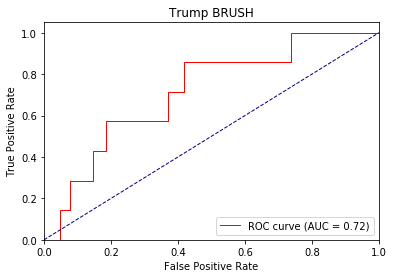

Directory already exists!
dt_brush1 1 ap tensor([0.9585, 0.2767]) loss : 0.15381771326065063 0.33620085435755115 tid : 200 tg tensor([[0]], device='cuda:0')
dt_brush1 1 ap tensor([0.9722, 0.2830]) loss : 0.30077460408210754 0.3327123627300662 tid : 400 tg tensor([[0]], device='cuda:0')
TEST dt_brush1 1 ap tensor([1., 0.]) loss : 0.25076693296432495 0.16561533510684967 tid : 60 tg tensor([[0]], device='cuda:0')
TEST dt_brush1 1 ap tensor([0.9826, 0.5305]) loss : 1.4830889701843262 0.28814584225939033 tid : 270 tg tensor([[1]], device='cuda:0')
TEST dt_brush1 1 ap tensor([0.9810, 0.1936]) loss : 0.20740413665771484 0.2899572274264167 tid : 450 tg tensor([[0]], device='cuda:0')


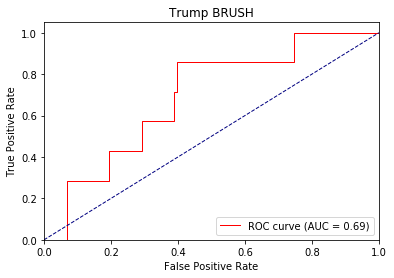

Directory already exists!
dt_brush1 2 ap tensor([0.9748, 0.3429]) loss : 0.16261106729507446 0.26612524384433783 tid : 400 tg tensor([[0]], device='cuda:0')
dt_brush1 2 ap tensor([0.9759, 0.3419]) loss : 0.050356507301330566 0.2630486836036046 tid : 200 tg tensor([[0]], device='cuda:0')
TEST dt_brush1 2 ap tensor([1., 0.]) loss : 0.16946274042129517 0.11044325828552246 tid : 60 tg tensor([[0]], device='cuda:0')
TEST dt_brush1 2 ap tensor([0.9821, 0.5276]) loss : 1.823033094406128 0.25735453660028024 tid : 270 tg tensor([[1]], device='cuda:0')
TEST dt_brush1 2 ap tensor([0.9815, 0.2174]) loss : 0.13825225830078125 0.2507409814526053 tid : 450 tg tensor([[0]], device='cuda:0')


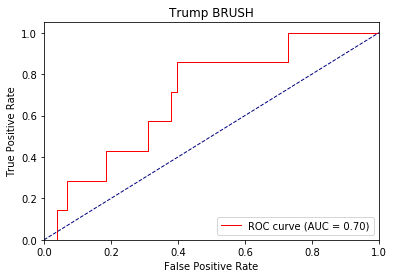

Directory already exists!
dt_nvdis1 0 ap tensor([0.2834, 0.6235]) loss : 0.6303684711456299 0.7466268671883477 tid : 400 tg tensor([[0]], device='cuda:0')
dt_nvdis1 0 ap tensor([0.2533, 0.7382]) loss : 0.6227844953536987 0.7231234546821073 tid : 200 tg tensor([[1]], device='cuda:0')
TEST dt_nvdis1 0 ap tensor([0.3544, 0.9068]) loss : 0.7155967354774475 0.6081486001610756 tid : 60 tg tensor([[0]], device='cuda:0')
TEST dt_nvdis1 0 ap tensor([0.2788, 0.8318]) loss : 0.8152601718902588 0.6272920218476078 tid : 270 tg tensor([[1]], device='cuda:0')
TEST dt_nvdis1 0 ap tensor([0.3462, 0.8364]) loss : 0.46438467502593994 0.6288266735918382 tid : 450 tg tensor([[1]], device='cuda:0')


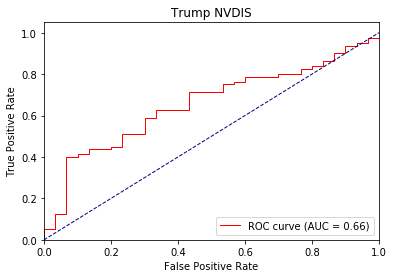

Directory already exists!
dt_nvdis1 1 ap tensor([0.6836, 0.9476]) loss : 0.7831308245658875 0.5525399952837564 tid : 400 tg tensor([[0]], device='cuda:0')
dt_nvdis1 1 ap tensor([0.6974, 0.9438]) loss : 0.332180917263031 0.5437486016449808 tid : 200 tg tensor([[1]], device='cuda:0')
TEST dt_nvdis1 1 ap tensor([0.3610, 0.9099]) loss : 0.8069760203361511 0.5147379100322723 tid : 60 tg tensor([[0]], device='cuda:0')
TEST dt_nvdis1 1 ap tensor([0.2777, 0.8538]) loss : 0.8825716972351074 0.568328544236066 tid : 270 tg tensor([[1]], device='cuda:0')
TEST dt_nvdis1 1 ap tensor([0.3409, 0.8605]) loss : 0.28156399726867676 0.5676403227974387 tid : 450 tg tensor([[1]], device='cuda:0')


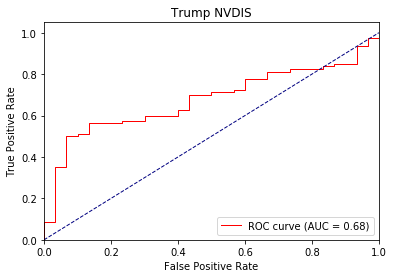

Directory already exists!
dt_nvdis1 2 ap tensor([0.7633, 0.9642]) loss : 0.1861504316329956 0.4436208401476183 tid : 200 tg tensor([[1]], device='cuda:0')
dt_nvdis1 2 ap tensor([0.7254, 0.9600]) loss : 0.8784573078155518 0.43724189854004014 tid : 400 tg tensor([[0]], device='cuda:0')
TEST dt_nvdis1 2 ap tensor([0.4106, 0.9225]) loss : 0.8701347708702087 0.4798290550708771 tid : 60 tg tensor([[0]], device='cuda:0')
TEST dt_nvdis1 2 ap tensor([0.2972, 0.8623]) loss : 0.9460155963897705 0.5559336658109698 tid : 270 tg tensor([[1]], device='cuda:0')
TEST dt_nvdis1 2 ap tensor([0.3501, 0.8650]) loss : 0.1811642050743103 0.5515357431243447 tid : 450 tg tensor([[1]], device='cuda:0')


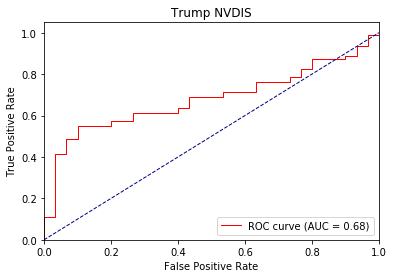

Directory already exists!
dt_lookat3 0 ap tensor([0.1258, 0.7921]) loss : 0.5402913093566895 0.6577874444313904 tid : 400 tg tensor([[1]], device='cuda:0')
dt_lookat3 0 ap tensor([0.1746, 0.7717]) loss : 0.4797048270702362 0.6394842697214757 tid : 200 tg tensor([[1]], device='cuda:0')
TEST dt_lookat3 0 ap tensor([0.2500, 0.9917]) loss : 0.3886227309703827 0.42045527696609497 tid : 60 tg tensor([[1]], device='cuda:0')
TEST dt_lookat3 0 ap tensor([0.3101, 0.9179]) loss : 0.4330974221229553 0.501951839840203 tid : 270 tg tensor([[1]], device='cuda:0')
TEST dt_lookat3 0 ap tensor([0.1736, 0.9236]) loss : 0.41391903162002563 0.4878763156778672 tid : 450 tg tensor([[1]], device='cuda:0')


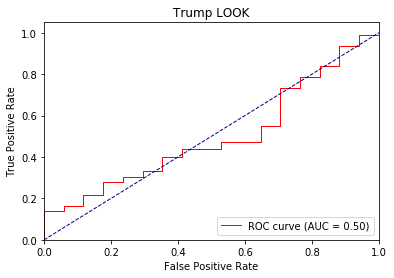

Directory already exists!
dt_lookat3 1 ap tensor([0.1939, 0.9375]) loss : 0.2905122637748718 0.49318137392401695 tid : 200 tg tensor([[1]], device='cuda:0')
dt_lookat3 1 ap tensor([0.3264, 0.9436]) loss : 0.343772828578949 0.4898599438857489 tid : 400 tg tensor([[1]], device='cuda:0')
TEST dt_lookat3 1 ap tensor([0.2000, 0.9886]) loss : 0.27761608362197876 0.31595613807439804 tid : 60 tg tensor([[1]], device='cuda:0')
TEST dt_lookat3 1 ap tensor([0.3709, 0.9439]) loss : 0.44616207480430603 0.4307051740194622 tid : 270 tg tensor([[1]], device='cuda:0')
TEST dt_lookat3 1 ap tensor([0.2246, 0.9495]) loss : 0.26449888944625854 0.40542945896877963 tid : 450 tg tensor([[1]], device='cuda:0')


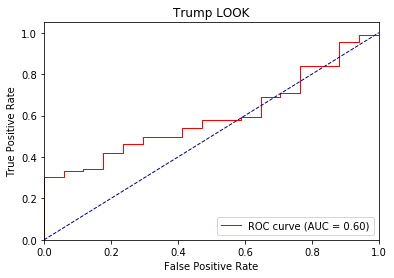

Directory already exists!
dt_lookat3 2 ap tensor([0.4717, 0.9583]) loss : 0.29186373949050903 0.4261117150743913 tid : 400 tg tensor([[1]], device='cuda:0')
dt_lookat3 2 ap tensor([0.4392, 0.9568]) loss : 0.11817371845245361 0.4240135162492881 tid : 200 tg tensor([[1]], device='cuda:0')
TEST dt_lookat3 2 ap tensor([0.2000, 0.9886]) loss : 0.20761138200759888 0.2637033015489578 tid : 60 tg tensor([[1]], device='cuda:0')
TEST dt_lookat3 2 ap tensor([0.3626, 0.9484]) loss : 0.483259379863739 0.40117608768898144 tid : 270 tg tensor([[1]], device='cuda:0')
TEST dt_lookat3 2 ap tensor([0.2826, 0.9553]) loss : 0.17449283599853516 0.36510172977167016 tid : 450 tg tensor([[1]], device='cuda:0')


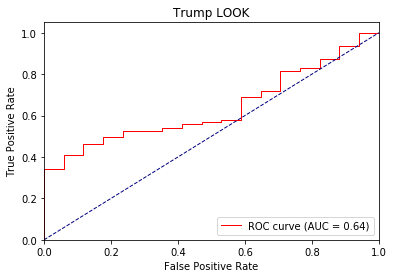

Directory already exists!
dt_eyebrow 0 ap tensor([0.0851, 0.8776]) loss : 0.5315241813659668 0.6000496655593425 tid : 400 tg tensor([[1]], device='cuda:0')
dt_eyebrow 0 ap tensor([0.0864, 0.8858]) loss : 1.3553730249404907 0.5872528017140352 tid : 200 tg tensor([[0]], device='cuda:0')
TEST dt_eyebrow 0 ap tensor([0.4157, 0.6752]) loss : 0.46211934089660645 0.6587630152702332 tid : 60 tg tensor([[1]], device='cuda:0')
TEST dt_eyebrow 0 ap tensor([0.4861, 0.4442]) loss : 1.523688554763794 0.7836190775821084 tid : 270 tg tensor([[0]], device='cuda:0')
TEST dt_eyebrow 0 ap tensor([0.4943, 0.4405]) loss : 0.6151221990585327 0.778161444383509 tid : 450 tg tensor([[1]], device='cuda:0')


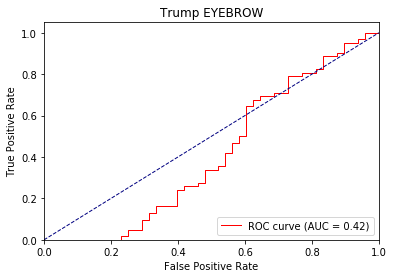

Directory already exists!
dt_eyebrow 1 ap tensor([0.1031, 0.9460]) loss : 0.36050188541412354 0.4081407027052982 tid : 400 tg tensor([[1]], device='cuda:0')
dt_eyebrow 1 ap tensor([0.0924, 0.9242]) loss : 2.0348002910614014 0.39362958048676844 tid : 200 tg tensor([[0]], device='cuda:0')
TEST dt_eyebrow 1 ap tensor([0.5177, 0.7781]) loss : 0.30237311124801636 0.6867983639240265 tid : 60 tg tensor([[1]], device='cuda:0')
TEST dt_eyebrow 1 ap tensor([0.5979, 0.5866]) loss : 1.81601881980896 0.8599986779062372 tid : 270 tg tensor([[0]], device='cuda:0')
TEST dt_eyebrow 1 ap tensor([0.5827, 0.5953]) loss : 0.3936811685562134 0.8460498077027938 tid : 450 tg tensor([[1]], device='cuda:0')


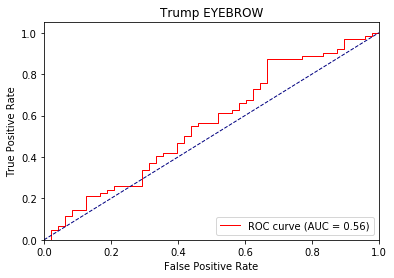

Directory already exists!
dt_eyebrow 2 ap tensor([0.1121, 0.9312]) loss : 2.4476096630096436 0.32245343178510666 tid : 200 tg tensor([[0]], device='cuda:0')
dt_eyebrow 2 ap tensor([0.1430, 0.9516]) loss : 0.22080445289611816 0.32334321175228087 tid : 400 tg tensor([[1]], device='cuda:0')
TEST dt_eyebrow 2 ap tensor([0.5574, 0.8842]) loss : 0.22232532501220703 0.7407538145780563 tid : 60 tg tensor([[1]], device='cuda:0')
TEST dt_eyebrow 2 ap tensor([0.6730, 0.7453]) loss : 1.9417545795440674 0.9398800699334395 tid : 270 tg tensor([[0]], device='cuda:0')
TEST dt_eyebrow 2 ap tensor([0.6588, 0.7408]) loss : 0.2589190602302551 0.9192742582629708 tid : 450 tg tensor([[1]], device='cuda:0')


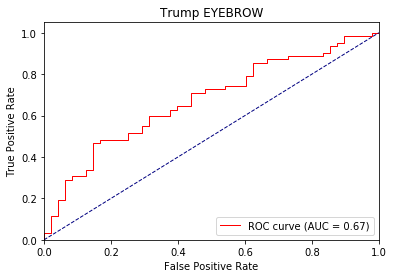

Directory already exists!
dt_atface 0 ap tensor([0.2196, 0.5937]) loss : 0.805220365524292 0.7501630655356816 tid : 200 tg tensor([[1]], device='cuda:0')
dt_atface 0 ap tensor([0.5242, 0.7062]) loss : 0.6996127367019653 0.6829790826571189 tid : 400 tg tensor([[0]], device='cuda:0')
TEST dt_atface 0 ap tensor([0.4215, 0.9158]) loss : 0.756685197353363 0.5642619341611862 tid : 60 tg tensor([[0]], device='cuda:0')
TEST dt_atface 0 ap tensor([0.4932, 0.8610]) loss : 1.0447192192077637 0.6136400819870463 tid : 270 tg tensor([[1]], device='cuda:0')
TEST dt_atface 0 ap tensor([0.5442, 0.8522]) loss : 0.4902718663215637 0.6240931942182428 tid : 450 tg tensor([[1]], device='cuda:0')


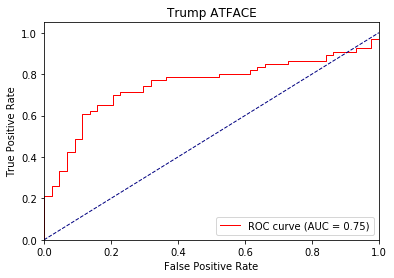

Directory already exists!
dt_atface 1 ap tensor([0.8081, 0.9031]) loss : 0.43494513630867004 0.518954969020117 tid : 200 tg tensor([[1]], device='cuda:0')
dt_atface 1 ap tensor([0.8260, 0.8881]) loss : 0.5379700660705566 0.505296344517348 tid : 400 tg tensor([[0]], device='cuda:0')
TEST dt_atface 1 ap tensor([0.5439, 0.9278]) loss : 0.6848743557929993 0.5153461217880249 tid : 60 tg tensor([[0]], device='cuda:0')
TEST dt_atface 1 ap tensor([0.4818, 0.8765]) loss : 1.268819808959961 0.5790211045951174 tid : 270 tg tensor([[1]], device='cuda:0')
TEST dt_atface 1 ap tensor([0.5417, 0.8745]) loss : 0.33428966999053955 0.5787103642435635 tid : 450 tg tensor([[1]], device='cuda:0')


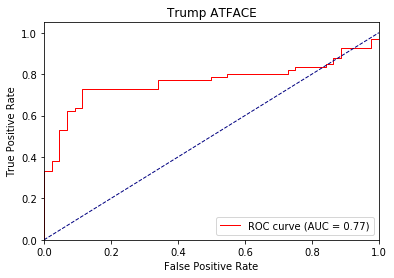

Directory already exists!
dt_atface 2 ap tensor([0.7919, 0.9454]) loss : 0.5013548135757446 0.44037439516096405 tid : 400 tg tensor([[0]], device='cuda:0')
dt_atface 2 ap tensor([0.8222, 0.9363]) loss : 0.26868385076522827 0.4294120435334422 tid : 200 tg tensor([[1]], device='cuda:0')
TEST dt_atface 2 ap tensor([0.5439, 0.9278]) loss : 0.62226802110672 0.49995538890361785 tid : 60 tg tensor([[0]], device='cuda:0')
TEST dt_atface 2 ap tensor([0.4815, 0.8812]) loss : 1.4713983535766602 0.5710194978797645 tid : 270 tg tensor([[1]], device='cuda:0')
TEST dt_atface 2 ap tensor([0.5425, 0.8792]) loss : 0.24200201034545898 0.5601075484472162 tid : 450 tg tensor([[1]], device='cuda:0')


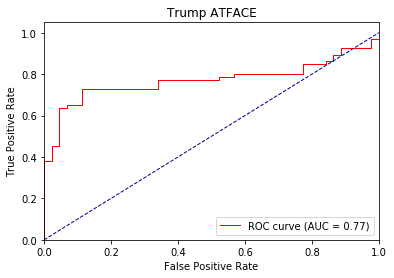

Directory already exists!
dt_feface 0 ap tensor([1., 0.]) loss : 0.3001020848751068 0.4821750025601651 tid : 200 tg tensor([[0]], device='cuda:0')
dt_feface 0 ap tensor([1., 0.]) loss : 0.3116503953933716 0.4381511425194533 tid : 400 tg tensor([[0]], device='cuda:0')
TEST dt_feface 0 ap tensor([1., 0.]) loss : 0.3036712408065796 0.2765743672847748 tid : 60 tg tensor([[0]], device='cuda:0')
TEST dt_feface 0 ap tensor([1., 0.]) loss : 0.2315046787261963 0.28803457921011405 tid : 270 tg tensor([[0]], device='cuda:0')
TEST dt_feface 0 ap tensor([1., 0.]) loss : 0.38521283864974976 0.3081916759995853 tid : 450 tg tensor([[0]], device='cuda:0')


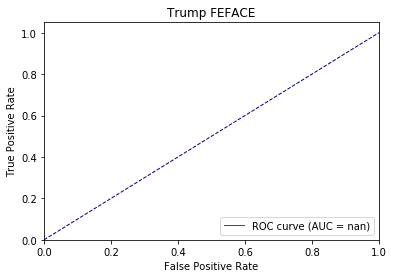

Directory already exists!
dt_feface 1 ap tensor([1., 0.]) loss : 0.23761898279190063 0.24605314288519126 tid : 400 tg tensor([[0]], device='cuda:0')
dt_feface 1 ap tensor([1., 0.]) loss : 0.11538755893707275 0.2209867753055939 tid : 200 tg tensor([[0]], device='cuda:0')
TEST dt_feface 1 ap tensor([1., 0.]) loss : 0.13249194622039795 0.1181491643190384 tid : 60 tg tensor([[0]], device='cuda:0')
TEST dt_feface 1 ap tensor([1., 0.]) loss : 0.08240091800689697 0.13108038274865402 tid : 270 tg tensor([[0]], device='cuda:0')
TEST dt_feface 1 ap tensor([1., 0.]) loss : 0.19408857822418213 0.151767077516107 tid : 450 tg tensor([[0]], device='cuda:0')


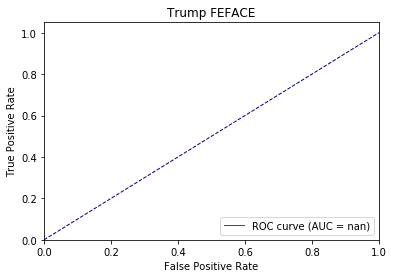

Directory already exists!
dt_feface 2 ap tensor([1., 0.]) loss : 0.06716263294219971 0.10267176628112792 tid : 200 tg tensor([[0]], device='cuda:0')
dt_feface 2 ap tensor([1., 0.]) loss : 0.0593029260635376 0.1005185105190145 tid : 400 tg tensor([[0]], device='cuda:0')
TEST dt_feface 2 ap tensor([1., 0.]) loss : 0.05362808704376221 0.05160660147666931 tid : 60 tg tensor([[0]], device='cuda:0')
TEST dt_feface 2 ap tensor([1., 0.]) loss : 0.03517329692840576 0.06219525609100074 tid : 270 tg tensor([[0]], device='cuda:0')
TEST dt_feface 2 ap tensor([1., 0.]) loss : 0.10836589336395264 0.07915066024836372 tid : 450 tg tensor([[0]], device='cuda:0')


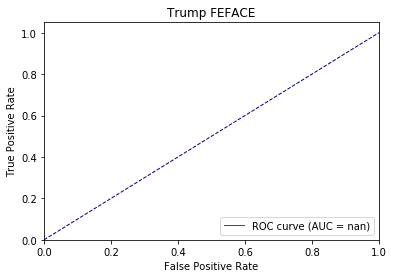

Directory already exists!
dt_hrface 0 ap tensor([0.8929, 0.1102]) loss : 0.4640883207321167 0.6341940098631699 tid : 400 tg tensor([[0]], device='cuda:0')
dt_hrface 0 ap tensor([0.9435, 0.1559]) loss : 0.2786415219306946 0.5472718732026097 tid : 200 tg tensor([[0]], device='cuda:0')
TEST dt_hrface 0 ap tensor([0.9471, 0.0714]) loss : 0.3214278817176819 0.3454801097512245 tid : 60 tg tensor([[0]], device='cuda:0')
TEST dt_hrface 0 ap tensor([0.9425, 0.1534]) loss : 0.38665834069252014 0.40759586399061637 tid : 270 tg tensor([[0]], device='cuda:0')
TEST dt_hrface 0 ap tensor([0.9457, 0.2542]) loss : 0.4588862359523773 0.4063196466249578 tid : 450 tg tensor([[0]], device='cuda:0')


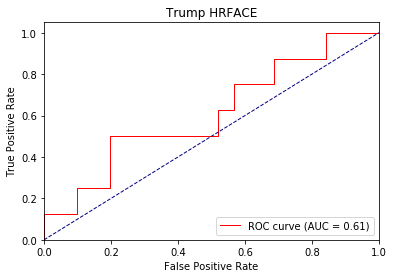

Directory already exists!
dt_hrface 1 ap tensor([0.9955, 0.6776]) loss : 0.2569713592529297 0.3381424686738423 tid : 400 tg tensor([[0]], device='cuda:0')
dt_hrface 1 ap tensor([0.9626, 0.3973]) loss : 0.0986945629119873 0.3367435928480125 tid : 200 tg tensor([[0]], device='cuda:0')
TEST dt_hrface 1 ap tensor([0.9595, 0.0833]) loss : 0.19711977243423462 0.2477569490671158 tid : 60 tg tensor([[0]], device='cuda:0')
TEST dt_hrface 1 ap tensor([0.9630, 0.4029]) loss : 0.24416965246200562 0.32884328354868975 tid : 270 tg tensor([[0]], device='cuda:0')
TEST dt_hrface 1 ap tensor([0.9629, 0.3225]) loss : 0.26665496826171875 0.3177767879822675 tid : 450 tg tensor([[0]], device='cuda:0')


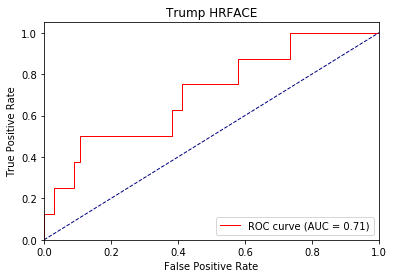

Directory already exists!
dt_hrface 2 ap tensor([0.9541, 0.4042]) loss : 0.1638035774230957 0.3094288224265689 tid : 400 tg tensor([[0]], device='cuda:0')
dt_hrface 2 ap tensor([0.9794, 0.5662]) loss : 0.07809019088745117 0.2956049485172299 tid : 200 tg tensor([[0]], device='cuda:0')
TEST dt_hrface 2 ap tensor([0.9648, 0.0909]) loss : 0.13536608219146729 0.21451420783996583 tid : 60 tg tensor([[0]], device='cuda:0')
TEST dt_hrface 2 ap tensor([0.9663, 0.3877]) loss : 0.1808074712753296 0.3073396975534004 tid : 270 tg tensor([[0]], device='cuda:0')
TEST dt_hrface 2 ap tensor([0.9672, 0.3591]) loss : 0.1801508069038391 0.28755260881255656 tid : 450 tg tensor([[0]], device='cuda:0')


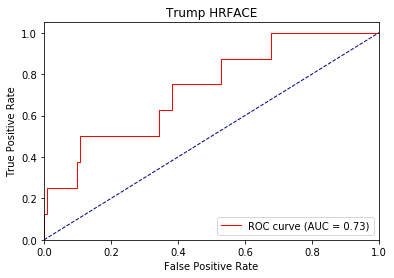

Directory already exists!
dt_saface 0 ap tensor([1., 0.]) loss : 0.607872486114502 0.6262297332286835 tid : 200 tg tensor([[0]], device='cuda:0')
dt_saface 0 ap tensor([1., 0.]) loss : 0.3078981339931488 0.4402999980262963 tid : 400 tg tensor([[0]], device='cuda:0')
TEST dt_saface 0 ap tensor([1., 0.]) loss : 0.21461838483810425 0.22704169154167175 tid : 60 tg tensor([[0]], device='cuda:0')
TEST dt_saface 0 ap tensor([1., 0.]) loss : 0.176311194896698 0.23925587587189256 tid : 270 tg tensor([[0]], device='cuda:0')
TEST dt_saface 0 ap tensor([1., 0.]) loss : 0.272250235080719 0.266514966768377 tid : 450 tg tensor([[0]], device='cuda:0')


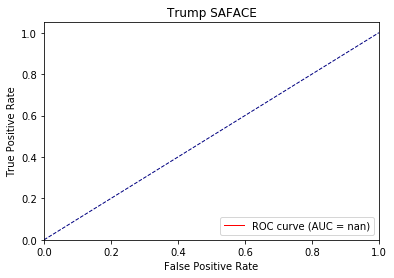

Directory already exists!
dt_saface 1 ap tensor([1., 0.]) loss : 0.17034238576889038 0.25781379267573357 tid : 200 tg tensor([[0]], device='cuda:0')
dt_saface 1 ap tensor([1., 0.]) loss : 0.1548396348953247 0.22101749373838234 tid : 400 tg tensor([[0]], device='cuda:0')
TEST dt_saface 1 ap tensor([1., 0.]) loss : 0.08806848526000977 0.09286022484302521 tid : 60 tg tensor([[0]], device='cuda:0')
TEST dt_saface 1 ap tensor([1., 0.]) loss : 0.06559205055236816 0.10433395651348851 tid : 270 tg tensor([[0]], device='cuda:0')
TEST dt_saface 1 ap tensor([1., 0.]) loss : 0.12157738208770752 0.1262461048715255 tid : 450 tg tensor([[0]], device='cuda:0')


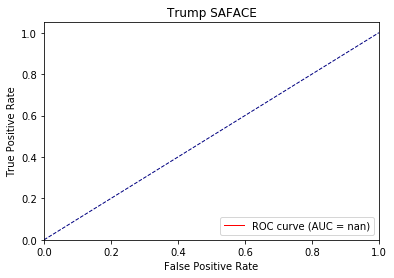

Directory already exists!
dt_saface 2 ap tensor([1., 0.]) loss : 0.0557788610458374 0.11724497632282536 tid : 200 tg tensor([[0]], device='cuda:0')
dt_saface 2 ap tensor([1., 0.]) loss : 0.0387645959854126 0.09005242134585525 tid : 400 tg tensor([[0]], device='cuda:0')
TEST dt_saface 2 ap tensor([1., 0.]) loss : 0.03903961181640625 0.040644437074661255 tid : 60 tg tensor([[0]], device='cuda:0')
TEST dt_saface 2 ap tensor([1., 0.]) loss : 0.027808547019958496 0.0491119947349816 tid : 270 tg tensor([[0]], device='cuda:0')
TEST dt_saface 2 ap tensor([1., 0.]) loss : 0.06296670436859131 0.06430502463789547 tid : 450 tg tensor([[0]], device='cuda:0')


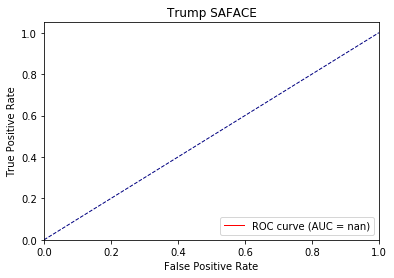

Directory already exists!
dt_neuface 0 ap tensor([0.8641, 0.4001]) loss : 0.6538143754005432 0.6574993482175863 tid : 200 tg tensor([[0]], device='cuda:0')
dt_neuface 0 ap tensor([0.8835, 0.3701]) loss : 0.7151871919631958 0.6400373362359546 tid : 400 tg tensor([[1]], device='cuda:0')
TEST dt_neuface 0 ap tensor([0.9340, 0.2310]) loss : 0.7597695589065552 0.5422787070274353 tid : 60 tg tensor([[1]], device='cuda:0')
TEST dt_neuface 0 ap tensor([0.8960, 0.3630]) loss : 0.6869797706604004 0.5846230141949236 tid : 270 tg tensor([[0]], device='cuda:0')
TEST dt_neuface 0 ap tensor([0.8852, 0.4028]) loss : 0.34802067279815674 0.5859375806415782 tid : 450 tg tensor([[0]], device='cuda:0')


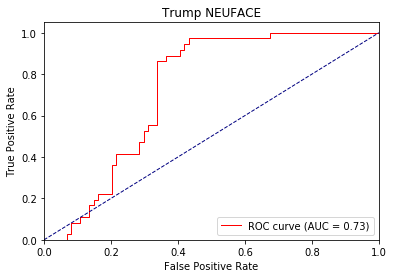

Directory already exists!
dt_neuface 1 ap tensor([0.9271, 0.4521]) loss : 0.736709475517273 0.5177169548204312 tid : 400 tg tensor([[1]], device='cuda:0')
dt_neuface 1 ap tensor([0.9248, 0.4958]) loss : 0.27377521991729736 0.5215849693823646 tid : 200 tg tensor([[0]], device='cuda:0')
TEST dt_neuface 1 ap tensor([0.9455, 0.2611]) loss : 0.7712963223457336 0.47353706061840056 tid : 60 tg tensor([[1]], device='cuda:0')
TEST dt_neuface 1 ap tensor([0.9093, 0.4092]) loss : 0.7657448649406433 0.5387255497146071 tid : 270 tg tensor([[0]], device='cuda:0')
TEST dt_neuface 1 ap tensor([0.8903, 0.4233]) loss : 0.23308342695236206 0.5437310534365037 tid : 450 tg tensor([[0]], device='cuda:0')


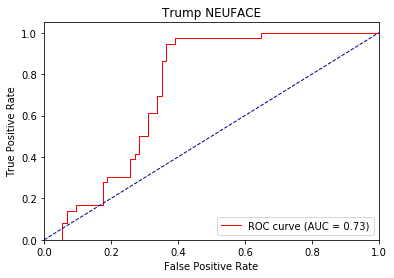

Directory already exists!
dt_neuface 2 ap tensor([0.9279, 0.6218]) loss : 0.6937850117683411 0.4772844710847834 tid : 400 tg tensor([[1]], device='cuda:0')
dt_neuface 2 ap tensor([0.9316, 0.6340]) loss : 0.22304564714431763 0.472988171012778 tid : 200 tg tensor([[0]], device='cuda:0')
TEST dt_neuface 2 ap tensor([0.9524, 0.2897]) loss : 0.7942339181900024 0.4330975830554962 tid : 60 tg tensor([[1]], device='cuda:0')
TEST dt_neuface 2 ap tensor([0.9106, 0.4037]) loss : 0.7908334136009216 0.5158837280775371 tid : 270 tg tensor([[0]], device='cuda:0')
TEST dt_neuface 2 ap tensor([0.8900, 0.4135]) loss : 0.164725661277771 0.5238949922954335 tid : 450 tg tensor([[0]], device='cuda:0')


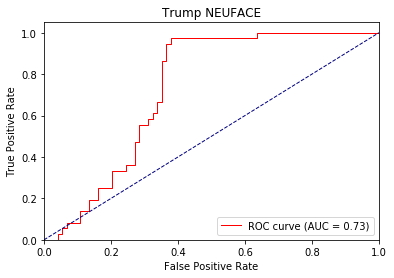

Directory already exists!
dt_inapprop 0 ap tensor([0.9855, 0.1111]) loss : 0.5399333238601685 0.7184164229925577 tid : 200 tg tensor([[0]], device='cuda:0')
dt_inapprop 0 ap tensor([0.9331, 0.0561]) loss : 0.426828533411026 0.601082228422165 tid : 400 tg tensor([[0]], device='cuda:0')
TEST dt_inapprop 0 ap tensor([1., 0.]) loss : 0.3577207028865814 0.3214865684509277 tid : 60 tg tensor([[0]], device='cuda:0')
TEST dt_inapprop 0 ap tensor([0.8206, 0.1898]) loss : 0.31245893239974976 0.5256946479019365 tid : 270 tg tensor([[0]], device='cuda:0')
TEST dt_inapprop 0 ap tensor([0.8660, 0.1188]) loss : 0.46174728870391846 0.4757177324856029 tid : 450 tg tensor([[0]], device='cuda:0')


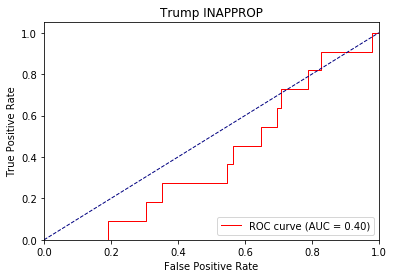

Directory already exists!
dt_inapprop 1 ap tensor([0.9551, 0.1676]) loss : 0.31718549132347107 0.4126687775316991 tid : 400 tg tensor([[0]], device='cuda:0')
dt_inapprop 1 ap tensor([0.9560, 0.1518]) loss : 0.19254076480865479 0.40545478561422327 tid : 200 tg tensor([[0]], device='cuda:0')
TEST dt_inapprop 1 ap tensor([1., 0.]) loss : 0.17716407775878906 0.16107441931962968 tid : 60 tg tensor([[0]], device='cuda:0')
TEST dt_inapprop 1 ap tensor([0.8432, 0.1944]) loss : 0.14646202325820923 0.5041481847302955 tid : 270 tg tensor([[0]], device='cuda:0')
TEST dt_inapprop 1 ap tensor([0.8740, 0.1164]) loss : 0.2932269871234894 0.41140144853030935 tid : 450 tg tensor([[0]], device='cuda:0')


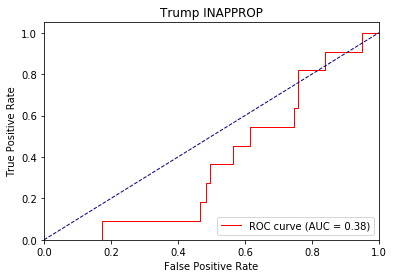

Directory already exists!
dt_inapprop 2 ap tensor([0.9713, 0.0833]) loss : 0.09386932849884033 0.2592724017474962 tid : 200 tg tensor([[0]], device='cuda:0')
dt_inapprop 2 ap tensor([0.9765, 0.0629]) loss : 0.10774731636047363 0.2502561790943146 tid : 400 tg tensor([[0]], device='cuda:0')
TEST dt_inapprop 2 ap tensor([1., 0.]) loss : 0.0999002456665039 0.09332651495933533 tid : 60 tg tensor([[0]], device='cuda:0')
TEST dt_inapprop 2 ap tensor([0.8663, 0.2153]) loss : 0.08685797452926636 0.5346653236631762 tid : 270 tg tensor([[0]], device='cuda:0')
TEST dt_inapprop 2 ap tensor([0.8828, 0.1212]) loss : 0.20108920335769653 0.40864537147914665 tid : 450 tg tensor([[0]], device='cuda:0')


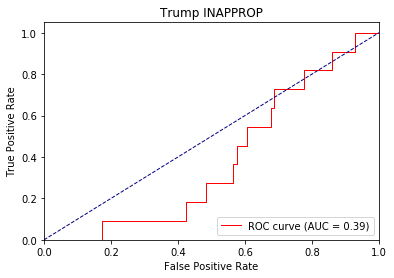

Directory already exists!
dt_affgest 0 ap tensor([0.9913, 0.0699]) loss : 0.6137356162071228 0.6398301412102202 tid : 400 tg tensor([[0]], device='cuda:0')
dt_affgest 0 ap tensor([0.9947, 0.0659]) loss : 0.4658862352371216 0.621207082904251 tid : 200 tg tensor([[0]], device='cuda:0')
TEST dt_affgest 0 ap tensor([1., 0.]) loss : 0.3962027132511139 0.33950248807668687 tid : 60 tg tensor([[0]], device='cuda:0')
TEST dt_affgest 0 ap tensor([0.9937, 0.0556]) loss : 0.32526081800460815 0.3699811299641927 tid : 270 tg tensor([[0]], device='cuda:0')
TEST dt_affgest 0 ap tensor([0.9949, 0.0323]) loss : 0.3967624604701996 0.3814906481434317 tid : 450 tg tensor([[0]], device='cuda:0')


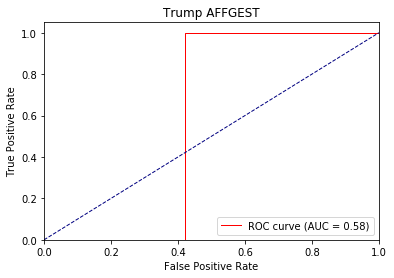

Directory already exists!
dt_affgest 1 ap tensor([0.9625, 0.0686]) loss : 0.3516678214073181 0.3905383859361921 tid : 400 tg tensor([[0]], device='cuda:0')
dt_affgest 1 ap tensor([0.9790, 0.0475]) loss : 0.2387990951538086 0.3636981248855591 tid : 200 tg tensor([[0]], device='cuda:0')
TEST dt_affgest 1 ap tensor([1., 0.]) loss : 0.18737274408340454 0.1670926347374916 tid : 60 tg tensor([[0]], device='cuda:0')
TEST dt_affgest 1 ap tensor([0.9919, 0.0455]) loss : 0.13288694620132446 0.21261712908744812 tid : 270 tg tensor([[0]], device='cuda:0')
TEST dt_affgest 1 ap tensor([0.9920, 0.0233]) loss : 0.2319747805595398 0.22121684936916128 tid : 450 tg tensor([[0]], device='cuda:0')


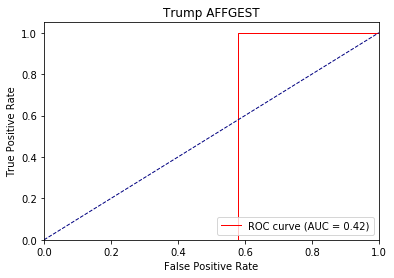

Directory already exists!
dt_affgest 2 ap tensor([0.9958, 0.0093]) loss : 0.11461281776428223 0.16574136711036166 tid : 400 tg tensor([[0]], device='cuda:0')
dt_affgest 2 ap tensor([0.9710, 0.0195]) loss : 0.07027006149291992 0.1938638213442917 tid : 200 tg tensor([[0]], device='cuda:0')
TEST dt_affgest 2 ap tensor([1., 0.]) loss : 0.09533894062042236 0.09396601021289826 tid : 60 tg tensor([[0]], device='cuda:0')
TEST dt_affgest 2 ap tensor([0.9862, 0.0312]) loss : 0.06149411201477051 0.14840118717729 tid : 270 tg tensor([[0]], device='cuda:0')
TEST dt_affgest 2 ap tensor([0.9877, 0.0179]) loss : 0.15368837118148804 0.1506856339819291 tid : 450 tg tensor([[0]], device='cuda:0')


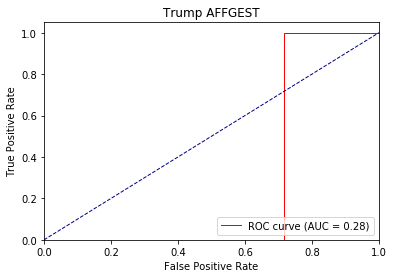

Directory already exists!
dt_defgest 0 ap tensor([0.5586, 0.3945]) loss : 0.7318713665008545 0.7124690823910529 tid : 400 tg tensor([[0]], device='cuda:0')
dt_defgest 0 ap tensor([0.7451, 0.4346]) loss : 0.6966248750686646 0.6663683971672347 tid : 200 tg tensor([[1]], device='cuda:0')
TEST dt_defgest 0 ap tensor([0.9416, 0.2381]) loss : 0.8895602226257324 0.6103114321827888 tid : 60 tg tensor([[1]], device='cuda:0')
TEST dt_defgest 0 ap tensor([0.8414, 0.5889]) loss : 0.33635565638542175 0.6204961140950521 tid : 270 tg tensor([[0]], device='cuda:0')
TEST dt_defgest 0 ap tensor([0.8299, 0.6610]) loss : 0.6297586560249329 0.6263738548054415 tid : 450 tg tensor([[1]], device='cuda:0')


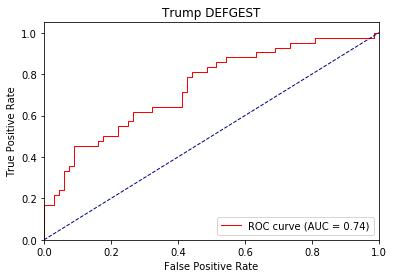

Directory already exists!
dt_defgest 1 ap tensor([0.8965, 0.6620]) loss : 0.4178232252597809 0.5544808119779727 tid : 400 tg tensor([[0]], device='cuda:0')
dt_defgest 1 ap tensor([0.8909, 0.6429]) loss : 0.715090811252594 0.5578217763121766 tid : 200 tg tensor([[1]], device='cuda:0')
TEST dt_defgest 1 ap tensor([0.9456, 0.2019]) loss : 1.1230227947235107 0.5664832562208175 tid : 60 tg tensor([[1]], device='cuda:0')
TEST dt_defgest 1 ap tensor([0.8540, 0.5325]) loss : 0.1888028383255005 0.5724991905061823 tid : 270 tg tensor([[0]], device='cuda:0')
TEST dt_defgest 1 ap tensor([0.8498, 0.6843]) loss : 0.5495882630348206 0.5756781129276052 tid : 450 tg tensor([[1]], device='cuda:0')


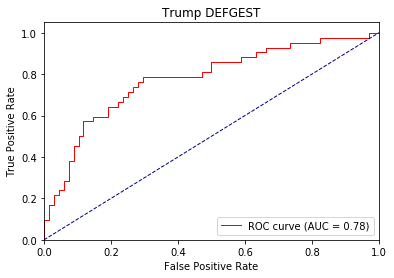

Directory already exists!
dt_defgest 2 ap tensor([0.9423, 0.7624]) loss : 0.3326006531715393 0.48471839946729167 tid : 400 tg tensor([[0]], device='cuda:0')
dt_defgest 2 ap tensor([0.9149, 0.6666]) loss : 0.6988888382911682 0.5002814218451415 tid : 200 tg tensor([[1]], device='cuda:0')
TEST dt_defgest 2 ap tensor([0.9425, 0.1769]) loss : 1.3228118419647217 0.5387338101863861 tid : 60 tg tensor([[1]], device='cuda:0')
TEST dt_defgest 2 ap tensor([0.8545, 0.5283]) loss : 0.12707418203353882 0.5495385972031376 tid : 270 tg tensor([[0]], device='cuda:0')
TEST dt_defgest 2 ap tensor([0.8478, 0.6887]) loss : 0.49674805998802185 0.5499352125560536 tid : 450 tg tensor([[1]], device='cuda:0')


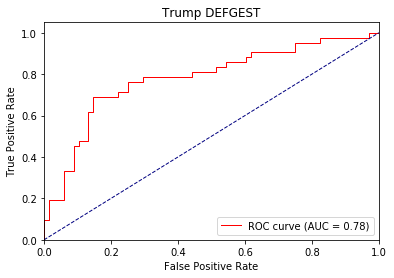

Directory already exists!
dt_agentic 0 ap tensor([0.3714, 0.6266]) loss : 0.5512391328811646 0.6775004688709502 tid : 200 tg tensor([[1]], device='cuda:0')
dt_agentic 0 ap tensor([0.4427, 0.7295]) loss : 0.7081348896026611 0.6589593096655242 tid : 400 tg tensor([[0]], device='cuda:0')
TEST dt_agentic 0 ap tensor([1., 1.]) loss : 0.7671949863433838 0.5419927701354027 tid : 60 tg tensor([[0]], device='cuda:0')
TEST dt_agentic 0 ap tensor([0.7242, 0.8043]) loss : 0.8567786812782288 0.6294508869187874 tid : 270 tg tensor([[1]], device='cuda:0')
TEST dt_agentic 0 ap tensor([0.7307, 0.7738]) loss : 0.49742698669433594 0.6406835734844207 tid : 450 tg tensor([[1]], device='cuda:0')


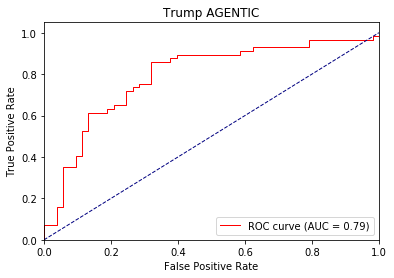

Directory already exists!
dt_agentic 1 ap tensor([0.8259, 0.9468]) loss : 0.3677176237106323 0.51757121308526 tid : 200 tg tensor([[1]], device='cuda:0')
dt_agentic 1 ap tensor([0.7739, 0.9489]) loss : 0.6219565272331238 0.4974990431079291 tid : 400 tg tensor([[0]], device='cuda:0')
TEST dt_agentic 1 ap tensor([1., 1.]) loss : 0.7308820486068726 0.43973584473133087 tid : 60 tg tensor([[0]], device='cuda:0')
TEST dt_agentic 1 ap tensor([0.6959, 0.8325]) loss : 1.1436748504638672 0.5882186173347005 tid : 270 tg tensor([[1]], device='cuda:0')
TEST dt_agentic 1 ap tensor([0.7186, 0.8068]) loss : 0.319674015045166 0.5994517087936402 tid : 450 tg tensor([[1]], device='cuda:0')


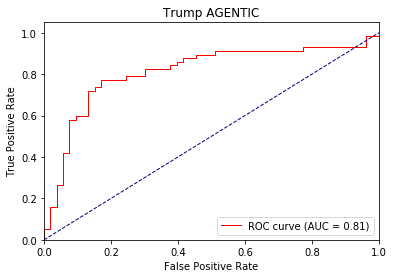

Directory already exists!
dt_agentic 2 ap tensor([0.9032, 0.9857]) loss : 0.2413056492805481 0.37088647186756135 tid : 200 tg tensor([[1]], device='cuda:0')
dt_agentic 2 ap tensor([0.7855, 0.9530]) loss : 0.5083460807800293 0.4041290407225212 tid : 400 tg tensor([[0]], device='cuda:0')
TEST dt_agentic 2 ap tensor([1., 1.]) loss : 0.6954412460327148 0.3804084092378616 tid : 60 tg tensor([[0]], device='cuda:0')
TEST dt_agentic 2 ap tensor([0.6975, 0.8511]) loss : 1.4109458923339844 0.578248005164297 tid : 270 tg tensor([[1]], device='cuda:0')
TEST dt_agentic 2 ap tensor([0.7176, 0.8213]) loss : 0.2126125693321228 0.5884909317773931 tid : 450 tg tensor([[1]], device='cuda:0')


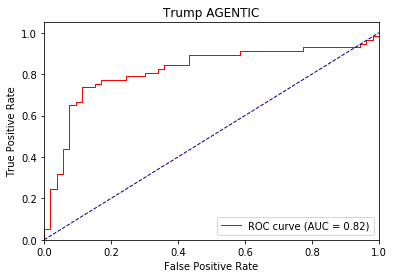

Directory already exists!
dt_waveoff 0 ap tensor([1., 0.]) loss : 0.538410484790802 0.5654681939761955 tid : 400 tg tensor([[0]], device='cuda:0')
dt_waveoff 0 ap tensor([1., 0.]) loss : 0.27147018909454346 0.4926844016766884 tid : 200 tg tensor([[0]], device='cuda:0')
TEST dt_waveoff 0 ap tensor([0.8426, 0.2024]) loss : 0.3095429837703705 0.5294672444462776 tid : 60 tg tensor([[0]], device='cuda:0')
TEST dt_waveoff 0 ap tensor([0.8068, 0.2659]) loss : 0.22752362489700317 0.5270774578839018 tid : 270 tg tensor([[0]], device='cuda:0')
TEST dt_waveoff 0 ap tensor([0.8328, 0.1468]) loss : 0.41498303413391113 0.46899550837628984 tid : 450 tg tensor([[0]], device='cuda:0')


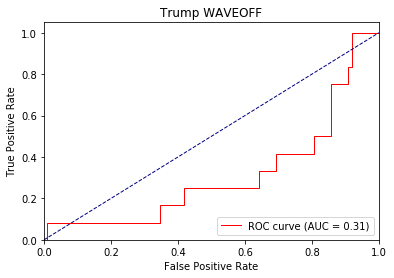

Directory already exists!
dt_waveoff 1 ap tensor([1., 0.]) loss : 0.1380344033241272 0.2374550489657516 tid : 200 tg tensor([[0]], device='cuda:0')
dt_waveoff 1 ap tensor([1., 0.]) loss : 0.1185305118560791 0.1914946478415818 tid : 400 tg tensor([[0]], device='cuda:0')
TEST dt_waveoff 1 ap tensor([0.8197, 0.1865]) loss : 0.12250423431396484 0.5909886330366134 tid : 60 tg tensor([[0]], device='cuda:0')
TEST dt_waveoff 1 ap tensor([0.7912, 0.2635]) loss : 0.0833289623260498 0.5744023448542545 tid : 270 tg tensor([[0]], device='cuda:0')
TEST dt_waveoff 1 ap tensor([0.8209, 0.1312]) loss : 0.24396589398384094 0.44685761227327236 tid : 450 tg tensor([[0]], device='cuda:0')


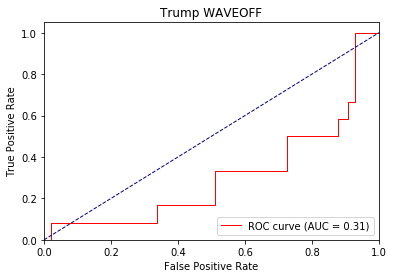

Directory already exists!
dt_waveoff 2 ap tensor([1., 0.]) loss : 0.10560548305511475 0.10381040073210193 tid : 400 tg tensor([[0]], device='cuda:0')
dt_waveoff 2 ap tensor([1., 0.]) loss : 0.02857840061187744 0.09518298978852753 tid : 200 tg tensor([[0]], device='cuda:0')
TEST dt_waveoff 2 ap tensor([0.8401, 0.2074]) loss : 0.048461198806762695 0.7138742506504059 tid : 60 tg tensor([[0]], device='cuda:0')
TEST dt_waveoff 2 ap tensor([0.7992, 0.2340]) loss : 0.03385353088378906 0.6885271992599755 tid : 270 tg tensor([[0]], device='cuda:0')
TEST dt_waveoff 2 ap tensor([0.8254, 0.1231]) loss : 0.14778733253479004 0.4962256578838124 tid : 450 tg tensor([[0]], device='cuda:0')


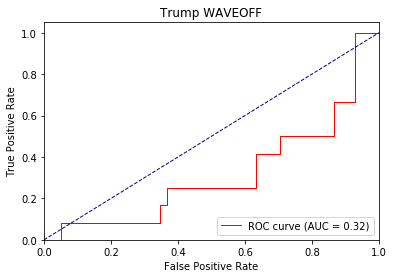

Directory already exists!
dt_nvtic1 0 ap tensor([0.9240, 0.1152]) loss : 0.4064730703830719 0.6018594595684013 tid : 400 tg tensor([[0]], device='cuda:0')
dt_nvtic1 0 ap tensor([0.9092, 0.1370]) loss : 0.23211896419525146 0.5562919068627241 tid : 200 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic1 0 ap tensor([0.9805, 0.8125]) loss : 0.333710640668869 0.44594157934188844 tid : 60 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic1 0 ap tensor([0.9595, 0.3796]) loss : 1.1806211471557617 0.4120307020973741 tid : 270 tg tensor([[1]], device='cuda:0')
TEST dt_nvtic1 0 ap tensor([0.9450, 0.2499]) loss : 0.318905770778656 0.43574388237560496 tid : 450 tg tensor([[0]], device='cuda:0')


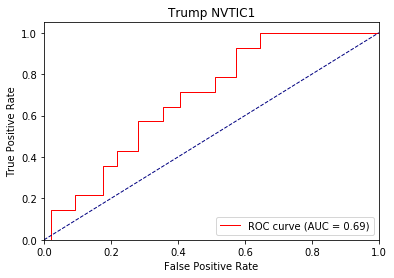

Directory already exists!
dt_nvtic1 1 ap tensor([0.9367, 0.2643]) loss : 0.2837103605270386 0.44967634760100267 tid : 400 tg tensor([[0]], device='cuda:0')
dt_nvtic1 1 ap tensor([0.9331, 0.2643]) loss : 0.1422526240348816 0.44356895695652876 tid : 200 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic1 1 ap tensor([0.9883, 0.8929]) loss : 0.2513899803161621 0.40461398363113404 tid : 60 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic1 1 ap tensor([0.9686, 0.4774]) loss : 1.4658727645874023 0.35231900215148926 tid : 270 tg tensor([[1]], device='cuda:0')
TEST dt_nvtic1 1 ap tensor([0.9549, 0.3086]) loss : 0.20232069492340088 0.3773306993877186 tid : 450 tg tensor([[0]], device='cuda:0')


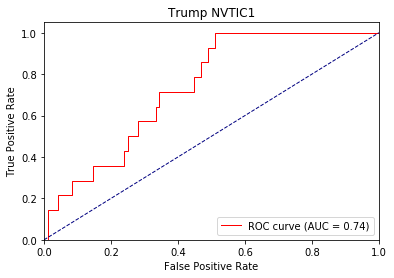

Directory already exists!
dt_nvtic1 2 ap tensor([0.9324, 0.2075]) loss : 0.24645143747329712 0.38939828319208963 tid : 400 tg tensor([[0]], device='cuda:0')
dt_nvtic1 2 ap tensor([0.9525, 0.3048]) loss : 0.09076285362243652 0.38765600028813096 tid : 200 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic1 2 ap tensor([0.9924, 0.9167]) loss : 0.20694118738174438 0.3900241255760193 tid : 60 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic1 2 ap tensor([0.9760, 0.4984]) loss : 1.6542649269104004 0.32509258650896844 tid : 270 tg tensor([[1]], device='cuda:0')
TEST dt_nvtic1 2 ap tensor([0.9595, 0.3309]) loss : 0.13652753829956055 0.3516251276521122 tid : 450 tg tensor([[0]], device='cuda:0')


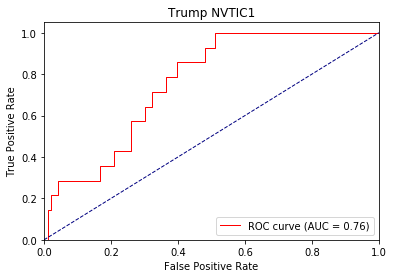

Directory already exists!
dt_nvtic2 0 ap tensor([0.9365, 0.2132]) loss : 0.5736030340194702 0.6077167516530946 tid : 400 tg tensor([[0]], device='cuda:0')
dt_nvtic2 0 ap tensor([0.9090, 0.1588]) loss : 0.29455840587615967 0.5459283483999499 tid : 200 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic2 0 ap tensor([0.7124, 0.5588]) loss : 0.3761427402496338 0.7430969640612602 tid : 60 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic2 0 ap tensor([0.7596, 0.2512]) loss : 0.36759042739868164 0.5751556095324064 tid : 270 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic2 0 ap tensor([0.8261, 0.1981]) loss : 0.3093297481536865 0.523133223547655 tid : 450 tg tensor([[0]], device='cuda:0')


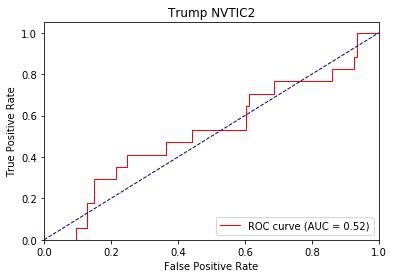

Directory already exists!
dt_nvtic2 1 ap tensor([0.9336, 0.2604]) loss : 0.3512376546859741 0.4253685643612328 tid : 400 tg tensor([[0]], device='cuda:0')
dt_nvtic2 1 ap tensor([0.9441, 0.2391]) loss : 0.15520399808883667 0.41584271722194055 tid : 200 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic2 1 ap tensor([0.7077, 0.5329]) loss : 0.2755679488182068 0.8549377858638764 tid : 60 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic2 1 ap tensor([0.7451, 0.2443]) loss : 0.2672029137611389 0.5845268556946203 tid : 270 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic2 1 ap tensor([0.8107, 0.1929]) loss : 0.19826555252075195 0.5019812356023228 tid : 450 tg tensor([[0]], device='cuda:0')


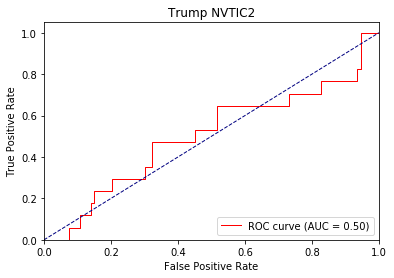

Directory already exists!
dt_nvtic2 2 ap tensor([0.9760, 0.4841]) loss : 0.12010049819946289 0.294137616111682 tid : 200 tg tensor([[0]], device='cuda:0')
dt_nvtic2 2 ap tensor([0.9673, 0.3454]) loss : 0.25876516103744507 0.32363925646154246 tid : 400 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic2 2 ap tensor([0.6424, 0.5185]) loss : 0.22901076078414917 0.9425633072853088 tid : 60 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic2 2 ap tensor([0.7268, 0.2348]) loss : 0.2408415675163269 0.6089483133533544 tid : 270 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic2 2 ap tensor([0.7986, 0.1922]) loss : 0.1390540599822998 0.5048266291618347 tid : 450 tg tensor([[0]], device='cuda:0')


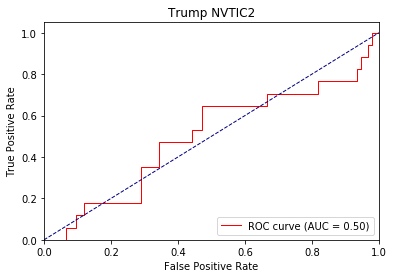

Directory already exists!
dt_nvtic3 0 ap tensor([0.5769, 0.7069]) loss : 0.7906484603881836 0.6962587439588138 tid : 200 tg tensor([[1]], device='cuda:0')
dt_nvtic3 0 ap tensor([0.7236, 0.7195]) loss : 0.673232913017273 0.6480688150357274 tid : 400 tg tensor([[1]], device='cuda:0')
TEST dt_nvtic3 0 ap tensor([0.2500, 0.9547]) loss : 0.5478127002716064 0.7029506102204323 tid : 60 tg tensor([[1]], device='cuda:0')
TEST dt_nvtic3 0 ap tensor([0.4526, 0.8951]) loss : 0.5009928941726685 0.6715594828128815 tid : 270 tg tensor([[1]], device='cuda:0')
TEST dt_nvtic3 0 ap tensor([0.5554, 0.8193]) loss : 0.48494455218315125 0.6579676529940437 tid : 450 tg tensor([[0]], device='cuda:0')


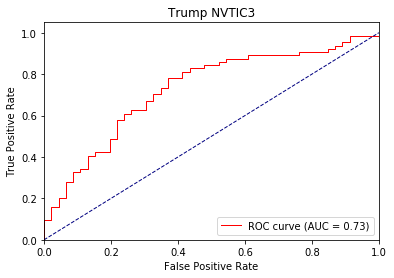

Directory already exists!
dt_nvtic3 1 ap tensor([0.8107, 0.9034]) loss : 0.5420422554016113 0.5446956219344303 tid : 400 tg tensor([[1]], device='cuda:0')
dt_nvtic3 1 ap tensor([0.8295, 0.8732]) loss : 0.8217527270317078 0.5443133366042079 tid : 200 tg tensor([[1]], device='cuda:0')
TEST dt_nvtic3 1 ap tensor([0.2500, 0.9547]) loss : 0.46107396483421326 0.7022728860378266 tid : 60 tg tensor([[1]], device='cuda:0')
TEST dt_nvtic3 1 ap tensor([0.4903, 0.9169]) loss : 0.3476453125476837 0.636662365051738 tid : 270 tg tensor([[1]], device='cuda:0')
TEST dt_nvtic3 1 ap tensor([0.5768, 0.8591]) loss : 0.40359190106391907 0.6250051922657911 tid : 450 tg tensor([[0]], device='cuda:0')


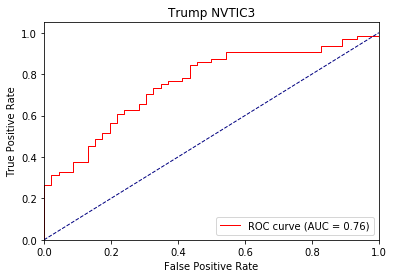

Directory already exists!
dt_nvtic3 2 ap tensor([0., 1.]) loss : 0.4473564624786377 0.4077606449524562 tid : 400 tg tensor([[1]], device='cuda:0')
dt_nvtic3 2 ap tensor([0.5896, 0.7862]) loss : 0.820561945438385 0.6012431814752776 tid : 200 tg tensor([[1]], device='cuda:0')
TEST dt_nvtic3 2 ap tensor([0.2083, 0.9518]) loss : 0.40736618638038635 0.7112586483359337 tid : 60 tg tensor([[1]], device='cuda:0')
TEST dt_nvtic3 2 ap tensor([0.4975, 0.9239]) loss : 0.27664053440093994 0.6205010126557267 tid : 270 tg tensor([[1]], device='cuda:0')
TEST dt_nvtic3 2 ap tensor([0.5849, 0.8667]) loss : 0.35392579436302185 0.6086644838838017 tid : 450 tg tensor([[0]], device='cuda:0')


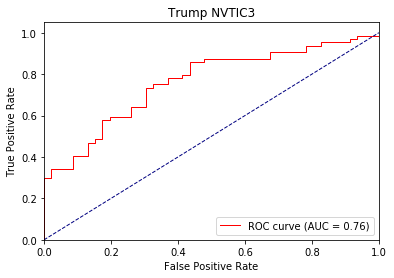

Directory already exists!
dt_nvtic5 0 ap tensor([0.9999, 0.5000]) loss : 0.3878926634788513 0.6057804170995951 tid : 200 tg tensor([[0]], device='cuda:0')
dt_nvtic5 0 ap tensor([0.9840, 0.1331]) loss : 0.33157479763031006 0.5077201022141016 tid : 400 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic5 0 ap tensor([1., 0.]) loss : 0.28864145278930664 0.2795843884348869 tid : 60 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic5 0 ap tensor([0.9860, 0.1573]) loss : 0.2758253812789917 0.3373096203594877 tid : 270 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic5 0 ap tensor([0.9860, 0.0675]) loss : 0.33692467212677 0.35445197434986336 tid : 450 tg tensor([[0]], device='cuda:0')


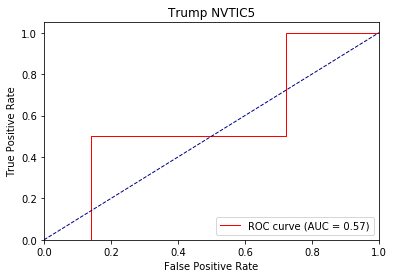

Directory already exists!
dt_nvtic5 1 ap tensor([0.9812, 0.0834]) loss : 0.12611806392669678 0.29650655211202354 tid : 200 tg tensor([[0]], device='cuda:0')
dt_nvtic5 1 ap tensor([0.9821, 0.0831]) loss : 0.20864087343215942 0.2946974342869174 tid : 400 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic5 1 ap tensor([1., 0.]) loss : 0.13487017154693604 0.1259336441755295 tid : 60 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic5 1 ap tensor([0.9908, 0.1455]) loss : 0.10637426376342773 0.20437589130903544 tid : 270 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic5 1 ap tensor([0.9889, 0.0625]) loss : 0.19757407903671265 0.2119041505981894 tid : 450 tg tensor([[0]], device='cuda:0')


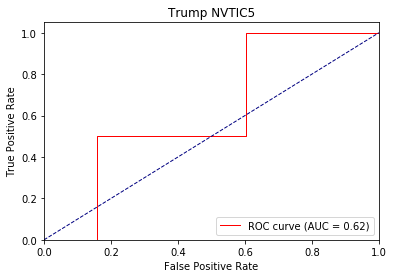

Directory already exists!
dt_nvtic5 2 ap tensor([0.9880, 0.0479]) loss : 0.047667860984802246 0.18554466651244597 tid : 200 tg tensor([[0]], device='cuda:0')
dt_nvtic5 2 ap tensor([0.9909, 0.0425]) loss : 0.06927502155303955 0.17482861842492686 tid : 400 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic5 2 ap tensor([1., 0.]) loss : 0.0682973861694336 0.0615959882736206 tid : 60 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic5 2 ap tensor([0.9931, 0.1588]) loss : 0.05571699142456055 0.1528568100510982 tid : 270 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic5 2 ap tensor([0.9920, 0.0662]) loss : 0.11744880676269531 0.14881194900063907 tid : 450 tg tensor([[0]], device='cuda:0')


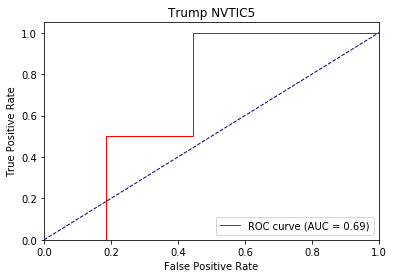

Directory already exists!
dt_nvtic4 0 ap tensor([0.9599, 0.0393]) loss : 0.3848729729652405 0.5498404343594533 tid : 400 tg tensor([[0]], device='cuda:0')
dt_nvtic4 0 ap tensor([0.9602, 0.0393]) loss : 0.3224687874317169 0.5492157869777836 tid : 200 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic4 0 ap tensor([1., 0.]) loss : 0.40298065543174744 0.3346069812774658 tid : 60 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic4 0 ap tensor([1., 0.]) loss : 0.313110888004303 0.3399406488527331 tid : 270 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic4 0 ap tensor([0.9955, 0.0357]) loss : 0.36611318588256836 0.36286355292095857 tid : 450 tg tensor([[0]], device='cuda:0')


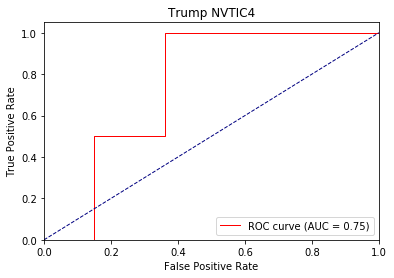

Directory already exists!
dt_nvtic4 1 ap tensor([0.9533, 0.0926]) loss : 0.2885683476924896 0.37618593774832687 tid : 400 tg tensor([[0]], device='cuda:0')
dt_nvtic4 1 ap tensor([0.9781, 0.0681]) loss : 0.12213164567947388 0.3090703345123847 tid : 200 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic4 1 ap tensor([1., 0.]) loss : 0.22133681178092957 0.1677161082625389 tid : 60 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic4 1 ap tensor([1., 0.]) loss : 0.16039878129959106 0.17784852207752697 tid : 270 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic4 1 ap tensor([0.9955, 0.0357]) loss : 0.20392227172851562 0.21105866151697494 tid : 450 tg tensor([[0]], device='cuda:0')


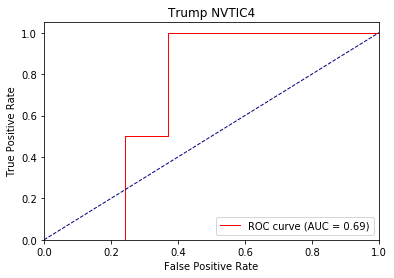

Directory already exists!
dt_nvtic4 2 ap tensor([0.9855, 0.1148]) loss : 0.091042160987854 0.23500140573157638 tid : 200 tg tensor([[0]], device='cuda:0')
dt_nvtic4 2 ap tensor([0.9782, 0.0868]) loss : 0.11339157819747925 0.2270369675145092 tid : 400 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic4 2 ap tensor([1., 0.]) loss : 0.13792753219604492 0.09932449460029602 tid : 60 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic4 2 ap tensor([1., 0.]) loss : 0.10157352685928345 0.1087128948747066 tid : 270 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic4 2 ap tensor([0.9951, 0.0333]) loss : 0.12327098846435547 0.1459825526265537 tid : 450 tg tensor([[0]], device='cuda:0')


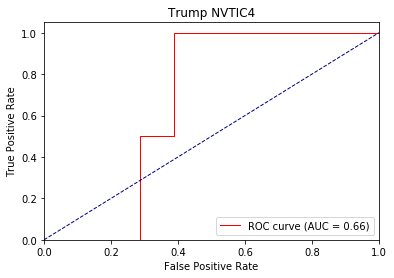

Directory already exists!
dt_interruptions 0 ap tensor([0.9088, 0.0673]) loss : 0.38124001026153564 0.5638620464825163 tid : 400 tg tensor([[0]], device='cuda:0')
dt_interruptions 0 ap tensor([0.9004, 0.0728]) loss : 1.5126168727874756 0.5469160703818003 tid : 200 tg tensor([[1]], device='cuda:0')
TEST dt_interruptions 0 ap tensor([1., 0.]) loss : 0.3303679823875427 0.30579700171947477 tid : 60 tg tensor([[0]], device='cuda:0')
TEST dt_interruptions 0 ap tensor([0.9052, 0.1057]) loss : 0.3002416491508484 0.41620419527354996 tid : 270 tg tensor([[0]], device='cuda:0')
TEST dt_interruptions 0 ap tensor([0.9059, 0.1338]) loss : 0.5226308107376099 0.43120909753967734 tid : 450 tg tensor([[0]], device='cuda:0')


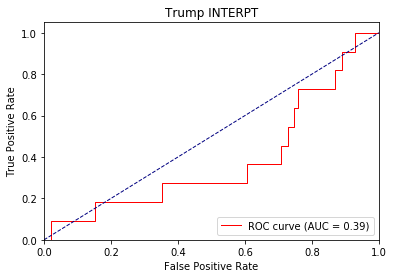

Directory already exists!
dt_interruptions 1 ap tensor([0.9182, 0.1153]) loss : 1.8930492401123047 0.404390766396435 tid : 200 tg tensor([[1]], device='cuda:0')
dt_interruptions 1 ap tensor([0.9294, 0.1278]) loss : 0.22863364219665527 0.3913621804785968 tid : 400 tg tensor([[0]], device='cuda:0')
TEST dt_interruptions 1 ap tensor([1., 0.]) loss : 0.20381242036819458 0.16970391273498536 tid : 60 tg tensor([[0]], device='cuda:0')
TEST dt_interruptions 1 ap tensor([0.9027, 0.1008]) loss : 0.18841087818145752 0.3350305698419872 tid : 270 tg tensor([[0]], device='cuda:0')
TEST dt_interruptions 1 ap tensor([0.9132, 0.1360]) loss : 0.30147647857666016 0.34851577948121465 tid : 450 tg tensor([[0]], device='cuda:0')


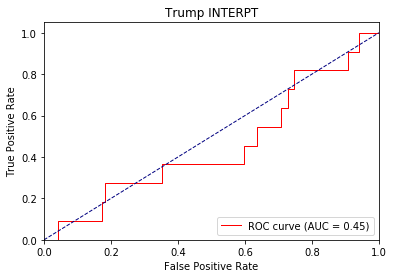

Directory already exists!
dt_interruptions 2 ap tensor([0.9511, 0.2114]) loss : 0.16018062829971313 0.32688250284239717 tid : 400 tg tensor([[0]], device='cuda:0')
dt_interruptions 2 ap tensor([0.9444, 0.1722]) loss : 2.5782315731048584 0.3053537050088247 tid : 200 tg tensor([[1]], device='cuda:0')
TEST dt_interruptions 2 ap tensor([1., 0.]) loss : 0.14225101470947266 0.11322392225265503 tid : 60 tg tensor([[0]], device='cuda:0')
TEST dt_interruptions 2 ap tensor([0.9050, 0.1108]) loss : 0.14642810821533203 0.311301284714749 tid : 270 tg tensor([[0]], device='cuda:0')
TEST dt_interruptions 2 ap tensor([0.9165, 0.1303]) loss : 0.1902604103088379 0.3223519900265862 tid : 450 tg tensor([[0]], device='cuda:0')


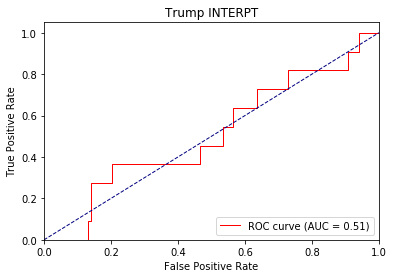

Directory already exists!
dt_lookat2 0 ap tensor([0.7628, 0.9165]) loss : 1.030044436454773 0.5597059620912805 tid : 400 tg tensor([[0]], device='cuda:0')
TEST dt_lookat2 0 ap tensor([0.6831, 0.9089]) loss : 0.3910541534423828 0.5793549498686423 tid : 120 tg tensor([[0]], device='cuda:0')
TEST dt_lookat2 0 ap tensor([0.5831, 0.8603]) loss : 0.8056527972221375 0.6106813155316018 tid : 180 tg tensor([[1]], device='cuda:0')
TEST dt_lookat2 0 ap tensor([0.6873, 0.7501]) loss : 0.5261008739471436 0.6174500374769678 tid : 480 tg tensor([[0]], device='cuda:0')


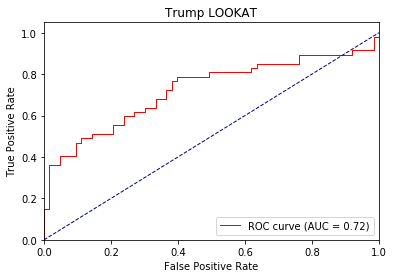

Directory already exists!
dt_lookat2 1 ap tensor([0.8381, 0.9579]) loss : 1.1667630672454834 0.4572582238585637 tid : 400 tg tensor([[0]], device='cuda:0')
TEST dt_lookat2 1 ap tensor([0.6947, 0.9165]) loss : 0.2679796814918518 0.5340712907222601 tid : 120 tg tensor([[0]], device='cuda:0')
TEST dt_lookat2 1 ap tensor([0.5940, 0.8676]) loss : 0.8090016841888428 0.5822074260260608 tid : 180 tg tensor([[1]], device='cuda:0')
TEST dt_lookat2 1 ap tensor([0.7038, 0.7691]) loss : 0.462418794631958 0.5909247544347024 tid : 480 tg tensor([[0]], device='cuda:0')


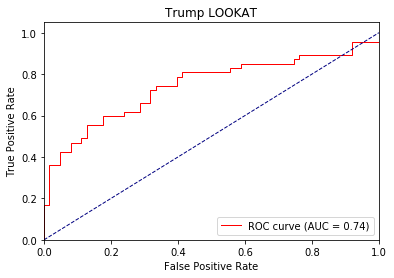

Directory already exists!
dt_lookat2 2 ap tensor([0.8502, 0.9601]) loss : 1.3394403457641602 0.3946908678590637 tid : 400 tg tensor([[0]], device='cuda:0')
TEST dt_lookat2 2 ap tensor([0.6967, 0.9107]) loss : 0.19921833276748657 0.5092125351612384 tid : 120 tg tensor([[0]], device='cuda:0')
TEST dt_lookat2 2 ap tensor([0.6069, 0.8656]) loss : 0.8212419748306274 0.570128228213336 tid : 180 tg tensor([[1]], device='cuda:0')
TEST dt_lookat2 2 ap tensor([0.7146, 0.7749]) loss : 0.4128940999507904 0.5781764753010808 tid : 480 tg tensor([[0]], device='cuda:0')


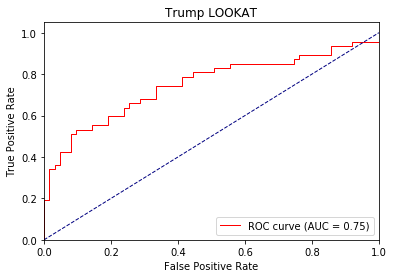

Directory already exists!
dt_brush1 0 ap tensor([0.9433, 0.2345]) loss : 0.6728061437606812 0.7259052648859204 tid : 400 tg tensor([[0]], device='cuda:0')
TEST dt_brush1 0 ap tensor([0.9969, 0.3333]) loss : 0.4165109694004059 0.4621561742745913 tid : 120 tg tensor([[0]], device='cuda:0')
TEST dt_brush1 0 ap tensor([0.9967, 0.6667]) loss : 0.6590073108673096 0.46565949433558695 tid : 180 tg tensor([[0]], device='cuda:0')
TEST dt_brush1 0 ap tensor([0.9759, 0.2344]) loss : 0.649122953414917 0.5132359798465457 tid : 480 tg tensor([[0]], device='cuda:0')


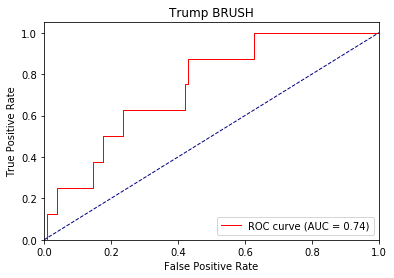

Directory already exists!
dt_brush1 1 ap tensor([0.9574, 0.3092]) loss : 0.3332831859588623 0.4303096894614041 tid : 400 tg tensor([[0]], device='cuda:0')
TEST dt_brush1 1 ap tensor([0.9985, 0.5000]) loss : 0.251043438911438 0.30517131090164185 tid : 120 tg tensor([[0]], device='cuda:0')
TEST dt_brush1 1 ap tensor([0.9992, 0.8333]) loss : 0.5188115835189819 0.3109288731136838 tid : 180 tg tensor([[0]], device='cuda:0')
TEST dt_brush1 1 ap tensor([0.9813, 0.2676]) loss : 0.43960174918174744 0.37361126469106093 tid : 480 tg tensor([[0]], device='cuda:0')


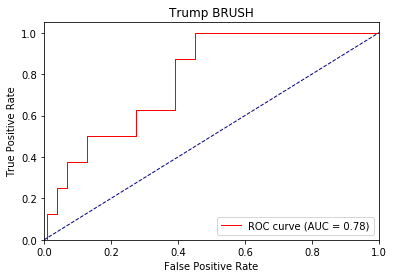

Directory already exists!
dt_brush1 2 ap tensor([0.9597, 0.1837]) loss : 0.23787730932235718 0.33945154374645603 tid : 400 tg tensor([[0]], device='cuda:0')
TEST dt_brush1 2 ap tensor([1., 1.]) loss : 0.15754425525665283 0.23183380755094382 tid : 120 tg tensor([[0]], device='cuda:0')
TEST dt_brush1 2 ap tensor([1., 1.]) loss : 0.4412717819213867 0.23881053521826462 tid : 180 tg tensor([[0]], device='cuda:0')
TEST dt_brush1 2 ap tensor([0.9816, 0.3058]) loss : 0.3151569962501526 0.3056235511083992 tid : 480 tg tensor([[0]], device='cuda:0')


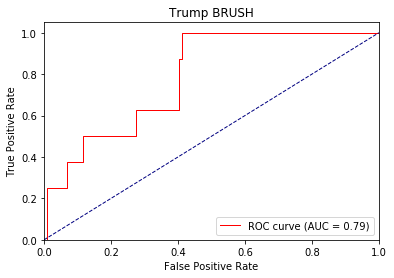

Directory already exists!
dt_nvdis1 0 ap tensor([0.4418, 0.7789]) loss : 0.6009593605995178 0.6715314531900797 tid : 400 tg tensor([[0]], device='cuda:0')
TEST dt_nvdis1 0 ap tensor([0.5413, 0.8867]) loss : 0.44953176379203796 0.5992482728683032 tid : 120 tg tensor([[1]], device='cuda:0')
TEST dt_nvdis1 0 ap tensor([0.4827, 0.8909]) loss : 0.5026193857192993 0.5788280021499943 tid : 180 tg tensor([[1]], device='cuda:0')
TEST dt_nvdis1 0 ap tensor([0.4932, 0.8940]) loss : 0.9968196153640747 0.58143777445871 tid : 480 tg tensor([[0]], device='cuda:0')


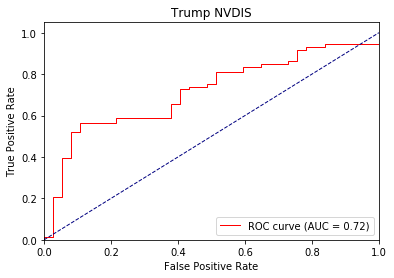

Directory already exists!
dt_nvdis1 1 ap tensor([0.7707, 0.9471]) loss : 0.6764742136001587 0.5047954300354267 tid : 400 tg tensor([[0]], device='cuda:0')
TEST dt_nvdis1 1 ap tensor([0.5313, 0.8794]) loss : 0.26569968461990356 0.5508545258870492 tid : 120 tg tensor([[1]], device='cuda:0')
TEST dt_nvdis1 1 ap tensor([0.4684, 0.8975]) loss : 0.45982328057289124 0.5292804402274054 tid : 180 tg tensor([[1]], device='cuda:0')
TEST dt_nvdis1 1 ap tensor([0.4924, 0.9053]) loss : 1.2765501737594604 0.5361517381911375 tid : 480 tg tensor([[0]], device='cuda:0')


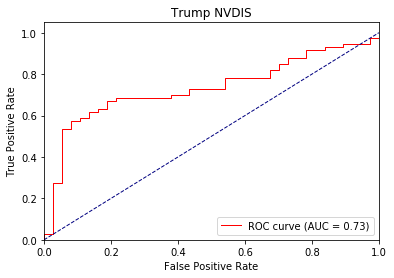

Directory already exists!
dt_nvdis1 2 ap tensor([0.8016, 0.9548]) loss : 0.6889582872390747 0.442500105399764 tid : 400 tg tensor([[0]], device='cuda:0')
TEST dt_nvdis1 2 ap tensor([0.5479, 0.8810]) loss : 0.16931915283203125 0.5287084510693183 tid : 120 tg tensor([[1]], device='cuda:0')
TEST dt_nvdis1 2 ap tensor([0.4697, 0.8947]) loss : 0.4356192946434021 0.5101545565837139 tid : 180 tg tensor([[1]], device='cuda:0')
TEST dt_nvdis1 2 ap tensor([0.4829, 0.9034]) loss : 1.522615671157837 0.5178132756632201 tid : 480 tg tensor([[0]], device='cuda:0')


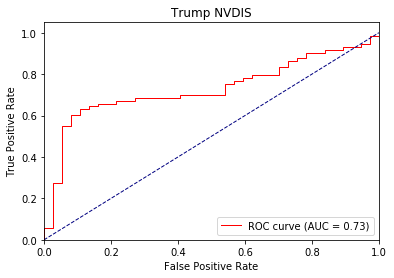

Directory already exists!
dt_lookat3 0 ap tensor([0.1414, 0.7740]) loss : 0.6132938265800476 0.7257932313850948 tid : 400 tg tensor([[1]], device='cuda:0')
TEST dt_lookat3 0 ap tensor([0.1026, 0.9378]) loss : 0.3467108905315399 0.5099095782408347 tid : 120 tg tensor([[1]], device='cuda:0')
TEST dt_lookat3 0 ap tensor([0.0742, 0.9576]) loss : 0.5534272193908691 0.49599399921056386 tid : 180 tg tensor([[1]], device='cuda:0')
TEST dt_lookat3 0 ap tensor([0.1131, 0.9535]) loss : 1.1742709875106812 0.502049097297143 tid : 480 tg tensor([[0]], device='cuda:0')


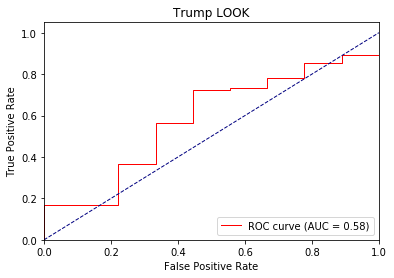

Directory already exists!
dt_lookat3 1 ap tensor([0.4187, 0.9386]) loss : 0.3949684202671051 0.5138081523505125 tid : 400 tg tensor([[1]], device='cuda:0')
TEST dt_lookat3 1 ap tensor([0.1043, 0.9443]) loss : 0.1980549693107605 0.42179812834813046 tid : 120 tg tensor([[1]], device='cuda:0')
TEST dt_lookat3 1 ap tensor([0.0757, 0.9598]) loss : 0.43553951382637024 0.3931097799056285 tid : 180 tg tensor([[1]], device='cuda:0')
TEST dt_lookat3 1 ap tensor([0.1492, 0.9608]) loss : 1.5359132289886475 0.3942085638338206 tid : 480 tg tensor([[0]], device='cuda:0')


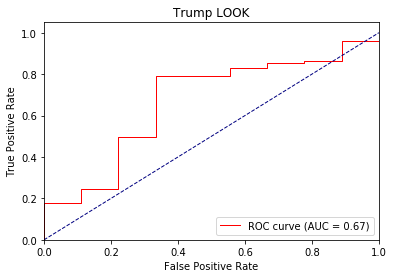

Directory already exists!
dt_lookat3 2 ap tensor([0.5700, 0.9598]) loss : 0.32514557242393494 0.44630845048679757 tid : 400 tg tensor([[1]], device='cuda:0')
TEST dt_lookat3 2 ap tensor([0.1088, 0.9466]) loss : 0.12254083156585693 0.37707259448675007 tid : 120 tg tensor([[1]], device='cuda:0')
TEST dt_lookat3 2 ap tensor([0.0833, 0.9640]) loss : 0.3518078923225403 0.33914247960657684 tid : 180 tg tensor([[1]], device='cuda:0')
TEST dt_lookat3 2 ap tensor([0.1528, 0.9639]) loss : 1.8589287996292114 0.3366307619274879 tid : 480 tg tensor([[0]], device='cuda:0')


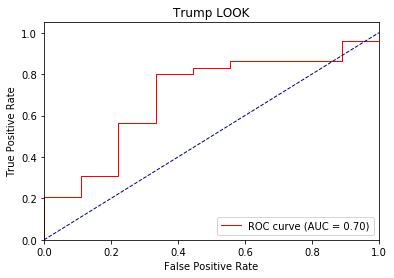

Directory already exists!
dt_eyebrow 0 ap tensor([0.1565, 0.9390]) loss : 0.48604705929756165 0.513224392911283 tid : 400 tg tensor([[1]], device='cuda:0')
TEST dt_eyebrow 0 ap tensor([0.6732, 0.6512]) loss : 0.4114047586917877 0.7382630499509665 tid : 120 tg tensor([[1]], device='cuda:0')
TEST dt_eyebrow 0 ap tensor([0.6499, 0.5995]) loss : 0.6788753867149353 0.7514202465882173 tid : 180 tg tensor([[1]], device='cuda:0')
TEST dt_eyebrow 0 ap tensor([0.5029, 0.5316]) loss : 1.0100700855255127 0.7505152067359613 tid : 480 tg tensor([[0]], device='cuda:0')


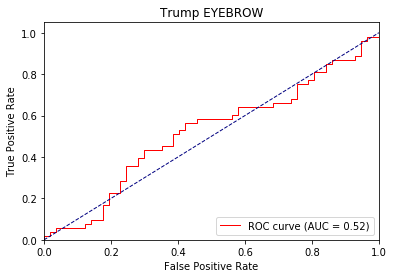

Directory already exists!
dt_eyebrow 1 ap tensor([0.1824, 0.9653]) loss : 0.3655592203140259 0.3637839028576635 tid : 400 tg tensor([[1]], device='cuda:0')
TEST dt_eyebrow 1 ap tensor([0.6683, 0.6673]) loss : 0.2610240578651428 0.8701018851536971 tid : 120 tg tensor([[1]], device='cuda:0')
TEST dt_eyebrow 1 ap tensor([0.6639, 0.6643]) loss : 0.5287622213363647 0.8819137553910952 tid : 180 tg tensor([[1]], device='cuda:0')
TEST dt_eyebrow 1 ap tensor([0.5054, 0.5580]) loss : 1.3434226512908936 0.8488253707788429 tid : 480 tg tensor([[0]], device='cuda:0')


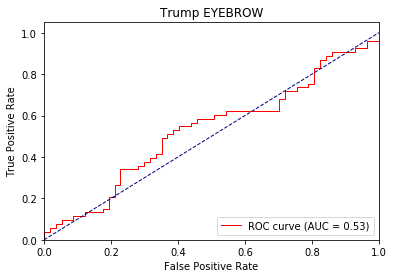

Directory already exists!
dt_eyebrow 2 ap tensor([0.5625, 0.9396]) loss : 0.28823786973953247 0.34113259400640217 tid : 400 tg tensor([[1]], device='cuda:0')
TEST dt_eyebrow 2 ap tensor([0.6766, 0.7126]) loss : 0.16910779476165771 0.9940381416907678 tid : 120 tg tensor([[1]], device='cuda:0')
TEST dt_eyebrow 2 ap tensor([0.6688, 0.7329]) loss : 0.43154966831207275 1.0094237134263322 tid : 180 tg tensor([[1]], device='cuda:0')
TEST dt_eyebrow 2 ap tensor([0.5137, 0.5955]) loss : 1.65262770652771 0.9479263163342768 tid : 480 tg tensor([[0]], device='cuda:0')


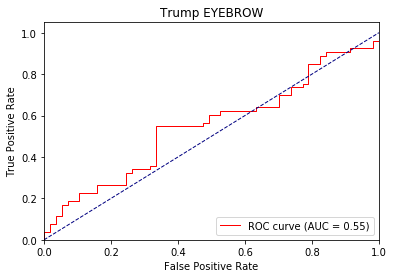

Directory already exists!
dt_atface 0 ap tensor([0.8161, 0.8952]) loss : 0.6065969467163086 0.609841172137986 tid : 400 tg tensor([[0]], device='cuda:0')
TEST dt_atface 0 ap tensor([0.4656, 0.8316]) loss : 0.4511905610561371 0.6231548660076581 tid : 120 tg tensor([[1]], device='cuda:0')
TEST dt_atface 0 ap tensor([0.4067, 0.8653]) loss : 0.8461370468139648 0.6169837221905992 tid : 180 tg tensor([[1]], device='cuda:0')
TEST dt_atface 0 ap tensor([0.5586, 0.8728]) loss : 0.7030795812606812 0.6044645662210426 tid : 480 tg tensor([[0]], device='cuda:0')


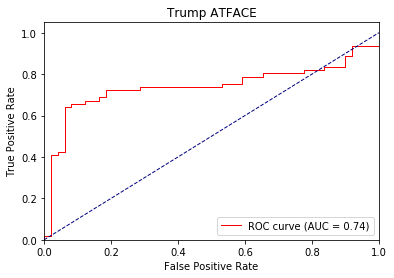

Directory already exists!
dt_atface 1 ap tensor([0.7588, 0.9041]) loss : 0.5155047178268433 0.4862938565267643 tid : 400 tg tensor([[0]], device='cuda:0')
TEST dt_atface 1 ap tensor([0.4650, 0.8349]) loss : 0.29666751623153687 0.5972026460445844 tid : 120 tg tensor([[1]], device='cuda:0')
TEST dt_atface 1 ap tensor([0.4173, 0.8731]) loss : 0.8753257393836975 0.588948424603488 tid : 180 tg tensor([[1]], device='cuda:0')
TEST dt_atface 1 ap tensor([0.5751, 0.8877]) loss : 0.8244298696517944 0.5544654286029388 tid : 480 tg tensor([[0]], device='cuda:0')


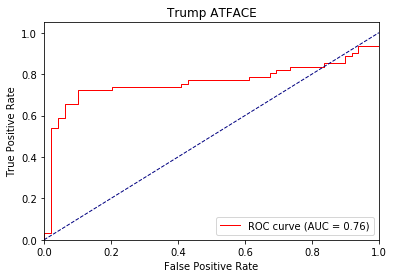

Directory already exists!
dt_atface 2 ap tensor([0.8288, 0.9368]) loss : 0.3889086842536926 0.395338603203817 tid : 400 tg tensor([[0]], device='cuda:0')
TEST dt_atface 2 ap tensor([0.4740, 0.8397]) loss : 0.21175527572631836 0.5929957353151761 tid : 120 tg tensor([[1]], device='cuda:0')
TEST dt_atface 2 ap tensor([0.4225, 0.8752]) loss : 0.9115843772888184 0.5829190233269254 tid : 180 tg tensor([[1]], device='cuda:0')
TEST dt_atface 2 ap tensor([0.5848, 0.8915]) loss : 0.9255028963088989 0.5302202668117018 tid : 480 tg tensor([[0]], device='cuda:0')


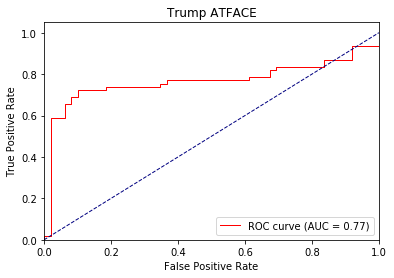

Directory already exists!
dt_feface 0 ap tensor([1., 0.]) loss : 0.282634437084198 0.5471590074009237 tid : 400 tg tensor([[0]], device='cuda:0')
TEST dt_feface 0 ap tensor([1., 0.]) loss : 0.39126017689704895 0.34297322080685544 tid : 120 tg tensor([[0]], device='cuda:0')
TEST dt_feface 0 ap tensor([1., 0.]) loss : 0.3936070203781128 0.3509007764829172 tid : 180 tg tensor([[0]], device='cuda:0')
TEST dt_feface 0 ap tensor([1., 0.]) loss : 0.4656563997268677 0.36518541921158226 tid : 480 tg tensor([[0]], device='cuda:0')


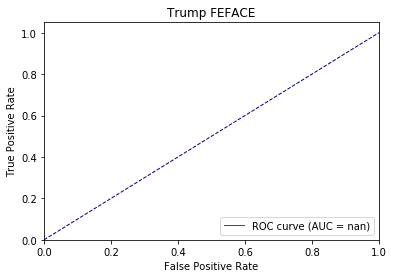

Directory already exists!
dt_feface 1 ap tensor([1., 0.]) loss : 0.13501590490341187 0.2596723159870228 tid : 400 tg tensor([[0]], device='cuda:0')
TEST dt_feface 1 ap tensor([1., 0.]) loss : 0.1872292160987854 0.15520313382148743 tid : 120 tg tensor([[0]], device='cuda:0')
TEST dt_feface 1 ap tensor([1., 0.]) loss : 0.2428492307662964 0.16296209676845655 tid : 180 tg tensor([[0]], device='cuda:0')
TEST dt_feface 1 ap tensor([1., 0.]) loss : 0.23906868696212769 0.1836492349298633 tid : 480 tg tensor([[0]], device='cuda:0')


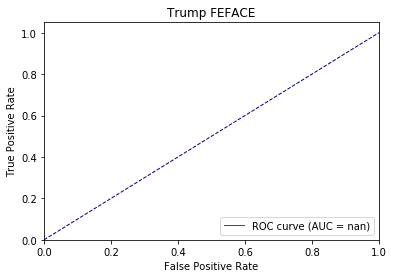

Directory already exists!
dt_feface 2 ap tensor([1., 0.]) loss : 0.05004429817199707 0.12309402485058699 tid : 400 tg tensor([[0]], device='cuda:0')
TEST dt_feface 2 ap tensor([1., 0.]) loss : 0.09236907958984375 0.07343533405890831 tid : 120 tg tensor([[0]], device='cuda:0')
TEST dt_feface 2 ap tensor([1., 0.]) loss : 0.14848005771636963 0.07875440732852833 tid : 180 tg tensor([[0]], device='cuda:0')
TEST dt_feface 2 ap tensor([1., 0.]) loss : 0.11624133586883545 0.09534487888521077 tid : 480 tg tensor([[0]], device='cuda:0')


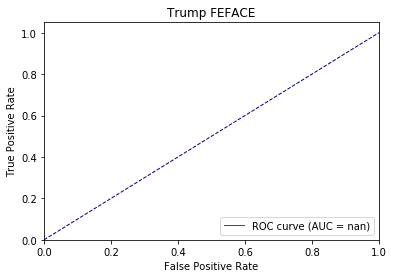

Directory already exists!
dt_hrface 0 ap tensor([0.9516, 0.1559]) loss : 0.4843106269836426 0.5798357304930687 tid : 400 tg tensor([[0]], device='cuda:0')
TEST dt_hrface 0 ap tensor([1., 0.]) loss : 0.394133985042572 0.37099811090872836 tid : 120 tg tensor([[0]], device='cuda:0')
TEST dt_hrface 0 ap tensor([0.9992, 0.5000]) loss : 0.5567902326583862 0.37780835821821884 tid : 180 tg tensor([[0]], device='cuda:0')
TEST dt_hrface 0 ap tensor([0.9956, 0.5239]) loss : 0.32333165407180786 0.39361841307610884 tid : 480 tg tensor([[0]], device='cuda:0')


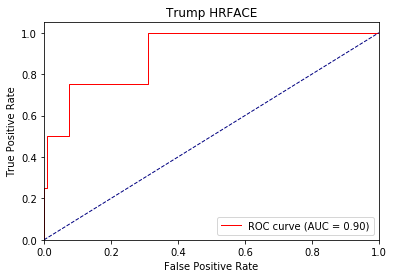

Directory already exists!
dt_hrface 1 ap tensor([0.9849, 0.5853]) loss : 0.2911757826805115 0.37404701043577754 tid : 400 tg tensor([[0]], device='cuda:0')
TEST dt_hrface 1 ap tensor([1., 0.]) loss : 0.22590219974517822 0.23009101702616766 tid : 120 tg tensor([[0]], device='cuda:0')
TEST dt_hrface 1 ap tensor([1., 1.]) loss : 0.40539002418518066 0.2444069756043924 tid : 180 tg tensor([[0]], device='cuda:0')
TEST dt_hrface 1 ap tensor([0.9955, 0.5910]) loss : 0.2038435935974121 0.270507882444226 tid : 480 tg tensor([[0]], device='cuda:0')


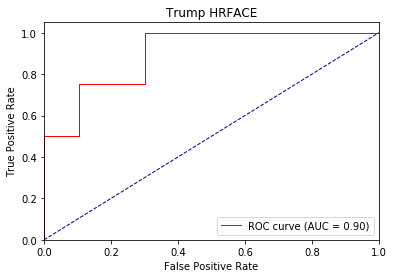

Directory already exists!
dt_hrface 2 ap tensor([0.9777, 0.6912]) loss : 0.20479243993759155 0.33718690356259706 tid : 400 tg tensor([[0]], device='cuda:0')
TEST dt_hrface 2 ap tensor([1., 0.]) loss : 0.14141523838043213 0.16570634222947633 tid : 120 tg tensor([[0]], device='cuda:0')
TEST dt_hrface 2 ap tensor([0.9992, 0.5000]) loss : 0.3215181827545166 0.18356019822326866 tid : 180 tg tensor([[0]], device='cuda:0')
TEST dt_hrface 2 ap tensor([0.9950, 0.4989]) loss : 0.14374315738677979 0.21309854455140173 tid : 480 tg tensor([[0]], device='cuda:0')


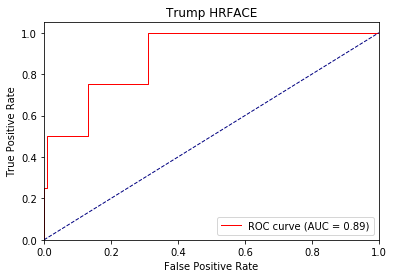

Directory already exists!
dt_saface 0 ap tensor([1., 0.]) loss : 0.5028197765350342 0.6117912833179746 tid : 400 tg tensor([[0]], device='cuda:0')
TEST dt_saface 0 ap tensor([1., 0.]) loss : 0.33575326204299927 0.32574868546082425 tid : 120 tg tensor([[0]], device='cuda:0')
TEST dt_saface 0 ap tensor([1., 0.]) loss : 0.5268000364303589 0.3362597364026147 tid : 180 tg tensor([[0]], device='cuda:0')
TEST dt_saface 0 ap tensor([1., 0.]) loss : 0.2836724519729614 0.3581313402677069 tid : 480 tg tensor([[0]], device='cuda:0')


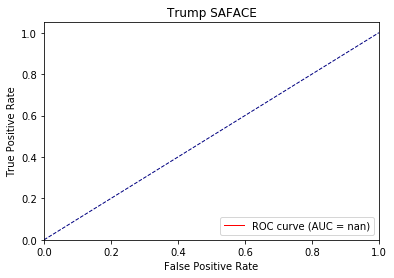

Directory already exists!
dt_saface 1 ap tensor([1., 0.]) loss : 0.2184816598892212 0.2592734077446897 tid : 400 tg tensor([[0]], device='cuda:0')
TEST dt_saface 1 ap tensor([1., 0.]) loss : 0.14850366115570068 0.1449185563967778 tid : 120 tg tensor([[0]], device='cuda:0')
TEST dt_saface 1 ap tensor([1., 0.]) loss : 0.288429319858551 0.15243588911520467 tid : 180 tg tensor([[0]], device='cuda:0')
TEST dt_saface 1 ap tensor([1., 0.]) loss : 0.1374906301498413 0.17929483676443295 tid : 480 tg tensor([[0]], device='cuda:0')


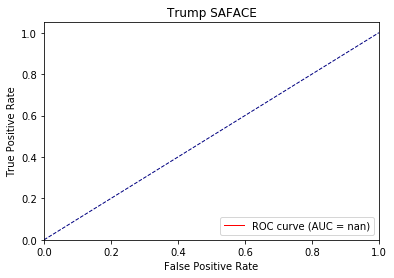

Directory already exists!
dt_saface 2 ap tensor([1., 0.]) loss : 0.10901081562042236 0.15319302678108215 tid : 400 tg tensor([[0]], device='cuda:0')
TEST dt_saface 2 ap tensor([1., 0.]) loss : 0.06836879253387451 0.0681041433260991 tid : 120 tg tensor([[0]], device='cuda:0')
TEST dt_saface 2 ap tensor([1., 0.]) loss : 0.1559234857559204 0.07207989692687988 tid : 180 tg tensor([[0]], device='cuda:0')
TEST dt_saface 2 ap tensor([1., 0.]) loss : 0.06660127639770508 0.09228859264023449 tid : 480 tg tensor([[0]], device='cuda:0')


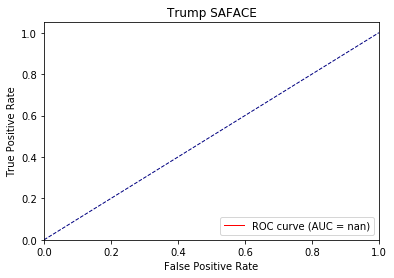

Directory already exists!
dt_neuface 0 ap tensor([0.9143, 0.4663]) loss : 0.8640648722648621 0.583106428650873 tid : 400 tg tensor([[1]], device='cuda:0')
TEST dt_neuface 0 ap tensor([0.8344, 0.3117]) loss : 0.3826345205307007 0.5933672327261704 tid : 120 tg tensor([[0]], device='cuda:0')
TEST dt_neuface 0 ap tensor([0.8780, 0.2642]) loss : 0.5228226184844971 0.553634305258055 tid : 180 tg tensor([[0]], device='cuda:0')
TEST dt_neuface 0 ap tensor([0.8626, 0.4498]) loss : 1.0260475873947144 0.6038253745254205 tid : 480 tg tensor([[1]], device='cuda:0')


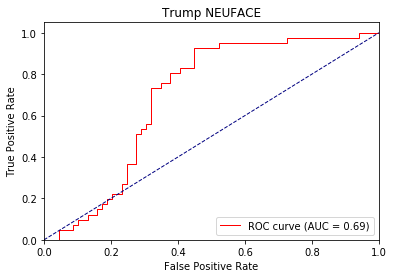

Directory already exists!
dt_neuface 1 ap tensor([0.9333, 0.6022]) loss : 0.8537212014198303 0.4868673730903948 tid : 400 tg tensor([[1]], device='cuda:0')
TEST dt_neuface 1 ap tensor([0.8301, 0.2866]) loss : 0.2535790801048279 0.5873309694803678 tid : 120 tg tensor([[0]], device='cuda:0')
TEST dt_neuface 1 ap tensor([0.8771, 0.2439]) loss : 0.5308477878570557 0.5412823122900885 tid : 180 tg tensor([[0]], device='cuda:0')
TEST dt_neuface 1 ap tensor([0.8722, 0.4514]) loss : 1.1981589794158936 0.585131474295441 tid : 480 tg tensor([[1]], device='cuda:0')


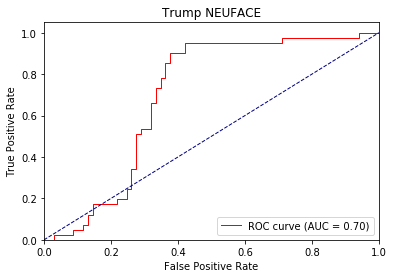

Directory already exists!
dt_neuface 2 ap tensor([0.9213, 0.6685]) loss : 0.7513048648834229 0.4670356207221519 tid : 400 tg tensor([[1]], device='cuda:0')
TEST dt_neuface 2 ap tensor([0.8271, 0.2820]) loss : 0.18407464027404785 0.5959819142635052 tid : 120 tg tensor([[0]], device='cuda:0')
TEST dt_neuface 2 ap tensor([0.8769, 0.2428]) loss : 0.5432677268981934 0.5454078397235355 tid : 180 tg tensor([[0]], device='cuda:0')
TEST dt_neuface 2 ap tensor([0.8718, 0.4477]) loss : 1.3433599472045898 0.5808080638549766 tid : 480 tg tensor([[1]], device='cuda:0')


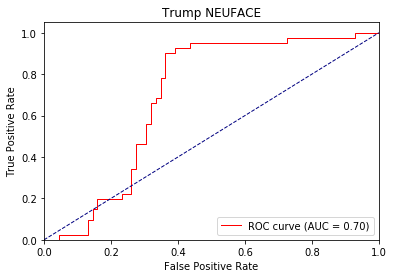

Directory already exists!
dt_inapprop 0 ap tensor([0.9567, 0.0337]) loss : 0.4848294258117676 0.580798809050586 tid : 400 tg tensor([[0]], device='cuda:0')
TEST dt_inapprop 0 ap tensor([1., 0.]) loss : 0.2492053210735321 0.3423796846316411 tid : 120 tg tensor([[0]], device='cuda:0')
TEST dt_inapprop 0 ap tensor([0.8225, 0.3007]) loss : 0.8316043019294739 0.5292161493688017 tid : 180 tg tensor([[1]], device='cuda:0')
TEST dt_inapprop 0 ap tensor([0.8230, 0.1464]) loss : 0.3332531452178955 0.4756648263760975 tid : 480 tg tensor([[0]], device='cuda:0')


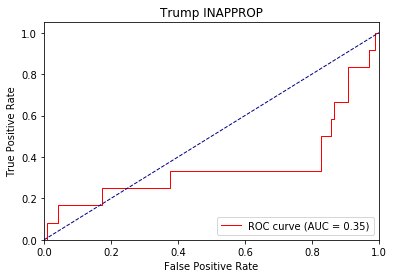

Directory already exists!
dt_inapprop 1 ap tensor([0.9671, 0.0490]) loss : 0.21137112379074097 0.3239968551177505 tid : 400 tg tensor([[0]], device='cuda:0')
TEST dt_inapprop 1 ap tensor([1., 0.]) loss : 0.14515447616577148 0.17626897417582 tid : 120 tg tensor([[0]], device='cuda:0')
TEST dt_inapprop 1 ap tensor([0.8486, 0.3274]) loss : 1.1760239601135254 0.49683850520365946 tid : 180 tg tensor([[1]], device='cuda:0')
TEST dt_inapprop 1 ap tensor([0.8453, 0.1486]) loss : 0.18018841743469238 0.3904684699919759 tid : 480 tg tensor([[0]], device='cuda:0')


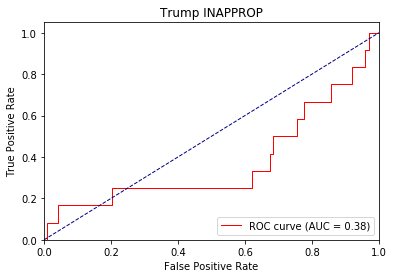

Directory already exists!
dt_inapprop 2 ap tensor([0.9809, 0.0763]) loss : 0.07450282573699951 0.21281993529986387 tid : 400 tg tensor([[0]], device='cuda:0')
TEST dt_inapprop 2 ap tensor([1., 0.]) loss : 0.09336704015731812 0.10132120320430169 tid : 120 tg tensor([[0]], device='cuda:0')
TEST dt_inapprop 2 ap tensor([0.9015, 0.3029]) loss : 1.5158382654190063 0.5201533976438883 tid : 180 tg tensor([[1]], device='cuda:0')
TEST dt_inapprop 2 ap tensor([0.8841, 0.1323]) loss : 0.10491371154785156 0.36856062010842927 tid : 480 tg tensor([[0]], device='cuda:0')


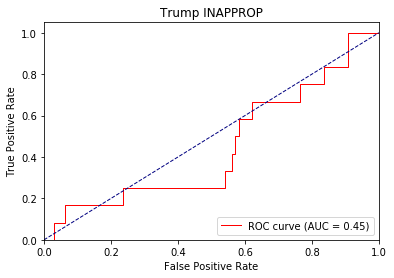

Directory already exists!
dt_affgest 0 ap tensor([0.9794, 0.0333]) loss : 0.6240527033805847 0.7263392510714831 tid : 400 tg tensor([[0]], device='cuda:0')
TEST dt_affgest 0 ap tensor([1., 0.]) loss : 0.4295467436313629 0.4156628239613313 tid : 120 tg tensor([[0]], device='cuda:0')
TEST dt_affgest 0 ap tensor([1., 0.]) loss : 0.5247279405593872 0.43487537793211034 tid : 180 tg tensor([[0]], device='cuda:0')
TEST dt_affgest 0 ap tensor([1., 0.]) loss : 0.5095797181129456 0.4754289628899827 tid : 480 tg tensor([[0]], device='cuda:0')


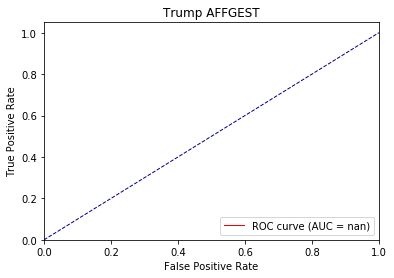

Directory already exists!
dt_affgest 1 ap tensor([0.9808, 0.0505]) loss : 0.303011417388916 0.38477793648358316 tid : 400 tg tensor([[0]], device='cuda:0')
TEST dt_affgest 1 ap tensor([1., 0.]) loss : 0.26133233308792114 0.2308827844949869 tid : 120 tg tensor([[0]], device='cuda:0')
TEST dt_affgest 1 ap tensor([1., 0.]) loss : 0.3804912567138672 0.2496096362938752 tid : 180 tg tensor([[0]], device='cuda:0')
TEST dt_affgest 1 ap tensor([1., 0.]) loss : 0.3248005509376526 0.2933943000983219 tid : 480 tg tensor([[0]], device='cuda:0')


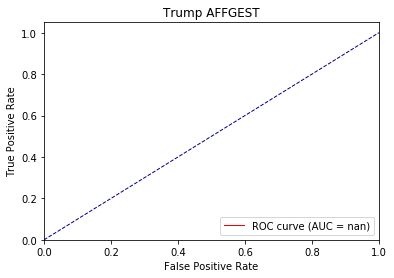

Directory already exists!
dt_affgest 2 ap tensor([0.9807, 0.0581]) loss : 0.11444371938705444 0.24067387749547484 tid : 400 tg tensor([[0]], device='cuda:0')
TEST dt_affgest 2 ap tensor([1., 0.]) loss : 0.17262083292007446 0.13944111993679634 tid : 120 tg tensor([[0]], device='cuda:0')
TEST dt_affgest 2 ap tensor([1., 0.]) loss : 0.27952009439468384 0.15603853882970037 tid : 180 tg tensor([[0]], device='cuda:0')
TEST dt_affgest 2 ap tensor([1., 0.]) loss : 0.21936368942260742 0.1952714448680683 tid : 480 tg tensor([[0]], device='cuda:0')


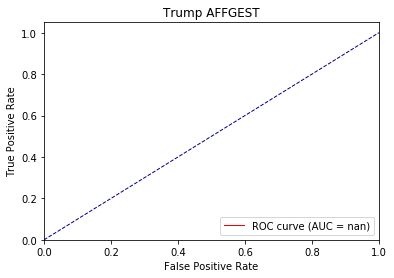

Directory already exists!
dt_defgest 0 ap tensor([0.6835, 0.3691]) loss : 0.4480340778827667 0.6970607234537601 tid : 400 tg tensor([[0]], device='cuda:0')
TEST dt_defgest 0 ap tensor([0.9671, 0.3917]) loss : 0.9846681356430054 0.5225036316193067 tid : 120 tg tensor([[1]], device='cuda:0')
TEST dt_defgest 0 ap tensor([0.9147, 0.6148]) loss : 1.1024892330169678 0.5672532303913219 tid : 180 tg tensor([[1]], device='cuda:0')
TEST dt_defgest 0 ap tensor([0.7963, 0.4623]) loss : 0.5457311868667603 0.6221041001227438 tid : 480 tg tensor([[0]], device='cuda:0')


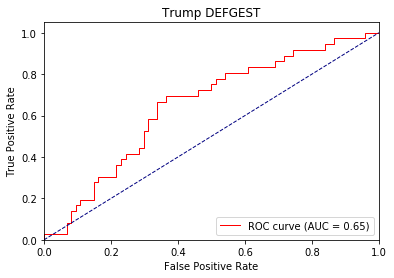

Directory already exists!
dt_defgest 1 ap tensor([0.9358, 0.5197]) loss : 0.34327471256256104 0.5710682681313267 tid : 400 tg tensor([[0]], device='cuda:0')
TEST dt_defgest 1 ap tensor([0.9807, 0.6000]) loss : 0.8996825814247131 0.43977730434674484 tid : 120 tg tensor([[1]], device='cuda:0')
TEST dt_defgest 1 ap tensor([0.9512, 0.7321]) loss : 1.2578245401382446 0.4934690554399748 tid : 180 tg tensor([[1]], device='cuda:0')
TEST dt_defgest 1 ap tensor([0.8855, 0.6112]) loss : 0.5457899570465088 0.5668495829616275 tid : 480 tg tensor([[0]], device='cuda:0')


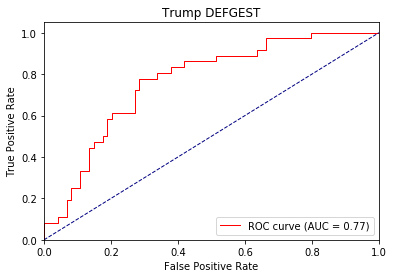

Directory already exists!
dt_defgest 2 ap tensor([0.9169, 0.6840]) loss : 0.20940947532653809 0.48974833152321884 tid : 400 tg tensor([[0]], device='cuda:0')
TEST dt_defgest 2 ap tensor([0.9867, 0.6679]) loss : 0.830103874206543 0.3914086658221025 tid : 120 tg tensor([[1]], device='cuda:0')
TEST dt_defgest 2 ap tensor([0.9601, 0.7565]) loss : 1.38174569606781 0.45028402032078924 tid : 180 tg tensor([[1]], device='cuda:0')
TEST dt_defgest 2 ap tensor([0.9005, 0.6486]) loss : 0.5520215034484863 0.5323312708309719 tid : 480 tg tensor([[0]], device='cuda:0')


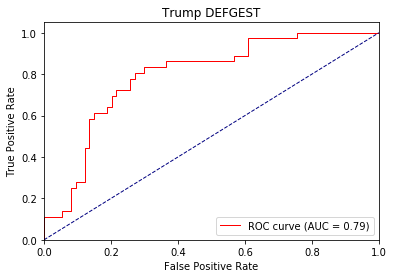

Directory already exists!
dt_agentic 0 ap tensor([0.5247, 0.7595]) loss : 0.7389342784881592 0.6612837202457601 tid : 400 tg tensor([[0]], device='cuda:0')
TEST dt_agentic 0 ap tensor([1., 1.]) loss : 0.3733997344970703 0.6047988797609622 tid : 120 tg tensor([[1]], device='cuda:0')
TEST dt_agentic 0 ap tensor([0.8886, 0.9618]) loss : 0.48822975158691406 0.5983365419748667 tid : 180 tg tensor([[1]], device='cuda:0')
TEST dt_agentic 0 ap tensor([0.7915, 0.8711]) loss : 1.0314862728118896 0.6341415327422473 tid : 480 tg tensor([[0]], device='cuda:0')


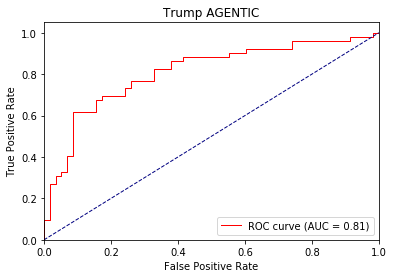

Directory already exists!
dt_agentic 1 ap tensor([0.8974, 0.9574]) loss : 0.6548870801925659 0.4837011224058665 tid : 400 tg tensor([[0]], device='cuda:0')
TEST dt_agentic 1 ap tensor([1., 1.]) loss : 0.22807353734970093 0.5093913571192668 tid : 120 tg tensor([[1]], device='cuda:0')
TEST dt_agentic 1 ap tensor([0.8633, 0.9617]) loss : 0.5078160762786865 0.5136772160594528 tid : 180 tg tensor([[1]], device='cuda:0')
TEST dt_agentic 1 ap tensor([0.8263, 0.9312]) loss : 1.235252857208252 0.5677646447201165 tid : 480 tg tensor([[0]], device='cuda:0')


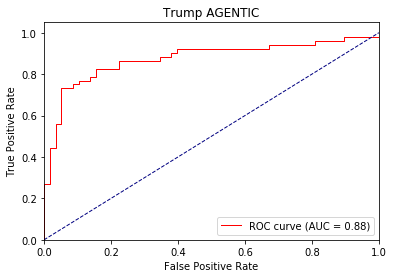

Directory already exists!
dt_agentic 2 ap tensor([0.9000, 0.9567]) loss : 0.5426703691482544 0.3888151780322746 tid : 400 tg tensor([[0]], device='cuda:0')
TEST dt_agentic 2 ap tensor([1., 1.]) loss : 0.146187424659729 0.4564636957186919 tid : 120 tg tensor([[1]], device='cuda:0')
TEST dt_agentic 2 ap tensor([0.8633, 0.9617]) loss : 0.5242049694061279 0.4706062279842995 tid : 180 tg tensor([[1]], device='cuda:0')
TEST dt_agentic 2 ap tensor([0.8357, 0.9361]) loss : 1.424817442893982 0.535146774990218 tid : 480 tg tensor([[0]], device='cuda:0')


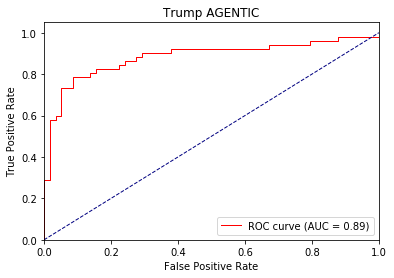

Directory already exists!
dt_waveoff 0 ap tensor([1., 0.]) loss : 0.15368330478668213 0.34384032896184547 tid : 400 tg tensor([[0]], device='cuda:0')
TEST dt_waveoff 0 ap tensor([0.8927, 0.2844]) loss : 1.0584657192230225 0.3550145637530547 tid : 120 tg tensor([[1]], device='cuda:0')
TEST dt_waveoff 0 ap tensor([0.8976, 0.4855]) loss : 0.33474236726760864 0.4314056135512687 tid : 180 tg tensor([[0]], device='cuda:0')
TEST dt_waveoff 0 ap tensor([0.9380, 0.1012]) loss : 0.3815326690673828 0.37177469444518185 tid : 480 tg tensor([[0]], device='cuda:0')


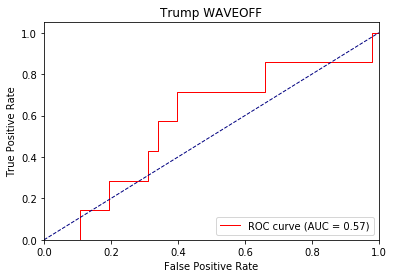

Directory already exists!
dt_waveoff 1 ap tensor([1., 0.]) loss : 0.06301426887512207 0.15754441834428023 tid : 400 tg tensor([[0]], device='cuda:0')
TEST dt_waveoff 1 ap tensor([0.9034, 0.2480]) loss : 1.7682955265045166 0.34835556837228626 tid : 120 tg tensor([[1]], device='cuda:0')
TEST dt_waveoff 1 ap tensor([0.8875, 0.3538]) loss : 0.1731155514717102 0.4824891283705428 tid : 180 tg tensor([[0]], device='cuda:0')
TEST dt_waveoff 1 ap tensor([0.9320, 0.0859]) loss : 0.1828518509864807 0.2895376405545643 tid : 480 tg tensor([[0]], device='cuda:0')


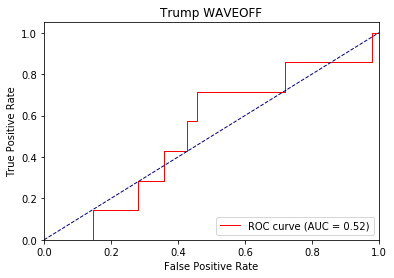

Directory already exists!
dt_waveoff 2 ap tensor([1., 0.]) loss : 0.03293311595916748 0.07380956576930152 tid : 400 tg tensor([[0]], device='cuda:0')
TEST dt_waveoff 2 ap tensor([0.9157, 0.1843]) loss : 2.6142477989196777 0.4064532953959245 tid : 120 tg tensor([[1]], device='cuda:0')
TEST dt_waveoff 2 ap tensor([0.8915, 0.3091]) loss : 0.08868420124053955 0.6005639546626323 tid : 180 tg tensor([[0]], device='cuda:0')
TEST dt_waveoff 2 ap tensor([0.9315, 0.0773]) loss : 0.08363199234008789 0.283005673970495 tid : 480 tg tensor([[0]], device='cuda:0')


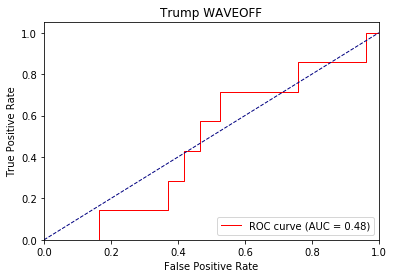

Directory already exists!
dt_nvtic1 0 ap tensor([0.8126, 0.1033]) loss : 0.3832392692565918 0.6655531029176452 tid : 400 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic1 0 ap tensor([0.7027, 0.2355]) loss : 0.5883959531784058 0.6322628626456628 tid : 120 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic1 0 ap tensor([0.7677, 0.1572]) loss : 0.6742974519729614 0.5822164867375348 tid : 180 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic1 0 ap tensor([0.8420, 0.0923]) loss : 1.0139135122299194 0.5741881770747048 tid : 480 tg tensor([[1]], device='cuda:0')


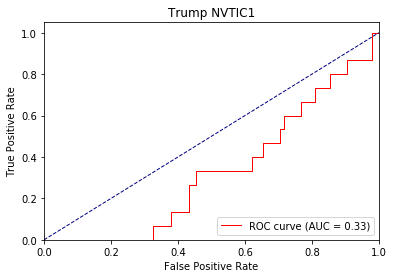

Directory already exists!
dt_nvtic1 1 ap tensor([0.9130, 0.1920]) loss : 0.3049975633621216 0.4633993124021851 tid : 400 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic1 1 ap tensor([0.8000, 0.3059]) loss : 0.323000431060791 0.5994220903286567 tid : 120 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic1 1 ap tensor([0.8437, 0.2108]) loss : 0.5818628072738647 0.5124435368421916 tid : 180 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic1 1 ap tensor([0.8806, 0.1167]) loss : 1.321170449256897 0.4657348582939226 tid : 480 tg tensor([[1]], device='cuda:0')


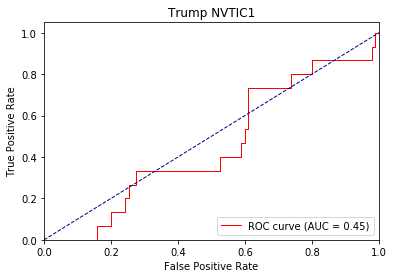

Directory already exists!
dt_nvtic1 2 ap tensor([0.9601, 0.3469]) loss : 0.25546276569366455 0.384407675557438 tid : 400 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic1 2 ap tensor([0.8301, 0.3256]) loss : 0.2006884217262268 0.6033318432477804 tid : 120 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic1 2 ap tensor([0.8692, 0.2331]) loss : 0.5198884010314941 0.4920761641618368 tid : 180 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic1 2 ap tensor([0.9054, 0.1440]) loss : 1.5827610492706299 0.41448979140544423 tid : 480 tg tensor([[1]], device='cuda:0')


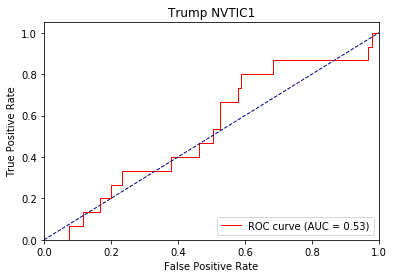

Directory already exists!
dt_nvtic2 0 ap tensor([0.9318, 0.1828]) loss : 0.4911643862724304 0.5874665641906001 tid : 400 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic2 0 ap tensor([0.7170, 0.3284]) loss : 0.4117380678653717 0.6448962080937165 tid : 120 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic2 0 ap tensor([0.7556, 0.2711]) loss : 0.570791482925415 0.6013760091485204 tid : 180 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic2 0 ap tensor([0.8570, 0.1827]) loss : 0.9619492292404175 0.5542336510760444 tid : 480 tg tensor([[1]], device='cuda:0')


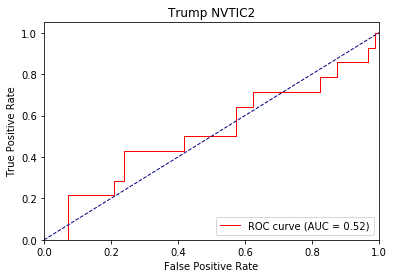

Directory already exists!
dt_nvtic2 1 ap tensor([0.9418, 0.2171]) loss : 0.36539533734321594 0.4561495349939126 tid : 400 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic2 1 ap tensor([0.7143, 0.3510]) loss : 0.26181405782699585 0.6267686188220978 tid : 120 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic2 1 ap tensor([0.7517, 0.2793]) loss : 0.461361289024353 0.5617924066814216 tid : 180 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic2 1 ap tensor([0.8566, 0.2045]) loss : 1.2540751695632935 0.4656181767278788 tid : 480 tg tensor([[1]], device='cuda:0')


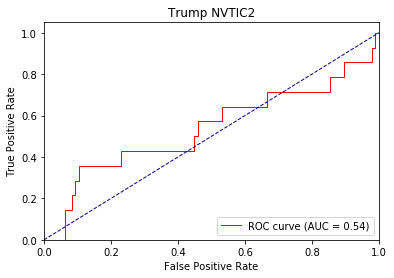

Directory already exists!
dt_nvtic2 2 ap tensor([0.9445, 0.3583]) loss : 0.257129430770874 0.3670153942975131 tid : 400 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic2 2 ap tensor([0.7174, 0.3538]) loss : 0.17751610279083252 0.6443391052576212 tid : 120 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic2 2 ap tensor([0.7572, 0.2950]) loss : 0.39472681283950806 0.5636436971458229 tid : 180 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic2 2 ap tensor([0.8600, 0.2244]) loss : 1.5134533643722534 0.42832373204279917 tid : 480 tg tensor([[1]], device='cuda:0')


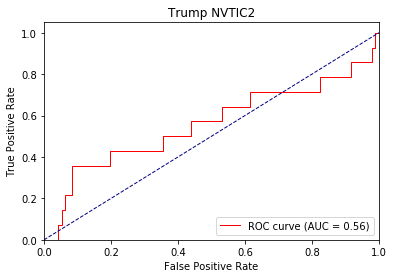

Directory already exists!
dt_nvtic3 0 ap tensor([0.5922, 0.7774]) loss : 0.5592314004898071 0.6590563823518 tid : 400 tg tensor([[1]], device='cuda:0')
TEST dt_nvtic3 0 ap tensor([1., 1.]) loss : 0.44675207138061523 0.6335242493794515 tid : 120 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic3 0 ap tensor([0.6826, 0.9904]) loss : 0.615383505821228 0.6465496718883514 tid : 180 tg tensor([[1]], device='cuda:0')
TEST dt_nvtic3 0 ap tensor([0.6695, 0.8618]) loss : 0.7003323435783386 0.6365763958619566 tid : 480 tg tensor([[1]], device='cuda:0')


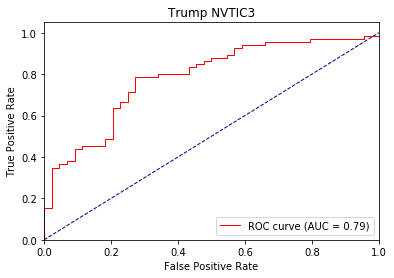

Directory already exists!
dt_nvtic3 1 ap tensor([0.7857, 0.8979]) loss : 0.46658116579055786 0.5656335282104986 tid : 400 tg tensor([[1]], device='cuda:0')
TEST dt_nvtic3 1 ap tensor([1., 1.]) loss : 0.3667134642601013 0.5843662436191852 tid : 120 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic3 1 ap tensor([0.6686, 0.9880]) loss : 0.5474526882171631 0.6058773994445801 tid : 180 tg tensor([[1]], device='cuda:0')
TEST dt_nvtic3 1 ap tensor([0.6882, 0.8688]) loss : 0.6981906890869141 0.5968279902424131 tid : 480 tg tensor([[1]], device='cuda:0')


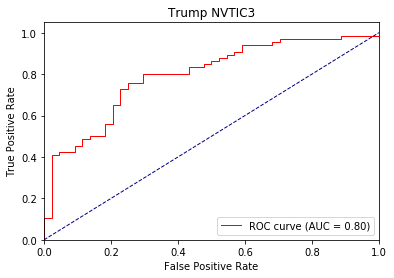

Directory already exists!
dt_nvtic3 2 ap tensor([0.7999, 0.8905]) loss : 0.29365840554237366 0.5091141538742261 tid : 400 tg tensor([[1]], device='cuda:0')
TEST dt_nvtic3 2 ap tensor([1., 1.]) loss : 0.3128780126571655 0.5648836951989394 tid : 120 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic3 2 ap tensor([0.6686, 0.9880]) loss : 0.5147552490234375 0.5927889322912371 tid : 180 tg tensor([[1]], device='cuda:0')
TEST dt_nvtic3 2 ap tensor([0.6898, 0.8698]) loss : 0.6977208256721497 0.5776417483480609 tid : 480 tg tensor([[1]], device='cuda:0')


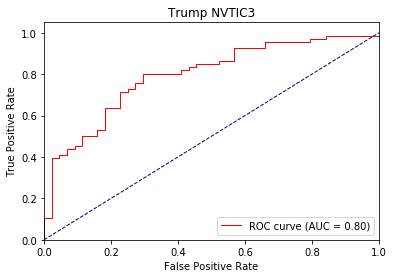

Directory already exists!
dt_nvtic5 0 ap tensor([0.9944, 0.0479]) loss : 0.3271215260028839 0.4988576521214686 tid : 400 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic5 0 ap tensor([0.9969, 0.3333]) loss : 0.21512442827224731 0.29396474476043993 tid : 120 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic5 0 ap tensor([0.9952, 0.3250]) loss : 0.3207261562347412 0.3033714729386407 tid : 180 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic5 0 ap tensor([0.9980, 0.1409]) loss : 0.3132445216178894 0.2924053547333698 tid : 480 tg tensor([[0]], device='cuda:0')


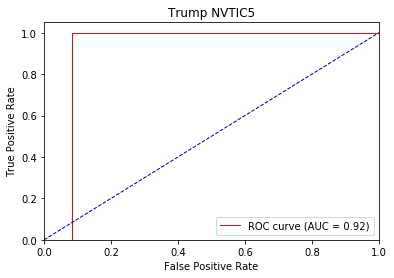

Directory already exists!
dt_nvtic5 1 ap tensor([0.9969, 0.1479]) loss : 0.15336507558822632 0.27609331976352053 tid : 400 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic5 1 ap tensor([0.9969, 0.3333]) loss : 0.11381852626800537 0.18958176099337065 tid : 120 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic5 1 ap tensor([0.9952, 0.3333]) loss : 0.20867401361465454 0.21432637362866788 tid : 180 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic5 1 ap tensor([0.9965, 0.0883]) loss : 0.16303682327270508 0.18374939171635374 tid : 480 tg tensor([[0]], device='cuda:0')


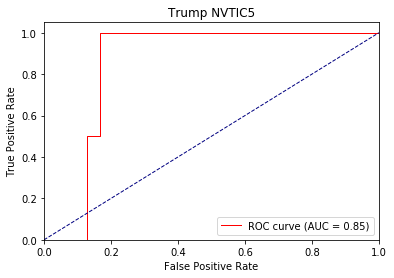

Directory already exists!
dt_nvtic5 2 ap tensor([1., 0.]) loss : 0.12164348363876343 0.1462705135345459 tid : 400 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic5 2 ap tensor([0.9935, 0.2000]) loss : 0.06387388706207275 0.15392372470635635 tid : 120 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic5 2 ap tensor([0.9917, 0.2250]) loss : 0.14024126529693604 0.18576164020074382 tid : 180 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic5 2 ap tensor([0.9955, 0.0713]) loss : 0.08482551574707031 0.13435568432418668 tid : 480 tg tensor([[0]], device='cuda:0')


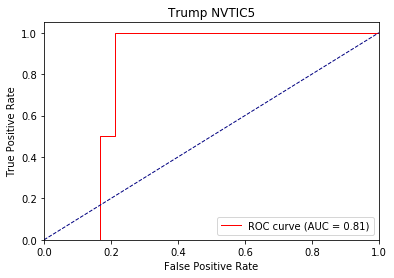

Directory already exists!
dt_nvtic4 0 ap tensor([0.9796, 0.1755]) loss : 0.6857252717018127 0.6584577528081199 tid : 400 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic4 0 ap tensor([0.9443, 0.1043]) loss : 0.34419578313827515 0.43149297741743237 tid : 120 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic4 0 ap tensor([0.9596, 0.0729]) loss : 0.4748598635196686 0.4149356258882059 tid : 180 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic4 0 ap tensor([0.9715, 0.0332]) loss : 0.2805248498916626 0.4137690161563912 tid : 480 tg tensor([[0]], device='cuda:0')


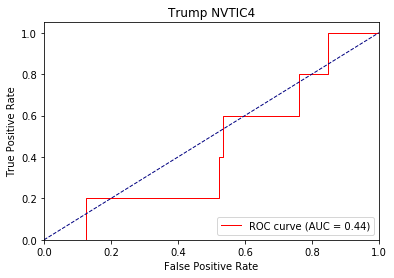

Directory already exists!
dt_nvtic4 1 ap tensor([0.9818, 0.1770]) loss : 0.3310590386390686 0.34774885401129724 tid : 400 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic4 1 ap tensor([0.9516, 0.1121]) loss : 0.19493740797042847 0.3238941293496352 tid : 120 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic4 1 ap tensor([0.9649, 0.0789]) loss : 0.3114132285118103 0.2893993822303978 tid : 180 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic4 1 ap tensor([0.9683, 0.0306]) loss : 0.15654999017715454 0.2719100312310822 tid : 480 tg tensor([[0]], device='cuda:0')


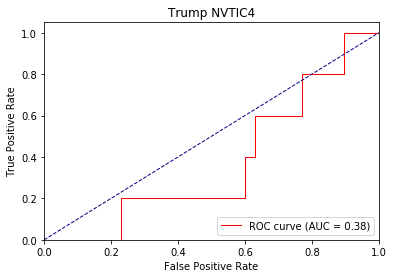

Directory already exists!
dt_nvtic4 2 ap tensor([0.9762, 0.1572]) loss : 0.1171879768371582 0.19783249378204346 tid : 400 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic4 2 ap tensor([0.9516, 0.1121]) loss : 0.11712610721588135 0.2907469180914072 tid : 120 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic4 2 ap tensor([0.9649, 0.0789]) loss : 0.21672838926315308 0.2424375962566685 tid : 180 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic4 2 ap tensor([0.9693, 0.0310]) loss : 0.09439873695373535 0.2084499512399946 tid : 480 tg tensor([[0]], device='cuda:0')


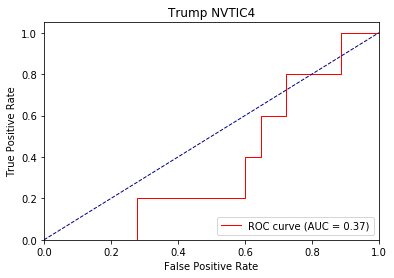

Directory already exists!
dt_interruptions 0 ap tensor([0.8983, 0.0596]) loss : 0.511186957359314 0.609983839173066 tid : 400 tg tensor([[0]], device='cuda:0')
TEST dt_interruptions 0 ap tensor([1., 0.]) loss : 0.33182013034820557 0.3340230962404838 tid : 120 tg tensor([[0]], device='cuda:0')
TEST dt_interruptions 0 ap tensor([0.9624, 0.1308]) loss : 0.477247029542923 0.41030441103754817 tid : 180 tg tensor([[0]], device='cuda:0')
TEST dt_interruptions 0 ap tensor([0.9571, 0.0701]) loss : 0.383312463760376 0.40080160358730627 tid : 480 tg tensor([[0]], device='cuda:0')


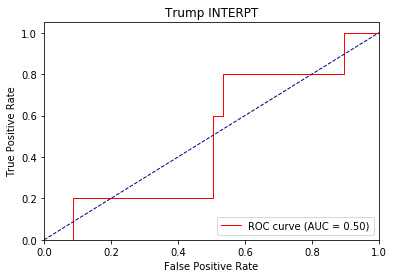

Directory already exists!
dt_interruptions 1 ap tensor([0.9663, 0.0981]) loss : 0.19765698909759521 0.31651700807819316 tid : 400 tg tensor([[0]], device='cuda:0')
TEST dt_interruptions 1 ap tensor([1., 0.]) loss : 0.20593875646591187 0.20303784310817719 tid : 120 tg tensor([[0]], device='cuda:0')
TEST dt_interruptions 1 ap tensor([0.9583, 0.1204]) loss : 0.33903634548187256 0.3264060189595094 tid : 180 tg tensor([[0]], device='cuda:0')
TEST dt_interruptions 1 ap tensor([0.9458, 0.0523]) loss : 0.24584907293319702 0.3016540511530273 tid : 480 tg tensor([[0]], device='cuda:0')


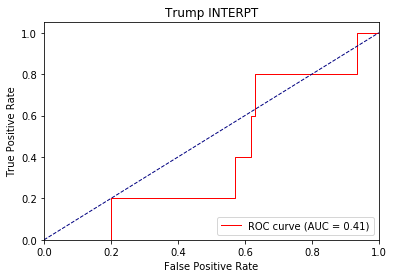

Directory already exists!
dt_interruptions 2 ap tensor([1., 0.]) loss : 0.19104671478271484 0.1969984531402588 tid : 400 tg tensor([[0]], device='cuda:0')
TEST dt_interruptions 2 ap tensor([1., 0.]) loss : 0.13884294033050537 0.14375623831382164 tid : 120 tg tensor([[0]], device='cuda:0')
TEST dt_interruptions 2 ap tensor([0.9561, 0.1170]) loss : 0.260681688785553 0.30382612428149663 tid : 180 tg tensor([[0]], device='cuda:0')
TEST dt_interruptions 2 ap tensor([0.9414, 0.0494]) loss : 0.1776740550994873 0.2617434214572517 tid : 480 tg tensor([[0]], device='cuda:0')


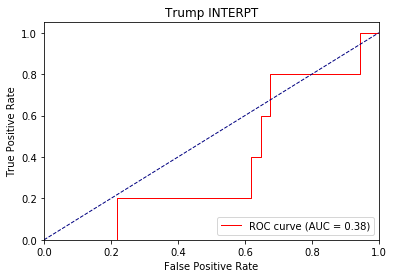

Directory already exists!
TEST dt_lookat2 0 ap tensor([0.7400, 0.8901]) loss : 0.38433969020843506 0.5871045197311201 tid : 300 tg tensor([[1]], device='cuda:0')
TEST dt_lookat2 0 ap tensor([0.7550, 0.8540]) loss : 0.4740299880504608 0.5994136083126068 tid : 390 tg tensor([[0]], device='cuda:0')
TEST dt_lookat2 0 ap tensor([0.7040, 0.7714]) loss : 0.5850716233253479 0.6201347804185257 tid : 510 tg tensor([[0]], device='cuda:0')


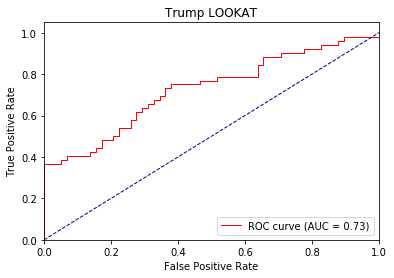

Directory already exists!
TEST dt_lookat2 1 ap tensor([0.7662, 0.8943]) loss : 0.2574344277381897 0.5424841736492357 tid : 300 tg tensor([[1]], device='cuda:0')
TEST dt_lookat2 1 ap tensor([0.7661, 0.8596]) loss : 0.3497462868690491 0.5631056753794352 tid : 390 tg tensor([[0]], device='cuda:0')
TEST dt_lookat2 1 ap tensor([0.7220, 0.7774]) loss : 0.5573878288269043 0.5941742195666415 tid : 510 tg tensor([[0]], device='cuda:0')


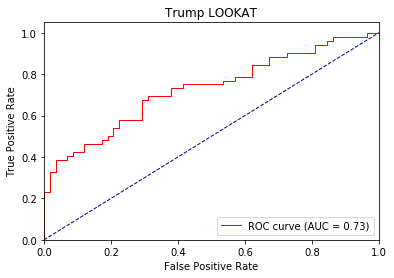

Directory already exists!
TEST dt_lookat2 2 ap tensor([0.7761, 0.8962]) loss : 0.19064098596572876 0.5186728516168762 tid : 300 tg tensor([[1]], device='cuda:0')
TEST dt_lookat2 2 ap tensor([0.7704, 0.8620]) loss : 0.27355003356933594 0.5448052668571473 tid : 390 tg tensor([[0]], device='cuda:0')
TEST dt_lookat2 2 ap tensor([0.7343, 0.7806]) loss : 0.5524893999099731 0.5839976341400331 tid : 510 tg tensor([[0]], device='cuda:0')


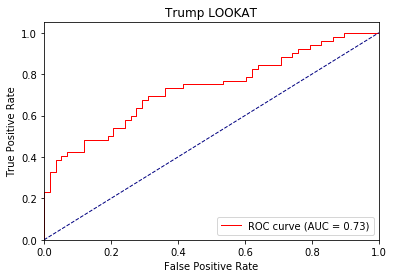

Directory already exists!
TEST dt_brush1 0 ap tensor([0.9620, 0.0421]) loss : 1.3084194660186768 0.4690314118276563 tid : 300 tg tensor([[1]], device='cuda:0')
TEST dt_brush1 0 ap tensor([0.9544, 0.0720]) loss : 0.5580712556838989 0.4939156095186869 tid : 390 tg tensor([[0]], device='cuda:0')
TEST dt_brush1 0 ap tensor([0.9619, 0.0458]) loss : 0.39717647433280945 0.50182354565963 tid : 510 tg tensor([[0]], device='cuda:0')


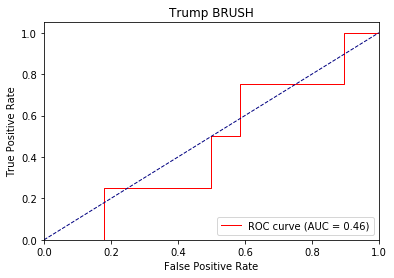

Directory already exists!
TEST dt_brush1 1 ap tensor([0.9763, 0.0705]) loss : 1.6647160053253174 0.32339197397232056 tid : 300 tg tensor([[1]], device='cuda:0')
TEST dt_brush1 1 ap tensor([0.9691, 0.0986]) loss : 0.310843288898468 0.35288252830505373 tid : 390 tg tensor([[0]], device='cuda:0')
TEST dt_brush1 1 ap tensor([0.9753, 0.0639]) loss : 0.26094913482666016 0.35154847352250107 tid : 510 tg tensor([[0]], device='cuda:0')


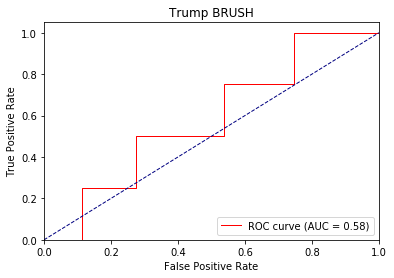

Directory already exists!
TEST dt_brush1 2 ap tensor([0.9849, 0.0889]) loss : 1.9262959957122803 0.2519448007407941 tid : 300 tg tensor([[1]], device='cuda:0')
TEST dt_brush1 2 ap tensor([0.9765, 0.1081]) loss : 0.1815342903137207 0.28492010752360025 tid : 390 tg tensor([[0]], device='cuda:0')
TEST dt_brush1 2 ap tensor([0.9809, 0.0720]) loss : 0.18317753076553345 0.2765109122378155 tid : 510 tg tensor([[0]], device='cuda:0')


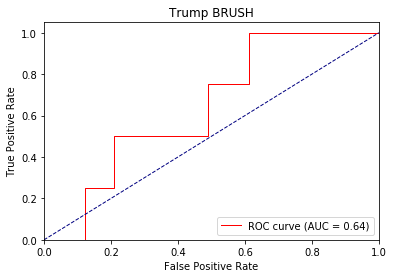

Directory already exists!
TEST dt_nvdis1 0 ap tensor([0.4304, 0.8930]) loss : 0.7032663822174072 0.5615669823529428 tid : 300 tg tensor([[1]], device='cuda:0')
TEST dt_nvdis1 0 ap tensor([0.4538, 0.8922]) loss : 0.24099016189575195 0.5582941055297852 tid : 390 tg tensor([[1]], device='cuda:0')
TEST dt_nvdis1 0 ap tensor([0.4625, 0.8916]) loss : 1.0245388746261597 0.556912493647881 tid : 510 tg tensor([[0]], device='cuda:0')


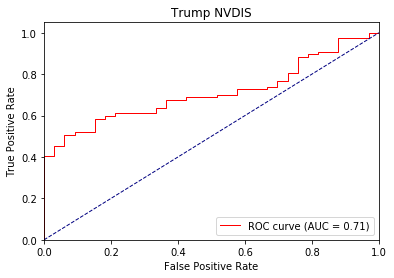

Directory already exists!
TEST dt_nvdis1 1 ap tensor([0.4368, 0.8976]) loss : 0.5901553630828857 0.5157221158345541 tid : 300 tg tensor([[1]], device='cuda:0')
TEST dt_nvdis1 1 ap tensor([0.4451, 0.8931]) loss : 0.12021315097808838 0.5169880870978038 tid : 390 tg tensor([[1]], device='cuda:0')
TEST dt_nvdis1 1 ap tensor([0.4413, 0.8917]) loss : 1.2782915830612183 0.519778572818608 tid : 510 tg tensor([[0]], device='cuda:0')


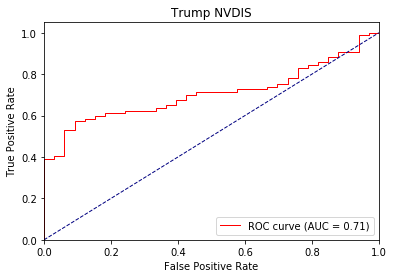

Directory already exists!
TEST dt_nvdis1 2 ap tensor([0.4378, 0.9029]) loss : 0.5134262442588806 0.502573201530858 tid : 300 tg tensor([[1]], device='cuda:0')
TEST dt_nvdis1 2 ap tensor([0.4484, 0.8988]) loss : 0.07338857650756836 0.5066993530591329 tid : 390 tg tensor([[1]], device='cuda:0')
TEST dt_nvdis1 2 ap tensor([0.4436, 0.8963]) loss : 1.475602626800537 0.513038424322906 tid : 510 tg tensor([[0]], device='cuda:0')


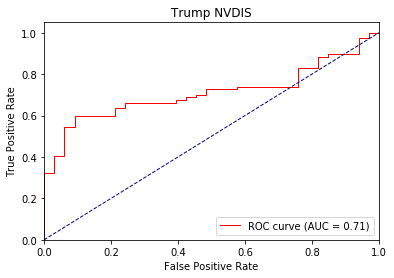

Directory already exists!
TEST dt_lookat3 0 ap tensor([0.1786, 0.8981]) loss : 1.177841305732727 0.5008330857544615 tid : 300 tg tensor([[0]], device='cuda:0')
TEST dt_lookat3 0 ap tensor([0.1446, 0.9240]) loss : 0.2780958414077759 0.46892468810081483 tid : 390 tg tensor([[1]], device='cuda:0')
TEST dt_lookat3 0 ap tensor([0.1313, 0.9317]) loss : 1.2408137321472168 0.4617679885868887 tid : 510 tg tensor([[0]], device='cuda:0')


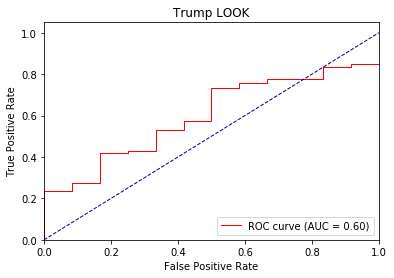

Directory already exists!
TEST dt_lookat3 1 ap tensor([0.2040, 0.9135]) loss : 1.3343952894210815 0.44940365197365745 tid : 300 tg tensor([[0]], device='cuda:0')
TEST dt_lookat3 1 ap tensor([0.1676, 0.9353]) loss : 0.14991462230682373 0.4048435664176941 tid : 390 tg tensor([[1]], device='cuda:0')
TEST dt_lookat3 1 ap tensor([0.1439, 0.9428]) loss : 1.52126145362854 0.3918411112526088 tid : 510 tg tensor([[0]], device='cuda:0')


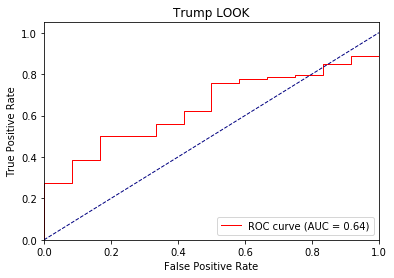

Directory already exists!
TEST dt_lookat3 2 ap tensor([0.2304, 0.9200]) loss : 1.4275457859039307 0.4287041823069255 tid : 300 tg tensor([[0]], device='cuda:0')
TEST dt_lookat3 2 ap tensor([0.1930, 0.9403]) loss : 0.08896851539611816 0.37515033801396686 tid : 390 tg tensor([[1]], device='cuda:0')
TEST dt_lookat3 2 ap tensor([0.1576, 0.9468]) loss : 1.7488296031951904 0.358665271580798 tid : 510 tg tensor([[0]], device='cuda:0')


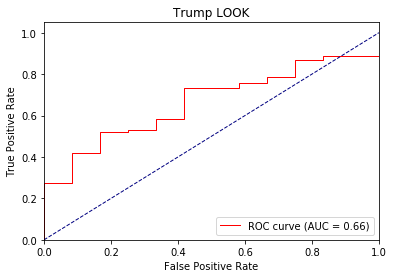

Directory already exists!
TEST dt_eyebrow 0 ap tensor([0.6274, 0.6387]) loss : 1.2210824489593506 0.7653672250739315 tid : 300 tg tensor([[0]], device='cuda:0')
TEST dt_eyebrow 0 ap tensor([0.5831, 0.6774]) loss : 0.29802578687667847 0.728634256919225 tid : 390 tg tensor([[1]], device='cuda:0')
TEST dt_eyebrow 0 ap tensor([0.5403, 0.7442]) loss : 0.9308304190635681 0.6821041295250643 tid : 510 tg tensor([[0]], device='cuda:0')


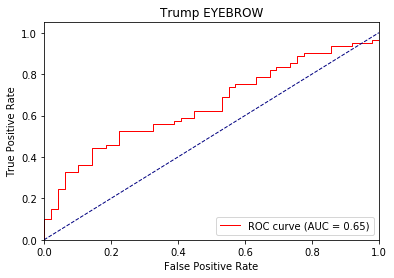

Directory already exists!
TEST dt_eyebrow 1 ap tensor([0.6912, 0.7531]) loss : 1.5276596546173096 0.8870257055550291 tid : 300 tg tensor([[0]], device='cuda:0')
TEST dt_eyebrow 1 ap tensor([0.6285, 0.7744]) loss : 0.1600063443183899 0.8257579859097799 tid : 390 tg tensor([[1]], device='cuda:0')
TEST dt_eyebrow 1 ap tensor([0.5782, 0.8092]) loss : 1.271620273590088 0.7488562615172377 tid : 510 tg tensor([[0]], device='cuda:0')


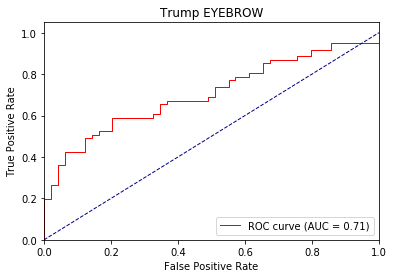

Directory already exists!
TEST dt_eyebrow 2 ap tensor([0.7099, 0.7482]) loss : 1.7830754518508911 1.012702533027582 tid : 300 tg tensor([[0]], device='cuda:0')
TEST dt_eyebrow 2 ap tensor([0.6353, 0.7654]) loss : 0.09876573085784912 0.9323591764767964 tid : 390 tg tensor([[1]], device='cuda:0')
TEST dt_eyebrow 2 ap tensor([0.5901, 0.8120]) loss : 1.5726288557052612 0.8327992222841504 tid : 510 tg tensor([[0]], device='cuda:0')


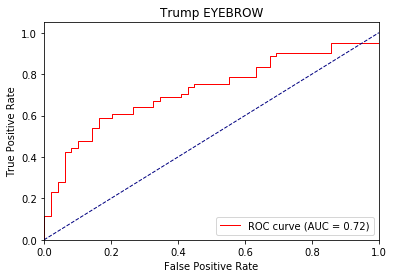

Directory already exists!
TEST dt_atface 0 ap tensor([0.6834, 0.8905]) loss : 0.7606815099716187 0.5995192763052488 tid : 300 tg tensor([[0]], device='cuda:0')
TEST dt_atface 0 ap tensor([0.7130, 0.8994]) loss : 0.37224966287612915 0.6026840658982595 tid : 390 tg tensor([[1]], device='cuda:0')
TEST dt_atface 0 ap tensor([0.7579, 0.9119]) loss : 1.0123435258865356 0.5934220529297023 tid : 510 tg tensor([[0]], device='cuda:0')


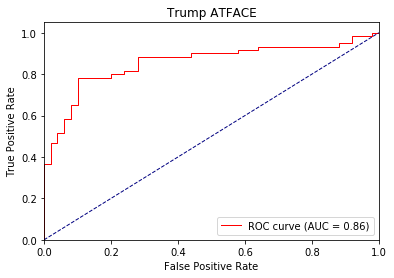

Directory already exists!
TEST dt_atface 1 ap tensor([0.6975, 0.8946]) loss : 0.8505007028579712 0.5526695037097261 tid : 300 tg tensor([[0]], device='cuda:0')
TEST dt_atface 1 ap tensor([0.7155, 0.9008]) loss : 0.22343721985816956 0.5543760720888774 tid : 390 tg tensor([[1]], device='cuda:0')
TEST dt_atface 1 ap tensor([0.7528, 0.9167]) loss : 1.1840695142745972 0.5448977973275971 tid : 510 tg tensor([[0]], device='cuda:0')


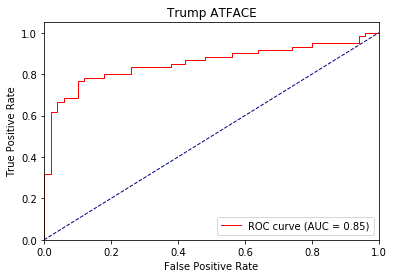

Directory already exists!
TEST dt_atface 2 ap tensor([0.6899, 0.8935]) loss : 0.928138792514801 0.535914541336528 tid : 300 tg tensor([[0]], device='cuda:0')
TEST dt_atface 2 ap tensor([0.7074, 0.8995]) loss : 0.1496514081954956 0.5346967967351278 tid : 390 tg tensor([[1]], device='cuda:0')
TEST dt_atface 2 ap tensor([0.7386, 0.9132]) loss : 1.3065829277038574 0.5239746379620821 tid : 510 tg tensor([[0]], device='cuda:0')


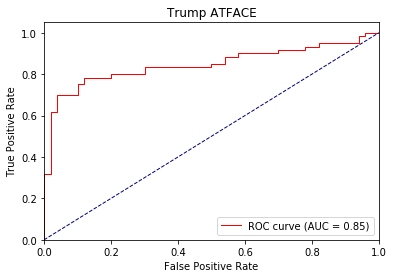

Directory already exists!
TEST dt_feface 0 ap tensor([1., 0.]) loss : 0.2690129280090332 0.31159278593565287 tid : 300 tg tensor([[0]], device='cuda:0')
TEST dt_feface 0 ap tensor([1., 0.]) loss : 0.29768311977386475 0.31608842134475706 tid : 390 tg tensor([[0]], device='cuda:0')
TEST dt_feface 0 ap tensor([1., 0.]) loss : 0.4197145998477936 0.32327223084505324 tid : 510 tg tensor([[0]], device='cuda:0')


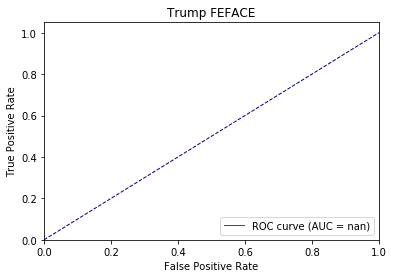

Directory already exists!
TEST dt_feface 1 ap tensor([1., 0.]) loss : 0.14826631546020508 0.15754819909731546 tid : 300 tg tensor([[0]], device='cuda:0')
TEST dt_feface 1 ap tensor([1., 0.]) loss : 0.1235431432723999 0.16437106649080913 tid : 390 tg tensor([[0]], device='cuda:0')
TEST dt_feface 1 ap tensor([1., 0.]) loss : 0.25102031230926514 0.17088911081980734 tid : 510 tg tensor([[0]], device='cuda:0')


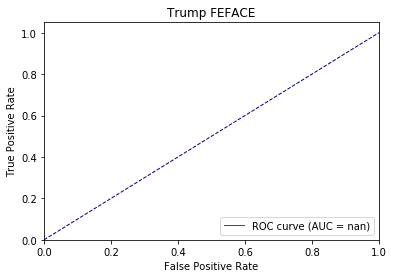

Directory already exists!
TEST dt_feface 2 ap tensor([1., 0.]) loss : 0.08275258541107178 0.08223101496696472 tid : 300 tg tensor([[0]], device='cuda:0')
TEST dt_feface 2 ap tensor([1., 0.]) loss : 0.04710245132446289 0.089255078236262 tid : 390 tg tensor([[0]], device='cuda:0')
TEST dt_feface 2 ap tensor([1., 0.]) loss : 0.14178943634033203 0.09414234034066062 tid : 510 tg tensor([[0]], device='cuda:0')


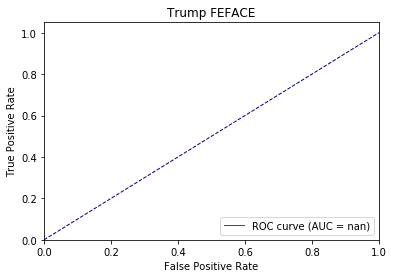

Directory already exists!
TEST dt_hrface 0 ap tensor([0.9784, 0.4567]) loss : 1.1526727676391602 0.43102769266095076 tid : 300 tg tensor([[1]], device='cuda:0')
TEST dt_hrface 0 ap tensor([0.9752, 0.4657]) loss : 0.28078019618988037 0.43775155226389567 tid : 390 tg tensor([[0]], device='cuda:0')
TEST dt_hrface 0 ap tensor([0.9794, 0.4012]) loss : 0.4572032690048218 0.431566631909713 tid : 510 tg tensor([[0]], device='cuda:0')


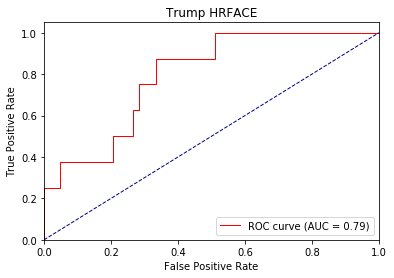

Directory already exists!
TEST dt_hrface 1 ap tensor([0.9811, 0.4665]) loss : 1.6430014371871948 0.31426862248203213 tid : 300 tg tensor([[1]], device='cuda:0')
TEST dt_hrface 1 ap tensor([0.9775, 0.4875]) loss : 0.13445663452148438 0.32230138341585796 tid : 390 tg tensor([[0]], device='cuda:0')
TEST dt_hrface 1 ap tensor([0.9815, 0.4283]) loss : 0.30400994420051575 0.31319775338311795 tid : 510 tg tensor([[0]], device='cuda:0')


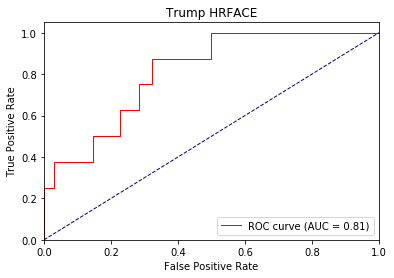

Directory already exists!
TEST dt_hrface 2 ap tensor([0.9823, 0.4695]) loss : 1.975888967514038 0.26848673193078293 tid : 300 tg tensor([[1]], device='cuda:0')
TEST dt_hrface 2 ap tensor([0.9784, 0.5108]) loss : 0.07834386825561523 0.2757592785358429 tid : 390 tg tensor([[0]], device='cuda:0')
TEST dt_hrface 2 ap tensor([0.9825, 0.4397]) loss : 0.22632455825805664 0.2633957509855622 tid : 510 tg tensor([[0]], device='cuda:0')


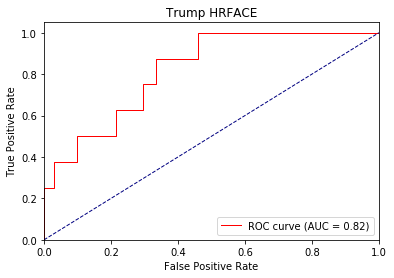

Directory already exists!
TEST dt_saface 0 ap tensor([1., 0.]) loss : 0.311506986618042 0.2078308227815126 tid : 300 tg tensor([[0]], device='cuda:0')
TEST dt_saface 0 ap tensor([1., 0.]) loss : 0.15989995002746582 0.21476835489273072 tid : 390 tg tensor([[0]], device='cuda:0')
TEST dt_saface 0 ap tensor([1., 0.]) loss : 0.2611725330352783 0.21741703644539545 tid : 510 tg tensor([[0]], device='cuda:0')


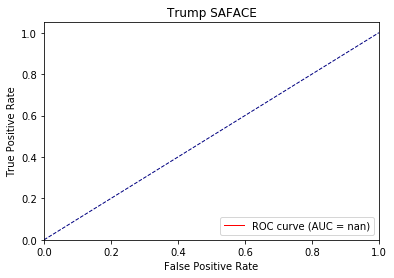

Directory already exists!
TEST dt_saface 1 ap tensor([1., 0.]) loss : 0.14007115364074707 0.0967070554432116 tid : 300 tg tensor([[0]], device='cuda:0')
TEST dt_saface 1 ap tensor([1., 0.]) loss : 0.06835424900054932 0.10612558285395304 tid : 390 tg tensor([[0]], device='cuda:0')
TEST dt_saface 1 ap tensor([1., 0.]) loss : 0.140252947807312 0.11006530685332215 tid : 510 tg tensor([[0]], device='cuda:0')


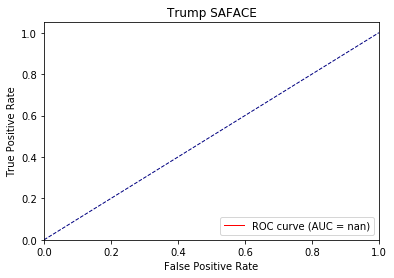

Directory already exists!
TEST dt_saface 2 ap tensor([1., 0.]) loss : 0.06318652629852295 0.048167274709333456 tid : 300 tg tensor([[0]], device='cuda:0')
TEST dt_saface 2 ap tensor([1., 0.]) loss : 0.031482696533203125 0.05728126049041748 tid : 390 tg tensor([[0]], device='cuda:0')
TEST dt_saface 2 ap tensor([1., 0.]) loss : 0.07707631587982178 0.06076754412604767 tid : 510 tg tensor([[0]], device='cuda:0')


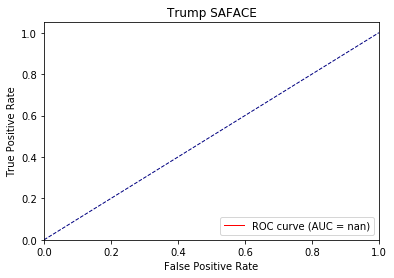

Directory already exists!
TEST dt_neuface 0 ap tensor([0.8676, 0.5540]) loss : 0.6042938232421875 0.583517161900537 tid : 300 tg tensor([[0]], device='cuda:0')
TEST dt_neuface 0 ap tensor([0.8795, 0.5852]) loss : 0.37582939863204956 0.5768848073482513 tid : 390 tg tensor([[0]], device='cuda:0')
TEST dt_neuface 0 ap tensor([0.8873, 0.6225]) loss : 0.9079574346542358 0.5738755522422421 tid : 510 tg tensor([[1]], device='cuda:0')


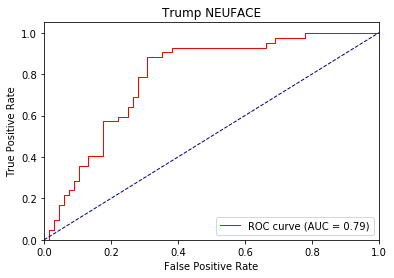

Directory already exists!
TEST dt_neuface 1 ap tensor([0.8910, 0.5772]) loss : 0.5411900281906128 0.5448013491797865 tid : 300 tg tensor([[0]], device='cuda:0')
TEST dt_neuface 1 ap tensor([0.8979, 0.6013]) loss : 0.2275066375732422 0.5372280796368917 tid : 390 tg tensor([[0]], device='cuda:0')
TEST dt_neuface 1 ap tensor([0.8984, 0.6262]) loss : 1.0920469760894775 0.5375279124500683 tid : 510 tg tensor([[1]], device='cuda:0')


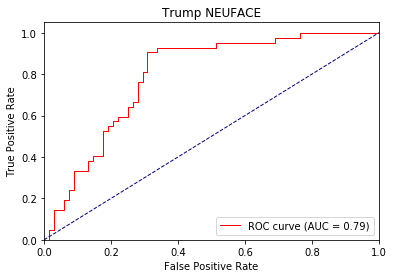

Directory already exists!
TEST dt_neuface 2 ap tensor([0.9011, 0.5961]) loss : 0.466766357421875 0.5318523002298254 tid : 300 tg tensor([[0]], device='cuda:0')
TEST dt_neuface 2 ap tensor([0.9041, 0.6083]) loss : 0.14953994750976562 0.5243033647537232 tid : 390 tg tensor([[0]], device='cuda:0')
TEST dt_neuface 2 ap tensor([0.9041, 0.6368]) loss : 1.2661709785461426 0.5283542402739664 tid : 510 tg tensor([[1]], device='cuda:0')


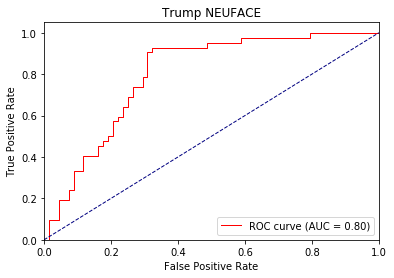

Directory already exists!
TEST dt_inapprop 0 ap tensor([0.9261, 0.2025]) loss : 0.350120484828949 0.4667827073942151 tid : 300 tg tensor([[0]], device='cuda:0')
TEST dt_inapprop 0 ap tensor([0.9339, 0.1680]) loss : 0.44098249077796936 0.4573049263159434 tid : 390 tg tensor([[0]], device='cuda:0')
TEST dt_inapprop 0 ap tensor([0.9109, 0.1289]) loss : 0.4080851078033447 0.463687976297823 tid : 510 tg tensor([[0]], device='cuda:0')


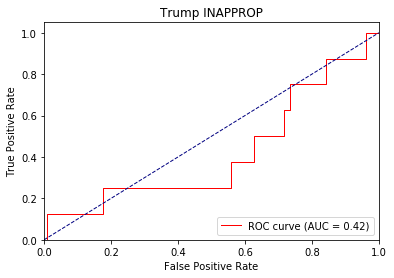

Directory already exists!
TEST dt_inapprop 1 ap tensor([0.9241, 0.2941]) loss : 0.22465842962265015 0.355186472859299 tid : 300 tg tensor([[0]], device='cuda:0')
TEST dt_inapprop 1 ap tensor([0.9339, 0.1701]) loss : 0.20608311891555786 0.3309301384290059 tid : 390 tg tensor([[0]], device='cuda:0')
TEST dt_inapprop 1 ap tensor([0.9186, 0.1303]) loss : 0.24402624368667603 0.33652884491439006 tid : 510 tg tensor([[0]], device='cuda:0')


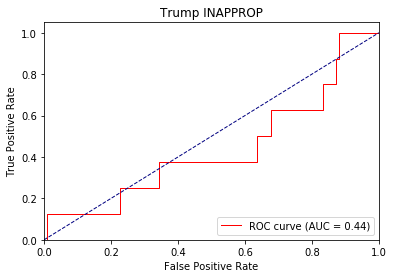

Directory already exists!
TEST dt_inapprop 2 ap tensor([0.9217, 0.2976]) loss : 0.16338038444519043 0.3240103251055667 tid : 300 tg tensor([[0]], device='cuda:0')
TEST dt_inapprop 2 ap tensor([0.9325, 0.1746]) loss : 0.11194860935211182 0.2869021455446879 tid : 390 tg tensor([[0]], device='cuda:0')
TEST dt_inapprop 2 ap tensor([0.9204, 0.1348]) loss : 0.15829992294311523 0.29161826557326087 tid : 510 tg tensor([[0]], device='cuda:0')


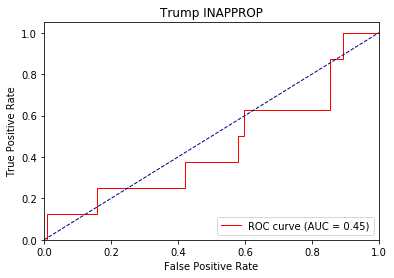

Directory already exists!
TEST dt_affgest 0 ap tensor([1., 0.]) loss : 0.2799225151538849 0.32968580931947944 tid : 300 tg tensor([[0]], device='cuda:0')
TEST dt_affgest 0 ap tensor([1., 0.]) loss : 0.31778568029403687 0.34227475921312966 tid : 390 tg tensor([[0]], device='cuda:0')
TEST dt_affgest 0 ap tensor([1., 0.]) loss : 0.5118483304977417 0.3463328353409628 tid : 510 tg tensor([[0]], device='cuda:0')


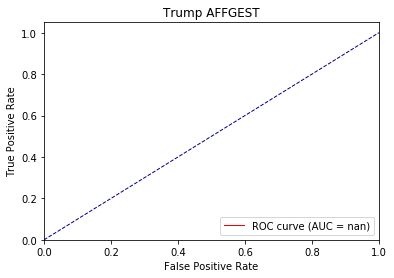

Directory already exists!
TEST dt_affgest 1 ap tensor([1., 0.]) loss : 0.15065205097198486 0.18073090858626784 tid : 300 tg tensor([[0]], device='cuda:0')
TEST dt_affgest 1 ap tensor([1., 0.]) loss : 0.16526973247528076 0.19427770535151165 tid : 390 tg tensor([[0]], device='cuda:0')
TEST dt_affgest 1 ap tensor([1., 0.]) loss : 0.32402127981185913 0.19934903562647624 tid : 510 tg tensor([[0]], device='cuda:0')


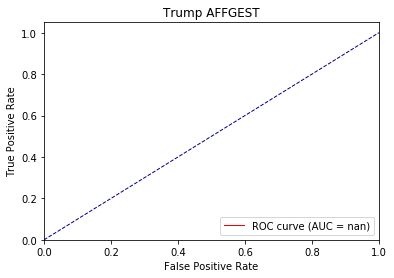

Directory already exists!
TEST dt_affgest 2 ap tensor([1., 0.]) loss : 0.09762060642242432 0.11296659708023071 tid : 300 tg tensor([[0]], device='cuda:0')
TEST dt_affgest 2 ap tensor([1., 0.]) loss : 0.10189473628997803 0.1254256240526835 tid : 390 tg tensor([[0]], device='cuda:0')
TEST dt_affgest 2 ap tensor([1., 0.]) loss : 0.2175244688987732 0.12994935790311943 tid : 510 tg tensor([[0]], device='cuda:0')


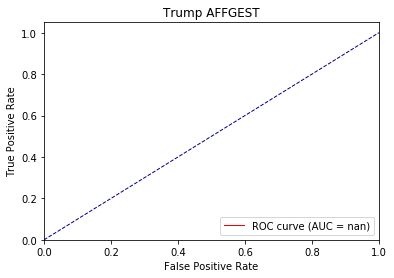

Directory already exists!
TEST dt_defgest 0 ap tensor([0.9128, 0.6279]) loss : 0.5226482152938843 0.5730714458122588 tid : 300 tg tensor([[0]], device='cuda:0')
TEST dt_defgest 0 ap tensor([0.8994, 0.7000]) loss : 0.5632805228233337 0.5810750381151835 tid : 390 tg tensor([[1]], device='cuda:0')
TEST dt_defgest 0 ap tensor([0.8784, 0.7312]) loss : 0.6202958822250366 0.5908352110571075 tid : 510 tg tensor([[0]], device='cuda:0')


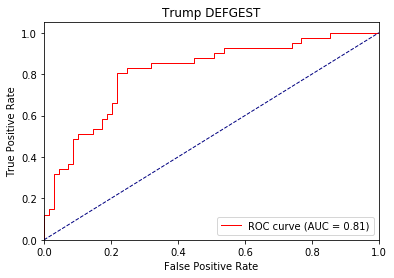

Directory already exists!
TEST dt_defgest 1 ap tensor([0.9217, 0.6463]) loss : 0.4405183792114258 0.5372569503491385 tid : 300 tg tensor([[0]], device='cuda:0')
TEST dt_defgest 1 ap tensor([0.9045, 0.7106]) loss : 0.5119630098342896 0.5461461198329925 tid : 390 tg tensor([[1]], device='cuda:0')
TEST dt_defgest 1 ap tensor([0.8846, 0.7433]) loss : 0.6220988631248474 0.5575650068162714 tid : 510 tg tensor([[0]], device='cuda:0')


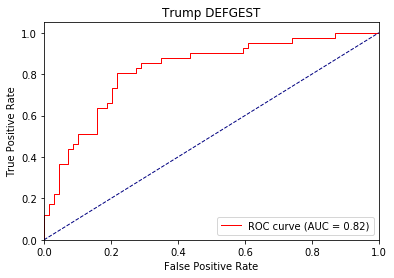

Directory already exists!
TEST dt_defgest 2 ap tensor([0.9203, 0.6576]) loss : 0.3722492456436157 0.5122890388756468 tid : 300 tg tensor([[0]], device='cuda:0')
TEST dt_defgest 2 ap tensor([0.9046, 0.7189]) loss : 0.4863591492176056 0.5229422426223755 tid : 390 tg tensor([[1]], device='cuda:0')
TEST dt_defgest 2 ap tensor([0.8846, 0.7481]) loss : 0.6119509339332581 0.5358747701043064 tid : 510 tg tensor([[0]], device='cuda:0')


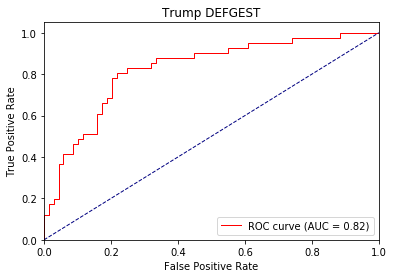

Directory already exists!
TEST dt_agentic 0 ap tensor([0.8335, 0.8657]) loss : 0.7999366521835327 0.6147984752529546 tid : 300 tg tensor([[0]], device='cuda:0')
TEST dt_agentic 0 ap tensor([0.8507, 0.8838]) loss : 0.2932666540145874 0.6097327812512716 tid : 390 tg tensor([[1]], device='cuda:0')
TEST dt_agentic 0 ap tensor([0.8534, 0.8972]) loss : 1.0928709506988525 0.6072975909246981 tid : 510 tg tensor([[0]], device='cuda:0')


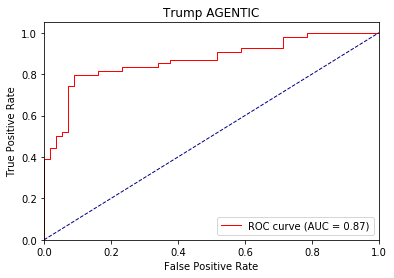

Directory already exists!
TEST dt_agentic 1 ap tensor([0.8329, 0.8808]) loss : 0.8258129954338074 0.5881725832035667 tid : 300 tg tensor([[0]], device='cuda:0')
TEST dt_agentic 1 ap tensor([0.8529, 0.8991]) loss : 0.1710742712020874 0.5810306882858276 tid : 390 tg tensor([[1]], device='cuda:0')
TEST dt_agentic 1 ap tensor([0.8559, 0.9105]) loss : 1.260350227355957 0.5758223608859534 tid : 510 tg tensor([[0]], device='cuda:0')


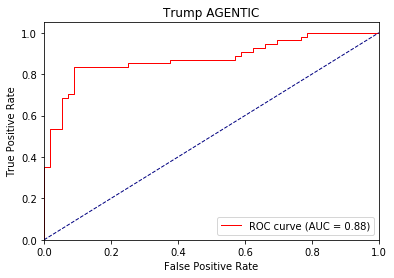

Directory already exists!
TEST dt_agentic 2 ap tensor([0.8348, 0.8808]) loss : 0.8679488897323608 0.5876606755089342 tid : 300 tg tensor([[0]], device='cuda:0')
TEST dt_agentic 2 ap tensor([0.8542, 0.8997]) loss : 0.1080659031867981 0.5776794751485189 tid : 390 tg tensor([[1]], device='cuda:0')
TEST dt_agentic 2 ap tensor([0.8576, 0.9131]) loss : 1.398832082748413 0.5702162845042146 tid : 510 tg tensor([[0]], device='cuda:0')


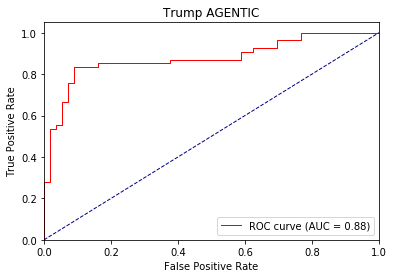

Directory already exists!
TEST dt_waveoff 0 ap tensor([0.8061, 0.1395]) loss : 0.45238757133483887 0.5304618153655738 tid : 300 tg tensor([[0]], device='cuda:0')
TEST dt_waveoff 0 ap tensor([0.8435, 0.1046]) loss : 0.28798335790634155 0.49861339926719667 tid : 390 tg tensor([[0]], device='cuda:0')
TEST dt_waveoff 0 ap tensor([0.8852, 0.0767]) loss : 0.40536224842071533 0.4694429693870174 tid : 510 tg tensor([[0]], device='cuda:0')


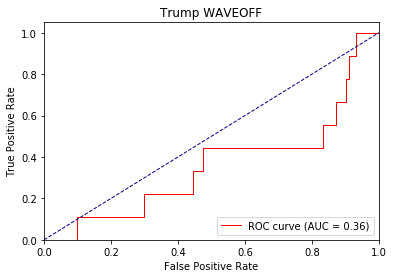

Directory already exists!
TEST dt_waveoff 1 ap tensor([0.8042, 0.1578]) loss : 0.2385672926902771 0.46438619442153395 tid : 300 tg tensor([[0]], device='cuda:0')
TEST dt_waveoff 1 ap tensor([0.8423, 0.1177]) loss : 0.12300825119018555 0.4103703554471334 tid : 390 tg tensor([[0]], device='cuda:0')
TEST dt_waveoff 1 ap tensor([0.8778, 0.0824]) loss : 0.24783623218536377 0.35928841528383276 tid : 510 tg tensor([[0]], device='cuda:0')


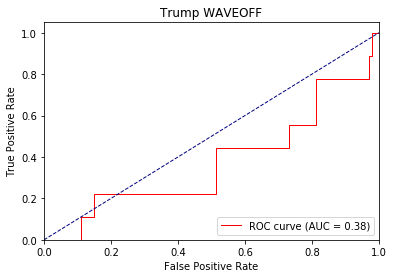

Directory already exists!
TEST dt_waveoff 2 ap tensor([0.8365, 0.1727]) loss : 0.12945783138275146 0.4832103607947366 tid : 300 tg tensor([[0]], device='cuda:0')
TEST dt_waveoff 2 ap tensor([0.8679, 0.1265]) loss : 0.05440688133239746 0.40406270186106363 tid : 390 tg tensor([[0]], device='cuda:0')
TEST dt_waveoff 2 ap tensor([0.8957, 0.0879]) loss : 0.14598023891448975 0.3287325845760049 tid : 510 tg tensor([[0]], device='cuda:0')


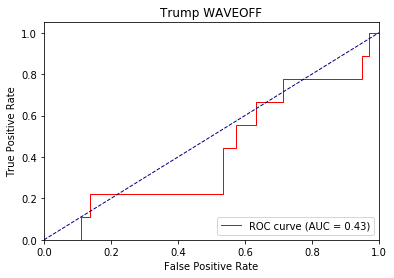

Directory already exists!
TEST dt_nvtic1 0 ap tensor([0.9205, 0.2216]) loss : 0.44572240114212036 0.4902326814961015 tid : 300 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic1 0 ap tensor([0.9221, 0.1957]) loss : 0.28021320700645447 0.49681711951891583 tid : 390 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic1 0 ap tensor([0.9055, 0.2228]) loss : 0.4162595272064209 0.5016086173867716 tid : 510 tg tensor([[0]], device='cuda:0')


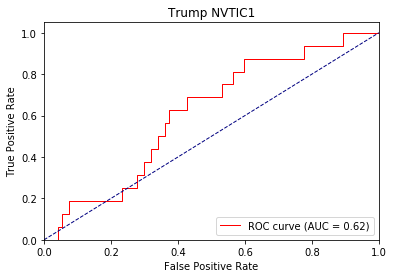

Directory already exists!
TEST dt_nvtic1 1 ap tensor([0.9235, 0.2079]) loss : 0.32351475954055786 0.4269851106300689 tid : 300 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic1 1 ap tensor([0.9243, 0.1982]) loss : 0.15201926231384277 0.4354317061106364 tid : 390 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic1 1 ap tensor([0.9224, 0.2366]) loss : 0.29085013270378113 0.4396657255089399 tid : 510 tg tensor([[0]], device='cuda:0')


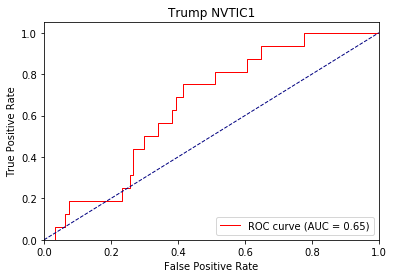

Directory already exists!
TEST dt_nvtic1 2 ap tensor([0.9262, 0.2053]) loss : 0.25507110357284546 0.40311348856541146 tid : 300 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic1 2 ap tensor([0.9243, 0.1948]) loss : 0.0903477668762207 0.4122410261631012 tid : 390 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic1 2 ap tensor([0.9265, 0.2438]) loss : 0.22152137756347656 0.417112675685327 tid : 510 tg tensor([[0]], device='cuda:0')


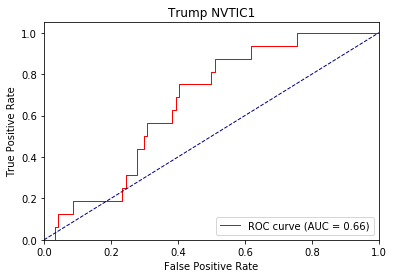

Directory already exists!
TEST dt_nvtic2 0 ap tensor([0.8438, 0.2673]) loss : 1.0606967210769653 0.5084488161823206 tid : 300 tg tensor([[1]], device='cuda:0')
TEST dt_nvtic2 0 ap tensor([0.8762, 0.2369]) loss : 0.37112051248550415 0.5000226453940073 tid : 390 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic2 0 ap tensor([0.8993, 0.2130]) loss : 0.9777947664260864 0.48941682148905635 tid : 510 tg tensor([[1]], device='cuda:0')


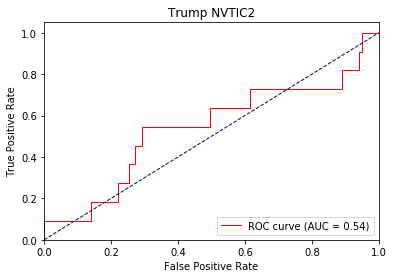

Directory already exists!
TEST dt_nvtic2 1 ap tensor([0.8533, 0.2720]) loss : 1.4161137342453003 0.4403308938469803 tid : 300 tg tensor([[1]], device='cuda:0')
TEST dt_nvtic2 1 ap tensor([0.8800, 0.1778]) loss : 0.20554083585739136 0.4214738221963247 tid : 390 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic2 1 ap tensor([0.9024, 0.1737]) loss : 1.3016605377197266 0.4029422127506108 tid : 510 tg tensor([[1]], device='cuda:0')


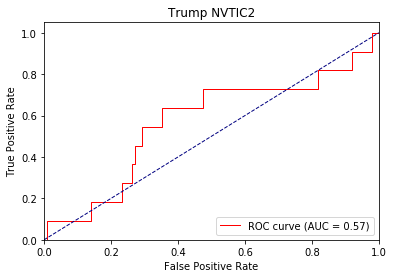

Directory already exists!
TEST dt_nvtic2 2 ap tensor([0.8608, 0.2738]) loss : 1.6701232194900513 0.4204547081077308 tid : 300 tg tensor([[1]], device='cuda:0')
TEST dt_nvtic2 2 ap tensor([0.8825, 0.1820]) loss : 0.13408178091049194 0.3939374816417694 tid : 390 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic2 2 ap tensor([0.9026, 0.1765]) loss : 1.557919979095459 0.3700788429061186 tid : 510 tg tensor([[1]], device='cuda:0')


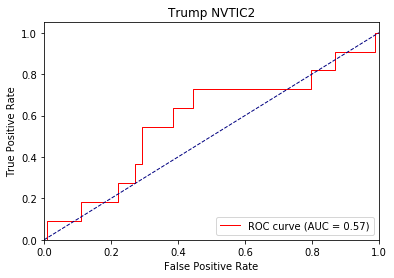

Directory already exists!
TEST dt_nvtic3 0 ap tensor([0.7510, 0.8877]) loss : 0.7282373309135437 0.6304865557896463 tid : 300 tg tensor([[1]], device='cuda:0')
TEST dt_nvtic3 0 ap tensor([0.7003, 0.8234]) loss : 0.6831376552581787 0.6438283360004425 tid : 390 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic3 0 ap tensor([0.6586, 0.7682]) loss : 0.7257158756256104 0.6544821508301114 tid : 510 tg tensor([[0]], device='cuda:0')


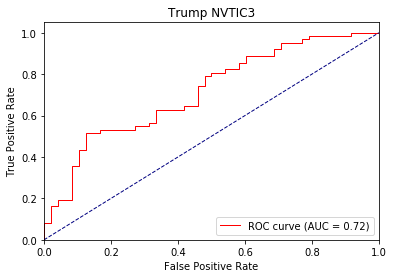

Directory already exists!
TEST dt_nvtic3 1 ap tensor([0.7578, 0.9035]) loss : 0.7020868062973022 0.5992671282667863 tid : 300 tg tensor([[1]], device='cuda:0')
TEST dt_nvtic3 1 ap tensor([0.7229, 0.8512]) loss : 0.549534261226654 0.6116121109326681 tid : 390 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic3 1 ap tensor([0.7021, 0.8157]) loss : 0.681459367275238 0.6234033952638941 tid : 510 tg tensor([[0]], device='cuda:0')


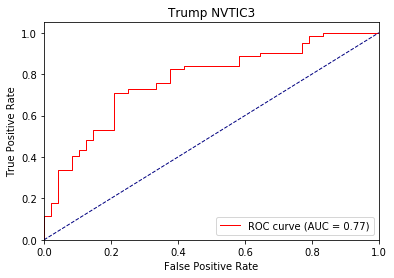

Directory already exists!
TEST dt_nvtic3 2 ap tensor([0.7162, 0.9007]) loss : 0.6942868232727051 0.583103294958148 tid : 300 tg tensor([[1]], device='cuda:0')
TEST dt_nvtic3 2 ap tensor([0.7059, 0.8549]) loss : 0.4769245386123657 0.5948624753952027 tid : 390 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic3 2 ap tensor([0.7004, 0.8222]) loss : 0.6642696857452393 0.6072797627703658 tid : 510 tg tensor([[0]], device='cuda:0')


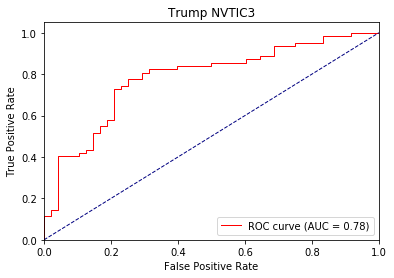

Directory already exists!
TEST dt_nvtic5 0 ap tensor([0.9960, 0.1944]) loss : 0.2226967215538025 0.3365094112722497 tid : 300 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic5 0 ap tensor([0.9969, 0.1534]) loss : 0.27331435680389404 0.3375571342309316 tid : 390 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic5 0 ap tensor([0.9971, 0.0945]) loss : 0.30846214294433594 0.3359008471942642 tid : 510 tg tensor([[0]], device='cuda:0')


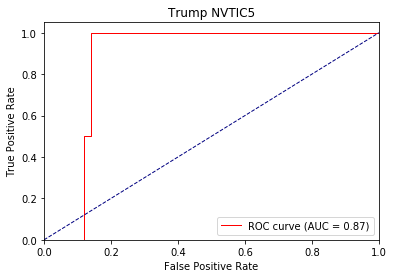

Directory already exists!
TEST dt_nvtic5 1 ap tensor([0.9967, 0.2250]) loss : 0.127935528755188 0.20497327520136246 tid : 300 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic5 1 ap tensor([0.9971, 0.1667]) loss : 0.11591243743896484 0.20254709005355834 tid : 390 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic5 1 ap tensor([0.9975, 0.1088]) loss : 0.17832112312316895 0.19767322789118127 tid : 510 tg tensor([[0]], device='cuda:0')


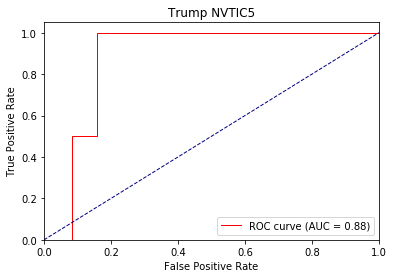

Directory already exists!
TEST dt_nvtic5 2 ap tensor([0.9967, 0.2250]) loss : 0.08347046375274658 0.15209721943788362 tid : 300 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic5 2 ap tensor([0.9971, 0.1667]) loss : 0.05606949329376221 0.1452714669704437 tid : 390 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic5 2 ap tensor([0.9975, 0.1088]) loss : 0.10435628890991211 0.13622132753862917 tid : 510 tg tensor([[0]], device='cuda:0')


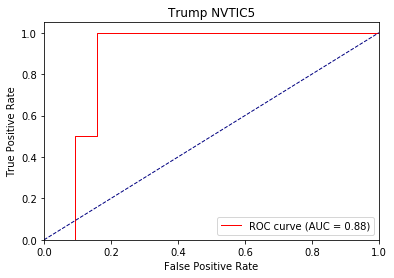

Directory already exists!
TEST dt_nvtic4 0 ap tensor([1., 0.]) loss : 0.40038105845451355 0.43622945118368717 tid : 300 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic4 0 ap tensor([1., 0.]) loss : 0.3730665445327759 0.44564971963564554 tid : 390 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic4 0 ap tensor([0.9937, 0.0927]) loss : 0.8164952993392944 0.4628204356119471 tid : 510 tg tensor([[1]], device='cuda:0')


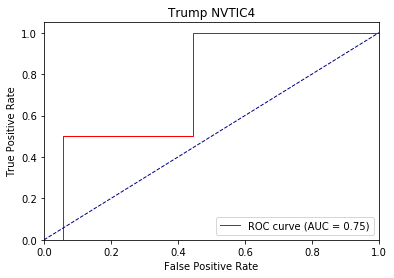

Directory already exists!
TEST dt_nvtic4 1 ap tensor([1., 0.]) loss : 0.21557772159576416 0.24597965520724915 tid : 300 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic4 1 ap tensor([1., 0.]) loss : 0.17472660541534424 0.25646766503651935 tid : 390 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic4 1 ap tensor([0.9939, 0.0623]) loss : 1.202235460281372 0.2857811963095248 tid : 510 tg tensor([[1]], device='cuda:0')


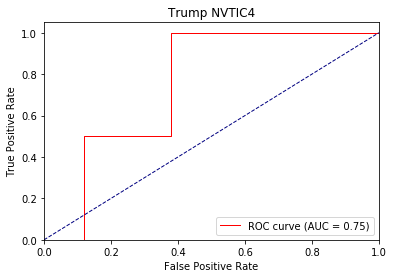

Directory already exists!
TEST dt_nvtic4 2 ap tensor([1., 0.]) loss : 0.1361134648323059 0.15395258236349674 tid : 300 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic4 2 ap tensor([1., 0.]) loss : 0.08955681324005127 0.16343880494435628 tid : 390 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic4 2 ap tensor([0.9937, 0.0520]) loss : 1.591444492340088 0.20131131225419277 tid : 510 tg tensor([[1]], device='cuda:0')


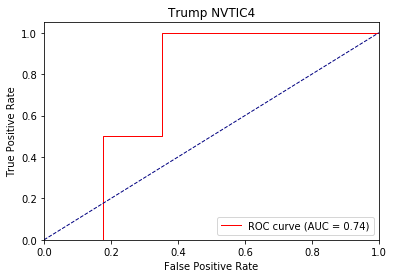

Directory already exists!
TEST dt_interruptions 0 ap tensor([0.9325, 0.0552]) loss : 0.28622448444366455 0.4006388255378656 tid : 300 tg tensor([[0]], device='cuda:0')
TEST dt_interruptions 0 ap tensor([0.9285, 0.0480]) loss : 0.4171399176120758 0.41047833720842997 tid : 390 tg tensor([[0]], device='cuda:0')
TEST dt_interruptions 0 ap tensor([0.9070, 0.0376]) loss : 0.33879879117012024 0.4146964139151342 tid : 510 tg tensor([[0]], device='cuda:0')


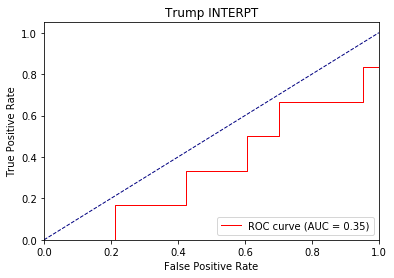

Directory already exists!
TEST dt_interruptions 1 ap tensor([0.9407, 0.0667]) loss : 0.16675877571105957 0.29698865455493595 tid : 300 tg tensor([[0]], device='cuda:0')
TEST dt_interruptions 1 ap tensor([0.9390, 0.0573]) loss : 0.21785330772399902 0.3059321657816569 tid : 390 tg tensor([[0]], device='cuda:0')
TEST dt_interruptions 1 ap tensor([0.9123, 0.0423]) loss : 0.21353679895401 0.310251948324222 tid : 510 tg tensor([[0]], device='cuda:0')


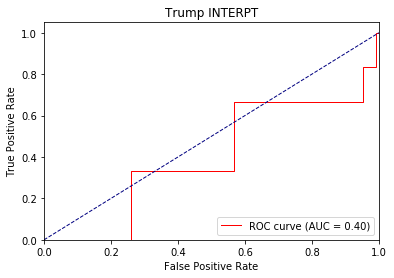

Directory already exists!
TEST dt_interruptions 2 ap tensor([0.9417, 0.0778]) loss : 0.11976063251495361 0.252204989654976 tid : 300 tg tensor([[0]], device='cuda:0')
TEST dt_interruptions 2 ap tensor([0.9435, 0.0681]) loss : 0.13087677955627441 0.2602943245569865 tid : 390 tg tensor([[0]], device='cuda:0')
TEST dt_interruptions 2 ap tensor([0.9238, 0.0471]) loss : 0.14758527278900146 0.2636044716950759 tid : 510 tg tensor([[0]], device='cuda:0')


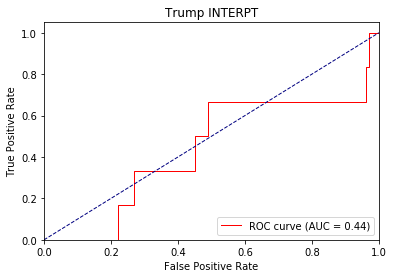

Directory already exists!
dt_lookat2 0 ap tensor([0.6464, 0.8909]) loss : 0.9343096613883972 0.6202557514768859 tid : 200 tg tensor([[1]], device='cuda:0')
TEST dt_lookat2 0 ap tensor([0.6785, 0.7903]) loss : 0.724789023399353 0.6135508613660932 tid : 150 tg tensor([[0]], device='cuda:0')
TEST dt_lookat2 0 ap tensor([0.6247, 0.6235]) loss : 0.5285639762878418 0.6529200070974778 tid : 480 tg tensor([[0]], device='cuda:0')


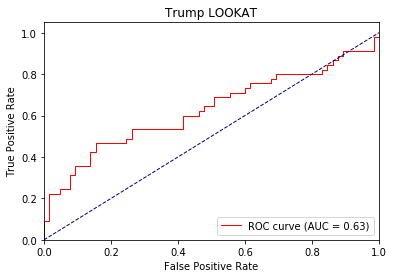

Directory already exists!
dt_lookat2 1 ap tensor([0.8380, 0.9365]) loss : 0.7314884066581726 0.4725676222843824 tid : 200 tg tensor([[1]], device='cuda:0')
TEST dt_lookat2 1 ap tensor([0.7737, 0.8098]) loss : 0.7981526255607605 0.5770958187058568 tid : 150 tg tensor([[0]], device='cuda:0')
TEST dt_lookat2 1 ap tensor([0.6695, 0.6609]) loss : 0.4650387167930603 0.631390166525938 tid : 480 tg tensor([[0]], device='cuda:0')


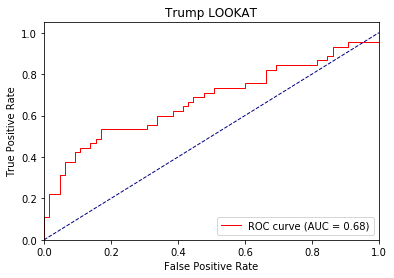

Directory already exists!
dt_lookat2 2 ap tensor([0.7601, 0.9727]) loss : 0.6812876462936401 0.3826720679507536 tid : 200 tg tensor([[1]], device='cuda:0')
TEST dt_lookat2 2 ap tensor([0.8095, 0.8284]) loss : 0.8305990695953369 0.5566633269190788 tid : 150 tg tensor([[0]], device='cuda:0')
TEST dt_lookat2 2 ap tensor([0.6869, 0.6779]) loss : 0.39483582973480225 0.6212530093533652 tid : 480 tg tensor([[0]], device='cuda:0')


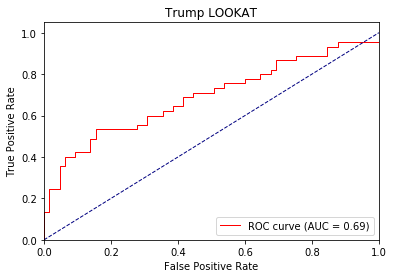

Directory already exists!
dt_brush1 0 ap tensor([0.9380, 0.0865]) loss : 0.37511762976646423 0.5513116586151305 tid : 200 tg tensor([[0]], device='cuda:0')
TEST dt_brush1 0 ap tensor([0.9692, 0.0476]) loss : 0.2676101326942444 0.3597592832520604 tid : 150 tg tensor([[0]], device='cuda:0')
TEST dt_brush1 0 ap tensor([0.9050, 0.0658]) loss : 0.29052162170410156 0.3989088802921529 tid : 480 tg tensor([[0]], device='cuda:0')


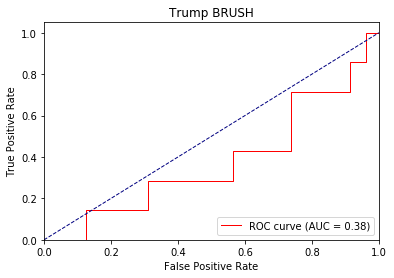

Directory already exists!
dt_brush1 1 ap tensor([1., 0.]) loss : 0.24298924207687378 0.31161701927582425 tid : 200 tg tensor([[0]], device='cuda:0')
TEST dt_brush1 1 ap tensor([0.9800, 0.0625]) loss : 0.19052571058273315 0.2523103356361389 tid : 150 tg tensor([[0]], device='cuda:0')
TEST dt_brush1 1 ap tensor([0.9189, 0.0872]) loss : 0.1856544017791748 0.3122841232285208 tid : 480 tg tensor([[0]], device='cuda:0')


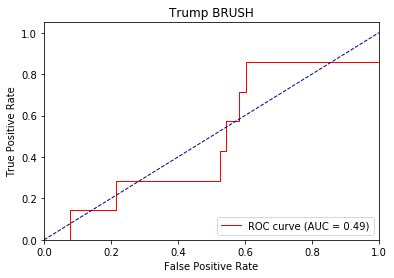

Directory already exists!
dt_brush1 2 ap tensor([0.9725, 0.3170]) loss : 0.09020602703094482 0.2941494011376278 tid : 200 tg tensor([[0]], device='cuda:0')
TEST dt_brush1 2 ap tensor([0.9800, 0.0625]) loss : 0.15491628646850586 0.20917913783341646 tid : 150 tg tensor([[0]], device='cuda:0')
TEST dt_brush1 2 ap tensor([0.9339, 0.0868]) loss : 0.12978988885879517 0.28146942324784335 tid : 480 tg tensor([[0]], device='cuda:0')


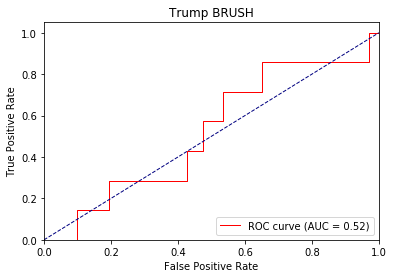

Directory already exists!
dt_nvdis1 0 ap tensor([0.4524, 0.8810]) loss : 0.3600613474845886 0.6140772259080565 tid : 200 tg tensor([[1]], device='cuda:0')
TEST dt_nvdis1 0 ap tensor([0.7695, 0.9446]) loss : 0.5413233041763306 0.5166859999299049 tid : 150 tg tensor([[1]], device='cuda:0')
TEST dt_nvdis1 0 ap tensor([0.5803, 0.8980]) loss : 1.4180437326431274 0.5576399890135746 tid : 480 tg tensor([[0]], device='cuda:0')


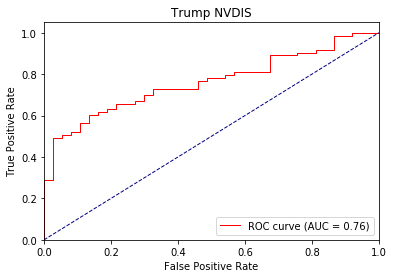

Directory already exists!
dt_nvdis1 1 ap tensor([0.6730, 0.9430]) loss : 0.18027961254119873 0.483680781670088 tid : 200 tg tensor([[1]], device='cuda:0')
TEST dt_nvdis1 1 ap tensor([0.7854, 0.9582]) loss : 0.4953683316707611 0.4640375738963485 tid : 150 tg tensor([[1]], device='cuda:0')
TEST dt_nvdis1 1 ap tensor([0.5751, 0.9132]) loss : 1.714801549911499 0.530623584073417 tid : 480 tg tensor([[0]], device='cuda:0')


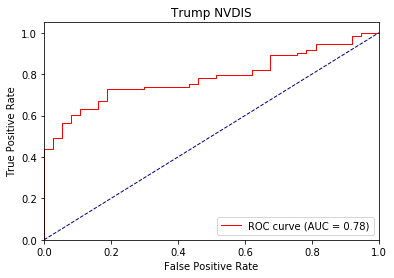

Directory already exists!
dt_nvdis1 2 ap tensor([0.7343, 0.9872]) loss : 0.15375864505767822 0.3760259932762868 tid : 200 tg tensor([[1]], device='cuda:0')
TEST dt_nvdis1 2 ap tensor([0.7676, 0.9562]) loss : 0.4731176197528839 0.44085327722132206 tid : 150 tg tensor([[1]], device='cuda:0')
TEST dt_nvdis1 2 ap tensor([0.5758, 0.9173]) loss : 1.9444797039031982 0.5249634357739468 tid : 480 tg tensor([[0]], device='cuda:0')


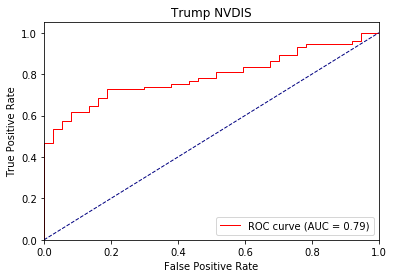

Directory already exists!
dt_lookat3 0 ap tensor([0.1584, 0.8281]) loss : 0.5037282705307007 0.6395170294495456 tid : 200 tg tensor([[1]], device='cuda:0')
TEST dt_lookat3 0 ap tensor([0.3237, 0.7320]) loss : 0.42284882068634033 0.5844952818006277 tid : 150 tg tensor([[1]], device='cuda:0')
TEST dt_lookat3 0 ap tensor([0.1778, 0.8500]) loss : 1.0822747945785522 0.5253378827961124 tid : 480 tg tensor([[0]], device='cuda:0')


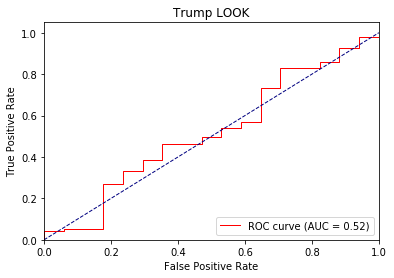

Directory already exists!
dt_lookat3 1 ap tensor([0.4152, 0.9431]) loss : 0.2698644995689392 0.48712101521946133 tid : 200 tg tensor([[1]], device='cuda:0')
TEST dt_lookat3 1 ap tensor([0.3610, 0.7602]) loss : 0.3206177353858948 0.5455566914752126 tid : 150 tg tensor([[1]], device='cuda:0')
TEST dt_lookat3 1 ap tensor([0.2527, 0.8670]) loss : 1.442924976348877 0.45102513687951223 tid : 480 tg tensor([[0]], device='cuda:0')


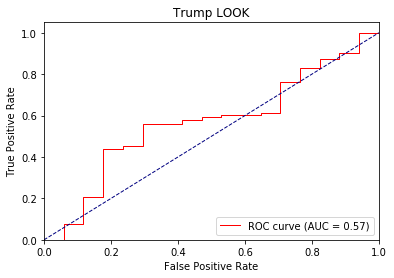

Directory already exists!
dt_lookat3 2 ap tensor([0.5097, 0.9535]) loss : 0.2036600112915039 0.4357693992787972 tid : 200 tg tensor([[1]], device='cuda:0')
TEST dt_lookat3 2 ap tensor([0.3715, 0.7678]) loss : 0.24612048268318176 0.5453453622758389 tid : 150 tg tensor([[1]], device='cuda:0')
TEST dt_lookat3 2 ap tensor([0.2704, 0.8761]) loss : 1.7661077976226807 0.4252953967269586 tid : 480 tg tensor([[0]], device='cuda:0')


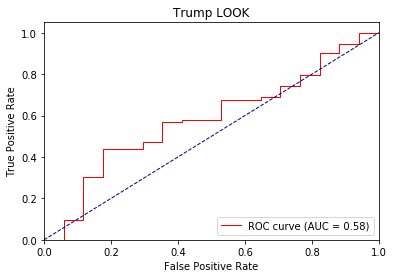

Directory already exists!
dt_eyebrow 0 ap tensor([0.1671, 0.9608]) loss : 0.9840865731239319 0.5657585878735003 tid : 200 tg tensor([[0]], device='cuda:0')
TEST dt_eyebrow 0 ap tensor([0.6332, 0.6883]) loss : 0.3066185712814331 0.726822511292994 tid : 150 tg tensor([[1]], device='cuda:0')
TEST dt_eyebrow 0 ap tensor([0.6080, 0.6676]) loss : 1.1144496202468872 0.7218834097896304 tid : 480 tg tensor([[0]], device='cuda:0')


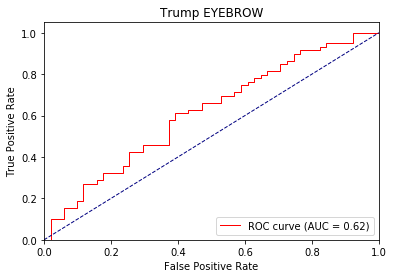

Directory already exists!
dt_eyebrow 1 ap tensor([0.1530, 0.9612]) loss : 2.1324596405029297 0.3629130795961473 tid : 200 tg tensor([[0]], device='cuda:0')
TEST dt_eyebrow 1 ap tensor([0.6621, 0.7224]) loss : 0.21041524410247803 0.8179705534130335 tid : 150 tg tensor([[1]], device='cuda:0')
TEST dt_eyebrow 1 ap tensor([0.6494, 0.7437]) loss : 1.4729349613189697 0.806408731000764 tid : 480 tg tensor([[0]], device='cuda:0')


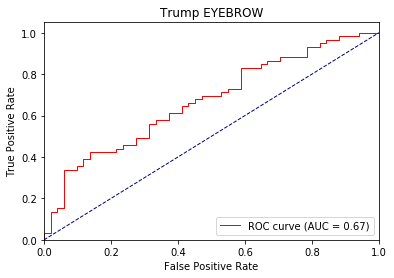

Directory already exists!
dt_eyebrow 2 ap tensor([0.2593, 0.9552]) loss : 2.4074649810791016 0.31002560833303056 tid : 200 tg tensor([[0]], device='cuda:0')
TEST dt_eyebrow 2 ap tensor([0.6877, 0.7426]) loss : 0.16931211948394775 0.8971803765743971 tid : 150 tg tensor([[1]], device='cuda:0')
TEST dt_eyebrow 2 ap tensor([0.6830, 0.7685]) loss : 1.7812199592590332 0.8793204755199199 tid : 480 tg tensor([[0]], device='cuda:0')


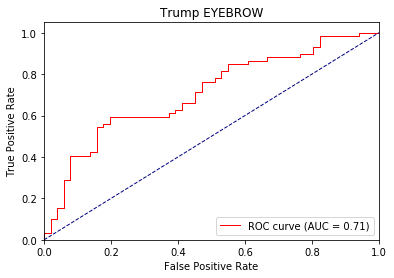

Directory already exists!
dt_atface 0 ap tensor([0.7325, 0.9134]) loss : 0.48987364768981934 0.6118155838020386 tid : 200 tg tensor([[1]], device='cuda:0')
TEST dt_atface 0 ap tensor([0.6343, 0.9127]) loss : 0.9378488063812256 0.5902326572686434 tid : 150 tg tensor([[1]], device='cuda:0')
TEST dt_atface 0 ap tensor([0.7405, 0.8663]) loss : 0.7827999591827393 0.5743738805152931 tid : 480 tg tensor([[0]], device='cuda:0')


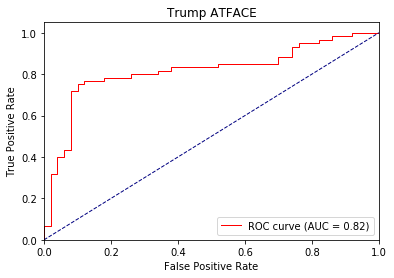

Directory already exists!
dt_atface 1 ap tensor([0.7663, 0.9241]) loss : 0.30829697847366333 0.47957262771626924 tid : 200 tg tensor([[1]], device='cuda:0')
TEST dt_atface 1 ap tensor([0.6426, 0.9142]) loss : 1.021212100982666 0.5422753226011992 tid : 150 tg tensor([[1]], device='cuda:0')
TEST dt_atface 1 ap tensor([0.7315, 0.8797]) loss : 0.933921754360199 0.5299714831065159 tid : 480 tg tensor([[0]], device='cuda:0')


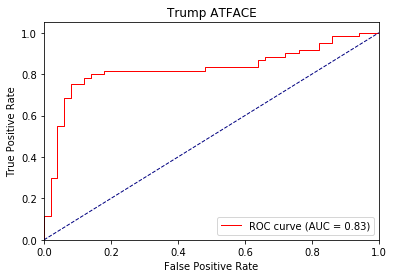

Directory already exists!
dt_atface 2 ap tensor([0.8031, 0.9661]) loss : 0.27367329597473145 0.4104632233701101 tid : 200 tg tensor([[1]], device='cuda:0')
TEST dt_atface 2 ap tensor([0.5956, 0.9155]) loss : 1.0858261585235596 0.523985618725419 tid : 150 tg tensor([[1]], device='cuda:0')
TEST dt_atface 2 ap tensor([0.7078, 0.8874]) loss : 1.0519689321517944 0.5153106070902883 tid : 480 tg tensor([[0]], device='cuda:0')


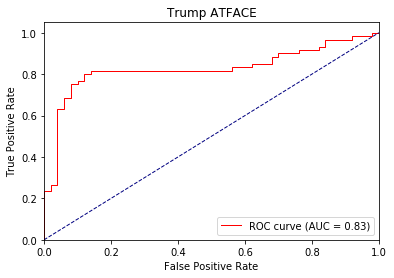

Directory already exists!
dt_feface 0 ap tensor([1., 0.]) loss : 0.565258800983429 0.6959408006152591 tid : 200 tg tensor([[0]], device='cuda:0')
TEST dt_feface 0 ap tensor([0.9980, 0.3333]) loss : 0.3485026955604553 0.33675905503332615 tid : 150 tg tensor([[0]], device='cuda:0')
TEST dt_feface 0 ap tensor([0.9992, 0.1250]) loss : 0.32768744230270386 0.3294233545965078 tid : 480 tg tensor([[0]], device='cuda:0')


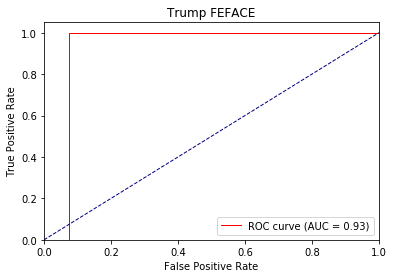

Directory already exists!
dt_feface 1 ap tensor([1., 0.]) loss : 0.11246299743652344 0.26171568215341495 tid : 200 tg tensor([[0]], device='cuda:0')
TEST dt_feface 1 ap tensor([0.9958, 0.2000]) loss : 0.1601104736328125 0.19020504504442215 tid : 150 tg tensor([[0]], device='cuda:0')
TEST dt_feface 1 ap tensor([0.9988, 0.0833]) loss : 0.1718754768371582 0.17989567287114203 tid : 480 tg tensor([[0]], device='cuda:0')


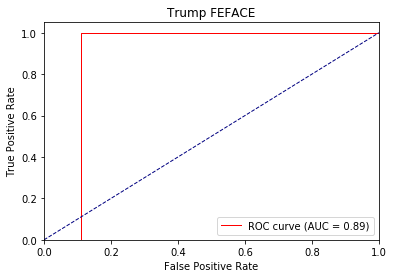

Directory already exists!
dt_feface 2 ap tensor([1., 0.]) loss : 0.04610896110534668 0.12705055900982448 tid : 200 tg tensor([[0]], device='cuda:0')
TEST dt_feface 2 ap tensor([0.9958, 0.2000]) loss : 0.0653465986251831 0.13307838700711727 tid : 150 tg tensor([[0]], device='cuda:0')
TEST dt_feface 2 ap tensor([0.9980, 0.0556]) loss : 0.08410632610321045 0.10739263466426305 tid : 480 tg tensor([[0]], device='cuda:0')


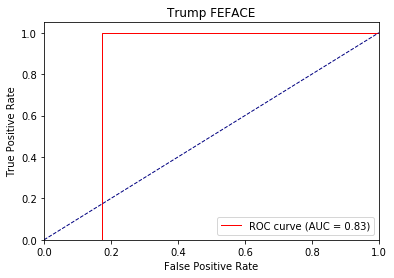

Directory already exists!
dt_hrface 0 ap tensor([0.9238, 0.0851]) loss : 0.3775918781757355 0.6345759695784959 tid : 200 tg tensor([[0]], device='cuda:0')
TEST dt_hrface 0 ap tensor([1., 0.]) loss : 0.5013217926025391 0.45423056185245514 tid : 150 tg tensor([[0]], device='cuda:0')
TEST dt_hrface 0 ap tensor([0.9864, 0.0441]) loss : 0.4184681177139282 0.48256626299449373 tid : 480 tg tensor([[0]], device='cuda:0')


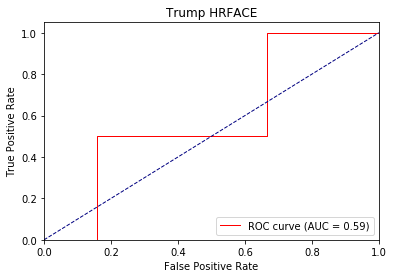

Directory already exists!
dt_hrface 1 ap tensor([0.9417, 0.4648]) loss : 0.2635843753814697 0.47391204457533986 tid : 200 tg tensor([[0]], device='cuda:0')
TEST dt_hrface 1 ap tensor([1., 0.]) loss : 0.32541871070861816 0.2569689489901066 tid : 150 tg tensor([[0]], device='cuda:0')
TEST dt_hrface 1 ap tensor([0.9916, 0.0903]) loss : 0.26027387380599976 0.3020870798096365 tid : 480 tg tensor([[0]], device='cuda:0')


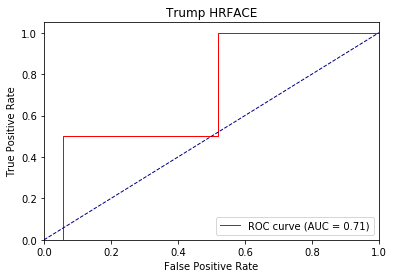

Directory already exists!
dt_hrface 2 ap tensor([0.9618, 0.5909]) loss : 0.126367449760437 0.3882711935788393 tid : 200 tg tensor([[0]], device='cuda:0')
TEST dt_hrface 2 ap tensor([1., 0.]) loss : 0.22637909650802612 0.1660478673875332 tid : 150 tg tensor([[0]], device='cuda:0')
TEST dt_hrface 2 ap tensor([0.9934, 0.1056]) loss : 0.17413294315338135 0.21381670540692854 tid : 480 tg tensor([[0]], device='cuda:0')


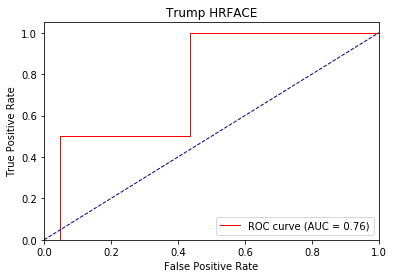

Directory already exists!
dt_saface 0 ap tensor([1., 0.]) loss : 0.27783769369125366 0.4962100407607119 tid : 200 tg tensor([[0]], device='cuda:0')
TEST dt_saface 0 ap tensor([1., 0.]) loss : 0.2918567657470703 0.27185814641416073 tid : 150 tg tensor([[0]], device='cuda:0')
TEST dt_saface 0 ap tensor([1., 0.]) loss : 0.23605555295944214 0.2956187186800704 tid : 480 tg tensor([[0]], device='cuda:0')


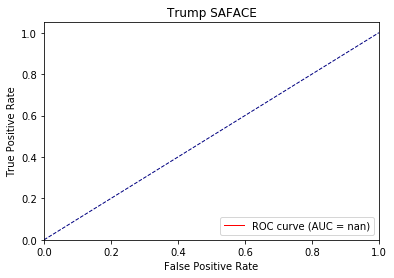

Directory already exists!
dt_saface 1 ap tensor([1., 0.]) loss : 0.07431638240814209 0.20415964010325108 tid : 200 tg tensor([[0]], device='cuda:0')
TEST dt_saface 1 ap tensor([1., 0.]) loss : 0.12497067451477051 0.1231085192412138 tid : 150 tg tensor([[0]], device='cuda:0')
TEST dt_saface 1 ap tensor([1., 0.]) loss : 0.11093688011169434 0.1411297540275418 tid : 480 tg tensor([[0]], device='cuda:0')


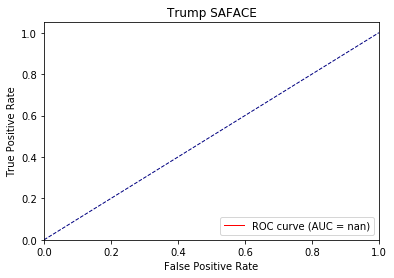

Directory already exists!
dt_saface 2 ap tensor([1., 0.]) loss : 0.023594379425048828 0.0893120127473232 tid : 200 tg tensor([[0]], device='cuda:0')
TEST dt_saface 2 ap tensor([1., 0.]) loss : 0.050295114517211914 0.0584142804145813 tid : 150 tg tensor([[0]], device='cuda:0')
TEST dt_saface 2 ap tensor([1., 0.]) loss : 0.051146745681762695 0.0694751179948145 tid : 480 tg tensor([[0]], device='cuda:0')


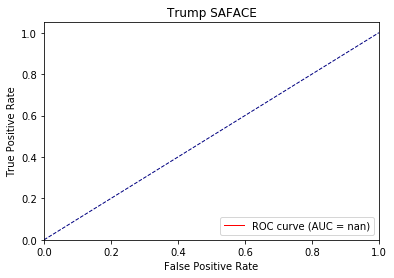

Directory already exists!
dt_neuface 0 ap tensor([0.8927, 0.4369]) loss : 0.3611677885055542 0.6002916966996542 tid : 200 tg tensor([[0]], device='cuda:0')
TEST dt_neuface 0 ap tensor([0.9137, 0.4875]) loss : 0.609951376914978 0.5480050072073936 tid : 150 tg tensor([[0]], device='cuda:0')
TEST dt_neuface 0 ap tensor([0.8374, 0.6422]) loss : 1.004801630973816 0.5987018176487514 tid : 480 tg tensor([[1]], device='cuda:0')


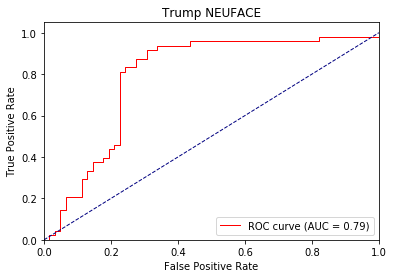

Directory already exists!
dt_neuface 1 ap tensor([0.9171, 0.5254]) loss : 0.27725863456726074 0.5268300187296984 tid : 200 tg tensor([[0]], device='cuda:0')
TEST dt_neuface 1 ap tensor([0.9166, 0.4920]) loss : 0.5838227272033691 0.503350798971951 tid : 150 tg tensor([[0]], device='cuda:0')
TEST dt_neuface 1 ap tensor([0.8487, 0.6498]) loss : 1.2056705951690674 0.5826531888879075 tid : 480 tg tensor([[1]], device='cuda:0')


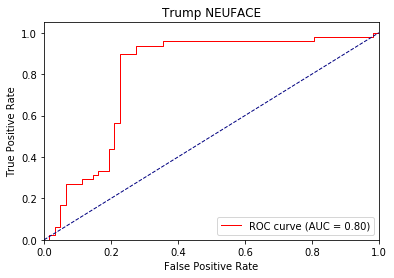

Directory already exists!
dt_neuface 2 ap tensor([0.9279, 0.5623]) loss : 0.15801125764846802 0.469854941168292 tid : 200 tg tensor([[0]], device='cuda:0')
TEST dt_neuface 2 ap tensor([0.9223, 0.4976]) loss : 0.5756656527519226 0.48478420451283455 tid : 150 tg tensor([[0]], device='cuda:0')
TEST dt_neuface 2 ap tensor([0.8625, 0.6518]) loss : 1.3592898845672607 0.5822478283424767 tid : 480 tg tensor([[1]], device='cuda:0')


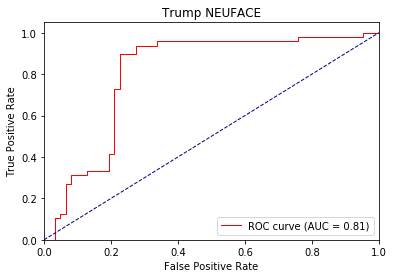

Directory already exists!
dt_inapprop 0 ap tensor([0.9439, 0.0520]) loss : 0.5216214656829834 0.6715182266045064 tid : 200 tg tensor([[0]], device='cuda:0')
TEST dt_inapprop 0 ap tensor([0.9898, 0.2500]) loss : 0.8256982564926147 0.47869370598345995 tid : 150 tg tensor([[1]], device='cuda:0')
TEST dt_inapprop 0 ap tensor([0.8795, 0.0572]) loss : 0.46933960914611816 0.5393611642779136 tid : 480 tg tensor([[0]], device='cuda:0')


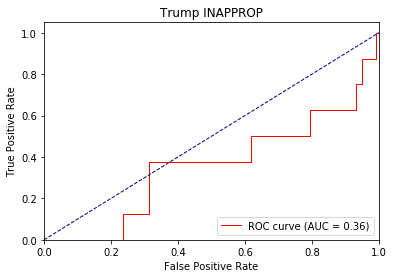

Directory already exists!
dt_inapprop 1 ap tensor([0.9671, 0.0645]) loss : 0.2565794587135315 0.40787460359950994 tid : 200 tg tensor([[0]], device='cuda:0')
TEST dt_inapprop 1 ap tensor([0.9912, 0.2667]) loss : 1.2896721363067627 0.30921765603125095 tid : 150 tg tensor([[1]], device='cuda:0')
TEST dt_inapprop 1 ap tensor([0.8912, 0.0596]) loss : 0.2832587957382202 0.3866151984857053 tid : 480 tg tensor([[0]], device='cuda:0')


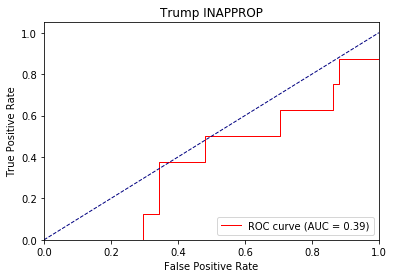

Directory already exists!
dt_inapprop 2 ap tensor([0.9755, 0.1085]) loss : 0.12310540676116943 0.29398356161565864 tid : 200 tg tensor([[0]], device='cuda:0')
TEST dt_inapprop 2 ap tensor([0.9912, 0.2667]) loss : 1.7913751602172852 0.24286995828151703 tid : 150 tg tensor([[1]], device='cuda:0')
TEST dt_inapprop 2 ap tensor([0.9082, 0.0633]) loss : 0.17845505475997925 0.3183775632357111 tid : 480 tg tensor([[0]], device='cuda:0')


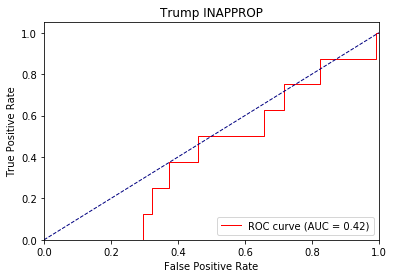

Directory already exists!
dt_affgest 0 ap tensor([0.9793, 0.1541]) loss : 0.262870728969574 0.4704405334024202 tid : 200 tg tensor([[0]], device='cuda:0')
TEST dt_affgest 0 ap tensor([0.9851, 0.0769]) loss : 0.28628939390182495 0.3658591080456972 tid : 150 tg tensor([[0]], device='cuda:0')
TEST dt_affgest 0 ap tensor([0.9941, 0.0227]) loss : 0.285189151763916 0.3459629261372041 tid : 480 tg tensor([[0]], device='cuda:0')


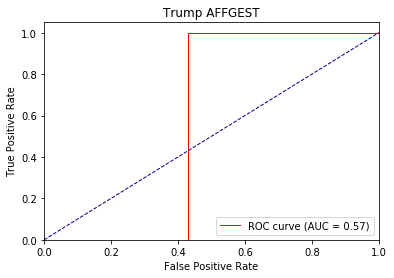

Directory already exists!
dt_affgest 1 ap tensor([1., 1.]) loss : 0.22950279712677002 0.3191267750386534 tid : 200 tg tensor([[0]], device='cuda:0')
TEST dt_affgest 1 ap tensor([0.9800, 0.0625]) loss : 0.15762656927108765 0.23834291845560074 tid : 150 tg tensor([[0]], device='cuda:0')
TEST dt_affgest 1 ap tensor([0.9908, 0.0169]) loss : 0.1540430188179016 0.2092204747759566 tid : 480 tg tensor([[0]], device='cuda:0')


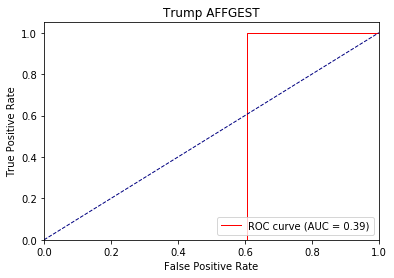

Directory already exists!
dt_affgest 2 ap tensor([0.9914, 0.0909]) loss : 0.10253477096557617 0.19028328318853635 tid : 200 tg tensor([[0]], device='cuda:0')
TEST dt_affgest 2 ap tensor([0.9818, 0.0667]) loss : 0.0908501148223877 0.1850360855460167 tid : 150 tg tensor([[0]], device='cuda:0')
TEST dt_affgest 2 ap tensor([0.9898, 0.0159]) loss : 0.09074229001998901 0.14525796442615743 tid : 480 tg tensor([[0]], device='cuda:0')


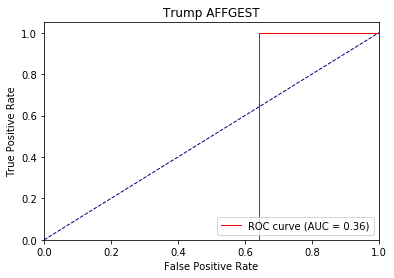

Directory already exists!
dt_defgest 0 ap tensor([0.8320, 0.5157]) loss : 0.8405976295471191 0.6469224709194976 tid : 200 tg tensor([[1]], device='cuda:0')
TEST dt_defgest 0 ap tensor([0.9527, 0.6931]) loss : 1.0863151550292969 0.5356607660651207 tid : 150 tg tensor([[1]], device='cuda:0')
TEST dt_defgest 0 ap tensor([0.8648, 0.7310]) loss : 0.7091692686080933 0.586156461007741 tid : 480 tg tensor([[0]], device='cuda:0')


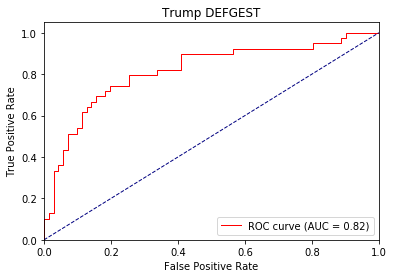

Directory already exists!
dt_defgest 1 ap tensor([0.9323, 0.5959]) loss : 0.8821840286254883 0.5416229056337705 tid : 200 tg tensor([[1]], device='cuda:0')
TEST dt_defgest 1 ap tensor([0.9648, 0.7963]) loss : 1.3736106157302856 0.4682967606931925 tid : 150 tg tensor([[1]], device='cuda:0')
TEST dt_defgest 1 ap tensor([0.8794, 0.7865]) loss : 0.6796171069145203 0.5400425806945685 tid : 480 tg tensor([[0]], device='cuda:0')


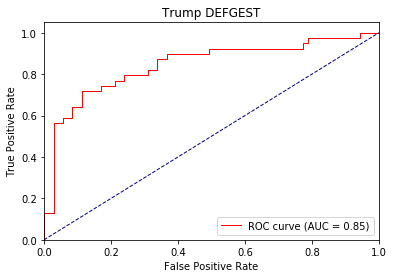

Directory already exists!
dt_defgest 2 ap tensor([0.9077, 0.6291]) loss : 0.9265234470367432 0.516693090883697 tid : 200 tg tensor([[1]], device='cuda:0')
TEST dt_defgest 2 ap tensor([0.9648, 0.7963]) loss : 1.6069228649139404 0.4318484738469124 tid : 150 tg tensor([[1]], device='cuda:0')
TEST dt_defgest 2 ap tensor([0.8811, 0.7949]) loss : 0.6621948480606079 0.5148644109769743 tid : 480 tg tensor([[0]], device='cuda:0')


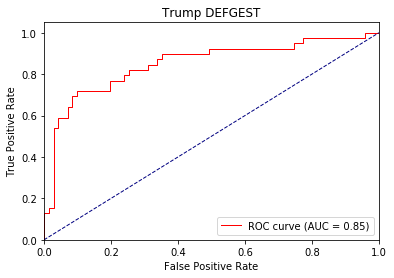

Directory already exists!
dt_agentic 0 ap tensor([0.6021, 0.8454]) loss : 0.4649890959262848 0.6315069838003678 tid : 200 tg tensor([[1]], device='cuda:0')
TEST dt_agentic 0 ap tensor([0.9501, 0.8851]) loss : 0.7199317216873169 0.6001225439831614 tid : 150 tg tensor([[1]], device='cuda:0')
TEST dt_agentic 0 ap tensor([0.9356, 0.9070]) loss : 0.8898327946662903 0.5970449998062484 tid : 480 tg tensor([[0]], device='cuda:0')


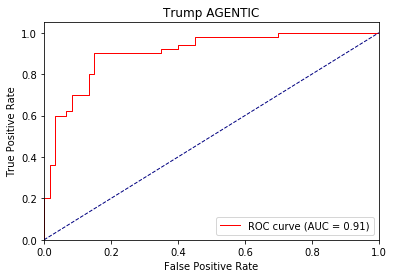

Directory already exists!
dt_agentic 1 ap tensor([0.8421, 0.9578]) loss : 0.4068928062915802 0.5210997933565185 tid : 200 tg tensor([[1]], device='cuda:0')
TEST dt_agentic 1 ap tensor([0.9598, 0.9473]) loss : 0.7815930247306824 0.5371777256950736 tid : 150 tg tensor([[1]], device='cuda:0')
TEST dt_agentic 1 ap tensor([0.9364, 0.9019]) loss : 1.0529409646987915 0.5474029770311044 tid : 480 tg tensor([[0]], device='cuda:0')


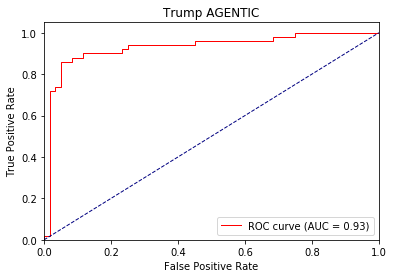

Directory already exists!
dt_agentic 2 ap tensor([0.9116, 0.9712]) loss : 0.21877700090408325 0.38246016082523754 tid : 200 tg tensor([[1]], device='cuda:0')
TEST dt_agentic 2 ap tensor([0.9620, 0.9532]) loss : 0.8290712833404541 0.5149033134803176 tid : 150 tg tensor([[1]], device='cuda:0')
TEST dt_agentic 2 ap tensor([0.9267, 0.9024]) loss : 1.1957577466964722 0.5349300886903491 tid : 480 tg tensor([[0]], device='cuda:0')


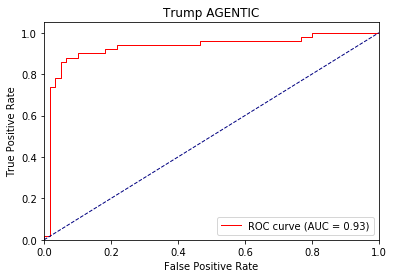

Directory already exists!
dt_waveoff 0 ap tensor([1., 0.]) loss : 0.29616355895996094 0.4699319983783521 tid : 200 tg tensor([[0]], device='cuda:0')
TEST dt_waveoff 0 ap tensor([0.8465, 0.2593]) loss : 0.274169385433197 0.5393718089908361 tid : 150 tg tensor([[0]], device='cuda:0')
TEST dt_waveoff 0 ap tensor([0.8797, 0.0593]) loss : 0.44503235816955566 0.4120895436831883 tid : 480 tg tensor([[0]], device='cuda:0')


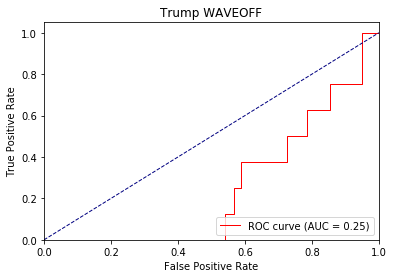

Directory already exists!
dt_waveoff 1 ap tensor([1., 0.]) loss : 0.08912789821624756 0.20107823089488502 tid : 200 tg tensor([[0]], device='cuda:0')
TEST dt_waveoff 1 ap tensor([0.8352, 0.2394]) loss : 0.12430340051651001 0.587963773868978 tid : 150 tg tensor([[0]], device='cuda:0')
TEST dt_waveoff 1 ap tensor([0.8819, 0.0616]) loss : 0.2146998643875122 0.3288956345344076 tid : 480 tg tensor([[0]], device='cuda:0')


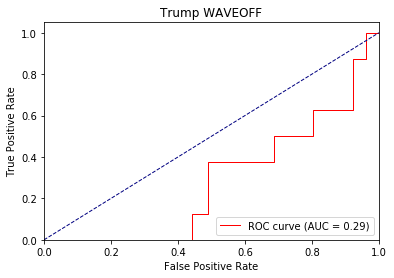

Directory already exists!
dt_waveoff 2 ap tensor([1., 0.]) loss : 0.0263826847076416 0.08991968835119814 tid : 200 tg tensor([[0]], device='cuda:0')
TEST dt_waveoff 2 ap tensor([0.8564, 0.2563]) loss : 0.05548989772796631 0.6931548211723566 tid : 150 tg tensor([[0]], device='cuda:0')
TEST dt_waveoff 2 ap tensor([0.8852, 0.0646]) loss : 0.10012567043304443 0.3199618525651036 tid : 480 tg tensor([[0]], device='cuda:0')


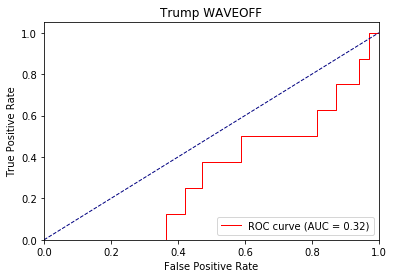

Directory already exists!
dt_nvtic1 0 ap tensor([0.9109, 0.1455]) loss : 0.5433218479156494 0.7202692153942154 tid : 200 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic1 0 ap tensor([0.8482, 0.1392]) loss : 0.5551655888557434 0.5323615651577711 tid : 150 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic1 0 ap tensor([0.8909, 0.2019]) loss : 1.154524326324463 0.5198414243605672 tid : 480 tg tensor([[1]], device='cuda:0')


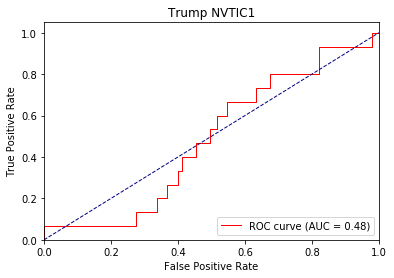

Directory already exists!
dt_nvtic1 1 ap tensor([0.9381, 0.2585]) loss : 0.14514029026031494 0.457647267094952 tid : 200 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic1 1 ap tensor([0.8883, 0.1611]) loss : 0.452645480632782 0.44588915538042784 tid : 150 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic1 1 ap tensor([0.9172, 0.2325]) loss : 1.5037274360656738 0.4254590789882504 tid : 480 tg tensor([[1]], device='cuda:0')


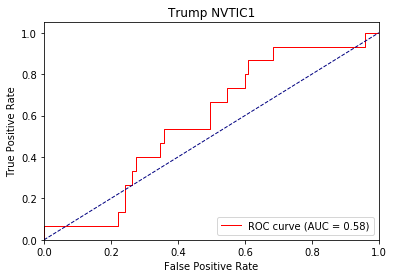

Directory already exists!
dt_nvtic1 2 ap tensor([0.9526, 0.3027]) loss : 0.0916820764541626 0.40465830458748725 tid : 200 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic1 2 ap tensor([0.9015, 0.1738]) loss : 0.39902612566947937 0.4108123052865267 tid : 150 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic1 2 ap tensor([0.9239, 0.2460]) loss : 1.8189122676849365 0.3847984823645378 tid : 480 tg tensor([[1]], device='cuda:0')


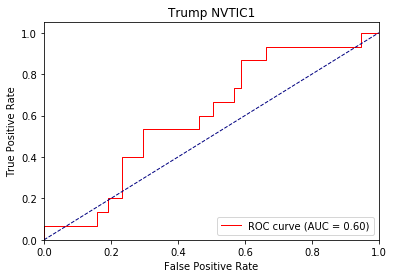

Directory already exists!
dt_nvtic2 0 ap tensor([0.8939, 0.1044]) loss : 0.3503860831260681 0.5842198680842942 tid : 200 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic2 0 ap tensor([0.8928, 0.6189]) loss : 0.474740207195282 0.5482670105993748 tid : 150 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic2 0 ap tensor([0.8652, 0.1919]) loss : 0.963837206363678 0.5318923008685209 tid : 480 tg tensor([[1]], device='cuda:0')


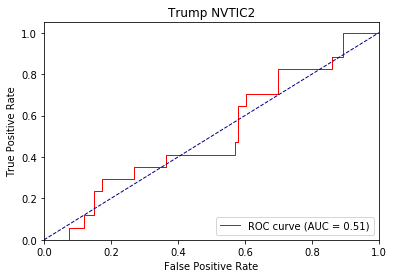

Directory already exists!
dt_nvtic2 1 ap tensor([0.9160, 0.1982]) loss : 0.180620014667511 0.42550047768664423 tid : 200 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic2 1 ap tensor([0.8768, 0.6884]) loss : 0.33491915464401245 0.518256108276546 tid : 150 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic2 1 ap tensor([0.8759, 0.2783]) loss : 1.3460211753845215 0.45339031517505646 tid : 480 tg tensor([[1]], device='cuda:0')


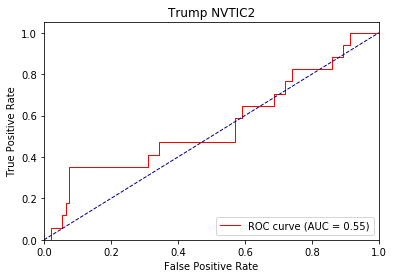

Directory already exists!
dt_nvtic2 2 ap tensor([0.9559, 0.2007]) loss : 0.13372743129730225 0.35375699483686024 tid : 200 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic2 2 ap tensor([0.8871, 0.7277]) loss : 0.2596942186355591 0.5298194959759712 tid : 150 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic2 2 ap tensor([0.8892, 0.3823]) loss : 1.7111284732818604 0.430948512286556 tid : 480 tg tensor([[1]], device='cuda:0')


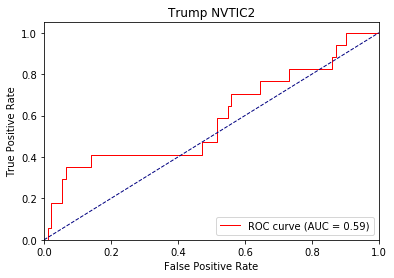

Directory already exists!
dt_nvtic3 0 ap tensor([0.5164, 0.4683]) loss : 0.893471360206604 0.7058986140058395 tid : 200 tg tensor([[1]], device='cuda:0')
TEST dt_nvtic3 0 ap tensor([0.4582, 0.9029]) loss : 0.5735921263694763 0.6631433591246605 tid : 150 tg tensor([[1]], device='cuda:0')
TEST dt_nvtic3 0 ap tensor([0.6031, 0.7801]) loss : 0.7986977696418762 0.6496243762726687 tid : 480 tg tensor([[1]], device='cuda:0')


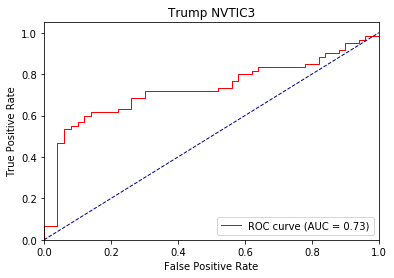

Directory already exists!
dt_nvtic3 1 ap tensor([0.7837, 0.8281]) loss : 0.8971202373504639 0.5940806366301872 tid : 200 tg tensor([[1]], device='cuda:0')
TEST dt_nvtic3 1 ap tensor([0.4716, 0.9034]) loss : 0.4735046625137329 0.6381150800734758 tid : 150 tg tensor([[1]], device='cuda:0')
TEST dt_nvtic3 1 ap tensor([0.6223, 0.7984]) loss : 0.8009282350540161 0.6179466350954406 tid : 480 tg tensor([[1]], device='cuda:0')


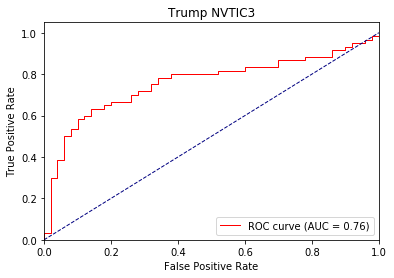

Directory already exists!
dt_nvtic3 2 ap tensor([0.7816, 0.8145]) loss : 0.9072998762130737 0.552572014448526 tid : 200 tg tensor([[1]], device='cuda:0')
TEST dt_nvtic3 2 ap tensor([0.4692, 0.9000]) loss : 0.40906256437301636 0.6318113198503852 tid : 150 tg tensor([[1]], device='cuda:0')
TEST dt_nvtic3 2 ap tensor([0.6288, 0.7930]) loss : 0.8011329174041748 0.6023226717905122 tid : 480 tg tensor([[1]], device='cuda:0')


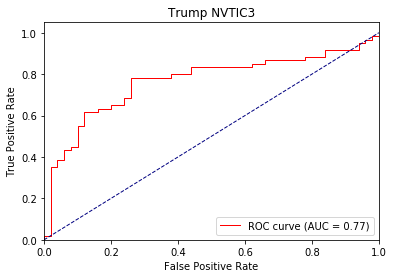

Directory already exists!
dt_nvtic5 0 ap tensor([1., 0.]) loss : 0.7548683881759644 0.7942574858665467 tid : 200 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic5 0 ap tensor([1., 0.]) loss : 0.3908435106277466 0.3732352741062641 tid : 150 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic5 0 ap tensor([0.9925, 0.0192]) loss : 0.3964596092700958 0.4049804721559797 tid : 480 tg tensor([[0]], device='cuda:0')


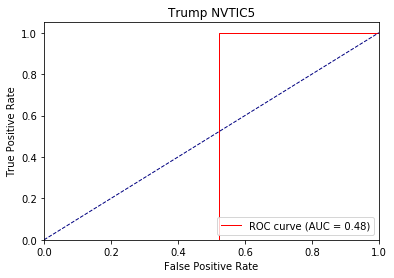

Directory already exists!
dt_nvtic5 1 ap tensor([0.9580, 0.0187]) loss : 0.15766334533691406 0.31468147051577666 tid : 200 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic5 1 ap tensor([1., 0.]) loss : 0.21430331468582153 0.19149802159518003 tid : 150 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic5 1 ap tensor([0.9945, 0.0238]) loss : 0.2248162031173706 0.23123004728434038 tid : 480 tg tensor([[0]], device='cuda:0')


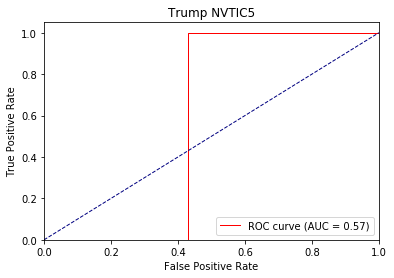

Directory already exists!
dt_nvtic5 2 ap tensor([0.9866, 0.0354]) loss : 0.07575547695159912 0.19720991997790516 tid : 200 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic5 2 ap tensor([1., 0.]) loss : 0.11422979831695557 0.1029870854690671 tid : 150 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic5 2 ap tensor([0.9955, 0.0278]) loss : 0.12544715404510498 0.1438540706829149 tid : 480 tg tensor([[0]], device='cuda:0')


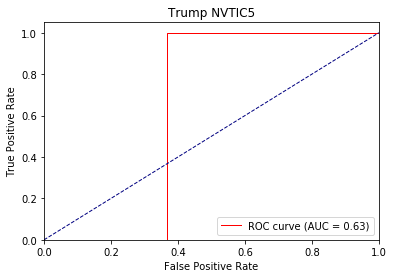

Directory already exists!
dt_nvtic4 0 ap tensor([0.9775, 0.0500]) loss : 0.7388429045677185 0.7845075956412724 tid : 200 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic4 0 ap tensor([1., 0.]) loss : 0.38584601879119873 0.3627217672765255 tid : 150 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic4 0 ap tensor([0.9998, 0.3333]) loss : 0.48849403858184814 0.3928847027068235 tid : 480 tg tensor([[0]], device='cuda:0')


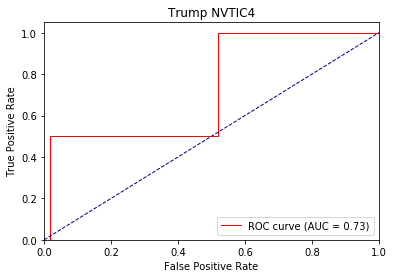

Directory already exists!
dt_nvtic4 1 ap tensor([0.9804, 0.0600]) loss : 0.1689765453338623 0.33342214996515496 tid : 200 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic4 1 ap tensor([1., 0.]) loss : 0.21677935123443604 0.2002614066004753 tid : 150 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic4 1 ap tensor([0.9988, 0.0833]) loss : 0.29183149337768555 0.237295819788563 tid : 480 tg tensor([[0]], device='cuda:0')


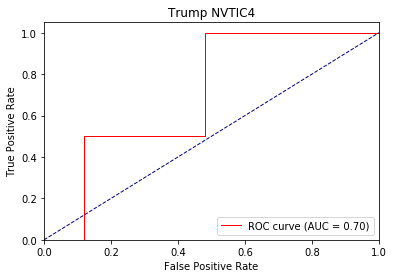

Directory already exists!
dt_nvtic4 2 ap tensor([0.9884, 0.0756]) loss : 0.07539033889770508 0.2152078306316433 tid : 200 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic4 2 ap tensor([1., 0.]) loss : 0.13939440250396729 0.1270212009549141 tid : 150 tg tensor([[0]], device='cuda:0')
TEST dt_nvtic4 2 ap tensor([0.9978, 0.0500]) loss : 0.1879580020904541 0.16378418340974923 tid : 480 tg tensor([[0]], device='cuda:0')


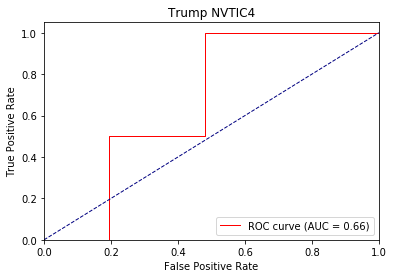

Directory already exists!
dt_interruptions 0 ap tensor([0.8859, 0.1090]) loss : 0.5425276756286621 0.8406856797243419 tid : 200 tg tensor([[1]], device='cuda:0')
TEST dt_interruptions 0 ap tensor([0.9980, 0.3333]) loss : 0.5326656103134155 0.526315551251173 tid : 150 tg tensor([[0]], device='cuda:0')
TEST dt_interruptions 0 ap tensor([0.8519, 0.0963]) loss : 0.5461866855621338 0.5715225782929635 tid : 480 tg tensor([[0]], device='cuda:0')


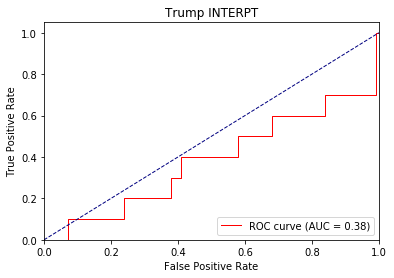

Directory already exists!
dt_interruptions 1 ap tensor([0.9157, 0.2127]) loss : 1.6882516145706177 0.4435984845956167 tid : 200 tg tensor([[1]], device='cuda:0')
TEST dt_interruptions 1 ap tensor([0.9969, 0.2500]) loss : 0.33746564388275146 0.33026591408997774 tid : 150 tg tensor([[0]], device='cuda:0')
TEST dt_interruptions 1 ap tensor([0.8578, 0.0975]) loss : 0.32750648260116577 0.43078891415985265 tid : 480 tg tensor([[0]], device='cuda:0')


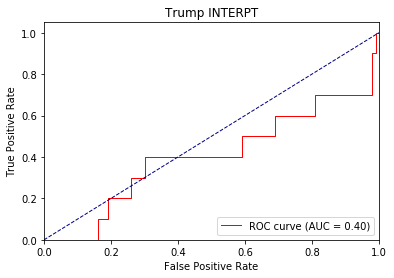

Directory already exists!
dt_interruptions 2 ap tensor([0.9319, 0.1826]) loss : 2.466879367828369 0.31425552345586544 tid : 200 tg tensor([[1]], device='cuda:0')
TEST dt_interruptions 2 ap tensor([0.9922, 0.1250]) loss : 0.23855119943618774 0.2482111770659685 tid : 150 tg tensor([[0]], device='cuda:0')
TEST dt_interruptions 2 ap tensor([0.8669, 0.0954]) loss : 0.2099902629852295 0.37873506393967843 tid : 480 tg tensor([[0]], device='cuda:0')


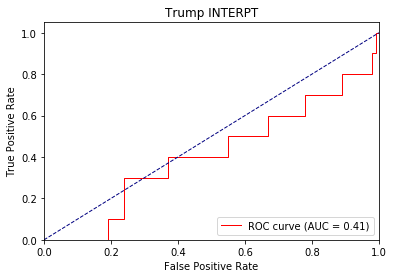

Directory already exists!


In [39]:
classify(1, 'DT')

In [59]:
    for M, f in [[AUC_repeat, 'auc'], [corr_repeat, 'corr']]:
        x = M.mean()
        x.name = 'mean'
        M = M.append(x)

        x = AUC_repeat.std()
        x.name = 'std'
        M = M.append(x)

        #M.to_csv('visuals/modelres/' + detstr + '_' + str(debate) + '-' + altstr + '_' + str(debate) + runtype + '/' + candidate + '_' + f + '_multi_' + run_name + '.csv')
        M.to_csv('visuals/modelres/' + candidate + '_' + f + '_multi_' + run_name + '.csv')

NameError: name 'AUC_repeat' is not defined

NameError: name 'AUC_repeat' is not defined